W tym notatniku zajmiemy się napastnikami

Na początku załadujemy potrzebne biblioteki

In [ ]:
from statsbombpy import sb
import pandas as pd
from mplsoccer import VerticalPitch, Pitch
from highlight_text import ax_text, fig_text
from matplotlib.colors import LinearSegmentedColormap
import matplotlib.pyplot as plt
import matplotlib.patheffects as path_effects
import seaborn as sns
import numpy as np

In [ ]:
free_comps = sb.competitions().sort_values(by='season_name', ascending=False)
free_man_comps = free_comps[(free_comps['competition_gender'] == "male") & (free_comps['competition_youth'] == False)]
free_man_comps

,competition_id,season_id,country_name,competition_name,competition_gender,competition_youth,competition_international,season_name,match_updated,match_updated_360,match_available_360,match_available
21,223,282,South America,Copa America,male,False,True,2024,2024-07-15T18:00:33.653673,None,None,2024-07-15T18:00:33.653673
68,55,282,Europe,UEFA Euro,male,False,True,2024,2024-07-15T15:48:50.315500,2024-07-15T15:52:24.778809,2024-07-15T15:52:24.778809,2024-07-15T15:48:50.315500
0,9,281,Germany,1. Bundesliga,male,False,False,2023/2024,2024-07-15T14:15:54.671676,2024-07-15T14:17:00.877356,2024-07-15T14:17:00.877356,2024-07-15T14:15:54.671676
2,1267,107,Africa,African Cup of Nations,male,False,True,2023,2024-06-13T07:51:02.452825,None,None,2024-06-13T07:51:02.452825
61,44,107,United States of America,Major League Soccer,male,False,False,2023,2024-07-14T18:53:28.735163,2024-07-14T18:58:42.974543,2024-07-14T18:58:42.974543,2024-07-14T18:53:28.735163
...,...,...,...,...,...,...,...,...,...,...,...,...
19,16,71,Europe,Champions League,male,False,False,1971/1972,2024-02-12T14:25:01.735880,2021-06-13T16:17:31.694,None,2024-02-12T14:25:01.735880
20,16,276,Europe,Champions League,male,False,False,1970/1971,2024-02-13T14:24:12.213582,None,None,2024-02-13T14:24:12.213582
34,43,272,International,FIFA World Cup,male,False,True,1970,2024-02-13T14:23:06.735299,None,None,2024-02-13T14:23:06.735299
35,43,270,International,FIFA World Cup,male,False,True,1962,2023-06-26T10:38:00.323984,None,None,2023-06-26T10:38:00.323984


In [ ]:
free_man_comps.head(20)

,competition_id,season_id,country_name,competition_name,competition_gender,competition_youth,competition_international,season_name,match_updated,match_updated_360,match_available_360,match_available
21,223,282,South America,Copa America,male,False,True,2024,2024-07-15T18:00:33.653673,None,None,2024-07-15T18:00:33.653673
68,55,282,Europe,UEFA Euro,male,False,True,2024,2024-07-15T15:48:50.315500,2024-07-15T15:52:24.778809,2024-07-15T15:52:24.778809,2024-07-15T15:48:50.315500
0,9,281,Germany,1. Bundesliga,male,False,False,2023/2024,2024-07-15T14:15:54.671676,2024-07-15T14:17:00.877356,2024-07-15T14:17:00.877356,2024-07-15T14:15:54.671676
2,1267,107,Africa,African Cup of Nations,male,False,True,2023,2024-06-13T07:51:02.452825,None,None,2024-06-13T07:51:02.452825
61,44,107,United States of America,Major League Soccer,male,False,False,2023,2024-07-14T18:53:28.735163,2024-07-14T18:58:42.974543,2024-07-14T18:58:42.974543,2024-07-14T18:53:28.735163
58,7,235,France,Ligue 1,male,False,False,2022/2023,2024-06-11T00:50:53.277411,2024-06-26T08:17:36.043856,2024-06-26T08:17:36.043856,2024-06-11T00:50:53.277411
29,43,106,International,FIFA World Cup,male,False,True,2022,2024-05-15T10:23:32.854925,2024-06-11T11:30:50.462448,2024-06-11T11:30:50.462448,2024-05-15T10:23:32.854925
59,7,108,France,Ligue 1,male,False,False,2021/2022,2024-06-03T16:46:00.665854,2024-06-03T16:49:55.355195,2024-06-03T16:49:55.355195,2024-06-03T16:46:00.665854
37,1238,108,India,Indian Super league,male,False,False,2021/2022,2024-02-12T17:41:31.729787,None,None,2024-02-12T17:41:31.729787
38,11,90,Spain,La Liga,male,False,False,2020/2021,2024-07-15T15:15:28.367546,2024-07-15T15:17:45.455234,2024-07-15T15:17:45.455234,2024-07-15T15:15:28.367546


In [ ]:
len(free_man_comps)

67

In [ ]:
free_man_comps.iloc[1,:]['competition_id']

55

In [ ]:
for i in range(0,len(free_man_comps)):
    a=(free_man_comps.iloc[i,0])
    b=(free_man_comps.iloc[i,1])
    comp_name = free_man_comps.iloc[i,:]['competition_name']
    comp_season = free_man_comps.iloc[i,:]['season_name']
    print(f"{comp_name}, {comp_season}, [{len(sb.matches(season_id=b, competition_id=a))}]")
   

Copa America, 2024, [32]
UEFA Euro, 2024, [51]
1. Bundesliga, 2023/2024, [34]
African Cup of Nations, 2023, [52]
Major League Soccer, 2023, [6]
Ligue 1, 2022/2023, [32]
FIFA World Cup, 2022, [64]
Ligue 1, 2021/2022, [26]
Indian Super league, 2021/2022, [115]
La Liga, 2020/2021, [35]
UEFA Euro, 2020, [51]
La Liga, 2019/2020, [33]
Champions League, 2018/2019, [1]
La Liga, 2018/2019, [34]
FIFA World Cup, 2018, [64]
Champions League, 2017/2018, [1]
La Liga, 2017/2018, [36]
Champions League, 2016/2017, [1]
La Liga, 2016/2017, [34]
La Liga, 2015/2016, [380]
1. Bundesliga, 2015/2016, [306]
Serie A, 2015/2016, [380]
Premier League, 2015/2016, [380]
Champions League, 2015/2016, [1]
Ligue 1, 2015/2016, [377]
La Liga, 2014/2015, [38]
Champions League, 2014/2015, [1]
La Liga, 2013/2014, [31]
Champions League, 2013/2014, [1]
Champions League, 2012/2013, [1]
La Liga, 2012/2013, [32]
Champions League, 2011/2012, [1]
La Liga, 2011/2012, [37]
La Liga, 2010/2011, [33]
Champions League, 2010/2011, [1]
La

In [ ]:
free_man_comps_sample = free_man_comps
free_man_comps_sample_list = list()
for i in range(len(free_man_comps_sample)):
    season_id = free_man_comps_sample.iloc[i]['season_id']
    competition_id = free_man_comps_sample.iloc[i]['competition_id']
    free_man_comps_sample_list.append(sb.matches(season_id=season_id, competition_id=competition_id))

In [ ]:
free_man_comps_sample_list[0]['match_id']

0     3943077
1     3943076
2     3942852
3     3942785
4     3942416
5     3942415
6     3939986
7     3939973
8     3942229
9     3942228
10    3939985
11    3939984
12    3939981
13    3939992
14    3939991
15    3939990
16    3939989
17    3939988
18    3939987
19    3939983
20    3939982
21    3939980
22    3939979
23    3939978
24    3939977
25    3939976
26    3939975
27    3939974
28    3939972
29    3939971
30    3939970
31    3939969
Name: match_id, dtype: int64

In [ ]:
matches = list()
for comp in free_man_comps_sample_list:
    for match_id in comp.match_id:
        matches.append(sb.events(match_id=match_id))

In [ ]:
forward_positions = ['Right Center Forward', 'Center Forward', 'Left Center Forward']

Zajmujemy się 90 min!

In [ ]:
events_list = []
for match in matches:
    events = match[(match['period'] < 3) & (match['position'].isin(forward_positions))].groupby(['player', 'team', 'match_id']).size().reset_index(name='Events')
    events_list.append(events)

events_df = pd.concat(events_list, ignore_index=True)

In [ ]:
print(f"Pierwotnie do dyspozycji mamy {len(events_df)} napastników.")

Pierwotnie do dyspozycji mamy 12533 napastników.


Zmiany

In [ ]:
start_min = pd.DataFrame()

for match in matches:

#if ((match[match['type'] == 'Substitution']['position'].isin(forward_positions).any()) ):
    if 'substitution_replacement' in match.columns:
        start_minute = match[match['type'] == 'Substitution'][['minute', 'position', 'player', 'substitution_replacement', 'match_id']]
    #start_minute = start_minute[start_minute['position'].isin(forward_positions)]
        start_min = pd.concat([start_min, start_minute], ignore_index=True)

subs_off = pd.DataFrame({'player':start_min['player'], 'minute':start_min['minute'], 'match_id':start_min['match_id']})
subs_on = pd.DataFrame({'player':start_min['substitution_replacement'], 'minute':90-start_min['minute'], 'match_id':start_min['match_id']})
subs_all = pd.concat([subs_off, subs_on], ignore_index=True)

s_list = []
for match in matches:
    a = match.groupby(['player', 'match_id', 'position']).size().reset_index(name='x')
    s_list.append(a)
s_df = pd.concat(s_list, ignore_index=True)

a2 = subs_all.merge(s_df, on=['match_id', 'player'], how='left')
a3 = a2[a2['position'].isin(forward_positions)]
sub_df = a3.drop_duplicates(subset=['player', 'match_id'])

In [ ]:
len(sub_df) # tyle mamy napastników, którzy schodzili lub wchodzili, 80% ze wszystkich

8031

In [ ]:
sub_df[sub_df['player'] == "Francesco Totti"].sort_values(by='match_id')

,player,minute,match_id,position,x
13876,Francesco Totti,80,3878593,Center Forward,40.0
11946,Francesco Totti,66,3878607,Center Forward,144.0
13714,Francesco Totti,54,3879547,Center Forward,11.0
35066,Francesco Totti,21,3879676,Center Forward,64.0
33867,Francesco Totti,32,3879707,Center Forward,109.0
34586,Francesco Totti,15,3879767,Left Center Forward,32.0
34369,Francesco Totti,45,3879816,Center Forward,86.0
34237,Francesco Totti,10,3879845,Right Center Forward,36.0
34157,Francesco Totti,32,3879856,Center Forward,21.0
34103,Francesco Totti,32,3879866,Center Forward,148.0


In [ ]:
""""
start_min = pd.DataFrame()
for match in matches:
    if 'substitution_replacement' in match.columns:
        start_minute = match[match['type'] == 'Substitution'][['minute', 'position', 'player', 'substitution_replacement', 'match_id']]
        start_min = pd.concat([start_min, start_minute], ignore_index=True)

subs_off = pd.DataFrame({'player':start_min['player'], 'minute':start_min['minute'], 'match_id':start_min['match_id']})
subs_on = pd.DataFrame({'player':start_min['substitution_replacement'], 'minute':90-start_min['minute'], 'match_id':start_min['match_id']})
subs = pd.concat([subs_off, subs_on], ignore_index=True)
"""

In [ ]:
"""
for match in matches:
    positions = match.groupby(['player', 'match_id', 'position']).size().reset_index(name='x')
    """

In [ ]:
#a = subs.merge(positions, on=['player', 'match_id'], how='left')

In [ ]:
#a = a[a['position'].isin(forward_positions)]
#a

,player,minute,match_id,position,x


In [ ]:
print(f"Napastników, którzy schodzili z boiska lub wchodzili z ławki mamy {len(sub_df)}.")

Napastników, którzy schodzili z boiska lub wchodzili z ławki mamy 7110.


STOP - TERAZ DUPLIKATY

Są tu także zawodnicy, którzy weszli i zeszli - odejmijmy ich zduplikowane wartości minut i wyliczmy osobno dla nich ile rozegrali oraz włączmy do zbioru danych subs.

In [ ]:
subs_dup = sub_df[sub_df.duplicated(subset=['match_id', 'player'], keep=False)].copy()

subs_dup['diff'] = subs_dup.groupby(['match_id', 'player'])['minute'].transform(lambda x: x.max() - (90 - x.min()))
subs_dup = subs_dup[['player', 'match_id', 'diff']].drop_duplicates()

In [ ]:
subs_dup

,player,match_id,diff


In [ ]:
subs_dup.columns = ['player', 'match_id', 'minute']

In [ ]:
subs_df = subs[~subs.duplicated(subset=['match_id', 'player'], keep=False)].copy()

In [ ]:
subs_df = pd.concat([subs_df, subs_dup], ignore_index=True)

In [ ]:
events_df

,player,team,match_id,Events
0,Jhon Andrés Córdoba Copete,Colombia,3943077,60
1,Julián Álvarez,Argentina,3943077,92
2,Lionel Andrés Messi Cuccittini,Argentina,3943077,125
3,Luis Fernando Díaz Marulanda,Colombia,3943077,120
4,Nicolás Iván González,Argentina,3943077,3
...,...,...,...,...
12528,Édson Arantes do Nascimento,Brazil,3888705,261
12529,Edvaldo Izidio Neto,Brazil,3888704,255
12530,Just Louis Fontaine,France,3888704,220
12531,Raymond Kopaszewski Wlodarczyck,France,3888704,222


In [ ]:
sub_df_merge = sub_df[['player', 'match_id', 'minute']]
sub_df_merge

,player,match_id,minute
0,Lionel Andrés Messi Cuccittini,3943077,65
2,Jhon Andrés Córdoba Copete,3943077,87
5,Julián Álvarez,3943077,96
14,Luis Fernando Díaz Marulanda,3943077,105
19,Darwin Gabriel Núñez Ribeiro,3943076,45
...,...,...,...
43990,Gheorghe Tataru,3889217,20
43993,Gianni Rivera,3888702,7
43994,Víctor Rodolfo Espárrago Videla,3888701,21
43996,Jeffrey Astle,3888700,28


In [ ]:
strikers0 = events_df.merge(sub_df_merge, on=['match_id', 'player'], how='left').fillna(90)

In [ ]:
strikers0

,player,team,match_id,Events,minute
0,Jhon Andrés Córdoba Copete,Colombia,3943077,60,87.0
1,Julián Álvarez,Argentina,3943077,92,96.0
2,Lionel Andrés Messi Cuccittini,Argentina,3943077,125,65.0
3,Luis Fernando Díaz Marulanda,Colombia,3943077,120,105.0
4,Nicolás Iván González,Argentina,3943077,3,25.0
...,...,...,...,...,...
12528,Édson Arantes do Nascimento,Brazil,3888705,261,90.0
12529,Edvaldo Izidio Neto,Brazil,3888704,255,90.0
12530,Just Louis Fontaine,France,3888704,220,90.0
12531,Raymond Kopaszewski Wlodarczyck,France,3888704,222,90.0


Weźmy tylko zawodników którzy grali więcej niż 0 minut a tym którym wyszło więcej niż 90 dajmy 90.

In [ ]:
m = sb.events(match_id=3942227)
m.groupby('player').size()

player
Breel-Donald Embolo             150
Bukayo Saka                     241
Cole Palmer                      80
Dan Ndoye                        99
Declan Rice                     296
Denis Lemi Zakaria Lako Lado     34
Eberechi Eze                     75
Ezri Konsa Ngoyo                172
Fabian Lukas Schär              255
Fabian Rieder                   119
Granit Xhaka                    394
Harry Kane                       97
Ivan Toney                        7
John Stones                     221
Jordan Pickford                 126
Jude Bellingham                 266
Kieran Trippier                 110
Kobbie Mainoo                   127
Kyle Walker                     277
Luke Shaw                        88
Manuel Obafemi Akanji           315
Michel Aebischer                176
Mohamed Zeki Amdouni              7
Phil Foden                      270
Remo Freuler                    208
Ricardo Iván Rodríguez Araya    224
Ruben Vargas                     90
Silvan Widmer        

In [ ]:
strikers0[strikers0['player'] == "Harry Kane"]

,player,team,match_id,Events,minute
162,Harry Kane,England,3942819,87,79.0
166,Harry Kane,England,3943043,58,60.0
188,Harry Kane,England,3930171,74,68.0
193,Harry Kane,England,3942227,72,109.0
232,Harry Kane,England,3941017,78,105.0
...,...,...,...,...,...
9258,Harry Kane,Tottenham Hotspur,3754318,173,90.0
9273,Harry Kane,Tottenham Hotspur,3754324,119,83.0
9287,Harry Kane,Tottenham Hotspur,3754332,118,90.0
9290,Harry Kane,Tottenham Hotspur,3754333,136,90.0


In [ ]:
sb.events(match_id=3942227)['team']

0           England
1       Switzerland
2           England
3       Switzerland
4       Switzerland
           ...     
4877        England
4878        England
4879        England
4880        England
4881    Switzerland
Name: team, Length: 4882, dtype: object

In [ ]:
sb.events(match_id=3941021)['team']

0           Romania
1       Netherlands
2       Netherlands
3           Romania
4           Romania
           ...     
2991    Netherlands
2992        Romania
2993    Netherlands
2994    Netherlands
2995        Romania
Name: team, Length: 2996, dtype: object

In [ ]:
strikers0[(strikers0['minute'] < 92) & (strikers0['minute'] > 90)]

,player,team,match_id,Events,minute
214,Memphis Depay,Netherlands,3941021,131,91.0
513,Patrik Schick,Bayer Leverkusen,3895202,107,91.0
602,Mohamed Bayo,Guinea,3922356,88,91.0
736,Mohamed Bayo,Guinea,3920401,94,91.0
1349,Kylian Mbappé Lottin,Paris Saint-Germain,3802983,104,91.0
1417,Jorge Rolando Pereyra Díaz,Kerala Blasters,3827767,128,91.0
1437,Jorge Rolando Pereyra Díaz,Kerala Blasters,3827337,139,91.0
1565,Antonio Perošević,East Bengal,3817888,139,91.0
1570,Naorem Mahesh Singh,East Bengal,3817888,34,91.0
1663,Jorge Rolando Pereyra Díaz,Kerala Blasters,3813271,97,91.0


Ogólnie to bierzemy wydarzenia zawodników, które miały miejsce tylko w 1 i 2 połowie. To że mamy że zawodnik zagrał np. 109 minut nie oznacza że będziemy brać to co zrobił w dogrywce. Dlatego dla tych którzy zagrali > 90 dajemy że zagrali 90 jako cały mecz oraz weźmy zawodników którzy nie wchodzili w dogrywce itd - > 0.

In [ ]:
strikers1 = strikers0[strikers0['minute'] > 0]
strikers1['minute'] = strikers1['minute'].apply(lambda x: min(x, 90))
strikers1.sort_values(by='minute')

C:\Users\macie\AppData\Local\Temp\ipykernel_11712\3633197134.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  strikers1['minute'] = strikers1['minute'].apply(lambda x: min(x, 90))


,player,team,match_id,Events,minute
9346,Modibo Maïga,West Ham United,3754141,17,1.0
9803,Yacine Bammou,Nantes,3901160,9,1.0
276,Olivier Giroud,France,3930165,17,1.0
6947,Mario Barwuah Balotelli,AC Milan,3879758,12,1.0
11828,Peter Luccin,Racing Santander,69215,2,1.0
...,...,...,...,...,...
5129,Hugo Miguel Pereira de Almeida,Hannover 96,3890497,139,90.0
5134,Mathew Leckie,Ingolstadt,3890496,4,90.0
5137,Anthony Modeste,FC Köln,3890495,122,90.0
5145,Franco Matías Di Santo,Schalke 04,3890493,144,90.0


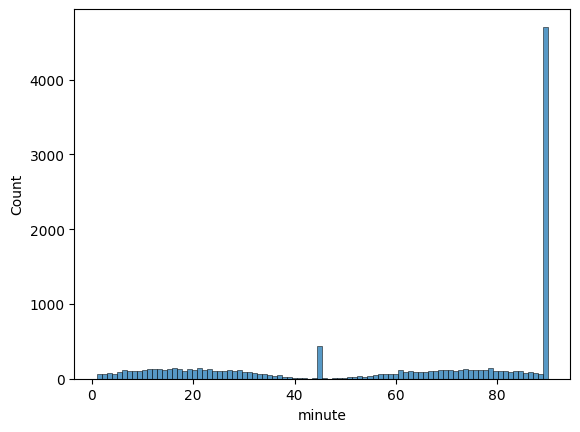

In [ ]:
sns.histplot(strikers1['minute'], bins=90)
plt.show()

In [ ]:
strikers2 = strikers1[strikers1['minute'] >= 70]

Zobaczmy teraz jak rozkładają się dane - ile minut grają zawodnicy

In [4701]:
players_all

,player,team,match_id,position,Events,minute
0,Aaren D''Silva,Hyderabad,3813272,Right Back,16,9.0
1,Aaren D''Silva,Hyderabad,3813290,Right Wing,8,7.0
2,Aaren D''Silva,Hyderabad,3813299,Right Center Forward,15,4.0
3,Aaren D''Silva,Hyderabad,3813304,Right Defensive Midfield,46,23.0
4,Aaren D''Silva,Hyderabad,3817869,Left Wing,8,1.0
...,...,...,...,...,...,...
82251,Žan Vipotnik,Slovenia,3930170,Left Center Forward,22,15.0
82252,Željko Brkić,Carpi,3878545,Goalkeeper,65,90.0
82253,Željko Brkić,Carpi,3878552,Goalkeeper,49,90.0
82254,Željko Brkić,Carpi,3879539,Goalkeeper,54,62.0


In [4702]:
df_sort = players_all.sort_values(by='minute')
df_sort['cum_sum'] = df_sort['minute'].cumsum() / df_sort['minute'].sum() * 100


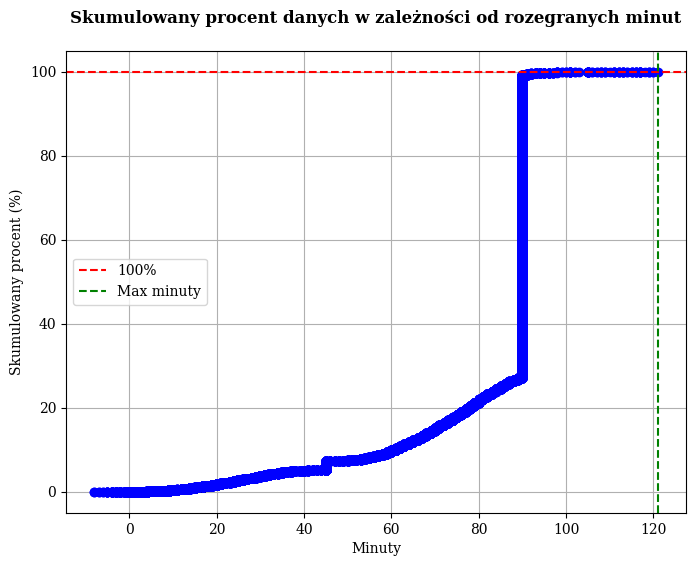

In [4704]:
plt.figure(figsize=(8, 6))
plt.plot(df_sort['minute'], df_sort['cum_sum'], marker='o', linestyle='-', color='b')
plt.title('Skumulowany procent danych w zależności od rozegranych minut\n', weight="bold")
plt.xlabel('Minuty')
plt.ylabel('Skumulowany procent (%)')
plt.grid(True)

# Dodanie linii poziomej na 100% i pionowej na 0%
plt.axhline(100, color='r', linestyle='--', label='100%')
plt.axvline(df_sort['minute'].max(), color='g', linestyle='--', label='Max minuty')

plt.legend()
plt.show()

([<matplotlib.axis.XTick at 0x161b83bf7d0>,
 [Text(0, 0, '0'),
  Text(5, 0, '5'),
  Text(10, 0, '10'),
  Text(15, 0, '15'),
  Text(20, 0, '20'),
  Text(25, 0, '25'),
  Text(30, 0, '30'),
  Text(35, 0, '35'),
  Text(40, 0, '40'),
  Text(45, 0, '45'),
  Text(50, 0, '50'),
  Text(55, 0, '55'),
  Text(60, 0, '60'),
  Text(65, 0, '65'),
  Text(70, 0, '70'),
  Text(75, 0, '75'),
  Text(80, 0, '80'),
  Text(85, 0, '85'),
  Text(90, 0, '90')])

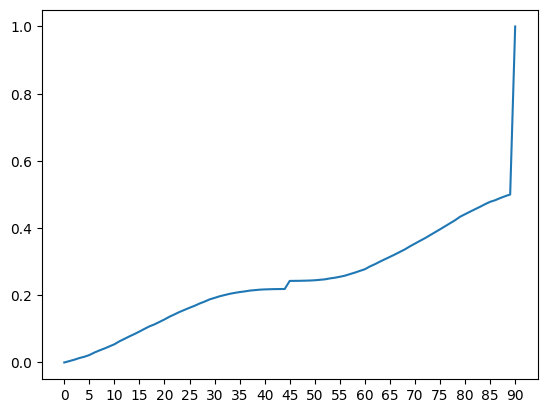

In [ ]:
min_list = []
for i in range(1, 92):
    min_list.append(len(strikers1[strikers1['minute'] < i]) / len(strikers1))
plt.plot(min_list)
plt.xticks(range(0, 91, 5))

In [ ]:
diff_list = []
for i in range(1,len(min_list)-1):
    diff_list.append(min_list[i+1] / min_list[i])

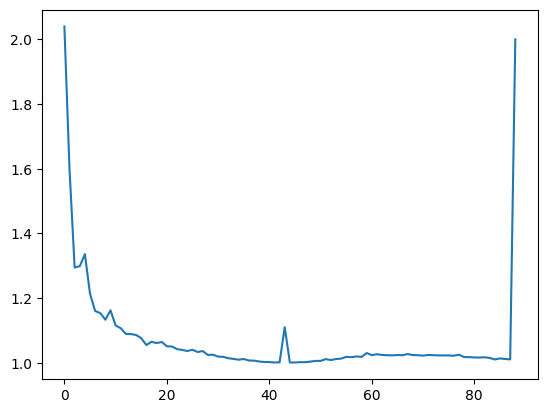

In [ ]:
plt.plot(diff_list)

Weźmiemy zawodników, którzy grali więcej niż 70 minut

In [ ]:
strikers2 = strikers1[strikers1['minute'] > 70]

In [ ]:
len(strikers2)

6807

In [ ]:
goals_list = []
for match in matches:
    goals = match[(match['shot_type'] != 'Penalty') & (match['shot_outcome'] == 'Goal') & (match['period'] < 3) & (match['position'].isin(forward_positions))].groupby(['player', 'match_id']).size().reset_index(name='goals')
    goals_list.append(goals)

goals_df = pd.concat(goals_list, ignore_index=True)

In [ ]:
strikers3 = strikers2.merge(goals_df, on=['match_id', 'player'], how='left').fillna(0)

<Axes: xlabel='assist', ylabel='Count'>

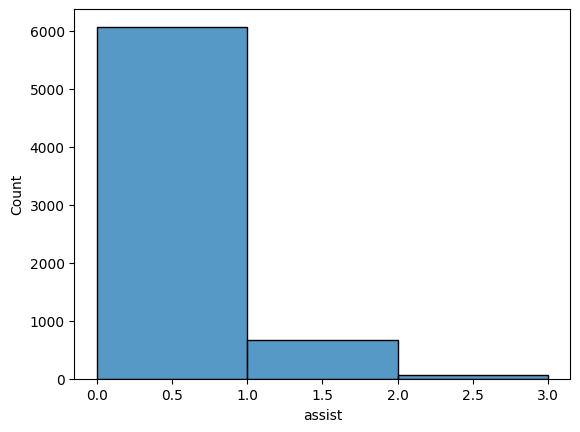

In [ ]:
sns.histplot(strikers4['assist'], bins=3)

In [ ]:
assist_list = []
for match in matches:
    if 'pass_goal_assist' in match.columns:
        assist = match[(match['pass_goal_assist'] == True) & (match['period'] < 3) & (match['position'].isin(forward_positions))].groupby(['player', 'match_id']).size().reset_index(name='assist')
        assist_list.append(assist)
assist_df = pd.concat(assist_list, ignore_index=True)

In [ ]:
strikers4 = strikers3.merge(assist_df, on=['match_id', 'player'], how='left').fillna(0)

In [ ]:
xg_list = []
for match in matches:
    xg = match[(match['type'] == 'Shot') & (match['shot_type'] != 'Penalty') & (match['period'] < 3) & match['position'].isin(forward_positions)].groupby(['player', 'match_id'])['shot_statsbomb_xg'].sum().reset_index(name='npxG')
    xg_list.append(xg)
xg_df = pd.concat(xg_list, ignore_index=True)

In [ ]:
strikers5 = strikers4.merge(xg_df, on=['match_id', 'player'], how='left').fillna(0)

In [ ]:
strikers5

,player,team,match_id,Events,minute,goals,assist,npxG
0,Jhon Andrés Córdoba Copete,Colombia,3943077,60,87.0,0.0,0.0,0.210564
1,Julián Álvarez,Argentina,3943077,92,90.0,0.0,0.0,0.072140
2,Luis Fernando Díaz Marulanda,Colombia,3943077,120,90.0,0.0,0.0,0.029771
3,Darwin Gabriel Núñez Ribeiro,Uruguay,3942852,107,90.0,0.0,0.0,0.364153
4,Jhon Andrés Córdoba Copete,Colombia,3942852,86,75.0,0.0,0.0,0.148650
...,...,...,...,...,...,...,...,...
6802,Édson Arantes do Nascimento,Brazil,3888705,261,90.0,2.0,0.0,1.052024
6803,Edvaldo Izidio Neto,Brazil,3888704,255,90.0,1.0,0.0,1.172473
6804,Just Louis Fontaine,France,3888704,220,90.0,1.0,0.0,1.053373
6805,Raymond Kopaszewski Wlodarczyck,France,3888704,222,90.0,0.0,1.0,0.051519


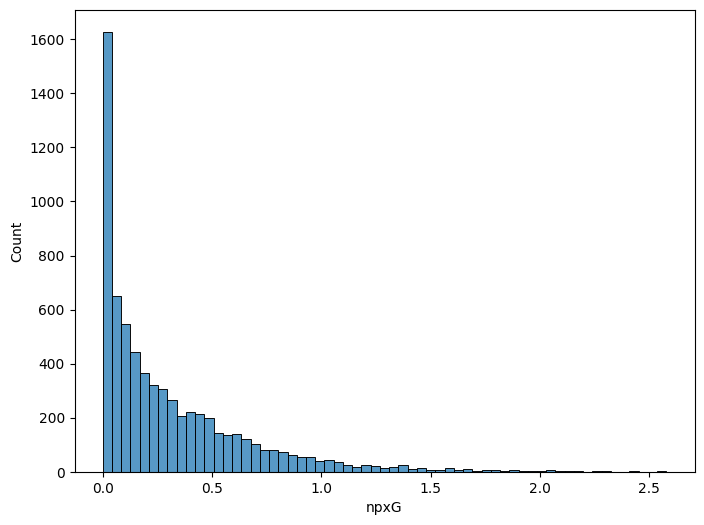

In [ ]:
plt.figure(figsize=(8,6))
sns.histplot(strikers5['npxG'])
plt.show()

In [ ]:
target_shot_list = []
for match in matches:
    target = match[(match['shot_outcome'].isin(['Saved', 'Goal', 'Saved To Post'])) & (match['period'] < 3) & (match['position'].isin(forward_positions))].groupby(['player', 'match_id'] ).size().reset_index(name='shots_on_target')
    target_shot_list.append(target)
target_df = pd.concat(target_shot_list, ignore_index=True)

In [ ]:
off_target_shot_list = []
for match in matches:
    off_target = match[(match['shot_outcome'].isin(['Off T', 'Post', 'Saved Off T'])) & (match['period'] < 3) & match['position'].isin(forward_positions)].groupby(['player', 'match_id']).size().reset_index(name='shots_off_target')
    off_target_shot_list.append(off_target)
off_target_df = pd.concat(off_target_shot_list, ignore_index=True)
off_target_df

,player,match_id,shots_off_target
0,Jhon Andrés Córdoba Copete,3943077,1
1,Julián Álvarez,3943077,1
2,Darwin Gabriel Núñez Ribeiro,3943076,1
3,Tanitoluwa Oluwaseyi,3943076,1
4,Darwin Gabriel Núñez Ribeiro,3942852,3
...,...,...,...
4686,Edvaldo Izidio Neto,3888705,2
4687,Édson Arantes do Nascimento,3888705,3
4688,Edvaldo Izidio Neto,3888704,1
4689,Just Louis Fontaine,3888704,1


In [ ]:
shots = target_df.merge(off_target_df, on=['match_id', 'player'], how='outer').fillna(0)

In [ ]:
strikers6 = strikers5.merge(shots, on=['match_id', 'player'], how='left').fillna(0)

In [ ]:
strikers6['shots_accuracy_%'] = strikers6['shots_on_target'] / (strikers6['shots_on_target'] + strikers6['shots_off_target'])
strikers6['shots_accuracy_%'] = strikers6['shots_accuracy_%'].fillna(0)

In [ ]:
xga_df = pd.DataFrame()

for match in matches:
# Obliczanie xG dla strzałów
    shots = (
        match[(match['type'] == 'Shot') & (match['period'] < 3)]
        .groupby(['player', 'match_id', 'shot_key_pass_id'])
        ['shot_statsbomb_xg'].sum()
        .reset_index(name='xG')
        .rename(columns={'shot_key_pass_id': 'id'})
    )

    # Filtrowanie podań
    passes = (
        match[(match['pass_outcome'].isna()) & (match['position'].isin(forward_positions))]
        .groupby(['player', 'match_id', 'id'])
        .size()
        .reset_index(name='pass_count')
    )

    # Łączenie strzałów z podaniami
    xga = shots.merge(passes, on=['match_id', 'id'], how='left')

    # Grupowanie po zawodniku (asystencie xG)
    xga = xga.groupby(['player_y', 'match_id'])['xG'].sum().reset_index(name='xGA').rename(columns={'player_y':'player'})

    # Łączenie wyników z xga_df
    xga_df = pd.concat([xga_df, xga], ignore_index=True).fillna(0)

xga_df


,player,match_id,xGA
0,Jhon Andrés Córdoba Copete,3943077,0.141692
1,Lionel Andrés Messi Cuccittini,3943077,0.047532
2,Luis Fernando Díaz Marulanda,3943077,0.019571
3,Darwin Gabriel Núñez Ribeiro,3943076,0.099426
4,Tanitoluwa Oluwaseyi,3943076,0.512461
...,...,...,...
5371,Édson Arantes do Nascimento,3888705,0.265204
5372,Edvaldo Izidio Neto,3888704,0.967847
5373,Just Louis Fontaine,3888704,0.103424
5374,Raymond Kopaszewski Wlodarczyck,3888704,0.756699


In [ ]:
xga_df.columns = ['player', 'match_id', 'xGA']

In [ ]:
strikers7 = strikers6.merge(xga_df, on=['match_id', 'player'], how='left').fillna(0)

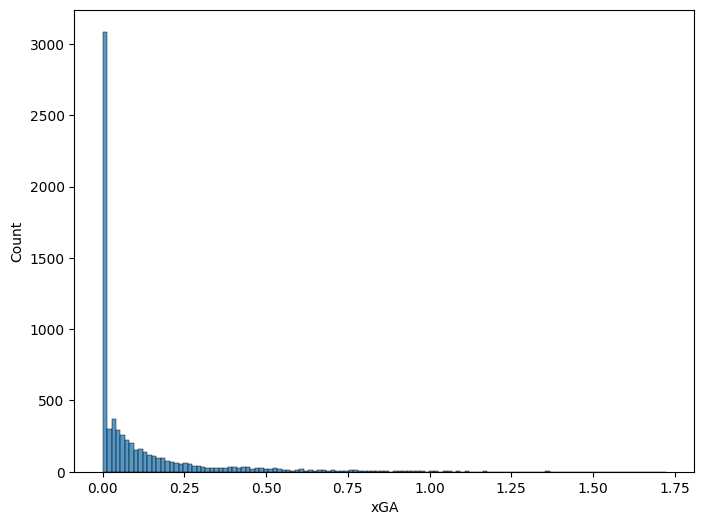

In [ ]:
plt.figure(figsize=(8,6))
sns.histplot(strikers7['xGA'])
plt.show()

PAxG - metryka mająca na celu wziąć pod uwagę ilość strzałow oraz xG

In [ ]:
paxg_list = []
for match in matches:
    paxg = (
        match[(match['type'] == "Shot") & (match['period'] < 3) & (match['position'].isin(forward_positions))]
        .assign(
            goal=lambda df: (df['shot_outcome'] == 'Goal').astype(int),  # 1 dla "Goal", inaczej 0
            PAxG_component=lambda df: (df['goal'] - df['shot_statsbomb_xg']) * (1 - df['shot_statsbomb_xg']),  # Obliczanie PAxG_component,
            shots_on_target = lambda df: (df['shot_outcome'].isin(['Saved', 'Saved To Post', 'Goal'])).astype(int)
            
        )
        .groupby(['player', 'match_id'])
        .agg(
            shots=('shot_statsbomb_xg', 'size'),
            PAxg=('PAxG_component', 'sum'),
            shots_on_target=('shots_on_target', 'sum')
        )
        .reset_index()
    )
    paxg['PAxG'] = paxg['PAxg'] + np.log(1 + paxg['shots_on_target']) # można zamienić na strzały celne zamiast wszystkich
    paxg = paxg[['player', 'match_id', 'PAxG']]
    paxg_list.append(paxg)
paxg_df = pd.concat(paxg_list, ignore_index=True)
# Obliczamy ostateczne PAxG

In [ ]:
paxg_df

,player,match_id,PAxG
0,Jhon Andrés Córdoba Copete,3943077,-0.195104
1,Julián Álvarez,3943077,-0.066935
2,Lionel Andrés Messi Cuccittini,3943077,-0.128430
3,Luis Fernando Díaz Marulanda,3943077,0.664263
4,Darwin Gabriel Núñez Ribeiro,3943076,-0.075907
...,...,...,...
8428,Édson Arantes do Nascimento,3888705,1.949081
8429,Edvaldo Izidio Neto,3888704,1.329935
8430,Just Louis Fontaine,3888704,1.377605
8431,Raymond Kopaszewski Wlodarczyck,3888704,-0.048865


In [ ]:
paxg_df = paxg_df[['player', 'match_id', 'PAxG']]

In [ ]:
strikers8 = strikers7.merge(paxg_df, on=['player', 'match_id'], how='left').fillna(0)

Wejścia w pole karne

Przekształćmy współrzędne

In [ ]:
for match in matches:
    # Handle 'location' field
    match[['x', 'y']] = match['location'].apply(
        lambda loc: pd.Series(loc if isinstance(loc, list) and len(loc) == 2 else [None, None])
    )

    # Handle 'pass_end_location' field
    match[['pass_end_x', 'pass_end_y']] = match['pass_end_location'].apply(
        lambda loc: pd.Series(loc if isinstance(loc, list) and len(loc) == 2 else [None, None])
    )

    # Handle 'carry_end_location' field
    match[['carry_end_x', 'carry_end_y']] = match['carry_end_location'].apply(
        lambda loc: pd.Series(loc if isinstance(loc, list) and len(loc) == 2 else [None, None])
    )

    # Handle 'shot_end_location' field
    match['shot_end_x'] = match['shot_end_location'].apply(
        lambda loc: loc[0] if isinstance(loc, list) and len(loc) >= 1 else None
    )
    match['shot_end_y'] = match['shot_end_location'].apply(
        lambda loc: loc[1] if isinstance(loc, list) and len(loc) >= 2 else None
    )


NameError: name 'matches' is not defined

In [ ]:
i=0
for match in matches:
    match['x'] *= 0.875
    match['y'] *= 0.85
    match['pass_end_x'] *= 0.875
    match['pass_end_y'] *= 0.85
    match['carry_end_x'] *= 0.875
    match['carry_end_y'] *= 0.85
    i+=1
    print(i)

1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
198
199
200
201
202
203
204
205
206
207
208
209
210
211
212
213
214
215
216
217
218
219
220
221
222
223
224
225
226
227
228
229
230
231
232
233
234
235
236
237
238
239
240
241
242
243
244
245
246
247
248
249
250
251
252
253
254
255
256
257
258
259
260
261
262
263
264
265
266
267
268
269
270
271
272
273
274
275
276
277


In [ ]:
a = []
for i in matches:
    a.append(i['x'].max())

In [ ]:
matches[1571]['x'].max()

105.0

In [ ]:
i=0
l = len(matches)
for match in matches[:1571]:
    match['x'] /= 0.875
    match['y'] /= 0.875
    match['pass_end_x'] /= 0.875
    match['pass_end_y'] /= 0.875
    match['carry_end_x'] /= 0.875
    match['carry_end_x'] /= 0.875
    i+=1
    print(i/l)

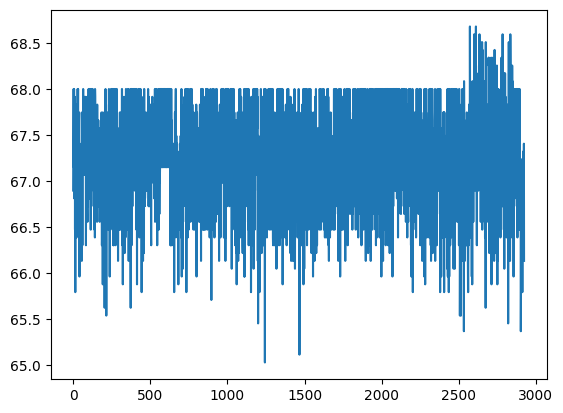

In [ ]:
a = []
for x in matches:
    a.append(x['carry_end_y'].max())

plt.plot(a)

In [ ]:
for match in matches:
    match['y'] *= 68/70

In [ ]:
for match in matches:
    match['pass_end_y'] *= 68/70

In [ ]:
for match in matches:
    match['carry_end_y'] *= 0.85

In [ ]:
matches[1570]['carry_end_x'] *= 0.875

In [ ]:
matches[1570]['pass_end_x'] *= 0.875

In [ ]:
matches[1570]['pass_end_y'] *= 0.875

In [ ]:
matches[1570]['carry_end_x'].max()

91.875

In [ ]:
for match in matches:
    match['carry_end_x'] /= 0.875

Podania

In [ ]:
good_passes_list = []
for match in matches:
    good_passes = match[(match['type'] == 'Pass') & (match['period'] < 3) & (match['pass_outcome'].isna()) & (match['position'].isin(forward_positions))].groupby(['player', 'match_id']).size().reset_index(name='good_passes').fillna(0)
    good_passes_list.append(good_passes)

good_passes_df = pd.concat(good_passes_list, ignore_index=True)

In [ ]:
good_passes_df.sort_values(by='good_passes')

,player,match_id,good_passes
7936,Joe Allen,3754212,1
602,Cédric Bakambu,3920418,1
2579,John Guidetti,7551,1
11764,Fredrik Ljungberg,3749278,1
6096,Ricardo Gabriel Álvarez,3879744,1
...,...,...,...
2361,Lionel Andrés Messi Cuccittini,303610,81
10754,Lionel Andrés Messi Cuccittini,266433,83
881,Neymar da Silva Santos Junior,3837771,85
10992,Lionel Andrés Messi Cuccittini,69302,88


In [ ]:
bad_passes_list = []
for match in matches:
    bad_passes = match[(match["type"] == "Pass") & (match['period'] < 3) & (match["pass_outcome"].isin(["Incomplete", "Out"]))].groupby(['player', 'match_id']).size().reset_index(name="bad_passes").fillna(0)
    bad_passes_list.append(bad_passes)

bad_passes_df = pd.concat(bad_passes_list, ignore_index=True)

In [ ]:
passes = good_passes_df.merge(bad_passes_df, on=['player', 'match_id'], how='outer').fillna(0)
passes

,player,match_id,good_passes,bad_passes
0,Jhon Andrés Córdoba Copete,3943077,10.0,1.0
1,Julián Álvarez,3943077,8.0,4.0
2,Lionel Andrés Messi Cuccittini,3943077,27.0,9.0
3,Luis Fernando Díaz Marulanda,3943077,20.0,2.0
4,Darwin Gabriel Núñez Ribeiro,3943076,4.0,2.0
...,...,...,...,...
78861,Orlando Peçanha de Carvalho,3888704,0.0,3.0
78862,Raymond Kaelbel,3888704,0.0,14.0
78863,Robert Jonquet,3888704,0.0,4.0
78864,Roger Piantoni,3888704,0.0,11.0


In [ ]:
strikers9 = strikers8.merge(passes, on=['match_id', 'player'], how='left').fillna(0)

In [ ]:
strikers9

,player,team,match_id,Events,minute,goals,assist,npxG,shots_on_target,shots_off_target,shots_accuracy_%,xGA,PAxG,good_passes,bad_passes
0,Jhon Andrés Córdoba Copete,Colombia,3943077,60,87.0,0.0,0.0,0.210564,0.0,1.0,0.000000,0.141692,-0.195104,10.0,1.0
1,Julián Álvarez,Argentina,3943077,92,90.0,0.0,0.0,0.072140,0.0,1.0,0.000000,0.000000,-0.066935,8.0,4.0
2,Luis Fernando Díaz Marulanda,Colombia,3943077,120,90.0,0.0,0.0,0.029771,1.0,0.0,1.000000,0.019571,0.664263,20.0,2.0
3,Darwin Gabriel Núñez Ribeiro,Uruguay,3942852,107,90.0,0.0,0.0,0.364153,0.0,3.0,0.000000,0.031680,-0.312458,16.0,2.0
4,Jhon Andrés Córdoba Copete,Colombia,3942852,86,75.0,0.0,0.0,0.148650,0.0,2.0,0.000000,0.058575,-0.137595,10.0,4.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6802,Édson Arantes do Nascimento,Brazil,3888705,261,90.0,2.0,0.0,1.052024,3.0,3.0,0.500000,0.265204,1.949081,39.0,11.0
6803,Edvaldo Izidio Neto,Brazil,3888704,255,90.0,1.0,0.0,1.172473,4.0,1.0,0.800000,0.967847,1.329935,41.0,16.0
6804,Just Louis Fontaine,France,3888704,220,90.0,1.0,0.0,1.053373,4.0,1.0,0.800000,0.103424,1.377605,25.0,13.0
6805,Raymond Kopaszewski Wlodarczyck,France,3888704,222,90.0,0.0,1.0,0.051519,0.0,0.0,0.000000,0.756699,-0.048865,31.0,14.0


In [ ]:
strikers9['passes_accuracy_%'] = strikers9['good_passes'] / (strikers9['good_passes'] + strikers9['bad_passes'])

In [ ]:
strikers9['passes_accuracy_%'] = strikers9['passes_accuracy_%'].fillna(0)

In [ ]:
strikers9.sort_values(by='bad_passes')

,player,team,match_id,Events,minute,goals,assist,npxG,shots_on_target,shots_off_target,shots_accuracy_%,xGA,PAxG,good_passes,bad_passes,passes_accuracy_%
199,Jan Thielmann,FC Köln,3895258,22,90.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.000000,0.000000,2.0,0.0,1.000000
4140,Leonardo Pavoletti,Genoa,3878554,18,71.0,1.0,0.0,0.538540,2.0,0.0,1.0,0.000000,1.324330,1.0,0.0,1.000000
43,Carmelo Algarañaz Añez,Bolivia,3939982,98,81.0,0.0,0.0,0.011729,1.0,1.0,0.5,0.000000,0.681487,7.0,0.0,1.000000
6424,Bojan Krkíc Pérez,Barcelona,69181,117,79.0,1.0,0.0,0.072039,1.0,0.0,1.0,0.057230,1.554259,20.0,0.0,1.000000
2901,Salomon Armand Magloire Kalou,Hertha Berlin,3890390,136,77.0,0.0,0.0,0.067323,0.0,0.0,0.0,0.024079,-0.062790,26.0,0.0,1.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4463,Troy Deeney,Watford,3754291,136,90.0,0.0,1.0,0.000000,0.0,0.0,0.0,0.657340,0.000000,20.0,25.0,0.444444
4055,Anthony Mounier,Bologna,3879552,84,90.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.000000,0.000000,12.0,26.0,0.315789
2533,Pascal Groß,Ingolstadt,3890544,63,90.0,0.0,0.0,0.461683,1.0,1.0,0.5,0.066985,0.357015,6.0,28.0,0.176471
6112,Lionel Andrés Messi Cuccittini,Barcelona,69329,337,90.0,0.0,0.0,0.308568,2.0,2.0,0.5,0.259185,0.642767,62.0,30.0,0.673913


In [ ]:
start_min = pd.DataFrame()

for match in matches:

#if ((match[match['type'] == 'Substitution']['position'].isin(forward_positions).any()) ):
    if 'substitution_replacement' in match.columns:
        start_minute = match[match['type'] == 'Substitution'][['minute', 'position', 'player', 'substitution_replacement', 'match_id']]
    #start_minute = start_minute[start_minute['position'].isin(forward_positions)]
        start_min = pd.concat([start_min, start_minute], ignore_index=True)

subs_off = pd.DataFrame({'player':start_min['player'], 'minute':start_min['minute'], 'match_id':start_min['match_id']})
subs_on = pd.DataFrame({'player':start_min['substitution_replacement'], 'minute':90-start_min['minute'], 'match_id':start_min['match_id']})
subs_all = pd.concat([subs_off, subs_on], ignore_index=True)

s_list = []
for match in matches:
    a = match.groupby(['player', 'match_id', 'position']).size().reset_index(name='x')
    s_list.append(a)
s_df = pd.concat(s_list, ignore_index=True)

a2 = subs.merge(s_df, on=['match_id', 'player'], how='left')
a3 = a2[a2['position'].isin(forward_positions)]
sub_df = a3.drop_duplicates(subset=['player', 'match_id'])

Zmiany

In [ ]:
start_min = pd.DataFrame()

for match in matches:

#if ((match[match['type'] == 'Substitution']['position'].isin(forward_positions).any()) ):
    if 'substitution_replacement' in match.columns:
        start_minute = match[match['type'] == 'Substitution'][['minute', 'position', 'player', 'substitution_replacement', 'match_id']]
    #start_minute = start_minute[start_minute['position'].isin(forward_positions)]
        start_min = pd.concat([start_min, start_minute], ignore_index=True)

subs_off = pd.DataFrame({'player':start_min['player'], 'minute':start_min['minute'], 'match_id':start_min['match_id']})
subs_on = pd.DataFrame({'player':start_min['substitution_replacement'], 'minute':90-start_min['minute'], 'match_id':start_min['match_id']})
subs_all = pd.concat([subs_off, subs_on], ignore_index=True)

In [ ]:
s_list = []
for match in matches:
    a = match.groupby(['player', 'match_id', 'position']).size().reset_index(name='x')
    s_list.append(a)
s_df = pd.concat(s_list, ignore_index=True)

In [ ]:
a2 = subs_all.merge(s_df, on=['match_id', 'player'], how='left')
a3 = a2[a2['position'].isin(forward_positions)]

In [ ]:
a4 = a3.drop_duplicates(subset=['player', 'match_id'])
a4[a4['match_id'] == 3754055]

,player,minute,match_id,position,x
14101,Bertrand Isidore Traoré,73,3754055,Center Forward,145.0
36251,Tammy Bakumo-Abraham,17,3754055,Center Forward,38.0
36254,Christian Benteke Liolo,16,3754055,Left Center Forward,8.0


In [ ]:
a4.minute.describe()

count    8031.000000
mean       44.406301
std        28.759602
min       -27.000000
25%        18.000000
50%        45.000000
75%        72.000000
max       116.000000
Name: minute, dtype: float64

In [ ]:
strikers8.minute.describe()

count    8031.000000
mean       87.563442
std         5.145086
min        71.000000
25%        90.000000
50%        90.000000
75%        90.000000
max        90.000000
Name: minute, dtype: float64

In [ ]:
len(a4[a4['minute'] > 0])

6984

Metryka PAxG

In [ ]:
paxg_list = []
for match in matches:
    paxg = (
        match[(match['type'] == "Shot") & (match['period'] < 3) & (match['position'].isin(forward_positions))]
        .assign(
            goal=lambda df: (df['shot_outcome'] == 'Goal').astype(int),  # 1 dla "Goal", inaczej 0
            PAxG_component=lambda df: (df['goal'] - df['shot_statsbomb_xg']) * (1 - df['shot_statsbomb_xg']),  # Obliczanie PAxG_component,
            shots_on_target = lambda df: (df['shot_outcome'].isin(['Saved', 'Saved To Post', 'Goal'])).astype(int)
            
        )
        .groupby(['player', 'match_id'])
        .agg(
            shots=('shot_statsbomb_xg', 'size'),
            PAxg=('PAxG_component', 'sum'),
            shots_on_target=('shots_on_target', 'sum')
        )
        .reset_index()
    )
    paxg['PAxG'] = paxg['PAxg'] + np.log(1 + paxg['shots_on_target']) # można zamienić na strzały celne zamiast wszystkich
    paxg = paxg[['player', 'match_id', 'PAxG']]
    paxg_list.append(paxg)
paxg_df = pd.concat(paxg_list, ignore_index=True)
# Obliczamy ostateczne PAxG



In [ ]:
paxg_df

,player,match_id,PAxG
0,Jhon Andrés Córdoba Copete,3943077,-0.195104
1,Julián Álvarez,3943077,-0.066935
2,Lionel Andrés Messi Cuccittini,3943077,-0.128430
3,Luis Fernando Díaz Marulanda,3943077,0.664263
4,Darwin Gabriel Núñez Ribeiro,3943076,-0.075907
...,...,...,...
8428,Édson Arantes do Nascimento,3888705,1.949081
8429,Edvaldo Izidio Neto,3888704,1.329935
8430,Just Louis Fontaine,3888704,1.377605
8431,Raymond Kopaszewski Wlodarczyck,3888704,-0.048865


In [ ]:
strikers3.merge(paxg_df, on=['match_id', 'player'], how='left').fillna(0).sort_values(by='PAxG').tail(20)

,player,team,match_id,Events,minute,goals,PAxG
6167,Lionel Andrés Messi Cuccittini,Barcelona,69320,194,90.0,2.0,3.248342
6244,David Villa Sánchez,Barcelona,69289,113,90.0,2.0,3.254591
1079,Patrik Schick,Czech Republic,3788748,166,86.0,2.0,3.306557
2709,André Schürrle,Wolfsburg,3890466,154,86.0,3.0,3.309391
6000,Lionel Andrés Messi Cuccittini,Barcelona,266074,225,90.0,3.0,3.333264
6124,Lionel Andrés Messi Cuccittini,Barcelona,69335,340,90.0,3.0,3.387042
967,Lionel Andrés Messi Cuccittini,Barcelona,3773526,257,90.0,2.0,3.392862
4187,Olivier Giroud,Arsenal,3754041,107,90.0,3.0,3.396349
6396,Samuel Eto''o Fils,Barcelona,69279,145,75.0,4.0,3.458465
6134,Lionel Andrés Messi Cuccittini,Barcelona,70225,273,90.0,3.0,3.508863


In [ ]:
strikers3

,player,team,match_id,Events,minute,goals
0,Jhon Andrés Córdoba Copete,Colombia,3943077,60,87.0,0.0
1,Julián Álvarez,Argentina,3943077,92,90.0,0.0
2,Luis Fernando Díaz Marulanda,Colombia,3943077,120,90.0,0.0
3,Darwin Gabriel Núñez Ribeiro,Uruguay,3942852,107,90.0,0.0
4,Jhon Andrés Córdoba Copete,Colombia,3942852,86,75.0,0.0
...,...,...,...,...,...,...
6802,Édson Arantes do Nascimento,Brazil,3888705,261,90.0,2.0
6803,Edvaldo Izidio Neto,Brazil,3888704,255,90.0,1.0
6804,Just Louis Fontaine,France,3888704,220,90.0,1.0
6805,Raymond Kopaszewski Wlodarczyck,France,3888704,222,90.0,0.0


<Axes: xlabel='PAxG', ylabel='Count'>

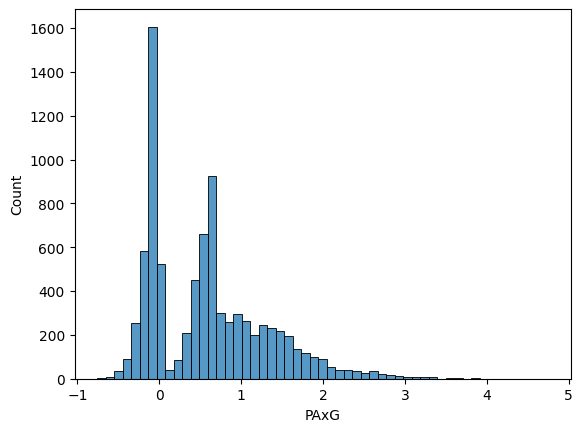

In [ ]:
sns.histplot(paxg_df['PAxG'])

In [ ]:
paxg_df.sort_values(by='PAxG')

,player,match_id,PAxG
2604,Duje Čop,3825616,0.443147
3635,Kevin Volland,3890389,0.443147
5955,Arouna Koné,3754127,0.443149
3114,Sabin Merino Zuloaga,266149,0.443151
2450,Mamadou Sylla Diallo,3825772,0.443153
...,...,...,...
6113,Andy Carroll,3754241,4.291020
1878,Lionel Andrés Messi Cuccittini,9609,4.386027
4508,Jesús Joaquín Fernández Sáez de la Torre,3879804,4.568158
6553,Zlatan Ibrahimović,3901183,4.995195


In [ ]:
strikers8.columns

Index(['player', 'team', 'match_id', 'Events', 'minute', 'goals', 'assist',
       'npxG', 'shots_on_target', 'shots_off_target', 'shots_accuracy_%',
       'xGA', 'good_passes', 'bad_passes', 'passes_accuracy_%'],
      dtype='object')

In [ ]:
strikers8.merge(paxg_df, on=['match_id', 'player'], how='left').fillna(0)[['player', 'match_id','shots_on_target', 'shots_off_target' ,'goals', 'npxG', 'PAxG']].sort_values(by='PAxG')

,player,match_id,shots_on_target,shots_off_target,goals,npxG,PAxG
4480,Miroslav Klose,3879711,0.0,0.0,0.0,0.000000,0.000000
1214,José Luis Sanmartín Mato,3773526,0.0,0.0,0.0,0.000000,0.000000
3997,Cyril Théréau,3879783,0.0,0.0,0.0,0.000000,0.000000
7986,Ralf Edström,3888716,0.0,0.0,0.0,0.000000,0.000000
7108,Leonardo Carrilho Baptistão,267368,0.0,0.0,0.0,0.000000,0.000000
...,...,...,...,...,...,...,...
5735,Andy Carroll,3754241,5.0,1.0,3.0,0.750887,4.291020
1747,Lionel Andrés Messi Cuccittini,9609,7.0,1.0,3.0,0.556429,4.386027
4320,Jesús Joaquín Fernández Sáez de la Torre,3879804,3.0,2.0,3.0,0.134340,4.568158
6163,Zlatan Ibrahimović,3901183,5.0,3.0,4.0,0.736621,4.995195


In [ ]:
strikers8

,player,team,match_id,Events,minute,goals,assist,npxG,shots_on_target,shots_off_target,shots_accuracy_%,xGA,good_passes,bad_passes,passes_accuracy_%
0,Jhon Andrés Córdoba Copete,Colombia,3943077,60,87.0,0.0,0.0,0.210564,0.0,1.0,0.000000,0.141692,10.0,1.0,0.909091
1,Julián Álvarez,Argentina,3943077,92,90.0,0.0,0.0,0.072140,0.0,1.0,0.000000,0.000000,8.0,4.0,0.666667
2,Luis Fernando Díaz Marulanda,Colombia,3943077,120,90.0,0.0,0.0,0.029771,1.0,0.0,1.000000,0.019571,20.0,2.0,0.909091
3,Thelonius Bair,Canada,3943076,14,90.0,0.0,0.0,0.000000,0.0,0.0,0.000000,0.000000,2.0,1.0,0.666667
4,Darwin Gabriel Núñez Ribeiro,Uruguay,3942852,107,90.0,0.0,0.0,0.364153,0.0,3.0,0.000000,0.031680,16.0,2.0,0.888889
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8026,Édson Arantes do Nascimento,Brazil,3888705,261,90.0,2.0,0.0,1.052024,3.0,3.0,0.500000,0.265204,39.0,11.0,0.780000
8027,Edvaldo Izidio Neto,Brazil,3888704,255,90.0,1.0,0.0,1.172473,4.0,1.0,0.800000,0.967847,41.0,16.0,0.719298
8028,Just Louis Fontaine,France,3888704,220,90.0,1.0,0.0,1.053373,4.0,1.0,0.800000,0.103424,25.0,13.0,0.657895
8029,Raymond Kopaszewski Wlodarczyck,France,3888704,222,90.0,0.0,1.0,0.051519,0.0,0.0,0.000000,0.756699,31.0,14.0,0.688889


Stwórzmy teraz poglądowy model.
Do modelu weźmiemy:
- PAxG
- xGA
- accuracy passes %.
Dla 1 modelu użyje normalizacji z-score danych, następnie ustalę sam wagi i wyliczę ocenę od 1 do 10 dla wybranego zawodnika.

In [ ]:
euro_2024 = list(sb.matches(season_id=282, competition_id=55)['match_id'])[:10]
strikers_euro = strikers9[strikers9['match_id'].isin(euro_2024)]
strikers_not_euro = strikers9[~ (strikers9['match_id'].isin(euro_2024))]

Obliczmy z-score

In [ ]:
import warnings
warnings.filterwarnings('ignore', category=DeprecationWarning)

In [ ]:
example_model_s = strikers_not_euro[['player', 'match_id', 'team', 'PAxG', 'xGA', 'passes_accuracy_%']]
example_model_s['PAxG_zscore'] = (example_model_s['PAxG'] - example_model_s['PAxG'].mean()) / example_model_s['PAxG'].std()

example_model_s['xGA_zscore'] = (example_model_s['xGA'] - example_model_s['xGA'].mean()) / example_model_s['xGA'].std()

example_model_s['passes_accuracy_%_zscore'] = (example_model_s['passes_accuracy_%'] - example_model_s['passes_accuracy_%'].mean()) / example_model_s['passes_accuracy_%'].std()

example_model_s

C:\Users\macie\AppData\Local\Temp\ipykernel_11712\989577838.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  example_model_s['PAxG_zscore'] = (example_model_s['PAxG'] - example_model_s['PAxG'].mean()) / example_model_s['PAxG'].std()
C:\Users\macie\AppData\Local\Temp\ipykernel_11712\989577838.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  example_model_s['xGA_zscore'] = (example_model_s['xGA'] - example_model_s['xGA'].mean()) / example_model_s['xGA'].std()
C:\Users\macie\AppData\Local\Temp\ipykernel_

,player,match_id,team,PAxG,xGA,passes_accuracy_%,PAxG_zscore,xGA_zscore,passes_accuracy_%_zscore
0,Jhon Andrés Córdoba Copete,3943077,Colombia,-0.195104,0.141692,0.909091,-1.047132,0.183750,1.321513
1,Julián Álvarez,3943077,Argentina,-0.066935,0.000000,0.666667,-0.872570,-0.573054,-0.044703
2,Luis Fernando Díaz Marulanda,3943077,Colombia,0.664263,0.019571,0.909091,0.123298,-0.468523,1.321513
3,Darwin Gabriel Núñez Ribeiro,3942852,Uruguay,-0.312458,0.031680,0.888889,-1.206963,-0.403843,1.207662
4,Jhon Andrés Córdoba Copete,3942852,Colombia,-0.137595,0.058575,0.714286,-0.968806,-0.260195,0.223661
...,...,...,...,...,...,...,...,...,...
6802,Édson Arantes do Nascimento,3888705,Brazil,1.949081,0.265204,0.780000,1.873178,0.843454,0.594003
6803,Edvaldo Izidio Neto,3888704,Brazil,1.329935,0.967847,0.719298,1.029922,4.596405,0.251910
6804,Just Louis Fontaine,3888704,France,1.377605,0.103424,0.657895,1.094847,-0.020646,-0.094139
6805,Raymond Kopaszewski Wlodarczyck,3888704,France,-0.048865,0.756699,0.688889,-0.847959,3.468625,0.080533


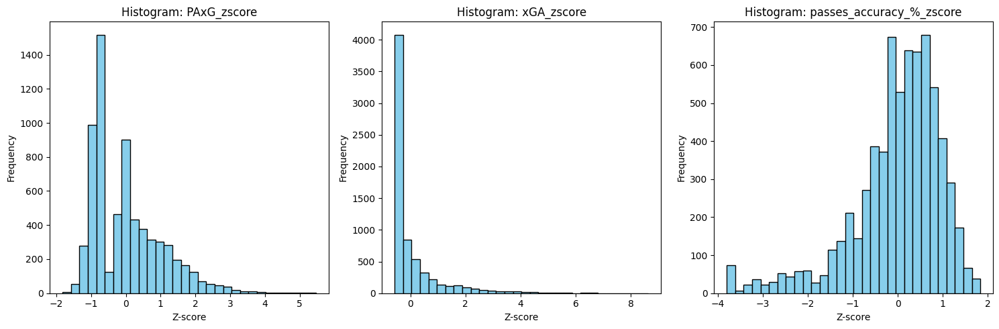

In [ ]:
import matplotlib.pyplot as plt

# Lista kolumn ze znormalizowanymi wartościami
zscore_columns = ['PAxG_zscore', 'xGA_zscore', 'passes_accuracy_%_zscore']

# Tworzymy histogram dla każdej kolumny
plt.figure(figsize=(15, 5))

for i, col in enumerate(zscore_columns):
    plt.subplot(1, len(zscore_columns), i + 1)
    plt.hist(example_model_s[col], bins=30, color='skyblue', edgecolor='black')
    plt.title(f'Histogram: {col}')
    plt.xlabel('Z-score')
    plt.ylabel('Frequency')

# Wyświetlamy wykresy
plt.tight_layout()
plt.show()


Ocena to z-score * waga, wagi:
- paxg .6
- xga .25
- passes% .15

In [ ]:
example_model_s['zscore'] = example_model_s['PAxG_zscore'] * 0.6 + example_model_s['xGA_zscore'] * 0.25 + example_model_s['passes_accuracy_%_zscore'] * 0.15
example_model_s

C:\Users\macie\AppData\Local\Temp\ipykernel_11712\2765663551.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  example_model_s['zscore'] = example_model_s['PAxG_zscore'] * 0.6 + example_model_s['xGA_zscore'] * 0.25 + example_model_s['passes_accuracy_%_zscore'] * 0.15


,player,match_id,team,PAxG,xGA,passes_accuracy_%,PAxG_zscore,xGA_zscore,passes_accuracy_%_zscore,zscore
0,Jhon Andrés Córdoba Copete,3943077,Colombia,-0.195104,0.141692,0.909091,-1.047132,0.183750,1.321513,-0.384115
1,Julián Álvarez,3943077,Argentina,-0.066935,0.000000,0.666667,-0.872570,-0.573054,-0.044703,-0.673511
2,Luis Fernando Díaz Marulanda,3943077,Colombia,0.664263,0.019571,0.909091,0.123298,-0.468523,1.321513,0.155075
3,Darwin Gabriel Núñez Ribeiro,3942852,Uruguay,-0.312458,0.031680,0.888889,-1.206963,-0.403843,1.207662,-0.643989
4,Jhon Andrés Córdoba Copete,3942852,Colombia,-0.137595,0.058575,0.714286,-0.968806,-0.260195,0.223661,-0.612783
...,...,...,...,...,...,...,...,...,...,...
6802,Édson Arantes do Nascimento,3888705,Brazil,1.949081,0.265204,0.780000,1.873178,0.843454,0.594003,1.423871
6803,Edvaldo Izidio Neto,3888704,Brazil,1.329935,0.967847,0.719298,1.029922,4.596405,0.251910,1.804841
6804,Just Louis Fontaine,3888704,France,1.377605,0.103424,0.657895,1.094847,-0.020646,-0.094139,0.637626
6805,Raymond Kopaszewski Wlodarczyck,3888704,France,-0.048865,0.756699,0.688889,-0.847959,3.468625,0.080533,0.370461


<Axes: xlabel='zscore', ylabel='Count'>

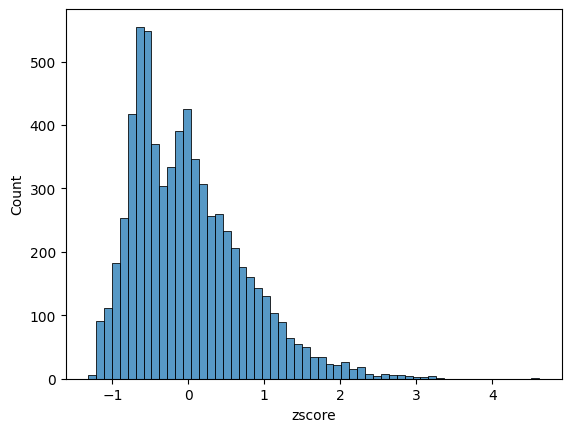

In [ ]:
sns.histplot(example_model_s['zscore'])

In [ ]:
example_model_s.zscore.describe()

count    6.791000e+03
mean     6.748639e-17
std      7.331485e-01
min     -1.317149e+00
25%     -5.747948e-01
50%     -1.114474e-01
75%      4.269871e-01
max      4.616830e+00
Name: zscore, dtype: float64

In [ ]:
example_model_s

,player,match_id,team,PAxG,xGA,passes_accuracy_%,PAxG_zscore,xGA_zscore,passes_accuracy_%_zscore,zscore
0,Jhon Andrés Córdoba Copete,3943077,Colombia,-0.195104,0.141692,0.909091,-1.047132,0.183750,1.321513,-0.384115
1,Julián Álvarez,3943077,Argentina,-0.066935,0.000000,0.666667,-0.872570,-0.573054,-0.044703,-0.673511
2,Luis Fernando Díaz Marulanda,3943077,Colombia,0.664263,0.019571,0.909091,0.123298,-0.468523,1.321513,0.155075
3,Darwin Gabriel Núñez Ribeiro,3942852,Uruguay,-0.312458,0.031680,0.888889,-1.206963,-0.403843,1.207662,-0.643989
4,Jhon Andrés Córdoba Copete,3942852,Colombia,-0.137595,0.058575,0.714286,-0.968806,-0.260195,0.223661,-0.612783
...,...,...,...,...,...,...,...,...,...,...
6802,Édson Arantes do Nascimento,3888705,Brazil,1.949081,0.265204,0.780000,1.873178,0.843454,0.594003,1.423871
6803,Edvaldo Izidio Neto,3888704,Brazil,1.329935,0.967847,0.719298,1.029922,4.596405,0.251910,1.804841
6804,Just Louis Fontaine,3888704,France,1.377605,0.103424,0.657895,1.094847,-0.020646,-0.094139,0.637626
6805,Raymond Kopaszewski Wlodarczyck,3888704,France,-0.048865,0.756699,0.688889,-0.847959,3.468625,0.080533,0.370461


In [ ]:
example_model_s['rating'] = 1 + 9 * ((example_model_s['zscore'] - example_model_s['zscore'].min()) / (example_model_s['zscore'].max() - example_model_s['zscore'].min()))


C:\Users\macie\AppData\Local\Temp\ipykernel_11712\430730358.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  example_model_s['rating'] = 1 + 9 * ((example_model_s['zscore'] - example_model_s['zscore'].min()) / (example_model_s['zscore'].max() - example_model_s['zscore'].min()))


In [ ]:
example_model_s.sort_values(by='rating')

,player,match_id,team,PAxG,xGA,passes_accuracy_%,PAxG_zscore,xGA_zscore,passes_accuracy_%_zscore,zscore,rating
1735,Fabián Ariel Orellana Valenzuela,3825819,Celta Vigo,-0.244498,0.000000,0.076923,-1.114405,-0.573054,-3.368287,-1.317149,1.000000
2689,Thorgan Hazard,3890475,Borussia Mönchengladbach,-0.236726,0.000000,0.100000,-1.103820,-0.573054,-3.238234,-1.291290,1.039220
1396,Olivier Giroud,8655,France,-0.760670,0.000000,0.647059,-1.817413,-0.573054,-0.155206,-1.256992,1.091240
5628,Yassine Benzia,3900513,Lille,-0.165398,0.000000,0.076923,-1.006673,-0.573054,-3.368287,-1.252510,1.098037
5338,Nicolas de Roussel de Préville,3900599,Stade de Reims,-0.253014,0.000000,0.166667,-1.126003,-0.573054,-2.862524,-1.248244,1.104508
...,...,...,...,...,...,...,...,...,...,...,...
580,Kylian Mbappé Lottin,3803000,Paris Saint-Germain,3.212537,0.811889,0.822222,3.593965,3.763407,0.831952,3.222024,7.884513
3617,Jesús Joaquín Fernández Sáez de la Torre,3879804,Genoa,4.162693,0.302660,0.711538,4.888045,1.043512,0.208178,3.224932,7.888924
6269,Zlatan Ibrahimović,69253,Barcelona,3.178875,0.865658,0.800000,3.548118,4.050594,0.706716,3.247527,7.923193
607,Kylian Mbappé Lottin,3802818,Paris Saint-Germain,2.889141,1.086197,0.833333,3.153510,5.228540,0.894570,3.333427,8.053476


In [ ]:
example_model_s[['player', 'PAxG', 'xGA', 'passes_accuracy_%']]

,player,PAxG,xGA,passes_accuracy_%
0,Jhon Andrés Córdoba Copete,-0.195104,0.141692,0.909091
1,Julián Álvarez,-0.066935,0.000000,0.666667
2,Luis Fernando Díaz Marulanda,0.664263,0.019571,0.909091
3,Darwin Gabriel Núñez Ribeiro,-0.312458,0.031680,0.888889
4,Jhon Andrés Córdoba Copete,-0.137595,0.058575,0.714286
...,...,...,...,...
6802,Édson Arantes do Nascimento,1.949081,0.265204,0.780000
6803,Edvaldo Izidio Neto,1.329935,0.967847,0.719298
6804,Just Louis Fontaine,1.377605,0.103424,0.657895
6805,Raymond Kopaszewski Wlodarczyck,-0.048865,0.756699,0.688889


<Axes: xlabel='zscore', ylabel='Count'>

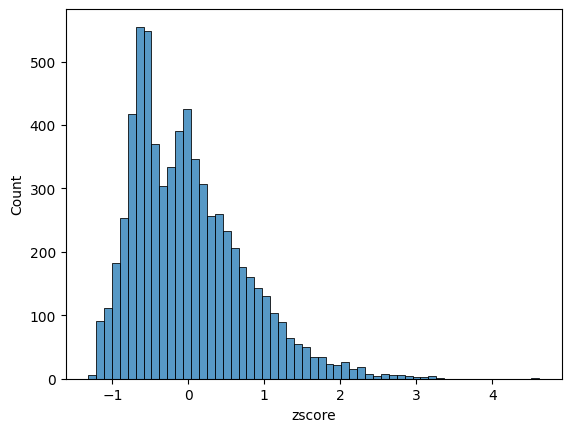

In [ ]:
sns.histplot(example_model_s['zscore'])

Standaryzacja quantile

In [ ]:
from sklearn.preprocessing import QuantileTransformer

In [ ]:
qt = QuantileTransformer(output_distribution='normal', random_state=42)

In [ ]:
example_model_s[['PAxG_q', 'xGA_q', 'passes_accuracy%_q']] = qt.fit_transform(example_model_s[['PAxG', 'xGA', 'passes_accuracy_%']])

C:\Users\macie\AppData\Local\Temp\ipykernel_11712\2602163263.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  example_model_s[['PAxG_q', 'xGA_q', 'passes_accuracy%_q']] = qt.fit_transform(example_model_s[['PAxG', 'xGA', 'passes_accuracy_%']])
C:\Users\macie\AppData\Local\Temp\ipykernel_11712\2602163263.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  example_model_s[['PAxG_q', 'xGA_q', 'passes_accuracy%_q']] = qt.fit_transform(example_model_s[['PAxG', 'xGA', 'passes_accuracy_%']])
C:\Users\macie\AppDa

In [ ]:
example_model_s.sort_values(by='PAxG_q')

,player,match_id,team,PAxG,xGA,passes_accuracy_%,PAxG_zscore,xGA_zscore,passes_accuracy_%_zscore,zscore,rating,PAxG_q,xGA_q,passes_accuracy%_q
1396,Olivier Giroud,8655,France,-0.760670,0.000000,0.647059,-1.817413,-0.573054,-0.155206,-1.256992,1.091240,-5.199338,-5.199338,-0.401995
3772,Edin Džeko,3879691,AS Roma,-0.666790,0.000000,0.739130,-1.689552,-0.573054,0.363677,-1.102443,1.325643,-3.317311,-5.199338,0.244548
571,Jonathan David,3857268,Canada,-0.618856,0.000000,0.681818,-1.624267,-0.573054,0.040685,-1.111721,1.311571,-3.200277,-5.199338,-0.175278
6780,Édson Arantes do Nascimento,3889218,Brazil,-0.598479,0.486101,0.925926,-1.596516,2.023310,1.416389,-0.239624,2.634271,-3.161382,1.605809,2.033104
2677,Haris Seferović,3890479,Eintracht Frankfurt,-0.595285,0.283469,0.645161,-1.592165,0.941010,-0.165900,-0.744931,1.867877,-3.155698,1.187257,-0.415634
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4833,Andy Carroll,3754241,West Ham United,3.885555,0.172634,0.714286,4.510592,0.349020,0.223661,2.827160,7.285627,3.166293,0.854494,0.057742
2832,Alexander Meier,3890420,Eintracht Frankfurt,3.895566,0.056549,0.789474,4.524227,-0.271014,0.647393,2.743892,7.159336,3.170456,0.249805,0.639462
3617,Jesús Joaquín Fernández Sáez de la Torre,3879804,Genoa,4.162693,0.302660,0.711538,4.888045,1.043512,0.208178,3.224932,7.888924,3.308997,1.231626,0.031385
1438,Lionel Andrés Messi Cuccittini,9609,Barcelona,4.268244,0.000000,0.775000,5.031803,-0.573054,0.565825,2.960692,7.488154,3.387674,-5.199338,0.523537


<Axes: xlabel='PAxG_q', ylabel='Count'>

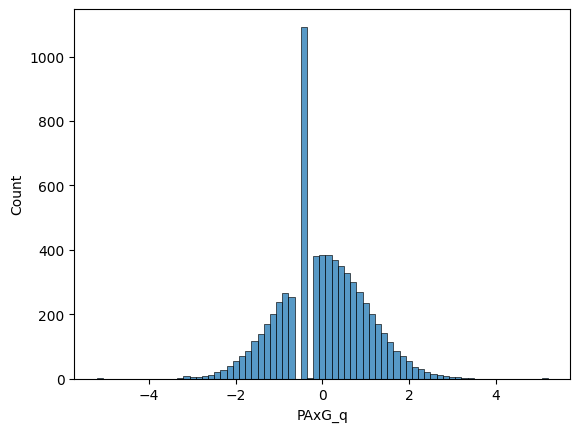

In [ ]:
sns.histplot(example_model_s['PAxG_q'])

<Axes: xlabel='xGA_q', ylabel='Count'>

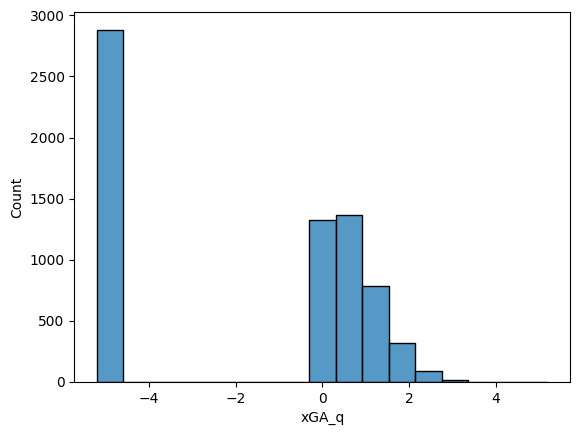

In [ ]:
sns.histplot(example_model_s['xGA_q'])

<Axes: xlabel='passes_accuracy%_q', ylabel='Count'>

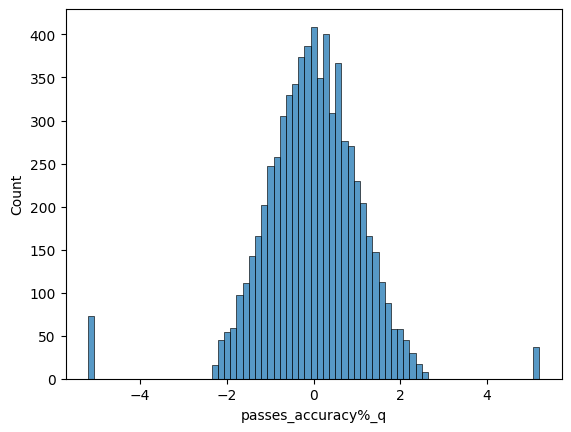

In [ ]:
sns.histplot(example_model_s['passes_accuracy%_q'])

In [ ]:
example_model_s['xga_log'] = example_model_s['xGA'] + 0.001
example_model_s['xga_log'] = np.log(example_model_s['xga_log'])

C:\Users\macie\AppData\Local\Temp\ipykernel_11712\1144915790.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  example_model_s['xga_log'] = example_model_s['xGA'] + 0.001
C:\Users\macie\AppData\Local\Temp\ipykernel_11712\1144915790.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  example_model_s['xga_log'] = np.log(example_model_s['xga_log'])


<Axes: xlabel='xga_log', ylabel='Count'>

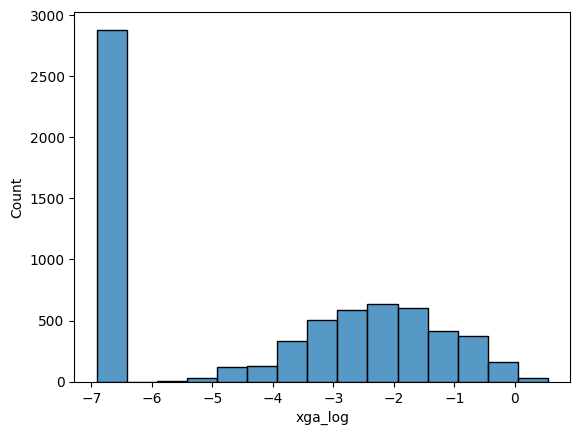

In [ ]:
sns.histplot(example_model_s['xga_log'])

In [ ]:
weights = {'PAxG': 0.5, 'xGA': 0.2, 'passes_accuracy_%': 0.3}

# Obliczenie oceny
example_model_s['Score'] = (
    weights['PAxG'] * example_model_s['PAxG_q'] +
    weights['xGA'] * example_model_s['xGA_q'] +
    weights['passes_accuracy_%'] * example_model_s['passes_accuracy%_q']
)

# Przeskalowanie do przedziału 1.0–10.0
example_model_s['Score'] = 1 + 9 * (example_model_s['Score'] - example_model_s['Score'].min()) / (
    example_model_s['Score'].max() - example_model_s['Score'].min()
)



<Axes: xlabel='Score', ylabel='Count'>

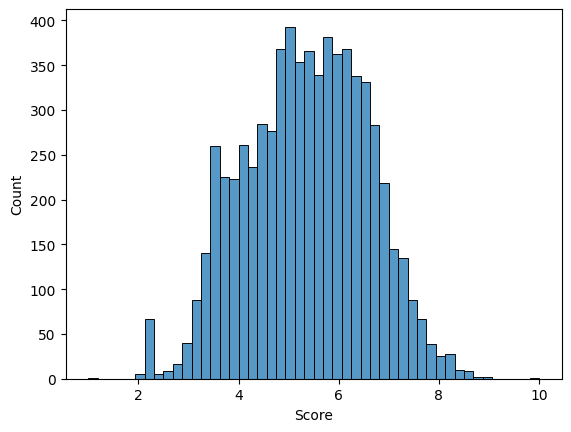

In [ ]:
sns.histplot(example_model_s['Score'])

In [ ]:
example_model_s.Score.describe()

count    6791.000000
mean        5.349312
std         1.223629
min         1.000000
25%         4.457887
50%         5.396682
75%         6.263088
max        10.000000
Name: Score, dtype: float64

Narazie w modelu mamy:
- paxg
- xga
- passes accuracy
Teraz będę chciał dodać:
- wygrane pojedynki
- dotknięcia w polu karnym przeciwnika
- gole
- asysty

Stwórzmy wykres dla bramek i radar plota dla danego piłkarza

In [ ]:
strikers9['goals'].describe()

count    6807.000000
mean        0.332452
std         0.606636
min         0.000000
25%         0.000000
50%         0.000000
75%         1.000000
max         4.000000
Name: goals, dtype: float64

Histogram

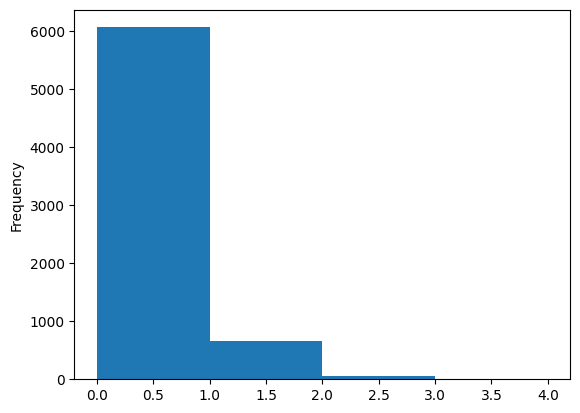

In [ ]:
strikers9['assist'].plot(kind='hist', bins=range(0,5))
plt.show()

In [ ]:
strikers9['goals_pct'] = strikers9['goals'].rank(pct=True)
strikers9[['goals', 'goals_pct']]

,goals,goals_pct
0,0.0,0.365506
1,0.0,0.365506
2,0.0,0.365506
3,0.0,0.365506
4,0.0,0.365506
...,...,...
6802,2.0,0.968709
6803,1.0,0.838402
6804,1.0,0.838402
6805,0.0,0.365506


In [ ]:
strikers9['assist_pct'] = strikers9['assist'].rank(pct=True)
strikers9[['assist', 'assist_pct']]

,assist,assist_pct
0,0.0,0.445865
1,0.0,0.445865
2,0.0,0.445865
3,0.0,0.445865
4,0.0,0.445865
...,...,...
6802,0.0,0.445865
6803,0.0,0.445865
6804,0.0,0.445865
6805,1.0,0.940723


Dotknięcia w polu karnym przeciwinika

In [ ]:
test_match = matches[0]

In [ ]:
test_match.columns

Index(['50_50', 'bad_behaviour_card', 'ball_receipt_outcome',
       'ball_recovery_offensive', 'ball_recovery_recovery_failure',
       'block_deflection', 'block_offensive', 'carry_end_location',
       'clearance_aerial_won', 'clearance_body_part', 'clearance_head',
       'clearance_left_foot', 'clearance_right_foot', 'counterpress',
       'dribble_nutmeg', 'dribble_outcome', 'dribble_overrun', 'duel_outcome',
       'duel_type', 'duration', 'foul_committed_advantage',
       'foul_committed_card', 'foul_committed_type', 'foul_won_advantage',
       'foul_won_defensive', 'goalkeeper_body_part', 'goalkeeper_end_location',
       'goalkeeper_outcome', 'goalkeeper_position', 'goalkeeper_technique',
       'goalkeeper_type', 'id', 'index', 'injury_stoppage_in_chain',
       'interception_outcome', 'location', 'match_id', 'minute', 'off_camera',
       'out', 'pass_aerial_won', 'pass_angle', 'pass_assisted_shot_id',
       'pass_body_part', 'pass_cross', 'pass_cut_back', 'pass_end_loca

In [ ]:
a = matches[0][~matches[0]['carry_end_x'].isna()]['carry_end_x']

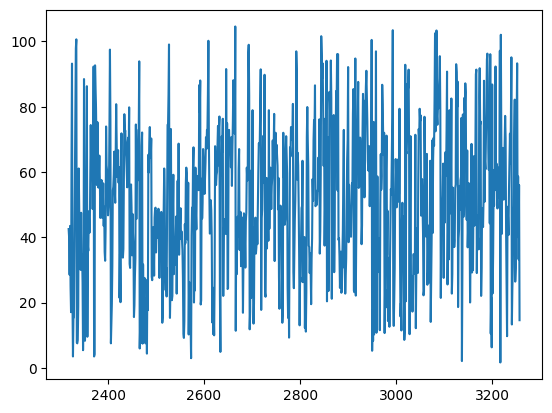

In [ ]:
plt.plot(a)

In [ ]:
matches[0]['y'].max()

70.0

Wejścia w pole karne

In [ ]:
len(matches)

2924

In [ ]:
ecu_jam = matches[32]
shots = ecu_jam[
    (ecu_jam['type'] == 'Carry') &
    ((ecu_jam['carry_end_x'] > 105-16.5) & 
     (ecu_jam['carry_end_y'] > 16) & 
     (ecu_jam['carry_end_y'] < 68-16)) &
     (ecu_jam['period'] < 3) &
    ~((ecu_jam['x'] > 105-16.5) & 
      (ecu_jam['y'] > 13.74) & 
      (ecu_jam['y'] < 68-13.74)
      )
].groupby(['player', 'minute', 'second', 'x', 'y','carry_end_x', 'carry_end_y', 'period']).size().reset_index(name='a').sort_values(by=['minute', 'second'])

shots.tail(20)


,player,minute,second,x,y,carry_end_x,carry_end_y,period,a
0,Bukayo Saka,30,56,91.0000,56.100,102.8125,50.320,1,1
2,Jude Bellingham,44,25,87.5000,15.895,88.6375,16.915,1,1
3,Xavi Simons,53,8,76.1250,55.420,91.2625,50.320,2,1
1,Cody Mathès Gakpo,83,8,78.3125,11.475,96.7750,18.275,2,1


In [ ]:
matches[32]['team']

0       Netherlands
1           England
2       Netherlands
3           England
4       Netherlands
           ...     
3480    Netherlands
3481        England
3482    Netherlands
3483    Netherlands
3484        England
Name: team, Length: 3485, dtype: object

Ilość wejść w pole karne
Wygrane/przegrane pojedynki - metryka która weźmie procent i ilość
Odbiory/Straty
Dryblingi to samo
KONIEC
pomocnicy
obrońcy
bramkarze

In [ ]:
matches[0]['carry_end_y'].max()

66.895

In [ ]:
ecu_jam['x'].max()

91.875

In [ ]:
test_match[test_match['shot_outcome'] == "Goal"]['minute']

3600    111
Name: minute, dtype: int64

In [ ]:
matches[2923]['team']

0       Brazil
1       France
2       Brazil
3       France
4       Brazil
         ...  
3692    France
3693    Brazil
3694    France
3695    Brazil
3696    France
Name: team, Length: 3697, dtype: object

In [ ]:
# wejścia w pole karne przeciwnika

carries_into_pen_list = []

for ecu_jam in matches:

    carries_into_pen = ecu_jam[
        (ecu_jam['type'] == 'Carry') &
        ((ecu_jam['carry_end_x'] > 105-16.5) & 
        (ecu_jam['carry_end_y'] > 16) & 
        (ecu_jam['carry_end_y'] < 68-16)) &
        (ecu_jam['period'] < 3) &
        ~((ecu_jam['x'] > 105-16.5) & 
        (ecu_jam['y'] > 13.74) & 
        (ecu_jam['y'] < 68-13.74)
        )
    ].groupby(['player', 'match_id']).size().reset_index(name='carries_into_pen')

    carries_into_pen_list.append(carries_into_pen)

carries_into_pen_df = pd.concat(carries_into_pen_list, ignore_index=True)


In [ ]:
carries_into_pen_df

,player,match_id,carries_into_pen
0,Enzo Fernandez,3943077,1
1,Lionel Andrés Messi Cuccittini,3943077,2
2,Nicolás Alejandro Tagliafico,3943077,1
3,Nicolás Iván González,3943077,1
4,Richard Rios Montoya,3943077,1
...,...,...,...
17393,Manoel Francisco dos Santos,3888704,7
17394,Mário Jorge Lobo Zagallo,3888704,1
17395,Nilton dos Reis Santos,3888704,2
17396,Waldyr Pereira,3888704,1


In [ ]:
strikers10 = strikers9.merge(carries_into_pen_df, on=['match_id', 'player'], how='left').fillna(0)

<Axes: xlabel='carries_into_pen', ylabel='Count'>

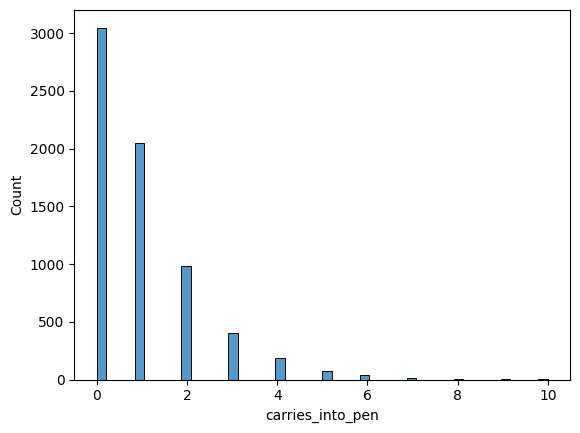

In [ ]:
sns.histplot(strikers10['carries_into_pen'])

Dryblingi

In [ ]:
dribble_complete_list = []

for ecu_jam in matches:
    dribble_complete = ecu_jam[(ecu_jam['dribble_outcome'] == "Complete") & (ecu_jam['period'] < 3) & (ecu_jam['position'].isin(forward_positions))].groupby(['player', 'match_id']).size().reset_index(name='driblle_complete')

    dribble_complete_list.append(dribble_complete)

dribble_complete_df = pd.concat(dribble_complete_list, ignore_index=True)

In [ ]:
dribble_failed_list = []

for ecu_jam in matches:
    dribble_failed = ecu_jam[(ecu_jam['dribble_outcome'] == "Incomplete") & (ecu_jam['period'] < 3) & (ecu_jam['position'].isin(forward_positions))].groupby(['player', 'match_id']).size().reset_index(name='driblle_failed')

    dribble_failed_list.append(dribble_failed)

dribble_failed_df = pd.concat(dribble_failed_list, ignore_index=True)

In [ ]:
dribbles = dribble_complete_df.merge(dribble_failed_df, on=['match_id', 'player'], how='outer').fillna(0)

In [ ]:
strikers11 = strikers10.merge(dribbles, on=['match_id', 'player'], how='left').fillna(0)

In [ ]:
strikers11['accuracy_dribbles_%'] = strikers11['driblle_complete'] / (strikers11['driblle_complete'] + strikers11['driblle_failed'])

<Axes: xlabel='accuracy_dribbles_%', ylabel='Count'>

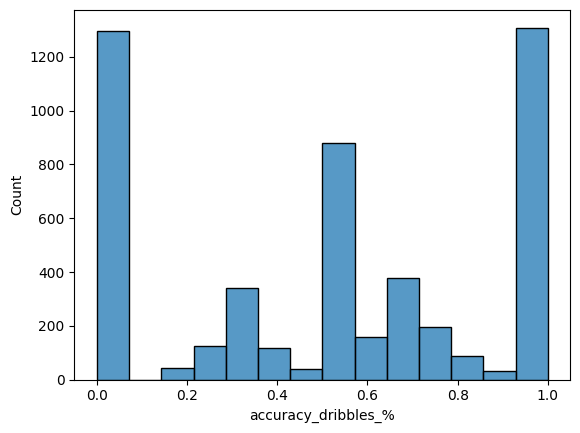

In [ ]:
sns.histplot(strikers11['accuracy_dribbles_%'])

In [ ]:
strikers11.sort_values(by='npxG').head(100)

,player,team,match_id,Events,minute,goals,assist,npxG,shots_on_target,shots_off_target,...,PAxG,good_passes,bad_passes,passes_accuracy_%,goals_pct,assist_pct,carries_into_pen,driblle_complete,driblle_failed,accuracy_dribbles_%
3403,Diego Falcinelli,Sassuolo,3879741,116,71.0,0.0,0.0,0.0,0.0,0.0,...,0.0,7.0,7.0,0.500000,0.365506,0.445865,1.0,0.0,0.0,NaN
4659,Scott Sinclair,Aston Villa,3754070,109,89.0,0.0,0.0,0.0,0.0,0.0,...,0.0,9.0,4.0,0.692308,0.365506,0.445865,1.0,1.0,1.0,0.5
4658,Jordan Ayew,Aston Villa,3754070,205,90.0,0.0,0.0,0.0,0.0,0.0,...,0.0,27.0,8.0,0.771429,0.365506,0.445865,0.0,2.0,3.0,0.4
2448,Luis Alberto Suárez Díaz,Barcelona,266467,151,90.0,0.0,0.0,0.0,0.0,0.0,...,0.0,23.0,8.0,0.741935,0.365506,0.445865,1.0,0.0,3.0,0.0
971,Sergio Guardiola Navarro,Real Valladolid,3773474,140,76.0,0.0,0.0,0.0,0.0,0.0,...,0.0,17.0,10.0,0.629630,0.365506,0.445865,1.0,1.0,0.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4766,Yannick Bolasie Yala,Crystal Palace,3754176,58,90.0,0.0,0.0,0.0,0.0,0.0,...,0.0,5.0,7.0,0.416667,0.365506,0.445865,2.0,1.0,1.0,0.5
2320,Miguel Ángel Guerrero Martín,Sporting Gijón,3825596,111,77.0,0.0,0.0,0.0,0.0,0.0,...,0.0,17.0,2.0,0.894737,0.365506,0.445865,0.0,1.0,1.0,0.5
4763,Papiss Demba Cissé,Newcastle United,3754170,141,71.0,0.0,0.0,0.0,0.0,0.0,...,0.0,13.0,6.0,0.684211,0.365506,0.445865,1.0,2.0,0.0,1.0
5871,Thomas Touré,Bordeaux,3829420,53,73.0,0.0,0.0,0.0,0.0,0.0,...,0.0,7.0,5.0,0.583333,0.365506,0.445865,1.0,0.0,1.0,0.0


Pojedynki wygrane/przegrane
- 50/50
- Duel

In [ ]:
# 50/50
for match in matches[1:]:
    if '50_50' in match.columns:
        match['50_50_outcome'] = match['50_50'].apply(lambda x: x['outcome']['name'] if isinstance(x,dict) and 'outcome' in x and 'name' in x['outcome'] else np.nan)


C:\Users\macie\AppData\Local\Temp\ipykernel_30508\2021891522.py:4: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  match['50_50_outcome'] = match['50_50'].apply(lambda x: x['outcome']['name'] if isinstance(x,dict) and 'outcome' in x and 'name' in x['outcome'] else np.nan)
C:\Users\macie\AppData\Local\Temp\ipykernel_30508\2021891522.py:4: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  match['50_50_outcome'] = match['50_50'].apply(lambda x: x['outcome']['name'] if isinstance(x,dict) and 'outcome' in x and 'name' in x['outcome'] else 

In [ ]:
matches[0].columns

Index(['50_50', 'bad_behaviour_card', 'ball_receipt_outcome',
       'ball_recovery_offensive', 'ball_recovery_recovery_failure',
       'block_deflection', 'block_offensive', 'carry_end_location',
       'clearance_aerial_won', 'clearance_body_part',
       ...
       'under_pressure', 'x', 'y', 'pass_end_x', 'pass_end_y', 'carry_end_x',
       'carry_end_y', 'shot_end_x', 'shot_end_y', '50_50_outcome'],
      dtype='object', length=101)

In [ ]:
win = ['Won', 'Success To Team']
lost = ['Lost', 'Success To Opposition']

In [ ]:
duels_50_won_list = []
for match in matches:
    if '50_50_outcome' in match.columns:
        duels_50_won = match[(match['50_50_outcome'].isin(win)) & (match['period'] < 3) & (match['position'].isin(forward_positions))].groupby(['player', 'match_id']).size().reset_index(name='duels_50_won')
        duels_50_won_list.append(duels_50_won)

duels_50_won_df = pd.concat(duels_50_won_list, ignore_index=True)

In [ ]:
duels_50_lost_list = []
for match in matches:
    if '50_50_outcome' in match.columns:
        duels_50_lost = match[(match['50_50_outcome'].isin(lost)) & (match['period'] < 3) & (match['position'].isin(forward_positions))].groupby(['player', 'match_id']).size().reset_index(name='duels_50_lost')
        duels_50_lost_list.append(duels_50_lost)

duels_50_lost_df = pd.concat(duels_50_lost_list, ignore_index=True)

In [ ]:
duels_50 = duels_50_won_df.merge(duels_50_lost_df, on=['match_id', 'player'], how='outer').fillna(0)
duels_50

,player,match_id,duels_50_won,duels_50_lost
0,Cyle Larin,3942785,1.0,0.0
1,Tanitoluwa Oluwaseyi,3942785,1.0,0.0
2,Jhon Andrés Córdoba Copete,3939984,1.0,1.0
3,Luis Fernando Díaz Marulanda,3939984,1.0,0.0
4,Warren Steven Madrigal Molina,3939984,1.0,0.0
...,...,...,...,...
1002,Johan Cruyff,3750235,0.0,1.0
1003,Antonis Antoniadis,3888711,0.0,2.0
1004,Édson Arantes do Nascimento,3889218,0.0,1.0
1005,Eduardo Gonçalves de Andrade,3888700,0.0,1.0


In [ ]:
strikers11 = strikers11.merge(duels_50, on=['match_id', 'player'], how='left').fillna(0)

In [ ]:
# duels

win = ['Won', 'Success', 'Success In Play']
lost = ['Lost In Play', 'Lost Out']

In [ ]:
duels_won_list = []
for match in matches:
    
    duels_won = match[(match['duel_outcome'].isin(win)) & (match['period'] < 3) & (match['position'].isin(forward_positions))].groupby(['player', 'match_id']).size().reset_index(name='duels_won')
    duels_won_list.append(duels_won)

duels_won_df = pd.concat(duels_won_list, ignore_index=True)

In [ ]:
duels_lost_list = []
for match in matches:
    
    duels_lost = match[(match['duel_outcome'].isin(lost)) & (match['period'] < 3) & (match['position'].isin(forward_positions))].groupby(['player', 'match_id']).size().reset_index(name='duels_lost')
    duels_lost_list.append(duels_lost)

duels_lost_df = pd.concat(duels_lost_list, ignore_index=True)

In [ ]:
duels_df = duels_won_df.merge(duels_lost_df, on=['match_id', 'player'], how='outer').fillna(0)

In [ ]:
strikers12 = strikers11.merge(duels_df, on=['player', 'match_id'], how='left')

In [ ]:
strikers12

,player,team,match_id,Events,minute,goals,assist,npxG,shots_on_target,shots_off_target,...,goals_pct,assist_pct,carries_into_pen,driblle_complete,driblle_failed,accuracy_dribbles_%,duels_50_won,duels_50_lost,duels_won,duels_lost
0,Jhon Andrés Córdoba Copete,Colombia,3943077,60,87.0,0.0,0.0,0.210564,0.0,1.0,...,0.365506,0.445865,0.0,0.0,0.0,0.000000,0.0,0.0,NaN,NaN
1,Julián Álvarez,Argentina,3943077,92,90.0,0.0,0.0,0.072140,0.0,1.0,...,0.365506,0.445865,0.0,0.0,1.0,0.000000,0.0,0.0,NaN,NaN
2,Luis Fernando Díaz Marulanda,Colombia,3943077,120,90.0,0.0,0.0,0.029771,1.0,0.0,...,0.365506,0.445865,0.0,0.0,4.0,0.000000,0.0,1.0,0.0,1.0
3,Darwin Gabriel Núñez Ribeiro,Uruguay,3942852,107,90.0,0.0,0.0,0.364153,0.0,3.0,...,0.365506,0.445865,2.0,1.0,1.0,0.500000,0.0,0.0,1.0,0.0
4,Jhon Andrés Córdoba Copete,Colombia,3942852,86,75.0,0.0,0.0,0.148650,0.0,2.0,...,0.365506,0.445865,0.0,0.0,0.0,0.000000,0.0,0.0,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6802,Édson Arantes do Nascimento,Brazil,3888705,261,90.0,2.0,0.0,1.052024,3.0,3.0,...,0.968709,0.445865,2.0,6.0,5.0,0.545455,1.0,0.0,0.0,1.0
6803,Edvaldo Izidio Neto,Brazil,3888704,255,90.0,1.0,0.0,1.172473,4.0,1.0,...,0.838402,0.445865,3.0,3.0,2.0,0.600000,1.0,0.0,1.0,1.0
6804,Just Louis Fontaine,France,3888704,220,90.0,1.0,0.0,1.053373,4.0,1.0,...,0.838402,0.445865,3.0,6.0,6.0,0.500000,0.0,0.0,0.0,2.0
6805,Raymond Kopaszewski Wlodarczyck,France,3888704,222,90.0,0.0,1.0,0.051519,0.0,0.0,...,0.365506,0.940723,0.0,7.0,1.0,0.875000,0.0,0.0,2.0,1.0


<Axes: xlabel='duels_lost', ylabel='Count'>

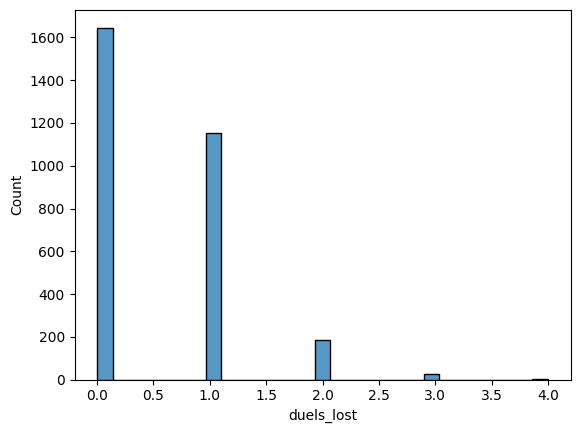

In [ ]:
sns.histplot(strikers12['duels_lost'])

Połączyłbym wszystko

In [ ]:
matches[0][matches[0]['aer']]

In [ ]:
# przegrane pojedynki powietrzne

aerial_lost_list = []
for match in matches:
    
    aerial_lost = match[(match['duel_type'] == 'Aerial Lost') & (match['period'] < 3) & (match['position'].isin(forward_positions))].groupby(['player', 'match_id']).size().reset_index(name='aerial_lost')
    aerial_lost_list.append(aerial_lost)

aerial_lost_df = pd.concat(aerial_lost_list, ignore_index=True)

In [ ]:
strikers13 = strikers12.merge(aerial_lost_df, on=['player', 'match_id'], how='left')

<Axes: xlabel='aerial_lost', ylabel='Count'>

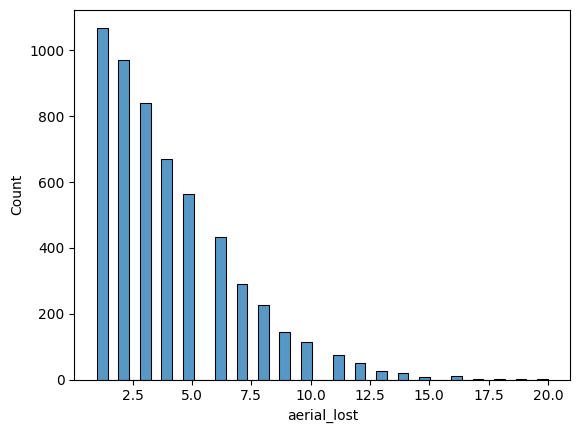

In [ ]:
sns.histplot(strikers13['aerial_lost'])

Straty/przechwyty

- Miscontrol [ok]
- Dispossessed [ok]
- Error [ok]
- Interception [ok]
- Ball recovery [ok]
- clearance []


In [ ]:
# miscontrol - strata piłki poprzez wypuszczenie/złe przyjęcie itp

# przegrane pojedynki powietrzne

miscontrol_list = []

for match in matches:
    
    miscontrol = match[(match['type'] == 'Miscontrol') & (match['period'] < 3) & (match['position'].isin(forward_positions))].groupby(['player', 'match_id']).size().reset_index(name='miscontrol')
    miscontrol_list.append(miscontrol)

miscontrol_df = pd.concat(miscontrol_list, ignore_index=True)

In [ ]:
ma = sb.events(match_id=3750234)
#ma[~(ma['miscontrol_aerial_won'].isna())]['timestamp']
ma[ma['type'] == 'Miscontrol']['timestamp']

2615    00:00:12.486
2616    00:00:28.914
2617    00:02:31.013
2618    00:04:46.111
2619    00:08:54.458
2620    00:10:04.336
2621    00:11:33.576
2622    00:16:06.671
2623    00:17:50.606
2624    00:21:37.370
2625    00:22:44.139
2626    00:23:12.010
2627    00:27:05.077
2628    00:32:06.505
2629    00:32:34.508
2630    00:36:21.148
2631    00:38:22.583
2632    00:39:37.545
2633    00:08:30.026
2634    00:14:34.159
2635    00:15:39.855
2636    00:22:39.443
2637    00:25:49.339
2638    00:32:53.879
2639    00:33:28.639
2640    00:43:22.239
Name: timestamp, dtype: object

In [ ]:
for match in matches:
    if 'miscontrol_aerial_won' in match.columns:
        print(match['match_id'])

In [ ]:
strikers14 = strikers13.merge(miscontrol_df, on=['match_id', 'player'], how='left')

In [ ]:
# dispossessed - strata

# miscontrol - strata piłki poprzez wypuszczenie/złe przyjęcie itp

# przegrane pojedynki powietrzne

dispossessed_list = []

for match in matches:
    
    dispossessed = match[(match['type'] == 'Dispossessed') & (match['period'] < 3) & (match['position'].isin(forward_positions))].groupby(['player', 'match_id']).size().reset_index(name='dispossessed')
    dispossessed_list.append(dispossessed)

dispossessed_df = pd.concat(dispossessed_list, ignore_index=True)

In [ ]:
strikers15 = strikers14.merge(dispossessed_df, on=['match_id', 'player'], how='left')

In [ ]:
# error - nieintencjonalny błąd

# dispossessed - strata

# miscontrol - strata piłki poprzez wypuszczenie/złe przyjęcie itp

# przegrane pojedynki powietrzne

error_list = []

for match in matches:
    
    error = match[(match['type'] == 'Error') & (match['period'] < 3) & (match['position'].isin(forward_positions))].groupby(['player', 'match_id']).size().reset_index(name='error')
    error_list.append(error)

error_df = pd.concat(error_list, ignore_index=True)

In [ ]:
strikers16 = strikers15.merge(error_df, on=['match_id', 'player'], how='left').fillna(0)

In [ ]:
# interception - przechwyt

# error - nieintencjonalny błąd

# dispossessed - strata

# miscontrol - strata piłki poprzez wypuszczenie/złe przyjęcie itp

# przegrane pojedynki powietrzne

inter_list = []

for match in matches:
    
    inter = match[(match['type'] == 'Interception') & (match['period'] < 3) & (match['position'].isin(forward_positions))].groupby(['player', 'match_id']).size().reset_index(name='interception')
    inter_list.append(inter)

inter_df = pd.concat(inter_list, ignore_index=True)


In [ ]:
strikers17 = strikers16.merge(inter_df, on=['match_id', 'player'], how='left').fillna(0)

In [ ]:
strikers17

,player,team,match_id,Events,minute,goals,assist,npxG,shots_on_target,shots_off_target,...,accuracy_dribbles_%,duels_50_won,duels_50_lost,duels_won,duels_lost,aerial_lost,miscontrol,dispossessed,error,interception
0,Jhon Andrés Córdoba Copete,Colombia,3943077,60,87.0,0.0,0.0,0.210564,0.0,1.0,...,0.000000,0.0,0.0,0.0,0.0,3.0,1.0,0.0,0.0,0.0
1,Julián Álvarez,Argentina,3943077,92,90.0,0.0,0.0,0.072140,0.0,1.0,...,0.000000,0.0,0.0,0.0,0.0,2.0,2.0,0.0,0.0,0.0
2,Luis Fernando Díaz Marulanda,Colombia,3943077,120,90.0,0.0,0.0,0.029771,1.0,0.0,...,0.000000,0.0,1.0,0.0,1.0,5.0,3.0,1.0,0.0,0.0
3,Darwin Gabriel Núñez Ribeiro,Uruguay,3942852,107,90.0,0.0,0.0,0.364153,0.0,3.0,...,0.500000,0.0,0.0,1.0,0.0,2.0,3.0,5.0,0.0,0.0
4,Jhon Andrés Córdoba Copete,Colombia,3942852,86,75.0,0.0,0.0,0.148650,0.0,2.0,...,0.000000,0.0,0.0,0.0,0.0,4.0,3.0,1.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6802,Édson Arantes do Nascimento,Brazil,3888705,261,90.0,2.0,0.0,1.052024,3.0,3.0,...,0.545455,1.0,0.0,0.0,1.0,3.0,4.0,4.0,0.0,0.0
6803,Edvaldo Izidio Neto,Brazil,3888704,255,90.0,1.0,0.0,1.172473,4.0,1.0,...,0.600000,1.0,0.0,1.0,1.0,6.0,2.0,2.0,0.0,0.0
6804,Just Louis Fontaine,France,3888704,220,90.0,1.0,0.0,1.053373,4.0,1.0,...,0.500000,0.0,0.0,0.0,2.0,5.0,3.0,3.0,0.0,1.0
6805,Raymond Kopaszewski Wlodarczyck,France,3888704,222,90.0,0.0,1.0,0.051519,0.0,0.0,...,0.875000,0.0,0.0,2.0,1.0,1.0,6.0,2.0,0.0,0.0


In [ ]:
# odzyskanie piłki

recovery_list = []

for match in matches:
    
    recov = match[(match['type'] == 'Ball Recovery') & (match['period'] < 3) & (match['position'].isin(forward_positions))].groupby(['player', 'match_id']).size().reset_index(name='recovery')
    recovery_list.append(recov)

recovery_df = pd.concat(recovery_list, ignore_index=True)


In [ ]:
strikers18 = strikers17.merge(recovery_df, on=['match_id', 'player'], how='left').fillna(0)

In [ ]:
strikers18

,player,team,match_id,Events,minute,goals,assist,npxG,shots_on_target,shots_off_target,...,duels_50_won,duels_50_lost,duels_won,duels_lost,aerial_lost,miscontrol,dispossessed,error,interception,recovery
0,Jhon Andrés Córdoba Copete,Colombia,3943077,60,87.0,0.0,0.0,0.210564,0.0,1.0,...,0.0,0.0,0.0,0.0,3.0,1.0,0.0,0.0,0.0,0.0
1,Julián Álvarez,Argentina,3943077,92,90.0,0.0,0.0,0.072140,0.0,1.0,...,0.0,0.0,0.0,0.0,2.0,2.0,0.0,0.0,0.0,1.0
2,Luis Fernando Díaz Marulanda,Colombia,3943077,120,90.0,0.0,0.0,0.029771,1.0,0.0,...,0.0,1.0,0.0,1.0,5.0,3.0,1.0,0.0,0.0,2.0
3,Darwin Gabriel Núñez Ribeiro,Uruguay,3942852,107,90.0,0.0,0.0,0.364153,0.0,3.0,...,0.0,0.0,1.0,0.0,2.0,3.0,5.0,0.0,0.0,6.0
4,Jhon Andrés Córdoba Copete,Colombia,3942852,86,75.0,0.0,0.0,0.148650,0.0,2.0,...,0.0,0.0,0.0,0.0,4.0,3.0,1.0,0.0,0.0,3.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6802,Édson Arantes do Nascimento,Brazil,3888705,261,90.0,2.0,0.0,1.052024,3.0,3.0,...,1.0,0.0,0.0,1.0,3.0,4.0,4.0,0.0,0.0,8.0
6803,Edvaldo Izidio Neto,Brazil,3888704,255,90.0,1.0,0.0,1.172473,4.0,1.0,...,1.0,0.0,1.0,1.0,6.0,2.0,2.0,0.0,0.0,5.0
6804,Just Louis Fontaine,France,3888704,220,90.0,1.0,0.0,1.053373,4.0,1.0,...,0.0,0.0,0.0,2.0,5.0,3.0,3.0,0.0,1.0,4.0
6805,Raymond Kopaszewski Wlodarczyck,France,3888704,222,90.0,0.0,1.0,0.051519,0.0,0.0,...,0.0,0.0,2.0,1.0,1.0,6.0,2.0,0.0,0.0,9.0


In [ ]:
ecu_jam['cleara']

In [ ]:
matches[0]['clearance_aerial_won']

0       NaN
1       NaN
2       NaN
3       NaN
4       NaN
       ... 
4103    NaN
4104    NaN
4105    NaN
4106    NaN
4107    NaN
Name: clearance_aerial_won, Length: 4108, dtype: object

In [ ]:
# clearance - wygrane pojedynki powietrzne
# odzyskanie piłki

aerial_won_list = []

for match in matches:
    if 'clearance_aerial_won' in match.columns:
        aerial_won = match[~(match['clearance_aerial_won'].isna()) & (match['period'] < 3) & (match['position'].isin(forward_positions))].groupby(['player', 'match_id']).size().reset_index(name='clearance_aerial_won')
        aerial_won_list.append(aerial_won)

cl_aerial_won_df = pd.concat(aerial_won_list, ignore_index=True)

In [ ]:
strikers19 = strikers18.merge(cl_aerial_won_df, on=['match_id', 'player'], how='left').fillna(0)

In [ ]:
# clearance - wygrane pojedynki powietrzne
# odzyskanie piłki

clearance_list = []

for match in matches:
    clearance = match[(match['type'] == 'Clearance') & (match['period'] < 3) & (match['position'].isin(forward_positions))].groupby(['player', 'match_id']).size().reset_index(name='clearance')
    clearance_list.append(clearance)

clearance_df = pd.concat(clearance_list, ignore_index=True)

In [ ]:
strikers20 = strikers19.merge(clearance_df, on=['match_id', 'player'], how='left').fillna(0)

Teraz można zrobić podział
- wygrane pojedynki:
    - duels_50_won
    - duels_won
    - interception
    - recovery
    - clearance
- przegrane pojedynki:
    - duels_50_lost
    - duels_lost
    - aerial_lost
    - miscontrol
    - dispossessed
    - error



In [ ]:
matches[0].columns

Index(['50_50', 'bad_behaviour_card', 'ball_receipt_outcome',
       'ball_recovery_offensive', 'ball_recovery_recovery_failure',
       'block_deflection', 'block_offensive', 'carry_end_location',
       'clearance_aerial_won', 'clearance_body_part',
       ...
       'under_pressure', 'x', 'y', 'pass_end_x', 'pass_end_y', 'carry_end_x',
       'carry_end_y', 'shot_end_x', 'shot_end_y', '50_50_outcome'],
      dtype='object', length=101)

In [ ]:
ecu_jam[(ecu_jam['type'] == 'Ball Recovery')].groupby(['player','minute', 'second', 'period']).size().reset_index(name='g').sort_values(by='minute')

,player,minute,second,period,g
8,Cody Mathès Gakpo,0,16,1,1
45,Phil Foden,3,15,1,1
51,Virgil van Dijk,3,18,1,1
36,Kieran Trippier,4,15,1,1
6,Bukayo Saka,5,38,1,1
0,Bart Verbruggen,6,7,1,1
31,Jude Bellingham,8,29,1,1
30,Jude Bellingham,8,6,1,1
7,Bukayo Saka,10,38,1,1
13,Donyell Malen,10,33,1,1


In [ ]:
# miscontrol - strata piłki poprzez wypuszczenie/złe przyjęcie itp

# przegrane pojedynki powietrzne

miscontrol_aerial_won_list = []

for match in matches:
    if 'miscontrol_aerial_won' in match.columns:
        miscontrol_ar_w = match[(match['type'] == 'Miscontrol') & (~match['miscontrol_aerial_won'].isna()) &(match['period'] < 3) & (match['position'].isin(forward_positions))].groupby(['player', 'match_id']).size().reset_index(name='miscontrol_aerial_won')
        miscontrol_aerial_won_list.append(miscontrol_ar_w)

miscontrol_ar_w_df = pd.concat(miscontrol_aerial_won_list, ignore_index=True)

In [ ]:
miscontrol_ar_w_df.sort_values(by='match_id').tail(50)

,player,match_id,miscontrol_aerial_won
1122,Emiliano Sala,3901261,1
47,Victor James Osimhen,3920386,1
59,Habibou Mouhamadou Diallo,3920388,1
58,Lassine Sinayoko,3920391,1
57,Souleymane Anne,3920392,1
56,Aboubakar Kamara,3920392,1
55,Youssef En-Nesyri,3920394,1
54,Tiago Manuel Dias Correia,3920399,1
53,Youssef Msakni,3920404,1
52,Denis Kibu,3920406,1


In [ ]:
strikers21 = strikers20.merge(miscontrol_ar_w_df, on=['match_id', 'player'], how='left').fillna(0)

In [ ]:
strikers21['miscontrol'] -= strikers21['miscontrol_aerial_won']

In [ ]:
# wygrane pojedynki powietrzne - strzał

aerial_won_shot_list = []

for match in matches:
    if 'shot_aerial_won' in match.columns:
        aerial_won_shot = match[~(match['shot_aerial_won'].isna()) & (match['period'] < 3) & (match['position'].isin(forward_positions))].groupby(['player', 'match_id']).size().reset_index(name='aerial_won_shot')
        aerial_won_shot_list.append(aerial_won_shot)

aerial_won_shot_df = pd.concat(aerial_won_shot_list, ignore_index=True)

In [ ]:
strikers22 = strikers21.merge(aerial_won_shot_df, on=['match_id', 'player'], how='left').fillna(0)

In [ ]:
strikers22['duels_wons'] = strikers22['duels_50_won'] + strikers22['duels_won'] + strikers22['interception'] + strikers22['recovery'] + strikers22['clearance'] + strikers22['miscontrol_aerial_won'] + strikers22['aerial_won_shot']

In [ ]:
strikers22['duels_lost'] = strikers22['duels_50_lost'] + strikers22['duels_lost'] + strikers22['aerial_lost'] + strikers22['miscontrol'] + strikers22['dispossessed'] + strikers22['error']

<Axes: xlabel='duels_wons', ylabel='Count'>

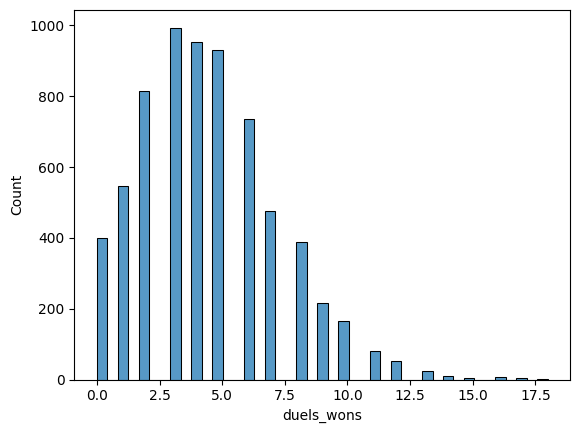

In [ ]:
sns.histplot(strikers22['duels_wons'])

<Axes: xlabel='duels_lost', ylabel='Count'>

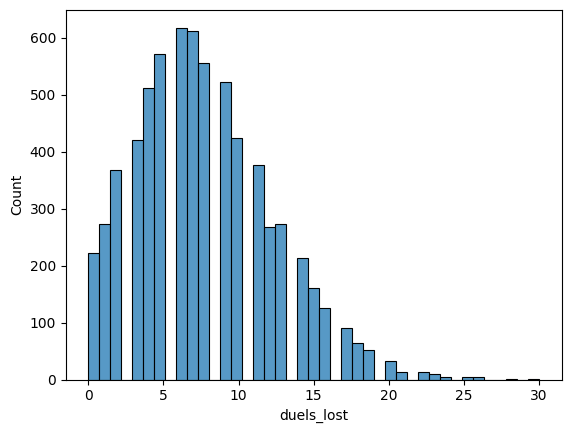

In [ ]:
sns.histplot(strikers22['duels_lost'])

In [ ]:
strikers22.columns

Index(['player', 'team', 'match_id', 'Events', 'minute', 'goals', 'assist',
       'npxG', 'shots_on_target', 'shots_off_target', 'shots_accuracy_%',
       'xGA', 'PAxG', 'good_passes', 'bad_passes', 'passes_accuracy_%',
       'goals_pct', 'assist_pct', 'carries_into_pen', 'driblle_complete',
       'driblle_failed', 'accuracy_dribbles_%', 'duels_50_won',
       'duels_50_lost', 'duels_won', 'duels_lost', 'aerial_lost', 'miscontrol',
       'dispossessed', 'error', 'interception', 'recovery',
       'clearance_aerial_won', 'clearance', 'miscontrol_aerial_won',
       'aerial_won_shot', 'duels_wons'],
      dtype='object')

A więc mamy stworzone statystyki dla zawodników. Teraz weźmy wybrane i stwórzmy model - stwórzmy na bazie percentyli.
Weźmy do modelu:
- npxg
- Xga
- PAxg
- passes_accuracy
- xga
- carries_into_pen
- dribble_accuracy
- duels_wons/duels lost

In [ ]:
# NPxG
strikers_rank = strikers22.copy()


In [ ]:
strikers_rank['npxG_RANK'] = strikers_rank['npxG'].rank(pct=True)

In [ ]:
strikers_rank[['player', 'npxG', 'npxG_RANK']].sort_values(by='npxG')

,player,npxG,npxG_RANK
3403,Diego Falcinelli,0.000000,0.082636
4659,Scott Sinclair,0.000000,0.082636
4658,Jordan Ayew,0.000000,0.082636
2448,Luis Alberto Suárez Díaz,0.000000,0.082636
971,Sergio Guardiola Navarro,0.000000,0.082636
...,...,...,...
1522,Luis Alberto Suárez Díaz,2.254132,0.999412
5215,Alexandre Lacazette,2.284286,0.999559
3005,Pierre-Emerick Aubameyang,2.414604,0.999706
2393,Luis Alberto Suárez Díaz,2.565317,0.999853


In [ ]:
strikers_rank['PAxG_RANK'] = strikers_rank['PAxG'].rank(pct=True)
strikers_rank['xGA_RANK'] = strikers_rank['xGA'].rank(pct=True)
strikers_rank['assist_RANK'] = strikers_rank['assist'].rank(pct=True)
strikers_rank['carries_into_pen_RANK'] = strikers_rank['carries_into_pen'].rank(pct=True)
strikers_rank['accuracy_dribbles_%_RANK'] = strikers_rank['accuracy_dribbles_%'].rank(pct=True)
strikers_rank['passes_accuracy_%_RANK'] = strikers_rank['passes_accuracy_%'].rank(pct=True)
strikers_rank['duels_wons_RANK'] = strikers_rank['duels_wons'].rank(pct=True)


In [ ]:
strikers_rank['total_RANK'] = strikers_rank[strikers_rank.columns[37:]].sum(axis=1)

<Axes: xlabel='total_RANK', ylabel='Count'>

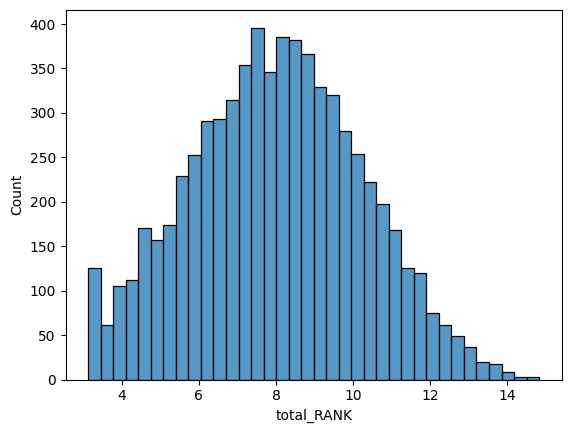

In [ ]:
sns.histplot(strikers_rank['total_RANK'])

In [ ]:
strikers_rank['total_RANK'].describe()

count    6807.000000
mean        8.001175
std         2.238771
min         3.125606
25%         6.414059
50%         8.034083
75%         9.572866
max        14.830616
Name: total_RANK, dtype: float64

In [ ]:
strikers_rank

,player,team,match_id,Events,minute,goals,assist,npxG,shots_on_target,shots_off_target,...,duels_wons,npxG_RANK,PAxG_RANK,xGA_RANK,assist_RANK,carries_into_pen_RANK,accuracy_dribbles_%_RANK,passes_accuracy_%_RANK,duels_wons_RANK,total_RANK
0,Jhon Andrés Córdoba Copete,Colombia,3943077,60,87.0,0.0,0.0,0.210564,0.0,1.0,...,3.0,0.533862,0.061995,0.765242,0.445865,0.224034,0.227927,0.966285,0.331938,7.114294
1,Julián Álvarez,Argentina,3943077,92,90.0,0.0,0.0,0.072140,0.0,1.0,...,1.0,0.309387,0.163949,0.212355,0.445865,0.224034,0.227927,0.390554,0.099089,4.146320
2,Luis Fernando Díaz Marulanda,Colombia,3943077,120,90.0,0.0,0.0,0.029771,1.0,0.0,...,2.0,0.208756,0.636844,0.467313,0.445865,0.224034,0.227927,0.966285,0.199133,6.752314
3,Darwin Gabriel Núñez Ribeiro,Uruguay,3942852,107,90.0,0.0,0.0,0.364153,0.0,3.0,...,8.0,0.685912,0.020714,0.515205,0.445865,0.821434,0.616645,0.944028,0.888130,9.875863
4,Jhon Andrés Córdoba Copete,Colombia,3942852,86,75.0,0.0,0.0,0.148650,0.0,2.0,...,3.0,0.452769,0.093727,0.605406,0.445865,0.224034,0.227927,0.522624,0.331938,5.808579
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6802,Édson Arantes do Nascimento,Brazil,3888705,261,90.0,2.0,0.0,1.052024,3.0,3.0,...,9.0,0.955928,0.946819,0.873219,0.445865,0.821434,0.680770,0.713016,0.932569,12.739239
6803,Edvaldo Izidio Neto,Brazil,3888704,255,90.0,1.0,0.0,1.172473,4.0,1.0,...,7.0,0.967533,0.836933,0.993389,0.445865,0.923608,0.696269,0.535184,0.824739,12.447040
6804,Just Louis Fontaine,France,3888704,220,90.0,1.0,0.0,1.053373,4.0,1.0,...,5.0,0.956075,0.848098,0.707066,0.445865,0.923608,0.616645,0.369620,0.613266,10.960482
6805,Raymond Kopaszewski Wlodarczyck,France,3888704,222,90.0,0.0,1.0,0.051519,0.0,0.0,...,11.0,0.259145,0.193330,0.981490,0.940723,0.224034,0.805788,0.451006,0.978625,9.668283


POMOCNICY

In [ ]:
mid_pos_offensive = ['Right Center Midfield', 'Center Midfield', 'Left Center Midfield', 'Right Attacking Midfield', 'Center Attacking Midfield', 'Left Attacking Midfield']

In [ ]:
events_list = []
for match in matches:
    events = match[(match['period'] < 3) & (match['position'].isin(mid_pos_offensive))].groupby(['player', 'team', 'match_id']).size().reset_index(name='Events')
    events_list.append(events)

events_df2 = pd.concat(events_list, ignore_index=True)

In [ ]:
events_df2

,player,team,match_id,Events
0,Alexis Mac Allister,Argentina,3943077,25
1,James David Rodríguez Rubio,Colombia,3943077,198
2,Jhon Adolfo Arias Andrade,Colombia,3943077,184
3,Kevin Duvan Castaño Gil,Colombia,3943077,6
4,Richard Rios Montoya,Colombia,3943077,150
...,...,...,...,...
14677,Antonio Jasso Alvarez,Mexico,3888854,325
14678,Salvador Reyes Monteón,Mexico,3888854,204
14679,Gunnar Gren,Sweden,3888705,233
14680,Nils Liedholm,Sweden,3888705,178


In [ ]:
start_min = pd.DataFrame()

for match in matches:

#if ((match[match['type'] == 'Substitution']['position'].isin(forward_positions).any()) ):
    if 'substitution_replacement' in match.columns:
        start_minute = match[match['type'] == 'Substitution'][['minute', 'position', 'player', 'substitution_replacement', 'match_id']]
    #start_minute = start_minute[start_minute['position'].isin(forward_positions)]
        start_min = pd.concat([start_min, start_minute], ignore_index=True)

subs_off = pd.DataFrame({'player':start_min['player'], 'minute':start_min['minute'], 'match_id':start_min['match_id']})
subs_on = pd.DataFrame({'player':start_min['substitution_replacement'], 'minute':90-start_min['minute'], 'match_id':start_min['match_id']})
subs_all = pd.concat([subs_off, subs_on], ignore_index=True)

s_list = []
for match in matches:
    a = match.groupby(['player', 'match_id', 'position']).size().reset_index(name='x')
    s_list.append(a)
s_df2 = pd.concat(s_list, ignore_index=True)

a2 = subs_all.merge(s_df2, on=['match_id', 'player'], how='left')
a3 = a2[a2['position'].isin(mid_pos_offensive)]
sub_df2 = a3.drop_duplicates(subset=['player', 'match_id'])

In [ ]:
len(sub_df2)

8555

In [ ]:
subs_dup2 = sub_df2[sub_df2.duplicated(subset=['match_id', 'player'], keep=False)].copy()

subs_dup2['diff'] = subs_dup2.groupby(['match_id', 'player'])['minute'].transform(lambda x: x.max() - (90 - x.min()))
subs_dup2 = subs_dup2[['player', 'match_id', 'diff']].drop_duplicates()

In [ ]:
subs_dup2

,player,match_id,diff


In [ ]:
sub_df_merge2 = sub_df2[['player', 'match_id', 'minute']]
sub_df_merge2

,player,match_id,minute
3,Richard Rios Montoya,3943077,87
4,James David Rodríguez Rubio,3943077,90
7,Alexis Mac Allister,3943077,96
13,Jhon Adolfo Arias Andrade,3943077,105
27,Jonathan Osorio,3943076,76
...,...,...,...
43970,Theo de Jong,3888716,20
43976,Manuel Tomé Portela,3888713,21
43978,Antonello Cuccureddu,3888706,17
43981,Arie Haan,3888711,45


In [ ]:
mid_off0 = events_df2.merge(sub_df_merge2, on=['match_id', 'player'], how='left').fillna(90)

In [ ]:
mid_off1 = mid_off0[mid_off0['minute'] > 0]
mid_off1['minute'] = mid_off1['minute'].apply(lambda x: min(x, 90))
mid_off1.sort_values(by='minute')

C:\Users\macie\AppData\Local\Temp\ipykernel_11712\2733690683.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  mid_off1['minute'] = mid_off1['minute'].apply(lambda x: min(x, 90))


,player,team,match_id,Events,minute
9799,Àngel Rangel Zaragoza,Swansea City,3753976,6,1.0
5931,Borys Tashchy,VfB Stuttgart,3890394,5,1.0
5232,Alejandro Gálvez Jimena,Werder Bremen,3890557,4,1.0
1549,Julian Draxler,Paris Saint-Germain,3802805,9,1.0
9423,Fabian Delph,Manchester City,3754233,15,1.0
...,...,...,...,...,...
7274,Blerim Džemaili,Genoa,3879819,109,90.0
7271,Paul Pogba,Juventus,3879820,224,90.0
7270,Oscar Hiljemark,Palermo,3879820,121,90.0
7318,Artur Ioniţă,Hellas Verona,3879811,145,90.0


In [ ]:
mid_off2 = mid_off1[mid_off1['minute'] >= 70]

In [ ]:
goals_list = []
for match in matches:
    goals = match[(match['shot_type'] != 'Penalty') & (match['shot_outcome'] == 'Goal') & (match['period'] < 3) & (match['position'].isin(mid_pos_offensive))].groupby(['player', 'match_id']).size().reset_index(name='goals')
    goals_list.append(goals)

goals_df2 = pd.concat(goals_list, ignore_index=True)

In [ ]:
mid_off3 = mid_off2.merge(goals_df, on=['match_id', 'player'], how='left').fillna(0)

In [ ]:
assist_list = []
for match in matches:
    if 'pass_goal_assist' in match.columns:
        assist = match[(match['pass_goal_assist'] == True) & (match['period'] < 3) & (match['position'].isin(forward_positions))].groupby(['player', 'match_id']).size().reset_index(name='assist')
        assist_list.append(assist)
assist_df2 = pd.concat(assist_list, ignore_index=True)

In [ ]:
mid_off4 = mid_off3.merge(assist_df, on=['match_id', 'player'], how='left').fillna(0)

In [ ]:
xg_list = []
for match in matches:
    xg = match[(match['type'] == 'Shot') & (match['shot_type'] != 'Penalty') & (match['period'] < 3) & match['position'].isin(forward_positions)].groupby(['player', 'match_id'])['shot_statsbomb_xg'].sum().reset_index(name='npxG')
    xg_list.append(xg)
xg_df2 = pd.concat(xg_list, ignore_index=True)

In [ ]:
mid_off5 = mid_off4.merge(xg_df, on=['match_id', 'player'], how='left').fillna(0)

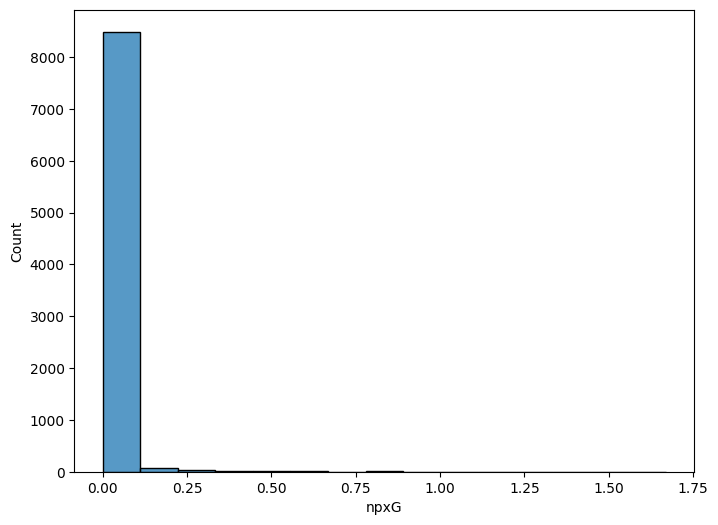

In [ ]:
plt.figure(figsize=(8,6))
sns.histplot(mid_off5['npxG'])
plt.show()

In [ ]:
target_shot_list = []
for match in matches:
    target = match[(match['shot_outcome'].isin(['Saved', 'Goal', 'Saved To Post'])) & (match['period'] < 3) & (match['position'].isin(mid_pos_offensive))].groupby(['player', 'match_id'] ).size().reset_index(name='shots_on_target')
    target_shot_list.append(target)
target_df2 = pd.concat(target_shot_list, ignore_index=True)

In [ ]:
off_target_shot_list = []
for match in matches:
    off_target = match[(match['shot_outcome'].isin(['Off T', 'Post', 'Saved Off T'])) & (match['period'] < 3) & match['position'].isin(mid_pos_offensive)].groupby(['player', 'match_id']).size().reset_index(name='shots_off_target')
    off_target_shot_list.append(off_target)
off_target_df2 = pd.concat(off_target_shot_list, ignore_index=True)

In [ ]:
shots2 = target_df2.merge(off_target_df2, on=['match_id', 'player'], how='outer').fillna(0)

In [ ]:
mid_off6 = mid_off5.merge(shots2, on=['match_id', 'player'], how='left').fillna(0)

In [ ]:
mid_off6['shots_accuracy_%'] = mid_off6['shots_on_target'] / (mid_off6['shots_on_target'] + mid_off6['shots_off_target'])
mid_off6['shots_accuracy_%'] = mid_off6['shots_accuracy_%'].fillna(0)
mid_off6['shots_accuracy_%'] = mid_off6['shots_accuracy_%'].fillna(0)

In [ ]:
xga_df = pd.DataFrame()

for match in matches:
# Obliczanie xG dla strzałów
    shots = (
        match[(match['type'] == 'Shot') & (match['period'] < 3)]
        .groupby(['player', 'match_id', 'shot_key_pass_id'])
        ['shot_statsbomb_xg'].sum()
        .reset_index(name='xG')
        .rename(columns={'shot_key_pass_id': 'id'})
    )

    # Filtrowanie podań
    passes = (
        match[(match['pass_outcome'].isna()) & (match['position'].isin(mid_pos_offensive))]
        .groupby(['player', 'match_id', 'id'])
        .size()
        .reset_index(name='pass_count')
    )

    # Łączenie strzałów z podaniami
    xga = shots.merge(passes, on=['match_id', 'id'], how='left')

    # Grupowanie po zawodniku (asystencie xG)
    xga = xga.groupby(['player_y', 'match_id'])['xG'].sum().reset_index(name='xGA').rename(columns={'player_y':'player'})

    # Łączenie wyników z xga_df
    xga_df2 = pd.concat([xga_df, xga], ignore_index=True).fillna(0)


In [ ]:
xga_df = pd.DataFrame()

for match in matches:
    # Obliczanie xG dla strzałów
    shots = (
        match[(match['type'] == 'Shot') & (match['period'] < 3)]
        .groupby(['player', 'match_id', 'shot_key_pass_id'])
        ['shot_statsbomb_xg'].sum()
        .reset_index(name='xG')
        .rename(columns={'shot_key_pass_id': 'id'})
    )

    # Filtrowanie podań
    passes = (
        match[(match['pass_outcome'].isna()) & (match['position'].isin(mid_pos_offensive))]
        .groupby(['player', 'match_id', 'id'])
        .size()
        .reset_index(name='pass_count')
    )

    # Łączenie strzałów z podaniami
    xga = shots.merge(passes, on=['match_id', 'id'], how='left')

    # Grupowanie po zawodniku (asystencie xG)
    xga = (
        xga.groupby(['player_y', 'match_id'])['xG']
        .sum()
        .reset_index(name='xGA')
    )

    # Łączenie wyników z xga_df
    xga_df = pd.concat([xga_df, xga], ignore_index=True).fillna(0)


In [ ]:
xga_df.columns = ['player', 'match_id', 'xGA']

In [ ]:
mid_off7 = mid_off6.merge(xga_df, on=['match_id', 'player'], how='left').fillna(0)

In [ ]:
mid_off7.sort_values('xGA')

,player,team,match_id,Events,minute,goals,assist,npxG,shots_on_target,shots_off_target,shots_accuracy_%,xGA
0,Alexis Mac Allister,Argentina,3943077,25,90.0,0.0,0.0,0.000000,0.0,0.0,0.000000,0.000000
4519,Ivan Perišić,Inter Milan,3879648,23,90.0,0.0,0.0,0.000000,0.0,0.0,0.000000,0.000000
4518,Fredy Alejandro Guarín Vásquez,Inter Milan,3879648,58,90.0,0.0,0.0,0.000000,0.0,1.0,0.000000,0.000000
4517,Edenílson Andrade dos Santos,Udinese,3879648,41,90.0,0.0,0.0,0.000000,0.0,0.0,0.000000,0.000000
4516,Cyril Théréau,Udinese,3879648,48,90.0,0.0,0.0,0.234016,0.0,1.0,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...
1504,Lionel Andrés Messi Cuccittini,Barcelona,16095,188,90.0,0.0,0.0,0.000000,4.0,2.0,0.666667,1.499929
1511,Santiago Cazorla González,Villarreal,16240,199,90.0,0.0,0.0,0.000000,0.0,0.0,0.000000,1.531421
7254,Jean Michaël Seri,OGC Nice,3829464,233,90.0,0.0,0.0,0.000000,0.0,1.0,0.000000,1.630941
7501,Francesc Fàbregas i Soler,Barcelona,70298,272,79.0,0.0,0.0,0.000000,1.0,0.0,1.000000,1.750340


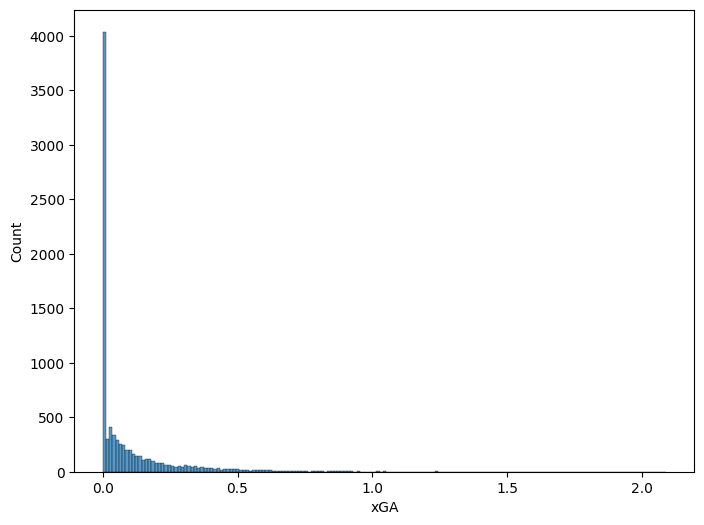

In [ ]:
plt.figure(figsize=(8,6))
sns.histplot(mid_off7['xGA'])
plt.show()

In [ ]:
paxg_list = []
for match in matches:
    paxg = (
        match[(match['type'] == "Shot") & (match['period'] < 3) & (match['position'].isin(mid_pos_offensive))]
        .assign(
            goal=lambda df: (df['shot_outcome'] == 'Goal').astype(int),  # 1 dla "Goal", inaczej 0
            PAxG_component=lambda df: (df['goal'] - df['shot_statsbomb_xg']) * (1 - df['shot_statsbomb_xg']),  # Obliczanie PAxG_component,
            shots_on_target = lambda df: (df['shot_outcome'].isin(['Saved', 'Saved To Post', 'Goal'])).astype(int)
            
        )
        .groupby(['player', 'match_id'])
        .agg(
            shots=('shot_statsbomb_xg', 'size'),
            PAxg=('PAxG_component', 'sum'),
            shots_on_target=('shots_on_target', 'sum')
        )
        .reset_index()
    )
    paxg['PAxG'] = paxg['PAxg'] + np.log(1 + paxg['shots_on_target']) # można zamienić na strzały celne zamiast wszystkich
    paxg = paxg[['player', 'match_id', 'PAxG']]
    paxg_list.append(paxg)
paxg_df2 = pd.concat(paxg_list, ignore_index=True)

In [ ]:
paxg_df2 = paxg_df2[['player', 'match_id', 'PAxG']]

In [ ]:
mid_off8 = mid_off7.merge(paxg_df2, on=['player', 'match_id'], how='left').fillna(0)

In [ ]:
mid_off8

,player,team,match_id,Events,minute,goals,assist,npxG,shots_on_target,shots_off_target,shots_accuracy_%,xGA,PAxG
0,Alexis Mac Allister,Argentina,3943077,25,90.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.000000,0.000000
1,James David Rodríguez Rubio,Colombia,3943077,198,90.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.154129,-0.038001
2,Jhon Adolfo Arias Andrade,Colombia,3943077,184,90.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.000000,-0.037140
3,Richard Rios Montoya,Colombia,3943077,150,87.0,0.0,0.0,0.000000,1.0,0.0,1.0,0.055085,0.686715
4,Rodrigo Javier De Paul,Argentina,3943077,40,90.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...
8643,Antonio Jasso Alvarez,Mexico,3888854,325,90.0,0.0,0.0,0.000000,1.0,0.0,1.0,0.000000,0.499122
8644,Salvador Reyes Monteón,Mexico,3888854,204,90.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.110345,0.000000
8645,Gunnar Gren,Sweden,3888705,233,90.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.099347,-0.009930
8646,Nils Liedholm,Sweden,3888705,178,90.0,0.0,0.0,0.000000,2.0,0.0,1.0,0.368171,1.722547


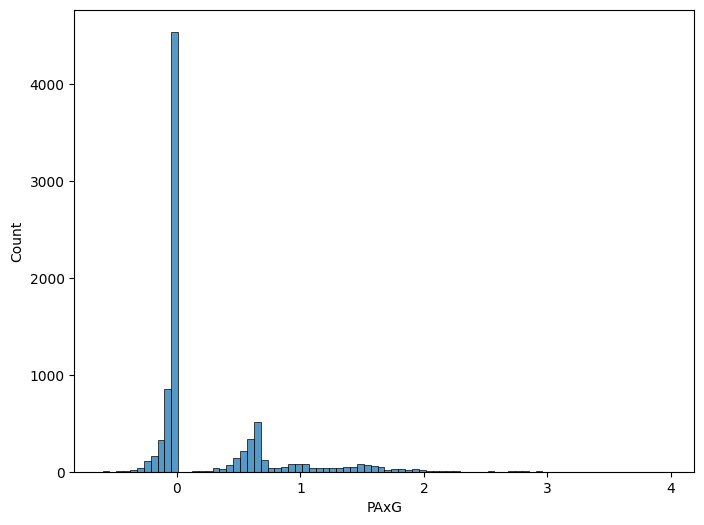

In [ ]:
plt.figure(figsize=(8,6))
sns.histplot(mid_off8['PAxG'])
plt.show()

In [ ]:
good_passes_list = []
for match in matches:
    good_passes = match[(match['type'] == 'Pass') & (match['period'] < 3) & (match['pass_outcome'].isna()) & (match['position'].isin(mid_pos_offensive))].groupby(['player', 'match_id']).size().reset_index(name='good_passes').fillna(0)
    good_passes_list.append(good_passes)

good_passes_df2 = pd.concat(good_passes_list, ignore_index=True)

In [ ]:
good_passes_df2.sort_values(by='good_passes')

,player,match_id,good_passes
3500,Mariano Díaz Mejía,267076,1
2005,Ousmane Dembélé,3773585,1
2000,Pedro González López,3773466,1
5663,Kenan Karaman,3890407,1
10516,Mohamed Amine Chermiti,3901230,1
...,...,...,...
12628,Xavier Hernández Creus,70280,142
13170,Xavier Hernández Creus,18236,144
12608,Xavier Hernández Creus,266724,151
13139,Xavier Hernández Creus,69300,155


In [ ]:
bad_passes_list = []
for match in matches:
    bad_passes = match[(match["type"] == "Pass") & (match['period'] < 3) & (match["pass_outcome"].isin(["Incomplete", "Out"])) & (match['position'].isin(mid_pos_offensive))].groupby(['player', 'match_id']).size().reset_index(name="bad_passes").fillna(0)
    bad_passes_list.append(bad_passes)

bad_passes_df2 = pd.concat(bad_passes_list, ignore_index=True)

In [ ]:
passes2 = good_passes_df2.merge(bad_passes_df2, on=['player', 'match_id'], how='outer').fillna(0)
passes2

,player,match_id,good_passes,bad_passes
0,Alexis Mac Allister,3943077,6.0,0.0
1,James David Rodríguez Rubio,3943077,52.0,14.0
2,Jhon Adolfo Arias Andrade,3943077,43.0,1.0
3,Kevin Duvan Castaño Gil,3943077,1.0,0.0
4,Richard Rios Montoya,3943077,39.0,3.0
...,...,...,...,...
14360,Carmelo José González Jiménez,69138,0.0,1.0
14361,Alejandro Marañón Pérez,69186,0.0,5.0
14362,Ángel Lafita Castillo,69179,0.0,2.0
14363,Marians Pahars,3749631,0.0,1.0


In [ ]:
mid_off9 = mid_off8.merge(passes, on=['match_id', 'player'], how='left').fillna(0)

A może by tak spróbować

In [ ]:
events_list = []
for match in matches:
    events = match[(match['period'] < 3)].groupby(['player', 'team', 'match_id', 'position']).size().reset_index(name='Events')
    events_list.append(events)

events_df3 = pd.concat(events_list, ignore_index=True)
events_df3

,player,team,match_id,position,Events
0,Alexis Mac Allister,Argentina,3943077,Left Center Midfield,25
1,Alexis Mac Allister,Argentina,3943077,Left Defensive Midfield,127
2,Alexis Mac Allister,Argentina,3943077,Left Midfield,31
3,Camilo Andrés Vargas Gil,Colombia,3943077,Goalkeeper,85
4,Carlos Eccehomo Cuesta Figueroa,Colombia,3943077,Left Center Back,136
...,...,...,...,...,...
100867,Robert Jonquet,France,3888704,Left Midfield,11
100868,Roger Piantoni,France,3888704,Left Defensive Midfield,163
100869,Waldyr Pereira,Brazil,3888704,Left Defensive Midfield,272
100870,Édson Arantes do Nascimento,Brazil,3888704,Center Forward,33


In [ ]:
group = events_df3.groupby(['player', 'team', 'match_id']).get_group(('Alexis Mac Allister', 'Argentina', 3943077))
#print(group)
print(group.loc[group['Events'].idxmax()])

player          Alexis Mac Allister
team                      Argentina
match_id                    3943077
position    Left Defensive Midfield
Events                          127
Name: 1, dtype: object


In [ ]:
# Funkcja pomocnicza do wyboru wiersza z największą liczbą Events w każdej grupie
def select_top_row(group):
    return group.loc[group['Events'].idxmax()]

# Grupowanie i zastosowanie funkcji na każdej grupie
result = (
    events_df3
    .groupby(['player', 'team', 'match_id'], group_keys=False, as_index=False)  # Grupowanie bez zachowania kluczy grupy
    .apply(select_top_row)
)

# Dodanie sumy zdarzeń w grupach
result['Events'] = events_df3.groupby(['player', 'team', 'match_id'])['Events'].sum().values

# Wyświetlenie wyniku
result


,player,team,match_id,position,Events
0,Aaren D''Silva,Hyderabad,3813272,Right Back,16
1,Aaren D''Silva,Hyderabad,3813290,Right Wing,8
2,Aaren D''Silva,Hyderabad,3813299,Right Center Forward,15
3,Aaren D''Silva,Hyderabad,3813304,Right Defensive Midfield,46
4,Aaren D''Silva,Hyderabad,3817869,Left Wing,8
...,...,...,...,...,...
82251,Žan Vipotnik,Slovenia,3930170,Left Center Forward,22
82252,Željko Brkić,Carpi,3878545,Goalkeeper,65
82253,Željko Brkić,Carpi,3878552,Goalkeeper,49
82254,Željko Brkić,Carpi,3879539,Goalkeeper,54


In [ ]:
start_min = pd.DataFrame()

for match in matches:

#if ((match[match['type'] == 'Substitution']['position'].isin(forward_positions).any()) ):
    if 'substitution_replacement' in match.columns:
        start_minute = match[match['type'] == 'Substitution'][['minute', 'position', 'player', 'substitution_replacement', 'match_id']]
    #start_minute = start_minute[start_minute['position'].isin(forward_positions)]
        start_min = pd.concat([start_min, start_minute], ignore_index=True)

subs_off = pd.DataFrame({'player':start_min['player'], 'minute':start_min['minute'], 'match_id':start_min['match_id']})
subs_on = pd.DataFrame({'player':start_min['substitution_replacement'], 'minute':90-start_min['minute'], 'match_id':start_min['match_id']})
subs_all = pd.concat([subs_off, subs_on], ignore_index=True)

s_list = []
for match in matches:
    a = match.groupby(['player', 'match_id', 'position']).size().reset_index(name='x')
    s_list.append(a)
s_df2 = pd.concat(s_list, ignore_index=True)

a2 = subs_all.merge(s_df2, on=['match_id', 'player'], how='left')
#a3 = a2[a2['position'].isin(mid_pos_offensive)]
sub_df3 = a2.drop_duplicates(subset=['player', 'match_id'])

In [ ]:
subs_dup3 = sub_df3[sub_df3.duplicated(subset=['match_id', 'player'], keep=False)].copy()

subs_dup3['diff'] = subs_dup3.groupby(['match_id', 'player'])['minute'].transform(lambda x: x.max() - (90 - x.min()))
subs_dup3 = subs_dup3[['player', 'match_id', 'diff']].drop_duplicates()

In [ ]:
sub_df_merge3 = sub_df3[['player', 'match_id', 'minute']]
sub_df_merge3

,player,match_id,minute
0,Lionel Andrés Messi Cuccittini,3943077,65
1,Gonzalo Ariel Montiel,3943077,71
2,Jhon Andrés Córdoba Copete,3943077,87
3,Richard Rios Montoya,3943077,87
4,James David Rodríguez Rubio,3943077,90
...,...,...,...
43996,Jeffrey Astle,3888700,28
43997,Roberto Lopes de Miranda,3888700,23
43998,Andrej Kvašňák,3888699,45
43999,Paulo Cézar Lima,3888699,18


In [ ]:
sub_df3[sub_df3['match_id'] == 3930158].sort_values(by='player')

,player,minute,match_id,position,x
22425,Billy Gilmour,24,3930158,Center Defensive Midfield,27.0
947,Callum McGregor,66,3930158,Center Defensive Midfield,29.0
942,Che Adams,45,3930158,Center Forward,31.0
22429,Emre Can,10,3930158,Left Defensive Midfield,8.0
945,Florian Wirtz,62,3930158,Left Wing,128.0
22420,Grant Campbell Hanley,45,3930158,Center Back,21.0
951,Jamal Musiala,73,3930158,Left Wing,20.0
949,John McGinn,66,3930158,Left Center Midfield,42.0
946,Kai Havertz,62,3930158,Center Forward,80.0
22426,Kenneth McLean,24,3930158,Left Center Midfield,32.0


In [ ]:
players_all = result.merge(sub_df_merge3, on=['match_id', 'player'], how='left').fillna(90)

In [ ]:
players_all = players_all[players_all['position'] != 'Substitute']

In [ ]:
players1 = players_all[players_all['minute'] > 0]
players1['minute'] = players1['minute'].apply(lambda x: min(x, 90))
players1.sort_values(by='minute')

C:\Users\macie\AppData\Local\Temp\ipykernel_30508\2092540704.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  players1['minute'] = players1['minute'].apply(lambda x: min(x, 90))


,player,team,match_id,position,Events,minute
67693,Rushian Hepburn-Murphy,Aston Villa,3754070,Left Center Forward,12,1.0
29288,Gustavo Adolfo Puerta Molano,Bayer Leverkusen,3895232,Left Defensive Midfield,5,1.0
51053,Mario Barwuah Balotelli,AC Milan,3879758,Right Center Forward,12,1.0
3048,Alessandro Longhi,Sassuolo,3879843,Left Wing,9,1.0
71354,Seydou Kéita,AS Roma,3879816,Left Defensive Midfield,7,1.0
...,...,...,...,...,...,...
43603,Kieffer Roberto Francisco Moore,Wales,3788755,Center Forward,152,90.0
2976,Alessandro Florenzi,AS Roma,3879767,Right Back,205,90.0
43606,Kieffer Roberto Francisco Moore,Wales,3857261,Center Forward,125,90.0
14262,Cristian Molinaro,Torino,3879772,Left Wing Back,174,90.0


In [ ]:
players2 = players1[players1['minute'] >= 60]

In [3413]:
len(players2) / len(players1)

0.7427687340239473

In [ ]:
# gole z karnymi
goals_list = []
for match in matches:
    goals = match[(match['shot_outcome'] == 'Goal') & (match['period'] < 3)].groupby(['player', 'match_id']).size().reset_index(name='goals')
    goals_list.append(goals)

goals_df3 = pd.concat(goals_list, ignore_index=True)

In [ ]:
players3 = players2.merge(goals_df3, on=[ 'match_id', 'player'], how='left').fillna(0)

In [ ]:
players3.groupby('position').sum('goals').sort_values(by='goals')

,match_id,Events,minute,goals
position,,,,
Center Midfield,15335804,1977,1028.0,0.0
Goalkeeper,18264286269,454384,524610.0,0.0
Secondary Striker,77541,1076,609.0,3.0
Center Back,2596496589,106014,67002.0,36.0
Right Attacking Midfield,572047774,27599,13248.0,37.0
Left Attacking Midfield,606472461,29125,13861.0,41.0
Left Wing Back,2526144920,111122,62176.0,51.0
Right Wing Back,2468633506,106357,60521.0,63.0
Center Defensive Midfield,6666155343,444146,196779.0,79.0


In [ ]:
assist_list = []
for match in matches:
    if 'pass_goal_assist' in match.columns:
        assist = match[(match['pass_goal_assist'] == True) & (match['period'] < 3)].groupby(['player', 'match_id']).size().reset_index(name='assist')
        assist_list.append(assist)
assist_df3 = pd.concat(assist_list, ignore_index=True)

In [ ]:
players4 = players3.merge(assist_df3, on=['match_id', 'player'], how='left').fillna(0)

Podział na pozycje

In [ ]:
players4['position'].unique()

array(['Left Back', 'Left Wing Back', 'Right Back',
       'Center Attacking Midfield', 'Left Wing',
       'Right Defensive Midfield', 'Right Wing', 'Right Midfield',
       'Left Midfield', 'Right Center Back', 'Left Center Midfield',
       'Right Center Midfield', 'Center Defensive Midfield',
       'Left Defensive Midfield', 'Center Forward', 'Goalkeeper',
       'Left Center Forward', 'Left Center Back', 'Center Back',
       'Right Wing Back', 'Right Center Forward',
       'Right Attacking Midfield', 'Left Attacking Midfield',
       'Center Midfield', 'Secondary Striker'], dtype=object)

       , 
       ,
        
       
       , 
       , 
       ,
       , 
       , 
       ,
       ,
       
       , 
      , 
       ,
       , 
       , 
       ,
       , 
       'Substitute', 
       ,
       

- xGA
- passes accuracy
- paxg
- shots
- duels
- prog_passes
- prog_carries
- final 3rd

In [ ]:
mid_off_pos = ['Center Attacking Midfield', 'Left Attacking Midfield', 'Right Attacking Midfield', 'Left Center Midfield', 'Right Center Midfield', 'Center Midfield']

In [ ]:
goalkeeper = ['Goalkeeper']

# stracone gole
# obrony
# wyjścia
# podania
# xg obron

In [ ]:
mid_def = ['Right Defensive Midfield', 'Center Defensive Midfield', 'Left Defensive Midfield']



In [ ]:
strikers = ['Secondary Striker', 'Center Forward', 'Right Center Forward', 'Left Center Forward']

# paxg
# xga
# passes to box
# carrying into pen
# passes recived

In [ ]:
wings = ['Right Wing', 'Left Wing', 'Right Midfield', 'Left Midfield']

# paxg
# xga
# passes %
# carrying into pen
# prog_carry
# prog_passes
# dribbles

In [ ]:
stoper = ['Center Back', 'Right Center Back', 'Left Center Back']

# aerial won
# odbiory, przejęcia
# straty
# duels
# prog_passes
# prog_carries

In [ ]:
edge_stoper = ['Right Wing Back', 'Left Wing Back', 'Left Back', 'Right Back']

# duels
# prog_carries
# passes accurracy
# xGA
# prog_passes
# straty, przejęcia

In [ ]:
# definicja pozycji
mid_off = players4[players4['position'].isin(strikers)]

In [ ]:
mid_off[mid_off['player'] == "Robert Lewandowski"]

,player,team,match_id,position,Events,minute,goals,assist
48410,Robert Lewandowski,Bayern Munich,3890259,Center Forward,117,90.0,1.0,1.0
48411,Robert Lewandowski,Bayern Munich,3890278,Center Forward,129,90.0,0.0,0.0
48412,Robert Lewandowski,Bayern Munich,3890287,Center Forward,165,90.0,1.0,0.0
48413,Robert Lewandowski,Bayern Munich,3890316,Center Forward,148,90.0,2.0,0.0
48414,Robert Lewandowski,Bayern Munich,3890329,Center Forward,144,90.0,2.0,0.0
48415,Robert Lewandowski,Bayern Munich,3890332,Center Forward,145,90.0,0.0,0.0
48416,Robert Lewandowski,Bayern Munich,3890341,Center Forward,147,90.0,1.0,0.0
48417,Robert Lewandowski,Bayern Munich,3890349,Center Forward,133,90.0,0.0,0.0
48418,Robert Lewandowski,Bayern Munich,3890364,Center Forward,148,90.0,1.0,0.0
48419,Robert Lewandowski,Bayern Munich,3890369,Center Forward,175,90.0,0.0,0.0


xGA

In [ ]:
xga_df = pd.DataFrame()

for match in matches:
    # Obliczanie xG dla strzałów
    shots = (
        match[(match['type'] == 'Shot') & (match['period'] < 3)]
        .groupby(['player', 'match_id', 'shot_key_pass_id'])
        ['shot_statsbomb_xg'].sum()
        .reset_index(name='xG')
        .rename(columns={'shot_key_pass_id': 'id'})
    )

    # Filtrowanie podań
    passes = (
        match[(match['pass_outcome'].isna())]
        .groupby(['player', 'match_id', 'id'])
        .size()
        .reset_index(name='pass_count')
    )

    # Łączenie strzałów z podaniami
    xga = shots.merge(passes, on=['match_id', 'id'], how='left')

    # Grupowanie po zawodniku (asystencie xG)
    xga = (
        xga.groupby(['player_y', 'match_id'])['xG']
        .sum()
        .reset_index(name='xGA')
    )

    # Łączenie wyników z xga_df
    xga_df = pd.concat([xga_df, xga], ignore_index=True).fillna(0)


In [ ]:
xga_df.columns = ['player', 'match_id', 'xGA']

In [ ]:
mid_off2 = mid_off.merge(xga_df, on=['match_id', 'player'], how='left').fillna(0)

In [ ]:
paxg_list = []
for match in matches:
    paxg = (
        match[(match['type'] == "Shot") & (match['period'] < 3)]
        .assign(
            goal=lambda df: (df['shot_outcome'] == 'Goal').astype(int),  # 1 dla "Goal", inaczej 0
            PAxG_component=lambda df: (df['goal'] - df['shot_statsbomb_xg']) * (1 - df['shot_statsbomb_xg']),  # Obliczanie PAxG_component,
            shots_on_target = lambda df: (df['shot_outcome'].isin(['Saved', 'Saved To Post', 'Goal'])).astype(int)
            
        )
        .groupby(['player', 'match_id'])
        .agg(
            shots=('shot_statsbomb_xg', 'size'),
            PAxg=('PAxG_component', 'sum'),
            shots_on_target=('shots_on_target', 'sum')
        )
        .reset_index()
    )
    paxg['PAxG'] = paxg['PAxg'] + np.log(1 + paxg['shots_on_target']) # można zamienić na strzały celne zamiast wszystkich
    paxg = paxg[['player', 'match_id', 'PAxG']]
    paxg_list.append(paxg)
paxg_df2 = pd.concat(paxg_list, ignore_index=True)

In [ ]:
paxg_df2 = paxg_df2[['player', 'match_id', 'PAxG']]

In [ ]:
mid_off3 = mid_off2.merge(paxg_df2, on=['player', 'match_id'], how='left').fillna(0)

In [ ]:
mid_off3

,player,team,match_id,position,Events,minute,goals,assist,xGA,PAxG
0,Aaron Ramsey,Wales,3788766,Center Forward,125,90.0,0.0,0.0,0.000000,0.000000
1,Abdallah Dipo Sima,Angers,3837818,Left Center Forward,67,79.0,0.0,0.0,0.000000,-0.112058
2,Abdoulaye Sadio Diallo,Bastia,3829504,Right Center Forward,149,61.0,0.0,0.0,0.042107,0.683842
3,Abdul Majeed Waris,Lorient,3829431,Left Center Forward,167,90.0,0.0,0.0,0.000000,0.292344
4,Abdul Majeed Waris,Lorient,3829456,Right Center Forward,165,90.0,1.0,1.0,0.041104,2.006973
...,...,...,...,...,...,...,...,...,...,...
6970,Łukasz Gikiewicz,Chennaiyin,3813311,Left Center Forward,176,90.0,1.0,0.0,0.000000,1.442466
6971,Łukasz Gikiewicz,Chennaiyin,3817852,Right Center Forward,132,90.0,0.0,0.0,0.000000,-0.160108
6972,Łukasz Gikiewicz,Chennaiyin,3817858,Center Forward,104,76.0,0.0,0.0,0.000000,0.000000
6973,Łukasz Gikiewicz,Chennaiyin,3817868,Right Center Forward,146,90.0,0.0,0.0,0.097712,-0.373380


In [ ]:
    good_passes_list = []
    for match in matches:
        good_passes = match[(match['type'] == 'Pass') & (match['period'] < 3) & (match['pass_outcome'].isna())].groupby(['player', 'match_id']).size().reset_index(name='good_passes').fillna(0)
        good_passes_list.append(good_passes)

    good_passes_df2 = pd.concat(good_passes_list, ignore_index=True)

In [ ]:
bad_passes_list = []
for match in matches:
    bad_passes = match[(match["type"] == "Pass") & (match['period'] < 3) & (match["pass_outcome"].isin(["Incomplete", "Out"]))].groupby(['player', 'match_id']).size().reset_index(name="bad_passes").fillna(0)
    bad_passes_list.append(bad_passes)

bad_passes_df2 = pd.concat(bad_passes_list, ignore_index=True)

In [ ]:
passes2 = good_passes_df2.merge(bad_passes_df2, on=['player', 'match_id'], how='outer').fillna(0)

In [ ]:
mid_off4 = mid_off3.merge(passes2, on=['match_id', 'player'], how='left').fillna(0)

In [ ]:
mid_off4['passes_accuracy'] = (mid_off4['good_passes'] / (mid_off4['good_passes'] + mid_off4['bad_passes'])).fillna(0)

Dryblingi

In [ ]:
dribble_complete_list = []

for ecu_jam in matches:
    dribble_complete = ecu_jam[(ecu_jam['dribble_outcome'] == "Complete") & (ecu_jam['period'] < 3) ].groupby(['player', 'match_id']).size().reset_index(name='driblle_complete')

    dribble_complete_list.append(dribble_complete)

dribble_complete_df = pd.concat(dribble_complete_list, ignore_index=True)

In [ ]:
dribble_failed_list = []

for ecu_jam in matches:
    dribble_failed = ecu_jam[(ecu_jam['dribble_outcome'] == "Incomplete") & (ecu_jam['period'] < 3) ].groupby(['player', 'match_id']).size().reset_index(name='driblle_failed')

    dribble_failed_list.append(dribble_failed)

dribble_failed_df = pd.concat(dribble_failed_list, ignore_index=True)

In [ ]:
dribbles = dribble_complete_df.merge(dribble_failed_df, on=['match_id', 'player'], how='outer').fillna(0)

In [ ]:
mid_off5 = mid_off4.merge(dribbles, on=['match_id', 'player'], how='left').fillna(0)

In [ ]:
mid_off5['accuracy_dribbles'] = mid_off5['driblle_complete'] / (mid_off5['driblle_complete'] + mid_off5['driblle_failed'])

In [ ]:
mid_off5['accuracy_dribbles'].fillna()

ValueError: Must specify a fill 'value' or 'method'.

In [ ]:
mid_off5.sort_values(by='driblle_complete').tail(1500)

,player,team,match_id,position,Events,minute,goals,assist,xGA,PAxG,good_passes,bad_passes,passes_accuracy,driblle_complete,driblle_failed,accuracy_dribbles
4203,Kwadwo Asamoah,Juventus,3879850,Right Center Midfield,239,84.0,0.0,1.0,0.029483,-0.038310,64.0,2.0,0.969697,2.0,0.0,1.000000
4233,Leandro Bacuna,Aston Villa,3754306,Right Center Midfield,153,90.0,0.0,0.0,0.214474,-0.180905,29.0,7.0,0.805556,2.0,1.0,0.666667
4230,Leandro Bacuna,Aston Villa,3753997,Right Center Midfield,162,90.0,0.0,0.0,0.000000,0.000000,23.0,17.0,0.575000,2.0,0.0,1.000000
4166,Kevin De Bruyne,Belgium,3938645,Center Attacking Midfield,239,90.0,0.0,0.0,0.341073,0.661066,52.0,20.0,0.722222,2.0,1.0,0.666667
4569,Manuel Lanzini,West Ham United,3753973,Left Center Midfield,171,81.0,1.0,0.0,0.078850,1.628866,36.0,5.0,0.878049,2.0,3.0,0.400000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2147,Fabián Ariel Orellana Valenzuela,Celta Vigo,3825832,Left Center Midfield,244,89.0,0.0,1.0,0.372546,-0.151296,45.0,14.0,0.762712,12.0,5.0,0.705882
4314,Lionel Andrés Messi Cuccittini,Barcelona,69274,Center Attacking Midfield,232,90.0,1.0,0.0,0.000000,1.469228,32.0,9.0,0.780488,12.0,3.0,0.800000
3223,Jamal Musiala,Germany,3857292,Center Attacking Midfield,264,90.0,0.0,0.0,0.203151,0.561019,39.0,12.0,0.764706,13.0,5.0,0.722222
4315,Lionel Andrés Messi Cuccittini,Barcelona,69291,Center Attacking Midfield,381,90.0,0.0,0.0,0.090353,0.539905,81.0,16.0,0.835052,14.0,6.0,0.700000


In [ ]:
mid_off5

,player,team,match_id,position,Events,minute,goals,assist,xGA,PAxG,good_passes,bad_passes,passes_accuracy,driblle_complete,driblle_failed,accuracy_dribbles
0,Aaron Ramsey,Wales,3788766,Center Forward,125,90.0,0.0,0.0,0.000000,0.000000,21.0,8.0,0.724138,0.0,0.0,NaN
1,Abdallah Dipo Sima,Angers,3837818,Left Center Forward,67,79.0,0.0,0.0,0.000000,-0.112058,9.0,2.0,0.818182,0.0,2.0,0.000000
2,Abdoulaye Sadio Diallo,Bastia,3829504,Right Center Forward,149,61.0,0.0,0.0,0.042107,0.683842,25.0,7.0,0.781250,1.0,4.0,0.200000
3,Abdul Majeed Waris,Lorient,3829431,Left Center Forward,167,90.0,0.0,0.0,0.000000,0.292344,27.0,1.0,0.964286,1.0,2.0,0.333333
4,Abdul Majeed Waris,Lorient,3829456,Right Center Forward,165,90.0,1.0,1.0,0.041104,2.006973,19.0,4.0,0.826087,0.0,1.0,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6970,Łukasz Gikiewicz,Chennaiyin,3813311,Left Center Forward,176,90.0,1.0,0.0,0.000000,1.442466,22.0,10.0,0.687500,1.0,2.0,0.333333
6971,Łukasz Gikiewicz,Chennaiyin,3817852,Right Center Forward,132,90.0,0.0,0.0,0.000000,-0.160108,10.0,11.0,0.476190,1.0,0.0,1.000000
6972,Łukasz Gikiewicz,Chennaiyin,3817858,Center Forward,104,76.0,0.0,0.0,0.000000,0.000000,12.0,10.0,0.545455,0.0,0.0,NaN
6973,Łukasz Gikiewicz,Chennaiyin,3817868,Right Center Forward,146,90.0,0.0,0.0,0.097712,-0.373380,24.0,12.0,0.666667,0.0,0.0,NaN


In [ ]:
mid_off5['dribbles'] = mid_off5['driblle_complete'] - mid_off5['driblle_failed']

<Axes: xlabel='carries_into_pen', ylabel='Count'>

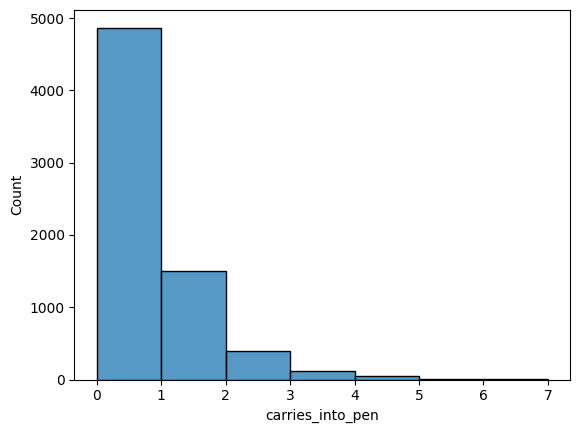

In [ ]:
sns.histplot(mid_off6['carries_into_pen'], bins=7)

In [ ]:
# wejścia w pole karne przeciwnika

carries_into_pen_list = []

for ecu_jam in matches:

    carries_into_pen = ecu_jam[
        (ecu_jam['type'] == 'Carry') &
        ((ecu_jam['carry_end_x'] > 105-16.5) & 
        (ecu_jam['carry_end_y'] > 16) & 
        (ecu_jam['carry_end_y'] < 68-16)) &
        (ecu_jam['period'] < 3) &
        ~((ecu_jam['x'] > 105-16.5) & 
        (ecu_jam['y'] > 13.74) & 
        (ecu_jam['y'] < 68-13.74)
        )
    ].groupby(['player', 'match_id']).size().reset_index(name='carries_into_pen')

    carries_into_pen_list.append(carries_into_pen)

carries_into_pen_df = pd.concat(carries_into_pen_list, ignore_index=True)


In [ ]:
mid_off6 = mid_off5.merge(carries_into_pen_df, on=['match_id', 'player'], how='left').fillna(0)

In [ ]:
mid_off6.sort_values(by='carries_into_pen')

,player,team,match_id,position,Events,minute,goals,assist,xGA,PAxG,good_passes,bad_passes,passes_accuracy,driblle_complete,driblle_failed,accuracy_dribbles,dribbles,carries_into_pen
0,Aaron Ramsey,Wales,3788766,Center Forward,125,90.0,0.0,0.0,0.000000,0.000000,21.0,8.0,0.724138,0.0,0.0,0.000000,0.0,0.0
2548,Gregoire Defrel,Sassuolo,3879563,Center Forward,119,90.0,0.0,0.0,0.000000,-0.051572,16.0,1.0,0.941176,0.0,1.0,0.000000,-1.0,0.0
2549,Gregoire Defrel,Sassuolo,3879585,Center Forward,149,90.0,0.0,0.0,0.000000,0.000000,15.0,1.0,0.937500,0.0,1.0,0.000000,-1.0,0.0
2550,Gregoire Defrel,Sassuolo,3879603,Center Forward,170,90.0,0.0,0.0,0.021978,0.604630,24.0,6.0,0.800000,1.0,0.0,1.000000,1.0,0.0
2551,Gregoire Defrel,Sassuolo,3879619,Center Forward,142,71.0,0.0,0.0,0.058313,0.000000,22.0,6.0,0.785714,0.0,2.0,0.000000,-2.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3719,Kylian Mbappé Lottin,Paris Saint-Germain,3837683,Center Forward,183,90.0,1.0,0.0,0.373429,1.920308,36.0,5.0,0.878049,2.0,6.0,0.250000,-4.0,8.0
6346,Thierry Henry,Arsenal,3749522,Left Center Forward,178,90.0,2.0,0.0,0.260895,2.931148,30.0,16.0,0.652174,5.0,2.0,0.714286,3.0,8.0
3715,Kylian Mbappé Lottin,Paris Saint-Germain,3803000,Center Forward,201,90.0,3.0,1.0,0.811889,3.212537,37.0,8.0,0.822222,3.0,3.0,0.500000,0.0,8.0
3849,Lionel Andrés Messi Cuccittini,Barcelona,9575,Center Forward,257,90.0,0.0,0.0,0.099290,0.175439,48.0,14.0,0.774194,7.0,4.0,0.636364,3.0,9.0


In [ ]:
# wejścia w pole karne przeciwnika

carries_into_pen_list = []

for ecu_jam in matches:

    carries_into_pen = ecu_jam[
        (ecu_jam['type'] == 'Carry') &
        ((ecu_jam['carry_end_x'] > 105-16.5) & 
        (ecu_jam['carry_end_y'] > 16) & 
        (ecu_jam['carry_end_y'] < 68-16)) &
        (ecu_jam['period'] < 3) &
        ~((ecu_jam['x'] > 105-16.5) & 
        (ecu_jam['y'] > 13.74) & 
        (ecu_jam['y'] < 68-13.74)
        )
    ].groupby(['player', 'match_id']).size().reset_index(name='carries_into_pen')

    carries_into_pen_list.append(carries_into_pen)

carries_into_pen_df = pd.concat(carries_into_pen_list, ignore_index=True)


In [ ]:
"""
progressive_passes_list = []

for events_df in matches:
    
    start_pass_d = np.sqrt((105 - events_df['x'])**2 + (34 - events_df['y'])**2)
    end_pass_d = np.sqrt((105 - events_df['pass_end_x'])**2 + (34 - events_df['pass_end_y'])**2)

# 1 przypadek
    progressive_passes_1 = events_df[(events_df['type'] == "Pass") & (events_df["pass_outcome"].isna()) & (events_df['period'] < 3) & (~events_df['pass_type'].isin(['Throw-in', 'Free Kick', 'Goal Kick', 'Corner'])) & (events_df['pass_end_x'] < 52.5) & (start_pass_d - end_pass_d >= 30)].groupby(['player', 'match_id']).size().reset_index(name='prog1')

# 2 przypadek
    progressive_passes_2 = events_df[(events_df['type'] == "Pass") & (~events_df['pass_type'].isin(['Throw-in', 'Free Kick', 'Goal Kick', 'Corner'])) & (events_df['period'] < 3) & (events_df["pass_outcome"].isna()) & (events_df['x'] < 52.5) & (events_df['pass_end_x'] > 52.5) & (start_pass_d - end_pass_d >= 15)].groupby(['player', 'match_id']).size().reset_index(name='prog2')

# 3 przypadek
    progressive_passes_3 = events_df[(events_df['type'] == "Pass") & (events_df['period'] < 3) & (~events_df['pass_type'].isin(['Throw-in', 'Free Kick', 'Goal Kick', 'Corner'])) & (events_df["pass_outcome"].isna()) & (events_df['x'] > 52.5) & (events_df['pass_end_x'] > 52.5) & (start_pass_d - end_pass_d >= 10) & events_df["pass_type"].isna( )].groupby(['player', 'match_id']).size().reset_index(name='prog3')

    progressive_passes_list.append(progressive_passes_1)
    progressive_passes_list.append(progressive_passes_2)
    progressive_passes_list.append(progressive_passes_3)

progressive_passes_df = pd.concat(progressive_passes_list, ignore_index=True)
"""


In [ ]:
progressive_passes_list = []

for events_df in matches:
    
    start_pass_d = np.sqrt((105 - events_df['x'])**2 + (34 - events_df['y'])**2)
    end_pass_d = np.sqrt((105 - events_df['pass_end_x'])**2 + (34 - events_df['pass_end_y'])**2)

    prog = events_df[((events_df['type'] == "Pass") & (events_df['period'] < 3) & (~events_df['pass_type'].isin(['Throw-in', 'Free Kick', 'Goal Kick', 'Corner'])) & (events_df["pass_outcome"].isna()) & (events_df['x'] > 52.5) & (events_df['pass_end_x'] > 52.5) & (start_pass_d - end_pass_d >= 10)) | ((events_df['type'] == "Pass") & (events_df['period'] < 3) & (~events_df['pass_type'].isin(['Throw-in', 'Free Kick', 'Goal Kick', 'Corner'])) & (events_df["pass_outcome"].isna()) & (events_df['x'] < 52.5) & (events_df['pass_end_x'] > 52.5) & (start_pass_d - end_pass_d >= 15)) | ((events_df['type'] == "Pass") & (~events_df['pass_type'].isin(['Throw-in', 'Free Kick', 'Goal Kick', 'Corner'])) & (events_df["pass_outcome"].isna()) & (events_df['period'] < 3) & (events_df['pass_end_x'] < 52.5) & (start_pass_d - end_pass_d >= 30))].groupby(['player', 'match_id']).size().reset_index(name='prog_pass')


    progressive_passes_list.append(prog)

progressive_passes_df = pd.concat(progressive_passes_list, ignore_index=True)


In [ ]:
progressive_passes_df['prog_pass'] = progressive_passes_df['prog_pass'].fillna(0)

In [ ]:
progressive_passes_df = progressive_passes_df[['player', 'match_id', 'prog_pass']]

In [ ]:
mid_off7 = mid_off6.merge(progressive_passes_df, on=['match_id', 'player'], how='left').fillna(0)

Progresive carries

In [ ]:
# źle!!!!!!!!!!!
progressive_carries_list = []

for events_df in matches:
    
    start_pass_d = np.sqrt((105 - events_df['x'])**2 + (34 - events_df['y'])**2)
    end_pass_d = np.sqrt((105 - events_df['carry_end_x'])**2 + (34 - events_df['carry_end_y'])**2)

# 1 przypadek
    progressive_carries_1 = events_df[(events_df['type'] == "Carry") & (events_df['period'] < 3) & (events_df['carry_end_x'] < 52.5) & (start_pass_d - end_pass_d >= 30)].groupby(['player', 'match_id']).size().reset_index(name='prog_carry1')


    progressive_carries_2 = events_df[(events_df['type'] == "Carry") & (events_df['period'] < 3) & (events_df['x'] < 52.5) & (events_df['carry_end_x'] > 52.5) & (start_pass_d - end_pass_d >= 15)].groupby(['player', 'match_id']).size().reset_index(name='prog_carry2')

    progressive_carries_3 = events_df[(events_df['type'] == "Carry") & (events_df['period'] < 3) & (events_df['x'] > 52.5) & (events_df['carry_end_x'] > 52.5) & (start_pass_d - end_pass_d >= 10)].groupby(['player', 'match_id']).size().reset_index(name='prog_carry3')

    progressive_carries_list.append(progressive_carries_1)
    progressive_carries_list.append(progressive_carries_2)
    progressive_carries_list.append(progressive_carries_3)

progressive_carries_df = pd.concat(progressive_carries_list, ignore_index=True)


In [ ]:
progressive_carries_list = []

for events_df in matches:
    
    start_pass_d = np.sqrt((105 - events_df['x'])**2 + (34 - events_df['y'])**2)
    end_pass_d = np.sqrt((105 - events_df['carry_end_x'])**2 + (34 - events_df['carry_end_y'])**2)

    prog_carries = events_df[((events_df['type'] == "Carry") & (events_df['period'] < 3) & (events_df['x'] < 52.5) & (events_df['carry_end_x'] > 52.5) & (start_pass_d - end_pass_d >= 15)) | ((events_df['type'] == "Carry") & (events_df['period'] < 3) & (events_df['x'] > 52.5) & (events_df['carry_end_x'] > 52.5) & (start_pass_d - end_pass_d >= 10)) | ((events_df['type'] == "Carry") & (events_df['period'] < 3) & (events_df['carry_end_x'] < 52.5) & (start_pass_d - end_pass_d >= 30))].groupby(['player', 'match_id']).size().reset_index(name='prog_carries')


    progressive_carries_list.append(prog_carries)

progressive_carries_df = pd.concat(progressive_carries_list, ignore_index=True)


In [ ]:
progressive_carries_df['prog_carries'] = progressive_carries_df['prog_carries'].fillna(0)

In [ ]:
progressive_carries_df.sort_values(by='prog_carries')

,player,match_id,prog_carries
32578,Mathieu Deplagne,3901256,1
12112,Emiliano Buendía,3825612,1
25064,Patrice Evra,3879597,1
12114,Jefferson Andrés Lerma Solís,3825612,1
25063,Mario Mandžukić,3879597,1
...,...,...,...
27390,Gerard Deulofeu Lázaro,3754046,17
10197,Neymar da Silva Santos Junior,266280,17
10346,Neymar da Silva Santos Junior,265952,19
39663,Cristian Tello Herrera,69316,21


In [ ]:
mid_off8 = mid_off7.merge(progressive_carries_df, on=['match_id', 'player'], how='left').fillna(0)

Pojedynki wygrane i przegrane

In [ ]:
strikers22.iloc[:, 22:]

,duels_50_won,duels_50_lost,duels_won,duels_lost,aerial_lost,miscontrol,dispossessed,error,interception,recovery,clearance_aerial_won,clearance,miscontrol_aerial_won,aerial_won_shot,duels_wons
0,0.0,0.0,0.0,4.0,3.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,2.0,3.0
1,0.0,0.0,0.0,4.0,2.0,2.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0
2,0.0,1.0,0.0,11.0,5.0,3.0,1.0,0.0,0.0,2.0,0.0,0.0,0.0,0.0,2.0
3,0.0,0.0,1.0,10.0,2.0,3.0,5.0,0.0,0.0,6.0,0.0,1.0,0.0,0.0,8.0
4,0.0,0.0,0.0,8.0,4.0,3.0,1.0,0.0,0.0,3.0,0.0,0.0,0.0,0.0,3.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6802,1.0,0.0,0.0,12.0,3.0,4.0,4.0,0.0,0.0,8.0,0.0,0.0,0.0,0.0,9.0
6803,1.0,0.0,1.0,11.0,6.0,2.0,2.0,0.0,0.0,5.0,0.0,0.0,0.0,0.0,7.0
6804,0.0,0.0,0.0,13.0,5.0,3.0,3.0,0.0,1.0,4.0,0.0,0.0,0.0,0.0,5.0
6805,0.0,0.0,2.0,10.0,1.0,6.0,2.0,0.0,0.0,9.0,0.0,0.0,0.0,0.0,11.0


Pojedynki wygrane:
- duels_50_won
- duels_won
- clearance_aerial_won
- miscontrol_aerial_won
- clearance

Pojedynki przegrane:
- duels_50_lost
- duels_lost
- aerial_lost

Przejęcia:
- interception
- recovery

Straty:
- misscontrol
- dispossessed
- error

In [ ]:
# przejęcia = inter + reco

inter_list = []

for match in matches:
    
    inter = match[(match['type'] == 'Interception') & (match['period'] < 3)].groupby(['player', 'match_id']).size().reset_index(name='interception')
    inter_list.append(inter)

inter_df = pd.concat(inter_list, ignore_index=True)

In [ ]:
recovery_list = []

for match in matches:
    
    recov = match[(match['type'] == 'Ball Recovery') & (match['period'] < 3) ].groupby(['player', 'match_id']).size().reset_index(name='recovery')
    recovery_list.append(recov)

recovery_df = pd.concat(recovery_list, ignore_index=True)

In [ ]:
mid_off9 = mid_off8.merge(inter_df, on=['match_id', 'player'], how='left').fillna(0)

In [ ]:
mid_off10 = mid_off9.merge(recovery_df, on=['match_id', 'player'], how='left').fillna(0)

In [ ]:
mid_off10['inter_reco'] = (mid_off10['interception'] + mid_off10['recovery']).fillna(0)

Straty = dispo + misc

In [ ]:
dispossessed_list = []

for match in matches:
    
    dispossessed = match[(match['type'] == 'Dispossessed') & (match['period'] < 3)].groupby(['player', 'match_id']).size().reset_index(name='dispossessed')
    dispossessed_list.append(dispossessed)

dispossessed_df = pd.concat(dispossessed_list, ignore_index=True)

In [ ]:
miscontrol_list = []

for match in matches:
    
    miscontrol = match[(match['type'] == 'Miscontrol') & (match['period'] < 3)].groupby(['player', 'match_id']).size().reset_index(name='miscontrol')
    miscontrol_list.append(miscontrol)

miscontrol_df = pd.concat(miscontrol_list, ignore_index=True)

In [ ]:
mid_off11 = mid_off10.merge(dispossessed_df, on=['match_id', 'player'], how='left').fillna(0)

In [ ]:
mid_off12 = mid_off11.merge(miscontrol_df, on=['match_id', 'player'], how='left').fillna(0)

In [ ]:
mid_off12['dispo+misc'] = mid_off12['dispossessed'] + mid_off12['miscontrol']

In [ ]:
mid_off12

,player,team,match_id,position,Events,minute,goals,assist,xGA,PAxG,...,dribbles,carries_into_pen,prog_pass,prog_carries,interception,recovery,inter_reco,dispossessed,miscontrol,dispo+misc
0,Aaron Ramsey,Wales,3788766,Center Forward,125,90.0,0.0,0.0,0.000000,0.000000,...,0.0,0.0,2.0,0.0,1.0,5.0,6.0,2.0,2.0,4.0
1,Abdallah Dipo Sima,Angers,3837818,Left Center Forward,67,79.0,0.0,0.0,0.000000,-0.112058,...,-2.0,1.0,0.0,3.0,0.0,3.0,3.0,1.0,1.0,2.0
2,Abdoulaye Sadio Diallo,Bastia,3829504,Right Center Forward,149,61.0,0.0,0.0,0.042107,0.683842,...,-3.0,0.0,3.0,0.0,0.0,2.0,2.0,1.0,0.0,1.0
3,Abdul Majeed Waris,Lorient,3829431,Left Center Forward,167,90.0,0.0,0.0,0.000000,0.292344,...,-1.0,0.0,3.0,0.0,0.0,0.0,0.0,0.0,5.0,5.0
4,Abdul Majeed Waris,Lorient,3829456,Right Center Forward,165,90.0,1.0,1.0,0.041104,2.006973,...,-1.0,0.0,1.0,2.0,0.0,1.0,1.0,6.0,4.0,10.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6970,Łukasz Gikiewicz,Chennaiyin,3813311,Left Center Forward,176,90.0,1.0,0.0,0.000000,1.442466,...,-1.0,0.0,3.0,1.0,1.0,6.0,7.0,2.0,4.0,6.0
6971,Łukasz Gikiewicz,Chennaiyin,3817852,Right Center Forward,132,90.0,0.0,0.0,0.000000,-0.160108,...,1.0,0.0,1.0,1.0,1.0,1.0,2.0,0.0,1.0,1.0
6972,Łukasz Gikiewicz,Chennaiyin,3817858,Center Forward,104,76.0,0.0,0.0,0.000000,0.000000,...,0.0,1.0,1.0,1.0,0.0,2.0,2.0,1.0,4.0,5.0
6973,Łukasz Gikiewicz,Chennaiyin,3817868,Right Center Forward,146,90.0,0.0,0.0,0.097712,-0.373380,...,0.0,0.0,0.0,2.0,1.0,1.0,2.0,0.0,3.0,3.0


Pojedynki wygrane

In [ ]:
duels_50_won_list = []

for match in matches:
    if '50_50_outcome' in match.columns:
        duels_50_won = match[(match['50_50_outcome'].isin(win)) & (match['period'] < 3)].groupby(['player', 'match_id']).size().reset_index(name='duels_50_won')
        duels_50_won_list.append(duels_50_won)

duels_50_won_df = pd.concat(duels_50_won_list, ignore_index=True)

In [ ]:
duels_50_lost_list = []
for match in matches:
    if '50_50_outcome' in match.columns:
        duels_50_lost = match[(match['50_50_outcome'].isin(lost)) & (match['period'] < 3) ].groupby(['player', 'match_id']).size().reset_index(name='duels_50_lost')
        duels_50_lost_list.append(duels_50_lost)

duels_50_lost_df = pd.concat(duels_50_lost_list, ignore_index=True)

In [ ]:
duels_50 = duels_50_won_df.merge(duels_50_lost_df, on=['match_id', 'player'], how='outer').fillna(0)

In [ ]:
# duels

win = ['Won', 'Success', 'Success In Play']
lost = ['Lost In Play', 'Lost Out']

In [ ]:
duels_won_list = []
for match in matches:
    
    duels_won = match[(match['duel_outcome'].isin(win)) & (match['period'] < 3)].groupby(['player', 'match_id']).size().reset_index(name='duels_won')
    duels_won_list.append(duels_won)

duels_won_df = pd.concat(duels_won_list, ignore_index=True)

In [ ]:
duels_lost_list = []
for match in matches:
    
    duels_lost = match[(match['duel_outcome'].isin(lost)) & (match['period'] < 3)].groupby(['player', 'match_id']).size().reset_index(name='duels_lost')
    duels_lost_list.append(duels_lost)

duels_lost_df = pd.concat(duels_lost_list, ignore_index=True)

In [ ]:
duels_df = duels_won_df.merge(duels_lost_df, on=['match_id', 'player'], how='outer').fillna(0)

In [ ]:
# przegrane pojedynki powietrzne

aerial_lost_list = []
for match in matches:
    
    aerial_lost = match[(match['duel_type'] == 'Aerial Lost') & (match['period'] < 3)].groupby(['player', 'match_id']).size().reset_index(name='aerial_lost')
    aerial_lost_list.append(aerial_lost)

aerial_lost_df = pd.concat(aerial_lost_list, ignore_index=True)

In [ ]:
error_list = []

for match in matches:
    
    error = match[(match['type'] == 'Error') & (match['period'] < 3) ].groupby(['player', 'match_id']).size().reset_index(name='error')
    error_list.append(error)

error_df = pd.concat(error_list, ignore_index=True)

In [ ]:
aerial_won_list = []

for match in matches:
    if 'clearance_aerial_won' in match.columns:
        aerial_won = match[~(match['clearance_aerial_won'].isna()) & (match['period'] < 3)].groupby(['player', 'match_id']).size().reset_index(name='clearance_aerial_won')
        aerial_won_list.append(aerial_won)

cl_aerial_won_df = pd.concat(aerial_won_list, ignore_index=True)

In [ ]:
clearance_list = []

for match in matches:
    clearance = match[(match['type'] == 'Clearance') & (match['period'] < 3) ].groupby(['player', 'match_id']).size().reset_index(name='clearance')
    clearance_list.append(clearance)

clearance_df = pd.concat(clearance_list, ignore_index=True)

In [ ]:
aerial_won_shot_list = []

for match in matches:
    if 'shot_aerial_won' in match.columns:
        aerial_won_shot = match[~(match['shot_aerial_won'].isna()) & (match['period'] < 3)].groupby(['player', 'match_id']).size().reset_index(name='aerial_won_shot')
        aerial_won_shot_list.append(aerial_won_shot)

aerial_won_shot_df = pd.concat(aerial_won_shot_list, ignore_index=True)

In [ ]:
# przegrane poj pow
miscontrol_aerial_won_list = []

for match in matches:
    if 'miscontrol_aerial_won' in match.columns:
        miscontrol_ar_w = match[(match['type'] == 'Miscontrol') & (~match['miscontrol_aerial_won'].isna()) &(match['period'] < 3)].groupby(['player', 'match_id']).size().reset_index(name='miscontrol_aerial_won')
        miscontrol_aerial_won_list.append(miscontrol_ar_w)

miscontrol_ar_w_df = pd.concat(miscontrol_aerial_won_list, ignore_index=True)

In [ ]:
duels1 = duels_50.merge(duels_df, on=['match_id', 'player'], how='outer').fillna(0)

In [ ]:
duels2 = duels1.merge(cl_aerial_won_df, on=['match_id', 'player'], how='outer').fillna(0)

In [ ]:
duels3 = duels2.merge(clearance_df, on=['match_id', 'player'], how='outer').fillna(0)

In [ ]:
duels4 = duels3.merge(aerial_won_shot_df, on=['match_id', 'player'], how='outer').fillna(0)

In [ ]:
duels5 = duels4.merge(miscontrol_ar_w_df, on=['match_id', 'player'], how='outer').fillna(0)

In [ ]:
duels5['duels_wons'] = duels5['duels_50_won'] + duels5['duels_won'] + duels5['clearance_aerial_won'] + duels5['clearance'] + duels5['aerial_won_shot'] + duels5['miscontrol_aerial_won']

In [ ]:
duels_l1 = duels_lost_df.merge(duels_50_lost_df, on=['match_id', 'player'], how='outer').fillna(0)

In [ ]:
duels_l2 = duels_l1.merge(aerial_lost_df, on=['match_id', 'player'], how='outer').fillna(0)

In [ ]:
duels_l3 = duels_l2.merge(error_df, on=['match_id', 'player'], how='outer').fillna(0)

In [ ]:
duels_l3['duels_losts'] = duels_l3['duels_lost'] + duels_l3['duels_50_lost'] + duels_l3['aerial_lost'] + duels_l3['error']

In [ ]:
du_w = duels5[['player', 'match_id', 'duels_wons']]

In [ ]:
du_w

,player,match_id,duels_wons
0,Alistair Johnston,3943076,6.0
1,Sebastián Enzo Cáceres Ramos,3942852,6.0
2,Cyle Larin,3942785,1.0
3,Erick Javier Davis Grajales,3942416,7.0
4,Diego Nicolás De La Cruz Arcosa,3942415,2.0
...,...,...,...
61884,Teddy Sheringham,3750240,1.0
61885,Luís Antônio Corrêa da Costa,3793185,1.0
61886,Antônio de Oliveira Filho,3887188,1.0
61887,Diego Armando Maradona,3887188,2.0


In [ ]:
mid_off13 = mid_off12.merge(du_w, on=['match_id', 'player'], how='left').fillna(0)

In [ ]:
du_l = duels_l3[['player', 'match_id', 'duels_losts']]

In [ ]:
mid_off13 = mid_off13.merge(du_l, on=['match_id', 'player'], how='left').fillna(0)

<Axes: xlabel='duels_losts', ylabel='Count'>

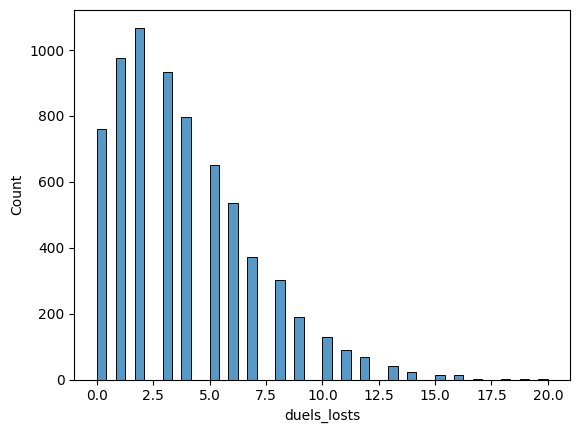

In [ ]:
sns.histplot(mid_off13['duels_losts'])

In [ ]:
mid_off13['duels'] = mid_off13['duels_wons'] - mid_off13['duels_losts']

NameError: name 'matches' is not defined

In [ ]:
metric= 'xT+'

metric_list = []

for match in matches:
    metric_df = (
    match[(match['period'] < 3)]
    .groupby(['match_id', 'player'])['xT+']
    .sum()
    .reset_index(name=metric)
)
    metric_list.append(metric_df)
xT_plus = pd.concat(metric_list, ignore_index=True)

In [ ]:
mid_off14 = mid_off13.merge(xT_plus, on=['match_id', 'player'], how='left').fillna(0)

In [ ]:
mid_off14

,player,team,match_id,position,Events,minute,goals,assist,xGA,PAxG,...,interception,recovery,inter_reco,dispossessed,miscontrol,dispo+misc,duels_wons,duels_losts,duels,xT+
0,Aaron Ramsey,Wales,3788766,Center Forward,125,90.0,0.0,0.0,0.000000,0.000000,...,1.0,5.0,6.0,2.0,2.0,4.0,2.0,1.0,1.0,0.154
1,Abdallah Dipo Sima,Angers,3837818,Left Center Forward,67,79.0,0.0,0.0,0.000000,-0.112058,...,0.0,3.0,3.0,1.0,1.0,2.0,0.0,1.0,-1.0,0.060
2,Abdoulaye Sadio Diallo,Bastia,3829504,Right Center Forward,149,61.0,0.0,0.0,0.042107,0.683842,...,0.0,2.0,2.0,1.0,0.0,1.0,4.0,6.0,-2.0,0.080
3,Abdul Majeed Waris,Lorient,3829431,Left Center Forward,167,90.0,0.0,0.0,0.000000,0.292344,...,0.0,0.0,0.0,0.0,5.0,5.0,1.0,1.0,0.0,0.133
4,Abdul Majeed Waris,Lorient,3829456,Right Center Forward,165,90.0,1.0,1.0,0.041104,2.006973,...,0.0,1.0,1.0,6.0,4.0,10.0,1.0,1.0,0.0,0.195
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6970,Łukasz Gikiewicz,Chennaiyin,3813311,Left Center Forward,176,90.0,1.0,0.0,0.000000,1.442466,...,1.0,6.0,7.0,2.0,4.0,6.0,4.0,4.0,0.0,0.047
6971,Łukasz Gikiewicz,Chennaiyin,3817852,Right Center Forward,132,90.0,0.0,0.0,0.000000,-0.160108,...,1.0,1.0,2.0,0.0,1.0,1.0,7.0,10.0,-3.0,0.030
6972,Łukasz Gikiewicz,Chennaiyin,3817858,Center Forward,104,76.0,0.0,0.0,0.000000,0.000000,...,0.0,2.0,2.0,1.0,4.0,5.0,4.0,1.0,3.0,0.038
6973,Łukasz Gikiewicz,Chennaiyin,3817868,Right Center Forward,146,90.0,0.0,0.0,0.097712,-0.373380,...,1.0,1.0,2.0,0.0,3.0,3.0,1.0,5.0,-4.0,0.069


<Axes: xlabel='xT+', ylabel='Count'>

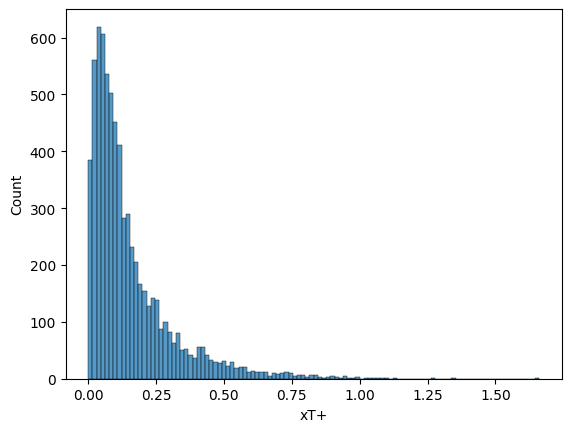

In [ ]:
sns.histplot(mid_off14['xT+'])

In [ ]:
target_shot_list = []
for match in matches:
    target = match[(match['shot_outcome'].isin(['Saved', 'Goal', 'Saved To Post'])) & (match['period'] < 3)].groupby(['match_id', 'player'] ).size().reset_index(name='shots_on_target')
    target_shot_list.append(target)
target_df = pd.concat(target_shot_list, ignore_index=True)

In [ ]:
mid_off15 = mid_off14.merge(target_df, on=['match_id', 'player'], how='left').fillna(0)

<Axes: xlabel='shots_on_target', ylabel='Count'>

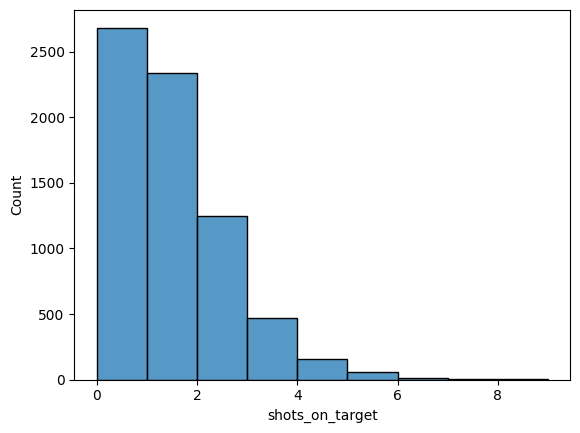

In [ ]:
sns.histplot(mid_off15['shots_on_target'], bins=9)

In [ ]:
mid_off_final = mid_off15[['player', 'team', 'match_id', 'position', 'goals', 'assist', 'xGA', 'PAxG', 'passes_accuracy', 'dribbles', 'carries_into_pen', 'prog_pass', 'prog_carries', 'inter_reco', 'dispo+misc', 'duels', 'xT+', 'shots_on_target']]

Zaczynamy tworzenie modelu z moimi wagami 

In [ ]:
mid_off_final

,player,team,match_id,position,goals,assist,xGA,PAxG,passes_accuracy,dribbles,carries_into_pen,prog_pass,prog_carries,inter_reco,dispo+misc,duels,xT+,shots_on_target
0,Aaron Ramsey,Wales,3788766,Center Forward,0.0,0.0,0.000000,0.000000,0.724138,0.0,0.0,2.0,0.0,6.0,4.0,1.0,0.154,0.0
1,Abdallah Dipo Sima,Angers,3837818,Left Center Forward,0.0,0.0,0.000000,-0.112058,0.818182,-2.0,1.0,0.0,3.0,3.0,2.0,-1.0,0.060,0.0
2,Abdoulaye Sadio Diallo,Bastia,3829504,Right Center Forward,0.0,0.0,0.042107,0.683842,0.781250,-3.0,0.0,3.0,0.0,2.0,1.0,-2.0,0.080,1.0
3,Abdul Majeed Waris,Lorient,3829431,Left Center Forward,0.0,0.0,0.000000,0.292344,0.964286,-1.0,0.0,3.0,0.0,0.0,5.0,0.0,0.133,1.0
4,Abdul Majeed Waris,Lorient,3829456,Right Center Forward,1.0,1.0,0.041104,2.006973,0.826087,-1.0,0.0,1.0,2.0,1.0,10.0,0.0,0.195,2.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6970,Łukasz Gikiewicz,Chennaiyin,3813311,Left Center Forward,1.0,0.0,0.000000,1.442466,0.687500,-1.0,0.0,3.0,1.0,7.0,6.0,0.0,0.047,1.0
6971,Łukasz Gikiewicz,Chennaiyin,3817852,Right Center Forward,0.0,0.0,0.000000,-0.160108,0.476190,1.0,0.0,1.0,1.0,2.0,1.0,-3.0,0.030,0.0
6972,Łukasz Gikiewicz,Chennaiyin,3817858,Center Forward,0.0,0.0,0.000000,0.000000,0.545455,0.0,1.0,1.0,1.0,2.0,5.0,3.0,0.038,0.0
6973,Łukasz Gikiewicz,Chennaiyin,3817868,Right Center Forward,0.0,0.0,0.097712,-0.373380,0.666667,0.0,0.0,0.0,2.0,2.0,3.0,-4.0,0.069,0.0


In [ ]:
mid_off_final['goals'].describe()

count    6975.000000
mean        0.387670
std         0.649914
min         0.000000
25%         0.000000
50%         0.000000
75%         1.000000
max         5.000000
Name: goals, dtype: float64

<Axes: xlabel='PAxG', ylabel='Count'>

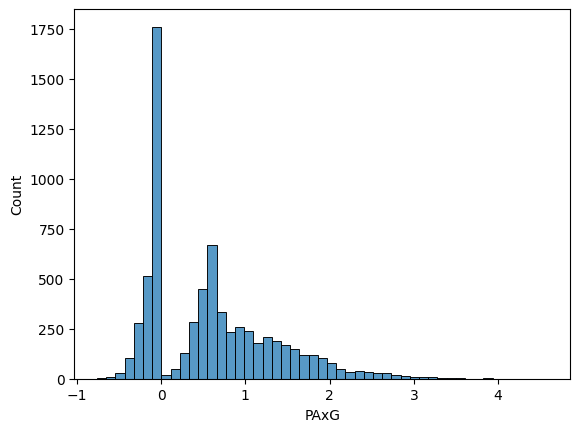

In [ ]:
sns.histplot(mid_off_final['PAxG'])

In [ ]:
from sklearn.preprocessing import QuantileTransformer

In [ ]:
qt = QuantileTransformer(output_distribution='normal', random_state=42)

In [ ]:
mid_off_rank = mid_off_final.copy()
mid_off_rank[['goals_q']] = qt.fit_transform(mid_off_rank[['goals']])

In [ ]:
mid_off_rank[['paxg_q']] = qt.fit_transform(mid_off_rank[['PAxG']])

In [ ]:
sns.histplot(mid_off_rank['dribbles_q'])

KeyError: 'dribbles_q'

In [ ]:
mid_off_rank[['assist_q']] = qt.fit_transform(mid_off_rank[['assist']])

In [ ]:
mid_off_rank[['xga_q']] = qt.fit_transform(mid_off_rank[['xGA']])

In [ ]:
mid_off_rank['goals_q'].describe()

count    6975.000000
mean       -3.248483
std         2.924525
min        -5.199338
25%        -5.199338
50%        -5.199338
75%         0.886449
max         5.199338
Name: goals_q, dtype: float64

In [ ]:
example_model_s[['PAxG_q', 'xGA_q', 'passes_accuracy%_q']] = qt.fit_transform(example_model_s[['PAxG', 'xGA', 'passes_accuracy_%']])

In [ ]:
mid_off_rank[['passes_accuracy_q']] = qt.fit_transform(mid_off_rank[['passes_accuracy']])

In [ ]:
mid_off_rank[['prog_pass_q']] = qt.fit_transform(mid_off_rank[['prog_pass']])

In [ ]:
mid_off_rank[['carries_into_pen_q']] = qt.fit_transform(mid_off_rank[['carries_into_pen']])

In [ ]:
mid_off_rank[['prog_carries_q']] = qt.fit_transform(mid_off_rank[['prog_carries']])

In [ ]:
mid_off_rank.columns

Index(['player', 'team', 'match_id', 'position', 'goals', 'assist', 'xGA',
       'PAxG', 'passes_accuracy', 'dribbles', 'carries_into_pen', 'prog_pass',
       'prog_carries', 'inter_reco', 'dispo+misc', 'duels', 'xT+',
       'shots_on_target', 'goals_q', 'paxg_q', 'assist_q', 'xga_q',
       'passes_accuracy_q', 'prog_pass_q', 'carries_into_pen_q',
       'prog_carries_q'],
      dtype='object')

In [ ]:
mid_off_rank[['inter_reco_q']] = qt.fit_transform(mid_off_rank[['inter_reco']])

In [ ]:
mid_off_rank[['duels_q']] = qt.fit_transform(mid_off_rank[['duels']])

In [ ]:
mid_off_rank[['dispo+misc_q']] = qt.fit_transform(mid_off_rank[['dispo+misc']])

In [ ]:
mid_off_rank[['dribbles_q']] = qt.fit_transform(mid_off_rank[['dribbles']])

In [ ]:
mid_off_rank[['xT+_q']] = qt.fit_transform(mid_off_rank[['xT+']])

In [ ]:
mid_off_rank[['shots_on_target_q']] = qt.fit_transform(mid_off_rank[['shots_on_target']])

In [ ]:
mid_off_rank_test = mid_off_rank.copy()

In [ ]:
mid_off_rank_test['assist_l'] = np.log1p(mid_off_rank_test['assist'])

In [ ]:
mid_off_rank_test['prog_pass_l'] = np.log1p(mid_off_rank_test['prog_pass'])

In [ ]:
mid_off_rank_test['carries_into_pen_l'] = np.log1p(mid_off_rank_test['carries_into_pen'])

In [ ]:
mid_off_rank_test['xga_l'] = np.log1p(mid_off_rank_test['xGA'])

In [ ]:
mid_off_rank_test['prog_carries_l'] = np.log1p(mid_off_rank_test['prog_carries'])

In [ ]:
from sklearn.preprocessing import StandardScaler

# Standaryzacja
scaler = StandardScaler()
mid_off_rank_test['xGA_s'] = scaler.fit_transform(mid_off_rank_test[['xGA']])

# Przeskalowanie tak, aby max wynosił 6
max_value = mid_off_rank_test['xGA_s'].max()
mid_off_rank_test['xGA_re'] = mid_off_rank_test['xGA_s'] * (6 / max_value)

FUNKCJA OCENY

In [ ]:
mid_off_rank

,player,team,match_id,position,goals,assist,xGA,PAxG,passes_accuracy,dribbles,...,paxg_q,assist_q,xga_q,passes_accuracy_q,prog_pass_q,carries_into_pen_q,prog_carries_q,dribbles_q,xT+_q,shots_on_target_q
0,Aaron Ramsey,Wales,3788766,Center Forward,0.0,0.0,0.000000,0.000000,0.724138,0.0,...,-0.441766,-5.199338,-5.199338,-0.067799,0.705530,-5.199338,-5.199338,-0.028859,0.432104,-5.199338
1,Abdallah Dipo Sima,Angers,3837818,Left Center Forward,0.0,0.0,0.000000,-0.112058,0.818182,-2.0,...,-1.139433,-5.199338,-5.199338,0.752997,-5.199338,0.311059,0.790168,-1.467860,-0.523537,-5.199338
2,Abdoulaye Sadio Diallo,Bastia,3829504,Right Center Forward,0.0,0.0,0.042107,0.683842,0.781250,-3.0,...,0.345692,-5.199338,0.079770,0.415634,1.171890,-5.199338,-5.199338,-1.985876,-0.239380,0.130848
3,Abdul Majeed Waris,Lorient,3829431,Left Center Forward,0.0,0.0,0.000000,0.292344,0.964286,-1.0,...,-0.235458,-5.199338,-5.199338,2.343794,1.171890,-5.199338,-5.199338,-0.821412,0.270485,0.130848
4,Abdul Majeed Waris,Lorient,3829456,Right Center Forward,1.0,1.0,0.041104,2.006973,0.826087,-1.0,...,1.664195,1.537691,0.067833,0.823172,0.077862,-5.199338,0.370902,-0.821412,0.659602,0.877196
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6970,Łukasz Gikiewicz,Chennaiyin,3813311,Left Center Forward,1.0,0.0,0.000000,1.442466,0.687500,-1.0,...,1.066384,-5.199338,-5.199338,-0.361511,1.171890,-5.199338,-0.191865,-0.821412,-0.748009,0.130848
6971,Łukasz Gikiewicz,Chennaiyin,3817852,Right Center Forward,0.0,0.0,0.000000,-0.160108,0.476190,1.0,...,-1.336408,-5.199338,-5.199338,-1.837975,0.077862,-5.199338,-0.191865,0.720087,-1.116369,-5.199338
6972,Łukasz Gikiewicz,Chennaiyin,3817858,Center Forward,0.0,0.0,0.000000,0.000000,0.545455,0.0,...,-0.441766,-5.199338,-5.199338,-1.397837,0.077862,0.311059,-0.191865,-0.028859,-0.941700,-5.199338
6973,Łukasz Gikiewicz,Chennaiyin,3817868,Right Center Forward,0.0,0.0,0.097712,-0.373380,0.666667,0.0,...,-2.196465,-5.199338,0.476573,-0.523537,-5.199338,-5.199338,0.370902,-0.028859,-0.387078,-5.199338


In [ ]:
mid_off_rank_test.columns

Index(['player', 'team', 'match_id', 'position', 'goals', 'assist', 'xGA',
       'PAxG', 'passes_accuracy', 'dribbles', 'carries_into_pen', 'prog_pass',
       'prog_carries', 'inter_reco', 'dispo+misc', 'duels', 'xT+',
       'shots_on_target', 'goals_q', 'paxg_q', 'assist_q', 'xga_q',
       'passes_accuracy_q', 'prog_pass_q', 'carries_into_pen_q',
       'prog_carries_q', 'dribbles_q', 'xT+_q', 'shots_on_target_q'],
      dtype='object')

In [ ]:
# moje
mid_off_rank_test['score'] = 0.5*mid_off_rank_test['paxg_q'] + 0.35*mid_off_rank_test['prog_carries_l'] + 0.3*mid_off_rank_test['xT+_q'] + 0.24*mid_off_rank_test['shots_on_target_q'] + 0.24*mid_off_rank_test['xGA_re'] + 0.15*mid_off_rank_test['carries_into_pen_l'] + 0.07*mid_off_rank_test['assist_l'] + 0.14*mid_off_rank_test['prog_pass_q']

In [ ]:
mid_off_rank_test['score'] = 0.3*(0.6*mid_off_rank_test['assist_l'] + 0.4*mid_off_rank_test['xGA_re']) + 0.2*(mid_off_rank_test['paxg_q']) + 0.15*(0.6*mid_off_rank_test['passes_accuracy_q'] + 0.4*mid_off_rank_test['prog_pass_l']) + 0.1*(0.4*mid_off_rank_test['carries_into_pen_l'] + 0.6*mid_off_rank_test['prog_carries_q']) + 0.1*(0.6*mid_off_rank_test['inter_reco_q'] + 0.4*mid_off_rank_test['duels_q']) + 0.05*(mid_off_rank_test['dribbles_q']) - 0.1*mid_off_rank_test['dispo+misc_q']


<Axes: xlabel='score', ylabel='Count'>

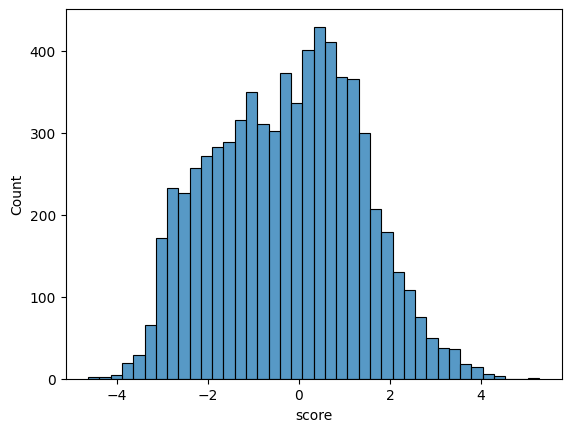

In [ ]:
sns.histplot(mid_off_rank_test['score']) # może lepiej w metrach?

In [ ]:
mid_off_rank_test['score'].describe()

count    6975.000000
mean       -2.047647
std         2.466304
min        -8.732741
25%        -3.853258
50%        -1.995585
75%        -0.247959
max         5.035085
Name: score, dtype: float64

In [ ]:
min_val = mid_off_rank_test['score'].min()
max_val = mid_off_rank_test['score'].max()
median_val = mid_off_rank_test['score'].median()

def scale_score(x):
    if x <= median_val:
        # Skala dla wartości poniżej mediany (3 do 6.5)
        return 4 + 2.9 * (x - min_val) / (median_val - min_val)
    else:
        # Skala dla wartości powyżej mediany (6.5 do 10)
        return 6.9 + 3.1 * (x - median_val) / (max_val - median_val)

# Zastosowanie funkcji
mid_off_rank_test['score_scaled'] = mid_off_rank_test['score'].apply(scale_score)

# Sprawdzenie wyników
print(mid_off_rank_test['score_scaled'].describe())


count    6975.000000
mean        6.802380
std         0.975940
min         4.000000
25%         6.045442
50%         6.900000
75%         7.531953
max        10.000000
Name: score_scaled, dtype: float64


<Axes: xlabel='score_scaled', ylabel='Count'>

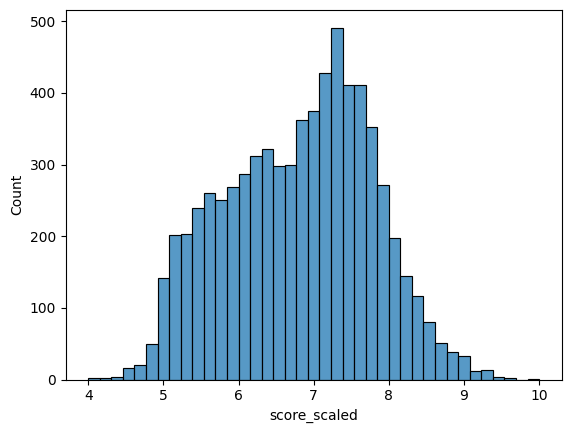

In [ ]:
sns.histplot(mid_off_rank_test['score_scaled'])

Teraz porównanie z ocenami z sofy/flasha ale najpierw zobaczyc jakie srednie oceny daja zeby przyporzadkowac skale.
Weźmy euro2020 ms2022 euro 2024 (ok.200 meczów)

In [ ]:
mid_off_rank_test.sort_values(by='score_scaled').tail(30).groupby('player').size().reset_index(name='count').sort_values(by='count', ascending=False)

,player,count
4,Lionel Andrés Messi Cuccittini,20
3,Kylian Mbappé Lottin,4
5,Thierry Henry,2
0,Diego Armando Maradona,1
1,Jesús Joaquín Fernández Sáez de la Torre,1
2,Jhon Andrés Córdoba Copete,1
6,Zlatan Ibrahimović,1


In [ ]:
to_plot = mid_off_rank_test[mid_off_rank_test['score_scaled'] > 9].groupby('player').size().reset_index(name='count')

In [ ]:
to_plot_y = mid_off_rank_test[mid_off_rank_test['score_scaled'] > 8.8].groupby('player')['score_scaled'].mean().reset_index(name='value')

In [ ]:
to_plot = to_plot.merge(to_plot_y, on=['player'])

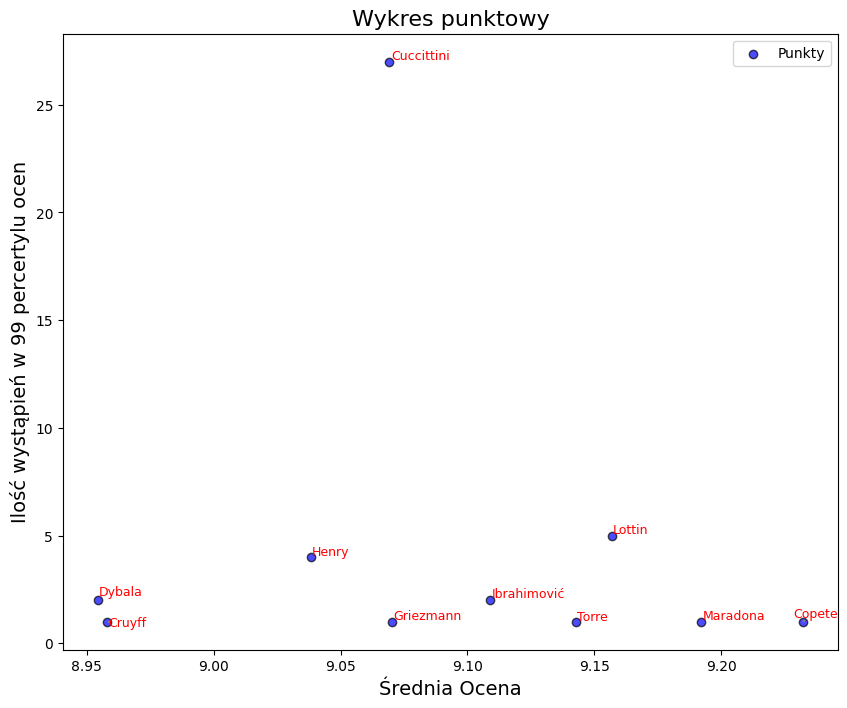

In [ ]:
plt.figure(figsize=(10,8))
plt.scatter(to_plot['value'], to_plot['count'], color='blue', alpha=0.7, edgecolor='k', label='Punkty')
labels = to_plot['player']
from adjustText import adjust_text

texts = []
for i in range(len(to_plot)):
    texts.append(plt.text(
        to_plot['value'].iloc[i],
        to_plot['count'].iloc[i],
        str(labels.iloc[i].split()[-1]),
        fontsize=9,
        color='red'
    ))

# Automatyczna optymalizacja
adjust_text(texts, arrowprops=dict(arrowstyle='->', color='gray'))
plt.title('Wykres punktowy', fontsize=16)
plt.xlabel('Średnia Ocena', fontsize=14)
plt.ylabel('Ilość wystąpień w 99 percertylu ocen', fontsize=14)
plt.legend()
plt.show()

Stworzyliśmy model dla napastników. Teraz stwórmy dla obrońców. Co ma wchodzić w ocenę?
- paxg 0.22
- xga 0.23
- prog carries 0.11
- xT+ 0.14
- 

Co teraz?
Temat: Wykorzystanie zaawansowanych technik analitycznych w kontekście oceny indywidualnej i zespołowej gry zawodowych piłkarzy.

1. wzięcie ocen z sofy z eu20, eu24, wc22 i zobaczyć jaka skala ocen jest i przyrównać do pomocników/napastników...?

2. przyrównanie obu modeli do siebie na przykładzie eu, wc... - wnioski

3. wykresy, radarploty zawodników najlepszych, najsłabszych

4. wzięcie drużyn z eu,wc... i zestawienie statystyk

5. wzięcie jpn league i wzięcię physical data

6. wykresy, porównanie modeli i statystyk

7. koniec

Druga opcja:

1. te same staty dla jpn
2. + physical staty
3. model i to samo potem

Oceny z eu24

In [ ]:
ger_sco = matches[82]

In [ ]:
a = ger_sco.groupby(['player', 'position', 'team']).size().reset_index(name='ev').sort_values(by='team')

In [ ]:
players2[players2['match_id'] == 3930158].sort_values(by='team')

,player,team,match_id,position,Events,minute
7404,Antonio Rüdiger,Germany,3930158,Right Center Back,268,90.0
33181,Jamal Musiala,Germany,3930158,Right Wing,157,73.0
37499,Jonathan Tah,Germany,3930158,Left Center Back,262,90.0
38927,Joshua Kimmich,Germany,3930158,Right Back,271,90.0
49174,Manuel Neuer,Germany,3930158,Goalkeeper,37,90.0
53964,Maximilian Mittelstädt,Germany,3930158,Left Back,244,90.0
75838,Toni Kroos,Germany,3930158,Left Defensive Midfield,285,80.0
82057,İlkay Gündoğan,Germany,3930158,Center Attacking Midfield,133,90.0
5454,Andrew Robertson,Scotland,3930158,Left Wing Back,112,90.0
6327,Angus Gunn,Scotland,3930158,Goalkeeper,76,90.0


Załóżmy że średnio 6,9 wynosi ocena - uwzględnijmy to w naszym modelu

In [ ]:
mid_off_rank_test[mid_off_rank_test['match_id'] == 3930161]

,player,team,match_id,position,goals,assist,xGA,PAxG,passes_accuracy,dribbles,...,shots_on_target_q,score,assist_l,prog_pass_l,carries_into_pen_l,xga_l,xGA_s,xGA_re,prog_carries_l,score_scaled
670,Armando Broja,Albania,3930161,Center Forward,0.0,0.0,0.014937,0.000000,0.727273,-1.0,...,-5.199338,-1.537471,0.0,0.693147,0.0,0.014826,-0.514308,-0.361409,0.693147,6.014093
2384,Gianluca Scamacca,Italy,3930161,Center Forward,0.0,0.0,0.235749,0.528351,0.750000,0.0,...,0.130848,0.268735,0.0,0.693147,0.0,0.211678,0.655298,0.460485,0.000000,7.155548


In [ ]:
mid_off_rank_test.columns

Index(['player', 'team', 'match_id', 'position', 'goals', 'assist', 'xGA',
       'PAxG', 'passes_accuracy', 'dribbles', 'carries_into_pen', 'prog_pass',
       'prog_carries', 'inter_reco', 'dispo+misc', 'duels', 'goals_q',
       'paxg_q', 'assist_q', 'xga_q', 'passes_accuracy_q', 'prog_pass_q',
       'carries_into_pen_q', 'prog_carries_q', 'inter_reco_q', 'duels_q',
       'dispo+misc_q', 'dribbles_q', 'score', 'score_scaled', 'assist_l'],
      dtype='object')

<Axes: xlabel='dispo+misc_boxcox', ylabel='Count'>

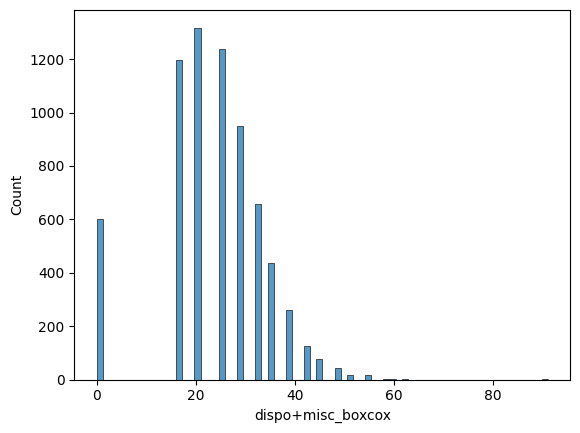

In [ ]:
sns.histplot(mid_off_rank_test['dispo+misc_boxcox'])

In [ ]:
mid_off_rank_test['xGA'].describe()

count    6957.000000
mean        0.123120
std         0.188397
min         0.000000
25%         0.000000
50%         0.047648
75%         0.166734
max         2.088197
Name: xGA, dtype: float64

In [ ]:
from sklearn.preprocessing import StandardScaler

# Standaryzacja
scaler = StandardScaler()
mid_off_rank_test['xGA_s'] = scaler.fit_transform(mid_off_rank_test[['xGA']])

# Przeskalowanie tak, aby max wynosił 6
max_value = mid_off_rank_test['xGA_s'].max()
mid_off_rank_test['xGA_re'] = mid_off_rank_test['xGA_s'] * (6 / max_value)

In [ ]:
from scipy.stats import boxcox

mid_off_rank_test['dispo+misc_shifted'] = mid_off_rank_test['dispo+misc_q'] + abs(mid_off_rank_test['dispo+misc_q'].min()) + 1
mid_off_rank_test['dispo+misc_boxcox'], _ = boxcox(mid_off_rank_test['dispo+misc_shifted'])

- Parę składowych do zmiany
- dziś jeszcze stworzenie wykresu z ocenami z eu24 np. (x:prog carries y:prog passes)
- radar ploty: 2 najlepszych pomocników i ich ocena
- analiza drużynowa

potem:
- porównanie odchyłek z sofą oraz co oni a co ja bierzemy

- jpn? dodanie statsów z events_df + physical i takie samo porównanie

Teraz:
- porównanie modelu z sofy
- przykłady i analiza

Poźniej:
- analiza wybranego turnieju np. wc22 - analiza zawodników

Później:
- analiza reprezentacji w turnieju np. wc22

Później:
- ? jpn - jak te cechy (tylko physical, bez reszty dodatkowych (nie znam dokumentacji)) wpływają na wynik

In [ ]:
from statsbombpy import sb

In [ ]:
wc_22_matches = sb.matches(season_id=106, competition_id=43).sort_values(by=['match_date', 'kick_off'])

In [ ]:
wc_22_id = list(wc_22_matches['match_id'])

In [ ]:
wc_22_events = []

for match in matches:
    if match['match_id'].unique() in wc_22_id:
        wc_22_events.append(match)

In [ ]:
mid_off_wc22 = mid_off_rank_test[mid_off_rank_test['match_id'].isin(wc_22_id)]

In [ ]:
mid_off_wc22.columns

Index(['player', 'team', 'match_id', 'position', 'goals', 'assist', 'xGA',
       'PAxG', 'passes_accuracy', 'dribbles', 'carries_into_pen', 'prog_pass',
       'prog_carries', 'inter_reco', 'dispo+misc', 'duels', 'goals_q',
       'paxg_q', 'assist_q', 'xga_q', 'passes_accuracy_q', 'prog_pass_q',
       'carries_into_pen_q', 'prog_carries_q', 'inter_reco_q', 'duels_q',
       'dispo+misc_q', 'dribbles_q', 'score', 'score_scaled', 'assist_l',
       'xga_l', 'prog_pass_l', 'carries_into_pen_l', 'xga_s',
       'xGA_standardized', 'xGA_rescaled', 'xGA_s', 'xGA_re',
       'dispo+misc_shifted', 'dispo+misc_boxcox'],
      dtype='object')

In [ ]:
mid_off_wc22[['player', 'team', 'score_scaled']]

,player,team,score_scaled
30,Aaron Ramsey,Wales,6.690956
31,Aaron Ramsey,Wales,5.426782
32,Aaron Ramsey,Wales,6.140318
53,Abdulaziz Hatem Mohammed Abdullah,Qatar,6.808512
54,Abdulaziz Hatem Mohammed Abdullah,Qatar,8.561098
...,...,...,...
6765,Yeltsin Ignacio Tejeda Valverde,Costa Rica,5.783533
6787,Youssouf Fofana,France,6.332031
6788,Yunus Dimoara Musah,United States,6.735642
6789,Yunus Dimoara Musah,United States,6.984009


<Axes: xlabel='score_scaled', ylabel='Count'>

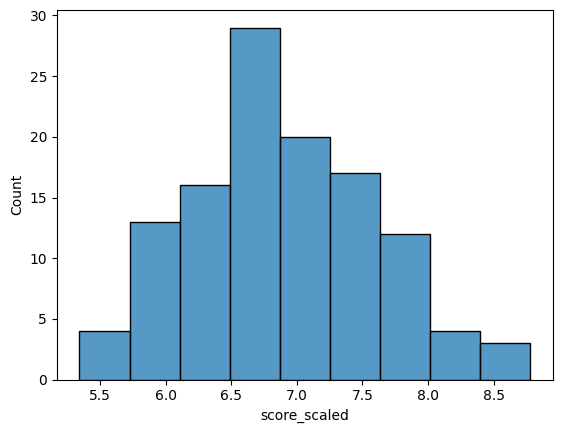

In [ ]:
sns.histplot(mid_off_wc22['score_scaled'])

In [ ]:
mid_off_wc22[['player', 'prog_pass']].groupby(['player', 'prog_pass']).sum().head(10)

Empty DataFrame
Columns: []
Index: [(Aaron Ramsey, 0.0), (Aaron Ramsey, 1.0), (Abdulaziz Hatem Mohammed Abdullah, 1.0), (Abdulaziz Hatem Mohammed Abdullah, 3.0), (Alexis Mac Allister, 2.0), (Alexis Mac Allister, 3.0), (Alphonso Davies, 0.0), (André Ayew Pelé, 0.0), (André-Frank Zambo Anguissa, 0.0), (André-Frank Zambo Anguissa, 5.0)]

In [ ]:
mid_off_wc22[['player', 'prog_pass']].groupby(['player']).sum().sort_values(by='prog_pass')

,prog_pass
player,
Boulaye Dia,0.0
Yeltsin Ignacio Tejeda Valverde,0.0
Jae-Sung Lee,0.0
Alphonso Davies,0.0
André Ayew Pelé,0.0
...,...
Rodrigo Javier De Paul,16.0
Christian Dannemann Eriksen,16.0
Mateo Kovačić,17.0


In [ ]:
prog_pass_carries = mid_off_wc22.groupby('player').agg(
    total_prog_passes = ('prog_pass', 'sum'),
    total_prog_carries = ('prog_carries', 'sum')
).reset_index()

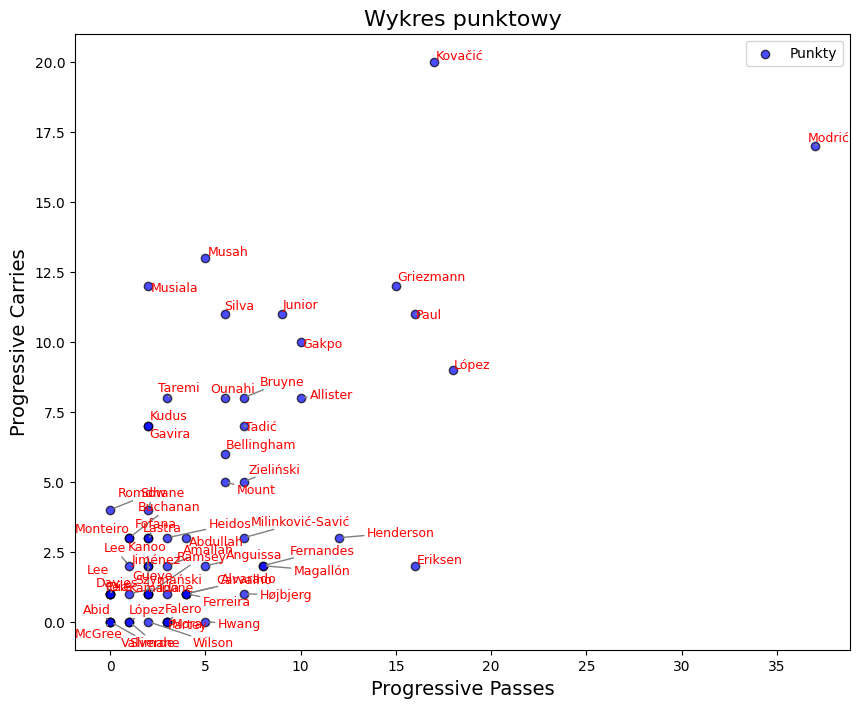

In [ ]:
plt.figure(figsize=(10,8))
plt.scatter(prog_pass_carries['total_prog_passes'], prog_pass_carries['total_prog_carries'], color='blue', alpha=0.7, edgecolor='k', label='Punkty')
labels = prog_pass_carries['player']
from adjustText import adjust_text

texts = []
for i in range(len(prog_pass_carries)):
    texts.append(plt.text(
        prog_pass_carries['total_prog_passes'].iloc[i],
        prog_pass_carries['total_prog_carries'].iloc[i],
        str(labels.iloc[i].split()[-1]),
        fontsize=9,
        color='red'
    ))

# Automatyczna optymalizacja
adjust_text(texts, arrowprops=dict(arrowstyle='->', color='gray'))
plt.title('Wykres punktowy', fontsize=16)
plt.xlabel('Progressive Passes', fontsize=14)
plt.ylabel('Progressive Carries', fontsize=14)
plt.legend()
plt.show()

Radar ploty, analizy, analizy modelu.
Teraz przejdźmy do analizy zespołowej:
- bierzemy pod uwagę tylko turniej wc22 (np.)
- statystyki które obliczymy dla drużyn: (tak samo z zawodnikiem można)
    - ilość strzelonych bramek/mecz
    - xGA/mecz

Dla zawodników, analiza turnieju (np. wc22):
    - pxga/mecz
    - xGA/mecz
    - passes accuracy
    - dribbles/mecz
    - strzały/mecz
- rating/mecz

In [ ]:
mid_off_wc22.columns

Index(['player', 'team', 'match_id', 'position', 'goals', 'assist', 'xGA',
       'PAxG', 'passes_accuracy', 'dribbles', 'carries_into_pen', 'prog_pass',
       'prog_carries', 'inter_reco', 'dispo+misc', 'duels', 'goals_q',
       'paxg_q', 'assist_q', 'xga_q', 'passes_accuracy_q', 'prog_pass_q',
       'carries_into_pen_q', 'prog_carries_q', 'inter_reco_q', 'duels_q',
       'dispo+misc_q', 'dribbles_q', 'score', 'score_scaled', 'assist_l',
       'xga_l', 'prog_pass_l', 'carries_into_pen_l', 'xga_s',
       'xGA_standardized', 'xGA_rescaled', 'xGA_s', 'xGA_re',
       'dispo+misc_shifted', 'dispo+misc_boxcox'],
      dtype='object')

In [ ]:
mid_off_analisys_wc22 = mid_off_wc22.groupby('player').agg(
    total_paxg = ('PAxG', 'sum'),
    total_xGA = ('xGA', 'sum'),
    total_passess_accuracy = ('passes_accuracy', 'sum'),
    total_dribbles_plus = ('dribbles', 'sum'),
    total_prog_passes = ('prog_pass', 'sum'),
    total_prog_carries = ('prog_carries', 'sum'),
    total_score_scaled = ('score_scaled', 'sum'), #7
    total_matches= ('match_id', 'nunique') #8
).reset_index()

In [ ]:
for i in mid_off_analisys_wc22.columns[1:8]:
    print(i)

total_paxg
total_xGA
total_passess_accuracy
total_dribbles_plus
total_prog_passes
total_prog_carries
total_score_scaled


In [ ]:
mid_off_analisys_wc22.sort_values(by='total_matches')

,player,total_paxg,total_xGA,total_passess_accuracy,total_dribbles_plus,total_prog_passes,total_prog_carries,total_score_scaled,total_matches,passes_accuracy_%_zscore_per_match,total_paxg_per_match,total_xGA_per_match,total_passess_accuracy_per_match,total_dribbles_plus_per_match,total_prog_passes_per_match,total_prog_carries_per_match,total_score_scaled_per_match
30,Kang-In Lee,-0.023161,0.000000,0.814815,0.0,1.0,2.0,6.647128,1,6.647128,-0.023161,0.000000,0.814815,0.000000,1.000000,2.000000,6.647128
22,Héctor Miguel Herrera López,0.000000,0.098180,0.787879,0.0,1.0,0.0,6.330359,1,6.330359,0.000000,0.098180,0.787879,0.000000,1.000000,0.000000,6.330359
45,Pablo Martín Páez Gavira,1.583851,0.106545,0.904110,-1.0,2.0,7.0,7.847631,1,7.847631,1.583851,0.106545,0.904110,-1.000000,2.000000,7.000000,7.847631
24,In-Beom Hwang,0.582327,0.000000,0.785714,0.0,5.0,0.0,7.719790,1,7.719790,0.582327,0.000000,0.785714,0.000000,5.000000,0.000000,7.719790
25,Jackson Irvine,-0.076561,0.000000,0.800000,0.0,3.0,1.0,6.237863,1,6.237863,-0.076561,0.000000,0.800000,0.000000,3.000000,1.000000,6.237863
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2,Alexis Mac Allister,2.440654,0.687579,3.494739,4.0,10.0,8.0,30.475914,4,7.618978,0.610164,0.171895,0.873685,1.000000,2.500000,2.000000,7.618978
8,Azzedine Ounahi,-0.054560,0.162223,4.158297,5.0,6.0,8.0,32.491762,5,6.498352,-0.010912,0.032445,0.831659,1.000000,1.200000,1.600000,6.498352
35,Mateo Kovačić,0.590839,1.245635,5.478976,4.0,17.0,20.0,43.923651,6,7.320608,0.098473,0.207606,0.913163,0.666667,2.833333,3.333333,7.320608
33,Luka Modrić,1.535306,0.627976,5.075858,0.0,37.0,17.0,44.900852,6,7.483475,0.255884,0.104663,0.845976,0.000000,6.166667,2.833333,7.483475


In [ ]:
for col in mid_off_analisys_wc22.columns[1:8]:
    mid_off_analisys_wc22[f"{col}_per_match"] = mid_off_analisys_wc22[col] / mid_off_analisys_wc22['total_matches']

In [ ]:
mid_off_analisys_wc22.sort_values(by='total_score_scaled_per_match').tail(10)

,player,total_paxg,total_xGA,total_passess_accuracy,total_dribbles_plus,total_prog_passes,total_prog_carries,total_score_scaled,total_matches,passes_accuracy_%_zscore_per_match,total_paxg_per_match,total_xGA_per_match,total_passess_accuracy_per_match,total_dribbles_plus_per_match,total_prog_passes_per_match,total_prog_carries_per_match,total_score_scaled_per_match
33,Luka Modrić,1.535306,0.627976,5.075858,0.0,37.0,17.0,44.900852,6,7.483475,0.255884,0.104663,0.845976,0.0,6.166667,2.833333,7.483475
47,Pierre-Emile Højbjerg,0.684514,0.000000,0.918919,-1.0,7.0,1.0,7.530775,1,7.530775,0.684514,0.000000,0.918919,-1.0,7.000000,1.000000,7.530775
2,Alexis Mac Allister,2.440654,0.687579,3.494739,4.0,10.0,8.0,30.475914,4,7.618978,0.610164,0.171895,0.873685,1.0,2.500000,2.000000,7.618978
27,Jamal Musiala,0.561019,0.203151,0.764706,8.0,2.0,12.0,7.635384,1,7.635384,0.561019,0.203151,0.764706,8.0,2.000000,12.000000,7.635384
31,Kevin De Bruyne,0.626731,0.285688,0.743590,1.0,7.0,8.0,7.664093,1,7.664093,0.626731,0.285688,0.743590,1.0,7.000000,8.000000,7.664093
1,Abdulaziz Hatem Mohammed Abdullah,0.669252,0.000000,1.595110,1.0,4.0,3.0,15.369610,2,7.684805,0.334626,0.000000,0.797555,0.5,2.000000,1.500000,7.684805
24,In-Beom Hwang,0.582327,0.000000,0.785714,0.0,5.0,0.0,7.719790,1,7.719790,0.582327,0.000000,0.785714,0.0,5.000000,0.000000,7.719790
45,Pablo Martín Páez Gavira,1.583851,0.106545,0.904110,-1.0,2.0,7.0,7.847631,1,7.847631,1.583851,0.106545,0.904110,-1.0,2.000000,7.000000,7.847631
11,Bruno Miguel Borges Fernandes,2.253863,0.000000,0.813559,-1.0,8.0,2.0,7.876545,1,7.876545,2.253863,0.000000,0.813559,-1.0,8.000000,2.000000,7.876545
56,Vitor Machado Ferreira,1.046385,0.000000,0.967213,1.0,4.0,1.0,8.093284,1,8.093284,1.046385,0.000000,0.967213,1.0,4.000000,1.000000,8.093284


In [ ]:
from soccerplots.radar_chart import Radar

In [ ]:
players_radar = mid_off_analisys_wc22[(mid_off_analisys_wc22['player'] == "Vitor Machado Ferreira") | (mid_off_analisys_wc22['player'] == "Kevin De Bruyne")].reset_index()

In [ ]:
players_radar.columns

Index(['index', 'player', 'total_paxg', 'total_xGA', 'total_passess_accuracy',
       'total_dribbles_plus', 'total_prog_passes', 'total_prog_carries',
       'total_score_scaled', 'total_matches',
       'passes_accuracy_%_zscore_per_match', 'total_paxg_per_match',
       'total_xGA_per_match', 'total_passess_accuracy_per_match',
       'total_dribbles_plus_per_match', 'total_prog_passes_per_match',
       'total_prog_carries_per_match', 'total_score_scaled_per_match'],
      dtype='object')

In [ ]:
players_radar = players_radar[['player', 'total_paxg_per_match', 'total_xGA_per_match', 'total_passess_accuracy_per_match', 'total_dribbles_plus_per_match', 'total_prog_passes_per_match', 'total_prog_carries_per_match']]

In [ ]:
params = list(players_radar.columns[1:])

In [ ]:
players_radar

,player,total_paxg_per_match,total_xGA_per_match,total_passess_accuracy_per_match,total_dribbles_plus_per_match,total_prog_passes_per_match,total_prog_carries_per_match
0,Kevin De Bruyne,0.626731,0.285688,0.743590,1.0,7.0,8.0
1,Vitor Machado Ferreira,1.046385,0.000000,0.967213,1.0,4.0,1.0


0    0.743590
1    0.967213
Name: total_passess_accuracy_per_match, dtype: float64

In [ ]:
ranges = []
a_values = []
b_values = []

for x in params:
    a = min(players_radar[params][x])
    a = a - (a*.25)
    
    b = max(players_radar[params][x])
    b = b + (b*.25)
    
    ranges.append((a,b))
    
for x in range(len(players_radar['player'])):
    if players_radar['player'][x] == 'Kevin De Bruyne':
        a_values = players_radar.iloc[x].values.tolist()
    if players_radar['player'][x] == 'Vitor Machado Ferreira':
        b_values = players_radar.iloc[x].values.tolist()
        
a_values = a_values[1:]
b_values = b_values[1:]

values = [a_values,b_values]

In [ ]:
values

[[0.6267308601875334, 0.285687812, 0.7435897435897436, 1.0, 7.0, 8.0],
 [1.0463850404314765, 0.0, 0.9672131147540983, 1.0, 4.0, 1.0]]

In [ ]:
title = dict(
    title_name='Tammy Abraham',
    title_color = 'red',
    subtitle_name = 'Chelsea',
    subtitle_color = 'red',
    title_name_2='Timo Werner',
    title_color_2 = 'blue',
    subtitle_name_2 = 'Chelsea',
    subtitle_color_2 = 'blue',
    title_fontsize = 18,
    subtitle_fontsize=15
)

endnote = '@mckayjohns\ndata via FBREF / Statsbomb'

findfont: Font family 'Liberation Serif' not found.
findfont: Font family 'Liberation Serif' not found.
findfont: Font family 'Liberation Serif' not found.
findfont: Font family 'Liberation Serif' not found.
findfont: Font family 'Liberation Serif' not found.
findfont: Font family 'Liberation Serif' not found.
findfont: Font family 'Liberation Serif' not found.
findfont: Font family 'Liberation Serif' not found.
findfont: Font family 'Liberation Serif' not found.
findfont: Font family 'Liberation Serif' not found.
findfont: Font family 'Liberation Serif' not found.
findfont: Font family 'Liberation Serif' not found.
findfont: Font family 'Liberation Serif' not found.
findfont: Font family 'Liberation Serif' not found.
findfont: Font family 'Liberation Serif' not found.
findfont: Font family 'Liberation Serif' not found.
findfont: Font family 'Liberation Serif' not found.
findfont: Font family 'Liberation Serif' not found.
findfont: Font family 'Liberation Serif' not found.
findfont: Fo

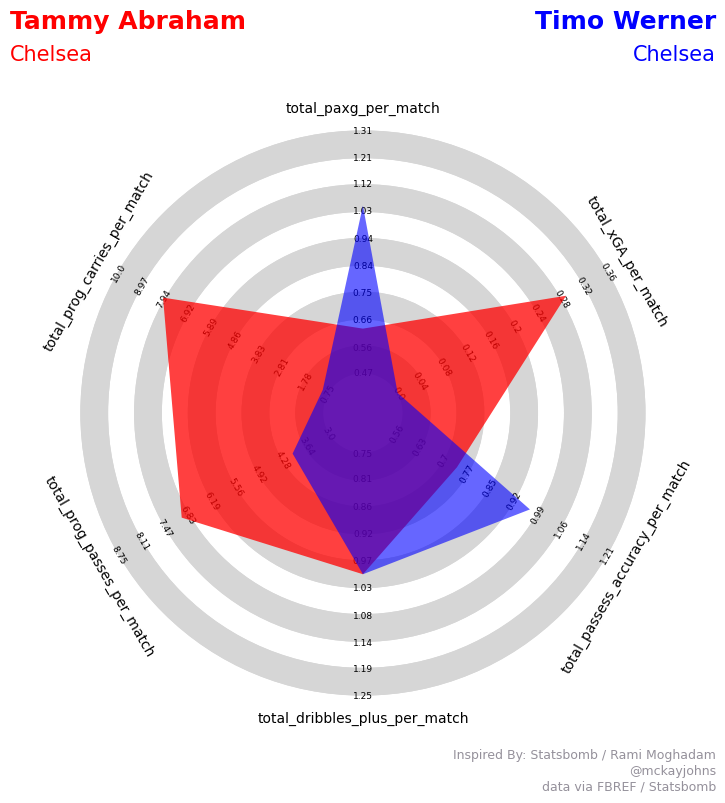

In [ ]:
radar = Radar()

fig,ax = radar.plot_radar(ranges=ranges,params=params,values=values,
                         radar_color=['red','blue'],
                         alphas=[.75,.6],title=title,endnote=endnote,
                         compare=True)

Porównanie modelu z sofą na podstawie meczów z wc22
Wykresy, statystyki, analizy tego porównania

Analiza zawodników z najlepszymi ocenami na turnieju - wykresy itp

Analiza stylu gry drużyny - jakie drużyny wygrywały - czy te grające do przodu? strzelające dużo bramek? mające duże xG? najwięcej progresywnych podań? skuteczność podań? A może nie zawsze wygrywały drużyny które miały większą średnią ocen graczy?



Podział na zawodników

Sprawdzamy co ma wpływ na wynik meczu i w jakim stopniu w zależnosći od pozycji zawodnika

In [ ]:
matches_df = pd.concat(free_man_comps_sample_list, ignore_index=True)

#matches_df = matches_df[['match_id', 'match_date', 'competition', 'season', 'home_team', 'away_team', 'home_score', 'away_score']]
matches_df

,match_id,match_date,kick_off,competition,season,home_team,away_team,home_score,away_score,match_status,...,last_updated_360,match_week,competition_stage,stadium,referee,home_managers,away_managers,data_version,shot_fidelity_version,xy_fidelity_version
0,3943077,2024-07-15,04:15:00.000,South America - Copa America,2024,Argentina,Colombia,1,0,available,...,None,6,Final,Hard Rock Stadium,Raphael Claus,Lionel Sebastián Scaloni,Néstor Gabriel Lorenzo,1.1.0,2,2
1,3943076,2024-07-14,03:00:00.000,South America - Copa America,2024,Canada,Uruguay,2,2,available,...,None,6,3rd Place Final,Bank of America Stadium,Alexis Herrera,Jesse Marsch,Marcelo Alberto Bielsa Caldera,1.1.0,2,2
2,3942852,2024-07-11,03:00:00.000,South America - Copa America,2024,Uruguay,Colombia,0,1,available,...,None,5,Semi-finals,Bank of America Stadium,César Arturo Ramos Palazuelos,Marcelo Alberto Bielsa Caldera,Néstor Gabriel Lorenzo,1.1.0,2,2
3,3942785,2024-07-10,03:00:00.000,South America - Copa America,2024,Argentina,Canada,2,0,available,...,None,5,Semi-finals,MetLife Stadium,Piero Maza Gomez,Lionel Sebastián Scaloni,Jesse Marsch,1.1.0,2,2
4,3942416,2024-07-07,01:00:00.000,South America - Copa America,2024,Colombia,Panama,5,0,available,...,None,4,Quarter-finals,State Farm Stadium,Maurizio Mariani,Néstor Gabriel Lorenzo,Thomas Christiansen Tarín,1.1.0,2,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2919,3888700,1970-06-07,21:00:00.000,International - FIFA World Cup,1970,Brazil,England,1,0,available,...,None,2,Group Stage,Estadio Jalisco,Abraham Klein,Mário Jorge Lobo Zagallo,Alfred Ernest Ramsey,1.1.0,2,2
2920,3888699,1970-06-04,01:00:00.000,International - FIFA World Cup,1970,Brazil,Czechoslovakia,4,1,available,...,None,1,Group Stage,Estadio Jalisco,Ramón Ivanoes Barreto Ruiz,Mário Jorge Lobo Zagallo,Jozef Marko,1.1.0,2,2
2921,3888854,1962-05-30,21:00:00.000,International - FIFA World Cup,1962,Brazil,Mexico,2,0,available,...,None,1,Group Stage,Estadio Sausalito,NaN,Aymoré Moreira,Ignacio Trelles,1.1.0,2,2
2922,3888705,1958-06-29,17:00:00.000,International - FIFA World Cup,1958,Brazil,Sweden,5,2,available,...,None,7,Final,Friends Arena,Maurice Guigue,Vicente Ítalo Feola,George Raynor,1.1.0,2,2


Teraz weźmy tylko te mecze, które zakończyły się po 90min.

In [ ]:
matches[0]['match_id'].iloc[0]

3943077

In [ ]:
matches_90 = []

for match in matches:
    if len(match['period'].unique())  == 2:
        matches_90.append(match['match_id'].iloc[0])
matches_90_df = pd.DataFrame({'match_id':matches_90})
matches_90_df

,match_id
0,3942852
1,3942785
2,3942416
3,3939986
4,3939973
...,...
2879,3888700
2880,3888699
2881,3888854
2882,3888705


In [ ]:
matches_df2 = matches_df.merge(matches_90_df, on='match_id')
matches_df2

,match_id,match_date,kick_off,competition,season,home_team,away_team,home_score,away_score,match_status,...,last_updated_360,match_week,competition_stage,stadium,referee,home_managers,away_managers,data_version,shot_fidelity_version,xy_fidelity_version
0,3942852,2024-07-11,03:00:00.000,South America - Copa America,2024,Uruguay,Colombia,0,1,available,...,None,5,Semi-finals,Bank of America Stadium,César Arturo Ramos Palazuelos,Marcelo Alberto Bielsa Caldera,Néstor Gabriel Lorenzo,1.1.0,2,2
1,3942785,2024-07-10,03:00:00.000,South America - Copa America,2024,Argentina,Canada,2,0,available,...,None,5,Semi-finals,MetLife Stadium,Piero Maza Gomez,Lionel Sebastián Scaloni,Jesse Marsch,1.1.0,2,2
2,3942416,2024-07-07,01:00:00.000,South America - Copa America,2024,Colombia,Panama,5,0,available,...,None,4,Quarter-finals,State Farm Stadium,Maurizio Mariani,Néstor Gabriel Lorenzo,Thomas Christiansen Tarín,1.1.0,2,2
3,3939986,2024-06-30,03:00:00.000,South America - Copa America,2024,Argentina,Peru,2,0,available,...,None,3,Group Stage,Hard Rock Stadium,César Arturo Ramos Palazuelos,Lionel Sebastián Scaloni,Jorge Daniel Fossati Lurachi,1.1.0,2,2
4,3939973,2024-06-24,04:00:00.000,South America - Copa America,2024,Uruguay,Panama,3,1,available,...,None,1,Group Stage,Hard Rock Stadium,Piero Maza Gomez,Marcelo Alberto Bielsa Caldera,Thomas Christiansen Tarín,1.1.0,2,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2879,3888700,1970-06-07,21:00:00.000,International - FIFA World Cup,1970,Brazil,England,1,0,available,...,None,2,Group Stage,Estadio Jalisco,Abraham Klein,Mário Jorge Lobo Zagallo,Alfred Ernest Ramsey,1.1.0,2,2
2880,3888699,1970-06-04,01:00:00.000,International - FIFA World Cup,1970,Brazil,Czechoslovakia,4,1,available,...,None,1,Group Stage,Estadio Jalisco,Ramón Ivanoes Barreto Ruiz,Mário Jorge Lobo Zagallo,Jozef Marko,1.1.0,2,2
2881,3888854,1962-05-30,21:00:00.000,International - FIFA World Cup,1962,Brazil,Mexico,2,0,available,...,None,1,Group Stage,Estadio Sausalito,NaN,Aymoré Moreira,Ignacio Trelles,1.1.0,2,2
2882,3888705,1958-06-29,17:00:00.000,International - FIFA World Cup,1958,Brazil,Sweden,5,2,available,...,None,7,Final,Friends Arena,Maurice Guigue,Vicente Ítalo Feola,George Raynor,1.1.0,2,2


In [ ]:
matches_df = matches_df[['match_id', 'match_date', 'competition', 'season', 'home_team', 'away_team', 'home_score', 'away_score']]

In [ ]:
matches_df

,match_id,match_date,competition,season,home_team,away_team,home_score,away_score
0,3943077,2024-07-15,South America - Copa America,2024,Argentina,Colombia,1,0
1,3943076,2024-07-14,South America - Copa America,2024,Canada,Uruguay,2,2
2,3942852,2024-07-11,South America - Copa America,2024,Uruguay,Colombia,0,1
3,3942785,2024-07-10,South America - Copa America,2024,Argentina,Canada,2,0
4,3942416,2024-07-07,South America - Copa America,2024,Colombia,Panama,5,0
...,...,...,...,...,...,...,...,...
2919,3888700,1970-06-07,International - FIFA World Cup,1970,Brazil,England,1,0
2920,3888699,1970-06-04,International - FIFA World Cup,1970,Brazil,Czechoslovakia,4,1
2921,3888854,1962-05-30,International - FIFA World Cup,1962,Brazil,Mexico,2,0
2922,3888705,1958-06-29,International - FIFA World Cup,1958,Brazil,Sweden,5,2


In [ ]:
df = matches_df

# Funkcja do określenia wyniku zespołu
def determine_result(home_score, away_score, is_home):
    if home_score > away_score:
        return "Win" if is_home else "Lose"
    elif home_score < away_score:
        return "Lose" if is_home else "Win"
    else:
        return "Draw"

# Przekształcanie DataFrame z dodatkowymi kolumnami
rows = []
for _, row in df.iterrows():
    rows.append(
        {
            "match_id": row["match_id"],
            "match_date": row["match_date"],
            "team": row["home_team"],
            "team_result": determine_result(row["home_score"], row["away_score"], True),
            "goals_scored": row["home_score"],
            "goals_conceded": row["away_score"],
        }
    )
    rows.append(
        {
            "match_id": row["match_id"],
            "match_date": row["match_date"],
            "team": row["away_team"],
            "team_result": determine_result(row["home_score"], row["away_score"], False),
            "goals_scored": row["away_score"],
            "goals_conceded": row["home_score"],
        }
    )

# Tworzenie finalnego DataFrame
final_df = pd.DataFrame(rows)

final_df

,match_id,match_date,team,team_result,goals_scored,goals_conceded
0,3943077,2024-07-15,Argentina,Win,1,0
1,3943077,2024-07-15,Colombia,Lose,0,1
2,3943076,2024-07-14,Canada,Draw,2,2
3,3943076,2024-07-14,Uruguay,Draw,2,2
4,3942852,2024-07-11,Uruguay,Lose,0,1
...,...,...,...,...,...,...
5843,3888854,1962-05-30,Mexico,Lose,0,2
5844,3888705,1958-06-29,Brazil,Win,5,2
5845,3888705,1958-06-29,Sweden,Lose,2,5
5846,3888704,1958-06-24,Brazil,Win,5,2


In [ ]:
result_mapping = {"Win": 1, "Draw": 0, "Lose": -1}
final_df["result_numeric"] = final_df["team_result"].map(result_mapping)

In [ ]:
final_df

,match_id,match_date,team,team_result,goals_scored,goals_conceded,result_numeric
0,3943077,2024-07-15,Argentina,Win,1,0,1
1,3943077,2024-07-15,Colombia,Lose,0,1,-1
2,3943076,2024-07-14,Canada,Draw,2,2,0
3,3943076,2024-07-14,Uruguay,Draw,2,2,0
4,3942852,2024-07-11,Uruguay,Lose,0,1,-1
...,...,...,...,...,...,...,...
5843,3888854,1962-05-30,Mexico,Lose,0,2,-1
5844,3888705,1958-06-29,Brazil,Win,5,2,1
5845,3888705,1958-06-29,Sweden,Lose,2,5,-1
5846,3888704,1958-06-24,Brazil,Win,5,2,1


Zbadajmy wpływ passes_accuracy na te dane (obecnie bez JPN League)

In [ ]:
gp_list = []

for match in matches:
    g_p = (
    match[(match['type'] == 'Pass') & (match['pass_outcome'].isna()) & (match['period'] < 3)]
    .groupby(['match_id', 'team', 'position'])
    .size()
    .reset_index(name='goodq_passes')
)
    gp_list.append(g_p)
gp_df = pd.concat(gp_list, ignore_index=True)
gp_df

,match_id,team,position,good_passes
0,3943077,Argentina,Center Defensive Midfield,10
1,3943077,Argentina,Center Forward,2
2,3943077,Argentina,Goalkeeper,29
3,3943077,Argentina,Left Back,39
4,3943077,Argentina,Left Center Back,23
...,...,...,...,...
72489,3888704,France,Right Back,25
72490,3888704,France,Right Center Back,23
72491,3888704,France,Right Center Forward,25
72492,3888704,France,Right Defensive Midfield,36


In [ ]:
metric= 'bad_passes'

metric_list = []

for match in matches:
    metric_df = (
    match[(match['type'] == 'Pass') & (match["pass_outcome"].isin(["Incomplete", "Out"])) & (match['period'] < 3)]
    .groupby(['match_id', 'team', 'position'])
    .size()
    .reset_index(name=metric)
)
    metric_list.append(metric_df)
bp_df = pd.concat(metric_list, ignore_index=True)
bp_df

,match_id,team,position,bad_passes
0,3943077,Argentina,Center Defensive Midfield,1
1,3943077,Argentina,Center Forward,1
2,3943077,Argentina,Goalkeeper,9
3,3943077,Argentina,Left Back,7
4,3943077,Argentina,Left Center Back,4
...,...,...,...,...
70806,3888704,France,Right Back,16
70807,3888704,France,Right Center Back,13
70808,3888704,France,Right Center Forward,13
70809,3888704,France,Right Defensive Midfield,11


In [ ]:
passes = gp_df.merge(bp_df, on=['match_id', 'team', 'position'], how='outer').fillna(0)

In [ ]:
# Definicja grup pozycji
goalkeeper = ['Goalkeeper']
midfield = [
    'Center Attacking Midfield', 'Left Attacking Midfield', 'Right Attacking Midfield',
    'Left Center Midfield', 'Right Center Midfield', 'Center Midfield', 'Right Defensive Midfield',
    'Center Defensive Midfield', 'Left Defensive Midfield', 'Right Wing', 'Left Wing', 'Right Midfield', 'Left Midfield'
]
strikers = ['Secondary Striker', 'Center Forward', 'Right Center Forward', 'Left Center Forward']
stoper = ['Center Back', 'Right Center Back', 'Left Center Back', 'Right Wing Back', 'Left Wing Back', 'Left Back', 'Right Back']

# Funkcja do przypisania grupy na podstawie pozycji
def assign_group(position):
    if position in goalkeeper:
        return 'Goalkeeper'
    elif position in midfield:
        return 'Midfield'
    elif position in strikers:
        return 'Strikers'
    elif position in stoper:
        return 'Stopper'
    else:
        return 'Other'

# Tworzenie nowej kolumny
passes['grouped_position'] = passes['position'].apply(assign_group)

# Wyświetlanie przykładowego wyniku
passes

,match_id,team,position,good_passes,bad_passes,grouped_position
0,3943077,Argentina,Center Defensive Midfield,10.0,1.0,Midfield
1,3943077,Argentina,Center Forward,2.0,1.0,Strikers
2,3943077,Argentina,Goalkeeper,29.0,9.0,Goalkeeper
3,3943077,Argentina,Left Back,39.0,7.0,Stopper
4,3943077,Argentina,Left Center Back,23.0,4.0,Stopper
...,...,...,...,...,...,...
72746,70306,Espanyol,Right Center Midfield,0.0,1.0,Midfield
72747,266256,Barcelona,Right Center Forward,0.0,1.0,Strikers
72748,69337,Atlético Madrid,Center Defensive Midfield,0.0,2.0,Midfield
72749,69337,Barcelona,Left Center Forward,0.0,1.0,Strikers


In [ ]:
#passes['passes%'] = passes['good_passes'] / (passes['good_passes'] + passes['bad_passes'])
passes2 = passes.groupby(['match_id', 'team' ,'grouped_position']).sum(['good_passes', 'bad_passes']).reset_index()
passes2['passes%'] = passes2['good_passes'] / (passes2['good_passes'] + passes2['bad_passes'])
passes2.head(8)

,match_id,team,grouped_position,good_passes,bad_passes,passes%
0,7525,Russia,Goalkeeper,12.0,9.0,0.571429
1,7525,Russia,Midfield,119.0,46.0,0.721212
2,7525,Russia,Stopper,121.0,49.0,0.711765
3,7525,Russia,Strikers,20.0,7.0,0.740741
4,7525,Saudi Arabia,Goalkeeper,15.0,19.0,0.441176
5,7525,Saudi Arabia,Midfield,226.0,29.0,0.886275
6,7525,Saudi Arabia,Stopper,207.0,59.0,0.778195
7,7525,Saudi Arabia,Strikers,10.0,3.0,0.769231


In [ ]:
# Tworzenie pivot table, aby przekształcić grouped_position na kolumny
result_df = passes2.pivot_table(
    index=['match_id', 'team'],
    columns='grouped_position',
    values='passes%',
    aggfunc='mean'
).reset_index()

result_df = result_df[['match_id', 'team', 'Goalkeeper', 'Stopper','Midfield', 'Strikers']]
result_df.columns.name = None
result_df

,match_id,team,Goalkeeper,Stopper,Midfield,Strikers
0,7525,Russia,0.571429,0.711765,0.721212,0.740741
1,7525,Saudi Arabia,0.441176,0.778195,0.886275,0.769231
2,7529,Croatia,0.818182,0.812834,0.788235,0.620690
3,7529,Nigeria,0.518519,0.793939,0.760181,0.750000
4,7530,Australia,0.844444,0.780172,0.751592,0.625000
...,...,...,...,...,...,...
5843,3943043,Spain,0.871795,0.937063,0.821577,0.720000
5844,3943076,Canada,0.640000,0.776923,0.706522,0.735294
5845,3943076,Uruguay,0.700000,0.795580,0.719424,0.642857
5846,3943077,Argentina,0.763158,0.812081,0.868293,0.714286


In [ ]:
cols = list(result_df.columns[2:6])
cols

['Goalkeeper', 'Stopper', 'Midfield', 'Strikers']

In [ ]:
for col in cols:
    result_df[f"{col}%_diff"] = result_df.groupby('match_id')[col].transform(lambda x: x.diff().fillna(-x.diff().iloc[-1]))
result_df

,match_id,team,Goalkeeper,Stopper,Midfield,Strikers,Goalkeeper%_diff,Stopper%_diff,Midfield%_diff,Strikers%_diff
0,7525,Russia,0.571429,0.711765,0.721212,0.740741,0.130252,-0.066431,-0.165062,-0.028490
1,7525,Saudi Arabia,0.441176,0.778195,0.886275,0.769231,-0.130252,0.066431,0.165062,0.028490
2,7529,Croatia,0.818182,0.812834,0.788235,0.620690,0.299663,0.018895,0.028054,-0.129310
3,7529,Nigeria,0.518519,0.793939,0.760181,0.750000,-0.299663,-0.018895,-0.028054,0.129310
4,7530,Australia,0.844444,0.780172,0.751592,0.625000,0.054971,-0.053161,-0.079733,0.059783
...,...,...,...,...,...,...,...,...,...,...
5843,3943043,Spain,0.871795,0.937063,0.821577,0.720000,0.252747,0.059014,0.040755,0.220000
5844,3943076,Canada,0.640000,0.776923,0.706522,0.735294,-0.060000,-0.018657,-0.012903,0.092437
5845,3943076,Uruguay,0.700000,0.795580,0.719424,0.642857,0.060000,0.018657,0.012903,-0.092437
5846,3943077,Argentina,0.763158,0.812081,0.868293,0.714286,-0.085327,-0.038666,-0.004349,-0.194805


In [ ]:
df = final_df.merge(result_df, on=['match_id', 'team'])

In [ ]:
df

,match_id,match_date,team,team_result,goals_scored,goals_conceded,result_numeric,Goalkeeper,Stopper,Midfield,Strikers,Goalkeeper%_diff,Stopper%_diff,Midfield%_diff,Strikers%_diff
0,3943077,2024-07-15,Argentina,Win,1,0,1,0.763158,0.812081,0.868293,0.714286,-0.085327,-0.038666,-0.004349,-0.194805
1,3943077,2024-07-15,Colombia,Lose,0,1,-1,0.848485,0.850746,0.872642,0.909091,0.085327,0.038666,0.004349,0.194805
2,3943076,2024-07-14,Canada,Draw,2,2,0,0.640000,0.776923,0.706522,0.735294,-0.060000,-0.018657,-0.012903,0.092437
3,3943076,2024-07-14,Uruguay,Draw,2,2,0,0.700000,0.795580,0.719424,0.642857,0.060000,0.018657,0.012903,-0.092437
4,3942852,2024-07-11,Uruguay,Lose,0,1,-1,0.800000,0.868778,0.795580,0.814815,0.216667,0.100183,0.039278,0.075684
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5843,3888854,1962-05-30,Mexico,Lose,0,2,-1,0.750000,0.735849,0.763566,0.769231,-0.250000,-0.055360,-0.044845,-0.009839
5844,3888705,1958-06-29,Brazil,Win,5,2,1,0.640000,0.779141,0.723301,0.770642,-0.002857,0.082367,0.042450,0.157739
5845,3888705,1958-06-29,Sweden,Lose,2,5,-1,0.642857,0.696774,0.680851,0.612903,0.002857,-0.082367,-0.042450,-0.157739
5846,3888704,1958-06-24,Brazil,Win,5,2,1,0.555556,0.733333,0.850267,0.725000,-0.020202,0.112366,0.101968,0.050301


Sprawdźmy wpływ skuteczności podań na wynik

In [ ]:
df.groupby('team_result')['Goalkeeper%_diff'].mean()

team_result
Draw    0.000000
Lose   -0.015306
Win     0.015306
Name: Goalkeeper%_diff, dtype: float64

In [ ]:
df.groupby('team_result')['Stopper%_diff'].mean()

team_result
Draw    0.000000
Lose   -0.032389
Win     0.032389
Name: Stopper%_diff, dtype: float64

In [ ]:
df.groupby('team_result')['Midfield%_diff'].mean()

team_result
Draw    0.000000
Lose   -0.034353
Win     0.034353
Name: Midfield%_diff, dtype: float64

In [ ]:
df.groupby('team_result')['Strikers%_diff'].mean()

team_result
Draw    0.000
Lose   -0.016
Win     0.016
Name: Strikers%_diff, dtype: float64

In [ ]:
df["Goalkeeper%_diff"].corr(df["result_numeric"])

0.04802103758165606

In [ ]:
df["Stopper%_diff"].corr(df["result_numeric"])

0.23927815305823466

In [ ]:
df["Midfield%_diff"].corr(df["result_numeric"])

0.3009946848435613

In [ ]:
df["Strikers%_diff"].corr(df["result_numeric"])

0.09544577655455345

Jest pozytywna korelacja

Przejdźmy teraz do npxG

In [ ]:
metric= 'npxg'

metric_list = []

for match in matches:
    metric_df = (
    match[(match['type'] == 'Shot') & (match['shot_type'] != 'Penalty') & (match['period'] < 3)]
    .groupby(['match_id', 'team', 'position'])['shot_statsbomb_xg']
    .sum()
    .reset_index(name=metric)
)
    metric_list.append(metric_df)
npxg_df = pd.concat(metric_list, ignore_index=True)
npxg_df

,match_id,team,position,npxg
0,3943077,Argentina,Left Back,0.047532
1,3943077,Argentina,Left Center Forward,0.072140
2,3943077,Argentina,Left Defensive Midfield,0.040733
3,3943077,Argentina,Left Midfield,0.357203
4,3943077,Argentina,Right Center Forward,0.151331
...,...,...,...,...
36225,3888704,France,Left Center Forward,0.051519
36226,3888704,France,Left Defensive Midfield,0.281949
36227,3888704,France,Right Center Forward,1.053373
36228,3888704,France,Right Defensive Midfield,0.041887


In [ ]:
npxg_df['grouped_position'] = npxg_df['position'].apply(assign_group)

In [ ]:
npxg_df.head(9)

,match_id,team,position,npxg,grouped_position
0,3943077,Argentina,Left Back,0.047532,Stopper
1,3943077,Argentina,Left Center Forward,0.072140,Strikers
2,3943077,Argentina,Left Defensive Midfield,0.040733,Midfield
3,3943077,Argentina,Left Midfield,0.357203,Midfield
4,3943077,Argentina,Right Center Forward,0.151331,Strikers
5,3943077,Colombia,Center Attacking Midfield,0.039566,Midfield
6,3943077,Colombia,Center Defensive Midfield,0.034742,Midfield
7,3943077,Colombia,Left Center Back,0.213260,Stopper
8,3943077,Colombia,Left Center Forward,0.029771,Strikers


In [ ]:
npxg_df_2 = npxg_df.pivot_table(
    index=['match_id', 'team'],
    columns='grouped_position',
    values='npxg',
    aggfunc='mean'
).reset_index()

npxg_df_2 = npxg_df_2[['match_id', 'team', 'Goalkeeper', 'Stopper','Midfield', 'Strikers']]
npxg_df_2.columns.name = None
npxg_df_2

,match_id,team,Goalkeeper,Stopper,Midfield,Strikers
0,7525,Russia,NaN,0.025649,0.240863,0.292499
1,7525,Saudi Arabia,NaN,0.108596,0.042292,0.055628
2,7529,Croatia,NaN,0.045163,0.098160,0.428001
3,7529,Nigeria,NaN,0.112390,0.096357,0.360861
4,7530,Australia,NaN,0.028268,0.139994,NaN
...,...,...,...,...,...,...
5841,3943043,Spain,NaN,0.107699,0.227131,0.667791
5842,3943076,Canada,NaN,0.074992,0.499317,0.532100
5843,3943076,Uruguay,NaN,0.135221,0.089429,0.888268
5844,3943077,Argentina,NaN,0.047532,0.198968,0.111735


In [ ]:
npxg_df_2

,match_id,team,Goalkeeper,Stopper,Midfield,Strikers
0,7525,Russia,NaN,0.025649,0.240863,0.292499
1,7525,Saudi Arabia,NaN,0.108596,0.042292,0.055628
2,7529,Croatia,NaN,0.045163,0.098160,0.428001
3,7529,Nigeria,NaN,0.112390,0.096357,0.360861
4,7530,Australia,NaN,0.028268,0.139994,NaN
...,...,...,...,...,...,...
5841,3943043,Spain,NaN,0.107699,0.227131,0.667791
5842,3943076,Canada,NaN,0.074992,0.499317,0.532100
5843,3943076,Uruguay,NaN,0.135221,0.089429,0.888268
5844,3943077,Argentina,NaN,0.047532,0.198968,0.111735


In [ ]:
npxg_df_2 = npxg_df_2.fillna(0)

In [ ]:
for col in cols:
    npxg_df_2[f"{col}_npxg_diff"] = npxg_df_2.groupby('match_id')[col].transform(lambda x: x.diff().fillna(-x.diff().iloc[-1]))
npxg_df_2

,match_id,team,Goalkeeper,Stopper,Midfield,Strikers,Goalkeeper_npxg_diff,Stopper_npxg_diff,Midfield_npxg_diff,Strikers_npxg_diff
0,7525,Russia,0.0,0.025649,0.240863,0.292499,-0.0,-0.082947,0.198572,0.236872
1,7525,Saudi Arabia,0.0,0.108596,0.042292,0.055628,0.0,0.082947,-0.198572,-0.236872
2,7529,Croatia,0.0,0.045163,0.098160,0.428001,-0.0,-0.067227,0.001803,0.067140
3,7529,Nigeria,0.0,0.112390,0.096357,0.360861,0.0,0.067227,-0.001803,-0.067140
4,7530,Australia,0.0,0.028268,0.139994,0.000000,-0.0,-0.022973,0.116136,-0.552759
...,...,...,...,...,...,...,...,...,...,...
5841,3943043,Spain,0.0,0.107699,0.227131,0.667791,0.0,-0.009455,0.065084,0.544710
5842,3943076,Canada,0.0,0.074992,0.499317,0.532100,-0.0,-0.060229,0.409887,-0.356168
5843,3943076,Uruguay,0.0,0.135221,0.089429,0.888268,0.0,0.060229,-0.409887,0.356168
5844,3943077,Argentina,0.0,0.047532,0.198968,0.111735,-0.0,-0.078124,0.169287,-0.008432


Sprawdzamy korelacje

In [ ]:
df2 = final_df.merge(npxg_df_2, on=['match_id', 'team'])

In [ ]:
df2

,match_id,match_date,team,team_result,goals_scored,goals_conceded,result_numeric,Goalkeeper,Stopper,Midfield,Strikers,Goalkeeper_npxg_diff,Stopper_npxg_diff,Midfield_npxg_diff,Strikers_npxg_diff
0,3943077,2024-07-15,Argentina,Win,1,0,1,0.0,0.047532,0.198968,0.111735,-0.0,-0.078124,0.169287,-0.008432
1,3943077,2024-07-15,Colombia,Lose,0,1,-1,0.0,0.125655,0.029681,0.120167,0.0,0.078124,-0.169287,0.008432
2,3943076,2024-07-14,Canada,Draw,2,2,0,0.0,0.074992,0.499317,0.532100,-0.0,-0.060229,0.409887,-0.356168
3,3943076,2024-07-14,Uruguay,Draw,2,2,0,0.0,0.135221,0.089429,0.888268,0.0,0.060229,-0.409887,0.356168
4,3942852,2024-07-11,Uruguay,Lose,0,1,-1,0.0,0.083229,0.029281,0.223158,0.0,0.050076,-0.135745,0.074508
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5841,3888854,1962-05-30,Mexico,Lose,0,2,-1,0.0,0.000000,0.089650,0.536919,0.0,-0.080111,-0.089457,-0.244706
5842,3888705,1958-06-29,Brazil,Win,5,2,1,0.0,0.000000,0.173683,1.410105,-0.0,-0.000000,0.041312,0.890555
5843,3888705,1958-06-29,Sweden,Lose,2,5,-1,0.0,0.000000,0.132370,0.519550,0.0,0.000000,-0.041312,-0.890555
5844,3888704,1958-06-24,Brazil,Win,5,2,1,0.0,0.000000,0.378391,1.650881,-0.0,-0.000000,0.256274,1.098435


In [ ]:
print(f"---{metric}--- [mean win]\n")
for col in cols:
    print(f"{col}:")
    print(df2.groupby('team_result')[f'{col}_npxg_diff'].mean().reset_index().iloc[2,1])

---npxg--- [mean win]

Goalkeeper:
-0.0003477977494356659
Stopper:
0.03345762852144846
Midfield:
0.10129324062279946
Strikers:
0.25044700899109856


In [ ]:
print(f"---{metric}--- [mean win]\n")
for col in cols:
    print(f"{col}:")
    print(df2[f"{col}_npxg_diff"].corr(df2["result_numeric"]))

---npxg--- [mean win]

Goalkeeper:
-0.04880232998561602
Stopper:
0.20002213560848417
Midfield:
0.45434839816093087
Strikers:
0.4297314574784821


In [ ]:
df2["Strikers_npxg_diff"].corr(df2["result_numeric"])

0.4297314574784821

Sprawdźmy paxg

In [ ]:
metric= 'paxg'

metric_list = []

for match in matches:
    metric_df = (
    match[(match['type'] == "Shot") & (match['period'] < 3)]
    .assign(
            goal=lambda df: (df['shot_outcome'] == 'Goal').astype(int),  # 1 dla "Goal", inaczej 0
            PAxG_component=lambda df: (df['goal'] - df['shot_statsbomb_xg']) * (1 - df['shot_statsbomb_xg']),  # Obliczanie PAxG_component,
            shots_on_target = lambda df: (df['shot_outcome'].isin(['Saved', 'Saved To Post', 'Goal'])).astype(int)
            
        )
    .groupby(['match_id', 'team', 'position'])
    .agg(
            shots=('shot_statsbomb_xg', 'size'),
            PAxg=('PAxG_component', 'sum'),
            shots_on_target=('shots_on_target', 'sum')
        )
    .reset_index()
)
    metric_df['PAxG'] = metric_df['PAxg'] + np.log(1 + metric_df['shots_on_target']) # można zamienić na strzały celne zamiast wszystkich
    paxg = metric_df[['match_id', 'team', 'PAxg']]
    metric_list.append(metric_df)
paxg_df = pd.concat(metric_list, ignore_index=True)
paxg_df = paxg_df[['match_id', 'team', 'position', 'PAxG']]
paxg_df

,match_id,team,position,PAxG
0,3943077,Argentina,Left Back,-0.045272
1,3943077,Argentina,Left Center Forward,-0.066935
2,3943077,Argentina,Left Defensive Midfield,-0.039073
3,3943077,Argentina,Left Midfield,0.815665
4,3943077,Argentina,Right Center Forward,-0.128430
...,...,...,...,...
36344,3888704,France,Left Center Forward,-0.048865
36345,3888704,France,Left Defensive Midfield,1.789013
36346,3888704,France,Right Center Forward,1.377605
36347,3888704,France,Right Defensive Midfield,0.653015


In [ ]:
paxg_df['grouped_position'] = paxg_df['position'].apply(assign_group)

In [ ]:
paxg_df= paxg_df.pivot_table(
    index=['match_id', 'team'],
    columns='grouped_position',
    values='PAxG',
    aggfunc='mean'
).reset_index()

paxg_df = paxg_df[['match_id', 'team', 'Goalkeeper', 'Stopper','Midfield', 'Strikers']]
paxg_df.columns.name = None
paxg_df

,match_id,team,Goalkeeper,Stopper,Midfield,Strikers
0,7525,Russia,NaN,-0.024991,1.457395,1.193705
1,7525,Saudi Arabia,NaN,-0.099003,-0.041077,-0.052533
2,7529,Croatia,NaN,-0.042009,0.270132,-0.312208
3,7529,Nigeria,NaN,0.593388,-0.090311,0.379941
4,7530,Australia,NaN,-0.027207,0.651494,NaN
...,...,...,...,...,...,...
5841,3943043,Spain,NaN,-0.096005,0.650286,1.295070
5842,3943076,Canada,NaN,-0.071494,0.941861,0.723866
5843,3943076,Uruguay,NaN,-0.122591,0.495500,1.313939
5844,3943077,Argentina,NaN,-0.045272,0.388296,-0.097683


In [ ]:
paxg_df = paxg_df.fillna(0)

In [ ]:
paxg_df

,match_id,team,Goalkeeper,Stopper,Midfield,Strikers
0,7525,Russia,0.0,-0.024991,1.457395,1.193705
1,7525,Saudi Arabia,0.0,-0.099003,-0.041077,-0.052533
2,7529,Croatia,0.0,-0.042009,0.270132,-0.312208
3,7529,Nigeria,0.0,0.593388,-0.090311,0.379941
4,7530,Australia,0.0,-0.027207,0.651494,0.000000
...,...,...,...,...,...,...
5841,3943043,Spain,0.0,-0.096005,0.650286,1.295070
5842,3943076,Canada,0.0,-0.071494,0.941861,0.723866
5843,3943076,Uruguay,0.0,-0.122591,0.495500,1.313939
5844,3943077,Argentina,0.0,-0.045272,0.388296,-0.097683


In [ ]:
for col in cols:
    paxg_df[f"{col}_paxg_diff"] = paxg_df.groupby('match_id')[col].transform(lambda x: x.diff().fillna(-x.diff().iloc[-1]))
paxg_df

,match_id,team,Goalkeeper,Stopper,Midfield,Strikers,Goalkeeper_paxg_diff,Stopper_paxg_diff,Midfield_paxg_diff,Strikers_paxg_diff
0,7525,Russia,0.0,-0.024991,1.457395,1.193705,-0.0,0.074011,1.498472,1.246238
1,7525,Saudi Arabia,0.0,-0.099003,-0.041077,-0.052533,0.0,-0.074011,-1.498472,-1.246238
2,7529,Croatia,0.0,-0.042009,0.270132,-0.312208,-0.0,-0.635397,0.360443,-0.692149
3,7529,Nigeria,0.0,0.593388,-0.090311,0.379941,0.0,0.635397,-0.360443,0.692149
4,7530,Australia,0.0,-0.027207,0.651494,0.000000,-0.0,0.021438,0.212325,-0.723461
...,...,...,...,...,...,...,...,...,...,...
5841,3943043,Spain,0.0,-0.096005,0.650286,1.295070,0.0,0.007424,-0.123534,1.410230
5842,3943076,Canada,0.0,-0.071494,0.941861,0.723866,-0.0,0.051098,0.446361,-0.590073
5843,3943076,Uruguay,0.0,-0.122591,0.495500,1.313939,0.0,-0.051098,-0.446361,0.590073
5844,3943077,Argentina,0.0,-0.045272,0.388296,-0.097683,-0.0,-0.166782,0.070648,-0.332262


In [ ]:
df3 = final_df.merge(paxg_df, on=['match_id', 'team'])

In [ ]:
print(f"---{metric}--- [mean win]\n")
for col in cols:
    print(f"{col}:")
    print(df3.groupby('team_result')[f'{col}_paxg_diff'].mean().reset_index().iloc[2,1])

---paxg--- [mean win]

Goalkeeper:
0.00030407496572050746
Stopper:
0.13931099381508932
Midfield:
0.32747262603532157
Strikers:
0.5990393260017635


,match_id,match_date,team,team_result,goals_scored,goals_conceded,result_numeric,Goalkeeper,Stopper,Midfield,Strikers,Goalkeeper_paxg_diff,Stopper_paxg_diff,Midfield_paxg_diff,Strikers_paxg_diff
0,3943077,2024-07-15,Argentina,Win,1,0,1,0.0,-0.045272,0.388296,-0.097683,-0.0,-0.166782,0.070648,-0.332262
1,3943077,2024-07-15,Colombia,Lose,0,1,-1,0.0,0.121510,0.317648,0.234579,0.0,0.166782,-0.070648,0.332262
2,3943076,2024-07-14,Canada,Draw,2,2,0,0.0,-0.071494,0.941861,0.723866,-0.0,0.051098,0.446361,-0.590073
3,3943076,2024-07-14,Uruguay,Draw,2,2,0,0.0,-0.122591,0.495500,1.313939,0.0,-0.051098,-0.446361,0.590073
4,3942852,2024-07-11,Uruguay,Lose,0,1,-1,0.0,0.153619,0.318156,-0.193935,0.0,0.185672,-0.067657,-0.056340
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5841,3888854,1962-05-30,Mexico,Lose,0,2,-1,0.0,0.000000,0.089974,1.028408,0.0,-0.615524,-0.749685,0.062857
5842,3888705,1958-06-29,Brazil,Win,5,2,1,0.0,0.000000,0.801645,1.719666,-0.0,-0.000000,-0.054664,0.766064
5843,3888705,1958-06-29,Sweden,Lose,2,5,-1,0.0,0.000000,0.856308,0.953602,0.0,0.000000,0.054664,-0.766064
5844,3888704,1958-06-24,Brazil,Win,5,2,1,0.0,0.000000,0.915225,1.727034,-0.0,-0.000000,0.114785,1.062664


Do analizy:
- xg []
- npxg [jest]
- paxg [jest]
- passes% [jest]
- xGA [jest]
- prog_passes [jest]
- prog_carries [jest]
- dribbles 
- shots []
- shots%
- red card
- bycie faulowanym
- duels
- interceptions
- carries into pen [jest]
- touches in box
- recovery
- dispossessed
- miscontrol

xGA

In [ ]:
xga_df = pd.DataFrame()
i = 0
l = len(matches)
for match in matches:
    i+=1
    # Obliczanie xG dla strzałów
    shots = (
        match[(match['type'] == 'Shot') & (match['period'] < 3)]
        .groupby(['player', 'match_id', 'shot_key_pass_id'])
        ['shot_statsbomb_xg'].sum()
        .reset_index(name='xG')
        .rename(columns={'shot_key_pass_id': 'id'})
    )

    # Filtrowanie podań
    passes = (
        match[(match['pass_outcome'].isna())]
        .groupby(['player', 'match_id', 'id', 'team', 'position'])
        .size()
        .reset_index(name='pass_count')
    )

    # Łączenie strzałów z podaniami
    xga = shots.merge(passes, on=['match_id', 'id'], how='left')

    # Grupowanie po zawodniku (asystencie xG)
    xga = (
        xga.groupby(['player_y', 'match_id', 'team', 'position'])['xG']
        .sum()
        .reset_index(name='xGA')
    )

    # Łączenie wyników z xga_df
    xga_df = pd.concat([xga_df, xga], ignore_index=True).fillna(0)
    print(i/l)


0.0003419972640218878
0.0006839945280437756
0.0010259917920656635
0.0013679890560875513
0.001709986320109439
0.002051983584131327
0.0023939808481532147
0.0027359781121751026
0.0030779753761969904
0.003419972640218878
0.003761969904240766
0.004103967168262654
0.004445964432284542
0.0047879616963064295
0.005129958960328317
0.005471956224350205
0.005813953488372093
0.006155950752393981
0.006497948016415869
0.006839945280437756
0.007181942544459644
0.007523939808481532
0.00786593707250342
0.008207934336525308
0.008549931600547196
0.008891928864569083
0.009233926128590971
0.009575923392612859
0.009917920656634747
0.010259917920656635
0.010601915184678522
0.01094391244870041
0.011285909712722298
0.011627906976744186
0.011969904240766074
0.012311901504787962
0.01265389876880985
0.012995896032831737
0.013337893296853625
0.013679890560875513
0.0140218878248974
0.014363885088919288
0.014705882352941176
0.015047879616963064
0.015389876880984952
0.01573187414500684
0.016073871409028728
0.016415868

In [ ]:
len(xga_df['match_id'].unique())

2924

In [ ]:
xga_df2 = xga_df.groupby(['match_id', 'team', 'position']).sum('xGA').reset_index()

In [ ]:
len(xga_df2['match_id'].unique())

2924

In [ ]:
xga_df2

,match_id,team,position,xGA
0,7525,Russia,Center Attacking Midfield,0.406745
1,7525,Russia,Center Forward,0.199331
2,7525,Russia,Left Center Midfield,0.249240
3,7525,Russia,Left Midfield,0.146459
4,7525,Russia,Right Back,0.047830
...,...,...,...,...
30712,3943077,Colombia,Left Back,0.064733
30713,3943077,Colombia,Left Center Forward,0.019571
30714,3943077,Colombia,Right Back,0.075898
30715,3943077,Colombia,Right Center Forward,0.141692


In [ ]:
xga_df2['grouped_position'] = xga_df2['position'].apply(assign_group)

In [ ]:
xga_df2

,match_id,team,position,xGA,grouped_position
0,7525,Russia,Center Attacking Midfield,0.406745,Midfield
1,7525,Russia,Center Forward,0.199331,Strikers
2,7525,Russia,Left Center Midfield,0.249240,Midfield
3,7525,Russia,Left Midfield,0.146459,Midfield
4,7525,Russia,Right Back,0.047830,Stopper
...,...,...,...,...,...
30712,3943077,Colombia,Left Back,0.064733,Stopper
30713,3943077,Colombia,Left Center Forward,0.019571,Strikers
30714,3943077,Colombia,Right Back,0.075898,Stopper
30715,3943077,Colombia,Right Center Forward,0.141692,Strikers


In [ ]:
xga_df2= xga_df2.pivot_table(
    index=['match_id', 'team'],
    columns='grouped_position',
    values='xGA',
    aggfunc='mean'
).reset_index()

xga_df2 = xga_df2[['match_id', 'team', 'Goalkeeper', 'Stopper','Midfield', 'Strikers']]
xga_df2.columns.name = None
xga_df2

,match_id,team,Goalkeeper,Stopper,Midfield,Strikers
0,7525,Russia,NaN,0.047830,0.186867,0.199331
1,7525,Saudi Arabia,NaN,0.025766,0.047400,NaN
2,7529,Croatia,NaN,NaN,0.214043,0.250398
3,7529,Nigeria,NaN,0.131107,0.083772,0.103822
4,7530,Australia,NaN,NaN,0.092223,NaN
...,...,...,...,...,...,...
5830,3943043,Spain,NaN,0.178367,0.271324,NaN
5831,3943076,Canada,NaN,0.048975,0.335935,0.512461
5832,3943076,Uruguay,NaN,0.330684,0.149001,0.099426
5833,3943077,Argentina,NaN,0.121216,0.128878,0.047532


In [ ]:
for col in cols:
    xga_df2[f"{col}_xga_diff"] = xga_df2.groupby('match_id')[col].transform(lambda x: x.diff().fillna(-x.diff().iloc[-1]))
xga_df2

,match_id,team,Goalkeeper,Stopper,Midfield,Strikers,Goalkeeper_xga_diff,Stopper_xga_diff,Midfield_xga_diff,Strikers_xga_diff
0,7525,Russia,NaN,0.047830,0.186867,0.199331,NaN,0.022064,0.139467,NaN
1,7525,Saudi Arabia,NaN,0.025766,0.047400,NaN,NaN,-0.022064,-0.139467,NaN
2,7529,Croatia,NaN,NaN,0.214043,0.250398,NaN,NaN,0.130272,0.146576
3,7529,Nigeria,NaN,0.131107,0.083772,0.103822,NaN,NaN,-0.130272,-0.146576
4,7530,Australia,NaN,NaN,0.092223,NaN,NaN,NaN,-0.090342,NaN
...,...,...,...,...,...,...,...,...,...,...
5830,3943043,Spain,NaN,0.178367,0.271324,NaN,NaN,NaN,0.209064,NaN
5831,3943076,Canada,NaN,0.048975,0.335935,0.512461,NaN,-0.281709,0.186935,0.413035
5832,3943076,Uruguay,NaN,0.330684,0.149001,0.099426,NaN,0.281709,-0.186935,-0.413035
5833,3943077,Argentina,NaN,0.121216,0.128878,0.047532,NaN,0.050901,0.006853,-0.033099


In [ ]:
metric = 'xGA'
df4 = final_df.merge(xga_df2, on=['match_id', 'team'])
df4 = df4.fillna(0)
print(f"---{metric}--- [mean win]\n")
for col in cols:
    print(f"{col}:")
    print(df4.groupby('team_result')[f'{col}_xga_diff'].mean().reset_index().iloc[2,1])

---xGA--- [mean win]

Goalkeeper:
-3.5986432205683356e-05
Stopper:
0.03952316226489851
Midfield:
0.08805611331640312
Strikers:
0.058343152656983914


In [ ]:
df4

,match_id,match_date,team,team_result,goals_scored,goals_conceded,result_numeric,Goalkeeper,Stopper,Midfield,Strikers,Goalkeeper_xga_diff,Stopper_xga_diff,Midfield_xga_diff,Strikers_xga_diff
0,3943077,2024-07-15,Argentina,Win,1,0,1,NaN,0.121216,0.128878,0.047532,NaN,0.050901,0.006853,-0.033099
1,3943077,2024-07-15,Colombia,Lose,0,1,-1,NaN,0.070315,0.122025,0.080631,NaN,-0.050901,-0.006853,0.033099
2,3943076,2024-07-14,Canada,Draw,2,2,0,NaN,0.048975,0.335935,0.512461,NaN,-0.281709,0.186935,0.413035
3,3943076,2024-07-14,Uruguay,Draw,2,2,0,NaN,0.330684,0.149001,0.099426,NaN,0.281709,-0.186935,-0.413035
4,3942852,2024-07-11,Uruguay,Lose,0,1,-1,NaN,0.084624,0.163301,0.031680,NaN,-0.011178,0.011670,-0.437956
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5830,3888854,1962-05-30,Mexico,Lose,0,2,-1,NaN,NaN,0.256773,0.104729,NaN,NaN,-0.020804,-0.182611
5831,3888705,1958-06-29,Brazil,Win,5,2,1,NaN,0.241026,0.627599,0.251968,NaN,0.089648,0.393840,0.096605
5832,3888705,1958-06-29,Sweden,Lose,2,5,-1,NaN,0.151379,0.233759,0.155363,NaN,-0.089648,-0.393840,-0.096605
5833,3888704,1958-06-24,Brazil,Win,5,2,1,NaN,0.015904,0.221640,0.527590,NaN,NaN,0.003123,0.097528


Zamiana współrzędnych

Strzały

In [ ]:
for match in matches:
    # Handle 'location' field
    match[['x', 'y']] = match['location'].apply(
        lambda loc: pd.Series(loc if isinstance(loc, list) and len(loc) == 2 else [None, None])
    )

    # Handle 'pass_end_location' field
    match[['pass_end_x', 'pass_end_y']] = match['pass_end_location'].apply(
        lambda loc: pd.Series(loc if isinstance(loc, list) and len(loc) == 2 else [None, None])
    )

    # Handle 'carry_end_location' field
    match[['carry_end_x', 'carry_end_y']] = match['carry_end_location'].apply(
        lambda loc: pd.Series(loc if isinstance(loc, list) and len(loc) == 2 else [None, None])
    )

    # Handle 'shot_end_location' field
    match['shot_end_x'] = match['shot_end_location'].apply(
        lambda loc: loc[0] if isinstance(loc, list) and len(loc) >= 1 else None
    )
    match['shot_end_y'] = match['shot_end_location'].apply(
        lambda loc: loc[1] if isinstance(loc, list) and len(loc) >= 2 else None
    )


C:\Users\macie\AppData\Local\Temp\ipykernel_30508\2768029494.py:18: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  match['shot_end_x'] = match['shot_end_location'].apply(
C:\Users\macie\AppData\Local\Temp\ipykernel_30508\2768029494.py:21: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  match['shot_end_y'] = match['shot_end_location'].apply(
C:\Users\macie\AppData\Local\Temp\ipykernel_30508\2768029494.py:13: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which ha

In [ ]:
i=0
for match in matches:
    match['x'] *= 0.875
    match['y'] *= 0.85
    match['pass_end_x'] *= 0.875
    match['pass_end_y'] *= 0.85
    match['carry_end_x'] *= 0.875
    match['carry_end_y'] *= 0.85
    i+=1
    print(i)

1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
198
199
200
201
202
203
204
205
206
207
208
209
210
211
212
213
214
215
216
217
218
219
220
221
222
223
224
225
226
227
228
229
230
231
232
233
234
235
236
237
238
239
240
241
242
243
244
245
246
247
248
249
250
251
252
253
254
255
256
257
258
259
260
261
262
263
264
265
266
267
268
269
270
271
272
273
274
275
276
277


In [ ]:
metric= 'shots'

metric_list = []

for match in matches:
    metric_df = (
    match[(match['type'] == 'Shot') & (match['shot_type'] != 'Penalty') & (match['period'] < 3)]
    .groupby(['match_id', 'team', 'position'])
    .size()
    .reset_index(name=metric)
)
    metric_list.append(metric_df)
shots = pd.concat(metric_list, ignore_index=True)
shots['grouped_position'] = shots['position'].apply(assign_group)
shots= shots.pivot_table(
    index=['match_id', 'team'],
    columns='grouped_position',
    values='shots',
    aggfunc='mean'
).reset_index()

shots = shots[['match_id', 'team', 'Goalkeeper', 'Stopper','Midfield', 'Strikers']]
shots.columns.name = None
for col in cols:
    shots[f"{col}_shots_diff"] = shots.groupby('match_id')[col].transform(lambda x: x.diff().fillna(-x.diff().iloc[-1]))
shots

,match_id,team,Goalkeeper,Stopper,Midfield,Strikers,Goalkeeper_shots_diff,Stopper_shots_diff,Midfield_shots_diff,Strikers_shots_diff
0,7525,Russia,NaN,1.000000,3.000000,1.0,NaN,-1.000000,1.500000,-0.0
1,7525,Saudi Arabia,NaN,2.000000,1.500000,1.0,NaN,1.000000,-1.500000,0.0
2,7529,Croatia,NaN,1.000000,1.500000,2.0,NaN,-0.000000,-1.166667,-2.0
3,7529,Nigeria,NaN,1.000000,2.666667,4.0,NaN,0.000000,1.166667,2.0
4,7530,Australia,NaN,1.000000,2.000000,NaN,NaN,-0.333333,1.000000,NaN
...,...,...,...,...,...,...,...,...,...,...
5841,3943043,Spain,NaN,1.000000,2.250000,5.0,NaN,0.000000,0.250000,3.0
5842,3943076,Canada,NaN,2.000000,2.000000,2.0,NaN,0.500000,0.750000,-2.0
5843,3943076,Uruguay,NaN,1.500000,1.250000,4.0,NaN,-0.500000,-0.750000,2.0
5844,3943077,Argentina,NaN,1.000000,2.000000,1.0,NaN,-0.333333,0.500000,-1.0


In [ ]:
metric = 'shots'
df5 = final_df.merge(shots, on=['match_id', 'team'])
df5 = df5.fillna(0)
print(f"---{metric}--- [mean win]\n")
for col in cols:
    print(f"{col}:")
    print(df5.groupby('team_result')[f'{col}_shots_diff'].mean().reset_index().iloc[2,1])

---shots--- [mean win]

Goalkeeper:
0.0
Stopper:
0.04442940911141182
Midfield:
0.3903066849954536
Strikers:
0.7785295444294091


Dryblingi na +?

In [ ]:
metric= 'good_dribbles'

metric_list = []

for match in matches:
    metric_df = (
    match[(match['dribble_outcome'] == 'Complete') & (match['period'] < 3)]
    .groupby(['match_id', 'team', 'position'])
    .size()
    .reset_index(name=metric)
)
    metric_list.append(metric_df)
shots = pd.concat(metric_list, ignore_index=True)
shots['grouped_position'] = shots['position'].apply(assign_group)
shots= shots.pivot_table(
    index=['match_id', 'team'],
    columns='grouped_position',
    values=metric,
    aggfunc='sum'
).reset_index()

shots = shots[['match_id', 'team', 'Goalkeeper', 'Stopper','Midfield', 'Strikers']]
shots.columns.name = None
for col in cols:
    shots[f"{col}_gd_diff"] = shots.groupby('match_id')[col].transform(lambda x: x.diff().fillna(-x.diff().iloc[-1]))

df6 = final_df.merge(shots, on=['match_id', 'team'])
df6 = df6.fillna(0)
print(f"---{metric}--- [mean win]\n")
for col in cols:
    print(f"{col}:")
    print(df6.groupby('result_numeric')[f'{col}_gd_diff'].mean().reset_index().iloc[2,1])
    

---good_dribbles--- [mean win]

Goalkeeper:
-0.0004512635379061372
Stopper:
-0.05911552346570397
Midfield:
1.3298736462093863
Strikers:
0.25


In [ ]:
final_df

,match_id,match_date,team,team_result,goals_scored,goals_conceded,result_numeric
0,3943077,2024-07-15,Argentina,Win,1,0,1
1,3943077,2024-07-15,Colombia,Lose,0,1,-1
2,3943076,2024-07-14,Canada,Draw,2,2,0
3,3943076,2024-07-14,Uruguay,Draw,2,2,0
4,3942852,2024-07-11,Uruguay,Lose,0,1,-1
...,...,...,...,...,...,...,...
5843,3888854,1962-05-30,Mexico,Lose,0,2,-1
5844,3888705,1958-06-29,Brazil,Win,5,2,1
5845,3888705,1958-06-29,Sweden,Lose,2,5,-1
5846,3888704,1958-06-24,Brazil,Win,5,2,1


In [ ]:
df6['Midfield_gd_diff'].corr(df6['result_numeric'])

0.21910041221589951

In [ ]:
metric= 'failed_dribbles'

metric_list = []

for match in matches:
    metric_df = (
    match[(match['dribble_outcome'] == 'Incomplete') & (match['period'] < 3)]
    .groupby(['match_id', 'team', 'position'])
    .size()
    .reset_index(name=metric)
)
    metric_list.append(metric_df)
shots = pd.concat(metric_list, ignore_index=True)
shots['grouped_position'] = shots['position'].apply(assign_group)
shots= shots.pivot_table(
    index=['match_id', 'team'],
    columns='grouped_position',
    values=metric,
    aggfunc='sum'
).reset_index()

shots = shots[['match_id', 'team', 'Goalkeeper', 'Stopper','Midfield', 'Strikers']]
shots.columns.name = None
for col in cols:
    shots[f"{col}_bd_diff"] = shots.groupby('match_id')[col].transform(lambda x: x.diff().fillna(-x.diff().iloc[-1]))

df7 = final_df.merge(shots, on=['match_id', 'team'])
df7 = df7.fillna(0)
print(f"---{metric}--- [mean win]\n")
for col in cols:
    print(f"{col}:")
    print(df7.groupby('team_result')[f'{col}_bd_diff'].mean().reset_index().iloc[2,1])
    

---failed_dribbles--- [mean win]

Goalkeeper:
0.0
Stopper:
-0.0009037505648441031
Midfield:
0.3023045639403525
Strikers:
0.1455038409399006


In [ ]:
df6

,match_id,match_date,team,team_result,goals_scored,goals_conceded,result_numeric,Goalkeeper,Stopper,Midfield,Strikers,Goalkeeper_gd_diff,Stopper_gd_diff,Midfield_gd_diff,Strikers_gd_diff
0,3943077,2024-07-15,Argentina,Win,1,0,1,0.0,1.0,3.0,1.0,0.0,-1.0,1.0,0.0
1,3943077,2024-07-15,Colombia,Lose,0,1,-1,0.0,2.0,2.0,0.0,0.0,1.0,-1.0,0.0
2,3943076,2024-07-14,Canada,Draw,2,2,0,0.0,2.0,5.0,1.0,0.0,-1.0,4.0,-1.0
3,3943076,2024-07-14,Uruguay,Draw,2,2,0,0.0,3.0,1.0,2.0,0.0,1.0,-4.0,1.0
4,3942852,2024-07-11,Uruguay,Lose,0,1,-1,0.0,1.0,5.0,1.0,0.0,0.0,1.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5831,3888854,1962-05-30,Mexico,Lose,0,2,-1,0.0,0.0,8.0,0.0,0.0,0.0,-10.0,0.0
5832,3888705,1958-06-29,Brazil,Win,5,2,1,0.0,2.0,20.0,7.0,0.0,-4.0,8.0,6.0
5833,3888705,1958-06-29,Sweden,Lose,2,5,-1,0.0,6.0,12.0,1.0,0.0,4.0,-8.0,-6.0
5834,3888704,1958-06-24,Brazil,Win,5,2,1,0.0,7.0,17.0,10.0,0.0,4.0,2.0,-3.0


In [ ]:
df6_ = df6[['match_id', 'team', 'result_numeric','Stopper',	'Midfield',	'Strikers']]

In [ ]:
df6_

,match_id,team,result_numeric,Stopper,Midfield,Strikers
0,3943077,Argentina,1,1.0,3.0,1.0
1,3943077,Colombia,-1,2.0,2.0,0.0
2,3943076,Canada,0,2.0,5.0,1.0
3,3943076,Uruguay,0,3.0,1.0,2.0
4,3942852,Uruguay,-1,1.0,5.0,1.0
...,...,...,...,...,...,...
5831,3888854,Mexico,-1,0.0,8.0,0.0
5832,3888705,Brazil,1,2.0,20.0,7.0
5833,3888705,Sweden,-1,6.0,12.0,1.0
5834,3888704,Brazil,1,7.0,17.0,10.0


In [ ]:
df7_ = df7[['match_id', 'team', 'result_numeric', 'Stopper', 'Midfield','Strikers']]

In [ ]:
dribbles = df6_.merge(df7_, on=['match_id', 'team', 'result_numeric'])

In [ ]:
dribbles['Stopper_d+'] = dribbles['Stopper_x'] - dribbles['Stopper_y']
dribbles['Midfield_d+'] = dribbles['Midfield_x'] - dribbles['Midfield_y']
dribbles['Strikers_d+'] = dribbles['Strikers_x'] - dribbles['Strikers_y']

In [ ]:
dribbles = dribbles[['match_id', 'team', 'result_numeric', 'Stopper_d+',	'Midfield_d+',	'Strikers_d+']]

In [ ]:
cols2 = ['Stopper', 'Midfield', 'Strikers']
for col in cols2:
    dribbles[f"{col}_d+_diff"] = dribbles.groupby('match_id')[f"{col}_d+"].transform(lambda x: x.diff().fillna(-x.diff().iloc[-1]))

C:\Users\macie\AppData\Local\Temp\ipykernel_30508\632561906.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dribbles[f"{col}_d+_diff"] = dribbles.groupby('match_id')[f"{col}_d+"].transform(lambda x: x.diff().fillna(-x.diff().iloc[-1]))
C:\Users\macie\AppData\Local\Temp\ipykernel_30508\632561906.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dribbles[f"{col}_d+_diff"] = dribbles.groupby('match_id')[f"{col}_d+"].transform(lambda x: x.diff().fillna(-x.diff().iloc[-1]))
C:\Users\macie\AppData\Local\Tem

In [ ]:
metric = 'dribbles+'
print(f"---{metric}--- [mean win]\n")
for col in cols2:
    print(f"{col}:")
    print(dribbles.groupby('rsult_numeric')[f'{col}_d+_diff'].mean().reset_index().iloc[2,1])

---dribbles+--- [mean win]

Stopper:
-0.057272727272727274
Midfield:
1.1277272727272727
Strikers:
0.22136363636363637


Carries into pen

In [ ]:
metric= 'carries_into_pen'

metric_list = []

for match in matches:
    metric_df = (
    match[
    (match['type'] == 'Carry') & 
    ((match['carry_end_x'] > 105 - 16.5) & 
     (match['carry_end_y'] > 16) & 
     (match['carry_end_y'] < 68 - 16)) & 
    (match['period'] < 3) & 
    ~((match['x'] > 105 - 16.5) & 
      (match['y'] > 13.74) & 
      (match['y'] < 68 - 13.74))
]
    .groupby(['match_id', 'team', 'position'])
    .size()
    .reset_index(name=metric)
)
    metric_list.append(metric_df)
shots = pd.concat(metric_list, ignore_index=True)
shots['grouped_position'] = shots['position'].apply(assign_group)
shots= shots.pivot_table(
    index=['match_id', 'team'],
    columns='grouped_position',
    values=metric,
    aggfunc='mean'
).reset_index()

shots = shots[['match_id', 'team', 'Stopper','Midfield', 'Strikers']]
shots.columns.name = None
for col in cols2:
    shots[f"{col}_{metric}_diff"] = shots.groupby('match_id')[col].transform(lambda x: x.diff().fillna(-x.diff().iloc[-1]))

df8 = final_df.merge(shots, on=['match_id', 'team'])
df8 = df8.fillna(0)
print(f"---{metric}--- [mean win]\n")
for col in cols2:
    print(f"{col}:")
    print(df8.groupby('team_result')[f'{col}_{metric}_diff'].mean().reset_index().iloc[2,1])
    

---carries_into_pen--- [mean win]

Stopper:
0.01699436061575979
Midfield:
0.242539247065996
Strikers:
0.16392318244170095


In [ ]:
df8['diff_cipa'] = df8['Stopper_carries_into_pen_diff'] +	df8['Midfield_carries_into_pen_diff']	+ df8['Strikers_carries_into_pen_diff']

Prog_passes

In [ ]:
metric= 'prog_passes'

metric_list = []

for events_df in matches:
    start_pass_d = np.sqrt((105 - events_df['x'])**2 + (34 - events_df['y'])**2)
    end_pass_d = np.sqrt((105 - events_df['pass_end_x'])**2 + (34 - events_df['pass_end_y'])**2)
    metric_df = (
        events_df[((events_df['type'] == "Pass") & (events_df['period'] < 3) & (~events_df['pass_type'].isin(['Throw-in', 'Free Kick', 'Goal Kick', 'Corner'])) & (events_df["pass_outcome"].isna()) & (events_df['x'] > 52.5) & (events_df['pass_end_x'] > 52.5) & (start_pass_d - end_pass_d >= 10)) | ((events_df['type'] == "Pass") & (events_df['period'] < 3) & (~events_df['pass_type'].isin(['Throw-in', 'Free Kick', 'Goal Kick', 'Corner'])) & (events_df["pass_outcome"].isna()) & (events_df['x'] < 52.5) & (events_df['pass_end_x'] > 52.5) & (start_pass_d - end_pass_d >= 15)) | ((events_df['type'] == "Pass") & (~events_df['pass_type'].isin(['Throw-in', 'Free Kick', 'Goal Kick', 'Corner'])) & (events_df["pass_outcome"].isna()) & (events_df['period'] < 3) & (events_df['pass_end_x'] < 52.5) & (start_pass_d - end_pass_d >= 30))
]
    .groupby(['match_id', 'team', 'position'])
    .size()
    .reset_index(name=metric)
)
    metric_list.append(metric_df)
shots = pd.concat(metric_list, ignore_index=True)
shots['grouped_position'] = shots['position'].apply(assign_group)
shots= shots.pivot_table(
    index=['match_id', 'team'],
    columns='grouped_position',
    values=metric,
    aggfunc='mean'
).reset_index()

shots = shots[['match_id', 'team', 'Stopper','Midfield', 'Strikers']]
shots.columns.name = None
for col in cols2:
    shots[f"{col}_{metric}_diff"] = shots.groupby('match_id')[col].transform(lambda x: x.diff().fillna(-x.diff().iloc[-1]))

df11 = final_df.merge(shots, on=['match_id', 'team'])
df11 = df11.fillna(0)
print(f"---{metric}--- [mean win]\n")
for col in cols2:
    print(f"{col}:")
    print(df11.groupby('team_result')[f'{col}_{metric}_diff'].mean().reset_index().iloc[2,1])
    

---prog_passes--- [mean win]

Stopper:
0.2013284790686685
Midfield:
0.630018400383759
Strikers:
0.22297398887385356


Prog_carries

In [ ]:
metric= 'prog_carries'

metric_list = []

for events_df in matches:
    start_pass_d = np.sqrt((105 - events_df['x'])**2 + (34 - events_df['y'])**2)
    end_pass_d = np.sqrt((105 - events_df['carry_end_x'])**2 + (34 - events_df['carry_end_y'])**2)
    metric_df = (
        events_df[((events_df['type'] == "Carry") & (events_df['period'] < 3) & (events_df['x'] < 52.5) & (events_df['carry_end_x'] > 52.5) & (start_pass_d - end_pass_d >= 15)) | ((events_df['type'] == "Carry") & (events_df['period'] < 3) & (events_df['x'] > 52.5) & (events_df['carry_end_x'] > 52.5) & (start_pass_d - end_pass_d >= 10)) | ((events_df['type'] == "Carry") & (events_df['period'] < 3) & (events_df['carry_end_x'] < 52.5) & (start_pass_d - end_pass_d >= 30))
]
    .groupby(['match_id', 'team', 'position'])
    .size()
    .reset_index(name=metric)
)
    metric_list.append(metric_df)
shots = pd.concat(metric_list, ignore_index=True)
shots['grouped_position'] = shots['position'].apply(assign_group)
shots= shots.pivot_table(
    index=['match_id', 'team'],
    columns='grouped_position',
    values=metric,
    aggfunc='mean'
).reset_index()

shots = shots[['match_id', 'team', 'Stopper','Midfield', 'Strikers']]
shots.columns.name = None
for col in cols2:
    shots[f"{col}_{metric}_diff"] = shots.groupby('match_id')[col].transform(lambda x: x.diff().fillna(-x.diff().iloc[-1]))

df12 = final_df.merge(shots, on=['match_id', 'team'])
df12 = df12.fillna(0)
print(f"---{metric}--- [mean win]\n")
for col in cols2:
    print(f"{col}:")
    print(df12.groupby('team_result')[f'{col}_{metric}_diff'].mean().reset_index().iloc[2,1])

---prog_carries--- [mean win]

Stopper:
0.21301845050153576
Midfield:
0.679394255070845
Strikers:
0.5786347917606375


Interceptions

Tackles

Duels

Dispo+misc

Good Passes

In [ ]:
good_passes_list = []
for match in matches:
    good_passes = match[(match['type'] == 'Pass') & (match['period'] < 3) & (match['pass_outcome'].isna())].groupby(['match_id', 'team']).size().reset_index(name='good_passes').fillna(0)
    good_passes_list.append(good_passes)

good_passes_df = pd.concat(good_passes_list, ignore_index=True)

In [ ]:
good_passes_df

,match_id,team,good_passes
0,3943077,Argentina,363
1,3943077,Colombia,414
2,3943076,Canada,272
3,3943076,Uruguay,274
4,3942852,Colombia,221
...,...,...,...
5843,3888854,Mexico,322
5844,3888705,Brazil,376
5845,3888705,Sweden,282
5846,3888704,Brazil,360


Sprawdźmy czy udało nam się z xT

In [ ]:
xT = pd.read_excel("C:/Python_projects/StatsBomb/JPN/xt_grid (1).xlsx", header=None)
xT = np.array(xT)
xT_rows, xT_cols = xT.shape

In [ ]:
matches_test = matches[:4]

In [ ]:
for match in matches_test:
    match = match[(match['type'] == "Pass") & (match['pass_outcome'].isna())]
    match['x_bin'] = pd.cut(match['x'], bins=xT_cols, labels=False)
    match['y_bin'] = pd.cut(match['y'], bins=xT_rows, labels=False)
    match['pass_end_x_bin'] = pd.cut(match['pass_end_x'], bins=xT_cols, labels=False)
    match['pass_end_y_bin'] = pd.cut(match['pass_end_y'], bins=xT_rows, labels=False)

C:\Users\macie\AppData\Local\Temp\ipykernel_30508\2582532458.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  match['x_bin'] = pd.cut(match['x'], bins=xT_cols, labels=False)
C:\Users\macie\AppData\Local\Temp\ipykernel_30508\2582532458.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  match['y_bin'] = pd.cut(match['y'], bins=xT_rows, labels=False)
C:\Users\macie\AppData\Local\Temp\ipykernel_30508\2582532458.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.

In [ ]:
matches_test[0].columns

Index(['50_50', 'bad_behaviour_card', 'ball_receipt_outcome',
       'ball_recovery_offensive', 'ball_recovery_recovery_failure',
       'block_deflection', 'block_offensive', 'carry_end_location',
       'clearance_aerial_won', 'clearance_body_part', 'clearance_head',
       'clearance_left_foot', 'clearance_right_foot', 'counterpress',
       'dribble_nutmeg', 'dribble_outcome', 'dribble_overrun', 'duel_outcome',
       'duel_type', 'duration', 'foul_committed_advantage',
       'foul_committed_card', 'foul_committed_type', 'foul_won_advantage',
       'foul_won_defensive', 'goalkeeper_body_part', 'goalkeeper_end_location',
       'goalkeeper_outcome', 'goalkeeper_position', 'goalkeeper_technique',
       'goalkeeper_type', 'id', 'index', 'injury_stoppage_in_chain',
       'interception_outcome', 'location', 'match_id', 'minute', 'off_camera',
       'out', 'pass_aerial_won', 'pass_angle', 'pass_assisted_shot_id',
       'pass_body_part', 'pass_cross', 'pass_cut_back', 'pass_end_loca

In [ ]:
metric= 'xT_pass'

metric_list = []

for match in matches:
    metric_df = (
    match[(match['type'] == 'Pass') & (match['period'] < 3) & (match['pass_outcome'].isna())]
    .groupby(['match_id', 'team', 'position'])
    .size()
    .reset_index(name=metric)
)
    metric_list.append(metric_df)
shots = pd.concat(metric_list, ignore_index=True)
shots['grouped_position'] = shots['position'].apply(assign_group)
shots= shots.pivot_table(
    index=['match_id', 'team'],
    columns='grouped_position',
    values=metric,
    aggfunc='mean'
).reset_index()

shots = shots[['match_id', 'team', 'Goalkeeper', 'Stopper','Midfield', 'Strikers']]
shots.columns.name = None
for col in cols:
    shots[f"{col}_shots_diff"] = shots.groupby('match_id')[col].transform(lambda x: x.diff().fillna(-x.diff().iloc[-1]))

df6 = final_df.merge(shots, on=['match_id', 'team'])
df6 = df6.fillna(0)
print(f"---{metric}--- [mean win]\n")
for col in cols:
    print(f"{col}:")
    print(df6.groupby('team_result')[f'{col}_shots_diff'].mean().reset_index().iloc[2,1])
    

In [ ]:
test_m = matches[:3]

In [ ]:
for i, match in enumerate(matches):
    # Warunek dla 'Pass'
    condition_pass = (match['type'] == 'Pass') & (match['pass_outcome'].isna())
    
    # Dodawanie binów dla 'Pass'
    match.loc[condition_pass, 'x_bin'] = pd.cut(match.loc[condition_pass, 'x'], bins=xT_cols, labels=False)
    match.loc[condition_pass, 'y_bin'] = pd.cut(match.loc[condition_pass, 'y'], bins=xT_rows, labels=False)
    match.loc[condition_pass, 'end_x_bin'] = pd.cut(match.loc[condition_pass, 'pass_end_x'], bins=xT_cols, labels=False)
    match.loc[condition_pass, 'end_y_bin'] = pd.cut(match.loc[condition_pass, 'pass_end_y'], bins=xT_rows, labels=False)
    
    # Dodawanie nowych kolumn 'start_zone_value' i 'end_zone_value' dla 'Pass'
    match.loc[condition_pass, 'start_zone_value'] = match.loc[condition_pass, ['x_bin', 'y_bin']].apply(
        lambda x: xT[int(x['y_bin'])][int(x['x_bin'])] if not pd.isnull(x['x_bin']) and not pd.isnull(x['y_bin']) else np.nan,
        axis=1
    )
    match.loc[condition_pass, 'end_zone_value'] = match.loc[condition_pass, ['end_x_bin', 'end_y_bin']].apply(
        lambda x: xT[int(x['end_y_bin'])][int(x['end_x_bin'])] if not pd.isnull(x['end_x_bin']) and not pd.isnull(x['end_y_bin']) else np.nan,
        axis=1
    )
    
    # Obliczanie kolumny 'xT' dla 'Pass'
    match.loc[condition_pass, 'xT'] = match.loc[condition_pass, 'end_zone_value'] - match.loc[condition_pass, 'start_zone_value']

    # Warunek dla 'Carry'
    condition_carry = match['type'] == 'Carry'
    
    # Dodawanie binów dla 'Carry'
    match.loc[condition_carry, 'x_bin'] = pd.cut(match.loc[condition_carry, 'x'], bins=xT_cols, labels=False)
    match.loc[condition_carry, 'y_bin'] = pd.cut(match.loc[condition_carry, 'y'], bins=xT_rows, labels=False)
    match.loc[condition_carry, 'end_x_bin'] = pd.cut(match.loc[condition_carry, 'carry_end_x'], bins=xT_cols, labels=False)
    match.loc[condition_carry, 'end_y_bin'] = pd.cut(match.loc[condition_carry, 'carry_end_y'], bins=xT_rows, labels=False)
    
    # Dodawanie nowych kolumn 'start_zone_value' i 'end_zone_value' dla 'Carry'
    match.loc[condition_carry, 'start_zone_value'] = match.loc[condition_carry, ['x_bin', 'y_bin']].apply(
        lambda x: xT[int(x['y_bin'])][int(x['x_bin'])] if not pd.isnull(x['x_bin']) and not pd.isnull(x['y_bin']) else np.nan,
        axis=1
    )
    match.loc[condition_carry, 'end_zone_value'] = match.loc[condition_carry, ['end_x_bin', 'end_y_bin']].apply(
        lambda x: xT[int(x['end_y_bin'])][int(x['end_x_bin'])] if not pd.isnull(x['end_x_bin']) and not pd.isnull(x['end_y_bin']) else np.nan,
        axis=1
    )
    
    # Obliczanie kolumny 'xT' dla 'Carry'
    match.loc[condition_carry, 'xT'] = match.loc[condition_carry, 'end_zone_value'] - match.loc[condition_carry, 'start_zone_value']
    


C:\Users\macie\AppData\Local\Temp\ipykernel_30508\1102716435.py:22: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  match.loc[condition_pass, 'xT'] = match.loc[condition_pass, 'end_zone_value'] - match.loc[condition_pass, 'start_zone_value']
C:\Users\macie\AppData\Local\Temp\ipykernel_30508\1102716435.py:16: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  match.loc[condition_pass, 'end_zone_value'] = match.loc[condition_pass, ['end_x_bin', 'end_y_bin']].apply(
C:\Users\macie\AppData\Local\Temp\ipykernel_30508\1102716435.py:22: Perfo

In [ ]:
matches[0].columns

Index(['50_50', 'bad_behaviour_card', 'ball_receipt_outcome',
       'ball_recovery_offensive', 'ball_recovery_recovery_failure',
       'block_deflection', 'block_offensive', 'carry_end_location',
       'clearance_aerial_won', 'clearance_body_part',
       ...
       'pass_end_y_bin', 'start_zone_value', 'end_zone_value', 'xT',
       'x_bin_carry', 'y_bin_carry', 'carry_end_x_bin', 'carry_end_y_bin',
       'end_x_bin', 'end_y_bin'],
      dtype='object', length=114)

In [ ]:
ab = test_m[2]
ab[(ab['type']=="Pass") & (ab['pass_outcome'].isna())].sort_values(by='xT')

,50_50,bad_behaviour_card,ball_receipt_outcome,ball_recovery_recovery_failure,block_deflection,carry_end_location,clearance_aerial_won,clearance_body_part,clearance_head,clearance_left_foot,...,pass_end_y_bin,start_zone_value,end_zone_value,xT,x_bin_carry,y_bin_carry,carry_end_x_bin,carry_end_y_bin,end_x_bin,end_y_bin
694,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,4.0,0.049,0.025,-0.024,NaN,NaN,NaN,NaN,17.0,4.0
265,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,5.0,0.025,0.003,-0.022,NaN,NaN,NaN,NaN,0.0,5.0
216,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,11.0,0.025,0.003,-0.022,NaN,NaN,NaN,NaN,0.0,11.0
143,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,4.0,0.025,0.004,-0.021,NaN,NaN,NaN,NaN,0.0,4.0
11,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,12.0,0.025,0.004,-0.021,NaN,NaN,NaN,NaN,3.0,12.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
757,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,7.0,0.019,0.143,0.124,NaN,NaN,NaN,NaN,19.0,7.0
299,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,7.0,0.010,0.143,0.133,NaN,NaN,NaN,NaN,19.0,7.0
670,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,8.0,0.033,0.184,0.151,NaN,NaN,NaN,NaN,19.0,8.0
524,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,7.0,0.044,0.273,0.229,NaN,NaN,NaN,NaN,20.0,7.0


In [ ]:
matches[0]['match_id']

0       3943077
1       3943077
2       3943077
3       3943077
4       3943077
         ...   
4103    3943077
4104    3943077
4105    3943077
4106    3943077
4107    3943077
Name: match_id, Length: 4108, dtype: int64

In [ ]:
match1 = matches[0]
match1[match1['type'] == "Carry"].groupby('team')['xT'].sum()

team
Argentina    0.428
Colombia     0.114
Name: xT, dtype: float64

In [ ]:
match1.columns

Index(['50_50', 'bad_behaviour_card', 'ball_receipt_outcome',
       'ball_recovery_offensive', 'ball_recovery_recovery_failure',
       'block_deflection', 'block_offensive', 'carry_end_location',
       'clearance_aerial_won', 'clearance_body_part',
       ...
       'pass_end_y_bin', 'start_zone_value', 'end_zone_value', 'xT',
       'x_bin_carry', 'y_bin_carry', 'carry_end_x_bin', 'carry_end_y_bin',
       'end_x_bin', 'end_y_bin'],
      dtype='object', length=114)

In [ ]:
match1[((match1['type'] == "Pass") & (match1['pass_outcome'].isna())) | (match1['type'] == "Carry")][['minute', 'second','period', 'team', 'player','type', 'x', 'y', 'end_x_bin', 'end_y_bin', 'start_zone_value', 'end_zone_value', 'xT']].sort_values(by='xT')

,minute,second,period,team,player,type,x,y,end_x_bin,end_y_bin,start_zone_value,end_zone_value,xT
578,46,58,2,Colombia,Jhon Andrés Córdoba Copete,Pass,93.9750,31.960,18.0,12.0,0.068,0.030,-0.038
591,48,1,2,Argentina,Alexis Mac Allister,Pass,96.9500,24.395,19.0,5.0,0.073,0.045,-0.028
2350,4,16,1,Colombia,James David Rodríguez Rubio,Carry,89.1625,32.725,17.0,8.0,0.075,0.049,-0.026
2376,6,55,1,Colombia,Luis Fernando Díaz Marulanda,Carry,93.1000,17.170,13.0,1.0,0.030,0.007,-0.023
36,3,19,1,Colombia,Camilo Andrés Vargas Gil,Pass,5.2500,34.255,0.0,11.0,0.025,0.003,-0.022
...,...,...,...,...,...,...,...,...,...,...,...,...,...
512,43,26,1,Argentina,Lionel Andrés Messi Cuccittini,Pass,79.2750,17.765,19.0,8.0,0.016,0.184,0.168
808,78,17,2,Colombia,James David Rodríguez Rubio,Pass,75.5125,10.030,19.0,8.0,0.010,0.184,0.174
348,24,50,1,Colombia,Johan Andrés Mojica Palacio,Pass,88.0250,2.720,19.0,8.0,0.010,0.184,0.174
646,53,41,2,Colombia,Jhon Andrés Córdoba Copete,Pass,101.3250,27.115,20.0,9.0,0.098,0.273,0.175


In [ ]:
wc22 = sb.matches(competition_id=43, season_id=106)

In [ ]:
wc22[wc22['home_team'] == "Poland"]

,match_id,match_date,kick_off,competition,season,home_team,away_team,home_score,away_score,match_status,...,last_updated_360,match_week,competition_stage,stadium,referee,home_managers,away_managers,data_version,shot_fidelity_version,xy_fidelity_version
11,3857264,2022-11-30,21:00:00.000,International - FIFA World Cup,2022,Poland,Argentina,0,2,available,...,2023-07-25T09:10:13.832053,3,Group Stage,Stadium 974,Danny Desmond Makkelie,Czesław Michniewicz,Lionel Sebastián Scaloni,1.1.0,2,2
40,3857297,2022-11-26,15:00:00.000,International - FIFA World Cup,2022,Poland,Saudi Arabia,2,0,available,...,2023-04-27T00:19:40.857571,2,Group Stage,Education City Stadium,Wilton Pereira Sampaio,Czesław Michniewicz,Hervé Renard,1.1.0,2,2


In [ ]:
a = 0
for i in matches:
    a+=1
    if i['match_id'][0] == 3857264:
        print(a)

219


In [ ]:
match2 = matches[220]
match2.groupby(['team', 'position'])['xT'].sum()

team       position                 
Argentina  Center Back                  1.100000e-02
           Center Defensive Midfield    3.000000e-02
           Goalkeeper                  -2.010000e-01
           Left Back                    2.200000e-02
           Left Center Back             9.600000e-02
           Left Center Forward          1.430000e-01
           Left Center Midfield         3.000000e-03
           Left Defensive Midfield      3.700000e-02
           Left Midfield                3.200000e-02
           Left Wing Back               5.900000e-02
           Right Back                   3.200000e-02
           Right Center Back            2.400000e-02
           Right Center Forward         4.700000e-02
           Right Center Midfield        5.204170e-18
           Right Defensive Midfield    -1.800000e-02
           Right Midfield               4.830000e-01
           Right Wing Back              7.000000e-03
Mexico     Center Attacking Midfield    3.000000e-03
         

In [ ]:
match1 = matches[218]
match1[((match1['type'] == "Pass") & (match1['pass_outcome'].isna())) | (match1['type'] == "Carry")][['minute', 'second','period', 'team', 'player','type', 'x', 'y', 'end_x_bin', 'end_y_bin', 'start_zone_value', 'end_zone_value', 'xT']].sort_values(by='xT').tail(40)

,minute,second,period,team,player,type,x,y,end_x_bin,end_y_bin,start_zone_value,end_zone_value,xT
78,6,25,1,Argentina,Alexis Mac Allister,Pass,81.4625,10.030,16.0,7.0,0.014,0.031,0.017
39,4,0,1,Poland,Robert Lewandowski,Pass,100.3625,48.620,17.0,8.0,0.032,0.049,0.017
2796,43,11,1,Argentina,Ángel Fabián Di María Hernández,Carry,89.0750,62.220,18.0,12.0,0.012,0.030,0.018
2660,26,14,1,Argentina,Ángel Fabián Di María Hernández,Carry,83.5625,11.900,17.0,5.0,0.014,0.032,0.018
3270,81,27,2,Argentina,Rodrigo Javier De Paul,Carry,72.6250,43.435,17.0,11.0,0.014,0.032,0.018
457,41,11,1,Argentina,Ángel Fabián Di María Hernández,Pass,81.2000,63.325,18.0,12.0,0.011,0.030,0.019
2497,9,49,1,Argentina,Lionel Andrés Messi Cuccittini,Carry,83.4750,27.625,19.0,5.0,0.026,0.045,0.019
2761,39,36,1,Argentina,Marcos Javier Acuña,Carry,71.0500,21.250,17.0,5.0,0.013,0.032,0.019
3294,85,0,2,Argentina,Lautaro Javier Martínez,Carry,82.9500,44.710,19.0,11.0,0.025,0.045,0.020
904,72,40,2,Argentina,Lionel Andrés Messi Cuccittini,Pass,51.8875,58.650,16.0,10.0,0.006,0.026,0.020


In [ ]:
match1.groupby('team')['xT'].sum()

team
Argentina    1.720
Poland       0.259
Name: xT, dtype: float64

In [ ]:
match1['xT+'] = np.where(match1['xT'] < 0, 0, match1['xT'])

In [ ]:
match1.groupby('team')['xT+'].sum()

team
Argentina    2.787
Poland       0.634
Name: xT+, dtype: float64

Być może dodam kolumnę xT+, ale narazie zobaczmy czy istnieje w ogóle korelacja między wynikiem meczu, a xT.

In [ ]:
metric= 'xT'

metric_list = []

for match in matches:
    metric_df = (
    match[(match['period'] < 3)]
    .groupby(['match_id', 'team', 'position'])['xT']
    .sum()
    .reset_index(name=metric)
)
    metric_list.append(metric_df)
shots = pd.concat(metric_list, ignore_index=True)
shots['grouped_position'] = shots['position'].apply(assign_group)
shots= shots.pivot_table(
    index=['match_id', 'team'],
    columns='grouped_position',
    values=metric,
    aggfunc='mean' # TU MUSI BYC MEAN, PRZY DRYBLINGACH MOZE BYC SUM BO DOPIERO POZNIEJ ROBIMY KORELACJE
).reset_index()

shots = shots[['match_id', 'team', 'Goalkeeper', 'Stopper','Midfield', 'Strikers']]
shots.columns.name = None
for col in cols:
    shots[f"{col}_diff"] = shots.groupby('match_id')[col].transform(lambda x: x.diff().fillna(-x.diff().iloc[-1]))

df8 = final_df.merge(shots, on=['match_id', 'team'])
df8 = df8.fillna(0)
print(f"---{metric}--- [mean win]\n")
for col in cols:
    print(f"{col}:")
    print(df8.groupby('team_result')[f'{col}_diff'].mean().reset_index().iloc[2,1])
    

---xT--- [mean win]

Goalkeeper:
-0.006995940460081191
Stopper:
0.06345421741091566
Midfield:
0.2131168245376635
Strikers:
0.07963013080739738


In [ ]:
df8

,match_id,match_date,team,team_result,goals_scored,goals_conceded,result_numeric,Goalkeeper,Stopper,Midfield,Strikers,Goalkeeper_diff,Stopper_diff,Midfield_diff,Strikers_diff
0,3943077,2024-07-15,Argentina,Win,1,0,1,-0.170,0.348,0.496,0.238,0.024,-0.090,-0.495,0.103
1,3943077,2024-07-15,Colombia,Lose,0,1,-1,-0.194,0.438,0.991,0.135,-0.024,0.090,0.495,-0.103
2,3943076,2024-07-14,Canada,Draw,2,2,0,-0.080,0.401,1.526,-0.005,0.100,0.007,0.763,-0.129
3,3943076,2024-07-14,Uruguay,Draw,2,2,0,-0.180,0.394,0.763,0.124,-0.100,-0.007,-0.763,0.129
4,3942852,2024-07-11,Uruguay,Lose,0,1,-1,-0.139,0.749,0.589,0.347,0.067,0.360,-0.229,0.319
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5843,3888854,1962-05-30,Mexico,Lose,0,2,-1,-0.197,0.060,1.142,0.090,0.034,-0.418,-0.689,-0.526
5844,3888705,1958-06-29,Brazil,Win,5,2,1,-0.112,0.519,2.260,0.590,0.100,-0.015,1.502,0.307
5845,3888705,1958-06-29,Sweden,Lose,2,5,-1,-0.212,0.534,0.758,0.283,-0.100,0.015,-1.502,-0.307
5846,3888704,1958-06-24,Brazil,Win,5,2,1,-0.085,0.393,2.460,0.914,0.134,0.261,1.752,0.126


Z ciekawości sprawdźmy xT+

In [ ]:
for match in matches:
    match['xT+'] = np.where(match['xT'] < 0, 0, match['xT'])

C:\Users\macie\AppData\Local\Temp\ipykernel_30508\4028282295.py:2: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  match['xT+'] = np.where(match['xT'] < 0, 0, match['xT'])
C:\Users\macie\AppData\Local\Temp\ipykernel_30508\4028282295.py:2: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  match['xT+'] = np.where(match['xT'] < 0, 0, match['xT'])
C:\Users\macie\AppData\Local\Temp\ipykernel_30508\4028282295.py:2: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has

In [ ]:
metric= 'xT+'

metric_list = []

for match in matches:
    metric_df = (
    match[(match['period'] < 3)]
    .groupby(['match_id', 'team', 'position'])['xT+']
    .sum()
    .reset_index(name=metric)
)
    metric_list.append(metric_df)
shots = pd.concat(metric_list, ignore_index=True)
shots['grouped_position'] = shots['position'].apply(assign_group)
shots= shots.pivot_table(
    index=['match_id', 'team'],
    columns='grouped_position',
    values=metric,
    aggfunc='mean' # MUSI BYĆ MEAN BO 1 TEAM MOZE MIEC 10 NAPASTNIKOW A DRUGI 1 I JAK TO POROWNAC
).reset_index()

shots = shots[['match_id', 'team', 'Goalkeeper', 'Stopper','Midfield', 'Strikers']]
shots.columns.name = None
for col in cols:
    shots[f"{col}_diff"] = shots.groupby('match_id')[col].transform(lambda x: x.diff().fillna(-x.diff().iloc[-1]))

df9 = final_df.merge(shots, on=['match_id', 'team'])
df9 = df9.fillna(0)
print(f"---{metric}--- [mean win]\n")
for col in cols:
    print(f"{col}:")
    print(df9.groupby('team_result')[f'{col}_diff'].mean().reset_index().iloc[2,1])

---xT+--- [mean win]

Goalkeeper:
0.000494812810103744
Stopper:
0.08517050067658999
Midfield:
0.2997830401443392
Strikers:
0.09903698691926026


In [ ]:
df9

,match_id,match_date,team,team_result,goals_scored,goals_conceded,result_numeric,Goalkeeper,Stopper,Midfield,Strikers,Goalkeeper_diff,Stopper_diff,Midfield_diff,Strikers_diff
0,3943077,2024-07-15,Argentina,Win,1,0,1,0.046,0.426,0.708,0.319,0.031,-0.139,-0.528,0.038
1,3943077,2024-07-15,Colombia,Lose,0,1,-1,0.015,0.565,1.236,0.281,-0.031,0.139,0.528,-0.038
2,3943076,2024-07-14,Canada,Draw,2,2,0,0.000,0.479,1.784,0.112,-0.011,-0.011,0.890,-0.020
3,3943076,2024-07-14,Uruguay,Draw,2,2,0,0.011,0.490,0.894,0.132,0.011,0.011,-0.890,0.020
4,3942852,2024-07-11,Uruguay,Lose,0,1,-1,0.006,0.918,0.805,0.416,-0.009,0.450,-0.169,0.292
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5843,3888854,1962-05-30,Mexico,Lose,0,2,-1,0.059,0.250,1.399,0.148,0.037,-0.325,-0.862,-0.908
5844,3888705,1958-06-29,Brazil,Win,5,2,1,0.038,0.577,2.566,0.758,0.002,-0.061,1.642,0.377
5845,3888705,1958-06-29,Sweden,Lose,2,5,-1,0.036,0.638,0.924,0.381,-0.002,0.061,-1.642,-0.377
5846,3888704,1958-06-24,Brazil,Win,5,2,1,0.021,0.445,2.624,1.332,0.001,0.227,1.810,0.412


Zbadajmy wpływy zmiennych na wynik meczu.
Weźmy pod uwagę:
- npxg ok
- paxg ok
- shots ok
- passes_acu -
- xGA ok
- xT ok

In [ ]:
df2['diff_npxg'] = df2['Goalkeeper_npxg_diff'] + df2['Stopper_npxg_diff'] + df2['Midfield_npxg_diff'] + df2['Strikers_npxg_diff']
data1 = df2[['match_id', 'team', 'result_numeric', 'diff_npxg']]

In [ ]:
df3['diff_paxg'] = df3['Goalkeeper_paxg_diff'] + df3['Stopper_paxg_diff'] + df3['Midfield_paxg_diff'] + df3['Strikers_paxg_diff']
data2 = df3[['match_id', 'team', 'result_numeric', 'diff_paxg']]

In [ ]:
df4['diff_xga'] = df4['Goalkeeper_xga_diff'] + df4['Stopper_xga_diff'] + df4['Midfield_xga_diff'] + df4['Strikers_xga_diff']
data4 = df4[['match_id', 'team', 'result_numeric', 'diff_xga']]

In [ ]:
df5['diff_shots'] = df5['Goalkeeper_shots_diff'] + df5['Stopper_shots_diff'] + df5['Midfield_shots_diff'] + df5['Strikers_shots_diff']
data5 = df5[['match_id', 'team', 'result_numeric', 'diff_shots']]

In [ ]:
df8['diff_xT'] = df8['Stopper_diff'] + df8['Midfield_diff'] + df8['Strikers_diff']
data6 = df8[['match_id', 'team', 'result_numeric', 'diff_xT']]

In [ ]:
df9

,match_id,match_date,team,team_result,goals_scored,goals_conceded,result_numeric,Goalkeeper,Stopper,Midfield,Strikers,Goalkeeper_diff,Stopper_diff,Midfield_diff,Strikers_diff
0,3943077,2024-07-15,Argentina,Win,1,0,1,0.046,0.106500,0.101143,0.106333,0.031,-0.034750,-0.207857,-0.034167
1,3943077,2024-07-15,Colombia,Lose,0,1,-1,0.015,0.141250,0.309000,0.140500,-0.031,0.034750,0.207857,0.034167
2,3943076,2024-07-14,Canada,Draw,2,2,0,0.000,0.119750,0.254857,0.037333,-0.011,-0.002750,0.076057,-0.094667
3,3943076,2024-07-14,Uruguay,Draw,2,2,0,0.011,0.122500,0.178800,0.132000,0.011,0.002750,-0.076057,0.094667
4,3942852,2024-07-11,Uruguay,Lose,0,1,-1,0.006,0.131143,0.115000,0.138667,-0.009,0.064286,0.017600,0.014667
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5843,3888854,1962-05-30,Mexico,Lose,0,2,-1,0.059,0.062500,0.279800,0.148000,0.037,-0.081250,-0.285450,-0.380000
5844,3888705,1958-06-29,Brazil,Win,5,2,1,0.038,0.144250,0.641500,0.379000,0.002,0.016650,0.410500,-0.002000
5845,3888705,1958-06-29,Sweden,Lose,2,5,-1,0.036,0.127600,0.231000,0.381000,-0.002,-0.016650,-0.410500,0.002000
5846,3888704,1958-06-24,Brazil,Win,5,2,1,0.021,0.111250,0.524800,0.444000,0.001,0.056750,0.321300,-0.016000


In [ ]:
df9['diff_xT+'] = df9['Stopper_diff'] + df9['Midfield_diff'] + df9['Strikers_diff']
data9 = df9[['match_id', 'team', 'result_numeric', 'diff_xT+']]

In [ ]:
dt1 = data1.merge(data2, on=['match_id', 'team', 'result_numeric'])

In [ ]:
dt2 = dt1.merge(data4, on=['match_id', 'team', 'result_numeric'])

In [ ]:
dt3 = dt2.merge(data5, on=['match_id', 'team', 'result_numeric'])

In [ ]:
dt4 = dt3.merge(data6, on=['match_id', 'team', 'result_numeric'])

In [ ]:
dt5 = dt4.merge(data9, on=['match_id', 'team', 'result_numeric'])

In [ ]:
dribbles['diff_d+'] = dribbles['Stopper_d+_diff'] + dribbles['Midfield_d+_diff'] + dribbles['Strikers_d+_diff']
data10 = dribbles[['match_id', 'team', 'result_numeric', 'diff_d+']]

C:\Users\macie\AppData\Local\Temp\ipykernel_30508\256825274.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dribbles['diff_d+'] = dribbles['Stopper_d+_diff'] + dribbles['Midfield_d+_diff'] + dribbles['Strikers_d+_diff']


In [ ]:
data10

,match_id,team,result_numeric,diff_d+
0,3943077,Argentina,1,1.0
1,3943077,Colombia,-1,-1.0
2,3943076,Canada,0,5.0
3,3943076,Uruguay,0,-5.0
4,3942852,Uruguay,-1,3.0
...,...,...,...,...
5818,3888854,Mexico,-1,-24.0
5819,3888705,Brazil,1,-15.0
5820,3888705,Sweden,-1,15.0
5821,3888704,Brazil,1,-11.0


In [ ]:
d

,match_id,team,result_numeric,diff_npxg,diff_paxg,diff_xga,diff_shots,diff_xT,diff_xT+
0,3943077,Argentina,1,0.082731,-0.428396,0.024654,-0.833333,-0.187560,-0.629
1,3943077,Colombia,-1,-0.082731,0.428396,-0.024654,0.833333,0.187560,0.629
2,3943076,Canada,0,-0.006509,-0.092614,0.318261,-0.750000,-0.058517,0.859
3,3943076,Uruguay,0,0.006509,0.092614,-0.318261,0.750000,0.058517,-0.859
4,3942852,Uruguay,-1,-0.011162,0.061674,-0.437464,0.500000,0.141438,0.573
...,...,...,...,...,...,...,...,...,...
5830,3888854,Mexico,-1,-0.414274,-1.302351,-0.203415,-7.500000,-0.551850,-2.095
5831,3888705,Brazil,1,0.931867,0.711400,0.580093,6.500000,0.410450,1.958
5832,3888705,Sweden,-1,-0.931867,-0.711400,-0.580093,-6.500000,-0.410450,-1.958
5833,3888704,Brazil,1,1.354709,1.177448,0.100652,9.583333,0.290917,2.449


In [ ]:
dt6 = dt5.merge(data10, on=['match_id', 'team', 'result_numeric'])

In [ ]:
dt6

,match_id,team,result_numeric,diff_npxg,diff_paxg,diff_xga,diff_shots,diff_xT,diff_xT+,diff_d+
0,3943077,Argentina,1,0.082731,-0.428396,0.024654,-0.833333,-0.187560,-0.629,1.0
1,3943077,Colombia,-1,-0.082731,0.428396,-0.024654,0.833333,0.187560,0.629,-1.0
2,3943076,Canada,0,-0.006509,-0.092614,0.318261,-0.750000,-0.058517,0.859,5.0
3,3943076,Uruguay,0,0.006509,0.092614,-0.318261,0.750000,0.058517,-0.859,-5.0
4,3942852,Uruguay,-1,-0.011162,0.061674,-0.437464,0.500000,0.141438,0.573,3.0
...,...,...,...,...,...,...,...,...,...,...
5805,3888854,Mexico,-1,-0.414274,-1.302351,-0.203415,-7.500000,-0.551850,-2.095,-24.0
5806,3888705,Brazil,1,0.931867,0.711400,0.580093,6.500000,0.410450,1.958,-15.0
5807,3888705,Sweden,-1,-0.931867,-0.711400,-0.580093,-6.500000,-0.410450,-1.958,15.0
5808,3888704,Brazil,1,1.354709,1.177448,0.100652,9.583333,0.290917,2.449,-11.0


In [ ]:
df8_ = df8[['match_id', 'team', 'diff_cipa']]

In [ ]:
dt7 = dt6.merge(df8_, on=['match_id', 'team'])

In [ ]:
df8_

,match_id,team,diff_cipa
0,3943077,Argentina,0.500000
1,3943077,Colombia,-0.500000
2,3943076,Canada,0.000000
3,3943076,Uruguay,0.000000
4,3942852,Uruguay,0.000000
...,...,...,...
5595,3888854,Mexico,-6.500000
5596,3888705,Brazil,0.833333
5597,3888705,Sweden,-0.833333
5598,3888704,Brazil,2.250000


In [ ]:
df11['prog_passes_diff'] = df11['Stopper_prog_passes_diff'] + df11['Midfield_prog_passes_diff'] + df11['Strikers_prog_passes_diff']

In [ ]:
df11_ = df11[['match_id', 'team', 'prog_passes_diff']]

In [ ]:
dt8 = dt7.merge(df11_, on=['match_id', 'team'])

In [ ]:
df12['prog_carries_diff'] = df12['Stopper_prog_carries_diff'] + df12['Midfield_prog_carries_diff'] + df12['Strikers_prog_carries_diff']

In [ ]:
df12_ = df12[['match_id', 'team', 'prog_carries_diff']]

In [ ]:
dt9 = dt8.merge(df12_, on=['match_id', 'team'])

In [ ]:
data_all = dt9[['diff_npxg', 'diff_paxg', 'diff_xga', 'diff_shots', 'diff_xT', 'diff_xT+', 'diff_d+', 'diff_cipa', 'prog_passes_diff', 'prog_carries_diff', 'result_numeric']]

In [ ]:
data_all = data_all.fillna(0)

In [ ]:
data_all

,diff_npxg,diff_paxg,diff_xga,diff_shots,diff_xT,diff_xT+,diff_d+,diff_cipa,prog_passes_diff,prog_carries_diff,result_numeric
0,0.082731,-0.428396,0.024654,-0.833333,-0.187560,-0.629,1.0,0.500000,-4.233333,-2.666667,1
1,-0.082731,0.428396,-0.024654,0.833333,0.187560,0.629,-1.0,-0.500000,4.233333,2.666667,-1
2,-0.006509,-0.092614,0.318261,-0.750000,-0.058517,0.859,5.0,0.000000,0.600000,1.000000,0
3,0.006509,0.092614,-0.318261,0.750000,0.058517,-0.859,-5.0,0.000000,-0.600000,-1.000000,0
4,-0.011162,0.061674,-0.437464,0.500000,0.141438,0.573,3.0,0.000000,0.900000,2.166667,-1
...,...,...,...,...,...,...,...,...,...,...,...
5565,-0.414274,-1.302351,-0.203415,-7.500000,-0.551850,-2.095,-24.0,-6.500000,-10.250000,-5.266667,-1
5566,0.931867,0.711400,0.580093,6.500000,0.410450,1.958,-15.0,0.833333,7.483333,4.250000,1
5567,-0.931867,-0.711400,-0.580093,-6.500000,-0.410450,-1.958,15.0,-0.833333,-7.483333,-4.250000,-1
5568,1.354709,1.177448,0.100652,9.583333,0.290917,2.449,-11.0,2.250000,11.583333,4.166667,1


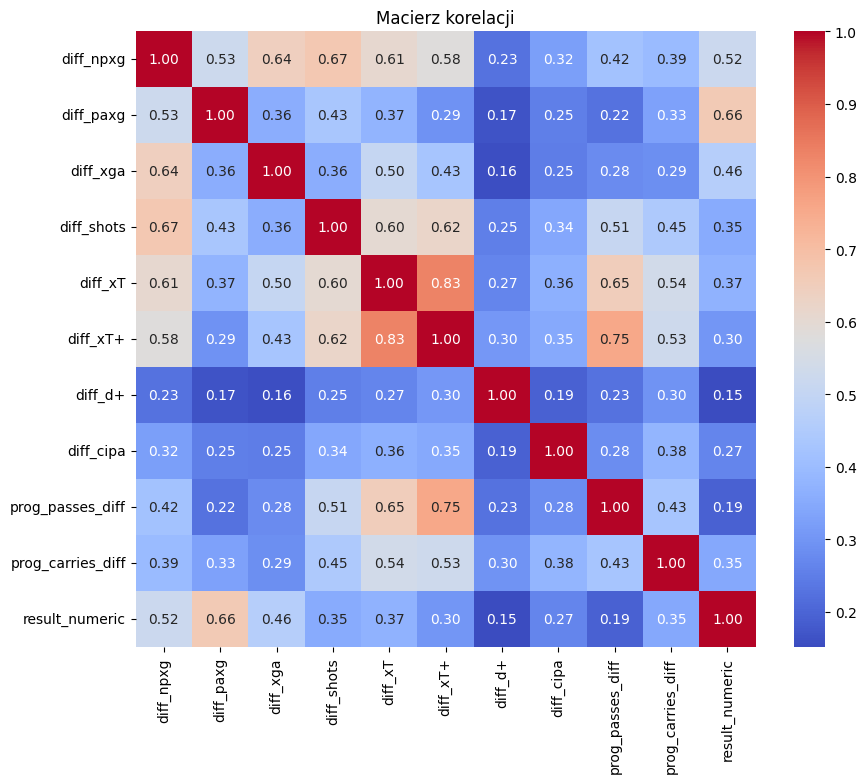

diff_paxg            0.663256
diff_npxg            0.522329
diff_xga             0.464322
diff_xT              0.371967
diff_shots           0.351041
prog_carries_diff    0.346696
diff_xT+             0.303748
diff_cipa            0.266236
prog_passes_diff     0.193700
diff_d+              0.151302
Name: result_numeric, dtype: float64


In [ ]:

# Macierz korelacji
correlation_matrix = data_all.corr()

# Wizualizacja korelacji
plt.figure(figsize=(10, 8))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt='.2f')
plt.title('Macierz korelacji')
plt.show()

# Korelacja między result_numeric a innymi zmiennymi
correlation_with_result = data_all.corr()['result_numeric'].drop('result_numeric')
print(correlation_with_result.sort_values(ascending=False))


In [ ]:
print(data_all.isnull().sum())

diff_npxg         0
diff_paxg         0
diff_xga          0
diff_shots        0
diff_xT           0
diff_xT+          0
diff_d+           0
diff_cipa         0
result_numeric    0
dtype: int64


In [ ]:
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report

# Przygotowanie danych
X = data_all[['diff_npxg', 'diff_paxg', 'diff_xga', 'diff_shots', 'diff_xT', 'diff_xT+', 'diff_d+']]  # Zmienne niezależne
y = data_all['result_numeric']  # Zmienna zależna

# Podział na zbiór treningowy i testowy
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Model
log_model = LogisticRegression(multi_class='multinomial', solver='lbfgs', max_iter=500)
log_model.fit(X_train, y_train)

# Ocena modelu
y_pred = log_model.predict(X_test)
print(classification_report(y_test, y_pred))

# Współczynniki modelu
coefficients = pd.DataFrame({
    'Variable': X.columns,
    'Coefficient': log_model.coef_[1]  # Dla kategorii 1
})
coefficients.sort_values(by='Coefficient', ascending=False)


              precision    recall  f1-score   support

          -1       0.69      0.80      0.74       419
           0       0.41      0.25      0.31       283
           1       0.74      0.81      0.77       460

    accuracy                           0.67      1162
   macro avg       0.61      0.62      0.61      1162
weighted avg       0.64      0.67      0.65      1162



,Variable,Coefficient
1,diff_paxg,0.012589
0,diff_npxg,0.012309
3,diff_shots,0.001985
5,diff_xT+,-0.000912
6,diff_d+,-0.000985
4,diff_xT,-0.002606
2,diff_xga,-0.014553


Bez bramkarzy

In [ ]:
df8

,match_id,match_date,team,team_result,goals_scored,goals_conceded,result_numeric,Goalkeeper,Stopper,Midfield,Strikers,Goalkeeper_diff,Stopper_diff,Midfield_diff,Strikers_diff,diff_xT
0,3943077,2024-07-15,Argentina,Win,1,0,1,-0.170,0.08700,0.070857,0.079333,0.024,-0.022500,-0.176893,0.011833,-0.163560
1,3943077,2024-07-15,Colombia,Lose,0,1,-1,-0.194,0.10950,0.247750,0.067500,-0.024,0.022500,0.176893,-0.011833,0.163560
2,3943076,2024-07-14,Canada,Draw,2,2,0,-0.080,0.10025,0.218000,-0.001667,0.100,0.001750,0.065400,-0.125667,0.041483
3,3943076,2024-07-14,Uruguay,Draw,2,2,0,-0.180,0.09850,0.152600,0.124000,-0.100,-0.001750,-0.065400,0.125667,-0.041483
4,3942852,2024-07-11,Uruguay,Lose,0,1,-1,-0.139,0.10700,0.084143,0.115667,0.067,0.051429,0.002343,0.087667,0.208438
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5843,3888854,1962-05-30,Mexico,Lose,0,2,-1,-0.197,0.01500,0.228400,0.090000,0.034,-0.104500,-0.229350,-0.218000,-0.517850
5844,3888705,1958-06-29,Brazil,Win,5,2,1,-0.112,0.12975,0.565000,0.295000,0.100,0.022950,0.375500,0.012000,0.510450
5845,3888705,1958-06-29,Sweden,Lose,2,5,-1,-0.212,0.10680,0.189500,0.283000,-0.100,-0.022950,-0.375500,-0.012000,-0.510450
5846,3888704,1958-06-24,Brazil,Win,5,2,1,-0.085,0.09825,0.492000,0.304667,0.134,0.065250,0.315000,-0.089333,0.424917


,match_id,match_date,team,team_result,goals_scored,goals_conceded,result_numeric,Goalkeeper,Stopper,Midfield,Strikers,Goalkeeper_npxg_diff,Stopper_npxg_diff,Midfield_npxg_diff,Strikers_npxg_diff,diff_npxg
0,3943077,2024-07-15,Argentina,Win,1,0,1,0.0,0.047532,0.198968,0.111735,-0.0,-0.078124,0.169287,-0.008432,0.082731
1,3943077,2024-07-15,Colombia,Lose,0,1,-1,0.0,0.125655,0.029681,0.120167,0.0,0.078124,-0.169287,0.008432,-0.082731
2,3943076,2024-07-14,Canada,Draw,2,2,0,0.0,0.074992,0.499317,0.532100,-0.0,-0.060229,0.409887,-0.356168,-0.006509
3,3943076,2024-07-14,Uruguay,Draw,2,2,0,0.0,0.135221,0.089429,0.888268,0.0,0.060229,-0.409887,0.356168,0.006509
4,3942852,2024-07-11,Uruguay,Lose,0,1,-1,0.0,0.083229,0.029281,0.223158,0.0,0.050076,-0.135745,0.074508,-0.011162
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5841,3888854,1962-05-30,Mexico,Lose,0,2,-1,0.0,0.000000,0.089650,0.536919,0.0,-0.080111,-0.089457,-0.244706,-0.414274
5842,3888705,1958-06-29,Brazil,Win,5,2,1,0.0,0.000000,0.173683,1.410105,-0.0,-0.000000,0.041312,0.890555,0.931867
5843,3888705,1958-06-29,Sweden,Lose,2,5,-1,0.0,0.000000,0.132370,0.519550,0.0,0.000000,-0.041312,-0.890555,-0.931867
5844,3888704,1958-06-24,Brazil,Win,5,2,1,0.0,0.000000,0.378391,1.650881,-0.0,-0.000000,0.256274,1.098435,1.354709


In [ ]:
test_npxg = npxg_df.groupby(['match_id', 'team'])['npxg'].sum().reset_index(name='npxg')

In [ ]:
test_npxg

,match_id,team,npxg
0,7525,Russia,1.281601
1,7525,Saudi Arabia,0.248807
2,7529,Croatia,0.910967
3,7529,Nigeria,0.762322
4,7530,Australia,0.196531
...,...,...,...
5841,3943043,Spain,1.791713
5842,3943076,Canada,2.287810
5843,3943076,Uruguay,1.516427
5844,3943077,Argentina,0.668937


In [ ]:
test_cor = final_df.merge(test_npxg, on=['match_id', 'team'])

In [ ]:
test_cor.head(40)

,match_id,match_date,team,team_result,goals_scored,goals_conceded,result_numeric,npxg
0,3943077,2024-07-15,Argentina,Win,1,0,1,0.668937
1,3943077,2024-07-15,Colombia,Lose,0,1,-1,0.736023
2,3943076,2024-07-14,Canada,Draw,2,2,0,2.287810
3,3943076,2024-07-14,Uruguay,Draw,2,2,0,1.516427
4,3942852,2024-07-11,Uruguay,Lose,0,1,-1,0.754564
5,3942852,2024-07-11,Colombia,Win,1,0,1,1.171961
6,3942785,2024-07-10,Argentina,Win,2,0,1,1.756235
7,3942785,2024-07-10,Canada,Lose,0,2,-1,0.677187
8,3942416,2024-07-07,Colombia,Win,5,0,1,0.613405
9,3942416,2024-07-07,Panama,Lose,0,5,-1,0.609952


In [ ]:
test_cor['PAxG'].corr(test_cor['result_numeric'])

0.4291142322961426

In [ ]:
test_cor["npxg_diff"] = test_cor.groupby('match_id')["npxg"].transform(lambda x: x.diff().fillna(-x.diff().iloc[-1]))

In [ ]:
test_cor['npxg_diff'].corr(test_cor['result_numeric'])

0.542656199150752

Metryki do wzięcia pod uwagę wszystkie:
- goals
- assist
- xGA
- paxg
- 

Testujemy wpływ metryk na wynik

npxg

In [ ]:
metric= 'npxg'

metric_list = []

for match in matches:
    metric_df = (
    match[(match['type'] == 'Shot') & (match['shot_type'] != 'Penalty') & (match['period'] < 3)]
    .groupby(['match_id', 'team'])['shot_statsbomb_xg']
    .sum()
    .reset_index(name=metric)
)
    metric_list.append(metric_df)
npxg_df = pd.concat(metric_list, ignore_index=True)
npxg_df

,match_id,team,npxg
0,3943077,Argentina,0.668937
1,3943077,Colombia,0.736023
2,3943076,Canada,2.287810
3,3943076,Uruguay,1.516427
4,3942852,Colombia,1.171961
...,...,...,...
5841,3888854,Mexico,0.895518
5842,3888705,Brazil,3.341258
5843,3888705,Sweden,0.784291
5844,3888704,Brazil,4.815326


In [ ]:
npxg_df["npxg_diff"] = npxg_df.groupby('match_id')["npxg"].transform(lambda x: x.diff().fillna(-x.diff().iloc[-1]))
npxg_df

,match_id,team,npxg,npxg_diff
0,3943077,Argentina,0.668937,-0.067086
1,3943077,Colombia,0.736023,0.067086
2,3943076,Canada,2.287810,0.771383
3,3943076,Uruguay,1.516427,-0.771383
4,3942852,Colombia,1.171961,0.417397
...,...,...,...,...
5841,3888854,Mexico,0.895518,-1.464271
5842,3888705,Brazil,3.341258,2.556967
5843,3888705,Sweden,0.784291,-2.556967
5844,3888704,Brazil,4.815326,3.344083


In [ ]:
npxg_cor = final_df.merge(npxg_df, on=['match_id', 'team'])

In [ ]:
npxg_cor['npxg_diff'].corr(npxg_cor['result_numeric'])

0.542656199150752

In [ ]:
npxg_cor

,match_id,match_date,team,team_result,goals_scored,goals_conceded,result_numeric,npxg,npxg_diff
0,3943077,2024-07-15,Argentina,Win,1,0,1,0.668937,-0.067086
1,3943077,2024-07-15,Colombia,Lose,0,1,-1,0.736023,0.067086
2,3943076,2024-07-14,Canada,Draw,2,2,0,2.287810,0.771383
3,3943076,2024-07-14,Uruguay,Draw,2,2,0,1.516427,-0.771383
4,3942852,2024-07-11,Uruguay,Lose,0,1,-1,0.754564,-0.417397
...,...,...,...,...,...,...,...,...,...
5841,3888854,1962-05-30,Mexico,Lose,0,2,-1,0.895518,-1.464271
5842,3888705,1958-06-29,Brazil,Win,5,2,1,3.341258,2.556967
5843,3888705,1958-06-29,Sweden,Lose,2,5,-1,0.784291,-2.556967
5844,3888704,1958-06-24,Brazil,Win,5,2,1,4.815326,3.344083


paxg

In [ ]:
metric= 'paxg'

metric_list = []

for match in matches:
    metric_df = (
    match[(match['type'] == "Shot") & (match['period'] < 3)]
    .assign(
            goal=lambda df: (df['shot_outcome'] == 'Goal').astype(int),  # 1 dla "Goal", inaczej 0
            PAxG_component=lambda df: (df['goal'] - df['shot_statsbomb_xg']) * (1 - df['shot_statsbomb_xg']),  # Obliczanie PAxG_component,
            shots_on_target = lambda df: (df['shot_outcome'].isin(['Saved', 'Saved To Post', 'Goal'])).astype(int)
            
        )
    .groupby(['match_id', 'team'])
    .agg(
            shots=('shot_statsbomb_xg', 'size'),
            PAxg=('PAxG_component', 'sum'),
            shots_on_target=('shots_on_target', 'sum')
        )
    .reset_index()
)
    metric_df['PAxG'] = metric_df['PAxg'] + np.log(1 + metric_df['shots_on_target']) # można zamienić na strzały celne zamiast wszystkich
    paxg = metric_df[['match_id', 'team', 'PAxg']]
    metric_list.append(metric_df)
paxg_df = pd.concat(metric_list, ignore_index=True)
paxg_df = paxg_df[['match_id', 'team', 'PAxG']]
paxg_df

,match_id,team,PAxG
0,3943077,Argentina,0.535954
1,3943077,Colombia,0.941129
2,3943076,Canada,1.730679
3,3943076,Uruguay,2.069926
4,3942852,Colombia,1.452084
...,...,...,...
5841,3888854,Mexico,0.918301
5842,3888705,Brazil,3.253999
5843,3888705,Sweden,2.260754
5844,3888704,Brazil,2.858103


In [ ]:
paxg_df["paxg_diff"] = paxg_df.groupby('match_id')["PAxG"].transform(lambda x: x.diff().fillna(-x.diff().iloc[-1]))
paxg_df

,match_id,team,PAxG,paxg_diff
0,3943077,Argentina,0.535954,-0.405175
1,3943077,Colombia,0.941129,0.405175
2,3943076,Canada,1.730679,-0.339247
3,3943076,Uruguay,2.069926,0.339247
4,3942852,Colombia,1.452084,1.030468
...,...,...,...,...
5841,3888854,Mexico,0.918301,-1.195802
5842,3888705,Brazil,3.253999,0.993246
5843,3888705,Sweden,2.260754,-0.993246
5844,3888704,Brazil,2.858103,0.449798


In [ ]:
paxg_cor = npxg_cor.merge(paxg_df, on=['match_id', 'team'])
paxg_cor['paxg_diff'].corr(paxg_cor['result_numeric'])

0.7623797774238915

xGA

In [ ]:
xga_df2 = xga_df.groupby(['match_id','team'])['xGA'].sum().reset_index(name='xGA')

In [ ]:
xga_df2["xga_diff"] = xga_df2.groupby('match_id')["xGA"].transform(lambda x: x.diff().fillna(-x.diff().iloc[-1]))
xga_df2

,match_id,team,xGA,xga_diff
0,7525,Russia,1.181497,1.013532
1,7525,Saudi Arabia,0.167965,-1.013532
2,7529,Croatia,0.892528,0.238741
3,7529,Nigeria,0.653787,-0.238741
4,7530,Australia,0.184446,-0.374834
...,...,...,...,...
5830,3943043,Spain,1.713353,1.464314
5831,3943076,Canada,1.618217,0.410421
5832,3943076,Uruguay,1.207796,-0.410421
5833,3943077,Argentina,0.668937,0.000968


In [ ]:
xga_corr = paxg_cor.merge(xga_df2, on=['match_id', 'team'])
xga_corr['xga_diff'].corr(xga_corr['result_numeric'])

0.5241497590803144

shots

In [ ]:
metric= 'shots'

metric_list = []

for match in matches:
    metric_df = (
    match[(match['type'] == 'Shot') & (match['shot_type'] != 'Penalty') & (match['period'] < 3)]
    .groupby(['match_id', 'team'])
    .size()
    .reset_index(name=metric)
)
    metric_list.append(metric_df)

shots = pd.concat(metric_list, ignore_index=True)
shots

,match_id,team,shots
0,3943077,Argentina,7
1,3943077,Colombia,14
2,3943076,Canada,14
3,3943076,Uruguay,12
4,3942852,Colombia,11
...,...,...,...
5841,3888854,Mexico,9
5842,3888705,Brazil,26
5843,3888705,Sweden,6
5844,3888704,Brazil,41


In [ ]:
shots["shots_diff"] = shots.groupby('match_id')["shots"].transform(lambda x: x.diff().fillna(-x.diff().iloc[-1]))
shots

,match_id,team,shots,shots_diff
0,3943077,Argentina,7,-7.0
1,3943077,Colombia,14,7.0
2,3943076,Canada,14,2.0
3,3943076,Uruguay,12,-2.0
4,3942852,Colombia,11,-0.0
...,...,...,...,...
5841,3888854,Mexico,9,-25.0
5842,3888705,Brazil,26,20.0
5843,3888705,Sweden,6,-20.0
5844,3888704,Brazil,41,26.0


In [ ]:
shots_corr = xga_corr.merge(shots, on=['match_id', 'team'])
shots_corr['shots_diff'].corr(shots_corr['result_numeric'])

0.31608885072697274

Carries into pen

In [ ]:
metric= 'carries_into_pen'

metric_list = []

for match in matches:
    metric_df = (
    match[
    (match['type'] == 'Carry') & 
    ((match['carry_end_x'] > 105 - 16.5) & 
     (match['carry_end_y'] > 16) & 
     (match['carry_end_y'] < 68 - 16)) & 
    (match['period'] < 3) & 
    ~((match['x'] > 105 - 16.5) & 
      (match['y'] > 13.74) & 
      (match['y'] < 68 - 13.74))
]
    .groupby(['match_id', 'team'])
    .size()
    .reset_index(name=metric)
)
    metric_list.append(metric_df)
carries_into_pen = pd.concat(metric_list, ignore_index=True)

In [ ]:
carries_into_pen["cipa_diff"] = carries_into_pen.groupby('match_id')["carries_into_pen"].transform(lambda x: x.diff().fillna(-x.diff().iloc[-1]))
carries_into_pen

,match_id,team,carries_into_pen,cipa_diff
0,3943077,Argentina,6,5.0
1,3943077,Colombia,1,-5.0
2,3943076,Canada,2,-3.0
3,3943076,Uruguay,5,3.0
4,3942852,Colombia,3,-1.0
...,...,...,...,...
5595,3888854,Mexico,4,-13.0
5596,3888705,Brazil,13,8.0
5597,3888705,Sweden,5,-8.0
5598,3888704,Brazil,20,15.0


In [ ]:
cipa_corr = shots_corr.merge(carries_into_pen, on=['match_id', 'team'])
cipa_corr['cipa_diff'].corr(cipa_corr['result_numeric'])

0.4196938670071368

xT

In [ ]:
metric= 'xT'

metric_list = []

for match in matches:
    metric_df = (
    match[(match['period'] < 3)]
    .groupby(['match_id', 'team'])['xT']
    .sum()
    .reset_index(name=metric)
)
    metric_list.append(metric_df)
xT = pd.concat(metric_list, ignore_index=True)


In [ ]:
xT["xT_diff"] = xT.groupby('match_id')["xT"].transform(lambda x: x.diff().fillna(-x.diff().iloc[-1]))
xT

,match_id,team,xT,xT_diff
0,3943077,Argentina,0.912,-0.458
1,3943077,Colombia,1.370,0.458
2,3943076,Canada,1.842,0.741
3,3943076,Uruguay,1.101,-0.741
4,3942852,Colombia,1.029,-0.517
...,...,...,...,...
5843,3888854,Mexico,1.095,-1.599
5844,3888705,Brazil,3.257,1.894
5845,3888705,Sweden,1.363,-1.894
5846,3888704,Brazil,3.682,2.273


In [ ]:
xT_corr = cipa_corr.merge(xT, on=['match_id', 'team'])
xT_corr['xT_diff'].corr(xT_corr['result_numeric'])

0.28499219731853864

xT+

In [ ]:
metric= 'xT+'

metric_list = []

for match in matches:
    metric_df = (
    match[(match['period'] < 3)]
    .groupby(['match_id', 'team'])['xT+']
    .sum()
    .reset_index(name=metric)
)
    metric_list.append(metric_df)
xT_plus = pd.concat(metric_list, ignore_index=True)


In [ ]:
xT_plus

,match_id,team,xT+
0,3943077,Argentina,1.499
1,3943077,Colombia,2.097
2,3943076,Canada,2.375
3,3943076,Uruguay,1.527
4,3942852,Colombia,1.581
...,...,...,...
5843,3888854,Mexico,1.856
5844,3888705,Brazil,3.939
5845,3888705,Sweden,1.979
5846,3888704,Brazil,4.422


In [ ]:
xT_plus["xT+_diff"] = xT_plus.groupby('match_id')["xT+"].transform(lambda x: x.diff().fillna(-x.diff().iloc[-1]))
xT_plus

,match_id,team,xT+,xT+_diff
0,3943077,Argentina,1.499,-0.598
1,3943077,Colombia,2.097,0.598
2,3943076,Canada,2.375,0.848
3,3943076,Uruguay,1.527,-0.848
4,3942852,Colombia,1.581,-0.564
...,...,...,...,...
5843,3888854,Mexico,1.856,-2.058
5844,3888705,Brazil,3.939,1.960
5845,3888705,Sweden,1.979,-1.960
5846,3888704,Brazil,4.422,2.450


In [ ]:
xT_plus_corr = xT_corr.merge(xT_plus, on=['match_id', 'team'])
xT_plus_corr['xT+_diff'].corr(xT_plus_corr['result_numeric'])

0.3050750568893066

Prog passes

In [ ]:
metric= 'prog_passes'

metric_list = []

for events_df in matches:
    start_pass_d = np.sqrt((105 - events_df['x'])**2 + (34 - events_df['y'])**2)
    end_pass_d = np.sqrt((105 - events_df['pass_end_x'])**2 + (34 - events_df['pass_end_y'])**2)
    metric_df = (
        events_df[((events_df['type'] == "Pass") & (events_df['period'] < 3) & (~events_df['pass_type'].isin(['Throw-in', 'Free Kick', 'Goal Kick', 'Corner'])) & (events_df["pass_outcome"].isna()) & (events_df['x'] > 52.5) & (events_df['pass_end_x'] > 52.5) & (start_pass_d - end_pass_d >= 10)) | ((events_df['type'] == "Pass") & (events_df['period'] < 3) & (~events_df['pass_type'].isin(['Throw-in', 'Free Kick', 'Goal Kick', 'Corner'])) & (events_df["pass_outcome"].isna()) & (events_df['x'] < 52.5) & (events_df['pass_end_x'] > 52.5) & (start_pass_d - end_pass_d >= 15)) | ((events_df['type'] == "Pass") & (~events_df['pass_type'].isin(['Throw-in', 'Free Kick', 'Goal Kick', 'Corner'])) & (events_df["pass_outcome"].isna()) & (events_df['period'] < 3) & (events_df['pass_end_x'] < 52.5) & (start_pass_d - end_pass_d >= 30))
]
    .groupby(['match_id', 'team'])
    .size()
    .reset_index(name=metric)
)
    metric_list.append(metric_df)
prog_passes = pd.concat(metric_list, ignore_index=True)

In [ ]:
prog_passes["prog_passes_diff"] = prog_passes.groupby('match_id')["prog_passes"].transform(lambda x: x.diff().fillna(-x.diff().iloc[-1]))
prog_passes

,match_id,team,prog_passes,prog_passes_diff
0,3943077,Argentina,16,-13.0
1,3943077,Colombia,29,13.0
2,3943076,Canada,29,-2.0
3,3943076,Uruguay,31,2.0
4,3942852,Colombia,25,-13.0
...,...,...,...,...
5843,3888854,Mexico,38,-39.0
5844,3888705,Brazil,64,16.0
5845,3888705,Sweden,48,-16.0
5846,3888704,Brazil,68,45.0


In [ ]:
prog_passes_corr = xT_plus_corr.merge(prog_passes, on=['match_id', 'team'])
prog_passes_corr['prog_passes_diff'].corr(prog_passes_corr['result_numeric'])

0.15378711501074174

Prog carries

In [ ]:
metric= 'prog_carries'

metric_list = []

for events_df in matches:
    start_pass_d = np.sqrt((105 - events_df['x'])**2 + (34 - events_df['y'])**2)
    end_pass_d = np.sqrt((105 - events_df['carry_end_x'])**2 + (34 - events_df['carry_end_y'])**2)
    metric_df = (
        events_df[((events_df['type'] == "Carry") & (events_df['period'] < 3) & (events_df['x'] < 52.5) & (events_df['carry_end_x'] > 52.5) & (start_pass_d - end_pass_d >= 15)) | ((events_df['type'] == "Carry") & (events_df['period'] < 3) & (events_df['x'] > 52.5) & (events_df['carry_end_x'] > 52.5) & (start_pass_d - end_pass_d >= 10)) | ((events_df['type'] == "Carry") & (events_df['period'] < 3) & (events_df['carry_end_x'] < 52.5) & (start_pass_d - end_pass_d >= 30))
]
    .groupby(['match_id', 'team'])
    .size()
    .reset_index(name=metric)
)
    metric_list.append(metric_df)
prog_carries = pd.concat(metric_list, ignore_index=True)

In [ ]:
prog_carries["prog_carries_diff"] = prog_carries.groupby('match_id')["prog_carries"].transform(lambda x: x.diff().fillna(-x.diff().iloc[-1]))
prog_carries

,match_id,team,prog_carries,prog_carries_diff
0,3943077,Argentina,19,2.0
1,3943077,Colombia,17,-2.0
2,3943076,Canada,20,9.0
3,3943076,Uruguay,11,-9.0
4,3942852,Colombia,12,-16.0
...,...,...,...,...
5842,3888854,Mexico,25,-24.0
5843,3888705,Brazil,43,17.0
5844,3888705,Sweden,26,-17.0
5845,3888704,Brazil,41,18.0


In [ ]:
prog_carries_corr = prog_passes_corr.merge(prog_carries, on=['match_id', 'team'])
prog_carries_corr['prog_carries_diff'].corr(prog_carries_corr['result_numeric'])

0.3194255233290626

prog carries + prog passes

In [ ]:
prog_carries_corr['prog_p+c_diff'] = prog_carries_corr['prog_passes_diff'] + prog_carries_corr['prog_carries_diff']

In [ ]:
prog_carries_corr['prog_p+c_diff'].corr(prog_carries_corr['result_numeric'])

0.24907088475121616

good_passes

In [ ]:
good_passes_df["gp_diff"] = good_passes_df.groupby('match_id')["good_passes"].transform(lambda x: x.diff().fillna(-x.diff().iloc[-1]))
good_passes_df

,match_id,team,good_passes,gp_diff
0,3943077,Argentina,363,-51.0
1,3943077,Colombia,414,51.0
2,3943076,Canada,272,-2.0
3,3943076,Uruguay,274,2.0
4,3942852,Colombia,221,-157.0
...,...,...,...,...
5843,3888854,Mexico,322,-87.0
5844,3888705,Brazil,376,94.0
5845,3888705,Sweden,282,-94.0
5846,3888704,Brazil,360,98.0


In [ ]:
good_passes_df_corr = prog_carries_corr.merge(good_passes_df, on=['match_id', 'team'])
good_passes_df_corr['gp_diff'].corr(good_passes_df_corr['result_numeric'])

0.26754470736154595

bad passes

In [ ]:
bad_passes_list = []
for match in matches:
    bad_passes = match[(match["type"] == "Pass") & (match['period'] < 3) & (match["pass_outcome"].isin(["Incomplete", "Out"]))].groupby(['match_id', 'team']).size().reset_index(name="bad_passes").fillna(0)
    bad_passes_list.append(bad_passes)

bad_passes_df = pd.concat(bad_passes_list, ignore_index=True)

In [ ]:
passes = good_passes_df.merge(bad_passes_df, on=['match_id', 'team'], how='outer').fillna(0)
passes

,match_id,team,good_passes,gp_diff,bad_passes
0,3943077,Argentina,363,-51.0,78
1,3943077,Colombia,414,51.0,65
2,3943076,Canada,272,-2.0,101
3,3943076,Uruguay,274,2.0,90
4,3942852,Colombia,221,-157.0,78
...,...,...,...,...,...
5843,3888854,Mexico,322,-87.0,104
5844,3888705,Brazil,376,94.0,127
5845,3888705,Sweden,282,-94.0,134
5846,3888704,Brazil,360,98.0,109


In [ ]:
passes['passes%'] = passes['good_passes'] / (passes['good_passes'] + passes['bad_passes'])

In [ ]:
passes["passes%_diff"] = passes.groupby('match_id')["passes%"].transform(lambda x: x.diff().fillna(-x.diff().iloc[-1]))
passes

,match_id,team,good_passes,gp_diff,bad_passes,passes%,passes%_diff
0,3943077,Argentina,363,-51.0,78,0.823129,-0.041171
1,3943077,Colombia,414,51.0,65,0.864301,0.041171
2,3943076,Canada,272,-2.0,101,0.729223,-0.023525
3,3943076,Uruguay,274,2.0,90,0.752747,0.023525
4,3942852,Colombia,221,-157.0,78,0.739130,-0.093469
...,...,...,...,...,...,...,...
5843,3888854,Mexico,322,-87.0,104,0.755869,-0.050838
5844,3888705,Brazil,376,94.0,127,0.747515,0.069630
5845,3888705,Sweden,282,-94.0,134,0.677885,-0.069630
5846,3888704,Brazil,360,98.0,109,0.767591,0.090588


In [ ]:
good_passes_df_corr

,match_id,match_date,team,team_result,goals_scored,goals_conceded,result_numeric,npxg,npxg_diff,PAxG,...,xT_diff,xT+,xT+_diff,prog_passes,prog_passes_diff,prog_carries,prog_carries_diff,prog_p+c_diff,good_passes,gp_diff
0,3943077,2024-07-15,Argentina,Win,1,0,1,0.668937,-0.067086,0.535954,...,-0.458,1.499,-0.598,16,-13.0,19,2.0,-11.0,363,-51.0
1,3943077,2024-07-15,Colombia,Lose,0,1,-1,0.736023,0.067086,0.941129,...,0.458,2.097,0.598,29,13.0,17,-2.0,11.0,414,51.0
2,3943076,2024-07-14,Canada,Draw,2,2,0,2.287810,0.771383,1.730679,...,0.741,2.375,0.848,29,-2.0,20,9.0,7.0,272,-2.0
3,3943076,2024-07-14,Uruguay,Draw,2,2,0,1.516427,-0.771383,2.069926,...,-0.741,1.527,-0.848,31,2.0,11,-9.0,-7.0,274,2.0
4,3942852,2024-07-11,Uruguay,Lose,0,1,-1,0.754564,-0.417397,0.421616,...,0.517,2.145,0.564,38,13.0,28,16.0,29.0,378,157.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5586,3888854,1962-05-30,Mexico,Lose,0,2,-1,0.895518,-1.464271,0.918301,...,-1.599,1.856,-2.058,38,-39.0,25,-24.0,-63.0,322,-87.0
5587,3888705,1958-06-29,Brazil,Win,5,2,1,3.341258,2.556967,3.253999,...,1.894,3.939,1.960,64,16.0,43,17.0,33.0,376,94.0
5588,3888705,1958-06-29,Sweden,Lose,2,5,-1,0.784291,-2.556967,2.260754,...,-1.894,1.979,-1.960,48,-16.0,26,-17.0,-33.0,282,-94.0
5589,3888704,1958-06-24,Brazil,Win,5,2,1,4.815326,3.344083,2.858103,...,2.273,4.422,2.450,68,45.0,41,18.0,63.0,360,98.0


In [ ]:
passes_corr = good_passes_df_corr.merge(passes, on=['match_id', 'team'])
passes_corr['passes%_diff'].corr(passes_corr['result_numeric'])

0.23989945075604777

In [ ]:
passes_corr

,match_id,match_date,team,team_result,goals_scored,goals_conceded,result_numeric,npxg,npxg_diff,PAxG,...,prog_carries,prog_carries_diff,prog_p+c_diff,good_passes_x,gp_diff_x,good_passes_y,gp_diff_y,bad_passes,passes%,passes%_diff
0,3943077,2024-07-15,Argentina,Win,1,0,1,0.668937,-0.067086,0.535954,...,19,2.0,-11.0,363,-51.0,363,-51.0,78,0.823129,-0.041171
1,3943077,2024-07-15,Colombia,Lose,0,1,-1,0.736023,0.067086,0.941129,...,17,-2.0,11.0,414,51.0,414,51.0,65,0.864301,0.041171
2,3943076,2024-07-14,Canada,Draw,2,2,0,2.287810,0.771383,1.730679,...,20,9.0,7.0,272,-2.0,272,-2.0,101,0.729223,-0.023525
3,3943076,2024-07-14,Uruguay,Draw,2,2,0,1.516427,-0.771383,2.069926,...,11,-9.0,-7.0,274,2.0,274,2.0,90,0.752747,0.023525
4,3942852,2024-07-11,Uruguay,Lose,0,1,-1,0.754564,-0.417397,0.421616,...,28,16.0,29.0,378,157.0,378,157.0,76,0.832599,0.093469
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5586,3888854,1962-05-30,Mexico,Lose,0,2,-1,0.895518,-1.464271,0.918301,...,25,-24.0,-63.0,322,-87.0,322,-87.0,104,0.755869,-0.050838
5587,3888705,1958-06-29,Brazil,Win,5,2,1,3.341258,2.556967,3.253999,...,43,17.0,33.0,376,94.0,376,94.0,127,0.747515,0.069630
5588,3888705,1958-06-29,Sweden,Lose,2,5,-1,0.784291,-2.556967,2.260754,...,26,-17.0,-33.0,282,-94.0,282,-94.0,134,0.677885,-0.069630
5589,3888704,1958-06-24,Brazil,Win,5,2,1,4.815326,3.344083,2.858103,...,41,18.0,63.0,360,98.0,360,98.0,109,0.767591,0.090588


SOT

In [ ]:
target_shot_list = []
for match in matches:
    target = match[(match['shot_outcome'].isin(['Saved', 'Goal', 'Saved To Post'])) & (match['period'] < 3)].groupby(['match_id', 'team'] ).size().reset_index(name='shots_on_target')
    target_shot_list.append(target)
target_df = pd.concat(target_shot_list, ignore_index=True)

In [ ]:
target_df["target_diff"] = target_df.groupby('match_id')["shots_on_target"].transform(lambda x: x.diff().fillna(-x.diff().iloc[-1]))
target_df

,match_id,team,shots_on_target,target_diff
0,3943077,Argentina,2,-2.0
1,3943077,Colombia,4,2.0
2,3943076,Canada,5,-0.0
3,3943076,Uruguay,5,0.0
4,3942852,Colombia,3,1.0
...,...,...,...,...
5675,3888854,Mexico,4,-8.0
5676,3888705,Brazil,11,8.0
5677,3888705,Sweden,3,-8.0
5678,3888704,Brazil,16,9.0


In [ ]:
target_corr = passes_corr.merge(target_df, on=['match_id', 'team'])
target_corr['target_diff'].corr(target_corr['result_numeric'])

0.5380813172588383

In [ ]:
corr_all

,team_result,goals_scored,goals_conceded,result_numeric,npxg,npxg_diff,PAxG,paxg_diff,xGA,xga_diff,...,prog_p+c_diff,good_passes_x,gp_diff_x,good_passes_y,gp_diff_y,bad_passes,passes%,passes%_diff,shots_on_target,target_diff
0,Win,1,0,1,0.668937,-0.067086,0.535954,-0.405175,0.668937,0.000968,...,-11.0,363,-51.0,363,-51.0,78,0.823129,-0.041171,2,-2.0
1,Lose,0,1,-1,0.736023,0.067086,0.941129,0.405175,0.667969,-0.000968,...,11.0,414,51.0,414,51.0,65,0.864301,0.041171,4,2.0
2,Draw,2,2,0,2.287810,0.771383,1.730679,-0.339247,1.618217,0.410421,...,7.0,272,-2.0,272,-2.0,101,0.729223,-0.023525,5,-0.0
3,Draw,2,2,0,1.516427,-0.771383,2.069926,0.339247,1.207796,-0.410421,...,-7.0,274,2.0,274,2.0,90,0.752747,0.023525,5,0.0
4,Lose,0,1,-1,0.754564,-0.417397,0.421616,-1.030468,0.690830,-0.481131,...,29.0,378,157.0,378,157.0,76,0.832599,0.093469,2,-1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5454,Lose,0,2,-1,0.895518,-1.464271,0.918301,-1.195802,0.875046,-1.142056,...,-63.0,322,-87.0,322,-87.0,104,0.755869,-0.050838,4,-8.0
5455,Win,5,2,1,3.341258,2.556967,3.253999,0.993246,2.868785,2.094526,...,33.0,376,94.0,376,94.0,127,0.747515,0.069630,11,8.0
5456,Lose,2,5,-1,0.784291,-2.556967,2.260754,-0.993246,0.774260,-2.094526,...,-33.0,282,-94.0,282,-94.0,134,0.677885,-0.069630,3,-8.0
5457,Win,5,2,1,4.815326,3.344083,2.858103,0.449798,2.485235,1.188078,...,63.0,360,98.0,360,98.0,109,0.767591,0.090588,16,9.0


In [ ]:
corr_all = target_corr[list(target_corr.columns[4:])]

interc + tackles

In [ ]:
inter_list = []

for match in matches:
    
    inter = match[(match['type'] == 'Interception') & (match['period'] < 3)].groupby(['match_id', 'team']).size().reset_index(name='interception')
    inter_list.append(inter)

inter_df = pd.concat(inter_list, ignore_index=True)


In [ ]:
recovery_list = []
for match in matches:
    
    recov = match[(match['type'] == 'Ball Recovery') & (match['period'] < 3)].groupby(['match_id', 'team']).size().reset_index(name='recovery')
    recovery_list.append(recov)

recovery_df = pd.concat(recovery_list, ignore_index=True)


In [ ]:
tackle_list = []
for match in matches:
    
    tackle = match[(match['type'] == 'Duel') & (match['duel_outcome'].isin(["Won", "Lost Out", "Success", "Success In Play", "Success Out"])) & (match['period'] < 3)].groupby(['match_id', 'team']).size().reset_index(name='tackle')
    tackle_list.append(tackle)

tackle_df = pd.concat(tackle_list, ignore_index=True)


In [ ]:
clearance_list = []

for match in matches:
    clearance = match[(match['type'] == 'Clearance') & (match['period'] < 3)].groupby(['match_id', 'team']).size().reset_index(name='clearance')
    clearance_list.append(clearance)

clearance_df = pd.concat(clearance_list, ignore_index=True)

In [ ]:
error_list = []

for match in matches:
    
    error = match[(match['type'] == 'Error') & (match['period'] < 3)].groupby(['match_id', 'team']).size().reset_index(name='error')
    error_list.append(error)

error_df = pd.concat(error_list, ignore_index=True)

In [ ]:
dispossessed_list = []

for match in matches:
    
    dispossessed = match[(match['type'] == 'Dispossessed') & (match['period'] < 3)].groupby(['match_id', 'team']).size().reset_index(name='dispossessed')
    dispossessed_list.append(dispossessed)

dispossessed_df = pd.concat(dispossessed_list, ignore_index=True)

In [ ]:
miscontrol_list = []

for match in matches:
    
    miscontrol = match[(match['type'] == 'Miscontrol') & (match['period'] < 3)].groupby(['match_id', 'team']).size().reset_index(name='miscontrol')
    miscontrol_list.append(miscontrol)

miscontrol_df = pd.concat(miscontrol_list, ignore_index=True)

Duels

Aerial

In [ ]:
miscontrol_df

,match_id,team,miscontrol
0,3943077,Argentina,6
1,3943077,Colombia,8
2,3943076,Canada,8
3,3943076,Uruguay,15
4,3942852,Colombia,12
...,...,...,...
5843,3888854,Mexico,25
5844,3888705,Brazil,19
5845,3888705,Sweden,18
5846,3888704,Brazil,16


Sprawdźmy co jaki ma wpływ na wynik z tych zmiennych

In [ ]:
final_corr = final_df[['match_id', 'team', 'result_numeric']]

In [ ]:
cols_corr = [inter_df, recovery_df, tackle_df, clearance_df, error_df, dispossessed_df, miscontrol_df]
cols_corr2 = ["interception", "recovery", "tackle", "clearance", "error", "dispossessed", "miscontrol"]

for i, df in enumerate(cols_corr):
    df[f"{cols_corr2[i]}_diff"] = df.groupby('match_id')[cols_corr2[i]].transform( lambda x: (
        (x.diff() / x.max()).fillna(-x.diff().iloc[-1] / x.max()) * 100
        if x.max() != 0 else 0
    ))


In [ ]:
cols_corr = [inter_df, recovery_df, tackle_df, clearance_df, error_df, dispossessed_df, miscontrol_df]
cols_corr2 = ["interception", "recovery", "tackle", "clearance", "error", "dispossessed", "miscontrol"]

for i, df in enumerate(cols_corr):
    df[f"{cols_corr2[i]}_diff"] = df.groupby('match_id')[cols_corr2[i]].transform(lambda x: x.diff().fillna(-x.diff().iloc[-1]))


In [ ]:
merged_df = cols_corr[0]
for df in cols_corr[1:]:
    merged_df = pd.merge(merged_df, df, on=['match_id', 'team'], how='left')  # użyj 'inner', 'left' lub 'outer' według potrzeb


KeyError: 'team'

In [ ]:
merged_df = merged_df.fillna(0)

In [ ]:
merged_df = merged_df.merge(final_corr, on=['match_id', 'team'])

KeyError: 'match_id'

In [ ]:
merged_df = merged_df[list(merged_df.columns[2:])]

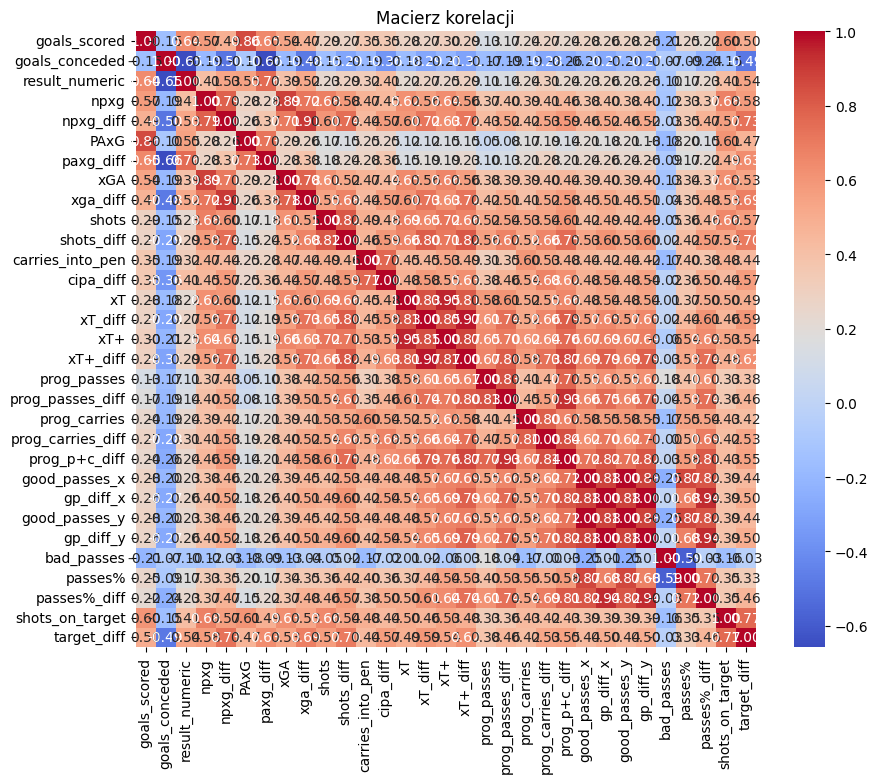

paxg_diff            0.759528
goals_scored         0.640723
PAxG                 0.546958
target_diff          0.538081
npxg_diff            0.532907
xga_diff             0.515427
shots_on_target      0.414811
cipa_diff            0.414422
npxg                 0.410676
xGA                  0.392837
carries_into_pen     0.317919
prog_carries_diff    0.309943
xT+_diff             0.292865
shots_diff           0.291105
xT_diff              0.273363
gp_diff_x            0.257797
gp_diff_y            0.257797
xT+                  0.249647
prog_carries         0.238588
prog_p+c_diff        0.236807
passes%_diff         0.231179
good_passes_y        0.229772
good_passes_x        0.229772
shots                0.229575
xT                   0.219774
passes%              0.172995
prog_passes_diff     0.141727
prog_passes          0.114255
bad_passes          -0.103692
goals_conceded      -0.653497
Name: result_numeric, dtype: float64


In [ ]:

# Macierz korelacji
correlation_matrix = corr_all.corr()

# Wizualizacja korelacji
plt.figure(figsize=(10, 8))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt='.2f')
plt.title('Macierz korelacji')
plt.show()

# Korelacja między result_numeric a innymi zmiennymi
correlation_with_result = corr_all.corr()['result_numeric'].drop('result_numeric')
print(correlation_with_result.sort_values(ascending=False))


Przeanalizujmy napastników, weźmy pod uwagę:
- paxg 0.501820 ok
- target 0.249035 ok
- xGA 0.244905 ok
- xT+ 0.297286 ok
- carries into pen 0.159951 ok
- prog_carries 0.354517 ok
- prog_passes 0.147546 ok
- shots 0.297193
- aerial/duels...
- assist 0.07 ok
- dribbles_good 0.133487 ok

Wpływ zmiennej jako 
różnica w pozycji
lub
Procent wydarzeń

paxg

In [ ]:
metric= 'paxg'

metric_list = []

for match in matches:
    metric_df = (
    match[(match['type'] == "Shot") & (match['period'] < 3)]
    .assign(
            goal=lambda df: (df['shot_outcome'] == 'Goal').astype(int),  # 1 dla "Goal", inaczej 0
            PAxG_component=lambda df: (df['goal'] - df['shot_statsbomb_xg']) * (1 - df['shot_statsbomb_xg']),  # Obliczanie PAxG_component,
            shots_on_target = lambda df: (df['shot_outcome'].isin(['Saved', 'Saved To Post', 'Goal'])).astype(int)
            
        )
    .groupby(['match_id', 'team', 'position'])
    .agg(
            shots=('shot_statsbomb_xg', 'size'),
            PAxg=('PAxG_component', 'sum'),
            shots_on_target=('shots_on_target', 'sum')
        )
    .reset_index()
)
    metric_df['PAxG'] = metric_df['PAxg'] + np.log(1 + metric_df['shots_on_target']) # można zamienić na strzały celne zamiast wszystkich
    paxg = metric_df[['match_id', 'team', 'PAxg']]
    metric_list.append(metric_df)
paxg_df = pd.concat(metric_list, ignore_index=True)
paxg_df = paxg_df[['match_id', 'team', 'position', 'PAxG']]
paxg_df

,match_id,team,position,PAxG
0,3943077,Argentina,Left Back,-0.045272
1,3943077,Argentina,Left Center Forward,-0.066935
2,3943077,Argentina,Left Defensive Midfield,-0.039073
3,3943077,Argentina,Left Midfield,0.815665
4,3943077,Argentina,Right Center Forward,-0.128430
...,...,...,...,...
36344,3888704,France,Left Center Forward,-0.048865
36345,3888704,France,Left Defensive Midfield,1.789013
36346,3888704,France,Right Center Forward,1.377605
36347,3888704,France,Right Defensive Midfield,0.653015


In [ ]:
paxg_df['grouped_position'] = paxg_df['position'].apply(assign_group)

In [ ]:
paxg_df= paxg_df.pivot_table(
    index=['match_id', 'team'],
    columns='grouped_position',
    values='PAxG',
    aggfunc='mean'
).reset_index()

paxg_df = paxg_df[['match_id', 'team', 'Stopper','Midfield', 'Strikers']]
paxg_df.columns.name = None
paxg_df

,match_id,team,Stopper,Midfield,Strikers
0,7525,Russia,-0.024991,1.457395,1.193705
1,7525,Saudi Arabia,-0.099003,-0.041077,-0.052533
2,7529,Croatia,-0.042009,0.270132,-0.312208
3,7529,Nigeria,0.593388,-0.090311,0.379941
4,7530,Australia,-0.027207,0.651494,NaN
...,...,...,...,...,...
5841,3943043,Spain,-0.096005,0.650286,1.295070
5842,3943076,Canada,-0.071494,0.941861,0.723866
5843,3943076,Uruguay,-0.122591,0.495500,1.313939
5844,3943077,Argentina,-0.045272,0.388296,-0.097683


In [ ]:
paxg_df = paxg_df.fillna(0)

In [ ]:
cols = ['Stopper', 'Midfield', 'Strikers']
for col in cols:
    paxg_df[f"{col}_paxg_diff"] = paxg_df.groupby('match_id')[col].transform(lambda x: x.diff().fillna(-x.diff().iloc[-1]))
paxg_df

,match_id,team,Stopper,Midfield,Strikers,Stopper_paxg_diff,Midfield_paxg_diff,Strikers_paxg_diff
0,7525,Russia,-0.024991,1.457395,1.193705,0.074011,1.498472,1.246238
1,7525,Saudi Arabia,-0.099003,-0.041077,-0.052533,-0.074011,-1.498472,-1.246238
2,7529,Croatia,-0.042009,0.270132,-0.312208,-0.635397,0.360443,-0.692149
3,7529,Nigeria,0.593388,-0.090311,0.379941,0.635397,-0.360443,0.692149
4,7530,Australia,-0.027207,0.651494,0.000000,0.021438,0.212325,-0.723461
...,...,...,...,...,...,...,...,...
5841,3943043,Spain,-0.096005,0.650286,1.295070,0.007424,-0.123534,1.410230
5842,3943076,Canada,-0.071494,0.941861,0.723866,0.051098,0.446361,-0.590073
5843,3943076,Uruguay,-0.122591,0.495500,1.313939,-0.051098,-0.446361,0.590073
5844,3943077,Argentina,-0.045272,0.388296,-0.097683,-0.166782,0.070648,-0.332262


In [ ]:
df3_corr = df3[list(df3.columns[6:])]

In [ ]:
df3_corr

,result_numeric,Goalkeeper,Stopper,Midfield,Strikers,Goalkeeper_paxg_diff,Stopper_paxg_diff,Midfield_paxg_diff,Strikers_paxg_diff,diff_paxg
0,1,0.0,-0.045272,0.388296,-0.097683,-0.0,-0.166782,0.070648,-0.332262,-0.428396
1,-1,0.0,0.121510,0.317648,0.234579,0.0,0.166782,-0.070648,0.332262,0.428396
2,0,0.0,-0.071494,0.941861,0.723866,-0.0,0.051098,0.446361,-0.590073,-0.092614
3,0,0.0,-0.122591,0.495500,1.313939,0.0,-0.051098,-0.446361,0.590073,0.092614
4,-1,0.0,0.153619,0.318156,-0.193935,0.0,0.185672,-0.067657,-0.056340,0.061674
...,...,...,...,...,...,...,...,...,...,...
5841,-1,0.0,0.000000,0.089974,1.028408,0.0,-0.615524,-0.749685,0.062857,-1.302351
5842,1,0.0,0.000000,0.801645,1.719666,-0.0,-0.000000,-0.054664,0.766064,0.711400
5843,-1,0.0,0.000000,0.856308,0.953602,0.0,0.000000,0.054664,-0.766064,-0.711400
5844,1,0.0,0.000000,0.915225,1.727034,-0.0,-0.000000,0.114785,1.062664,1.177448


In [ ]:
df3_corr.corr()

,result_numeric,Goalkeeper,Stopper,Midfield,Strikers,Goalkeeper_paxg_diff,Stopper_paxg_diff,Midfield_paxg_diff,Strikers_paxg_diff,diff_paxg
result_numeric,1.000000,0.035365,0.158536,0.374002,0.365445,0.049985,0.223567,0.511567,0.501820,0.667417
Goalkeeper,0.035365,1.000000,0.003187,0.016303,0.017409,0.707442,-0.004734,0.009556,0.027698,0.025376
Stopper,0.158536,0.003187,1.000000,0.006063,0.011171,-0.004743,0.708930,0.023745,0.025039,0.304757
Midfield,0.374002,0.016303,0.006063,1.000000,0.114962,0.009874,0.024485,0.731023,0.118943,0.391425
Strikers,0.365445,0.017409,0.011171,0.114962,1.000000,0.028501,0.025711,0.118444,0.727958,0.601608
Goalkeeper_paxg_diff,0.049985,0.707442,-0.004743,0.009874,0.028501,1.000000,-0.006691,0.013507,0.039152,0.035870
Stopper_paxg_diff,0.223567,-0.004734,0.708930,0.024485,0.025711,-0.006691,1.000000,0.033495,0.035320,0.429883
Midfield_paxg_diff,0.511567,0.009556,0.023745,0.731023,0.118444,0.013507,0.033495,1.000000,0.162707,0.535448
Strikers_paxg_diff,0.501820,0.027698,0.025039,0.118943,0.727958,0.039152,0.035320,0.162707,1.000000,0.826432
diff_paxg,0.667417,0.025376,0.304757,0.391425,0.601608,0.035870,0.429883,0.535448,0.826432,1.000000


In [ ]:
df4_corr = df4[list(df4.columns[6:])]

In [ ]:
df4_corr.corr()

,result_numeric,Goalkeeper,Stopper,Midfield,Strikers,Goalkeeper_xga_diff,Stopper_xga_diff,Midfield_xga_diff,Strikers_xga_diff,diff_xga
result_numeric,1.000000,0.026355,0.193635,0.311363,0.219575,-0.031758,0.232945,0.406420,0.244905,0.463500
Goalkeeper,0.026355,1.000000,0.001781,0.013260,0.015845,0.024817,0.014102,-0.001906,-0.002790,0.003349
Stopper,0.193635,0.001781,1.000000,0.100813,0.060106,-0.003206,0.561597,0.123742,0.043557,0.330303
Midfield,0.311363,0.013260,0.100813,1.000000,0.123514,-0.024413,0.088524,0.735329,0.102390,0.495456
Strikers,0.219575,0.015845,0.060106,0.123514,1.000000,-0.004917,0.050351,0.120472,0.542618,0.408691
Goalkeeper_xga_diff,-0.031758,0.024817,-0.003206,-0.024413,-0.004917,1.000000,-0.004755,-0.033200,0.000410,-0.016879
Stopper_xga_diff,0.232945,0.014102,0.561597,0.088524,0.050351,-0.004755,1.000000,0.111835,0.076184,0.528716
Midfield_xga_diff,0.406420,-0.001906,0.123742,0.735329,0.120472,-0.033200,0.111835,1.000000,0.135567,0.667987
Strikers_xga_diff,0.244905,-0.002790,0.043557,0.102390,0.542618,0.000410,0.076184,0.135567,1.000000,0.699480
diff_xga,0.463500,0.003349,0.330303,0.495456,0.408691,-0.016879,0.528716,0.667987,0.699480,1.000000


In [ ]:
df5[list(df5.columns[6:])].corr()

,result_numeric,Goalkeeper,Stopper,Midfield,Strikers,Goalkeeper_shots_diff,Stopper_shots_diff,Midfield_shots_diff,Strikers_shots_diff,diff_shots
result_numeric,1.000000,-3.803440e-02,0.070438,0.223509,0.265766,NaN,6.567543e-02,0.290971,0.297193,0.357233
Goalkeeper,-0.038034,1.000000e+00,0.027541,0.010812,-0.005222,NaN,-2.134824e-18,0.008854,-0.006347,-0.001399
Stopper,0.070438,2.754054e-02,1.000000,0.115442,0.108261,NaN,4.154858e-01,0.139305,0.104197,0.218149
Midfield,0.223509,1.081198e-02,0.115442,1.000000,0.240286,NaN,7.098070e-02,0.734592,0.218663,0.472930
Strikers,0.265766,-5.221890e-03,0.108261,0.240286,1.000000,NaN,7.572378e-02,0.247164,0.656372,0.618973
Goalkeeper_shots_diff,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Stopper_shots_diff,0.065675,-2.134824e-18,0.415486,0.070981,0.075724,NaN,1.000000e+00,0.089213,0.069743,0.288217
Midfield_shots_diff,0.290971,8.853732e-03,0.139305,0.734592,0.247164,NaN,8.921311e-02,1.000000,0.285481,0.632925
Strikers_shots_diff,0.297193,-6.347070e-03,0.104197,0.218663,0.656372,NaN,6.974292e-02,0.285481,1.000000,0.897961
diff_shots,0.357233,-1.398742e-03,0.218149,0.472930,0.618973,NaN,2.882173e-01,0.632925,0.897961,1.000000


In [ ]:
df6[list(df6.columns[6:])].corr()

,result_numeric,Goalkeeper,Stopper,Midfield,Strikers,Goalkeeper_gd_diff,Stopper_gd_diff,Midfield_gd_diff,Strikers_gd_diff
result_numeric,1.000000,-0.029031,-0.023557,0.156179,1.334874e-01,-2.125737e-02,-0.025925,0.219100,1.224008e-01
Goalkeeper,-0.029031,1.000000,0.000716,-0.003704,-7.589803e-03,6.171437e-02,-0.011491,-0.009929,-1.282866e-03
Stopper,-0.023557,0.000716,1.000000,0.140039,1.437688e-01,-9.945673e-03,0.534158,0.083831,5.478667e-02
Midfield,0.156179,-0.003704,0.140039,1.000000,1.135448e-01,-4.622252e-03,0.051036,0.660800,5.065999e-02
Strikers,0.133487,-0.007590,0.143769,0.113545,1.000000e+00,-3.971674e-20,0.055054,0.044636,4.566399e-01
Goalkeeper_gd_diff,-0.021257,0.061714,-0.009946,-0.004622,-3.971674e-20,1.000000e+00,-0.018619,-0.006995,-1.313635e-36
Stopper_gd_diff,-0.025925,-0.011491,0.534158,0.051036,5.505434e-02,-1.861936e-02,1.000000,0.078601,6.966780e-02
Midfield_gd_diff,0.219100,-0.009929,0.083831,0.660800,4.463577e-02,-6.994931e-03,0.078601,1.000000,7.190260e-02
Strikers_gd_diff,0.122401,-0.001283,0.054787,0.050660,4.566399e-01,-1.313635e-36,0.069668,0.071903,1.000000e+00


In [ ]:
df8[list(df8.columns[6:])].corr()

,result_numeric,Stopper,Midfield,Strikers,Stopper_carries_into_pen_diff,Midfield_carries_into_pen_diff,Strikers_carries_into_pen_diff,diff_cipa
result_numeric,1.000000,0.123112,0.212793,0.190885,0.053403,0.226076,0.159951,0.268067
Stopper,0.123112,1.000000,0.064784,0.084428,0.197773,0.068448,0.062476,0.126861
Midfield,0.212793,0.064784,1.000000,0.057225,0.022337,0.529550,0.081405,0.416954
Strikers,0.190885,0.084428,0.057225,1.000000,0.007928,0.099275,0.404217,0.331262
Stopper_carries_into_pen_diff,0.053403,0.197773,0.022337,0.007928,1.000000,0.014783,0.015645,0.221641
Midfield_carries_into_pen_diff,0.226076,0.068448,0.529550,0.099275,0.014783,1.000000,0.078466,0.733029
Strikers_carries_into_pen_diff,0.159951,0.062476,0.081405,0.404217,0.015645,0.078466,1.000000,0.705209
diff_cipa,0.268067,0.126861,0.416954,0.331262,0.221641,0.733029,0.705209,1.000000


In [ ]:
df9[list(df9.columns[6:])].corr()

,result_numeric,Goalkeeper,Stopper,Midfield,Strikers,Goalkeeper_diff,Stopper_diff,Midfield_diff,Strikers_diff,diff_xT+
result_numeric,1.000000,0.009718,0.116336,0.249514,0.212713,0.014334,0.143988,0.299572,0.297286,0.316488
Goalkeeper,0.009718,1.000000,-0.018478,-0.042802,-0.049754,0.677961,-0.027646,-0.033520,-0.027614,-0.038644
Stopper,0.116336,-0.018478,1.000000,0.372263,0.164673,-0.032947,0.807954,0.451136,0.201440,0.651607
Midfield,0.249514,-0.042802,0.372263,1.000000,0.062807,-0.041181,0.465066,0.832902,0.146237,0.756771
Strikers,0.212713,-0.049754,0.164673,0.062807,1.000000,-0.029062,0.178430,0.125745,0.714828,0.307020
Goalkeeper_diff,0.014334,0.677961,-0.032947,-0.041181,-0.029062,1.000000,-0.040778,-0.049443,-0.040731,-0.057000
Stopper_diff,0.143988,-0.027646,0.807954,0.465066,0.178430,-0.040778,1.000000,0.558368,0.249321,0.806490
Midfield_diff,0.299572,-0.033520,0.451136,0.832902,0.125745,-0.049443,0.558368,1.000000,0.175575,0.908596
Strikers_diff,0.297286,-0.027614,0.201440,0.146237,0.714828,-0.040731,0.249321,0.175575,1.000000,0.429171
diff_xT+,0.316488,-0.038644,0.651607,0.756771,0.307020,-0.057000,0.806490,0.908596,0.429171,1.000000


In [ ]:
df11[list(df11.columns[6:])].corr()

,result_numeric,Stopper,Midfield,Strikers,Stopper_prog_passes_diff,Midfield_prog_passes_diff,Strikers_prog_passes_diff,prog_passes_diff
result_numeric,1.000000,0.053778,0.188966,0.163639,0.068226,0.241610,0.147546,0.205279
Stopper,0.053778,1.000000,0.293786,0.020879,0.794911,0.359932,0.059667,0.657010
Midfield,0.188966,0.293786,1.000000,0.129534,0.352551,0.778322,0.094382,0.625486
Strikers,0.163639,0.020879,0.129534,1.000000,0.052707,0.114411,0.471747,0.227176
Stopper_prog_passes_diff,0.068226,0.794911,0.352551,0.052707,1.000000,0.452026,0.075061,0.826130
Midfield_prog_passes_diff,0.241610,0.359932,0.778322,0.114411,0.452026,1.000000,0.122042,0.803325
Strikers_prog_passes_diff,0.147546,0.059667,0.094382,0.471747,0.075061,0.122042,1.000000,0.399325
prog_passes_diff,0.205279,0.657010,0.625486,0.227176,0.826130,0.803325,0.399325,1.000000


In [ ]:
df12[list(df12.columns[6:])].corr()

,result_numeric,Stopper,Midfield,Strikers,Stopper_prog_carries_diff,Midfield_prog_carries_diff,Strikers_prog_carries_diff,prog_carries_diff
result_numeric,1.000000,0.086456,0.231403,0.223238,0.115890,0.308093,0.248353,0.354517
Stopper,0.086456,1.000000,0.160983,0.082633,0.661752,0.182768,0.054845,0.421066
Midfield,0.231403,0.160983,1.000000,0.088450,0.157027,0.729186,0.088525,0.506780
Strikers,0.223238,0.082633,0.088450,1.000000,0.046610,0.087983,0.560113,0.381904
Stopper_prog_carries_diff,0.115890,0.661752,0.157027,0.046610,1.000000,0.207281,0.069279,0.592033
Midfield_prog_carries_diff,0.308093,0.182768,0.729186,0.087983,0.207281,1.000000,0.124024,0.692894
Strikers_prog_carries_diff,0.248353,0.054845,0.088525,0.560113,0.069279,0.124024,1.000000,0.658093
prog_carries_diff,0.354517,0.421066,0.506780,0.381904,0.592033,0.692894,0.658093,1.000000


In [ ]:
target_shot_list = []
for match in matches:
    target = match[(match['shot_outcome'].isin(['Saved', 'Goal', 'Saved To Post'])) & (match['period'] < 3)].groupby(['match_id', 'team', 'position'] ).size().reset_index(name='shots_on_target')
    target_shot_list.append(target)
target_team = pd.concat(target_shot_list, ignore_index=True)

In [ ]:
metric = "shots_on_target"
shots = target_team
shots['grouped_position'] = shots['position'].apply(assign_group)
shots= shots.pivot_table(
    index=['match_id', 'team'],
    columns='grouped_position',
    values=metric,
    aggfunc='mean'
).reset_index()

shots = shots[['match_id', 'team', 'Stopper','Midfield', 'Strikers']]
shots.columns.name = None
for col in cols2:
    shots[f"{col}_{metric}_diff"] = shots.groupby('match_id')[col].transform(lambda x: x.diff().fillna(-x.diff().iloc[-1]))

df13 = final_df.merge(shots, on=['match_id', 'team'])
df13 = df13.fillna(0)

In [ ]:
df13[list(df13.columns[6:])].corr()

,result_numeric,Stopper,Midfield,Strikers,Stopper_shots_on_target_diff,Midfield_shots_on_target_diff,Strikers_shots_on_target_diff
result_numeric,1.000000,0.095975,0.231600,0.296025,0.036411,0.246714,0.249035
Stopper,0.095975,1.000000,0.008737,0.027155,0.144619,0.047836,0.043808
Midfield,0.231600,0.008737,1.000000,0.072724,-0.010393,0.487683,0.091621
Strikers,0.296025,0.027155,0.072724,1.000000,0.025233,0.091095,0.426907
Stopper_shots_on_target_diff,0.036411,0.144619,-0.010393,0.025233,1.000000,-0.014481,0.036566
Midfield_shots_on_target_diff,0.246714,0.047836,0.487683,0.091095,-0.014481,1.000000,0.093894
Strikers_shots_on_target_diff,0.249035,0.043808,0.091621,0.426907,0.036566,0.093894,1.000000


In [ ]:
assist_list = []
for match in matches:
    if 'pass_goal_assist' in match.columns:
        assist = match[(match['pass_goal_assist'] == True) & (match['period'] < 3)].groupby(['match_id', 'team', 'position']).size().reset_index(name='assist')
        assist_list.append(assist)
assist_df = pd.concat(assist_list, ignore_index=True)

In [ ]:
metric = "assist"
shots = assist_df
shots['grouped_position'] = shots['position'].apply(assign_group)
shots= shots.pivot_table(
    index=['match_id', 'team'],
    columns='grouped_position',
    values=metric,
    aggfunc='mean'
).reset_index()

shots = shots[['match_id', 'team', 'Stopper','Midfield', 'Strikers']]
shots.columns.name = None
for col in cols2:
    shots[f"{col}_{metric}_diff"] = shots.groupby('match_id')[col].transform(lambda x: x.diff().fillna(-x.diff().iloc[-1]))

df14 = final_df.merge(shots, on=['match_id', 'team'])
df14 = df14.fillna(0)

In [ ]:
df14[list(df14.columns[6:])].corr()

,result_numeric,Stopper,Midfield,Strikers,Stopper_assist_diff,Midfield_assist_diff,Strikers_assist_diff
result_numeric,1.000000,0.124739,0.154198,0.122465,1.378252e-02,1.584744e-01,7.439745e-02
Stopper,0.124739,1.000000,-0.314018,-0.109717,5.702327e-02,-8.708064e-03,9.471050e-03
Midfield,0.154198,-0.314018,1.000000,-0.300078,-2.007235e-02,1.862071e-01,4.167294e-03
Strikers,0.122465,-0.109717,-0.300078,1.000000,2.109883e-02,2.369130e-03,6.351588e-02
Stopper_assist_diff,0.013783,0.057023,-0.020072,0.021099,1.000000e+00,1.459988e-35,-9.118744e-36
Midfield_assist_diff,0.158474,-0.008708,0.186207,0.002369,1.459988e-35,1.000000e+00,-5.390065e-36
Strikers_assist_diff,0.074397,0.009471,0.004167,0.063516,-9.118744e-36,-5.390065e-36,1.000000e+00


Obrońcy - co wpływa?

In [ ]:
stopper = players4[players4['position'].isin(stoper)]

In [ ]:
inter_list = []

for match in matches:
    
    inter = match[(match['type'] == 'Interception') & (match['period'] < 3)].groupby(['match_id', 'team', 'position']).size().reset_index(name='interception')
    inter_list.append(inter)

inter_df_team = pd.concat(inter_list, ignore_index=True)

In [ ]:
metric = "interception"
shots = inter_df_team
shots['grouped_position'] = shots['position'].apply(assign_group)
shots= shots.pivot_table(
    index=['match_id', 'team'],
    columns='grouped_position',
    values=metric,
    aggfunc='mean'
).reset_index()

shots = shots[['match_id', 'team', 'Stopper','Midfield', 'Strikers']]
shots.columns.name = None
for col in cols2:
    shots[f"{col}_{metric}_diff"] = shots.groupby('match_id')[col].transform(lambda x: x.diff().fillna(-x.diff().iloc[-1]))

df15 = final_df.merge(shots, on=['match_id', 'team'])
df15 = df15.fillna(0)

In [ ]:
df15[list(df15.columns[4:])].corr()

,goals_scored,goals_conceded,result_numeric,Stopper,Midfield,Strikers,Stopper_interception_diff,Midfield_interception_diff,Strikers_interception_diff
goals_scored,1.000000,-0.156236,0.648612,-0.049952,-0.013618,-0.010310,-0.057141,0.000338,0.029736
goals_conceded,-0.156236,1.000000,-0.648518,0.073301,-0.007394,0.027284,0.057084,-0.000337,-0.029706
result_numeric,0.648612,-0.648518,1.000000,-0.074186,0.016546,-0.001817,-0.072547,0.031596,0.040046
Stopper,-0.049952,0.073301,-0.074186,1.000000,0.212422,0.117647,0.542787,0.052380,0.022107
Midfield,-0.013618,-0.007394,0.016546,0.212422,1.000000,0.156687,0.043042,0.605490,0.029592
Strikers,-0.010310,0.027284,-0.001817,0.117647,0.156687,1.000000,0.054362,0.071547,0.169124
Stopper_interception_diff,-0.057141,0.057084,-0.072547,0.542787,0.043042,0.054362,1.000000,0.068012,0.056806
Midfield_interception_diff,0.000338,-0.000337,0.031596,0.052380,0.605490,0.071547,0.068012,1.000000,0.055028
Strikers_interception_diff,0.029736,-0.029706,0.040046,0.022107,0.029592,0.169124,0.056806,0.055028,1.000000


Weźmiemy tylko ofensywnych zawodników.
- strikers
- wings
- mid_off

In [ ]:
positions = strikers + wings + mid_off_pos

In [ ]:
positions

['Secondary Striker',
 'Center Forward',
 'Right Center Forward',
 'Left Center Forward',
 'Right Wing',
 'Left Wing',
 'Right Midfield',
 'Left Midfield',
 'Center Attacking Midfield',
 'Left Attacking Midfield',
 'Right Attacking Midfield',
 'Left Center Midfield',
 'Right Center Midfield',
 'Center Midfield']

In [ ]:
len(players4[players4['position'].isin(positions)]) / len(players4)

0.3895374685086694

Bo mają największy wpływ na wynik, gole, blablabla...
(tak serio to musiałbym analizować łańcuchy markowa dla obrońców, def pom...)

Podzielmy ich na 3 kategorie i zobaczmy:
- jaki wpływ ma dana cecha na wynik meczu [zrobione]
- jaki wpływ ma dana cecha danej pozycji na wynik meczu
- jaki wpływ ma dana cecha danej pozycji na gole strzelone/stracone
- jaki wpływ ma dana cecha danej pozycji na strzelone przez nią gole

1. grupujemy na 3 pozycje
- strikers
- wings
- mid_off
Może klastry?

Weźmy pod uwagę:
- paxg
- asysty
- xGA
- xT
- SOT
- prog_carries
- prog_passes
- dribbles
- carries_into_pen
- passes+
- touches
- shots

In [ ]:
players5 = players4[players4['position'].isin(positions)]
players5

,player,team,match_id,position,Events,minute,goals,assist
39,Aaron Hunt,Hamburger SV,3890286,Center Attacking Midfield,126,80.0,0.0,0.0
40,Aaron Hunt,Hamburger SV,3890297,Center Attacking Midfield,186,90.0,0.0,0.0
41,Aaron Hunt,Hamburger SV,3890304,Center Attacking Midfield,214,90.0,0.0,0.0
42,Aaron Hunt,Hamburger SV,3890317,Left Wing,184,90.0,0.0,0.0
43,Aaron Hunt,Hamburger SV,3890324,Center Attacking Midfield,169,90.0,0.0,0.0
...,...,...,...,...,...,...,...,...
60611,Łukasz Gikiewicz,Chennaiyin,3813311,Left Center Forward,176,90.0,1.0,0.0
60612,Łukasz Gikiewicz,Chennaiyin,3817852,Right Center Forward,132,90.0,0.0,0.0
60613,Łukasz Gikiewicz,Chennaiyin,3817858,Center Forward,104,76.0,0.0,0.0
60614,Łukasz Gikiewicz,Chennaiyin,3817868,Right Center Forward,146,90.0,0.0,0.0


In [ ]:
players5.groupby('position').size()

position
Center Attacking Midfield    2197
Center Forward               3839
Center Midfield                12
Left Attacking Midfield       167
Left Center Forward          1566
Left Center Midfield         2682
Left Midfield                1475
Left Wing                    2956
Right Attacking Midfield      159
Right Center Forward         1563
Right Center Midfield        2665
Right Midfield               1489
Right Wing                   2880
Secondary Striker               7
dtype: int64

Dołączmy metryki

paxg

In [ ]:
metric= 'paxg'

metric_list = []

for match in matches:
    metric_df = (
    match[(match['type'] == "Shot") & (match['period'] < 3)]
    .assign(
            goal=lambda df: (df['shot_outcome'] == 'Goal').astype(int),  # 1 dla "Goal", inaczej 0
            PAxG_component=lambda df: (df['goal'] - df['shot_statsbomb_xg']) * (1 - df['shot_statsbomb_xg']),  # Obliczanie PAxG_component,
            shots_on_target = lambda df: (df['shot_outcome'].isin(['Saved', 'Saved To Post', 'Goal'])).astype(int)
            
        )
    .groupby(['match_id', 'team', 'player', 'position'])
    .agg(
            shots=('shot_statsbomb_xg', 'size'),
            PAxg=('PAxG_component', 'sum'),
            shots_on_target=('shots_on_target', 'sum')
        )
    .reset_index()
)
    metric_df['PAxG'] = metric_df['PAxg'] + np.log(1 + metric_df['shots_on_target']) # można zamienić na strzały celne zamiast wszystkich
    paxg = metric_df[['match_id', 'team', 'PAxg']]
    metric_list.append(metric_df)
paxg_df = pd.concat(metric_list, ignore_index=True)
paxg_df = paxg_df[['match_id', 'team', 'player', 'position', 'PAxG']]
paxg_df

,match_id,team,player,position,PAxG
0,3943077,Argentina,Alexis Mac Allister,Left Defensive Midfield,-0.039073
1,3943077,Argentina,Julián Álvarez,Left Center Forward,-0.066935
2,3943077,Argentina,Lionel Andrés Messi Cuccittini,Right Center Forward,-0.128430
3,3943077,Argentina,Nicolás Alejandro Tagliafico,Left Back,-0.045272
4,3943077,Argentina,Nicolás Iván González,Left Midfield,-0.193788
...,...,...,...,...,...
40815,3888704,France,Jean Vincent,Right Defensive Midfield,0.653015
40816,3888704,France,Just Louis Fontaine,Right Center Forward,1.377605
40817,3888704,France,Maryan Wisnieski,Right Midfield,-0.040708
40818,3888704,France,Raymond Kopaszewski Wlodarczyck,Left Center Forward,-0.048865


In [ ]:
data1 = players5.merge(paxg_df, on=['match_id', 'player', 'team', 'position'], how='left').fillna(0)

In [ ]:
data1

,player,team,match_id,position,Events,minute,goals,assist,PAxG
0,Aaron Hunt,Hamburger SV,3890286,Center Attacking Midfield,126,80.0,0.0,0.0,0.000000
1,Aaron Hunt,Hamburger SV,3890297,Center Attacking Midfield,186,90.0,0.0,0.0,0.593420
2,Aaron Hunt,Hamburger SV,3890304,Center Attacking Midfield,214,90.0,0.0,0.0,0.000000
3,Aaron Hunt,Hamburger SV,3890317,Left Wing,184,90.0,0.0,0.0,1.037152
4,Aaron Hunt,Hamburger SV,3890324,Center Attacking Midfield,169,90.0,0.0,0.0,0.654407
...,...,...,...,...,...,...,...,...,...
23652,Łukasz Gikiewicz,Chennaiyin,3813311,Left Center Forward,176,90.0,1.0,0.0,1.450748
23653,Łukasz Gikiewicz,Chennaiyin,3817852,Right Center Forward,132,90.0,0.0,0.0,-0.160108
23654,Łukasz Gikiewicz,Chennaiyin,3817858,Center Forward,104,76.0,0.0,0.0,0.000000
23655,Łukasz Gikiewicz,Chennaiyin,3817868,Right Center Forward,146,90.0,0.0,0.0,-0.373380


xga

In [ ]:
xga_df = pd.DataFrame()
l = len(matches)
for match in matches:
    # Obliczanie xG dla strzałów
    shots = (
        match[(match['type'] == 'Shot') & (match['period'] < 3)]
        .groupby(['player', 'match_id', 'shot_key_pass_id'])
        ['shot_statsbomb_xg'].sum()
        .reset_index(name='xG')
        .rename(columns={'shot_key_pass_id': 'id'})
    )

    # Filtrowanie podań
    passes = (
        match[(match['pass_outcome'].isna())]
        .groupby(['player', 'match_id', 'id', 'team', 'position'])
        .size()
        .reset_index(name='pass_count')
    )

    # Łączenie strzałów z podaniami
    xga = shots.merge(passes, on=['match_id', 'id'], how='left')

    # Grupowanie po zawodniku (asystencie xG)
    xga = (
        xga.groupby(['player_y', 'match_id', 'team', 'position'])['xG']
        .sum()
        .reset_index(name='xGA')
    )

    # Łączenie wyników z xga_df
    xga_df = pd.concat([xga_df, xga], ignore_index=True).fillna(0)

In [ ]:
xga_df.columns = ['player', 'match_id', 'team', 'position', 'xGA']

In [ ]:
data2 = data1.merge(xga_df, on=['match_id', 'player', 'team', 'position'], how='left').fillna(0)

xT+

In [ ]:
data3 = data2.merge(xT_plus, on=['match_id', 'player'], how='left')

shots on target

In [ ]:
data4 = data3.merge(target_df, on=['match_id', 'player'], how='left').fillna(0)

prog_carries

In [ ]:
data5 = data4.merge(progressive_carries_df, on=['match_id', 'player'], how='left').fillna(0)

prog_passes

In [ ]:
data6 = data5.merge(progressive_passes_df, on=['match_id', 'player'], how='left').fillna(0)

carries_into_pen

In [ ]:
data7 = data6.merge(carries_into_pen_df, on=['match_id', 'player'], how='left').fillna(0)

dribble_complete

In [ ]:
data8 = data7.merge(dribble_complete_df, on=['match_id', 'player'], how='left').fillna(0)

good_passes

In [ ]:
data9 = data8.merge(good_passes_df2, on=['match_id', 'player'], how='left').fillna(0)

dribbled_failed

In [ ]:
data10 = data9.merge(dribble_failed_df, on=['match_id', 'player'], how='left').fillna(0)

bad_passes

In [ ]:
data11 = data10.merge(bad_passes_df2, on=['match_id', 'player'], how='left').fillna(0)

In [ ]:
data11.columns

Index(['player', 'team', 'match_id', 'position', 'Events', 'minute', 'goals',
       'assist', 'PAxG', 'xGA', 'xT+', 'shots_on_target', 'prog_carries',
       'prog_pass', 'carries_into_pen', 'driblle_complete', 'good_passes',
       'driblle_failed', 'bad_passes'],
      dtype='object')

podział na pozycje

In [ ]:
from sklearn.preprocessing import StandardScaler

# Kolumny ze statystykami
stats = ['PAxG', 'xGA', 'xT+', 'shots_on_target', 'prog_carries',
         'prog_pass', 'carries_into_pen', 'driblle_complete', 'good_passes']

# Normalizacja
scaler = StandardScaler()
df_scaled = data11.copy()
df_scaled[stats] = scaler.fit_transform(data11[stats])


In [ ]:
from sklearn.cluster import KMeans

# Klasteryzacja
kmeans = KMeans(n_clusters=3, random_state=42)
df_scaled['cluster'] = kmeans.fit_predict(df_scaled[stats])

# Dodanie grup do oryginalnego dataframe
data11['group'] = df_scaled['cluster']


c:\Users\macie\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


In [ ]:
# Analiza średnich wartości statystyk dla każdej grupy
group_means = data11.groupby('group')[stats].mean()
print(group_means)


           PAxG       xGA       xT+  shots_on_target  prog_carries  prog_pass  \
group                                                                           
0      0.065107  0.060118  0.133733         0.234965      1.551049   1.929628   
1      0.443597  0.293801  0.488886         0.860030      5.066222   5.239733   
2      1.207951  0.098453  0.188038         1.824202      2.560598   1.725881   

       carries_into_pen  driblle_complete  good_passes  
group                                                   
0              0.384100          0.910342    24.101877  
1              1.539884          2.797893    45.789723  
2              1.138351          1.421324    22.522966  


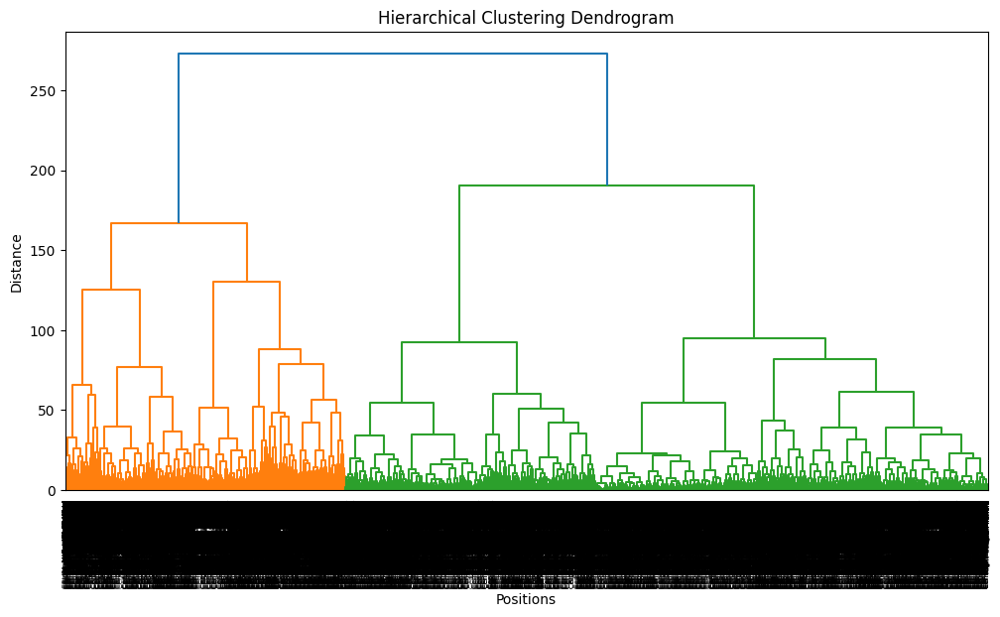

In [ ]:
from scipy.cluster.hierarchy import linkage, dendrogram

# Klasteryzacja hierarchiczna
linkage_matrix = linkage(df_scaled[stats], method='ward')
plt.figure(figsize=(12, 6))
dendrogram(linkage_matrix, labels=data11['position'].values, leaf_rotation=90)
plt.title('Hierarchical Clustering Dendrogram')
plt.xlabel('Positions')
plt.ylabel('Distance')
plt.show()

In [ ]:
# Dodanie kolumny z nazwą pozycji (oryginalnej) do danych z klastrami
df_scaled['position'] = data11['position']  # Zakładamy, że `position` to kolumna z 12 pozycjami

In [ ]:
data11['position'].unique()[:-1]

array(['Center Attacking Midfield', 'Left Wing', 'Right Wing',
       'Right Midfield', 'Left Midfield', 'Left Center Midfield',
       'Right Center Midfield', 'Center Forward', 'Left Center Forward',
       'Right Center Forward', 'Right Attacking Midfield',
       'Left Attacking Midfield', 'Center Midfield'], dtype=object)

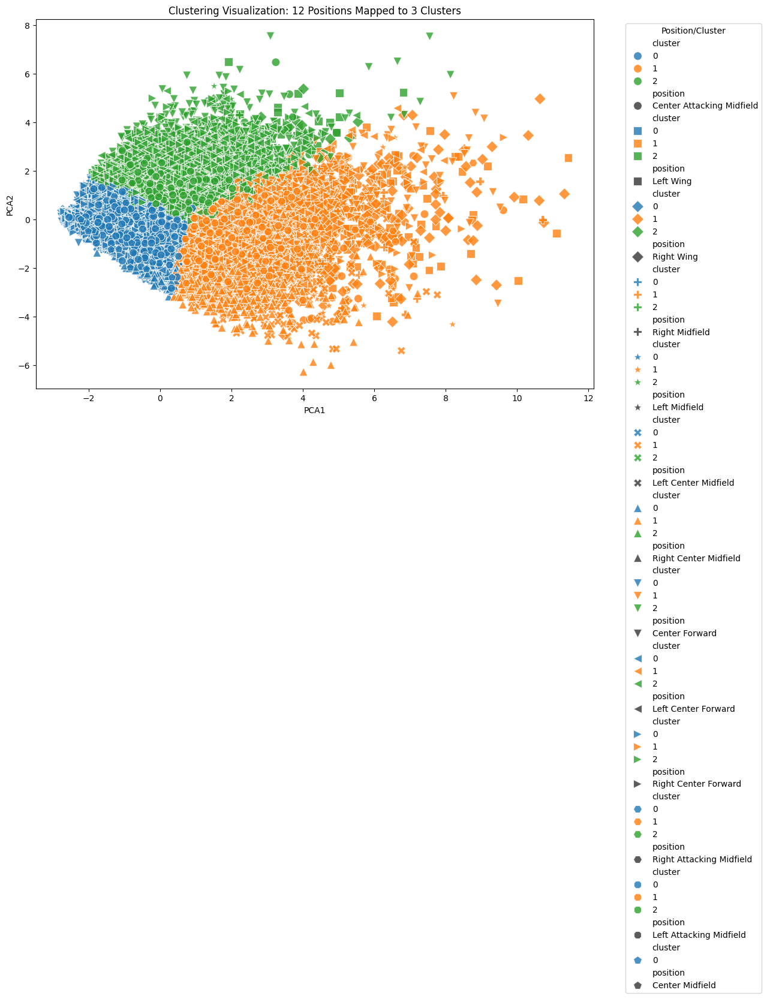

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# PCA dla redukcji do 2 wymiarów
from sklearn.decomposition import PCA
pca = PCA(n_components=2)
pca_result = pca.fit_transform(df_scaled[stats])
df_scaled['PCA1'] = pca_result[:, 0]
df_scaled['PCA2'] = pca_result[:, 1]

# Unikalne pozycje i przypisanie markerów
positions = data11['position'].unique()[:-1]
markers = ['o', 's', 'D', 'P', '*', 'X', '^', 'v', '<', '>', 'H', '8', 'p'] # Dostosuj liczbę markerów
marker_map = dict(zip(positions, markers))

# Rysowanie wykresu
plt.figure(figsize=(12, 8))
for pos in positions:
    subset = df_scaled[df_scaled['position'] == pos]
    sns.scatterplot(
        x='PCA1', y='PCA2', data=subset,
        hue='cluster',  # Kolory dla klastrów
        palette='tab10',
        style='position',  # Markery dla pozycji
        markers=marker_map,
        s=100, alpha=0.8
    )

plt.title('Clustering Visualization: 12 Positions Mapped to 3 Clusters')
plt.xlabel('PCA1')
plt.ylabel('PCA2')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', title='Position/Cluster')
plt.show()

pozycje

In [ ]:
# Grupowanie po pozycjach i obliczenie średnich statystyk
position_stats = data11.groupby('position')[['PAxG', 'xGA', 'xT+', 'shots_on_target', 
                                         'prog_carries', 'prog_pass', 
                                         'carries_into_pen', 'driblle_complete', 
                                         'good_passes']].median().reset_index()


In [ ]:
from sklearn.preprocessing import StandardScaler

# Skalowanie statystyk
scaler = StandardScaler()
position_stats_scaled = position_stats.copy()
position_stats_scaled.iloc[:, 1:] = scaler.fit_transform(position_stats.iloc[:, 1:])


In [ ]:
from sklearn.cluster import KMeans

# Klasteryzacja na 3 grupy
kmeans = KMeans(n_clusters=3, random_state=42)
position_stats_scaled['cluster'] = kmeans.fit_predict(position_stats_scaled.iloc[:, 1:])

# Dodanie grup do oryginalnych danych
position_stats['cluster'] = position_stats_scaled['cluster']


c:\Users\macie\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


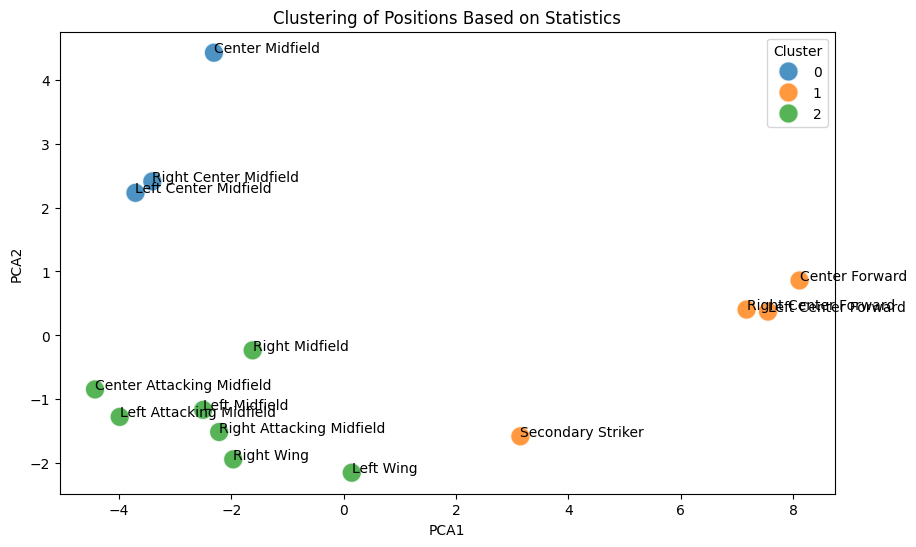

In [ ]:
from sklearn.decomposition import PCA
import seaborn as sns
import matplotlib.pyplot as plt

# PCA na 2 wymiary
pca = PCA(n_components=2)
pca_result = pca.fit_transform(position_stats_scaled.iloc[:, 1:-1])  # Bez 'position' i 'cluster'
position_stats_scaled['PCA1'] = pca_result[:, 0]
position_stats_scaled['PCA2'] = pca_result[:, 1]

# Wykres
plt.figure(figsize=(10, 6))
sns.scatterplot(data=position_stats_scaled, x='PCA1', y='PCA2', hue='cluster', 
                palette='tab10', s=200, alpha=0.8)

# Dodanie etykiet pozycji
for i in range(position_stats_scaled.shape[0]):
    plt.text(position_stats_scaled['PCA1'].iloc[i], 
             position_stats_scaled['PCA2'].iloc[i], 
             position_stats_scaled['position'].iloc[i], fontsize=10)

plt.title('Clustering of Positions Based on Statistics')
plt.xlabel('PCA1')
plt.ylabel('PCA2')
plt.legend(title='Cluster')
plt.show()


In [ ]:
print(position_stats[['position', 'cluster']])


                     position  cluster
0   Center Attacking Midfield        2
1              Center Forward        1
2             Center Midfield        0
3     Left Attacking Midfield        2
4         Left Center Forward        1
5        Left Center Midfield        0
6               Left Midfield        2
7                   Left Wing        2
8    Right Attacking Midfield        2
9        Right Center Forward        1
10      Right Center Midfield        0
11             Right Midfield        2
12                 Right Wing        2
13          Secondary Striker        1


A więc jest rozdzielone 

In [ ]:
position_stats_scaled.columns[1:-1]

Index(['PAxG', 'xGA', 'xT+', 'shots_on_target', 'prog_carries', 'prog_pass',
       'carries_into_pen', 'driblle_complete', 'good_passes', 'cluster',
       'PCA1'],
      dtype='object')

In [ ]:
# Wyświetlanie centroidów dla każdego klastra
centroids = kmeans.cluster_centers_

# Przekształcenie centroidów na DataFrame
centroid_df = pd.DataFrame(centroids, columns=position_stats_scaled.columns[1:-3])  # Bez 'position' i 'cluster'

# Wyświetlanie centroidów
print(centroid_df)


ValueError: Shape of passed values is (3, 12), indices imply (3, 9)

In [ ]:
# Odwrócenie standaryzacji (transformacja do oryginalnej skali)
centroids_original = scaler.inverse_transform(centroids)

# Tworzenie DataFrame z oryginalnymi wartościami
centroid_df_original = pd.DataFrame(centroids_original, columns=position_stats.columns[1:-1])

# Wyświetlanie wartości w oryginalnej skali
print(centroid_df_original)


           PAxG       xGA       xT+  shots_on_target  prog_carries  prog_pass  \
0  2.775558e-17  0.015779  0.122833             0.00           1.0   2.666667   
1  4.524883e-01  0.029594  0.106000             1.00           1.0   1.000000   
2  6.939790e-02  0.052524  0.203000             0.25           2.5   2.250000   

   carries_into_pen  driblle_complete  good_passes  
0               0.0          0.666667    38.833333  
1               1.0          1.000000    16.333333  
2               0.5          1.125000    25.875000  


Mamy rozdzielone, teraz sprawdźmy jak wpływa to na wyniki meczów oraz gole strzelone, stracone

data11

In [ ]:
data11

,player,team,match_id,position,Events,minute,goals,assist,PAxG,xGA,xT+,shots_on_target,prog_carries,prog_pass,carries_into_pen,driblle_complete,good_passes,driblle_failed,bad_passes,group
0,Aaron Hunt,Hamburger SV,3890286,Center Attacking Midfield,126,80.0,0.0,0.0,0.000000,0.066286,0.047,0.0,1.0,0.0,0.0,1.0,22.0,0.0,5.0,0
1,Aaron Hunt,Hamburger SV,3890297,Center Attacking Midfield,186,90.0,0.0,0.0,0.593420,0.160857,0.083,1.0,3.0,2.0,2.0,1.0,34.0,0.0,9.0,2
2,Aaron Hunt,Hamburger SV,3890304,Center Attacking Midfield,214,90.0,0.0,0.0,0.000000,0.000000,0.125,0.0,4.0,3.0,0.0,4.0,38.0,0.0,12.0,0
3,Aaron Hunt,Hamburger SV,3890317,Left Wing,184,90.0,0.0,0.0,1.037152,0.047306,0.330,2.0,3.0,4.0,2.0,2.0,35.0,1.0,10.0,2
4,Aaron Hunt,Hamburger SV,3890324,Center Attacking Midfield,169,90.0,0.0,0.0,0.654407,0.070087,0.214,1.0,3.0,4.0,0.0,2.0,30.0,1.0,7.0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
23652,Łukasz Gikiewicz,Chennaiyin,3813311,Left Center Forward,176,90.0,1.0,0.0,1.450748,0.000000,0.047,1.0,1.0,3.0,0.0,1.0,22.0,2.0,10.0,2
23653,Łukasz Gikiewicz,Chennaiyin,3817852,Right Center Forward,132,90.0,0.0,0.0,-0.160108,0.000000,0.030,0.0,1.0,1.0,0.0,1.0,10.0,0.0,11.0,0
23654,Łukasz Gikiewicz,Chennaiyin,3817858,Center Forward,104,76.0,0.0,0.0,0.000000,0.000000,0.038,0.0,1.0,1.0,1.0,0.0,12.0,0.0,10.0,0
23655,Łukasz Gikiewicz,Chennaiyin,3817868,Right Center Forward,146,90.0,0.0,0.0,-0.373380,0.097712,0.069,0.0,2.0,0.0,0.0,0.0,24.0,0.0,12.0,0


In [ ]:
data11['grouped_pos'] = data11['group'].map({0:'Midfield', 1:'Wing', 2:'Striker'})
data11.groupby('grouped_pos').size()

grouped_pos
Midfield    13585
Striker      5421
Wing         4651
dtype: int64

In [ ]:
data_corr = data11.drop(columns=['player', 'position'])

In [ ]:
data_corr2.columns[2:15]

Index(['Events_Midfield', 'Events_Striker', 'Events_Wing', 'PAxG_Midfield',
       'PAxG_Striker', 'PAxG_Wing', 'assist_Midfield', 'assist_Striker',
       'assist_Wing', 'carries_into_pen_Midfield', 'carries_into_pen_Striker',
       'carries_into_pen_Wing', 'driblle_complete_Midfield'],
      dtype='object')

In [ ]:
data_corr

,team,match_id,Events,minute,goals,assist,PAxG,xGA,xT+,shots_on_target,prog_carries,prog_pass,carries_into_pen,driblle_complete,good_passes,driblle_failed,bad_passes,group,grouped_pos
0,Hamburger SV,3890286,126,80.0,0.0,0.0,0.000000,0.066286,0.047,0.0,1.0,0.0,0.0,1.0,22.0,0.0,5.0,0,Midfield
1,Hamburger SV,3890297,186,90.0,0.0,0.0,0.593420,0.160857,0.083,1.0,3.0,2.0,2.0,1.0,34.0,0.0,9.0,2,Striker
2,Hamburger SV,3890304,214,90.0,0.0,0.0,0.000000,0.000000,0.125,0.0,4.0,3.0,0.0,4.0,38.0,0.0,12.0,0,Midfield
3,Hamburger SV,3890317,184,90.0,0.0,0.0,1.037152,0.047306,0.330,2.0,3.0,4.0,2.0,2.0,35.0,1.0,10.0,2,Striker
4,Hamburger SV,3890324,169,90.0,0.0,0.0,0.654407,0.070087,0.214,1.0,3.0,4.0,0.0,2.0,30.0,1.0,7.0,0,Midfield
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
23652,Chennaiyin,3813311,176,90.0,1.0,0.0,1.450748,0.000000,0.047,1.0,1.0,3.0,0.0,1.0,22.0,2.0,10.0,2,Striker
23653,Chennaiyin,3817852,132,90.0,0.0,0.0,-0.160108,0.000000,0.030,0.0,1.0,1.0,0.0,1.0,10.0,0.0,11.0,0,Midfield
23654,Chennaiyin,3817858,104,76.0,0.0,0.0,0.000000,0.000000,0.038,0.0,1.0,1.0,1.0,0.0,12.0,0.0,10.0,0,Midfield
23655,Chennaiyin,3817868,146,90.0,0.0,0.0,-0.373380,0.097712,0.069,0.0,2.0,0.0,0.0,0.0,24.0,0.0,12.0,0,Midfield


In [ ]:
# Tworzenie pivot_table (lub już masz te dane w dataframe)
data_corr2 = data_corr.pivot_table(
    index=['match_id', 'team'],
    columns='grouped_pos',
    values=list(data_corr.columns[2:15]),
    aggfunc='mean'  # MUSI BYĆ MEAN BO 1 TEAM MOŻE MIEĆ 10 NAPASTNIKÓW A DRUGI 1 I JAK TO PORÓWNAĆ
).reset_index().fillna(0)

# Spłaszczanie nagłówków, łącząc poziom wartości (np. PAxG, xGA) z poziomem pozycji
data_corr2.columns = ['_'.join(col).replace(' ', '_') if isinstance(col, tuple) else col for col in data_corr2.columns]

# Dodawanie kolumn różnicy (metric_grouped_pos_diff)
for col in data_corr2.columns[2:]:
    
    data_corr2[f"{col}_diff"] = data_corr2.groupby('match_id_')[col].transform(
        lambda x: x.diff().fillna(-x.diff().iloc[-1])
        )

# Wyświetlanie nowego DataFrame z kolumnami różnic
data_corr2


,match_id_,team_,Events_Midfield,Events_Striker,Events_Wing,PAxG_Midfield,PAxG_Striker,PAxG_Wing,assist_Midfield,assist_Striker,...,prog_pass_Wing_diff,shots_on_target_Midfield_diff,shots_on_target_Striker_diff,shots_on_target_Wing_diff,xGA_Midfield_diff,xGA_Striker_diff,xGA_Wing_diff,xT+_Midfield_diff,xT+_Striker_diff,xT+_Wing_diff
0,7525,Russia,118.500000,102.0,179.0,0.126253,2.734158,1.549782,0.25,0.0,...,6.0,0.500000,3.0,1.0,0.080058,-0.000000,0.406745,-0.003850,0.1790,0.713
1,7525,Saudi Arabia,160.200000,0.0,0.0,-0.022022,0.000000,0.000000,0.00,0.0,...,-6.0,-0.500000,-3.0,-1.0,-0.080058,0.000000,-0.406745,0.003850,-0.1790,-0.713
2,7529,Croatia,161.750000,0.0,229.0,-0.100603,0.000000,-0.018098,0.00,0.0,...,1.0,-0.000000,-0.0,-0.0,0.047556,-0.000000,-0.013396,0.100750,-0.0000,0.279
3,7529,Nigeria,136.500000,0.0,245.0,0.069778,0.000000,-0.028530,0.00,0.0,...,-1.0,0.000000,0.0,0.0,-0.047556,0.000000,0.013396,-0.100750,0.0000,-0.279
4,7530,Australia,105.166667,0.0,0.0,0.217165,0.000000,0.000000,0.00,0.0,...,-0.0,-0.000000,-1.5,-0.0,-0.016183,-0.214574,-0.000000,-0.133833,-0.1145,-0.000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5843,3943043,Spain,127.500000,148.0,189.0,-0.245994,0.825710,1.370716,0.00,1.0,...,2.0,-0.250000,2.0,1.0,0.140904,0.382136,0.343513,-0.013500,0.2270,0.517
5844,3943076,Canada,101.000000,0.0,133.0,0.142408,0.000000,0.000000,0.00,0.0,...,3.0,0.333333,-0.0,-0.0,0.177222,-0.000000,0.860549,0.040333,-0.0000,0.663
5845,3943076,Uruguay,91.666667,0.0,0.0,0.190572,0.000000,0.000000,0.00,0.0,...,-3.0,-0.333333,0.0,0.0,-0.177222,0.000000,-0.860549,-0.040333,0.0000,-0.663
5846,3943077,Argentina,125.666667,157.0,0.0,-0.065122,1.009454,0.000000,0.00,0.0,...,-8.0,-0.333333,1.0,-0.0,-0.037910,0.136978,-0.154129,-0.006333,0.2760,-0.600


In [ ]:
data_corr3 = data_corr2.merge(final_df, left_on=['match_id_', 'team_'], right_on=['match_id', 'team'], how='left')

In [ ]:
data_corr3 = data_corr3.drop(columns=['team', 'team_result', 'match_id','match_date'])

In [ ]:
data_corr3[data_corr3.columns[44:]]

,PAxG_Midfield_diff,PAxG_Striker_diff,PAxG_Wing_diff,assist_Midfield_diff,assist_Striker_diff,assist_Wing_diff,carries_into_pen_Midfield_diff,carries_into_pen_Striker_diff,carries_into_pen_Wing_diff,driblle_complete_Midfield_diff,...,shots_on_target_Wing_diff,xGA_Midfield_diff,xGA_Striker_diff,xGA_Wing_diff,xT+_Midfield_diff,xT+_Striker_diff,xT+_Wing_diff,goals_scored,goals_conceded,result_numeric
0,0.148275,2.734158,1.549782,0.25,-0.0,2.0,0.600000,2.0,3.0,0.300000,...,1.0,0.080058,-0.000000,0.406745,-0.003850,0.1790,0.713,5,0,1
1,-0.148275,-2.734158,-1.549782,-0.25,0.0,-2.0,-0.600000,-2.0,-3.0,-0.300000,...,-1.0,-0.080058,0.000000,-0.406745,0.003850,-0.1790,-0.713,0,5,-1
2,-0.170381,-0.000000,0.010431,-0.00,-0.0,-0.0,-0.250000,-0.0,-0.0,-0.500000,...,-0.0,0.047556,-0.000000,-0.013396,0.100750,-0.0000,0.279,2,0,1
3,0.170381,0.000000,-0.010431,0.00,0.0,0.0,0.250000,0.0,0.0,0.500000,...,0.0,-0.047556,0.000000,0.013396,-0.100750,0.0000,-0.279,0,2,-1
4,0.002146,-0.702578,-0.000000,-0.00,-0.0,-0.0,-0.333333,-1.5,-0.0,-0.000000,...,-0.0,-0.016183,-0.214574,-0.000000,-0.133833,-0.1145,-0.000,1,2,-1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5843,-0.357643,0.825710,1.370716,-0.25,1.0,0.0,-0.250000,3.0,2.0,-0.250000,...,1.0,0.140904,0.382136,0.343513,-0.013500,0.2270,0.517,2,1,1
5844,-0.048164,-0.000000,-0.000000,-0.00,-0.0,-0.0,-0.666667,-0.0,1.0,0.666667,...,-0.0,0.177222,-0.000000,0.860549,0.040333,-0.0000,0.663,2,2,0
5845,0.048164,0.000000,0.000000,0.00,0.0,0.0,0.666667,0.0,-1.0,-0.666667,...,0.0,-0.177222,0.000000,-0.860549,-0.040333,0.0000,-0.663,2,2,0
5846,-0.209128,0.322738,0.038001,-0.00,-0.0,-0.0,0.666667,-0.0,-0.0,0.333333,...,-0.0,-0.037910,0.136978,-0.154129,-0.006333,0.2760,-0.600,1,0,1


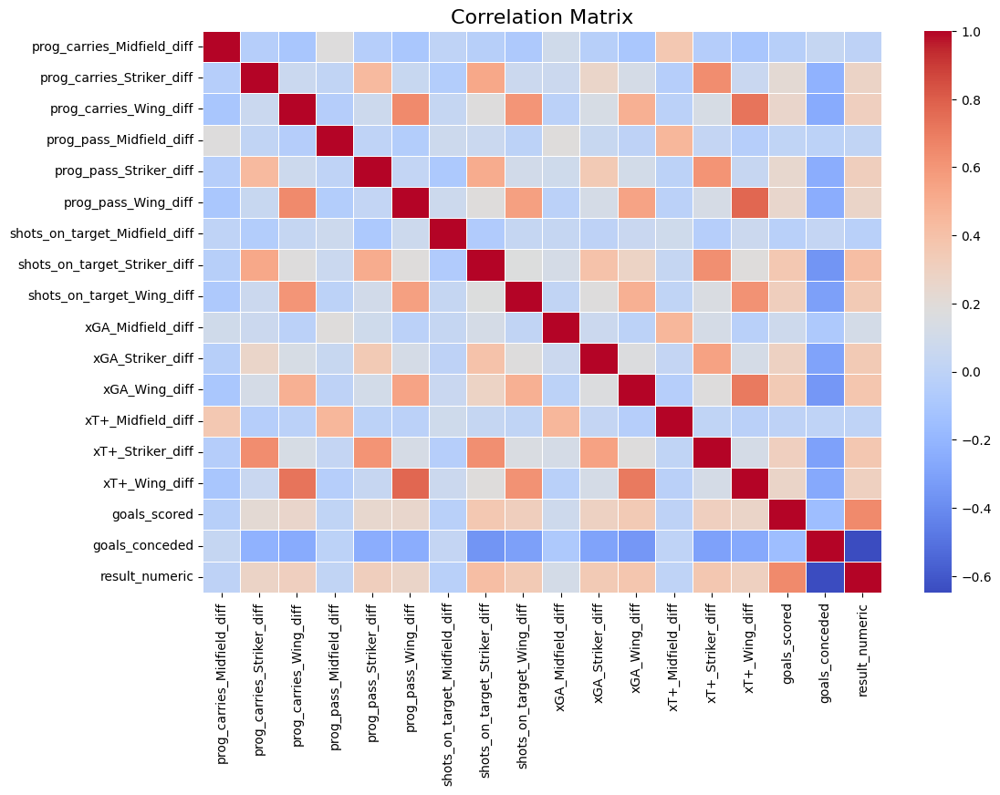

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

# Obliczenie korelacji
corr_matrix = data_corr3[list(data_corr3.columns[65:])].corr()

# Tworzenie wykresu ciepłoty
plt.figure(figsize=(12, 8))  # Możesz dostosować rozmiar wykresu
sns.heatmap(corr_matrix, annot=False, cmap='coolwarm', fmt='.2f', linewidths=0.5)

# Dodanie tytułu
plt.title('Correlation Matrix', fontsize=16)

# Wyświetlanie wykresu
plt.show()


Niestety statystyki pomocników nie mają istotnej korelacji z wynikiem, więc zostawiamy. Badamy skrzydłowych, pomocników ofensywnych oraz napastników.

Należy zbadać wpływ każdej z pozycji na wynik, wtedy będziemy mieć jasność.
A także wpływ danych czynników na wynik. (zrobione, ale oficjalnie).
Żeby wyszło, że paxg, xga, xT mają największy wpływ na wynik, a następnie że największy wpływ na wynik biorąc pod uwagę te statystyki mają Napastnicy i Skrzydłowi, Pomocnicy Ofensywni.

Chcę także na podstawie wag, które zostaną ustalone do modelu, zobaczyć jak pokrywa się to z miejscem w tabeli.
- za pomocą moich statystyk z wagami ustalić miejsce drużyny w tabeli
- sprawdzić jak to zrobi jakiś random forest (jakie wagi sam ustali) itd i porównać

Kiedy będę miał już model oceniający to mogę dopasować średnią wag i przedziały i porównać np. z sofą/flashsocrem np. biorąc pod uwagę cały turniej wc22 (będzie około 100 ocen), a następnie za pomocą random foresta jakiegoś zobaczyć jakie oni wagi dają do statystyk (moich).

W takim razie zobaczmy jaki wpływ dana statystyka ma na wynik, weźmy wszystkie statystyki. Także te defensywne. Stwórzmy także statystyki:
- forward_passes (w metrach ile jest bliżej bramki)

In [ ]:
t = test_m[0]

In [ ]:
# Filtrowanie tylko raz dla odpowiednich wierszy
pass_mask = (match['type'] == "Pass") & (match['pass_outcome'].isna())
for match in matches:

# Obliczanie różnicy dla przefiltrowanych wierszy
    match.loc[pass_mask, 'forward_pass'] = match.loc[pass_mask, 'pass_end_x'] - match.loc[pass_mask, 'x']

# Tworzenie nowej kolumny z warunkiem
    match['forward_pass+'] = match['forward_pass'].clip(lower=0)


C:\Users\macie\AppData\Local\Temp\ipykernel_30508\3659064183.py:6: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  match.loc[pass_mask, 'forward_pass'] = match.loc[pass_mask, 'pass_end_x'] - match.loc[pass_mask, 'x']
C:\Users\macie\AppData\Local\Temp\ipykernel_30508\3659064183.py:9: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  match['forward_pass+'] = match['forward_pass'].clip(lower=0)
C:\Users\macie\AppData\Local\Temp\ipykernel_30508\3659064183.py:6: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

Mamy utworzone. W takim razie zajmijmy się metrykami i ich wpływem na wynik meczu.
Stwórzmy dataframe, w którym będzie:
- match_id
- team
- position
- numeric_result
- goal_scored
- goal_conceded
- statystyki

Sprawdzimy, co ma jaką korelację itd...
Następnie zobaczymy 

np. xGA = 0.72 - duża korelacja
jak zobaczyć jakie pozycje uczestniczą w tej korelacji najbardziej?

Zobaczmy więc co ma wpływ na wyniki meczów (wszystkie statystyki)
Pamiętając o standaryzacji
Struktura:
match_id team paxg_diff result_numeric
Może faktycznie lepiej procentowe różnice niż liczbowe?
Sprawdźmy na przykładzie (paxg i passes)

Liczbowe

In [ ]:
players_test = players4

In [ ]:
players4

,player,team,match_id,position,Events,minute,goals,assist
0,Aaron Cresswell,West Ham United,3753973,Left Back,110,90.0,0.0,0.0
1,Aaron Cresswell,West Ham United,3753984,Left Back,101,90.0,0.0,1.0
2,Aaron Cresswell,West Ham United,3753997,Left Back,267,90.0,0.0,0.0
3,Aaron Cresswell,West Ham United,3754021,Left Back,126,90.0,0.0,0.0
4,Aaron Cresswell,West Ham United,3754067,Left Back,197,90.0,0.0,0.0
...,...,...,...,...,...,...,...,...
60726,Žan Karničnik,Slovenia,3941020,Right Back,108,90.0,0.0,0.0
60727,Željko Brkić,Carpi,3878545,Goalkeeper,65,90.0,0.0,0.0
60728,Željko Brkić,Carpi,3878552,Goalkeeper,49,90.0,0.0,0.0
60729,Željko Brkić,Carpi,3879539,Goalkeeper,54,62.0,0.0,0.0


In [ ]:
td1 = players4.merge(paxg_df, on=['match_id', 'player', 'team', 'position'], how='left').fillna(0)

In [ ]:
good_passes_df2

,player,match_id,good_passes
0,Alexis Mac Allister,3943077,52
1,Camilo Andrés Vargas Gil,3943077,28
2,Carlos Eccehomo Cuesta Figueroa,3943077,40
3,Cristian Gabriel Romero,3943077,32
4,Damián Emiliano Martínez,3943077,29
...,...,...,...
81144,Raymond Kopaszewski Wlodarczyck,3888704,31
81145,Robert Jonquet,3888704,12
81146,Roger Piantoni,3888704,21
81147,Waldyr Pereira,3888704,53


In [ ]:
td2 = td1.merge(good_passes_df2, on=['match_id', 'player'], how='left').fillna(0)

In [ ]:
xga_df

,player,match_id,team,position,xGA
0,Alexis Mac Allister,3943077,Argentina,Left Defensive Midfield,0.065693
1,Cristian Gabriel Romero,3943077,Argentina,Right Center Back,0.262910
2,Gonzalo Ariel Montiel,3943077,Argentina,Right Back,0.072140
3,James David Rodríguez Rubio,3943077,Colombia,Center Attacking Midfield,0.154129
4,Jefferson Andrés Lerma Solís,3943077,Colombia,Center Defensive Midfield,0.156862
...,...,...,...,...,...
33247,Orlando Peçanha de Carvalho,3888704,Brazil,Left Center Back,0.015904
33248,Raymond Kopaszewski Wlodarczyck,3888704,France,Left Center Forward,0.756699
33249,Waldyr Pereira,3888704,Brazil,Left Defensive Midfield,0.367871
33250,Édson Arantes do Nascimento,3888704,Brazil,Center Forward,0.031623


In [ ]:
td3 = td2.groupby(['match_id', 'team'])[['PAxG', 'good_passes']].sum().reset_index()

In [ ]:
td3

,match_id,team,PAxG,good_passes
0,7525,Russia,4.763959,246.0
1,7525,Saudi Arabia,-0.209112,451.0
2,7529,Croatia,-0.432150,351.0
3,7529,Nigeria,0.751728,314.0
4,7530,Australia,1.248573,335.0
...,...,...,...,...
5843,3943043,Spain,2.128261,460.0
5844,3943076,Canada,1.863967,251.0
5845,3943076,Uruguay,0.326534,214.0
5846,3943077,Argentina,0.729743,355.0


In [ ]:
td3["PAxG_diff_num"] = td3.groupby('match_id')["PAxG"].transform(lambda x: x.diff().fillna(-x.diff().iloc[-1]))
td3["good_passes_diff_num"] = td3.groupby('match_id')["good_passes"].transform(lambda x: x.diff().fillna(-x.diff().iloc[-1]))

In [ ]:
td3["PAxG_diff_percent"] = td3.groupby('match_id')["PAxG"].transform(
    lambda x: (x.diff() / x.max()).fillna(-x.diff().iloc[-1] / x.max()) * 100
)

td3["good_passes_diff_percent"] = td3.groupby('match_id')["good_passes"].transform(
    lambda x: (x.diff() / x.max()).fillna(-x.diff().iloc[-1] / x.max()) * 100
)

C:\Users\macie\AppData\Local\Temp\ipykernel_30508\3300200519.py:2: RuntimeWarning: divide by zero encountered in scalar divide
  lambda x: (x.diff() / x.max()).fillna(-x.diff().iloc[-1] / x.max()) * 100


In [ ]:
td_corr = td3.merge(final_df[['match_id', 'team', 'result_numeric']], on=['match_id', 'team'], how='left')

In [ ]:
td_corr

,match_id,team,PAxG,good_passes,PAxG_diff_num,good_passes_diff_num,PAxG_diff_percent,good_passes_diff_percent,result_numeric
0,7525,Russia,4.763959,246.0,4.973072,-205.0,104.389461,-45.454545,1
1,7525,Saudi Arabia,-0.209112,451.0,-4.973072,205.0,-104.389461,45.454545,-1
2,7529,Croatia,-0.432150,351.0,-1.183878,37.0,-157.487652,10.541311,1
3,7529,Nigeria,0.751728,314.0,1.183878,-37.0,157.487652,-10.541311,-1
4,7530,Australia,1.248573,335.0,-0.655705,-90.0,-34.433264,-21.176471,-1
...,...,...,...,...,...,...,...,...,...
5843,3943043,Spain,2.128261,460.0,1.287280,213.0,60.485042,46.304348,1
5844,3943076,Canada,1.863967,251.0,1.537433,37.0,82.481757,14.741036,0
5845,3943076,Uruguay,0.326534,214.0,-1.537433,-37.0,-82.481757,-14.741036,0
5846,3943077,Argentina,0.729743,355.0,-1.374538,-58.0,-65.321036,-14.043584,1


In [ ]:
td_corr[td_corr.columns[3:]].corr()

,good_passes,PAxG_diff_num,good_passes_diff_num,PAxG_diff_percent,good_passes_diff_percent,result_numeric
good_passes,1.000000,0.366358,0.877835,0.210018,0.854103,0.280965
PAxG_diff_num,0.366358,1.000000,0.417342,0.552899,0.378898,0.685742
good_passes_diff_num,0.877835,0.417342,1.000000,0.239250,0.972965,0.320066
PAxG_diff_percent,0.210018,0.552899,0.239250,1.000000,0.213791,0.420283
good_passes_diff_percent,0.854103,0.378898,0.972965,0.213791,1.000000,0.285915
result_numeric,0.280965,0.685742,0.320066,0.420283,0.285915,1.000000


Teraz już wiemy żeby wziąć różnicę procentową.
Czas przejść do stworzenia ramki danych o strukturze:
match_id
result_numeric
statystyki_diff_percent
statystyki_diff_pos_percent
i korelacji

Zobaczmy jednak narazie wpływy oprócz korelacji na wynik

In [ ]:
from sklearn.preprocessing import StandardScaler

# Wybór kolumn do standaryzacji
columns_to_scale = ["PAxG_diff_percent", "good_passes_diff_percent"]

# Standaryzacja danych
scaler = StandardScaler()
td_corr[columns_to_scale] = td_corr[columns_to_scale].replace([float('inf'), float('-inf')], 0)
td_corr = td_corr.fillna(0)
td_corr[columns_to_scale] = scaler.fit_transform(td_corr[columns_to_scale])


In [ ]:
td_corr

,match_id,team,PAxG,good_passes,PAxG_diff_num,good_passes_diff_num,PAxG_diff_percent,good_passes_diff_percent,result_numeric
0,7525,Russia,4.763959,246.0,4.973072,-205.0,0.936207,-1.039219,1
1,7525,Saudi Arabia,-0.209112,451.0,-4.973072,205.0,-0.936207,1.039219,-1
2,7529,Croatia,-0.432150,351.0,-1.183878,37.0,-1.412414,0.241004,1
3,7529,Nigeria,0.751728,314.0,1.183878,-37.0,1.412414,-0.241004,-1
4,7530,Australia,1.248573,335.0,-0.655705,-90.0,-0.308812,-0.484154,-1
...,...,...,...,...,...,...,...,...,...
5843,3943043,Spain,2.128261,460.0,1.287280,213.0,0.542455,1.058648,1
5844,3943076,Canada,1.863967,251.0,1.537433,37.0,0.739730,0.337022,0
5845,3943076,Uruguay,0.326534,214.0,-1.537433,-37.0,-0.739730,-0.337022,0
5846,3943077,Argentina,0.729743,355.0,-1.374538,-58.0,-0.585826,-0.321076,1


In [ ]:
import statsmodels.api as sm

# Zmienne niezależne (różnice procentowe)
X = td_corr[["PAxG_diff_percent", "good_passes_diff_percent"]]
X = sm.add_constant(X)  # Dodanie stałej (biasu) do modelu

# Zmienna zależna (rezultat meczu)
y = td_corr["result_numeric"]

# Regresja liniowa
model = sm.OLS(y, X).fit()
print(model.summary())


                            OLS Regression Results                            
Dep. Variable:         result_numeric   R-squared:                       0.217
Model:                            OLS   Adj. R-squared:                  0.217
Method:                 Least Squares   F-statistic:                     809.2
Date:                Thu, 09 Jan 2025   Prob (F-statistic):          5.71e-311
Time:                        18:21:25   Log-Likelihood:                -6773.9
No. Observations:                5848   AIC:                         1.355e+04
Df Residuals:                    5845   BIC:                         1.357e+04
Df Model:                           2                                         
Covariance Type:            nonrobust                                         
                               coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------------
const                   

In [ ]:
td2

,player,team,match_id,position,Events,minute,goals,assist,PAxG,good_passes
0,Aaron Cresswell,West Ham United,3753973,Left Back,110,90.0,0.0,0.0,-0.088625,22.0
1,Aaron Cresswell,West Ham United,3753984,Left Back,101,90.0,0.0,1.0,0.607445,22.0
2,Aaron Cresswell,West Ham United,3753997,Left Back,267,90.0,0.0,0.0,-0.051703,76.0
3,Aaron Cresswell,West Ham United,3754021,Left Back,126,90.0,0.0,0.0,0.000000,31.0
4,Aaron Cresswell,West Ham United,3754067,Left Back,197,90.0,0.0,0.0,-0.051984,57.0
...,...,...,...,...,...,...,...,...,...,...
60726,Žan Karničnik,Slovenia,3941020,Right Back,108,90.0,0.0,0.0,0.000000,24.0
60727,Željko Brkić,Carpi,3878545,Goalkeeper,65,90.0,0.0,0.0,0.000000,13.0
60728,Željko Brkić,Carpi,3878552,Goalkeeper,49,90.0,0.0,0.0,0.000000,12.0
60729,Željko Brkić,Carpi,3879539,Goalkeeper,54,62.0,0.0,0.0,0.000000,13.0


In [ ]:
td2_corr = td2.drop(columns=["player"])

In [ ]:
td2_corr.columns[7:9]

Index(['PAxG', 'good_passes'], dtype='object')

In [ ]:
td2_corr

,team,match_id,position,Events,minute,goals,assist,PAxG,good_passes
0,West Ham United,3753973,Left Back,110,90.0,0.0,0.0,-0.088625,22.0
1,West Ham United,3753984,Left Back,101,90.0,0.0,1.0,0.607445,22.0
2,West Ham United,3753997,Left Back,267,90.0,0.0,0.0,-0.051703,76.0
3,West Ham United,3754021,Left Back,126,90.0,0.0,0.0,0.000000,31.0
4,West Ham United,3754067,Left Back,197,90.0,0.0,0.0,-0.051984,57.0
...,...,...,...,...,...,...,...,...,...
60726,Slovenia,3941020,Right Back,108,90.0,0.0,0.0,0.000000,24.0
60727,Carpi,3878545,Goalkeeper,65,90.0,0.0,0.0,0.000000,13.0
60728,Carpi,3878552,Goalkeeper,49,90.0,0.0,0.0,0.000000,12.0
60729,Carpi,3879539,Goalkeeper,54,62.0,0.0,0.0,0.000000,13.0


In [ ]:
td2_corr = td2_corr.pivot_table(
    index=['match_id', 'team'],
    columns='position',
    values=list(td2_corr.columns[7:9]),
    aggfunc='mean'  # MUSI BYĆ MEAN BO 1 TEAM MOŻE MIEĆ 10 NAPASTNIKÓW A DRUGI 1 I JAK TO PORÓWNAĆ
).reset_index().fillna(0)

# Spłaszczanie nagłówków, łącząc poziom wartości (np. PAxG, xGA) z poziomem pozycji
td2_corr.columns = ['_'.join(col).replace(' ', '_') if isinstance(col, tuple) else col for col in td2_corr.columns]

# Dodawanie kolumn różnicy (metric_grouped_pos_diff)
for col in td2_corr.columns[2:]:
    
    td2_corr[f"{col}_diff"] = td2_corr.groupby('match_id_')[col].transform(
        lambda x: (x.diff() / x.max()).fillna(-x.diff().iloc[-1] / x.max()) * 100
        )

# Wyświetlanie nowego DataFrame z kolumnami różnic
td2_corr

C:\Users\macie\AppData\Local\Temp\ipykernel_30508\29249847.py:15: RuntimeWarning: invalid value encountered in scalar divide
  lambda x: (x.diff() / x.max()).fillna(-x.diff().iloc[-1] / x.max()) * 100
C:\Users\macie\AppData\Local\Temp\ipykernel_30508\29249847.py:15: RuntimeWarning: divide by zero encountered in scalar divide
  lambda x: (x.diff() / x.max()).fillna(-x.diff().iloc[-1] / x.max()) * 100
C:\Users\macie\AppData\Local\Temp\ipykernel_30508\29249847.py:15: RuntimeWarning: invalid value encountered in scalar divide
  lambda x: (x.diff() / x.max()).fillna(-x.diff().iloc[-1] / x.max()) * 100
C:\Users\macie\AppData\Local\Temp\ipykernel_30508\29249847.py:15: RuntimeWarning: divide by zero encountered in scalar divide
  lambda x: (x.diff() / x.max()).fillna(-x.diff().iloc[-1] / x.max()) * 100
C:\Users\macie\AppData\Local\Temp\ipykernel_30508\29249847.py:15: RuntimeWarning: invalid value encountered in scalar divide
  lambda x: (x.diff() / x.max()).fillna(-x.diff().iloc[-1] / x.max())

,match_id_,team_,PAxG_Center_Attacking_Midfield,PAxG_Center_Back,PAxG_Center_Defensive_Midfield,PAxG_Center_Forward,PAxG_Center_Midfield,PAxG_Goalkeeper,PAxG_Left_Attacking_Midfield,PAxG_Left_Back,...,good_passes_Right_Attacking_Midfield_diff,good_passes_Right_Back_diff,good_passes_Right_Center_Back_diff,good_passes_Right_Center_Forward_diff,good_passes_Right_Center_Midfield_diff,good_passes_Right_Defensive_Midfield_diff,good_passes_Right_Midfield_diff,good_passes_Right_Wing_diff,good_passes_Right_Wing_Back_diff,good_passes_Secondary_Striker_diff
0,7525,Russia,1.549782,0.0,0.000000,0.000000,0.0,0.0,0.0,-0.024991,...,NaN,-32.758621,-48.000000,NaN,-16.666667,NaN,-52.941176,NaN,NaN,NaN
1,7525,Saudi Arabia,0.000000,0.0,0.000000,-0.052533,0.0,0.0,0.0,-0.099003,...,NaN,32.758621,48.000000,NaN,16.666667,NaN,52.941176,NaN,NaN,NaN
2,7529,Croatia,0.000000,0.0,0.000000,-0.312208,0.0,0.0,0.0,0.000000,...,NaN,11.428571,10.416667,NaN,29.090909,NaN,NaN,46.875000,NaN,NaN
3,7529,Nigeria,0.000000,0.0,0.000000,0.429272,0.0,0.0,0.0,0.000000,...,NaN,-11.428571,-10.416667,NaN,-29.090909,NaN,NaN,-46.875000,NaN,NaN
4,7530,Australia,0.000000,0.0,0.000000,0.000000,0.0,0.0,0.0,-0.011939,...,NaN,-57.407407,-25.000000,NaN,-47.368421,NaN,100.000000,-100.000000,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5843,3943043,Spain,-0.211114,0.0,0.000000,-0.280875,0.0,0.0,0.0,0.000000,...,NaN,42.857143,62.500000,NaN,NaN,-100.0,NaN,12.500000,NaN,NaN
5844,3943076,Canada,0.306809,0.0,0.000000,0.120414,0.0,0.0,0.0,-0.008911,...,NaN,-29.629630,-69.565217,NaN,-100.000000,100.0,NaN,68.421053,NaN,NaN
5845,3943076,Uruguay,0.000000,0.0,0.000000,0.000000,0.0,0.0,0.0,0.000000,...,NaN,29.629630,69.565217,NaN,100.000000,-100.0,NaN,-68.421053,NaN,NaN
5846,3943077,Argentina,0.000000,0.0,0.000000,0.000000,0.0,0.0,0.0,-0.045272,...,NaN,-30.000000,-42.857143,62.962963,-100.000000,100.0,100.000000,NaN,NaN,NaN


In [ ]:
td2_corr2 = td2_corr.merge(final_df[['match_id', 'team', 'result_numeric']], left_on=['match_id_', 'team_'], right_on=['match_id', 'team'], how='left')

In [ ]:
td2_corr2 = td2_corr2.drop(columns=['match_id', 'team'])

In [ ]:
td2_corr2 = td2_corr2.fillna(0)

In [ ]:
td2_corr2.columns

Index(['match_id_', 'team_', 'PAxG_Center_Attacking_Midfield',
       'PAxG_Center_Back', 'PAxG_Center_Defensive_Midfield',
       'PAxG_Center_Forward', 'PAxG_Center_Midfield', 'PAxG_Goalkeeper',
       'PAxG_Left_Attacking_Midfield', 'PAxG_Left_Back',
       ...
       'good_passes_Right_Back_diff', 'good_passes_Right_Center_Back_diff',
       'good_passes_Right_Center_Forward_diff',
       'good_passes_Right_Center_Midfield_diff',
       'good_passes_Right_Defensive_Midfield_diff',
       'good_passes_Right_Midfield_diff', 'good_passes_Right_Wing_diff',
       'good_passes_Right_Wing_Back_diff',
       'good_passes_Secondary_Striker_diff', 'result_numeric'],
      dtype='object', length=103)

In [ ]:
list(list(td2_corr2.columns[52:77]) + [td2_corr2.columns[-1]])

['PAxG_Center_Attacking_Midfield_diff',
 'PAxG_Center_Back_diff',
 'PAxG_Center_Defensive_Midfield_diff',
 'PAxG_Center_Forward_diff',
 'PAxG_Center_Midfield_diff',
 'PAxG_Goalkeeper_diff',
 'PAxG_Left_Attacking_Midfield_diff',
 'PAxG_Left_Back_diff',
 'PAxG_Left_Center_Back_diff',
 'PAxG_Left_Center_Forward_diff',
 'PAxG_Left_Center_Midfield_diff',
 'PAxG_Left_Defensive_Midfield_diff',
 'PAxG_Left_Midfield_diff',
 'PAxG_Left_Wing_diff',
 'PAxG_Left_Wing_Back_diff',
 'PAxG_Right_Attacking_Midfield_diff',
 'PAxG_Right_Back_diff',
 'PAxG_Right_Center_Back_diff',
 'PAxG_Right_Center_Forward_diff',
 'PAxG_Right_Center_Midfield_diff',
 'PAxG_Right_Defensive_Midfield_diff',
 'PAxG_Right_Midfield_diff',
 'PAxG_Right_Wing_diff',
 'PAxG_Right_Wing_Back_diff',
 'PAxG_Secondary_Striker_diff',
 'result_numeric']

In [ ]:
td2_corr2[list(list(td2_corr2.columns[52:77]) + [td2_corr2.columns[-1]])].corr().iloc[-1].reset_index().fillna(0).sort_values(by='result_numeric')

,index,result_numeric
4,PAxG_Center_Midfield_diff,0.000000
5,PAxG_Goalkeeper_diff,0.000000
24,PAxG_Secondary_Striker_diff,0.000000
11,PAxG_Left_Defensive_Midfield_diff,0.024781
16,PAxG_Right_Back_diff,0.025197
17,PAxG_Right_Center_Back_diff,0.026173
1,PAxG_Center_Back_diff,0.035100
12,PAxG_Left_Midfield_diff,0.040429
7,PAxG_Left_Back_diff,0.040923
20,PAxG_Right_Defensive_Midfield_diff,0.041019


In [ ]:
td2_corr

,match_id_,team_,PAxG_Center_Attacking_Midfield,PAxG_Center_Back,PAxG_Center_Defensive_Midfield,PAxG_Center_Forward,PAxG_Center_Midfield,PAxG_Goalkeeper,PAxG_Left_Attacking_Midfield,PAxG_Left_Back,...,good_passes_Right_Attacking_Midfield_diff,good_passes_Right_Back_diff,good_passes_Right_Center_Back_diff,good_passes_Right_Center_Forward_diff,good_passes_Right_Center_Midfield_diff,good_passes_Right_Defensive_Midfield_diff,good_passes_Right_Midfield_diff,good_passes_Right_Wing_diff,good_passes_Right_Wing_Back_diff,good_passes_Secondary_Striker_diff
0,7525,Russia,1.549782,0.0,0.000000,0.000000,0.0,0.0,0.0,-0.024991,...,NaN,-32.758621,-48.000000,NaN,-16.666667,NaN,-52.941176,NaN,NaN,NaN
1,7525,Saudi Arabia,0.000000,0.0,0.000000,-0.052533,0.0,0.0,0.0,-0.099003,...,NaN,32.758621,48.000000,NaN,16.666667,NaN,52.941176,NaN,NaN,NaN
2,7529,Croatia,0.000000,0.0,0.000000,-0.312208,0.0,0.0,0.0,0.000000,...,NaN,11.428571,10.416667,NaN,29.090909,NaN,NaN,46.875000,NaN,NaN
3,7529,Nigeria,0.000000,0.0,0.000000,0.429272,0.0,0.0,0.0,0.000000,...,NaN,-11.428571,-10.416667,NaN,-29.090909,NaN,NaN,-46.875000,NaN,NaN
4,7530,Australia,0.000000,0.0,0.000000,0.000000,0.0,0.0,0.0,-0.011939,...,NaN,-57.407407,-25.000000,NaN,-47.368421,NaN,100.000000,-100.000000,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5843,3943043,Spain,-0.211114,0.0,0.000000,-0.280875,0.0,0.0,0.0,0.000000,...,NaN,42.857143,62.500000,NaN,NaN,-100.0,NaN,12.500000,NaN,NaN
5844,3943076,Canada,0.306809,0.0,0.000000,0.120414,0.0,0.0,0.0,-0.008911,...,NaN,-29.629630,-69.565217,NaN,-100.000000,100.0,NaN,68.421053,NaN,NaN
5845,3943076,Uruguay,0.000000,0.0,0.000000,0.000000,0.0,0.0,0.0,0.000000,...,NaN,29.629630,69.565217,NaN,100.000000,-100.0,NaN,-68.421053,NaN,NaN
5846,3943077,Argentina,0.000000,0.0,0.000000,0.000000,0.0,0.0,0.0,-0.045272,...,NaN,-30.000000,-42.857143,62.962963,-100.000000,100.0,100.000000,NaN,NaN,NaN


In [ ]:
td2_plot = td2_corr2[list(list(td2_corr2.columns[52:77]) + [td2_corr2.columns[-1]])]

In [ ]:
td2_plot.replace([float('inf'), float('-inf')], 0, inplace=True)

C:\Users\macie\AppData\Local\Temp\ipykernel_30508\568472088.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  td2_plot.replace([float('inf'), float('-inf')], 0, inplace=True)


In [ ]:
td2_plot

,PAxG_Center_Attacking_Midfield_diff,PAxG_Center_Back_diff,PAxG_Center_Defensive_Midfield_diff,PAxG_Center_Forward_diff,PAxG_Center_Midfield_diff,PAxG_Goalkeeper_diff,PAxG_Left_Attacking_Midfield_diff,PAxG_Left_Back_diff,PAxG_Left_Center_Back_diff,PAxG_Left_Center_Forward_diff,...,PAxG_Right_Back_diff,PAxG_Right_Center_Back_diff,PAxG_Right_Center_Forward_diff,PAxG_Right_Center_Midfield_diff,PAxG_Right_Defensive_Midfield_diff,PAxG_Right_Midfield_diff,PAxG_Right_Wing_diff,PAxG_Right_Wing_Back_diff,PAxG_Secondary_Striker_diff,result_numeric
0,100.000000,0.0,0.0,0.000000,0.0,0.0,0.0,-296.149030,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.000000,0.0,0.0,1
1,-100.000000,0.0,0.0,0.000000,0.0,0.0,0.0,296.149030,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.000000,0.0,0.0,-1
2,0.000000,0.0,0.0,-172.729668,0.0,0.0,0.0,0.000000,-100.000000,0.000000,...,0.000000,0.000000,0.000000,0.0,0.0,0.0,-140.363626,0.0,0.0,1
3,0.000000,0.0,0.0,172.729668,0.0,0.0,0.0,0.000000,100.000000,0.000000,...,0.000000,0.000000,0.000000,0.0,0.0,0.0,140.363626,0.0,0.0,-1
4,0.000000,0.0,0.0,-100.000000,0.0,0.0,0.0,-813.831897,0.000000,0.000000,...,42.325769,0.000000,0.000000,100.0,0.0,100.0,-100.000000,0.0,0.0,-1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5843,-138.683805,0.0,0.0,510.165541,0.0,0.0,0.0,0.000000,-17.077596,0.000000,...,0.000000,0.000000,0.000000,0.0,0.0,0.0,100.000000,0.0,0.0,1
5844,100.000000,0.0,0.0,100.000000,0.0,0.0,0.0,0.000000,19.800925,0.000000,...,0.000000,-219.462822,0.000000,0.0,100.0,0.0,0.000000,0.0,0.0,0
5845,-100.000000,0.0,0.0,-100.000000,0.0,0.0,0.0,0.000000,-19.800925,0.000000,...,0.000000,219.462822,0.000000,0.0,-100.0,0.0,0.000000,0.0,0.0,0
5846,0.000000,0.0,-100.0,0.000000,0.0,0.0,0.0,0.000000,-100.000000,-110.076657,...,0.000000,0.000000,-51.915151,-100.0,0.0,0.0,0.000000,0.0,0.0,1


In [ ]:
td2_plot.columns[:-1]

Index(['PAxG_Center_Attacking_Midfield_diff', 'PAxG_Center_Back_diff',
       'PAxG_Center_Defensive_Midfield_diff', 'PAxG_Center_Forward_diff',
       'PAxG_Center_Midfield_diff', 'PAxG_Goalkeeper_diff',
       'PAxG_Left_Attacking_Midfield_diff', 'PAxG_Left_Back_diff',
       'PAxG_Left_Center_Back_diff', 'PAxG_Left_Center_Forward_diff',
       'PAxG_Left_Center_Midfield_diff', 'PAxG_Left_Defensive_Midfield_diff',
       'PAxG_Left_Midfield_diff', 'PAxG_Left_Wing_diff',
       'PAxG_Left_Wing_Back_diff', 'PAxG_Right_Attacking_Midfield_diff',
       'PAxG_Right_Back_diff', 'PAxG_Right_Center_Back_diff',
       'PAxG_Right_Center_Forward_diff', 'PAxG_Right_Center_Midfield_diff',
       'PAxG_Right_Defensive_Midfield_diff', 'PAxG_Right_Midfield_diff',
       'PAxG_Right_Wing_diff', 'PAxG_Right_Wing_Back_diff',
       'PAxG_Secondary_Striker_diff'],
      dtype='object')

In [ ]:
columns = ['PAxG_Center_Attacking_Midfield_diff',
       'PAxG_Center_Forward_diff',
       'PAxG_Left_Attacking_Midfield_diff',
       'PAxG_Left_Center_Forward_diff',
       'PAxG_Left_Center_Midfield_diff',
       'PAxG_Left_Midfield_diff', 'PAxG_Left_Wing_diff',
       'PAxG_Left_Wing_Back_diff', 'PAxG_Right_Attacking_Midfield_diff',
       'PAxG_Right_Center_Forward_diff', 'PAxG_Right_Center_Midfield_diff',
        'PAxG_Right_Midfield_diff',
       'PAxG_Right_Wing_diff', 'PAxG_Right_Wing_Back_diff',
       'PAxG_Secondary_Striker_diff']

In [ ]:
import statsmodels.api as sm

# Definiowanie zmiennych zależnych (y) i niezależnych (X)
X = td2_plot[columns]  # Lista wszystkich kolumn z różnicami

y = td2_plot['result_numeric']  # Zmienna zależna - wynik meczu

# Dodanie stałej (intercept) do modelu
X = sm.add_constant(X)

# Regresja OLS
model = sm.OLS(y, X).fit()

# Wyniki regresji
print(model.summary())


                            OLS Regression Results                            
Dep. Variable:         result_numeric   R-squared:                       0.182
Model:                            OLS   Adj. R-squared:                  0.180
Method:                 Least Squares   F-statistic:                     86.58
Date:                Thu, 09 Jan 2025   Prob (F-statistic):          6.90e-241
Time:                        21:17:50   Log-Likelihood:                -6900.7
No. Observations:                5848   AIC:                         1.383e+04
Df Residuals:                    5832   BIC:                         1.394e+04
Df Model:                          15                                         
Covariance Type:            nonrobust                                         
                                          coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------------------------------
co

In [ ]:
td2_corr2[list(columns + [td2_corr2.columns[-1]])].corr().iloc[-1].reset_index().fillna(0).sort_values(by='result_numeric')

,index,result_numeric
14,PAxG_Secondary_Striker_diff,0.000000
5,PAxG_Left_Midfield_diff,0.040429
2,PAxG_Left_Attacking_Midfield_diff,0.064357
8,PAxG_Right_Attacking_Midfield_diff,0.065900
7,PAxG_Left_Wing_Back_diff,0.068660
11,PAxG_Right_Midfield_diff,0.072123
13,PAxG_Right_Wing_Back_diff,0.080371
9,PAxG_Right_Center_Forward_diff,0.088325
10,PAxG_Right_Center_Midfield_diff,0.091386
3,PAxG_Left_Center_Forward_diff,0.098714


Można jeszcze sprawdzić boxploty.
Widać że istotne są zmienne:
- Center_Attacking_Midfield
- Center_Forward
- ...

Chcę mieć macierz korelacji każdej z metryk z rezultatem końcowym
(narazie bez pozycji)

In [ ]:
columns2 = ['Center Attacking Midfield', 'Center Forward', 'Left Attacking Midfield', 'Left Center Forward', 'Left Center Midfield', 'Left Midfield', 'Left Wing', 'Left Wing Back', 'Right Attacking Midfield', 'Right Center Forward', 'Right Center Midfield', 'Right Midfield', 'Right Wing', 'Right Wing Back', 'Secondary Striker']

In [ ]:
td2

,player,team,match_id,position,Events,minute,goals,assist,PAxG,good_passes
0,Aaron Cresswell,West Ham United,3753973,Left Back,110,90.0,0.0,0.0,-0.088625,22.0
1,Aaron Cresswell,West Ham United,3753984,Left Back,101,90.0,0.0,1.0,0.607445,22.0
2,Aaron Cresswell,West Ham United,3753997,Left Back,267,90.0,0.0,0.0,-0.051703,76.0
3,Aaron Cresswell,West Ham United,3754021,Left Back,126,90.0,0.0,0.0,0.000000,31.0
4,Aaron Cresswell,West Ham United,3754067,Left Back,197,90.0,0.0,0.0,-0.051984,57.0
...,...,...,...,...,...,...,...,...,...,...
60726,Žan Karničnik,Slovenia,3941020,Right Back,108,90.0,0.0,0.0,0.000000,24.0
60727,Željko Brkić,Carpi,3878545,Goalkeeper,65,90.0,0.0,0.0,0.000000,13.0
60728,Željko Brkić,Carpi,3878552,Goalkeeper,49,90.0,0.0,0.0,0.000000,12.0
60729,Željko Brkić,Carpi,3879539,Goalkeeper,54,62.0,0.0,0.0,0.000000,13.0


In [ ]:
td2[td2['position'].isin(columns2)]

,player,team,match_id,position,Events,minute,goals,assist,PAxG,good_passes
11,Aaron Cresswell,West Ham United,3754120,Left Wing Back,175,90.0,0.0,0.0,-0.010488,51.0
23,Aaron Cresswell,West Ham United,3754241,Left Wing Back,140,90.0,0.0,1.0,0.629041,31.0
39,Aaron Hunt,Hamburger SV,3890286,Center Attacking Midfield,126,80.0,0.0,0.0,0.000000,22.0
40,Aaron Hunt,Hamburger SV,3890297,Center Attacking Midfield,186,90.0,0.0,0.0,0.593420,34.0
41,Aaron Hunt,Hamburger SV,3890304,Center Attacking Midfield,214,90.0,0.0,0.0,0.000000,38.0
...,...,...,...,...,...,...,...,...,...,...
60611,Łukasz Gikiewicz,Chennaiyin,3813311,Left Center Forward,176,90.0,1.0,0.0,1.450748,22.0
60612,Łukasz Gikiewicz,Chennaiyin,3817852,Right Center Forward,132,90.0,0.0,0.0,-0.160108,10.0
60613,Łukasz Gikiewicz,Chennaiyin,3817858,Center Forward,104,76.0,0.0,0.0,0.000000,12.0
60614,Łukasz Gikiewicz,Chennaiyin,3817868,Right Center Forward,146,90.0,0.0,0.0,-0.373380,24.0


In [ ]:
td4 = td2[td2['position'].isin(columns2)]

In [ ]:
td4

,player,team,match_id,position,Events,minute,goals,assist,PAxG,good_passes
11,Aaron Cresswell,West Ham United,3754120,Left Wing Back,175,90.0,0.0,0.0,-0.010488,51.0
23,Aaron Cresswell,West Ham United,3754241,Left Wing Back,140,90.0,0.0,1.0,0.629041,31.0
39,Aaron Hunt,Hamburger SV,3890286,Center Attacking Midfield,126,80.0,0.0,0.0,0.000000,22.0
40,Aaron Hunt,Hamburger SV,3890297,Center Attacking Midfield,186,90.0,0.0,0.0,0.593420,34.0
41,Aaron Hunt,Hamburger SV,3890304,Center Attacking Midfield,214,90.0,0.0,0.0,0.000000,38.0
...,...,...,...,...,...,...,...,...,...,...
60611,Łukasz Gikiewicz,Chennaiyin,3813311,Left Center Forward,176,90.0,1.0,0.0,1.450748,22.0
60612,Łukasz Gikiewicz,Chennaiyin,3817852,Right Center Forward,132,90.0,0.0,0.0,-0.160108,10.0
60613,Łukasz Gikiewicz,Chennaiyin,3817858,Center Forward,104,76.0,0.0,0.0,0.000000,12.0
60614,Łukasz Gikiewicz,Chennaiyin,3817868,Right Center Forward,146,90.0,0.0,0.0,-0.373380,24.0


In [ ]:
td4.groupby(['match_id', 'team'])[['Events',	'minute',	'goals',	'assist',	'PAxG',	'good_passes']].sum().reset_index()

,match_id,team,Events,minute,goals,assist,PAxG,good_passes
0,7525,Russia,755,469.0,4.0,3.0,4.788951,113.0
1,7525,Saudi Arabia,801,424.0,0.0,0.0,-0.110109,182.0
2,7529,Croatia,876,431.0,1.0,0.0,-0.420512,181.0
3,7529,Nigeria,791,428.0,0.0,0.0,0.250582,155.0
4,7530,Australia,631,486.0,1.0,0.0,1.302988,116.0
...,...,...,...,...,...,...,...,...
5843,3943043,Spain,592,335.0,1.0,1.0,1.704436,105.0
5844,3943076,Canada,436,308.0,0.0,0.0,0.427224,66.0
5845,3943076,Uruguay,275,210.0,0.0,0.0,0.571717,37.0
5846,3943077,Argentina,534,335.0,0.0,0.0,0.814088,101.0


NameError: name 'td4' is not defined

In [ ]:
td2.

,player,team,match_id,position,Events,minute,goals,assist,PAxG,good_passes
0,Aaron Cresswell,West Ham United,3753973,Left Back,110,90.0,0.0,0.0,-0.088625,22.0
1,Aaron Cresswell,West Ham United,3753984,Left Back,101,90.0,0.0,1.0,0.607445,22.0
2,Aaron Cresswell,West Ham United,3753997,Left Back,267,90.0,0.0,0.0,-0.051703,76.0
3,Aaron Cresswell,West Ham United,3754021,Left Back,126,90.0,0.0,0.0,0.000000,31.0
4,Aaron Cresswell,West Ham United,3754067,Left Back,197,90.0,0.0,0.0,-0.051984,57.0
...,...,...,...,...,...,...,...,...,...,...
60726,Žan Karničnik,Slovenia,3941020,Right Back,108,90.0,0.0,0.0,0.000000,24.0
60727,Željko Brkić,Carpi,3878545,Goalkeeper,65,90.0,0.0,0.0,0.000000,13.0
60728,Željko Brkić,Carpi,3878552,Goalkeeper,49,90.0,0.0,0.0,0.000000,12.0
60729,Željko Brkić,Carpi,3879539,Goalkeeper,54,62.0,0.0,0.0,0.000000,13.0


A jeszcze przed tym ciekawe jak zmieni się waga, gdy wyrzucimy nieistotne pozycje

In [ ]:
import shap
from sklearn.ensemble import RandomForestClassifier

# Model predykcyjny
model = RandomForestClassifier()
model.fit(X, y)

# Obliczanie wartości SHAP
explainer = shap.Explainer(model, X)
shap_values = explainer(X)



100%|===================| 17505/17544 [05:07<00:00]        

SystemError: <built-in function dense_tree_shap> returned a result with an exception set

koniec

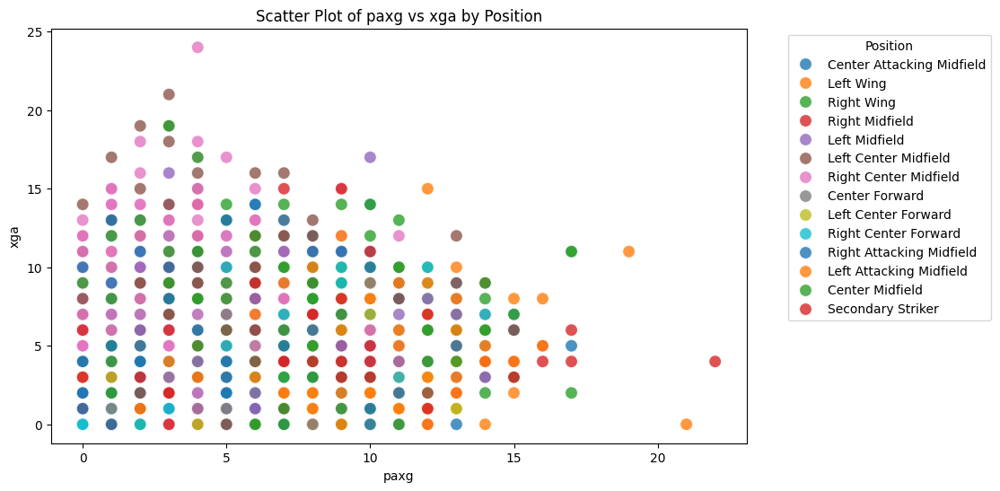

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

# Zakładamy, że kolumny nazywają się 'paxg', 'xga', i 'position'
plt.figure(figsize=(10, 6))
sns.scatterplot(data=data6, x='prog_carries', y='prog_pass', hue='position', palette='tab10', s=100, alpha=0.8)
plt.title('Scatter Plot of paxg vs xga by Position')
plt.xlabel('paxg')
plt.ylabel('xga')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', title='Position')
plt.show()


In [ ]:
data2

,player,team,match_id,position,Events,minute,goals,assist,PAxG,xGA
0,Aaron Hunt,Hamburger SV,3890286,Center Attacking Midfield,126,80.0,0.0,0.0,0.000000,0.066286
1,Aaron Hunt,Hamburger SV,3890297,Center Attacking Midfield,186,90.0,0.0,0.0,0.593420,0.160857
2,Aaron Hunt,Hamburger SV,3890304,Center Attacking Midfield,214,90.0,0.0,0.0,0.000000,0.000000
3,Aaron Hunt,Hamburger SV,3890317,Left Wing,184,90.0,0.0,0.0,1.037152,0.047306
4,Aaron Hunt,Hamburger SV,3890324,Center Attacking Midfield,169,90.0,0.0,0.0,0.654407,0.070087
...,...,...,...,...,...,...,...,...,...,...
23652,Łukasz Gikiewicz,Chennaiyin,3813311,Left Center Forward,176,90.0,1.0,0.0,1.450748,0.000000
23653,Łukasz Gikiewicz,Chennaiyin,3817852,Right Center Forward,132,90.0,0.0,0.0,-0.160108,0.000000
23654,Łukasz Gikiewicz,Chennaiyin,3817858,Center Forward,104,76.0,0.0,0.0,0.000000,0.000000
23655,Łukasz Gikiewicz,Chennaiyin,3817868,Right Center Forward,146,90.0,0.0,0.0,-0.373380,0.097712


koniec

In [ ]:
inter_df

,player,match_id,interception
0,Carlos Eccehomo Cuesta Figueroa,3943077,2
1,Cristian Gabriel Romero,3943077,1
2,Davinson Sánchez Mina,3943077,1
3,Enzo Fernandez,3943077,1
4,Jefferson Andrés Lerma Solís,3943077,1
...,...,...,...
37054,Nilton dos Reis Santos,3888704,4
37055,Orlando Peçanha de Carvalho,3888704,7
37056,Raymond Kaelbel,3888704,2
37057,Robert Jonquet,3888704,4


Średniawo to wychodzi, połączmy to na 2 metryki:
- gain_poss:
    - inter
    - reco
    - clearance
    - tackle
- lost_poss:
    - dispo
    - error
    - misc

In [ ]:
merged_df

,interception,interception_diff,recovery,recovery_diff,tackle,tackle_diff,clearance,clearance_diff,error,error_diff,dispossessed,dispossessed_diff,miscontrol,miscontrol_diff,result_numeric,won_poss_diff,lost_poss_diff,diff_diff
0,4,-3.0,21,-11.0,6,-5.0,11,3.0,0.0,0.0,7.0,3.0,6,-2.0,1,-16.0,1.0,-17.0
1,7,3.0,32,11.0,11,5.0,8,-3.0,0.0,0.0,4.0,-3.0,8,2.0,-1,16.0,-1.0,17.0
2,15,5.0,51,6.0,18,9.0,25,1.0,0.0,0.0,10.0,-3.0,8,-7.0,0,21.0,-10.0,31.0
3,10,-5.0,45,-6.0,9,-9.0,24,-1.0,0.0,0.0,13.0,3.0,15,7.0,0,-21.0,10.0,-31.0
4,6,-2.0,38,-12.0,15,-6.0,12,2.0,0.0,0.0,20.0,4.0,12,-4.0,1,-18.0,0.0,-18.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5832,8,2.0,75,8.0,31,6.0,38,25.0,0.0,0.0,15.0,-3.0,25,7.0,-1,41.0,4.0,37.0
5833,11,3.0,98,35.0,19,-9.0,29,-25.0,0.0,0.0,12.0,-6.0,19,1.0,1,4.0,-5.0,9.0
5834,8,-3.0,63,-35.0,28,9.0,54,25.0,2.0,0.0,18.0,6.0,18,-1.0,-1,-4.0,5.0,-9.0
5835,16,1.0,107,29.0,25,-2.0,32,7.0,0.0,0.0,19.0,7.0,16,-7.0,1,35.0,0.0,35.0


In [ ]:
merged_df2 = merged_df
merged_df2['won_poss_diff'] = merged_df2["interception_diff"] + merged_df2["recovery_diff"] + merged_df2["tackle_diff"] + merged_df2["clearance_diff"]
merged_df2['lost_poss_diff'] = merged_df2["error_diff"] + merged_df2["dispossessed_diff"]  + merged_df2["miscontrol_diff"]
merged_df2['diff_diff'] = merged_df2['won_poss_diff'] - merged_df2['lost_poss_diff']

Sprawdźmy wagi dla statystyk

In [ ]:
corr_df = prog_carries_corr[['result_numeric', 'npxg_diff', 'paxg_diff', 'xga_diff', 'shots_diff', 'cipa_diff', 'xT+_diff', 'prog_passes_diff', 'prog_carries_diff', 'prog_p+c_diff']]

In [ ]:
corr_df

,result_numeric,npxg_diff,paxg_diff,xga_diff,shots_diff,cipa_diff,xT+_diff,prog_passes_diff,prog_carries_diff,prog_p+c_diff
0,1,-0.067086,-0.405175,0.000968,-7.0,5.0,-0.598,-13.0,2.0,-11.0
1,-1,0.067086,0.405175,-0.000968,7.0,-5.0,0.598,13.0,-2.0,11.0
2,0,0.771383,-0.339247,0.410421,2.0,-3.0,0.848,-2.0,9.0,7.0
3,0,-0.771383,0.339247,-0.410421,-2.0,3.0,-0.848,2.0,-9.0,-7.0
4,-1,-0.417397,-1.030468,-0.481131,0.0,1.0,0.564,13.0,16.0,29.0
...,...,...,...,...,...,...,...,...,...,...
5586,-1,-1.464271,-1.195802,-1.142056,-25.0,-13.0,-2.058,-39.0,-24.0,-63.0
5587,1,2.556967,0.993246,2.094526,20.0,8.0,1.960,16.0,17.0,33.0
5588,-1,-2.556967,-0.993246,-2.094526,-20.0,-8.0,-1.960,-16.0,-17.0,-33.0
5589,1,3.344083,0.449798,1.188078,26.0,15.0,2.450,45.0,18.0,63.0


In [ ]:
corr_all = corr_all.fillna(0)

regresja logistyczna

In [ ]:
df = corr_all

In [ ]:
from sklearn.model_selection import train_test_split

X = df.drop(columns=['result_numeric'])
y = df['result_numeric']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [ ]:
from sklearn.linear_model import LogisticRegression

model = LogisticRegression()
model.fit(X_train, y_train)

weights = model.coef_[0]
feature_weights = dict(zip(X.columns, weights))

print("Feature weights:", feature_weights)


Feature weights: {'npxg_diff': -1.7070662000722172, 'paxg_diff': -2.457435505169083, 'xga_diff': -0.9063726426717394, 'shots_diff': 0.112053519232837, 'cipa_diff': -0.039790690945371715, 'xT+_diff': 0.0619991372286296, 'prog_passes_diff': 0.010804411684327766, 'prog_carries_diff': -0.015566170082927643, 'prog_p+c_diff': 0.005173529489389547}


random forest

In [ ]:
from sklearn.ensemble import RandomForestClassifier

model = RandomForestClassifier(random_state=42)
model.fit(X_train, y_train)

importances = model.feature_importances_
feature_importances = dict(zip(X.columns, importances))

print("Feature importances:", feature_importances)


Feature importances: {'goals_scored': 0.17842682329266246, 'goals_conceded': 0.2104046050416531, 'npxg': 0.02145403953564011, 'npxg_diff': 0.04584442063129988, 'PAxG': 0.06958719284765497, 'paxg_diff': 0.18855843929356003, 'xGA': 0.02160021745113072, 'xga_diff': 0.033718807455696505, 'shots': 0.0076510593330975105, 'shots_diff': 0.00892604563364332, 'carries_into_pen': 0.006810237070645125, 'cipa_diff': 0.013189887365584853, 'xT': 0.01007748964565105, 'xT_diff': 0.011394133246090992, 'xT+': 0.009441631756647575, 'xT+_diff': 0.009227498885529267, 'prog_passes': 0.008071679558760729, 'prog_passes_diff': 0.00916389134937566, 'prog_carries': 0.008164084236666244, 'prog_carries_diff': 0.01143904275467238, 'prog_p+c_diff': 0.008266235440035737, 'good_passes_x': 0.008630401451438886, 'gp_diff_x': 0.007939053637406678, 'good_passes_y': 0.008829494115412841, 'gp_diff_y': 0.00786558540784392, 'bad_passes': 0.009778223740877705, 'passes%': 0.010140466101865865, 'passes%_diff': 0.00917178148804827

pca

In [ ]:
from sklearn.decomposition import PCA

pca = PCA()
pca.fit(X)
components = pca.components_[0]  # Pierwsza główna składowa
feature_weights_pca = dict(zip(X.columns, components))

print("Feature weights from PCA:", feature_weights_pca)


Feature weights from PCA: {'npxg_diff': -0.019560198877030113, 'paxg_diff': -0.010111363800876183, 'xga_diff': -0.014868754774533977, 'shots_diff': -0.18227863898803429, 'cipa_diff': -0.07635629275822979, 'xT+_diff': -0.0318670717365721, 'prog_passes_diff': -0.49019489050669385, 'prog_carries_diff': -0.30211134737416734, 'prog_p+c_diff': -0.7922502674320494}


corr

In [ ]:
correlations = df.corr()
feature_weights_corr = correlations['result_numeric'].drop('result_numeric')
print("Feature weights based on correlations:", feature_weights_corr)

Feature weights based on correlations: npxg_diff            0.539003
paxg_diff            0.762126
xga_diff             0.520638
shots_diff           0.305414
cipa_diff            0.410422
xT+_diff             0.305075
prog_passes_diff     0.153787
prog_carries_diff    0.319381
prog_p+c_diff        0.249034
Name: result_numeric, dtype: float64


xgboost

In [ ]:
# Mapowanie klas
y_train_mapped = y_train.map({-1: 0, 0: 1, 1: 2})
y_test_mapped = y_test.map({-1: 0, 0: 1, 1: 2})

# Dopasowanie modelu
model = XGBClassifier()
model.fit(X_train, y_train_mapped)

# Wyciąganie znaczenia cech
feature_importances = model.feature_importances_
feature_weights_xgb = dict(zip(X.columns, feature_importances))

print("Feature weights from XGBoost:", feature_weights_xgb)


Feature weights from XGBoost: {'npxg_diff': 0.14629358, 'paxg_diff': 0.48199892, 'xga_diff': 0.06182491, 'shots_diff': 0.06492261, 'cipa_diff': 0.042462233, 'xT+_diff': 0.050513353, 'prog_passes_diff': 0.053868998, 'prog_carries_diff': 0.04929167, 'prog_p+c_diff': 0.04882365}


lasso

In [ ]:
from sklearn.linear_model import Lasso

lasso = Lasso(alpha=0.1)  # alpha to siła regularyzacji
lasso.fit(X_train, y_train)

feature_weights_lasso = dict(zip(X.columns, lasso.coef_))
print("Feature weights from LASSO:", feature_weights_lasso)


Feature weights from LASSO: {'npxg_diff': 0.14064071282237428, 'paxg_diff': 0.3268031731330038, 'xga_diff': 0.0, 'shots_diff': -0.0, 'cipa_diff': 0.016583037367642873, 'xT+_diff': 0.0, 'prog_passes_diff': -0.003988523435866426, 'prog_carries_diff': 0.0019060945913272074, 'prog_p+c_diff': -0.0}


mutual information

In [ ]:
from sklearn.feature_selection import mutual_info_classif

mi_scores = mutual_info_classif(X, y)
feature_weights_mi = dict(zip(X.columns, mi_scores))

print("Feature weights based on Mutual Information:", feature_weights_mi)


Feature weights based on Mutual Information: {'npxg_diff': 0.1693506884529139, 'paxg_diff': 0.472236992406043, 'xga_diff': 0.17127907349911387, 'shots_diff': 0.034830247263574865, 'cipa_diff': 0.08181139373570967, 'xT+_diff': 0.06000415890710964, 'prog_passes_diff': 0.00611386125980351, 'prog_carries_diff': 0.054260592929041174, 'prog_p+c_diff': 0.03447886689324564}


shap

In [ ]:
import pandas as pd

# Jeśli X_test jest np. macierzą numpy
if not isinstance(X_test, pd.DataFrame):
    X_test = pd.DataFrame(X_test, columns=X_train.columns)


In [ ]:
model

XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, device=None, early_stopping_rounds=None,
              enable_categorical=False, eval_metric=None, feature_types=None,
              gamma=None, grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=None, max_bin=None,
              max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=None, max_leaves=None,
              min_child_weight=None, missing=nan, monotone_constraints=None,
              multi_strategy=None, n_estimators=None, n_jobs=None,
              num_parallel_tree=None, objective='multi:softprob', ...)

In [ ]:
from sklearn.ensemble import RandomForestClassifier

model = RandomForestClassifier()
model.fit(X_train, y_train)

explainer = shap.Explainer(model, X_train)
shap_values = explainer(X_test)
check_additivity=False


100%|===================| 3348/3357 [01:13<00:00]        

In [ ]:
X_test

,npxg_diff,paxg_diff,xga_diff,shots_diff,cipa_diff,xT+_diff,prog_passes_diff,prog_carries_diff,prog_p+c_diff
4700,-0.700206,0.951396,-0.525300,-2.0,-3.0,-0.123,-2.0,-2.0,-4.0
230,0.236709,-0.463149,0.142865,1.0,-2.0,-0.221,-14.0,-3.0,-17.0
1954,-1.104317,0.144183,-0.462130,-9.0,-3.0,-0.920,-6.0,1.0,-5.0
3996,0.464801,0.308996,0.507606,-1.0,0.0,-0.250,5.0,2.0,7.0
2057,1.008917,3.785805,0.171689,2.0,3.0,1.409,14.0,22.0,36.0
...,...,...,...,...,...,...,...,...,...
3288,-0.582598,-0.400678,-0.807952,-6.0,-6.0,-1.301,-25.0,-6.0,-31.0
1410,-2.416991,-1.573544,-2.554644,-9.0,-4.0,-0.965,-26.0,1.0,-25.0
1176,-0.396283,-0.686733,-0.439557,8.0,3.0,0.777,10.0,23.0,33.0
5384,1.834753,-0.726421,1.316643,21.0,7.0,2.469,28.0,24.0,52.0


TypeError: only integer scalar arrays can be converted to a scalar index

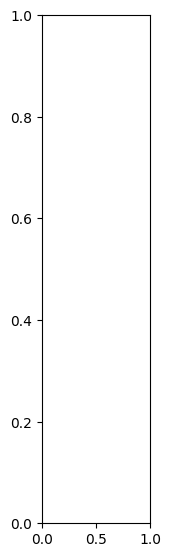

In [ ]:
shap.summary_plot(shap_values, X_test)

 99%|===================| 3340/3357 [01:12<00:00]        

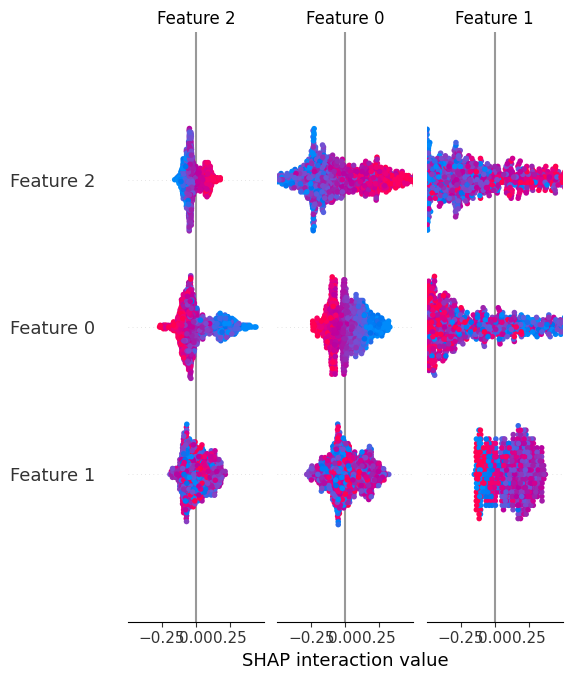

In [ ]:
from sklearn.preprocessing import StandardScaler

# Normalizacja danych (opcjonalnie)
scaler = StandardScaler()
X_test_scaled = scaler.fit_transform(X_test)

# Ponowne obliczenie SHAP z przeskalowanymi danymi
shap_values = explainer(X_test_scaled)

# Wizualizacja
shap.summary_plot(shap_values, X_test_scaled)


In [ ]:
# Wagi cech z modelu Random Forest
feature_importances = model.feature_importances_

# Połącz wagi z nazwami cech
rf_feature_weights = dict(zip(X_test.columns, feature_importances))

# Posortuj cechy po ich ważności
sorted_rf_feature_weights = {k: v for k, v in sorted(rf_feature_weights.items(), key=lambda item: item[1], reverse=True)}

# Wyświetl wagi cech
print(sorted_rf_feature_weights)


{'paxg_diff': 0.4479020489494236, 'npxg_diff': 0.1463966058953712, 'xga_diff': 0.11458751999348712, 'xT+_diff': 0.05499517786465234, 'shots_diff': 0.0506235682633948, 'prog_carries_diff': 0.048853639890954675, 'prog_passes_diff': 0.046538718751065404, 'cipa_diff': 0.04508093395378927, 'prog_p+c_diff': 0.04502178643786155}


In [ ]:
X_test_scaled

array([[-0.64643351,  0.56241039, -0.59494643, ..., -0.14260853,
        -0.21296916, -0.19177076],
       [ 0.15133311, -0.34722124,  0.1223041 , ..., -0.7520762 ,
        -0.28620594, -0.6279323 ],
       [-0.9905268 ,  0.04332706, -0.52713617, ..., -0.34576442,
         0.00674119, -0.22532165],
       ...,
       [-0.38764854, -0.49099805, -0.50290483, ...,  0.46685913,
         1.61795037,  1.0496121 ],
       [ 1.51203996, -0.51652006,  1.38231163, ...,  1.38106063,
         1.69118715,  1.68707897],
       [-0.46878893, -0.21526693, -0.43188246, ...,  1.48263857,
         0.51939865,  1.21736654]])

rocauc

In [ ]:
from sklearn.metrics import roc_auc_score

auc_scores = {}
for col in X.columns:
    auc_scores[col] = roc_auc_score(y, X[col])

print("Feature weights based on ROC-AUC:", auc_scores)


ValueError: multi_class must be in ('ovo', 'ovr')

test

In [ ]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import classification_report
import shap

# Wczytaj dane
df = corr_df

# Podział na cechy (X) i zmienną docelową (y)
X = df.drop(columns=["result_numeric"])
y = df["result_numeric"]

# Podział na dane treningowe i testowe
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Standaryzacja danych
scaler = StandardScaler()
X_train = scaler.fit_transform(X_train)
X_test = scaler.transform(X_test)


In [ ]:
# Trenowanie modelu Random Forest
model = RandomForestClassifier(random_state=42, n_estimators=100)
model.fit(X_train, y_train)

# Predykcja i ocena
y_pred = model.predict(X_test)
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

          -1       0.84      0.86      0.85       400
           0       0.63      0.57      0.60       287
           1       0.85      0.88      0.86       432

    accuracy                           0.79      1119
   macro avg       0.77      0.77      0.77      1119
weighted avg       0.79      0.79      0.79      1119



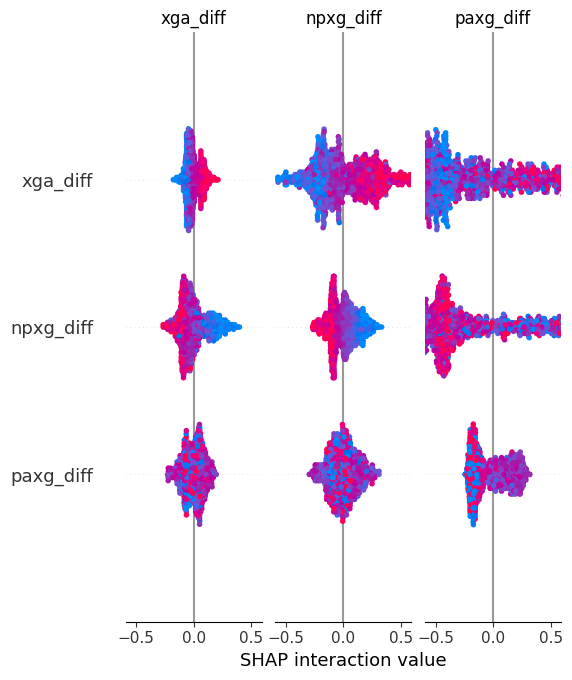

In [ ]:
# Obliczanie wartości SHAP
explainer = shap.TreeExplainer(model)
shap_values = explainer.shap_values(X_test)

# Wizualizacja ważności cech
shap.summary_plot(shap_values, X_test, feature_names=X.columns)

In [ ]:
print(X_test_df.shape)
print(shap_values_class_1.shape)

(1119, 9)
(9, 3)


In [ ]:
# Upewnij się, że X_test to DataFrame z oryginalnymi nazwami kolumn
X_test_df = pd.DataFrame(X_test, columns=X.columns)

# Obliczanie średniej wartości SHAP dla klasy `1` (wygrana)
shap_values_class_1 = shap_values[1]  # Wartości SHAP dla klasy 1
mean_shap_values = abs(shap_values_class_1).mean(axis=0)

# Tworzenie DataFrame z ważnościami cech
feature_importances = pd.DataFrame({
    "Feature": X_test_df.columns,  # Nazwy kolumn z X_test
    "Importance": mean_shap_values  # Średnie wartości SHAP
}).sort_values(by="Importance", ascending=False)

print(feature_importances)


X_test_df shape: (1119, 9)
shap_values_class_1 shape: (9, 3)


ValueError: All arrays must be of the same length

In [ ]:
shap_values_class_1

array([[-0.09863654,  0.10300191, -0.00436537],
       [ 0.02353006,  0.26247152, -0.28600158],
       [-0.07758803,  0.09809477, -0.02050674],
       [ 0.00290656, -0.00077944, -0.00212712],
       [ 0.00649742,  0.01923689, -0.02573431],
       [-0.00421602,  0.01214674, -0.00793073],
       [-0.01443282,  0.00572669,  0.00870612],
       [-0.00985072,  0.01154131, -0.00169059],
       [ 0.003579  , -0.00944576,  0.00586676]])

deep lerarning

In [ ]:
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt

# Tworzenie przykładowego modelu
model = tf.keras.Sequential([
    tf.keras.layers.Dense(64, activation='relu', input_shape=(10,)),  # 10 cech wejściowych
    tf.keras.layers.Dense(32, activation='relu'),
    tf.keras.layers.Dense(3, activation='softmax')  # 3 klasy
])

# Kompilacja modelu
model.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])

# Generowanie danych treningowych (100 próbek, 10 cech)
X_train = np.random.rand(100, 10)
y_train = np.random.randint(0, 3, size=(100,))

# Trening modelu
model.fit(X_train, y_train, epochs=10, verbose=0)

# Przykładowe dane wejściowe (1 próbka z 10 cechami)
input_data = np.random.rand(10)

# Konwertowanie wejścia na tensor, aby umożliwić obliczenie gradientów
input_data = tf.convert_to_tensor(input_data[None, :], dtype=tf.float32)

# Obliczanie gradientów
with tf.GradientTape() as tape:
    tape.watch(input_data)
    predictions = model(input_data)

# Gradienty dla wyjścia (prawdopodobieństwa) modelu
gradients = tape.gradient(predictions[:, 0], input_data)

# Wyświetlenie gradientów
print("Gradients:", gradients.numpy())

# Wizualizacja gradientów
plt.bar(range(len(gradients.numpy().flatten())), gradients.numpy().flatten())
plt.title("Vanilla Gradients")
plt.xlabel("Input Feature Index")
plt.ylabel("Gradient Value")
plt.show()


AttributeError: 'NoneType' object has no attribute 'numpy'

Gradients: [[-0.00352886  0.05722845 -0.10008281 -0.08748841 -0.00809107 -0.03205674
   0.02985915  0.10850637  0.01159997  0.05946298]]


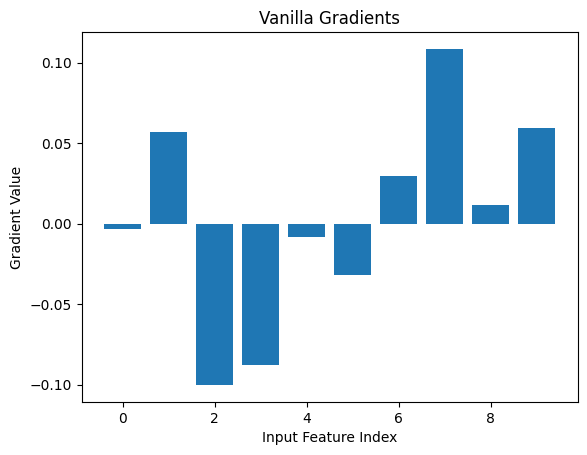

In [ ]:
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt

# Tworzenie przykładowego modelu
model = tf.keras.Sequential([
    tf.keras.layers.Dense(64, activation='relu', input_shape=(10,)),  # 10 cech wejściowych
    tf.keras.layers.Dense(32, activation='relu'),
    tf.keras.layers.Dense(3, activation='softmax')  # 3 klasy
])

# Kompilacja modelu
model.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])

# Generowanie danych treningowych (100 próbek, 10 cech)
X_train = np.random.rand(100, 10)
y_train = np.random.randint(0, 3, size=(100,))

# Trening modelu
model.fit(X_train, y_train, epochs=10, verbose=0)

# Przykładowe dane wejściowe (1 próbka z 10 cechami)
input_data = np.random.rand(10)

# Konwertowanie wejścia na tensor
input_data = tf.convert_to_tensor(input_data[None, :], dtype=tf.float32)

# Obliczanie gradientów
with tf.GradientTape() as tape:
    tape.watch(input_data)
    predictions = model(input_data)
    loss = predictions[:, 0]  # Możesz wybrać inną klasę

# Gradienty dla wyjścia modelu względem wejścia
gradients = tape.gradient(loss, input_data)

# Sprawdzenie, czy gradienty są różniczkowalne
if gradients is None:
    print("Gradients are None. Ensure that the input influences the selected output.")
else:
    # Wyświetlenie gradientów
    print("Gradients:", gradients.numpy())

    # Wizualizacja gradientów
    plt.bar(range(len(gradients.numpy().flatten())), gradients.numpy().flatten())
    plt.title("Vanilla Gradients")
    plt.xlabel("Input Feature Index")
    plt.ylabel("Gradient Value")
    plt.show()


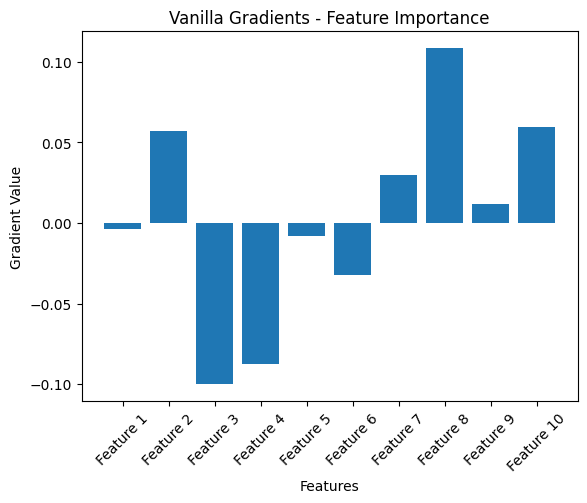

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

# Gradienty
gradients = gradients.numpy().flatten()

# Nazwy cech (przykładowo)
feature_names = [f"Feature {i+1}" for i in range(len(gradients))]

# Wykres
plt.bar(feature_names, gradients)
plt.title("Vanilla Gradients - Feature Importance")
plt.xlabel("Features")
plt.ylabel("Gradient Value")
plt.xticks(rotation=45)
plt.show()


Okay, będziemy brać random forest albo xgboost lub też korelacje. Sprawdzimy teraz resztę metryk.

In [ ]:
df.columns

Index(['goals_scored', 'goals_conceded', 'result_numeric', 'npxg', 'npxg_diff',
       'PAxG', 'paxg_diff', 'xGA', 'xga_diff', 'shots', 'shots_diff',
       'carries_into_pen', 'cipa_diff', 'xT', 'xT_diff', 'xT+', 'xT+_diff',
       'prog_passes', 'prog_passes_diff', 'prog_carries', 'prog_carries_diff',
       'prog_p+c_diff', 'good_passes_x', 'gp_diff_x', 'good_passes_y',
       'gp_diff_y', 'bad_passes', 'passes%', 'passes%_diff', 'shots_on_target',
       'target_diff'],
      dtype='object')

In [ ]:
df_corr_all = df[['result_numeric', 'npxg_diff',
        'paxg_diff', 'xga_diff', 'shots_diff', 'cipa_diff', 'xT_diff', 'xT+_diff',
        'prog_passes_diff', 'prog_carries_diff',
       'prog_p+c_diff', 'gp_diff_x',
         'passes%_diff',
       'target_diff']].corr()

In [ ]:
df[df_corr_all.columns]

,result_numeric,npxg_diff,paxg_diff,xga_diff,shots_diff,cipa_diff,xT_diff,xT+_diff,prog_passes_diff,prog_carries_diff,prog_p+c_diff,gp_diff_x,passes%_diff,target_diff
0,1,-0.067086,-0.405175,0.000968,-7.0,5.0,-0.458,-0.598,-13.0,2.0,-11.0,-51.0,-0.041171,-2.0
1,-1,0.067086,0.405175,-0.000968,7.0,-5.0,0.458,0.598,13.0,-2.0,11.0,51.0,0.041171,2.0
2,0,0.771383,-0.339247,0.410421,2.0,-3.0,0.741,0.848,-2.0,9.0,7.0,-2.0,-0.023525,-0.0
3,0,-0.771383,0.339247,-0.410421,-2.0,3.0,-0.741,-0.848,2.0,-9.0,-7.0,2.0,0.023525,0.0
4,-1,-0.417397,-1.030468,-0.481131,0.0,1.0,0.517,0.564,13.0,16.0,29.0,157.0,0.093469,-1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5454,-1,-1.464271,-1.195802,-1.142056,-25.0,-13.0,-1.599,-2.058,-39.0,-24.0,-63.0,-87.0,-0.050838,-8.0
5455,1,2.556967,0.993246,2.094526,20.0,8.0,1.894,1.960,16.0,17.0,33.0,94.0,0.069630,8.0
5456,-1,-2.556967,-0.993246,-2.094526,-20.0,-8.0,-1.894,-1.960,-16.0,-17.0,-33.0,-94.0,-0.069630,-8.0
5457,1,3.344083,0.449798,1.188078,26.0,15.0,2.273,2.450,45.0,18.0,63.0,98.0,0.090588,9.0


In [ ]:
df

Dodać pozostałe statystyki do korelacji i OLS
PCA na wybranych pozycjach
Wybrać pozycje na podstawie? dodawania korelacji?

In [ ]:
df

,goals_scored,goals_conceded,result_numeric,npxg,npxg_diff,PAxG,paxg_diff,xGA,xga_diff,shots,...,prog_p+c_diff,good_passes_x,gp_diff_x,good_passes_y,gp_diff_y,bad_passes,passes%,passes%_diff,shots_on_target,target_diff
0,1,0,1,0.668937,-0.067086,0.535954,-0.405175,0.668937,0.000968,7,...,-11.0,363,-51.0,363,-51.0,78,0.823129,-0.041171,2,-2.0
1,0,1,-1,0.736023,0.067086,0.941129,0.405175,0.667969,-0.000968,14,...,11.0,414,51.0,414,51.0,65,0.864301,0.041171,4,2.0
2,2,2,0,2.287810,0.771383,1.730679,-0.339247,1.618217,0.410421,14,...,7.0,272,-2.0,272,-2.0,101,0.729223,-0.023525,5,-0.0
3,2,2,0,1.516427,-0.771383,2.069926,0.339247,1.207796,-0.410421,12,...,-7.0,274,2.0,274,2.0,90,0.752747,0.023525,5,0.0
4,0,1,-1,0.754564,-0.417397,0.421616,-1.030468,0.690830,-0.481131,11,...,29.0,378,157.0,378,157.0,76,0.832599,0.093469,2,-1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5454,0,2,-1,0.895518,-1.464271,0.918301,-1.195802,0.875046,-1.142056,9,...,-63.0,322,-87.0,322,-87.0,104,0.755869,-0.050838,4,-8.0
5455,5,2,1,3.341258,2.556967,3.253999,0.993246,2.868785,2.094526,26,...,33.0,376,94.0,376,94.0,127,0.747515,0.069630,11,8.0
5456,2,5,-1,0.784291,-2.556967,2.260754,-0.993246,0.774260,-2.094526,6,...,-33.0,282,-94.0,282,-94.0,134,0.677885,-0.069630,3,-8.0
5457,5,2,1,4.815326,3.344083,2.858103,0.449798,2.485235,1.188078,41,...,63.0,360,98.0,360,98.0,109,0.767591,0.090588,16,9.0


In [ ]:
X = df[df_corr_all.columns[1:]]
X = sm.add_constant(X)  # Dodanie stałej (biasu) do modelu

# Zmienna zależna (rezultat meczu)
y = df["goals_scored"]

# Regresja liniowa
model = sm.OLS(y, X).fit()
print(model.summary())


                            OLS Regression Results                            
Dep. Variable:           goals_scored   R-squared:                       0.506
Model:                            OLS   Adj. R-squared:                  0.505
Method:                 Least Squares   F-statistic:                     428.5
Date:                Thu, 09 Jan 2025   Prob (F-statistic):               0.00
Time:                        23:10:56   Log-Likelihood:                -7384.2
No. Observations:                5459   AIC:                         1.480e+04
Df Residuals:                    5445   BIC:                         1.489e+04
Df Model:                          13                                         
Covariance Type:            nonrobust                                         
                        coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------------
const                 1.4204      0.01

NIE DZIAŁA, BO TRZEBA ZAMIENIĆ NA RÓŻNICĘ PROCENTOWĄ (UWAGA NA DZIELENIE PRZEZ 0) ORAZ USTANDARYZOWAĆ.

In [ ]:
corr_all.columns

Index(['goals_scored', 'goals_conceded', 'result_numeric', 'npxg', 'npxg_diff',
       'PAxG', 'paxg_diff', 'xGA', 'xga_diff', 'shots', 'shots_diff',
       'carries_into_pen', 'cipa_diff', 'xT', 'xT_diff', 'xT+', 'xT+_diff',
       'prog_passes', 'prog_passes_diff', 'prog_carries', 'prog_carries_diff',
       'prog_p+c_diff', 'good_passes_x', 'gp_diff_x', 'good_passes_y',
       'gp_diff_y', 'bad_passes', 'passes%', 'passes%_diff', 'shots_on_target',
       'target_diff'],
      dtype='object')

In [ ]:
cols_corr = ['match_id','goals_scored', 'goals_conceded', 'result_numeric', 'npxg', 
       'PAxG', 'xGA',  'shots',
       'carries_into_pen', 'xT', 'xT+',
       'prog_passes', 'prog_carries',
        'good_passes_x',
        'bad_passes', 'passes%',  'shots_on_target'
      ]

In [ ]:
corr_data = target_corr[cols_corr]

In [ ]:
for col in corr_data.columns[4:]:
    corr_data[f"{col}_percent_diff"] = corr_data.groupby('match_id')[col].transform(
        lambda x: (
        (x.diff() / x.max()).fillna(-x.diff().iloc[-1] / x.max()) * 100
        if x.max() != 0 else 0
    )
    ).fillna(100)
corr_data

C:\Users\macie\AppData\Local\Temp\ipykernel_30508\3393364578.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  corr_data[f"{col}_percent_diff"] = corr_data.groupby('match_id')[col].transform(
C:\Users\macie\AppData\Local\Temp\ipykernel_30508\3393364578.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  corr_data[f"{col}_percent_diff"] = corr_data.groupby('match_id')[col].transform(
C:\Users\macie\AppData\Local\Temp\ipykernel_30508\3393364578.py:2: SettingWithCopyWarning: 
A value is trying to be set on a

,match_id,goals_scored,goals_conceded,result_numeric,npxg,PAxG,xGA,shots,carries_into_pen,xT,...,shots_percent_diff_percent_diff,carries_into_pen_percent_diff_percent_diff,xT_percent_diff_percent_diff,xT+_percent_diff_percent_diff,prog_passes_percent_diff_percent_diff,prog_carries_percent_diff_percent_diff,good_passes_x_percent_diff_percent_diff,bad_passes_percent_diff_percent_diff,passes%_percent_diff_percent_diff,shots_on_target_percent_diff_percent_diff
0,3943077,1,0,1,0.668937,0.535954,0.668937,7,6,0.912,...,-200.0,200.0,-200.0,-200.0,-200.0,200.0,-200.0,200.0,-200.0,-200.0
1,3943077,0,1,-1,0.736023,0.941129,0.667969,14,1,1.370,...,200.0,-200.0,200.0,200.0,200.0,-200.0,200.0,-200.0,200.0,200.0
2,3943076,2,2,0,2.287810,1.730679,1.618217,14,2,1.842,...,200.0,-200.0,200.0,200.0,-200.0,200.0,-200.0,200.0,-200.0,0.0
3,3943076,2,2,0,1.516427,2.069926,1.207796,12,5,1.101,...,-200.0,200.0,-200.0,-200.0,200.0,-200.0,200.0,-200.0,200.0,0.0
4,3942852,0,1,-1,0.754564,0.421616,0.690830,11,4,1.546,...,0.0,200.0,200.0,200.0,200.0,200.0,200.0,-200.0,200.0,-200.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5454,3888854,0,2,-1,0.895518,0.918301,0.875046,9,4,1.095,...,-200.0,-200.0,-200.0,-200.0,-200.0,-200.0,-200.0,200.0,-200.0,-200.0
5455,3888705,5,2,1,3.341258,3.253999,2.868785,26,13,3.257,...,200.0,200.0,200.0,200.0,200.0,200.0,200.0,-200.0,200.0,200.0
5456,3888705,2,5,-1,0.784291,2.260754,0.774260,6,5,1.363,...,-200.0,-200.0,-200.0,-200.0,-200.0,-200.0,-200.0,200.0,-200.0,-200.0
5457,3888704,5,2,1,4.815326,2.858103,2.485235,41,20,3.682,...,200.0,200.0,200.0,200.0,200.0,200.0,200.0,-200.0,200.0,200.0


In [ ]:
list(corr_data.columns[17:30])

['npxg_percent_diff',
 'PAxG_percent_diff',
 'xGA_percent_diff',
 'shots_percent_diff',
 'carries_into_pen_percent_diff',
 'xT_percent_diff',
 'xT+_percent_diff',
 'prog_passes_percent_diff',
 'prog_carries_percent_diff',
 'good_passes_x_percent_diff',
 'bad_passes_percent_diff',
 'passes%_percent_diff',
 'shots_on_target_percent_diff']

In [ ]:
corr_data[corr_data.columns[17:30]]

,npxg_percent_diff,PAxG_percent_diff,xGA_percent_diff,shots_percent_diff,carries_into_pen_percent_diff,xT_percent_diff,xT+_percent_diff,prog_passes_percent_diff,prog_carries_percent_diff,good_passes_x_percent_diff,bad_passes_percent_diff,passes%_percent_diff,shots_on_target_percent_diff
0,-9.114641,-43.052026,0.144739,-50.000000,83.333333,-33.430657,-28.516929,-44.827586,10.526316,-12.318841,16.666667,-4.763548,-50.000000
1,9.114641,43.052026,-0.144739,50.000000,-83.333333,33.430657,28.516929,44.827586,-10.526316,12.318841,-16.666667,4.763548,50.000000
2,33.717084,-16.389344,25.362536,14.285714,-60.000000,40.228013,35.705263,-6.451613,45.000000,-0.729927,10.891089,-3.125183,-0.000000
3,-33.717084,16.389344,-25.362536,-14.285714,60.000000,-40.228013,-35.705263,6.451613,-45.000000,0.729927,-10.891089,3.125183,0.000000
4,-35.615282,-70.964786,-41.053517,-0.000000,25.000000,33.441138,26.293706,34.210526,57.142857,41.534392,-2.564103,11.226133,-33.333333
...,...,...,...,...,...,...,...,...,...,...,...,...,...
5454,-62.050924,-56.563109,-56.618643,-73.529412,-76.470588,-59.354120,-52.580480,-50.649351,-48.979592,-21.271394,5.769231,-6.301870,-66.666667
5455,76.527085,30.523840,73.010888,76.923077,61.538462,58.151673,49.758822,25.000000,39.534884,25.000000,-5.223881,9.314904,72.727273
5456,-76.527085,-30.523840,-73.010888,-76.923077,-61.538462,-58.151673,-49.758822,-25.000000,-39.534884,-25.000000,5.223881,-9.314904,-72.727273
5457,69.446660,15.737645,47.805457,63.414634,75.000000,61.732754,55.404794,66.176471,43.902439,27.222222,-12.800000,11.801608,56.250000


In [ ]:
X = corr_data[corr_data.columns[17:30]]
X = sm.add_constant(X)  # Dodanie stałej (biasu) do modelu

# Zmienna zależna (rezultat meczu)
y = corr_data["result_numeric"]

# Regresja liniowa
model = sm.OLS(y, X).fit()
print(model.summary())


                            OLS Regression Results                            
Dep. Variable:         result_numeric   R-squared:                       0.701
Model:                            OLS   Adj. R-squared:                  0.700
Method:                 Least Squares   F-statistic:                     981.8
Date:                Fri, 10 Jan 2025   Prob (F-statistic):               0.00
Time:                        11:27:47   Log-Likelihood:                -3690.2
No. Observations:                5459   AIC:                             7408.
Df Residuals:                    5445   BIC:                             7501.
Df Model:                          13                                         
Covariance Type:            nonrobust                                         
                                    coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------------------------
const         

In [ ]:
target_corr

,match_id,match_date,team,team_result,goals_scored,goals_conceded,result_numeric,npxg,npxg_diff,PAxG,...,prog_p+c_diff,good_passes_x,gp_diff_x,good_passes_y,gp_diff_y,bad_passes,passes%,passes%_diff,shots_on_target,target_diff
0,3943077,2024-07-15,Argentina,Win,1,0,1,0.668937,-0.067086,0.535954,...,-11.0,363,-51.0,363,-51.0,78,0.823129,-0.041171,2,-2.0
1,3943077,2024-07-15,Colombia,Lose,0,1,-1,0.736023,0.067086,0.941129,...,11.0,414,51.0,414,51.0,65,0.864301,0.041171,4,2.0
2,3943076,2024-07-14,Canada,Draw,2,2,0,2.287810,0.771383,1.730679,...,7.0,272,-2.0,272,-2.0,101,0.729223,-0.023525,5,-0.0
3,3943076,2024-07-14,Uruguay,Draw,2,2,0,1.516427,-0.771383,2.069926,...,-7.0,274,2.0,274,2.0,90,0.752747,0.023525,5,0.0
4,3942852,2024-07-11,Uruguay,Lose,0,1,-1,0.754564,-0.417397,0.421616,...,29.0,378,157.0,378,157.0,76,0.832599,0.093469,2,-1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5454,3888854,1962-05-30,Mexico,Lose,0,2,-1,0.895518,-1.464271,0.918301,...,-63.0,322,-87.0,322,-87.0,104,0.755869,-0.050838,4,-8.0
5455,3888705,1958-06-29,Brazil,Win,5,2,1,3.341258,2.556967,3.253999,...,33.0,376,94.0,376,94.0,127,0.747515,0.069630,11,8.0
5456,3888705,1958-06-29,Sweden,Lose,2,5,-1,0.784291,-2.556967,2.260754,...,-33.0,282,-94.0,282,-94.0,134,0.677885,-0.069630,3,-8.0
5457,3888704,1958-06-24,Brazil,Win,5,2,1,4.815326,3.344083,2.858103,...,63.0,360,98.0,360,98.0,109,0.767591,0.090588,16,9.0


A może za pomocą PCA sprawdzić pozycje i jakie mają wpływy na wynik?
Np. weźmy 3 główne statystyki:
- paxg
- xT+
- xGA
- target
- carries_into_pen
i zobaczmy jakie średnie wartości mają te statystyki

Zobaczmy jak za pomocą PCA rozkładają się statystyki

Bierzemy wszystkich zawodników

In [ ]:
players5 = players4

In [ ]:
data1 = players5.merge(paxg_df, on=['match_id', 'player', 'team', 'position'], how='left').fillna(0)

In [ ]:
data2 = data1.merge(xga_df, on=['match_id', 'player', 'team', 'position'], how='left').fillna(0)

In [ ]:
data3 = data2.merge(xT_plus, on=['match_id', 'player'], how='left')

In [ ]:
data4 = data3.merge(target_df, on=['match_id', 'player'], how='left').fillna(0)

In [ ]:
data5 = data4.merge(progressive_carries_df, on=['match_id', 'player'], how='left').fillna(0)

In [ ]:
data6 = data5.merge(progressive_passes_df, on=['match_id', 'player'], how='left').fillna(0)

In [ ]:
data7 = data6.merge(carries_into_pen_df, on=['match_id', 'player'], how='left').fillna(0)

In [ ]:
data8 = data7.merge(dribble_complete_df, on=['match_id', 'player'], how='left').fillna(0)

In [ ]:
data9 = data8.merge(good_passes_df2, on=['match_id', 'player'], how='left').fillna(0)

In [3468]:
data_model_corr.columns

Index(['player', 'team', 'match_id', 'position', 'Events', 'minute', 'goals',
       'assist', 'PAxG', 'xGA', 'xT+', 'shots_on_target', 'prog_carries',
       'prog_pass', 'carries_into_pen', 'driblle_complete', 'good_passes',
       'driblle_failed', 'bad_passes', 'interception', 'recovery', 'clearance',
       'error', 'dispossessed', 'miscontrol', 'shots', 'npxg', 'tackle', 'xT',
       'fwp', 'fwp+', 'duels_won', 'duels_50_won', 'duels_lost',
       'duels_50_lost', 'aerial_lost', 'aerial_won_shot',
       'miscontrol_aerial_won', 'aerial_wons_count', 'passes', 'dribbles',
       'basic_duels_won', 'basic_duels_lost', 'basic_duels', 'won_aerial_all',
       'lost_aerial_all', 'aerial', 'duels', 'defensive_won',
       'defensive_lost'],
      dtype='object')

Standaryzacja

In [ ]:
from sklearn.preprocessing import StandardScaler

# Kolumny ze statystykami
stats = ['PAxG', 'xGA', 'xT+', 'shots_on_target', 'prog_carries',
         'prog_pass', 'carries_into_pen', 'driblle_complete', 'good_passes']

# Normalizacja
scaler = StandardScaler()
df_scaled = data9.copy()
df_scaled[stats] = scaler.fit_transform(data9[stats])


Jeszcze raz

In [3453]:
# Grupowanie po pozycjach i obliczenie średnich statystyk
position_stats = data9.groupby('position')[['PAxG', 'xGA', 'xT+', 'shots_on_target', 
                                         'prog_carries', 'prog_pass', 
                                         'carries_into_pen', 'driblle_complete', 
                                         'good_passes']].median().reset_index()


In [3454]:
position_stats

,position,PAxG,xGA,xT+,shots_on_target,prog_carries,prog_pass,carries_into_pen,driblle_complete,good_passes
0,Center Attacking Midfield,0.000000,0.066501,0.1910,0.0,2.0,3.0,0.0,1.0,29.0
1,Center Back,0.000000,0.000000,0.0650,0.0,0.0,2.0,0.0,0.0,35.0
2,Center Defensive Midfield,0.000000,0.000000,0.1000,0.0,0.0,4.0,0.0,0.0,47.0
3,Center Forward,0.497310,0.021303,0.0940,1.0,1.0,1.0,1.0,1.0,16.0
4,Center Midfield,0.000000,0.000000,0.0865,0.0,1.0,2.0,0.0,0.0,41.5
5,Goalkeeper,0.000000,0.000000,0.0220,0.0,0.0,2.0,0.0,0.0,19.0
6,Left Attacking Midfield,0.000000,0.042727,0.2100,0.0,3.0,3.0,1.0,1.0,31.0
7,Left Back,0.000000,0.000000,0.1600,0.0,1.0,4.0,0.0,0.0,39.0
8,Left Center Back,0.000000,0.000000,0.0780,0.0,0.0,3.0,0.0,0.0,36.0
9,Left Center Forward,0.458066,0.033541,0.1120,1.0,1.0,1.0,1.0,1.0,16.0


In [3455]:
from sklearn.preprocessing import StandardScaler

# Skalowanie statystyk
scaler = StandardScaler()
position_stats_scaled = position_stats.copy()
position_stats_scaled.iloc[:, 1:] = scaler.fit_transform(position_stats.iloc[:, 1:])


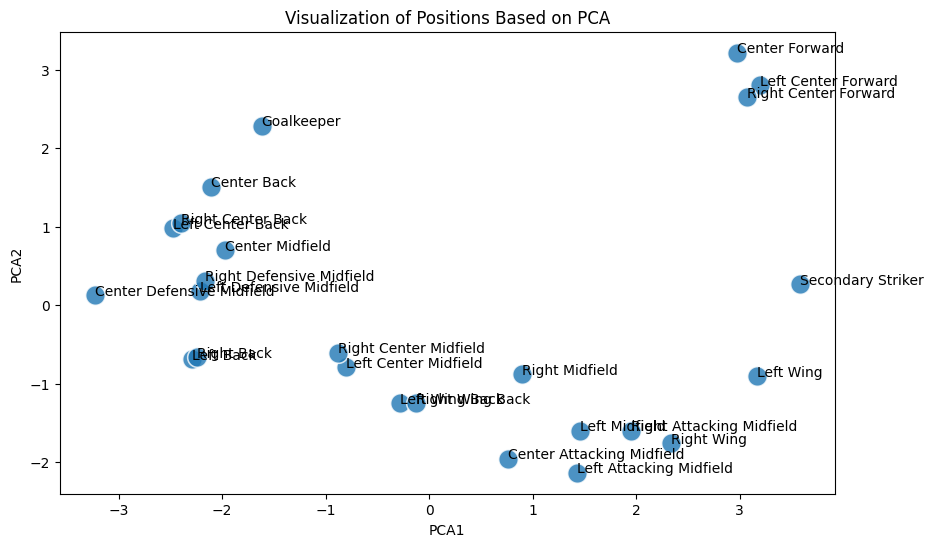

In [ ]:

# PCA na 2 wymiary (bez klasteryzacji)
pca = PCA(n_components=2)
pca_result = pca.fit_transform(position_stats_scaled.iloc[:, 1:])  # Bez 'position'
position_stats_scaled['PCA1'] = pca_result[:, 0]
position_stats_scaled['PCA2'] = pca_result[:, 1]

# Wykres bez klastrów
plt.figure(figsize=(10, 6))
sns.scatterplot(data=position_stats_scaled, x='PCA1', y='PCA2', 
                palette='tab10', s=200, alpha=0.8)

# Dodanie etykiet pozycji
for i in range(position_stats_scaled.shape[0]):
    plt.text(position_stats_scaled['PCA1'].iloc[i], 
             position_stats_scaled['PCA2'].iloc[i], 
             position_stats_scaled['position'].iloc[i], fontsize=10)

plt.title('Visualization of Positions Based on PCA')
plt.xlabel('PCA1')
plt.ylabel('PCA2')
plt.show()

In [3456]:
position_stats_scaled

,position,PAxG,xGA,xT+,shots_on_target,prog_carries,prog_pass,carries_into_pen,driblle_complete,good_passes
0,Center Attacking Midfield,-0.432931,1.850452,0.909778,-0.5,0.656488,0.561951,-0.623610,0.646162,-0.170509
1,Center Back,-0.432931,-1.027443,-1.377374,-0.5,-1.395037,-0.608781,-0.623610,-1.148733,0.530212
2,Center Defensive Midfield,-0.432931,-1.027443,-0.742054,-0.5,-1.395037,1.732684,-0.623610,-1.148733,1.931653
3,Center Forward,2.381242,-0.105522,-0.850966,2.0,-0.369274,-1.779513,1.603567,0.646162,-1.688736
4,Center Midfield,-0.432931,-1.027443,-0.987106,-0.5,-0.369274,-0.608781,-0.623610,-1.148733,1.289326
5,Goalkeeper,-0.432931,-1.027443,-2.157910,-0.5,-1.395037,-0.608781,-0.623610,-1.148733,-1.338376
6,Left Attacking Midfield,-0.432931,0.821612,1.254666,-0.5,1.682250,0.561951,1.603567,0.646162,0.063065
7,Left Back,-0.432931,-1.027443,0.347066,-0.5,-0.369274,1.732684,-0.623610,-1.148733,0.997359
8,Left Center Back,-0.432931,-1.027443,-1.141398,-0.5,-1.395037,0.561951,-0.623610,-1.148733,0.646999
9,Left Center Forward,2.159169,0.424081,-0.524230,2.0,-0.369274,-1.779513,1.603567,0.646162,-1.688736


In [3457]:
pos_corr = position_stats_scaled.copy() 
pos_corr['value']= position_stats_scaled["PAxG"] + position_stats_scaled["xGA"] + position_stats_scaled["xT+"] + position_stats_scaled["shots_on_target"] + position_stats_scaled["prog_carries"] + position_stats_scaled["prog_pass"] + position_stats_scaled["carries_into_pen"] + position_stats_scaled["driblle_complete"] + position_stats_scaled["good_passes"]

In [3458]:
pos_corr.sort_values(by='value')

,position,PAxG,xGA,xT+,shots_on_target,prog_carries,prog_pass,carries_into_pen,driblle_complete,good_passes,value
5,Goalkeeper,-0.432931,-1.027443,-2.157910,-0.5,-1.395037,-0.608781,-0.623610,-1.148733,-1.338376,-9.232820
1,Center Back,-0.432931,-1.027443,-1.377374,-0.5,-1.395037,-0.608781,-0.623610,-1.148733,0.530212,-6.583696
17,Right Center Back,-0.432931,-1.027443,-1.177702,-0.5,-1.395037,0.561951,-0.623610,-1.148733,0.413425,-5.330078
8,Left Center Back,-0.432931,-1.027443,-1.141398,-0.5,-1.395037,0.561951,-0.623610,-1.148733,0.646999,-5.060201
4,Center Midfield,-0.432931,-1.027443,-0.987106,-0.5,-0.369274,-0.608781,-0.623610,-1.148733,1.289326,-4.408552
20,Right Defensive Midfield,-0.432931,-1.027443,-0.814662,-0.5,-0.369274,0.561951,-0.623610,-1.148733,0.880572,-3.474129
11,Left Defensive Midfield,-0.432931,-1.027443,-0.651294,-0.5,-0.369274,0.561951,-0.623610,-1.148733,1.114145,-3.077188
2,Center Defensive Midfield,-0.432931,-1.027443,-0.742054,-0.5,-1.395037,1.732684,-0.623610,-1.148733,1.931653,-2.205471
16,Right Back,-0.432931,-1.027443,0.356142,-0.5,-0.369274,1.732684,-0.623610,-1.148733,0.880572,-1.132593
7,Left Back,-0.432931,-1.027443,0.347066,-0.5,-0.369274,1.732684,-0.623610,-1.148733,0.997359,-1.024882


In [3459]:
position_share = position_stats.groupby('position')['PAxG'].sum()
position_share_percentage = (position_share / position_share.sum())
position_share_percentage

position
Center Attacking Midfield    0.000000
Center Back                  0.000000
Center Defensive Midfield    0.000000
Center Forward               0.260011
Center Midfield              0.000000
Goalkeeper                   0.000000
Left Attacking Midfield      0.000000
Left Back                    0.000000
Left Center Back             0.000000
Left Center Forward          0.239493
Left Center Midfield         0.000000
Left Defensive Midfield      0.000000
Left Midfield                0.000000
Left Wing                    0.000000
Left Wing Back               0.000000
Right Attacking Midfield     0.000000
Right Back                   0.000000
Right Center Back            0.000000
Right Center Forward         0.210226
Right Center Midfield        0.000000
Right Defensive Midfield     0.000000
Right Midfield               0.000000
Right Wing                   0.000000
Right Wing Back              0.000000
Secondary Striker            0.290269
Name: PAxG, dtype: float64

C:\Users\macie\AppData\Local\Temp\ipykernel_30508\3562374507.py:10: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=df, x='position', y='total_percentage', palette='viridis')


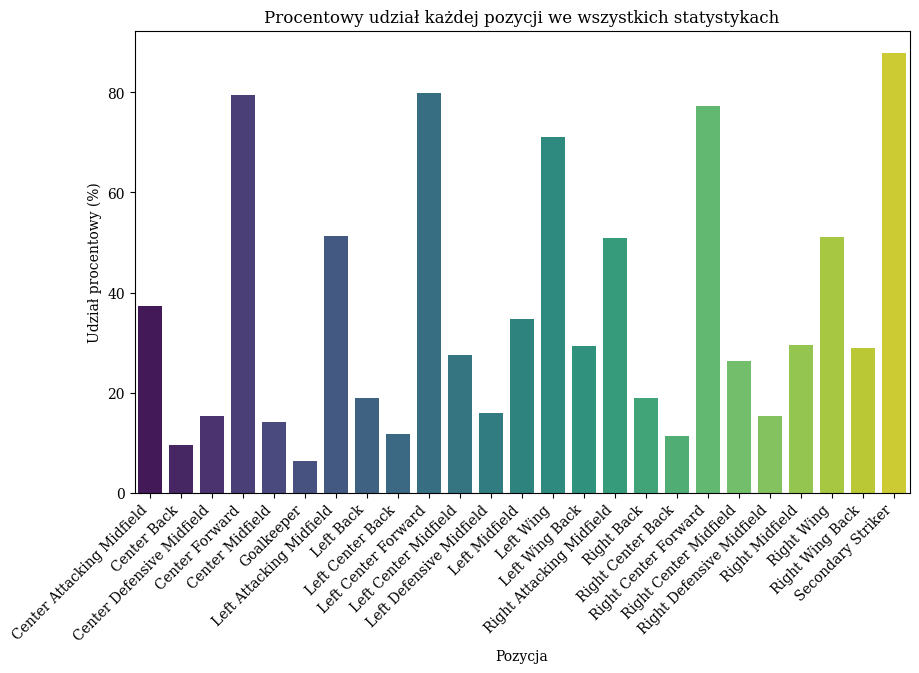

In [3460]:
df = position_stats
for col in df.columns[1:]:  # Pomijamy kolumnę 'position'
    df[col + '_percentage'] = (df[col] / df[col].sum()) * 100

# Suma procentowych udziałów dla każdej pozycji
df['total_percentage'] = df.filter(like='_percentage').sum(axis=1)

# Wizualizacja
plt.figure(figsize=(10, 6))
sns.barplot(data=df, x='position', y='total_percentage', palette='viridis')
plt.xticks(rotation=45, ha='right')
plt.title('Procentowy udział każdej pozycji we wszystkich statystykach')
plt.xlabel('Pozycja')
plt.ylabel('Udział procentowy (%)')
plt.show()

In [3461]:
df['total_percentage%'] = (df['total_percentage'] / df['total_percentage'].sum()) * 100
df = df.sort_values(by='total_percentage%')

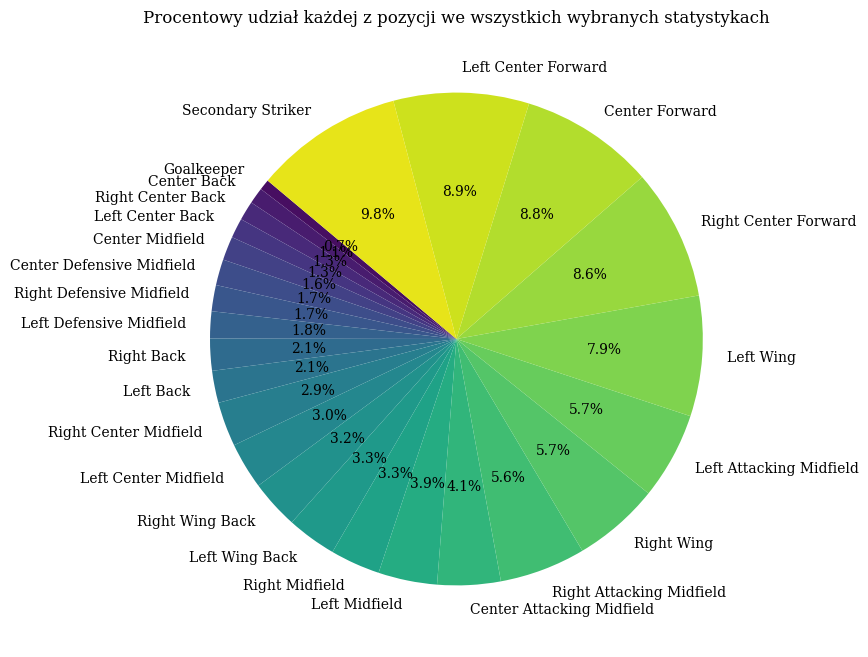

In [3462]:
# Wykres kołowy dla ostatniej kolumny 'total_percentage'
plt.figure(figsize=(8, 8))
plt.pie(df['total_percentage%'], 
        labels=df['position'], 
        autopct='%1.1f%%', 
        startangle=140, 
        colors=sns.color_palette('viridis', len(df)))
plt.title('Procentowy udział każdej z pozycji we wszystkich wybranych statystykach')
plt.show()


In [3463]:
df

,position,PAxG,xGA,xT+,shots_on_target,prog_carries,prog_pass,carries_into_pen,driblle_complete,good_passes,...,xGA_percentage,xT+_percentage,shots_on_target_percentage,prog_carries_percentage,prog_pass_percentage,carries_into_pen_percentage,driblle_complete_percentage,good_passes_percentage,total_percentage,total_percentage%
5,Goalkeeper,0.000000,0.000000,0.0220,0.0,0.0,2.0,0.0,0.0,19.0,...,0.000000,0.624645,0.0,0.000000,3.174603,0.000000,0.00,2.495076,6.294324,0.699369
1,Center Back,0.000000,0.000000,0.0650,0.0,0.0,2.0,0.0,0.0,35.0,...,0.000000,1.845542,0.0,0.000000,3.174603,0.000000,0.00,4.596192,9.616337,1.068482
17,Right Center Back,0.000000,0.000000,0.0760,0.0,0.0,3.0,0.0,0.0,34.0,...,0.000000,2.157865,0.0,0.000000,4.761905,0.000000,0.00,4.464872,11.384642,1.264960
8,Left Center Back,0.000000,0.000000,0.0780,0.0,0.0,3.0,0.0,0.0,36.0,...,0.000000,2.214651,0.0,0.000000,4.761905,0.000000,0.00,4.727511,11.704067,1.300452
4,Center Midfield,0.000000,0.000000,0.0865,0.0,1.0,2.0,0.0,0.0,41.5,...,0.000000,2.455991,0.0,2.941176,3.174603,0.000000,0.00,5.449770,14.021541,1.557949
2,Center Defensive Midfield,0.000000,0.000000,0.1000,0.0,0.0,4.0,0.0,0.0,47.0,...,0.000000,2.839296,0.0,0.000000,6.349206,0.000000,0.00,6.172029,15.360531,1.706726
20,Right Defensive Midfield,0.000000,0.000000,0.0960,0.0,1.0,3.0,0.0,0.0,38.0,...,0.000000,2.725724,0.0,2.941176,4.761905,0.000000,0.00,4.990151,15.418956,1.713217
11,Left Defensive Midfield,0.000000,0.000000,0.1050,0.0,1.0,3.0,0.0,0.0,40.0,...,0.000000,2.981261,0.0,2.941176,4.761905,0.000000,0.00,5.252791,15.937132,1.770792
16,Right Back,0.000000,0.000000,0.1605,0.0,1.0,4.0,0.0,0.0,38.0,...,0.000000,4.557070,0.0,2.941176,6.349206,0.000000,0.00,4.990151,18.837604,2.093067
7,Left Back,0.000000,0.000000,0.1600,0.0,1.0,4.0,0.0,0.0,39.0,...,0.000000,4.542873,0.0,2.941176,6.349206,0.000000,0.00,5.121471,18.954727,2.106081


In [ ]:
list(list(df.columns[10:-2]) + ['position'])

['PAxG_percentage',
 'xGA_percentage',
 'xT+_percentage',
 'shots_on_target_percentage',
 'prog_carries_percentage',
 'prog_pass_percentage',
 'carries_into_pen_percentage',
 'driblle_complete_percentage',
 'good_passes_percentage',
 'pos']

In [ ]:
a = a.append(list('position'))

In [ ]:
position_stats['position'].unique()

array(['Center Attacking Midfield', 'Center Back',
       'Center Defensive Midfield', 'Center Forward', 'Center Midfield',
       'Goalkeeper', 'Left Attacking Midfield', 'Left Back',
       'Left Center Back', 'Left Center Forward', 'Left Center Midfield',
       'Left Defensive Midfield', 'Left Midfield', 'Left Wing',
       'Left Wing Back', 'Right Attacking Midfield', 'Right Back',
       'Right Center Back', 'Right Center Forward',
       'Right Center Midfield', 'Right Defensive Midfield',
       'Right Midfield', 'Right Wing', 'Right Wing Back',
       'Secondary Striker'], dtype=object)

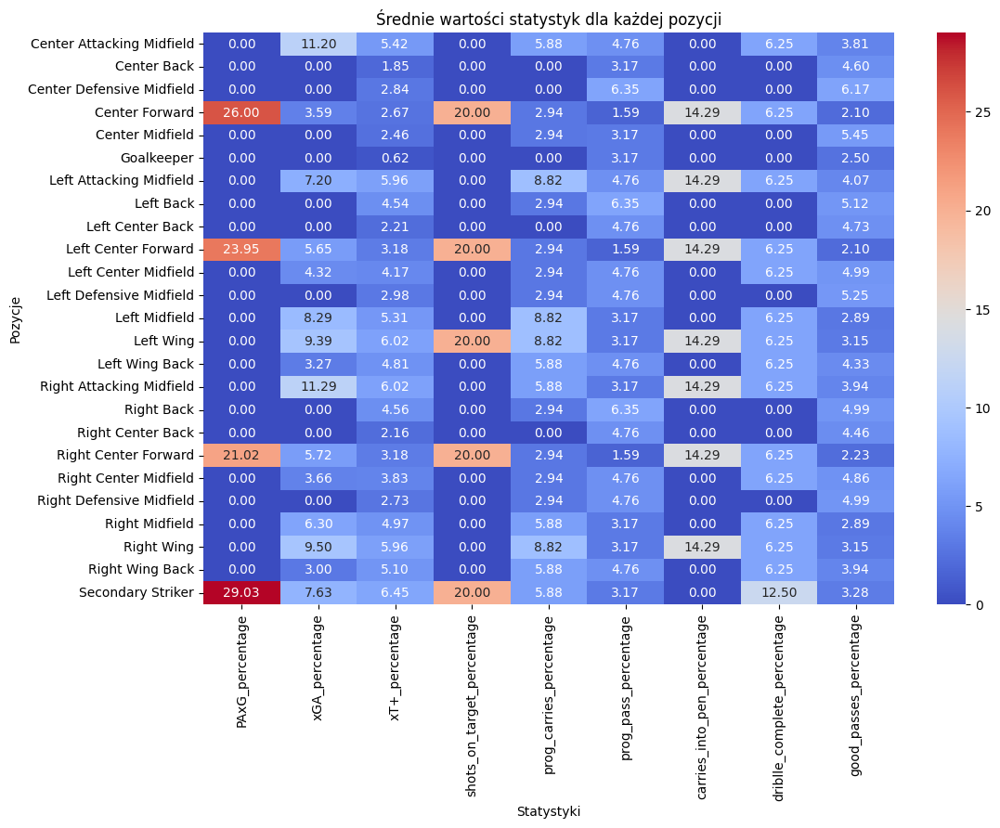

In [ ]:
# Grupowanie po pozycji i obliczenie średnich wartości
position_means = df[list(list(df.columns[10:-2]) + ['position'])].groupby('position').mean()

# Wizualizacja: Heatmapa
import seaborn as sns
import matplotlib.pyplot as plt

plt.figure(figsize=(12, 8))
sns.heatmap(position_means, annot=True, fmt=".2f", cmap='coolwarm', cbar=True)
plt.title('Średnie wartości statystyk dla każdej pozycji')
plt.xlabel('Statystyki')
plt.ylabel('Pozycje')
plt.show()

Po tej analizie weźmiemy zawodników o następujących pozycjach:

In [ ]:
pos = ['Center Attacking Midfield',
     'Center Forward',
       'Center Midfield',
    'Left Attacking Midfield',
        'Left Center Forward',
        'Left Center Midfield',
       'Left Midfield', 
       'Left Wing',
       'Right Attacking Midfield',
         'Right Center Forward',
       'Right Center Midfield', 
       'Right Midfield', 
       'Right Wing', 
       'Secondary Striker'
       ]

Zobaczmy jak teraz układają się dane.

In [ ]:
players6 = players5[players5['position'].isin(pos)]

In [ ]:
data_pos = data9[data9['position'].isin(pos)]

In [ ]:
# Grupowanie po pozycjach i obliczenie średnich statystyk
position_stats = data_pos.groupby('position')[['PAxG', 'xGA', 'xT+', 'shots_on_target', 
                                         'prog_carries', 'prog_pass', 
                                         'carries_into_pen', 'driblle_complete', 
                                         'good_passes']].median().reset_index()


In [ ]:
from sklearn.preprocessing import StandardScaler

# Skalowanie statystyk
scaler = StandardScaler()
position_stats_scaled = position_stats.copy()
position_stats_scaled.iloc[:, 1:] = scaler.fit_transform(position_stats.iloc[:, 1:])


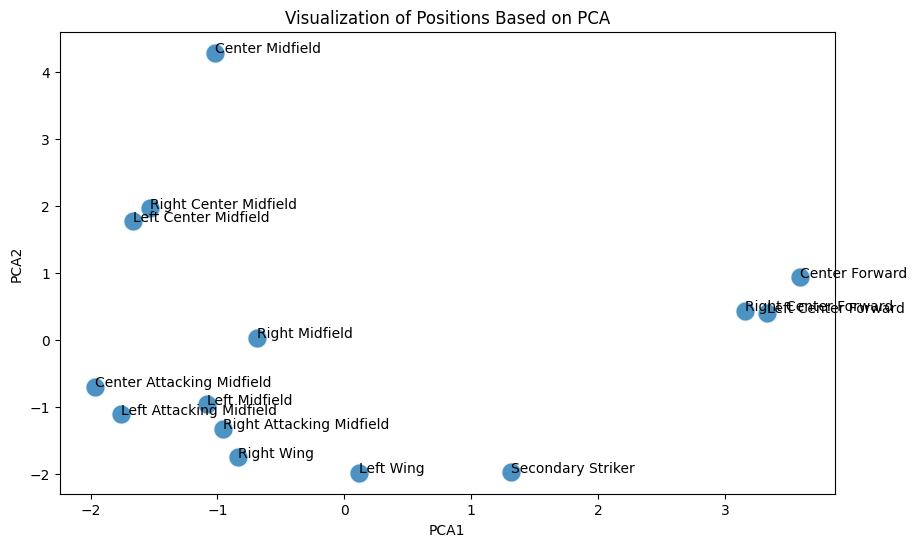

In [ ]:

# PCA na 2 wymiary (bez klasteryzacji)
pca = PCA(n_components=2)
pca_result = pca.fit_transform(position_stats_scaled.iloc[:, 1:])  # Bez 'position'
position_stats_scaled['PCA1'] = pca_result[:, 0]
position_stats_scaled['PCA2'] = pca_result[:, 1]

# Wykres bez klastrów
plt.figure(figsize=(10, 6))
sns.scatterplot(data=position_stats_scaled, x='PCA1', y='PCA2', 
                palette='tab10', s=200, alpha=0.8)

# Dodanie etykiet pozycji
for i in range(position_stats_scaled.shape[0]):
    plt.text(position_stats_scaled['PCA1'].iloc[i], 
             position_stats_scaled['PCA2'].iloc[i], 
             position_stats_scaled['position'].iloc[i], fontsize=10)

plt.title('Visualization of Positions Based on PCA')
plt.xlabel('PCA1')
plt.ylabel('PCA2')
plt.show()

Usuwamy Right Center Midfield i Left i Right

In [ ]:
pos = ['Center Attacking Midfield',
     'Center Forward',
    'Left Attacking Midfield',
        'Left Center Forward',
       'Left Midfield', 
       'Left Wing',
       'Right Attacking Midfield',
         'Right Center Forward',
       'Right Midfield', 
       'Right Wing', 
       'Secondary Striker'
       ]

In [ ]:
data_pos = data9[data9['position'].isin(pos)]

In [ ]:
# Grupowanie po pozycjach i obliczenie średnich statystyk
position_stats = data_pos.groupby('position')[['PAxG', 'xGA', 'xT+', 'shots_on_target', 
                                         'prog_carries', 'prog_pass', 
                                         'carries_into_pen', 'driblle_complete', 
                                         'good_passes']].median().reset_index()


In [ ]:
from sklearn.preprocessing import StandardScaler

# Skalowanie statystyk
scaler = StandardScaler()
position_stats_scaled = position_stats.copy()
position_stats_scaled.iloc[:, 1:] = scaler.fit_transform(position_stats.iloc[:, 1:])


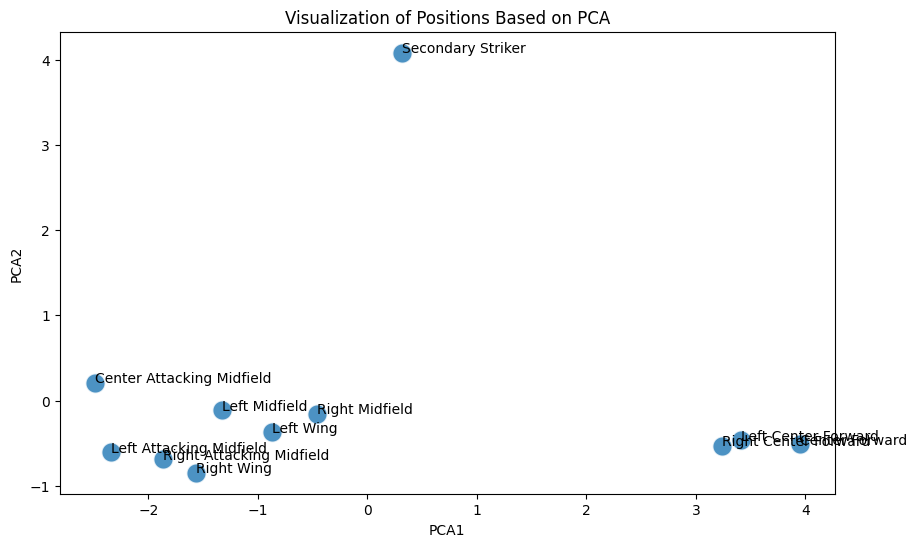

In [ ]:

# PCA na 2 wymiary (bez klasteryzacji)
pca = PCA(n_components=2)
pca_result = pca.fit_transform(position_stats_scaled.iloc[:, 1:])  # Bez 'position'
position_stats_scaled['PCA1'] = pca_result[:, 0]
position_stats_scaled['PCA2'] = pca_result[:, 1]

# Wykres bez klastrów
plt.figure(figsize=(10, 6))
sns.scatterplot(data=position_stats_scaled, x='PCA1', y='PCA2', 
                palette='tab10', s=200, alpha=0.8)

# Dodanie etykiet pozycji
for i in range(position_stats_scaled.shape[0]):
    plt.text(position_stats_scaled['PCA1'].iloc[i], 
             position_stats_scaled['PCA2'].iloc[i], 
             position_stats_scaled['position'].iloc[i], fontsize=10)

plt.title('Visualization of Positions Based on PCA')
plt.xlabel('PCA1')
plt.ylabel('PCA2')
plt.show()

In [ ]:
from sklearn.cluster import KMeans

# Klasteryzacja na 3 grupy
kmeans = KMeans(n_clusters=2, random_state=42)
position_stats_scaled['cluster'] = kmeans.fit_predict(position_stats_scaled.iloc[:, 1:])

# Dodanie grup do oryginalnych danych
position_stats['cluster'] = position_stats_scaled['cluster']


c:\Users\macie\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


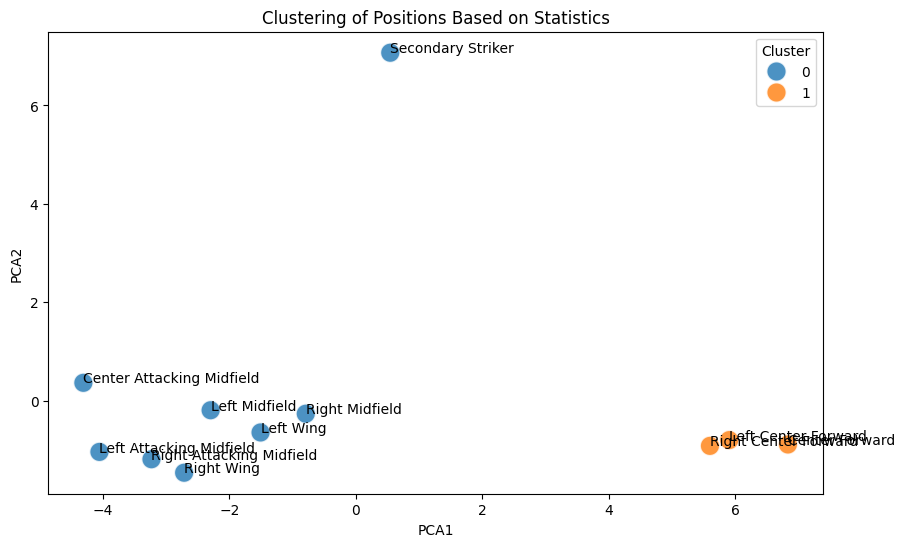

In [ ]:
from sklearn.decomposition import PCA
import seaborn as sns
import matplotlib.pyplot as plt

# PCA na 2 wymiary
pca = PCA(n_components=2)
pca_result = pca.fit_transform(position_stats_scaled.iloc[:, 1:-1])  # Bez 'position' i 'cluster'
position_stats_scaled['PCA1'] = pca_result[:, 0]
position_stats_scaled['PCA2'] = pca_result[:, 1]

# Wykres
plt.figure(figsize=(10, 6))
sns.scatterplot(data=position_stats_scaled, x='PCA1', y='PCA2', hue='cluster', 
                palette='tab10', s=200, alpha=0.8)

# Dodanie etykiet pozycji
for i in range(position_stats_scaled.shape[0]):
    plt.text(position_stats_scaled['PCA1'].iloc[i], 
             position_stats_scaled['PCA2'].iloc[i], 
             position_stats_scaled['position'].iloc[i], fontsize=10)

plt.title('Clustering of Positions Based on Statistics')
plt.xlabel('PCA1')
plt.ylabel('PCA2')
plt.legend(title='Cluster')
plt.show()


Podzielimy na 2 grupy:
- napastnicy
- ofensywni pomocnicy

In [ ]:
pos

['Center Attacking Midfield',
 'Center Forward',
 'Left Attacking Midfield',
 'Left Center Forward',
 'Left Midfield',
 'Left Wing',
 'Right Attacking Midfield',
 'Right Center Forward',
 'Right Midfield',
 'Right Wing',
 'Secondary Striker']

In [ ]:
pos_strikers = ['Center Forward',
 'Left Center Forward',
 'Right Center Forward',
 'Secondary Striker']

In [ ]:
pos_wings = ['Center Attacking Midfield',
 
 'Left Attacking Midfield',

 'Left Midfield',
 'Left Wing',
 'Right Attacking Midfield',
 
 'Right Midfield',
 'Right Wing',
 ]

Zmapujmy pozycje

In [ ]:
data_pos.groupby('position').size()

position
Center Attacking Midfield    2197
Center Forward               3839
Left Attacking Midfield       167
Left Center Forward          1566
Left Midfield                1475
Left Wing                    2956
Right Attacking Midfield      159
Right Center Forward         1563
Right Midfield               1489
Right Wing                   2880
Secondary Striker               7
dtype: int64

In [ ]:
def assign_pos(position):
    if position in pos_strikers:
        return 'Striker'
    else:
        return 'Midfield'

In [ ]:
data = data_pos.copy()

In [ ]:
data['grouped_position'] = data['position'].apply(assign_pos)

In [ ]:
data.groupby('grouped_position').size()

grouped_position
Midfield    11323
Striker      6975
dtype: int64

Zobaczmy wpływ statystyk tych piłkarzy na model (bez różnicy w pozycjach)

In [ ]:
data_full1 = data.groupby(['match_id', 'team'])[data.columns[5:-1]].sum().reset_index()

In [ ]:
final_df

,match_id,match_date,team,team_result,goals_scored,goals_conceded,result_numeric
0,3943077,2024-07-15,Argentina,Win,1,0,1
1,3943077,2024-07-15,Colombia,Lose,0,1,-1
2,3943076,2024-07-14,Canada,Draw,2,2,0
3,3943076,2024-07-14,Uruguay,Draw,2,2,0
4,3942852,2024-07-11,Uruguay,Lose,0,1,-1
...,...,...,...,...,...,...,...
5843,3888854,1962-05-30,Mexico,Lose,0,2,-1
5844,3888705,1958-06-29,Brazil,Win,5,2,1
5845,3888705,1958-06-29,Sweden,Lose,2,5,-1
5846,3888704,1958-06-24,Brazil,Win,5,2,1


In [ ]:
data_full2 = data_full1.merge(final_df[['match_id', 'team', 'result_numeric']], on=['match_id', 'team'], how='left')

In [ ]:
for col in data_full2.columns[5:-1]:
    data_full2[f"{col}_diff"] = data_full2.groupby('match_id')[col].transform(
        lambda x: (
        (x.diff() / x.max()).fillna(-x.diff().iloc[-1] / x.max()) * 100
        if x.max() != 0 else 0
    )
    )

In [ ]:
data_full2 = data_full2.dropna()

In [ ]:
stats = ['PAxG_diff', 'xGA_diff', 'xT+_diff', 'shots_on_target_diff', 'prog_carries_diff',
         'prog_pass_diff', 'carries_into_pen_diff', 'driblle_complete_diff', 'good_passes_diff']

# Normalizacja
scaler = StandardScaler()
df_scaled = data_full2.copy()
df_scaled[stats] = scaler.fit_transform(data_full2[stats])

In [ ]:
df_scaled[stats].isna().sum()

PAxG_diff                0
xGA_diff                 0
xT+_diff                 0
shots_on_target_diff     0
prog_carries_diff        0
prog_pass_diff           0
carries_into_pen_diff    0
driblle_complete_diff    0
good_passes_diff         0
dtype: int64

In [ ]:
X = df_scaled[stats]
X = sm.add_constant(X)  # Dodanie stałej (biasu) do modelu

# Zmienna zależna (rezultat meczu)
y = df_scaled["result_numeric"]

# Regresja liniowa
model = sm.OLS(y, X).fit()
print(model.summary())

                            OLS Regression Results                            
Dep. Variable:         result_numeric   R-squared:                       0.343
Model:                            OLS   Adj. R-squared:                  0.342
Method:                 Least Squares   F-statistic:                     338.4
Date:                Fri, 10 Jan 2025   Prob (F-statistic):               0.00
Time:                        14:29:21   Log-Likelihood:                -6255.5
No. Observations:                5844   AIC:                         1.253e+04
Df Residuals:                    5834   BIC:                         1.260e+04
Df Model:                           9                                         
Covariance Type:            nonrobust                                         
                            coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------------------------
const                         

A może jednak różnica zwykła?

In [ ]:
data_full2.columns[5:-10]

Index(['PAxG', 'xGA', 'xT+', 'shots_on_target', 'prog_carries', 'prog_pass',
       'carries_into_pen', 'driblle_complete', 'good_passes'],
      dtype='object')

In [ ]:
for col in data_full2.columns[5:-10]:
    data_full2[f"{col}_diff2"] = data_full2.groupby('match_id')[col].transform(
        lambda x: x.diff().fillna(-x.diff().iloc[-1])
    )

In [ ]:
data_full2.columns[24:]

Index(['PAxG_diff2', 'xGA_diff2', 'xT+_diff2', 'shots_on_target_diff2',
       'prog_carries_diff2', 'prog_pass_diff2', 'carries_into_pen_diff2',
       'driblle_complete_diff2', 'good_passes_diff2'],
      dtype='object')

In [ ]:
scaler = StandardScaler()
df_scaled = data_full2.copy()
df_scaled[data_full2.columns[24:]] = scaler.fit_transform(data_full2[data_full2.columns[24:]])

In [ ]:
df_scaled.columns[24:]

Index(['PAxG_diff2', 'xGA_diff2', 'xT+_diff2', 'shots_on_target_diff2',
       'prog_carries_diff2', 'prog_pass_diff2', 'carries_into_pen_diff2',
       'driblle_complete_diff2', 'good_passes_diff2'],
      dtype='object')

In [ ]:
X = df_scaled[data_full2.columns[24:]]
X = sm.add_constant(X)  # Dodanie stałej (biasu) do modelu

# Zmienna zależna (rezultat meczu)
y = df_scaled["result_numeric"]

# Regresja liniowa
model = sm.OLS(y, X).fit()
print(model.summary())

                            OLS Regression Results                            
Dep. Variable:         result_numeric   R-squared:                       0.446
Model:                            OLS   Adj. R-squared:                  0.446
Method:                 Least Squares   F-statistic:                     522.6
Date:                Fri, 10 Jan 2025   Prob (F-statistic):               0.00
Time:                        14:40:55   Log-Likelihood:                -5755.2
No. Observations:                5844   AIC:                         1.153e+04
Df Residuals:                    5834   BIC:                         1.160e+04
Df Model:                           9                                         
Covariance Type:            nonrobust                                         
                             coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------------
const                       

In [ ]:
list(list(data_full2.columns[24:]) + ['result_numeric'])

['PAxG_diff2',
 'xGA_diff2',
 'xT+_diff2',
 'shots_on_target_diff2',
 'prog_carries_diff2',
 'prog_pass_diff2',
 'carries_into_pen_diff2',
 'driblle_complete_diff2',
 'good_passes_diff2',
 'result_numeric']

In [ ]:
data_full2_corr = data_full2[list(list(data_full2.columns[24:]) + ['result_numeric'])]

In [ ]:
data_full2_corr.corr()

,PAxG_diff2,xGA_diff2,xT+_diff2,shots_on_target_diff2,prog_carries_diff2,prog_pass_diff2,carries_into_pen_diff2,driblle_complete_diff2,good_passes_diff2,result_numeric
PAxG_diff2,1.000000,0.491041,0.433365,0.851139,0.420668,0.369705,0.459792,0.364354,0.398538,0.628533
xGA_diff2,0.491041,1.000000,0.694814,0.550179,0.420224,0.519463,0.464619,0.341181,0.459544,0.460029
xT+_diff2,0.433365,0.694814,1.000000,0.564155,0.645202,0.703468,0.607285,0.494984,0.707092,0.394805
shots_on_target_diff2,0.851139,0.550179,0.564155,1.000000,0.491509,0.450118,0.552415,0.418850,0.484560,0.542885
prog_carries_diff2,0.420668,0.420224,0.645202,0.491509,1.000000,0.492496,0.690003,0.560179,0.604121,0.401411
prog_pass_diff2,0.369705,0.519463,0.703468,0.450118,0.492496,1.000000,0.429582,0.384546,0.702984,0.302296
carries_into_pen_diff2,0.459792,0.464619,0.607285,0.552415,0.690003,0.429582,1.000000,0.501066,0.503653,0.428032
driblle_complete_diff2,0.364354,0.341181,0.494984,0.418850,0.560179,0.384546,0.501066,1.000000,0.487098,0.307504
good_passes_diff2,0.398538,0.459544,0.707092,0.484560,0.604121,0.702984,0.503653,0.487098,1.000000,0.332271
result_numeric,0.628533,0.460029,0.394805,0.542885,0.401411,0.302296,0.428032,0.307504,0.332271,1.000000


In [ ]:
df_scaled

,match_id,team,minute,goals,assist,PAxG,xGA,xT+,shots_on_target,prog_carries,...,good_passes_diff,PAxG_diff2,xGA_diff2,xT+_diff2,shots_on_target_diff2,prog_carries_diff2,prog_pass_diff2,carries_into_pen_diff2,driblle_complete_diff2,good_passes_diff2
0,7525,Russia,289.0,3.0,2.0,4.207104,0.591496,1.113,4.0,13.0,...,-14.814815,2.258436,1.011062,1.358049,1.354381,0.535016,0.821995,1.89994,1.222038,-0.231103
1,7525,Saudi Arabia,244.0,0.0,0.0,-0.110109,0.011307,0.204,0.0,9.0,...,14.814815,-2.258436,-1.011062,-1.358049,-1.354381,-0.535016,-0.821995,-1.89994,-1.222038,0.231103
2,7529,Croatia,251.0,0.0,0.0,-0.402414,0.431281,0.611,0.0,4.0,...,23.943662,-0.356522,0.351191,0.464635,-0.338595,-0.267508,0.657596,-0.27142,-0.407346,0.327395
3,7529,Nigeria,248.0,0.0,0.0,0.279112,0.229754,0.300,1.0,6.0,...,-23.943662,0.356522,-0.351191,-0.464635,0.338595,0.267508,-0.657596,0.27142,0.407346,-0.327395
4,7530,Australia,306.0,0.0,0.0,0.562969,0.000000,0.117,1.0,3.0,...,-2.564103,-0.440568,-0.859542,-0.280873,-0.677190,-0.267508,-0.000000,-0.81426,-0.814692,-0.019259
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5841,3943043,Spain,335.0,1.0,1.0,1.704436,1.084283,0.964,3.0,12.0,...,36.190476,0.658007,1.621755,0.702181,0.677190,0.267508,0.328798,0.81426,0.000000,0.731825
5842,3943076,Canada,308.0,0.0,0.0,0.427224,1.432608,1.124,2.0,2.0,...,83.333333,-0.092270,2.496524,1.567209,0.338595,-0.000000,0.986394,-0.00000,0.611019,1.059220
5843,3943076,Uruguay,120.0,0.0,0.0,0.603607,0.000000,0.075,1.0,2.0,...,-83.333333,0.092270,-2.496524,-1.567209,-0.338595,0.000000,-0.986394,0.00000,-0.611019,-1.059220
5844,3943077,Argentina,335.0,0.0,0.0,0.814088,0.239595,0.751,2.0,8.0,...,18.811881,0.200320,-0.132085,-0.194220,0.338595,0.267508,-0.328798,0.81426,0.407346,0.365912


In [ ]:
X = data_full2[data_full2.columns[24:]]
X = sm.add_constant(X)  # Dodanie stałej (biasu) do modelu

# Zmienna zależna (rezultat meczu)
y = data_full2["result_numeric"]

# Regresja liniowa
model = sm.OLS(y, X).fit()
print(model.summary())

                            OLS Regression Results                            
Dep. Variable:         result_numeric   R-squared:                       0.446
Model:                            OLS   Adj. R-squared:                  0.446
Method:                 Least Squares   F-statistic:                     522.6
Date:                Fri, 10 Jan 2025   Prob (F-statistic):               0.00
Time:                        14:47:53   Log-Likelihood:                -5755.2
No. Observations:                5844   AIC:                         1.153e+04
Df Residuals:                    5834   BIC:                         1.160e+04
Df Model:                           9                                         
Covariance Type:            nonrobust                                         
                             coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------------
const                       

In [ ]:
X = data_full2[data_full2.columns[5:14]]
X = sm.add_constant(X)  # Dodanie stałej (biasu) do modelu

# Zmienna zależna (rezultat meczu)
y = data_full2["result_numeric"]

# Regresja liniowa
model = sm.OLS(y, X).fit()
print(model.summary())

                            OLS Regression Results                            
Dep. Variable:         result_numeric   R-squared:                       0.261
Model:                            OLS   Adj. R-squared:                  0.260
Method:                 Least Squares   F-statistic:                     228.7
Date:                Fri, 10 Jan 2025   Prob (F-statistic):               0.00
Time:                        14:47:59   Log-Likelihood:                -6600.0
No. Observations:                5844   AIC:                         1.322e+04
Df Residuals:                    5834   BIC:                         1.329e+04
Df Model:                           9                                         
Covariance Type:            nonrobust                                         
                       coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------
const               -0.6206      0.024  

Dobra, a więc zrobimy jeszcze random foresta, a potem osobno dla napastników, osobno dla pomocników i dobierzemy wagi.
Następnie stworzymy model i porównamy z sofą/flashem.
Później zobaczymy co oni biorą do modelu.
I na koniec zobaczymy czy nasze metryki mają wpływ na miejsce w tabeli na koniec sezonu/miejsce w turnieju.

Regresja logistyczna

In [ ]:
df_scaled_bin = df_scaled[((df_scaled['result_numeric']==1) | (df_scaled['result_numeric'] == -1))]

In [ ]:
df_scaled_bin

,match_id,team,minute,goals,assist,PAxG,xGA,xT+,shots_on_target,prog_carries,...,good_passes_diff,PAxG_diff2,xGA_diff2,xT+_diff2,shots_on_target_diff2,prog_carries_diff2,prog_pass_diff2,carries_into_pen_diff2,driblle_complete_diff2,good_passes_diff2
0,7525,Russia,289.0,3.0,2.0,4.207104,0.591496,1.113,4.0,13.0,...,-14.814815,2.258436,1.011062,1.358049,1.354381,0.535016,0.821995,1.89994,1.222038,-0.231103
1,7525,Saudi Arabia,244.0,0.0,0.0,-0.110109,0.011307,0.204,0.0,9.0,...,14.814815,-2.258436,-1.011062,-1.358049,-1.354381,-0.535016,-0.821995,-1.89994,-1.222038,0.231103
2,7529,Croatia,251.0,0.0,0.0,-0.402414,0.431281,0.611,0.0,4.0,...,23.943662,-0.356522,0.351191,0.464635,-0.338595,-0.267508,0.657596,-0.27142,-0.407346,0.327395
3,7529,Nigeria,248.0,0.0,0.0,0.279112,0.229754,0.300,1.0,6.0,...,-23.943662,0.356522,-0.351191,-0.464635,0.338595,0.267508,-0.657596,0.27142,0.407346,-0.327395
4,7530,Australia,306.0,0.0,0.0,0.562969,0.000000,0.117,1.0,3.0,...,-2.564103,-0.440568,-0.859542,-0.280873,-0.677190,-0.267508,-0.000000,-0.81426,-0.814692,-0.019259
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5839,3942852,Uruguay,180.0,0.0,0.0,0.350013,0.224754,0.597,1.0,10.0,...,-24.444444,-0.092351,-0.050298,-0.328681,0.000000,0.802525,0.164399,0.54284,0.000000,-0.211844
5840,3943043,England,329.0,0.0,1.0,0.446593,0.153654,0.494,1.0,10.0,...,-36.190476,-0.658007,-1.621755,-0.702181,-0.677190,-0.267508,-0.328798,-0.81426,-0.000000,-0.731825
5841,3943043,Spain,335.0,1.0,1.0,1.704436,1.084283,0.964,3.0,12.0,...,36.190476,0.658007,1.621755,0.702181,0.677190,0.267508,0.328798,0.81426,0.000000,0.731825
5844,3943077,Argentina,335.0,0.0,0.0,0.814088,0.239595,0.751,2.0,8.0,...,18.811881,0.200320,-0.132085,-0.194220,0.338595,0.267508,-0.328798,0.81426,0.407346,0.365912


In [ ]:
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report

# Dane wejściowe i wynikowe
X = df_scaled[df_scaled.columns[24:]]  # Wybierz kolumny statystyk
y = df_scaled['result_numeric']

# Podział na zbiór treningowy i testowy
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=40)

# Regresja logistyczna
model = LogisticRegression(multi_class='multinomial', solver='lbfgs', max_iter=1000)
model.fit(X_train, y_train)

# Wyniki
y_pred = model.predict(X_test)
print(classification_report(y_test, y_pred))

# Wagi cech
coefficients = model.coef_
feature_importance = pd.DataFrame(coefficients, columns=X.columns, index=model.classes_)
print(feature_importance)


              precision    recall  f1-score   support

          -1       0.67      0.83      0.74       437
           0       0.39      0.09      0.15       276
           1       0.68      0.83      0.75       456

    accuracy                           0.66      1169
   macro avg       0.58      0.58      0.55      1169
weighted avg       0.61      0.66      0.60      1169

    PAxG_diff2  xGA_diff2  xT+_diff2  shots_on_target_diff2  \
-1   -1.317431  -0.485261   0.077913               0.334915   
 0   -0.007884   0.004853  -0.010315               0.006711   
 1    1.325315   0.480409  -0.067598              -0.341627   

    prog_carries_diff2  prog_pass_diff2  carries_into_pen_diff2  \
-1           -0.159663         0.088545               -0.251419   
 0           -0.002362         0.005934               -0.021065   
 1            0.162025        -0.094479                0.272484   

    driblle_complete_diff2  good_passes_diff2  
-1               -0.042449          -0.017708  
 

In [ ]:
X_test = pd.DataFrame(X_test, columns=X.columns)

In [ ]:
print(shap_values.shape)
print(X_test.shape)


(1169, 9, 3)
(1169, 9)


In [ ]:
shap_values_for_class = shap_values[:, :, 1]  # Wybór klasy 1


SHAP summary plot for class 0


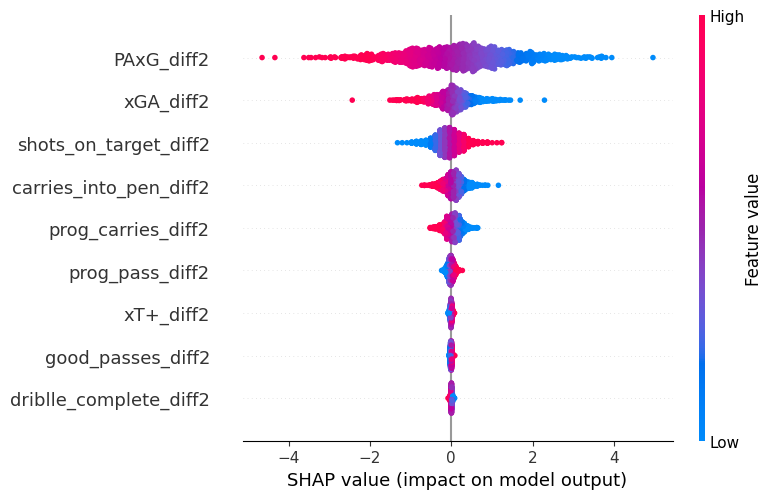

SHAP summary plot for class 1


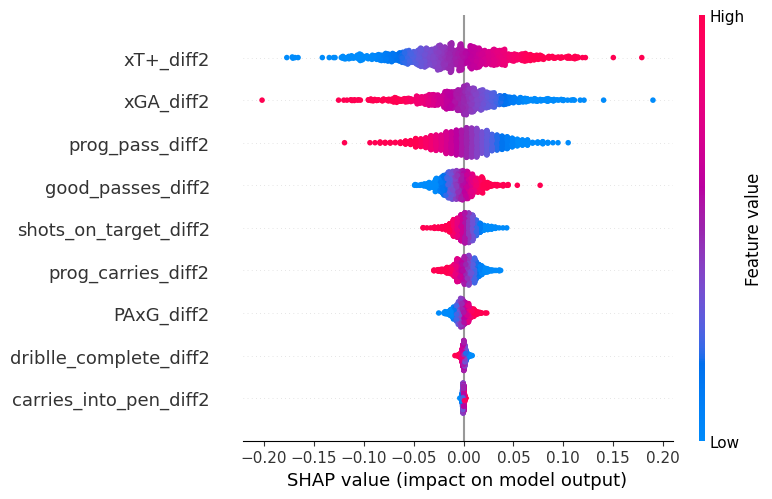

SHAP summary plot for class 2


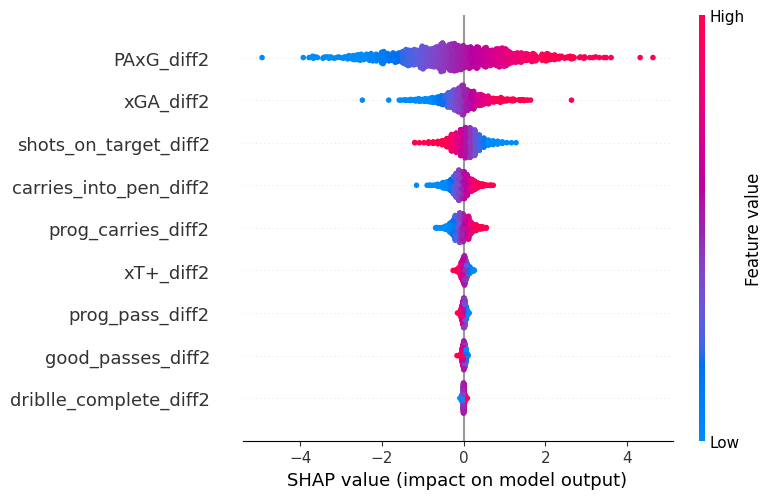

In [ ]:
import shap

explainer = shap.Explainer(model, X_train)
shap_values = explainer(X_test)

# Wizualizacja wpływu cech
for class_idx in range(shap_values.shape[2]):
    print(f"SHAP summary plot for class {class_idx}")
    shap.summary_plot(shap_values[:, :, class_idx], X_test)


In [ ]:
from sklearn.ensemble import RandomForestClassifier

# Dopasowanie modelu
rf_model = RandomForestClassifier(random_state=42)
rf_model.fit(X, y)

# Znaczenie cech
importances = rf_model.feature_importances_
feature_importance = pd.DataFrame({'Feature': X.columns, 'Importance': importances})
feature_importance = feature_importance.sort_values(by='Importance', ascending=False)

print(feature_importance)

                  Feature  Importance
0              PAxG_diff2    0.270054
1               xGA_diff2    0.147362
2               xT+_diff2    0.107554
8       good_passes_diff2    0.090980
3   shots_on_target_diff2    0.090890
4      prog_carries_diff2    0.080177
5         prog_pass_diff2    0.072322
6  carries_into_pen_diff2    0.071277
7  driblle_complete_diff2    0.069383


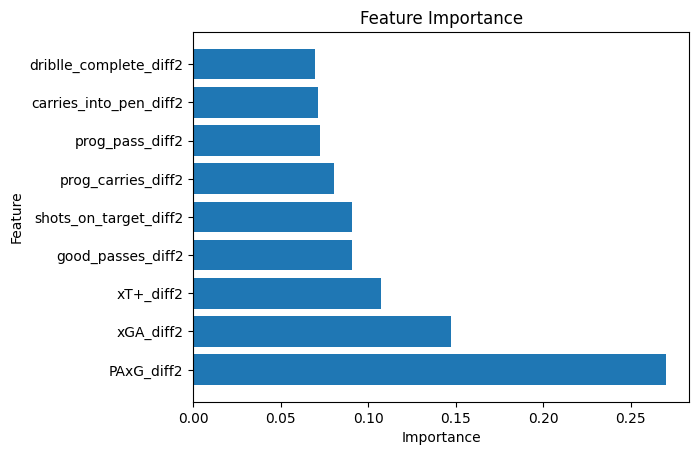

In [ ]:
import matplotlib.pyplot as plt
plt.barh(feature_importance['Feature'], feature_importance['Importance'])
plt.xlabel('Importance')
plt.ylabel('Feature')
plt.title('Feature Importance')
plt.show()


In [ ]:
from sklearn.cluster import KMeans

# Klasteryzacja
kmeans = KMeans(n_clusters=3, random_state=42)
df_scaled['cluster'] = kmeans.fit_predict(X)

# Analiza wyników w klastrach
print(df_scaled.groupby('cluster')['result_numeric'].mean())

cluster
0   -0.016455
1    0.611348
2   -0.625735
Name: result_numeric, dtype: float64


c:\Users\macie\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


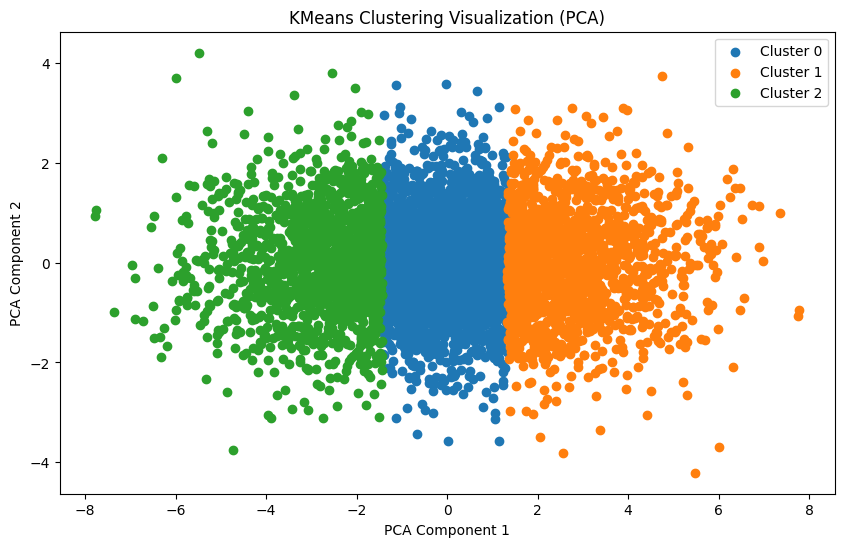

In [ ]:
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt

# Redukcja wymiarów do 2D
pca = PCA(n_components=2)
X_pca = pca.fit_transform(X)

# Wizualizacja klastrów
plt.figure(figsize=(10, 6))
for cluster_id in range(3):  # Liczba klastrów
    cluster_points = X_pca[df_scaled['cluster'] == cluster_id]
    plt.scatter(cluster_points[:, 0], cluster_points[:, 1], label=f'Cluster {cluster_id}')

plt.xlabel('PCA Component 1')
plt.ylabel('PCA Component 2')
plt.title('KMeans Clustering Visualization (PCA)')
plt.legend()
plt.show()


A może na bramki strzelone? Bo to xT+ mnie martwi :(

In [ ]:
df_scaled = df_scaled[df_scaled.columns[:-1]]

Nie bierzmy remisów i weźmy wpływ na bramki strzelone
Ale weźmy wszystkich zawodników żeby zobaczyć lepiej

In [ ]:
dtf_corr = data9.groupby(['match_id', 'team'])[data9.columns[6:]].sum().reset_index()

In [ ]:
dtf_corr2 = dtf_corr.merge(final_df[['match_id', 'team', 'result_numeric']], on=['match_id', 'team'], how='left')

In [ ]:
def determine_result(group):
    # Pobierz gole obu zespołów
    goals = group['goals'].values
    # Porównaj gole
    if len(goals) == 2:  # Dla każdego meczu powinny być dwa wiersze
        if goals[0] > goals[1]:
            group['result'] = [1, -1]
        elif goals[0] < goals[1]:
            group['result'] = [-1, 1]
        else:
            group['result'] = [0, 0]
    return group

# Grupowanie po match_id i obliczanie kolumny result


In [ ]:
dtf_corr3 = dtf_corr2.groupby('match_id').apply(determine_result).reset_index(drop=True)

In [ ]:
dtf_corr4 = dtf_corr3[dtf_corr3['result']!=0]

In [ ]:
dtf_corr4

,match_id,team,goals,assist,PAxG,xGA,xT+,shots_on_target,prog_carries,prog_pass,carries_into_pen,driblle_complete,good_passes,result_numeric,result
0,7525,Russia,4.0,3.0,4.763959,0.888566,1.629,6.0,17.0,38.0,9.0,7.0,246.0,1,1
1,7525,Saudi Arabia,0.0,0.0,-0.209112,0.167965,0.981,0.0,16.0,15.0,2.0,4.0,451.0,-1,-1
2,7529,Croatia,1.0,0.0,-0.432150,0.566861,1.612,1.0,13.0,38.0,2.0,4.0,351.0,1,1
3,7529,Nigeria,0.0,0.0,0.751728,0.543510,1.039,2.0,10.0,26.0,3.0,11.0,314.0,-1,-1
8,7532,Denmark,1.0,1.0,1.302632,0.877147,1.266,2.0,13.0,27.0,5.0,7.0,268.0,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5837,3942785,Canada,0.0,0.0,0.448567,0.315152,1.154,1.0,21.0,19.0,2.0,5.0,325.0,-1,-1
5840,3942852,Colombia,1.0,1.0,2.641839,0.349419,1.357,3.0,9.0,21.0,1.0,5.0,181.0,1,1
5841,3942852,Uruguay,0.0,0.0,0.138556,0.356354,1.507,2.0,26.0,31.0,4.0,5.0,306.0,-1,-1
5842,3943043,England,0.0,1.0,0.840982,0.153654,0.902,2.0,12.0,17.0,3.0,4.0,247.0,-1,-1


In [ ]:
for col in dtf_corr4.columns[2:-2]:
    dtf_corr4[f"{col}_diff"] = dtf_corr4.groupby('match_id')[col].transform(
        lambda x: x.diff().fillna(-x.diff().iloc[-1])
    )

C:\Users\macie\AppData\Local\Temp\ipykernel_30508\3362208408.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dtf_corr4[f"{col}_diff"] = dtf_corr4.groupby('match_id')[col].transform(
C:\Users\macie\AppData\Local\Temp\ipykernel_30508\3362208408.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dtf_corr4[f"{col}_diff"] = dtf_corr4.groupby('match_id')[col].transform(
C:\Users\macie\AppData\Local\Temp\ipykernel_30508\3362208408.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice

In [ ]:
dtf_corr4[dtf_corr4.columns[2:]].corr()

,goals,assist,PAxG,xGA,xT+,shots_on_target,prog_carries,prog_pass,carries_into_pen,driblle_complete,...,assist_diff,PAxG_diff,xGA_diff,xT+_diff,shots_on_target_diff,prog_carries_diff,prog_pass_diff,carries_into_pen_diff,driblle_complete_diff,good_passes_diff
goals,1.000000,0.778000,0.828674,0.573224,0.399910,0.680713,0.344478,0.205121,0.433199,0.273721,...,0.675811,0.712443,0.551358,0.401316,0.610081,0.377450,0.263066,0.447404,0.321762,0.355462
assist,0.778000,1.000000,0.671998,0.643789,0.397348,0.533268,0.316748,0.210901,0.385808,0.235443,...,0.788419,0.579366,0.558991,0.369768,0.482438,0.328302,0.247372,0.383727,0.268225,0.315830
PAxG,0.828674,0.671998,1.000000,0.527279,0.423631,0.850658,0.394024,0.262225,0.441562,0.284916,...,0.588804,0.801263,0.506725,0.412569,0.702535,0.397168,0.301094,0.442565,0.321027,0.369748
xGA,0.573224,0.643789,0.527279,1.000000,0.672863,0.630870,0.449689,0.408118,0.515935,0.323296,...,0.564334,0.503368,0.795954,0.585906,0.567162,0.448739,0.424436,0.487119,0.348887,0.439275
xT+,0.399910,0.397348,0.423631,0.672863,1.000000,0.576298,0.651203,0.658467,0.575197,0.367028,...,0.409377,0.449441,0.642527,0.872874,0.587387,0.659329,0.693698,0.586449,0.444171,0.703750
shots_on_target,0.680713,0.533268,0.850658,0.630870,0.576298,1.000000,0.489971,0.372683,0.535794,0.329537,...,0.487405,0.698391,0.567577,0.536016,0.796536,0.477774,0.405404,0.506198,0.356197,0.454127
prog_carries,0.344478,0.316748,0.394024,0.449689,0.651203,0.489971,1.000000,0.435007,0.633810,0.475009,...,0.332583,0.395897,0.450286,0.603301,0.479071,0.798699,0.460792,0.572786,0.462485,0.572059
prog_pass,0.205121,0.210901,0.262225,0.408118,0.658467,0.372683,0.435007,1.000000,0.329037,0.236757,...,0.257984,0.308978,0.438454,0.653461,0.418488,0.474376,0.822243,0.396291,0.302557,0.624075
carries_into_pen,0.433199,0.385808,0.441562,0.515935,0.575197,0.535794,0.633810,0.329037,1.000000,0.432681,...,0.381062,0.432447,0.479157,0.526029,0.497560,0.561487,0.377350,0.782944,0.418610,0.455393
driblle_complete,0.273721,0.235443,0.284916,0.323296,0.367028,0.329537,0.475009,0.236757,0.432681,1.000000,...,0.229149,0.269863,0.295239,0.342747,0.301204,0.390023,0.247846,0.360126,0.673559,0.355439


Może OLS, Random Forest teraz lepiej? (wszyscy zawodnicy, bez remisów)

In [ ]:
dtf_corr4.columns[2]

,match_id,team,goals,assist,PAxG,xGA,xT+,shots_on_target,prog_carries,prog_pass,...,assist_diff,PAxG_diff,xGA_diff,xT+_diff,shots_on_target_diff,prog_carries_diff,prog_pass_diff,carries_into_pen_diff,driblle_complete_diff,good_passes_diff
0,7525,Russia,4.0,3.0,4.763959,0.888566,1.629,6.0,17.0,38.0,...,3.0,4.973072,0.720601,0.648,6.0,1.0,23.0,7.0,3.0,-205.0
1,7525,Saudi Arabia,0.0,0.0,-0.209112,0.167965,0.981,0.0,16.0,15.0,...,-3.0,-4.973072,-0.720601,-0.648,-6.0,-1.0,-23.0,-7.0,-3.0,205.0
2,7529,Croatia,1.0,0.0,-0.432150,0.566861,1.612,1.0,13.0,38.0,...,-0.0,-1.183878,0.023352,0.573,-1.0,3.0,12.0,-1.0,-7.0,37.0
3,7529,Nigeria,0.0,0.0,0.751728,0.543510,1.039,2.0,10.0,26.0,...,0.0,1.183878,-0.023352,-0.573,1.0,-3.0,-12.0,1.0,7.0,-37.0
8,7532,Denmark,1.0,1.0,1.302632,0.877147,1.266,2.0,13.0,27.0,...,1.0,-1.354027,-0.158020,-0.878,-3.0,-16.0,-10.0,4.0,-4.0,-64.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5837,3942785,Canada,0.0,0.0,0.448567,0.315152,1.154,1.0,21.0,19.0,...,-1.0,-1.174787,-0.715649,-0.121,-2.0,14.0,-9.0,-3.0,-2.0,-86.0
5840,3942852,Colombia,1.0,1.0,2.641839,0.349419,1.357,3.0,9.0,21.0,...,1.0,2.503283,-0.006935,-0.150,1.0,-17.0,-10.0,-3.0,-0.0,-125.0
5841,3942852,Uruguay,0.0,0.0,0.138556,0.356354,1.507,2.0,26.0,31.0,...,-1.0,-2.503283,0.006935,0.150,-1.0,17.0,10.0,3.0,0.0,125.0
5842,3943043,England,0.0,1.0,0.840982,0.153654,0.902,2.0,12.0,17.0,...,-1.0,-1.287280,-1.404527,-1.057,-2.0,-6.0,-18.0,-4.0,1.0,-213.0


In [ ]:
cols22 = list(dtf_corr4.columns[4:13]) + list(dtf_corr4.columns[15:])

In [ ]:
dtf_corr4[cols22]

,PAxG,xGA,xT+,shots_on_target,prog_carries,prog_pass,carries_into_pen,driblle_complete,good_passes,goals_diff,assist_diff,PAxG_diff,xGA_diff,xT+_diff,shots_on_target_diff,prog_carries_diff,prog_pass_diff,carries_into_pen_diff,driblle_complete_diff,good_passes_diff
0,4.763959,0.888566,1.629,6.0,17.0,38.0,9.0,7.0,246.0,4.0,3.0,4.973072,0.720601,0.648,6.0,1.0,23.0,7.0,3.0,-205.0
1,-0.209112,0.167965,0.981,0.0,16.0,15.0,2.0,4.0,451.0,-4.0,-3.0,-4.973072,-0.720601,-0.648,-6.0,-1.0,-23.0,-7.0,-3.0,205.0
2,-0.432150,0.566861,1.612,1.0,13.0,38.0,2.0,4.0,351.0,1.0,-0.0,-1.183878,0.023352,0.573,-1.0,3.0,12.0,-1.0,-7.0,37.0
3,0.751728,0.543510,1.039,2.0,10.0,26.0,3.0,11.0,314.0,-1.0,0.0,1.183878,-0.023352,-0.573,1.0,-3.0,-12.0,1.0,7.0,-37.0
8,1.302632,0.877147,1.266,2.0,13.0,27.0,5.0,7.0,268.0,1.0,1.0,-1.354027,-0.158020,-0.878,-3.0,-16.0,-10.0,4.0,-4.0,-64.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5837,0.448567,0.315152,1.154,1.0,21.0,19.0,2.0,5.0,325.0,-2.0,-1.0,-1.174787,-0.715649,-0.121,-2.0,14.0,-9.0,-3.0,-2.0,-86.0
5840,2.641839,0.349419,1.357,3.0,9.0,21.0,1.0,5.0,181.0,1.0,1.0,2.503283,-0.006935,-0.150,1.0,-17.0,-10.0,-3.0,-0.0,-125.0
5841,0.138556,0.356354,1.507,2.0,26.0,31.0,4.0,5.0,306.0,-1.0,-1.0,-2.503283,0.006935,0.150,-1.0,17.0,10.0,3.0,0.0,125.0
5842,0.840982,0.153654,0.902,2.0,12.0,17.0,3.0,4.0,247.0,-1.0,-1.0,-1.287280,-1.404527,-1.057,-2.0,-6.0,-18.0,-4.0,1.0,-213.0


In [ ]:
scaler = StandardScaler()
df_scaled2 = dtf_corr4.copy()
df_scaled2[cols22] = scaler.fit_transform(dtf_corr4[cols22])

In [ ]:
df_scaled2[df_scaled2.columns[2:13]]

,goals,assist,PAxG,xGA,xT+,shots_on_target,prog_carries,prog_pass,carries_into_pen,driblle_complete,good_passes
0,4.0,3.0,1.459285,0.284709,-0.099977,0.843304,0.061850,0.410489,1.660371,-0.343577,-0.794679
1,0.0,0.0,-1.450175,-0.990869,-0.998200,-1.567949,-0.061735,-1.693644,-0.644566,-0.922959,0.713837
2,1.0,0.0,-1.580662,-0.284760,-0.123541,-1.166073,-0.432492,0.410489,-0.644566,-0.922959,-0.022025
3,0.0,0.0,-0.888043,-0.326096,-0.917803,-0.764198,-0.803249,-0.687320,-0.315289,0.428933,-0.294293
8,1.0,1.0,-0.565740,0.264496,-0.603148,-0.764198,-0.432492,-0.595836,0.343264,-0.343577,-0.632790
...,...,...,...,...,...,...,...,...,...,...,...
5837,0.0,0.0,-1.065405,-0.730325,-0.758396,-1.166073,0.556193,-1.327708,-0.644566,-0.729831,-0.213349
5840,1.0,1.0,0.217753,-0.669667,-0.477009,-0.362322,-0.926835,-1.144740,-0.973843,-0.729831,-1.272989
5841,0.0,0.0,-1.246775,-0.657391,-0.269087,-0.764198,1.174121,-0.229899,0.013987,-0.729831,-0.353162
5842,0.0,1.0,-0.835825,-1.016203,-1.107705,-0.764198,-0.556078,-1.510676,-0.315289,-0.922959,-0.787321


In [ ]:
X = df_scaled2[df_scaled2.columns[4:13]]
X = sm.add_constant(X)  # Dodanie stałej (biasu) do modelu

# Zmienna zależna (rezultat meczu)
y = df_scaled2["goals"]

# Regresja liniowa
model = sm.OLS(y, X).fit()
print(model.summary())

                            OLS Regression Results                            
Dep. Variable:                  goals   R-squared:                       0.734
Model:                            OLS   Adj. R-squared:                  0.734
Method:                 Least Squares   F-statistic:                     1320.
Date:                Fri, 10 Jan 2025   Prob (F-statistic):               0.00
Time:                        20:25:54   Log-Likelihood:                -4416.1
No. Observations:                4308   AIC:                             8852.
Df Residuals:                    4298   BIC:                             8916.
Df Model:                           9                                         
Covariance Type:            nonrobust                                         
                       coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------
const                1.3319      0.010  

In [ ]:
rf_model = RandomForestClassifier(random_state=42)
rf_model.fit(X, y)

# Znaczenie cech
importances = rf_model.feature_importances_
feature_importance = pd.DataFrame({'Feature': X.columns, 'Importance': importances})
feature_importance = feature_importance.sort_values(by='Importance', ascending=False)

print(feature_importance)

            Feature  Importance
1              PAxG    0.318721
2               xGA    0.129079
4   shots_on_target    0.107777
9       good_passes    0.092683
3               xT+    0.091360
6         prog_pass    0.074700
5      prog_carries    0.067537
8  driblle_complete    0.061942
7  carries_into_pen    0.056202
0             const    0.000000


In [ ]:
dtf_corr4.groupby('goals')['xT+'].mean()

goals
0.0     1.410496
1.0     1.625999
2.0     1.839155
3.0     2.081114
4.0     2.298960
5.0     2.532870
6.0     2.498650
7.0     3.368800
8.0     3.330333
10.0    3.244000
Name: xT+, dtype: float64

In [ ]:
df_scaled_bin[['match_id', 'team', 'goals', 'xT+']].head(20)

,match_id,team,goals,xT+
0,7525,Russia,3.0,1.113
1,7525,Saudi Arabia,0.0,0.204
2,7529,Croatia,0.0,0.611
3,7529,Nigeria,0.0,0.300
4,7530,Australia,0.0,0.117
5,7530,France,1.0,0.305
8,7532,Denmark,1.0,0.663
9,7532,Peru,0.0,1.132
12,7534,Germany,0.0,1.143
13,7534,Mexico,1.0,0.550


Dobra nic nie wyszło. Może sprawdzimy jeszcze czy można połączyć jakieś metryki aby dawały lepszy rezultat? np. prog carries z prog passes?

In [ ]:
y

0       4.0
1       0.0
2       1.0
3       0.0
8       1.0
       ... 
5837    0.0
5840    1.0
5841    0.0
5842    0.0
5843    1.0
Name: goals, Length: 4308, dtype: float64

In [ ]:
from sklearn.preprocessing import PolynomialFeatures
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report

# Dane
X = df_scaled2[['prog_pass', 'driblle_complete', 'xT+', 'prog_carries']]  # Wybierz interesujące metryki
y = df_scaled2['result']  # Wynik meczu

# Generowanie interakcji
poly = PolynomialFeatures(degree=2, interaction_only=True, include_bias=False)
X_poly = poly.fit_transform(X)

# Podział na dane treningowe i testowe
X_train, X_test, y_train, y_test = train_test_split(X_poly, y, test_size=0.2, random_state=42)

# Modelowanie
model = RandomForestClassifier(random_state=42)
model.fit(X_train, y_train)

# Ocena
y_pred = model.predict(X_test)
print(classification_report(y_test, y_pred))


              precision    recall  f1-score   support

          -1       0.57      0.60      0.59       404
           1       0.63      0.59      0.61       458

    accuracy                           0.60       862
   macro avg       0.60      0.60      0.60       862
weighted avg       0.60      0.60      0.60       862



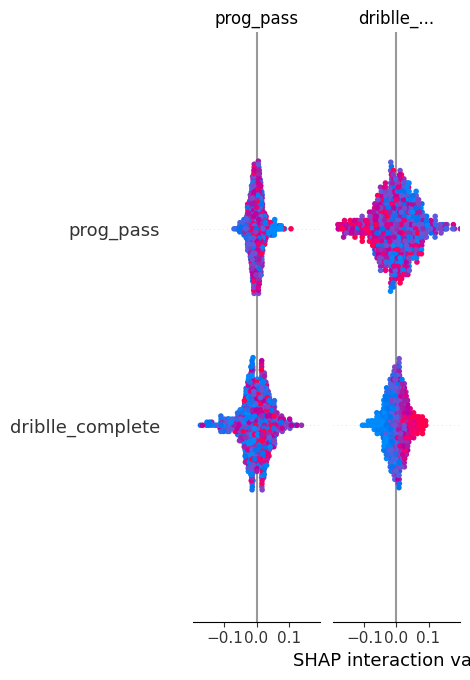

In [ ]:
import shap

explainer = shap.TreeExplainer(model)
shap_values = explainer.shap_values(X_test)

# Wizualizacja
shap.summary_plot(shap_values, X_test, feature_names=poly.get_feature_names_out())


In [ ]:
from sklearn.metrics import accuracy_score

# Model na oryginalnych metrykach
model_orig = RandomForestClassifier(random_state=42)
model_orig.fit(X_train[:, :len(X.columns)], y_train)  # Pierwsze cechy bez interakcji
y_pred_orig = model_orig.predict(X_test[:, :len(X.columns)])

# Porównanie wyników
print("Accuracy z interakcjami:", accuracy_score(y_test, y_pred))
print("Accuracy bez interakcji:", accuracy_score(y_test, y_pred_orig))


Accuracy z interakcjami: 0.5986078886310905
Accuracy bez interakcji: 0.6183294663573086


Dobra koniec pierdolenia, może połącze prog_passes z carries lub inaczej, shapy itd zostawmy na zobaczenie z czego korzysta sofa.
Teraz weźmy wszystkie metryki (inter...) i zróbmy ostateczną korelacje, ols, random foresta i przejdźmy do modelu oceny.

Plan działania:
- wzięcie wszystkich metryk i połączenie w 1
- korelacje, olsy, random foresty
- zobaczyć czy się trzyma kupy
- podział na napad/pomoc
- porównanie modelu

niedziela:
- sprawdzenie co przekłada się na pozycje

dalej:
- dopracowania
- wizualizacje
- pisanie pracy!

In [ ]:
data10 = data9.merge(dribble_failed_df, on=['match_id', 'player'], how='left').fillna(0)

In [ ]:
data11 = data10.merge(bad_passes_df2, on=['match_id', 'player'], how='left').fillna(0)

In [ ]:
data12 = data11.merge(inter_df[inter_df.columns[:3]], on=['match_id', 'player'], how='left').fillna(0)

In [ ]:
data13 = data12.merge(recovery_df[recovery_df.columns[:3]], on=['match_id', 'player'], how='left').fillna(0)

In [ ]:
data14= data13.merge(clearance_df[clearance_df.columns[:3]], on=['match_id', 'player'], how='left').fillna(0)

In [ ]:
data15= data14.merge(error_df[error_df.columns[:3]], on=['match_id', 'player'], how='left').fillna(0)

In [ ]:
data16= data15.merge(dispossessed_df[dispossessed_df.columns[:3]], on=['match_id', 'player'], how='left').fillna(0)

In [ ]:
data17= data16.merge(miscontrol_df[miscontrol_df.columns[:3]], on=['match_id', 'player'], how='left').fillna(0)

In [ ]:
metric= 'shots'

metric_list = []

for match in matches:
    metric_df = (
    match[(match['type'] == 'Shot') & (match['shot_type'] != 'Penalty') & (match['period'] < 3)]
    .groupby(['match_id', 'player'])
    .size()
    .reset_index(name=metric)
)
    metric_list.append(metric_df)
shots = pd.concat(metric_list, ignore_index=True)

KeyboardInterrupt: 

In [ ]:
data18= data17.merge(shots, on=['match_id', 'player'], how='left').fillna(0)

In [ ]:
metric= 'npxg'

metric_list = []

for match in matches:
    metric_df = (
    match[(match['type'] == 'Shot') & (match['shot_type'] != 'Penalty') & (match['period'] < 3)]
    .groupby(['match_id', 'player'])['shot_statsbomb_xg']
    .sum()
    .reset_index(name=metric)
)
    metric_list.append(metric_df)
npxg_df = pd.concat(metric_list, ignore_index=True)
npxg_df

,match_id,player,npxg
0,3943077,Alexis Mac Allister,0.040733
1,3943077,Carlos Eccehomo Cuesta Figueroa,0.213260
2,3943077,Davinson Sánchez Mina,0.141692
3,3943077,James David Rodríguez Rubio,0.039566
4,3943077,Jefferson Andrés Lerma Solís,0.034742
...,...,...,...
37991,3888704,Mário Jorge Lobo Zagallo,0.247074
37992,3888704,Raymond Kopaszewski Wlodarczyck,0.051519
37993,3888704,Roger Piantoni,0.281949
37994,3888704,Waldyr Pereira,0.356071


In [ ]:
data19= data18.merge(npxg_df, on=['match_id', 'player'], how='left').fillna(0)

In [ ]:
tackle_list = []
for match in matches:
    
    tackle = match[(match['type'] == 'Duel') & (match['duel_outcome'].isin(["Won", "Lost Out", "Success", "Success In Play", "Success Out"])) & (match['period'] < 3)].groupby(['match_id', 'player']).size().reset_index(name='tackle')
    tackle_list.append(tackle)

tackle_df = pd.concat(tackle_list, ignore_index=True)


In [ ]:
data20= data19.merge(tackle_df, on=['match_id', 'player'], how='left').fillna(0)

In [ ]:
metric= 'xT'

metric_list = []

for match in matches:
    metric_df = (
    match[(match['period'] < 3)]
    .groupby(['match_id', 'player'])['xT']
    .sum()
    .reset_index(name=metric)
)
    metric_list.append(metric_df)
xT_df = pd.concat(metric_list, ignore_index=True)

In [ ]:
data21= data20.merge(xT_df, on=['match_id', 'player'], how='left').fillna(0)

In [ ]:
metric= 'fwp'

metric_list = []

for match in matches:
    metric_df = (
    match[(match['period'] < 3)]
    .groupby(['match_id', 'player'])['forward_pass']
    .sum()
    .reset_index(name=metric)
)
    metric_list.append(metric_df)
fwp_df = pd.concat(metric_list, ignore_index=True)

In [ ]:
data22= data21.merge(fwp_df, on=['match_id', 'player'], how='left').fillna(0)

In [ ]:
metric= 'fwp+'

metric_list = []

for match in matches:
    metric_df = (
    match[(match['period'] < 3)]
    .groupby(['match_id', 'player'])['forward_pass+']
    .sum()
    .reset_index(name=metric)
)
    metric_list.append(metric_df)
fwp_plus_df = pd.concat(metric_list, ignore_index=True)

In [ ]:
data23= data22.merge(fwp_plus_df, on=['match_id', 'player'], how='left').fillna(0)

pojedynki = 50/50 + pojedynki

In [ ]:
data24= data23.merge(duels_won_df, on=['match_id', 'player'], how='left').fillna(0)

In [ ]:
data25 = data24.merge(duels_50_won_df, on=['match_id', 'player'], how='left').fillna(0)

In [ ]:
data26 = data25.merge(duels_lost_df, on=['match_id', 'player'], how='left').fillna(0)

In [ ]:
data27 = data26.merge(duels_50_lost_df, on=['match_id', 'player'], how='left').fillna(0)

In [ ]:
data28 = data27.merge(aerial_lost_df, on=['match_id', 'player'], how='left').fillna(0)

In [ ]:
aerial_wons_count_list = []

for at in matches:
    # Filtrujemy tylko "Aerial Lost" i wybieramy potrzebne kolumny
    a1 = at[at['duel_type'] == "Aerial Lost"][['match_id', 'duel_type', 'duel_outcome', 'minute', 'second', 'player', 'team', 'related_events']]
    a2 = at[['match_id', "player", 'team', "type", "id"]]
    
    # Upewniamy się, że 'related_events' jest listą (lub zamieniamy NaN na pustą listę)
    a1['related_events'] = a1['related_events'].apply(lambda x: x if isinstance(x, list) else [])
    
    # Rozpakowujemy listy w 'related_events' na osobne wiersze
    a1_exploded = a1.explode('related_events').reset_index(drop=True)
    
    # Łączymy 'a1_exploded' z 'a2' na podstawie 'related_events' i 'id'
    aerial_wonsx = a1_exploded.merge(a2, left_on='related_events', right_on='id')[
        ['match_id_y', 'player_y', 'team_y']
    ].groupby(['match_id_y', 'player_y', 'team_y']).size().reset_index(name='aerial_lost_count')
    
    # Zmieniamy nazwy kolumn
    aerial_wonsx.columns = ['match_id', 'player', 'team', 'aerial_lost_count']
    
    # Dodajemy wynik do listy
    aerial_wons_count_list.append(aerial_wonsx)

# Łączymy wyniki z wszystkich iteracji w jeden DataFrame
aerial_wons_count_df = pd.concat(aerial_wons_count_list, ignore_index=True)

# Wyświetlamy wynik
aerial_wons_count_df


,match_id,player,team,aerial_lost_count
0,3943077,Alexis Mac Allister,Argentina,2
1,3943077,Carlos Eccehomo Cuesta Figueroa,Colombia,4
2,3943077,Cristian Gabriel Romero,Argentina,4
3,3943077,Davinson Sánchez Mina,Colombia,4
4,3943077,Enzo Fernandez,Argentina,1
...,...,...,...,...
44910,3888704,Raymond Kaelbel,France,1
44911,3888704,Robert Jonquet,France,5
44912,3888704,Roger Piantoni,France,1
44913,3888704,Waldyr Pereira,Brazil,1


Warto nadmienic iz a w tej zmiennej tez sa zawarte takie zmienne jak:
- clearance

In [ ]:
aerial_won_shot_list = []

for match in matches:
    if 'shot_aerial_won' in match.columns:
        aerial_won_shot = match[~(match['shot_aerial_won'].isna()) & (match['period'] < 3)].groupby(['match_id', 'player']).size().reset_index(name='aerial_won_shot')
        aerial_won_shot_list.append(aerial_won_shot)

aerial_won_shot_df = pd.concat(aerial_won_shot_list, ignore_index=True)

wygrane pojedynki powietrzne:
- aerial_won_shot_df
- aerial_wons_count
przegrane:
- miscontrol_ar_w_df
- aerial_lost_df

In [ ]:
data29 = data28.merge(aerial_won_shot_df, on=['match_id', 'player'], how='left').fillna(0)

In [ ]:
data30 = data29.merge(miscontrol_ar_w_df, on=['match_id', 'player'], how='left').fillna(0)

In [ ]:
aerial_wons_count_df.columns = ['match_id', 'player', 'team', 'aerial_wons_count']

In [ ]:
data31 = data30.merge(aerial_wons_count_df[['match_id', 'player', 'aerial_wons_count']], on=['match_id', 'player'], how='left').fillna(0)

Dodajemy swoje zmienne:
- aerial wons
- aerial lost
- aerial
- inter reco clearance recov tackle
- error dispo misc

In [ ]:
data31.columns

Index(['player', 'team', 'match_id', 'position', 'Events', 'minute', 'goals',
       'assist', 'PAxG', 'xGA', 'xT+', 'shots_on_target', 'prog_carries',
       'prog_pass', 'carries_into_pen', 'driblle_complete', 'good_passes',
       'driblle_failed', 'bad_passes', 'interception', 'recovery', 'clearance',
       'error', 'dispossessed', 'miscontrol', 'shots', 'npxg', 'tackle', 'xT',
       'fwp', 'fwp+', 'duels_won', 'duels_50_won', 'duels_lost',
       'duels_50_lost', 'aerial_lost', 'aerial_won_shot',
       'miscontrol_aerial_won', 'aerial_wons_count'],
      dtype='object')

In [ ]:
data_model = data31.copy()

In [ ]:
data_model['passes'] = data_model['good_passes'] + data_model['bad_passes']

In [ ]:
data_model['dribbles'] = data_model['driblle_complete'] + data_model['driblle_failed']

In [ ]:
data_model['basic_duels_won'] = data_model['duels_50_won'] + data_model['duels_won']

In [ ]:
data_model['basic_duels_lost'] = data_model['duels_50_lost'] + data_model['duels_lost']

In [ ]:
data_model['basic_duels'] = data_model['basic_duels_lost'] + data_model['basic_duels_won']

In [ ]:
data_model['won_aerial_all'] = data_model['aerial_wons_count'] + data_model['aerial_won_shot']

In [ ]:
data_model['lost_aerial_all'] = data_model['aerial_lost'] + data_model['miscontrol_aerial_won']

In [ ]:
data_model['aerial'] = data_model['won_aerial_all'] + data_model['lost_aerial_all']

In [ ]:
data_model['duels'] = data_model['aerial'] + data_model['basic_duels']

In [ ]:
data_model['defensive_won'] = data_model['interception'] + data_model['recovery'] + data_model['clearance'] + data_model['tackle']

In [ ]:
data_model['defensive_lost'] = data_model['miscontrol'] + data_model['error'] + data_model['dispossessed']

In [ ]:
data_model_corr = data_model.copy()

In [ ]:
data_model_corr2 = data_model_corr.groupby(['match_id', 'team'])[data_model_corr.columns[6:]].sum().reset_index()

In [ ]:
data_model_corr2 = data_model_corr2.groupby('match_id').apply(determine_result).reset_index(drop=True)

In [ ]:
c = data_model_corr2[data_model_corr2.columns[2:]].corr()

In [ ]:
c[['result', 'goals']].sort_values(by='result', ascending=False)

,result,goals
result,1.000000,0.651518
goals,0.651518,1.000000
PAxG,0.561158,0.808932
assist,0.508396,0.766600
shots_on_target,0.463676,0.646372
npxg,0.437237,0.607434
xGA,0.410280,0.536458
carries_into_pen,0.339808,0.378606
shots,0.300869,0.363539
xT+,0.300348,0.340987


In [ ]:
data_model_corr3 = data_model_corr2.drop(columns='duels_50_lost')

In [ ]:
data_model_corr4 = pd.DataFrame()

In [ ]:
for col in data_model_corr3.columns[4:-1]:
    data_model_corr3[f"{col}_diff"] = data_model_corr3.groupby('match_id')[col].transform(
        lambda x: x.diff().fillna(-x.diff().iloc[-1])
    )

In [ ]:
c2 = data_model_corr3[list(data_model_corr3.columns[45:]) + ['goals', 'assist']].corr()

In [ ]:
c2[['result', 'goals']].sort_values(by='result', ascending=False)

,result,goals
result,1.000000,0.651518
PAxG_diff,0.738348,0.633881
goals,0.651518,1.000000
shots_on_target_diff,0.600909,0.524653
npxg_diff,0.556881,0.505690
xGA_diff,0.526532,0.475208
assist,0.508396,0.766600
carries_into_pen_diff,0.439317,0.370532
shots_diff,0.371920,0.334765
prog_carries_diff,0.349605,0.307214


In [ ]:
data_model_corr3['prog'] = data_model_corr3['prog_carries'] + data_model_corr3['prog_pass']

Okay, zobaczmy te korelacje na naszych pozycjach i przejdźmy do wybierania metryk i wag im.

In [ ]:
pos

['Center Attacking Midfield',
 'Center Forward',
 'Left Attacking Midfield',
 'Left Center Forward',
 'Left Midfield',
 'Left Wing',
 'Right Attacking Midfield',
 'Right Center Forward',
 'Right Midfield',
 'Right Wing',
 'Secondary Striker']

In [ ]:
data_model_pos = data_model_corr[data_model_corr['position'].isin(pos)]

In [ ]:
data_model_pos['prog'] = data_model_pos['prog_carries'] + data_model_pos['prog_pass']

C:\Users\macie\AppData\Local\Temp\ipykernel_30508\4106656262.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_model_pos['prog'] = data_model_pos['prog_carries'] + data_model_pos['prog_pass']


In [ ]:
data_model_pos2 = data_model_pos.groupby(['match_id', 'team'])[data_model_pos.columns[6:]].sum().reset_index()

In [ ]:
data_model_pos3 = data_model_pos2.groupby('match_id').apply(determine_result).reset_index(drop=True)

In [ ]:
data_model_pos3 = data_model_pos3.drop(columns='duels_50_lost')

In [ ]:
c3 = data_model_pos3[data_model_pos3.columns[2:]].corr()

In [ ]:
c3[['result', 'goals']].sort_values(by='result', ascending=False)

,result,goals
result,1.000000,0.650217
goals,0.650217,1.000000
PAxG,0.551596,0.818651
shots_on_target,0.458235,0.667561
npxg,0.445032,0.628279
assist,0.357900,0.528547
shots,0.344930,0.436397
xGA,0.323899,0.437372
carries_into_pen,0.303316,0.356628
prog,0.279980,0.319881


In [ ]:
for col in data_model_pos3.columns[4:-1]:
    data_model_pos3[f"{col}_diff"] = data_model_pos3.groupby('match_id')[col].transform(
        lambda x: x.diff().fillna(-x.diff().iloc[-1])
    )

In [ ]:
c4 = data_model_pos3[list(data_model_pos3.columns[45:]) + ['goals', 'assist']].corr()

In [ ]:
c4[['result', 'goals']].sort_values(by='result', ascending=False)

,result,goals
result,1.000000,0.650217
PAxG_diff,0.743441,0.625340
goals,0.650217,1.000000
shots_on_target_diff,0.610134,0.520919
npxg_diff,0.583135,0.506579
shots_diff,0.445422,0.375750
xGA_diff,0.436791,0.389025
carries_into_pen_diff,0.402811,0.334810
prog_diff,0.381412,0.318917
prog_carries_diff,0.359943,0.295547


Chyba przyszedł czas na OLS

Najpierw model ze wszystkimi zawodnikami

Na początku standaryzacja

In [ ]:
data_model_corr5 = data_model_corr3.drop(columns='prog')

In [ ]:
data_model_corr5['prog_diff'] = data_model_corr5['prog_carries_diff'] + data_model_corr5['prog_pass_diff']

In [ ]:
data_model_corr5.columns[45:]

Index(['result', 'PAxG_diff', 'xGA_diff', 'xT+_diff', 'shots_on_target_diff',
       'prog_carries_diff', 'prog_pass_diff', 'carries_into_pen_diff',
       'driblle_complete_diff', 'good_passes_diff', 'driblle_failed_diff',
       'bad_passes_diff', 'interception_diff', 'recovery_diff',
       'clearance_diff', 'error_diff', 'dispossessed_diff', 'miscontrol_diff',
       'shots_diff', 'npxg_diff', 'tackle_diff', 'xT_diff', 'fwp_diff',
       'fwp+_diff', 'duels_won_diff', 'duels_50_won_diff', 'duels_lost_diff',
       'aerial_lost_diff', 'aerial_won_shot_diff',
       'miscontrol_aerial_won_diff', 'aerial_wons_count_diff', 'passes_diff',
       'dribbles_diff', 'basic_duels_won_diff', 'basic_duels_lost_diff',
       'basic_duels_diff', 'won_aerial_all_diff', 'lost_aerial_all_diff',
       'aerial_diff', 'duels_diff', 'defensive_won_diff',
       'defensive_lost_diff', 'prog_diff'],
      dtype='object')

In [ ]:
data_model_corr6 = data_model_corr5[data_model_corr5.columns[45:]]

Standaryzacja

In [ ]:
scaler = StandardScaler()
data_model_corr6_scaled = data_model_corr6.copy()
data_model_corr6_scaled[data_model_corr6_scaled.columns[1:]] = scaler.fit_transform(data_model_corr6_scaled[data_model_corr6_scaled.columns[1:]])

In [ ]:
X = data_model_corr6_scaled[data_model_corr6_scaled.columns[1:]]
X = sm.add_constant(X)  # Dodanie stałej (biasu) do modelu

# Zmienna zależna (rezultat meczu)
y = data_model_corr6_scaled["result"]

# Regresja liniowa
model = sm.OLS(y, X).fit()
print(model.summary())

                            OLS Regression Results                            
Dep. Variable:                 result   R-squared:                       0.645
Model:                            OLS   Adj. R-squared:                  0.643
Method:                 Least Squares   F-statistic:                     352.1
Date:                Sat, 11 Jan 2025   Prob (F-statistic):               0.00
Time:                        19:08:18   Log-Likelihood:                -4377.4
No. Observations:                5848   AIC:                             8817.
Df Residuals:                    5817   BIC:                             9024.
Df Model:                          30                                         
Covariance Type:            nonrobust                                         
                                 coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------------------------------
const               

random forest na wszystkich

In [ ]:
from sklearn.ensemble import RandomForestClassifier

# Dopasowanie modelu
rf_model = RandomForestClassifier(random_state=42)
rf_model.fit(X, y)

# Znaczenie cech
importances = rf_model.feature_importances_
feature_importance = pd.DataFrame({'Feature': X.columns, 'Importance': importances})
feature_importance = feature_importance.sort_values(by='Importance', ascending=False)

print(feature_importance)

                       Feature  Importance
1                    PAxG_diff    0.208499
19                   npxg_diff    0.073579
4         shots_on_target_diff    0.062407
2                     xGA_diff    0.055864
14              clearance_diff    0.033883
7        carries_into_pen_diff    0.028308
23                   fwp+_diff    0.027307
40          defensive_won_diff    0.022160
21                     xT_diff    0.021771
22                    fwp_diff    0.020510
18                  shots_diff    0.020422
3                     xT+_diff    0.020131
6               prog_pass_diff    0.018893
9             good_passes_diff    0.018183
5            prog_carries_diff    0.018158
11             bad_passes_diff    0.017414
31                 passes_diff    0.017396
42                   prog_diff    0.017239
13               recovery_diff    0.016750
32               dribbles_diff    0.015509
8        driblle_complete_diff    0.014569
38                 aerial_diff    0.014544
12         

A więc decyzją korelacji, OLS i Random Forest nie bierzemy defensywnych cech, tylko te:
-
-
...
(Teraz zaprezentujemy wykres kołowy udziału danych pozycji w tych cechach i odrzucimy pozycje)
A następnie dla tych pozycji stworzymy znów korelacje, ols i rf
Następnie podzielimy za pomocą pca na 2 grupy pozycyjne i będziemy mieć wagi!

ols i rf ofensywnych ze wszystkimi zmiennymi
ogólnie robiąc korelacje i inne zauważyłem że brałem zły rezultat meczu...

In [ ]:
data_model_pos3['goals'].sum()

5145.0

In [ ]:
data_model_corr5['goals'].sum()

6918.0

In [ ]:
result_table = data_model_corr5[['match_id', 'team', 'result']]

In [ ]:
data_model_pos4 = data_model_pos3.drop(columns='result')

In [ ]:
data_model_pos5 = data_model_pos4.merge(result_table, on=['match_id', 'team'])

Teraz korelacja

In [ ]:
data_model_pos5[data_model_pos5.columns[46:]].corr()[['result']].sort_values(by='result', ascending=False)

,result
result,1.000000
PAxG_diff,0.672498
shots_on_target_diff,0.568330
npxg_diff,0.535200
xGA_diff,0.452272
shots_diff,0.419441
carries_into_pen_diff,0.415755
prog_diff,0.401438
prog_carries_diff,0.390832
xT+_diff,0.373006


wezmy tylko wygrane i przegrane

In [ ]:
data_model_pos6 = data_model_pos5[data_model_pos5['result']!=0]

In [ ]:
data_model_pos6[list(data_model_pos6.columns[46:]) + ['goals']].corr()[['result', 'goals']].sort_values(by='result', ascending=False)

,result,goals
result,1.000000,0.613602
PAxG_diff,0.707619,0.690487
shots_on_target_diff,0.613698,0.592933
goals,0.613602,1.000000
npxg_diff,0.572772,0.570295
xGA_diff,0.493911,0.457835
shots_diff,0.477655,0.449810
carries_into_pen_diff,0.466531,0.398497
prog_diff,0.457363,0.389241
prog_carries_diff,0.441823,0.358643


OLS i RF na podstawie pozycji ofensywnych i tylko wygranych/przegranych

In [ ]:
data_model_pos7 = data_model_pos6[data_model_pos6.columns[46:]]

In [ ]:
scaler = StandardScaler()
data_model_pos8 = data_model_pos7.copy()
data_model_pos8[data_model_pos8.columns[:-1]] = scaler.fit_transform(data_model_pos8[data_model_pos8.columns[:-1]])

In [ ]:
data_model_pos8 = data_model_pos8.dropna()

In [ ]:
X = data_model_pos8[data_model_pos8.columns[:-1]]
X = sm.add_constant(X)  # Dodanie stałej (biasu) do modelu

# Zmienna zależna (rezultat meczu)
y = data_model_pos8["result"]

# Regresja liniowa
model = sm.OLS(y, X).fit()
print(model.summary())

                            OLS Regression Results                            
Dep. Variable:                 result   R-squared:                       0.573
Model:                            OLS   Adj. R-squared:                  0.570
Method:                 Least Squares   F-statistic:                     191.4
Date:                Sun, 12 Jan 2025   Prob (F-statistic):               0.00
Time:                        10:29:10   Log-Likelihood:                -4276.7
No. Observations:                4306   AIC:                             8615.
Df Residuals:                    4275   BIC:                             8813.
Df Model:                          30                                         
Covariance Type:            nonrobust                                         
                                 coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------------------------------
const               

In [ ]:
from sklearn.ensemble import RandomForestClassifier

# Dopasowanie modelu
rf_model = RandomForestClassifier(random_state=42)
rf_model.fit(X, y)

# Znaczenie cech
importances = rf_model.feature_importances_
feature_importance = pd.DataFrame({'Feature': X.columns, 'Importance': importances})
feature_importance = feature_importance.sort_values(by='Importance', ascending=False)

print(feature_importance)

                       Feature  Importance
1                    PAxG_diff    0.246625
19                   npxg_diff    0.102811
4         shots_on_target_diff    0.086488
2                     xGA_diff    0.055997
7        carries_into_pen_diff    0.039575
5            prog_carries_diff    0.029589
3                     xT+_diff    0.028526
42                   prog_diff    0.027237
18                  shots_diff    0.026040
21                     xT_diff    0.022707
9             good_passes_diff    0.017196
32               dribbles_diff    0.016389
22                    fwp_diff    0.015885
11             bad_passes_diff    0.015772
8        driblle_complete_diff    0.014714
6               prog_pass_diff    0.014627
23                   fwp+_diff    0.014346
31                 passes_diff    0.014149
40          defensive_won_diff    0.013751
14              clearance_diff    0.013260
13               recovery_diff    0.011854
16           dispossessed_diff    0.010996
37        l

Teraz weźmy wszystkich zawodników i usuńmy zmienne nieznaczące.
Następie zobaczmy korelacje/ols/rf dla
- pełnych wyników
- win/lost

zostawiamy:
- paxg
- goals
- sot
- npxg
- shots
- xga
- carries_into_pen
- prog
- prog_carries
- assist
- xt+
- good_passes
- passes
- dribbles
- dribble_complete
- prog_pass
- fwp+

In [ ]:
metrics = list(c4[['result', 'goals']].sort_values(by='result', ascending=False)['result'].reset_index()['index'])[1:18]

In [ ]:
metrics = metrics + ['fwp+_diff']

In [ ]:
data_model_corr7 = data_model_corr5[metrics + ['result']]

In [ ]:
data_model_corr7.corr()[['result', 'goals']]

,result,goals
PAxG_diff,0.738348,0.633881
goals,0.651518,1.000000
shots_on_target_diff,0.600909,0.524653
npxg_diff,0.556881,0.505690
shots_diff,0.371920,0.334765
xGA_diff,0.526532,0.475208
carries_into_pen_diff,0.439317,0.370532
prog_diff,0.287419,0.279752
prog_carries_diff,0.349605,0.307214
assist,0.508396,0.766600


Teraz weźmy dla win/lost

In [ ]:
data_model_corr8 = data_model_corr7[data_model_corr7['result']!=0]

In [ ]:
data_model_corr8.corr()[['result', 'goals']]

,result,goals
PAxG_diff,0.768045,0.712443
goals,0.703952,1.000000
shots_on_target_diff,0.646706,0.610081
npxg_diff,0.595679,0.584455
shots_diff,0.423313,0.411689
xGA_diff,0.565403,0.551358
carries_into_pen_diff,0.490949,0.447404
prog_diff,0.331757,0.348895
prog_carries_diff,0.397538,0.377450
assist,0.551862,0.778000


Jest w miarę, zobaczmy ols i rf

In [ ]:
data_model_corr9 = data_model_corr8.drop(columns='goals')

In [ ]:
data_model_corr9_scaled = data_model_corr9.copy()
data_model_corr9_scaled[data_model_corr9_scaled.columns[:-1]] = scaler.fit_transform(data_model_corr9_scaled[data_model_corr9_scaled.columns[:-1]])

In [ ]:
X = data_model_corr9_scaled[data_model_corr9_scaled.columns[:-1]]
X = sm.add_constant(X)  # Dodanie stałej (biasu) do modelu

# Zmienna zależna (rezultat meczu)
y = data_model_corr9_scaled["result"]

# Regresja liniowa
model = sm.OLS(y, X).fit()
print(model.summary())

                            OLS Regression Results                            
Dep. Variable:                 result   R-squared:                       0.668
Model:                            OLS   Adj. R-squared:                  0.667
Method:                 Least Squares   F-statistic:                     539.6
Date:                Sun, 12 Jan 2025   Prob (F-statistic):               0.00
Time:                        10:49:39   Log-Likelihood:                -3737.8
No. Observations:                4308   AIC:                             7510.
Df Residuals:                    4291   BIC:                             7618.
Df Model:                          16                                         
Covariance Type:            nonrobust                                         
                            coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------------------------
const                         

In [ ]:
from sklearn.ensemble import RandomForestClassifier

# Dopasowanie modelu
rf_model = RandomForestClassifier(random_state=42)
rf_model.fit(X, y)

# Znaczenie cech
importances = rf_model.feature_importances_
feature_importance = pd.DataFrame({'Feature': X.columns, 'Importance': importances})
feature_importance = feature_importance.sort_values(by='Importance', ascending=False)

print(feature_importance)

                  Feature  Importance
1               PAxG_diff    0.357543
2    shots_on_target_diff    0.153713
3               npxg_diff    0.096707
5                xGA_diff    0.079795
9                  assist    0.076353
6   carries_into_pen_diff    0.037483
17              fwp+_diff    0.024282
16         prog_pass_diff    0.022041
11                xT_diff    0.021503
10               xT+_diff    0.019739
4              shots_diff    0.019611
8       prog_carries_diff    0.018272
7               prog_diff    0.016744
13            passes_diff    0.015313
12       good_passes_diff    0.014638
14          dribbles_diff    0.014235
15  driblle_complete_diff    0.012028
0                   const    0.000000


A gdyby wziąć zwykłe zmienne a nie różnice?

In [ ]:
data_model_corr10 = data_model_corr5[['result', 'PAxG', 'npxg', 'shots_on_target', 'xGA', 'xT+', 'prog_carries', 'carries_into_pen', 'fwp+']]

In [ ]:
data_model_corr10[data_model_corr10['result']!=0].corr()['result']

result              1.000000
PAxG                0.615406
npxg                0.480376
shots_on_target     0.515125
xGA                 0.450035
xT+                 0.342376
prog_carries        0.317513
carries_into_pen    0.384385
fwp+                0.215995
Name: result, dtype: float64

In [ ]:
data_model_corr10_scaled = data_model_corr10.copy()
data_model_corr10_scaled[data_model_corr10_scaled.columns[1:]] = scaler.fit_transform(data_model_corr10_scaled[data_model_corr10_scaled.columns[1:]])

In [ ]:
X = data_model_corr10_scaled[data_model_corr10_scaled.columns[1:]]
X = sm.add_constant(X)  # Dodanie stałej (biasu) do modelu

# Zmienna zależna (rezultat meczu)
y = data_model_corr10_scaled["result"]

# Regresja liniowa
model = sm.OLS(y, X).fit()
print(model.summary())

                            OLS Regression Results                            
Dep. Variable:                 result   R-squared:                       0.386
Model:                            OLS   Adj. R-squared:                  0.385
Method:                 Least Squares   F-statistic:                     459.3
Date:                Sun, 12 Jan 2025   Prob (F-statistic):               0.00
Time:                        10:59:50   Log-Likelihood:                -5976.9
No. Observations:                5848   AIC:                         1.197e+04
Df Residuals:                    5839   BIC:                         1.203e+04
Df Model:                           8                                         
Covariance Type:            nonrobust                                         
                       coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------
const                     0      0.009  

Nie działa. A weźmy te zmienne które są istotne i mają duży wpływ na wynik w i zobaczmy.

In [ ]:
data_model_corr6_scaled

,result,PAxG_diff,xGA_diff,xT+_diff,shots_on_target_diff,prog_carries_diff,prog_pass_diff,carries_into_pen_diff,driblle_complete_diff,good_passes_diff,...,basic_duels_won_diff,basic_duels_lost_diff,basic_duels_diff,won_aerial_all_diff,lost_aerial_all_diff,aerial_diff,duels_diff,defensive_won_diff,defensive_lost_diff,prog_diff
0,1,2.033516,0.869404,0.528379,1.638607,0.079272,1.277354,1.534640,0.440510,-0.874735,...,-0.000000,-0.000000,-0.000000,1.812919,-1.899198,0.173109,0.102474,-0.211131,-0.246483,0.879745
1,-1,-2.033516,-0.869404,-0.528379,-1.638607,-0.079272,-1.277354,-1.534640,-0.440510,0.874735,...,0.000000,0.000000,0.000000,-1.812919,1.899198,-0.173109,-0.102474,0.211131,0.246483,-0.879745
2,1,-0.484094,0.028174,0.467224,-0.273101,0.237816,0.666445,-0.219234,-1.027857,0.157879,...,0.595412,0.233667,0.553493,0.388483,-0.438276,-0.000000,0.409895,-0.369479,-0.369724,0.549841
3,-1,0.484094,-0.028174,-0.467224,0.273101,-0.237816,-0.666445,0.219234,1.027857,-0.157879,...,-0.595412,-0.233667,-0.553493,-0.388483,0.438276,0.000000,-0.409895,0.369479,0.369724,-0.549841
4,0,-0.268122,-0.505868,-0.630304,-0.546202,-0.396360,-1.110742,-0.657703,-1.027857,-0.384030,...,1.587764,2.103000,2.352345,-0.129494,0.438276,0.346218,1.947002,1.214002,-0.123241,-0.916401
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5843,1,0.526376,1.694560,0.861878,0.546202,0.475632,0.999668,0.876937,-0.146837,0.908871,...,-0.793882,-1.402000,-1.383732,0.000000,-0.292184,-0.346218,-1.229685,-0.633392,0.862689,0.879745
5844,0,0.628665,1.149651,1.047789,0.546202,0.554904,0.388760,-0.219234,0.440510,0.157879,...,1.389294,0.701000,1.383732,0.517977,0.292184,1.038653,1.639580,1.372350,0.123241,0.513184
5845,0,-0.628665,-1.149651,-1.047789,-0.546202,-0.554904,-0.388760,0.219234,-0.440510,-0.157879,...,-1.389294,-0.701000,-1.383732,-0.517977,-0.292184,-1.038653,-1.639580,-1.372350,-0.123241,-0.513184
5846,0,-0.562056,0.001168,-0.544687,-0.546202,-0.000000,-0.721983,0.876937,0.146837,-0.247486,...,-0.595412,-0.467333,-0.691866,-0.258988,-0.584369,-1.038653,-1.127212,-1.002871,-0.123241,-0.476528


In [ ]:
data_model_corr11_scaled = data_model_corr6_scaled[['result', 'PAxG_diff', 'npxg_diff', 'xGA_diff', 'shots_on_target_diff', 'xT+_diff', 'carries_into_pen_diff']]

In [ ]:
data_model_corr11_scaled = data_model_corr11_scaled[data_model_corr11_scaled['result']!=0]

In [ ]:
X = data_model_corr11_scaled[data_model_corr11_scaled.columns[1:]]
X = sm.add_constant(X)  # Dodanie stałej (biasu) do modelu

# Zmienna zależna (rezultat meczu)
y = data_model_corr11_scaled["result"]

# Regresja liniowa
model = sm.OLS(y, X).fit()
print(model.summary())

                            OLS Regression Results                            
Dep. Variable:                 result   R-squared:                       0.649
Model:                            OLS   Adj. R-squared:                  0.649
Method:                 Least Squares   F-statistic:                     1326.
Date:                Sun, 12 Jan 2025   Prob (F-statistic):               0.00
Time:                        11:09:08   Log-Likelihood:                -3857.5
No. Observations:                4308   AIC:                             7729.
Df Residuals:                    4301   BIC:                             7774.
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
                            coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------------------------
const                         

random forest

In [ ]:
data_model_corr11_scaled

,result,PAxG_diff,npxg_diff,xGA_diff,shots_on_target_diff,xT+_diff,carries_into_pen_diff
0,1,2.033516,0.615588,0.869404,1.638607,0.528379,1.534640
1,-1,-2.033516,-0.615588,-0.869404,-1.638607,-0.528379,-1.534640
2,1,-0.484094,-0.072119,0.028174,-0.273101,0.467224,-0.219234
3,-1,0.484094,0.072119,-0.028174,0.273101,-0.467224,0.219234
8,1,-0.553669,0.354380,-0.190651,-0.819303,-0.715921,0.876937
...,...,...,...,...,...,...,...
5837,-1,-0.480377,-1.368185,-0.863430,-0.546202,-0.098663,-0.657703
5840,1,1.023606,-0.249309,-0.008367,0.273101,-0.122310,-0.657703
5841,-1,-1.023606,0.249309,0.008367,-0.273101,0.122310,0.657703
5842,-1,-0.526376,-0.792208,-1.694560,-0.546202,-0.861878,-0.876937


In [ ]:
X = data_model_corr11_scaled.drop(columns='result')
y = data_model_corr11_scaled['result']

In [ ]:
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42, stratify=y)


In [ ]:
from sklearn.ensemble import RandomForestClassifier

# Inicjalizacja modelu
rf_model = RandomForestClassifier(random_state=42)

# Dopasowanie modelu
rf_model.fit(X_train, y_train)


RandomForestClassifier(random_state=42)

In [ ]:
# Predykcja etykiet
y_pred = rf_model.predict(X_test)

# Predykcja prawdopodobieństw (opcjonalnie)
y_pred_proba = rf_model.predict_proba(X_test)[:, 1]


In [ ]:
from sklearn.metrics import accuracy_score

accuracy = accuracy_score(y_test, y_pred)
print(f"Accuracy: {accuracy}")


Accuracy: 0.9373549883990719


In [ ]:
from sklearn.metrics import classification_report

print(classification_report(y_test, y_pred))


              precision    recall  f1-score   support

          -1       0.93      0.94      0.94       431
           1       0.94      0.93      0.94       431

    accuracy                           0.94       862
   macro avg       0.94      0.94      0.94       862
weighted avg       0.94      0.94      0.94       862



In [ ]:
from sklearn.metrics import confusion_matrix

conf_matrix = confusion_matrix(y_test, y_pred)
print(f"Confusion Matrix:\n{conf_matrix}")


Confusion Matrix:
[[406  25]
 [ 29 402]]


In [ ]:
importances = rf_model.feature_importances_
feature_importance = pd.DataFrame({'Feature': X.columns, 'Importance': importances})
print(feature_importance.sort_values(by='Importance', ascending=False))


                 Feature  Importance
0              PAxG_diff    0.493714
3   shots_on_target_diff    0.166031
1              npxg_diff    0.127609
2               xGA_diff    0.105579
4               xT+_diff    0.056508
5  carries_into_pen_diff    0.050559


A może ja cały czas źle robiłem? A może nie? hm...

Plan taki:
- wszyscy zawodnicy
- wszystkie rezultaty
- wszystkie statystyki
- skalowanie
- rf

Od początku. Bierzemy wszystkich zawodników i wszystkie rezultaty

In [ ]:
data_model_corr6_scaled

,result,PAxG_diff,xGA_diff,xT+_diff,shots_on_target_diff,prog_carries_diff,prog_pass_diff,carries_into_pen_diff,driblle_complete_diff,good_passes_diff,...,basic_duels_won_diff,basic_duels_lost_diff,basic_duels_diff,won_aerial_all_diff,lost_aerial_all_diff,aerial_diff,duels_diff,defensive_won_diff,defensive_lost_diff,prog_diff
0,1,2.033516,0.869404,0.528379,1.638607,0.079272,1.277354,1.534640,0.440510,-0.874735,...,-0.000000,-0.000000,-0.000000,1.812919,-1.899198,0.173109,0.102474,-0.211131,-0.246483,0.879745
1,-1,-2.033516,-0.869404,-0.528379,-1.638607,-0.079272,-1.277354,-1.534640,-0.440510,0.874735,...,0.000000,0.000000,0.000000,-1.812919,1.899198,-0.173109,-0.102474,0.211131,0.246483,-0.879745
2,1,-0.484094,0.028174,0.467224,-0.273101,0.237816,0.666445,-0.219234,-1.027857,0.157879,...,0.595412,0.233667,0.553493,0.388483,-0.438276,-0.000000,0.409895,-0.369479,-0.369724,0.549841
3,-1,0.484094,-0.028174,-0.467224,0.273101,-0.237816,-0.666445,0.219234,1.027857,-0.157879,...,-0.595412,-0.233667,-0.553493,-0.388483,0.438276,0.000000,-0.409895,0.369479,0.369724,-0.549841
4,0,-0.268122,-0.505868,-0.630304,-0.546202,-0.396360,-1.110742,-0.657703,-1.027857,-0.384030,...,1.587764,2.103000,2.352345,-0.129494,0.438276,0.346218,1.947002,1.214002,-0.123241,-0.916401
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5843,1,0.526376,1.694560,0.861878,0.546202,0.475632,0.999668,0.876937,-0.146837,0.908871,...,-0.793882,-1.402000,-1.383732,0.000000,-0.292184,-0.346218,-1.229685,-0.633392,0.862689,0.879745
5844,0,0.628665,1.149651,1.047789,0.546202,0.554904,0.388760,-0.219234,0.440510,0.157879,...,1.389294,0.701000,1.383732,0.517977,0.292184,1.038653,1.639580,1.372350,0.123241,0.513184
5845,0,-0.628665,-1.149651,-1.047789,-0.546202,-0.554904,-0.388760,0.219234,-0.440510,-0.157879,...,-1.389294,-0.701000,-1.383732,-0.517977,-0.292184,-1.038653,-1.639580,-1.372350,-0.123241,-0.513184
5846,0,-0.562056,0.001168,-0.544687,-0.546202,-0.000000,-0.721983,0.876937,0.146837,-0.247486,...,-0.595412,-0.467333,-0.691866,-0.258988,-0.584369,-1.038653,-1.127212,-1.002871,-0.123241,-0.476528


In [ ]:
X = data_model_corr6_scaled.drop(columns='result')
y = data_model_corr6_scaled['result']

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42, stratify=y)

In [ ]:
rf_model = RandomForestClassifier(random_state=42)

# Dopasowanie modelu
rf_model.fit(X_train, y_train)

RandomForestClassifier(random_state=42)

In [ ]:
# Predykcja etykiet
y_pred = rf_model.predict(X_test)

# Predykcja prawdopodobieństw (opcjonalnie)
y_pred_proba = rf_model.predict_proba(X_test)[:, 1]


In [ ]:
from sklearn.metrics import accuracy_score

accuracy = accuracy_score(y_test, y_pred)
print(f"Accuracy: {accuracy}")

Accuracy: 0.7410256410256411


In [ ]:
conf_matrix = confusion_matrix(y_test, y_pred)
print(f"Confusion Matrix:\n{conf_matrix}")

Confusion Matrix:
[[362  53  16]
 [ 84 152  72]
 [ 20  58 353]]


In [ ]:
importances = rf_model.feature_importances_
feature_importance = pd.DataFrame({'Feature': X.columns, 'Importance': importances})
print(feature_importance.sort_values(by='Importance', ascending=False))


                       Feature  Importance
0                    PAxG_diff    0.204186
18                   npxg_diff    0.075916
3         shots_on_target_diff    0.060189
1                     xGA_diff    0.055476
13              clearance_diff    0.035051
22                   fwp+_diff    0.027481
6        carries_into_pen_diff    0.023533
17                  shots_diff    0.021495
21                    fwp_diff    0.021305
39          defensive_won_diff    0.021293
4            prog_carries_diff    0.020364
20                     xT_diff    0.019880
8             good_passes_diff    0.019868
2                     xT+_diff    0.019492
5               prog_pass_diff    0.019081
30                 passes_diff    0.017426
10             bad_passes_diff    0.017071
12               recovery_diff    0.017066
41                   prog_diff    0.016686
31               dribbles_diff    0.016669
7        driblle_complete_diff    0.015706
37                 aerial_diff    0.015070
11         

Na podstawie tego, bierzemy:
- paxg
- npxg
- sot
- xga
- fwp+
- carries_into_pen
- shots
- xT+_diff
- prog_pass
- prog_carries

In [3204]:
data_model_corr6_scaled_metrics = data_model_corr6_scaled[['result', 'PAxG_diff', 'npxg_diff', 'shots_on_target_diff', 'xGA_diff', 'fwp+_diff', 'carries_into_pen_diff', 'shots_diff', 'xT+_diff', 'prog_pass_diff', 'prog_carries_diff']]

In [ ]:
X = data_model_corr6_scaled_metrics.drop(columns='result')
y = data_model_corr6_scaled_metrics['result']

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [ ]:
rf_model = RandomForestClassifier(random_state=42)

# Dopasowanie modelu
rf_model.fit(X_train, y_train)
# Predykcja etykiet
y_pred = rf_model.predict(X_test)

# Predykcja prawdopodobieństw (opcjonalnie)
y_pred_proba = rf_model.predict_proba(X_test)[:, 1]


In [ ]:
from sklearn.metrics import accuracy_score

accuracy = accuracy_score(y_test, y_pred)
print(f"Accuracy: {accuracy}")

Accuracy: 0.7666666666666667


In [ ]:
conf_matrix = confusion_matrix(y_test, y_pred)
print(f"Confusion Matrix:\n{conf_matrix}")

Confusion Matrix:
[[367  60   5]
 [ 63 160  56]
 [  7  82 370]]


In [ ]:
importances = rf_model.feature_importances_
feature_importance = pd.DataFrame({'Feature': X.columns, 'Importance': importances})
print(feature_importance.sort_values(by='Importance', ascending=False))


                 Feature  Importance
0              PAxG_diff    0.342195
1              npxg_diff    0.126328
2   shots_on_target_diff    0.097010
3               xGA_diff    0.091293
4              fwp+_diff    0.067946
8         prog_pass_diff    0.061689
7               xT+_diff    0.061067
6             shots_diff    0.053741
9      prog_carries_diff    0.051888
5  carries_into_pen_diff    0.046844


In [3212]:
dc = data_model_corr6_scaled_metrics.corr()['result'].reset_index(name='val').iloc[1:]

In [3213]:
dc['percent'] = dc['val'] / dc['val'].sum()

In [3214]:
dc

,index,val,percent
1,PAxG_diff,0.738348,0.165734
2,npxg_diff,0.556881,0.125001
3,shots_on_target_diff,0.600909,0.134884
4,xGA_diff,0.526532,0.118189
5,fwp+_diff,0.335241,0.075250
6,carries_into_pen_diff,0.439317,0.098612
7,shots_diff,0.371920,0.083483
8,xT+_diff,0.345724,0.077603
9,prog_pass_diff,0.190535,0.042769
10,prog_carries_diff,0.349605,0.078475


In [3161]:
import shap

# Stworzenie obiektu TreeExplainer z wyłączonym sprawdzaniem addytywności
explainer = shap.TreeExplainer(rf_model, feature_perturbation='interventional')

# Obliczenie wartości SHAP
shap_values = explainer.shap_values(X_test, check_additivity=False)

# Wyświetlenie podsumowania SHAP (dla klasy 1 - wygrana meczu)
shap.summary_plot(shap_values[2], X_test, plot_type="bar")


AssertionError: The shape of the shap_values matrix does not match the shape of the provided data matrix.

Tylko wygrane/przegrane

In [ ]:
data_model_corr6_scaled_metrics_nodraw = data_model_corr6_scaled_metrics[data_model_corr6_scaled_metrics['result']!=0]

In [ ]:
X = data_model_corr6_scaled_metrics_nodraw.drop(columns='result')
y = data_model_corr6_scaled_metrics_nodraw['result']

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42, stratify=y)

In [ ]:
rf_model = RandomForestClassifier(random_state=42)

# Dopasowanie modelu
rf_model.fit(X_train, y_train)
# Predykcja etykiet
y_pred = rf_model.predict(X_test)

# Predykcja prawdopodobieństw (opcjonalnie)
y_pred_proba = rf_model.predict_proba(X_test)[:, 1]


In [ ]:
from sklearn.metrics import accuracy_score

accuracy = accuracy_score(y_test, y_pred)
print(f"Accuracy: {accuracy}")

Accuracy: 0.9431554524361949


In [ ]:
conf_matrix = confusion_matrix(y_test, y_pred)
print(f"Confusion Matrix:\n{conf_matrix}")

Confusion Matrix:
[[410  21]
 [ 28 403]]


In [ ]:
importances = rf_model.feature_importances_
feature_importance = pd.DataFrame({'Feature': X.columns, 'Importance': importances})
print(feature_importance.sort_values(by='Importance', ascending=False))


                 Feature  Importance
0              PAxG_diff    0.454327
2   shots_on_target_diff    0.147848
1              npxg_diff    0.127787
3               xGA_diff    0.068502
8         prog_pass_diff    0.036499
4              fwp+_diff    0.036255
5  carries_into_pen_diff    0.035622
6             shots_diff    0.033779
7               xT+_diff    0.032528
9      prog_carries_diff    0.026853


Biorę dane z remisami:

In [ ]:
feature_importance

,Feature,Importance
0,PAxG_diff,0.337054
1,npxg_diff,0.129169
2,shots_on_target_diff,0.097682
3,xGA_diff,0.087189
4,fwp+_diff,0.071585
5,carries_into_pen_diff,0.048599
6,shots_diff,0.053749
7,xT+_diff,0.060917
8,prog_pass_diff,0.061424
9,prog_carries_diff,0.052632


Zobaczmy teraz na naszych zawodników ofensywnych

In [ ]:
data_model_pos5

,match_id,team,goals,assist,PAxG,xGA,xT+,shots_on_target,prog_carries,prog_pass,...,basic_duels_lost_diff,basic_duels_diff,won_aerial_all_diff,lost_aerial_all_diff,aerial_diff,duels_diff,defensive_won_diff,defensive_lost_diff,prog_diff,result
0,7525,Russia,3.0,2.0,4.207104,0.591496,1.113,4.0,13.0,9.0,...,4.0,4.0,-0.0,-5.0,-5.0,-1.0,15.0,2.0,9.0,1
1,7525,Saudi Arabia,0.0,0.0,-0.110109,0.011307,0.204,0.0,9.0,4.0,...,-4.0,-4.0,0.0,5.0,5.0,1.0,-15.0,-2.0,-9.0,-1
2,7529,Croatia,0.0,0.0,-0.402414,0.431281,0.611,0.0,4.0,8.0,...,-0.0,1.0,4.0,-1.0,3.0,4.0,-1.0,-8.0,2.0,1
3,7529,Nigeria,0.0,0.0,0.279112,0.229754,0.300,1.0,6.0,4.0,...,0.0,-1.0,-4.0,1.0,-3.0,-4.0,1.0,8.0,-2.0,-1
4,7530,Australia,0.0,0.0,0.562969,0.000000,0.117,1.0,3.0,2.0,...,1.0,2.0,4.0,5.0,9.0,11.0,11.0,-3.0,-2.0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5841,3943043,Spain,1.0,1.0,1.704436,1.084283,0.964,3.0,12.0,7.0,...,-4.0,-6.0,-2.0,-4.0,-6.0,-12.0,-9.0,6.0,4.0,1
5842,3943076,Canada,0.0,0.0,0.427224,1.432608,1.124,2.0,2.0,7.0,...,2.0,3.0,-0.0,3.0,3.0,6.0,12.0,2.0,6.0,0
5843,3943076,Uruguay,0.0,0.0,0.603607,0.000000,0.075,1.0,2.0,1.0,...,-2.0,-3.0,0.0,-3.0,-3.0,-6.0,-12.0,-2.0,-6.0,0
5844,3943077,Argentina,0.0,0.0,0.814088,0.239595,0.751,2.0,8.0,8.0,...,-1.0,2.0,-6.0,-5.0,-11.0,-9.0,1.0,2.0,-0.0,0


In [ ]:
data_model_pos5_metrics = data_model_pos5[['result', 'PAxG_diff', 'npxg_diff', 'shots_on_target_diff', 'xGA_diff', 'fwp+_diff', 'carries_into_pen_diff', 'shots_diff', 'xT+_diff', 'prog_pass_diff', 'prog_carries_diff']]

In [ ]:
data_model_pos5_metrics_scaled = data_model_pos5_metrics.copy()
data_model_pos5_metrics_scaled[data_model_pos5_metrics_scaled.columns[1:]] = scaler.fit_transform(data_model_pos5_metrics_scaled[data_model_pos5_metrics_scaled.columns[1:]])

In [ ]:
data_model_pos5_metrics_scaled = data_model_pos5_metrics_scaled.dropna()

In [ ]:
X = data_model_pos5_metrics_scaled.drop(columns='result')
y = data_model_pos5_metrics_scaled['result']

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42, stratify=y)

In [ ]:
rf_model = RandomForestClassifier(random_state=42)

# Dopasowanie modelu
rf_model.fit(X_train, y_train)
# Predykcja etykiet
y_pred = rf_model.predict(X_test)

# Predykcja prawdopodobieństw (opcjonalnie)
y_pred_proba = rf_model.predict_proba(X_test)[:, 1]


In [ ]:
from sklearn.metrics import accuracy_score

accuracy = accuracy_score(y_test, y_pred)
print(f"Accuracy: {accuracy}")

Accuracy: 0.6295979469632165


In [ ]:
importances = rf_model.feature_importances_
feature_importance = pd.DataFrame({'Feature': X.columns, 'Importance': importances})
print(feature_importance.sort_values(by='Importance', ascending=False))

                 Feature  Importance
0              PAxG_diff    0.274118
1              npxg_diff    0.144061
3               xGA_diff    0.092545
2   shots_on_target_diff    0.086169
7               xT+_diff    0.080893
4              fwp+_diff    0.077247
9      prog_carries_diff    0.067216
6             shots_diff    0.062421
8         prog_pass_diff    0.057677
5  carries_into_pen_diff    0.057654


In [ ]:
data_model_pos_stats = data_model_pos.groupby('position')[['goals', 'assist', 'PAxG', 'npxg', 'shots_on_target', 'xGA', 'fwp+', 'carries_into_pen', 'shots', 'xT+', 'prog_pass', 'prog_carries']].mean().reset_index()

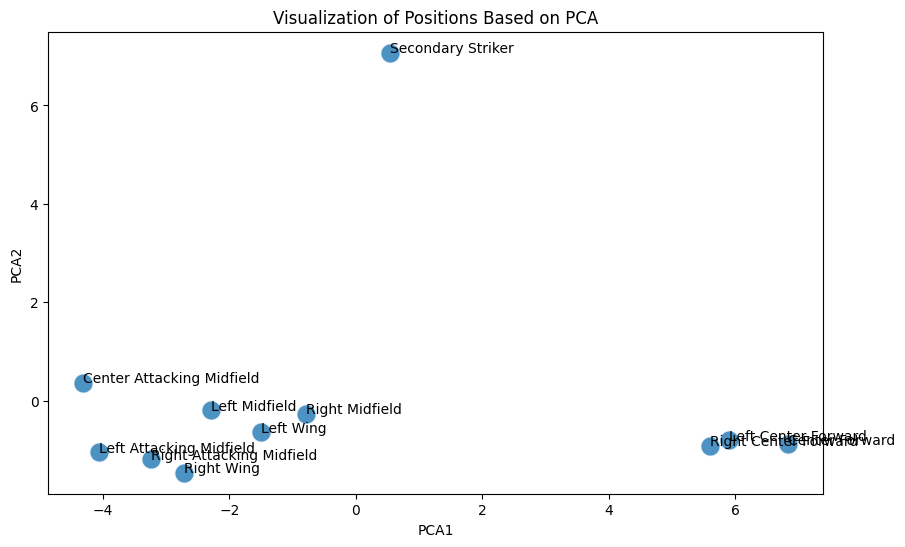

In [ ]:

# PCA na 2 wymiary (bez klasteryzacji)
data_model_pos_stats_pca = data_model_pos_stats.copy()
pca = PCA(n_components=2)
pca_result = pca.fit_transform(data_model_pos_stats_pca.iloc[:, 1:])  # Bez 'position'
data_model_pos_stats_pca['PCA1'] = pca_result[:, 0]
data_model_pos_stats_pca['PCA2'] = pca_result[:, 1]

# Wykres bez klastrów
plt.figure(figsize=(10, 6))
sns.scatterplot(data=position_stats_scaled, x='PCA1', y='PCA2', 
                palette='tab10', s=200, alpha=0.8)

# Dodanie etykiet pozycji
for i in range(position_stats_scaled.shape[0]):
    plt.text(position_stats_scaled['PCA1'].iloc[i], 
             position_stats_scaled['PCA2'].iloc[i], 
             position_stats_scaled['position'].iloc[i], fontsize=10)

plt.title('Visualization of Positions Based on PCA')
plt.xlabel('PCA1')
plt.ylabel('PCA2')
plt.show()

In [ ]:
wings = ['Center Attacking Midfield',
 'Left Attacking Midfield',
 'Right Attacking Midfield', 'Right Wing',
 'Left Wing',
 'Right Midfield',
 'Left Midfield']

Podział na strikers i wings i zrobienie rf

In [ ]:
data_model_pos_group = data_model_pos.copy()

In [ ]:
data_model_pos_group['grouped_positions'] = data_model_pos_group['position'].apply(assign_pos)

In [ ]:
data_model_pos_group.groupby('grouped_positions').size()

grouped_positions
Midfield    11323
Striker      6975
dtype: int64

In [ ]:
data_model_pos_strikers = data_model_pos_group[data_model_pos_group['grouped_positions'] == "Striker"]

In [ ]:
data_model_pos_strikers2 = data_model_pos_strikers.groupby(['match_id', 'team'])[data_model_pos_strikers.columns[6:-1]].sum().reset_index()

In [ ]:
result_table

,match_id,team,result
0,7525,Russia,1
1,7525,Saudi Arabia,-1
2,7529,Croatia,1
3,7529,Nigeria,-1
4,7530,Australia,0
...,...,...,...
5843,3943043,Spain,1
5844,3943076,Canada,0
5845,3943076,Uruguay,0
5846,3943077,Argentina,0


In [ ]:
data_model_pos_strikers3 = data_model_pos_strikers2

,match_id,team,goals,assist,PAxG,xGA,xT+,shots_on_target,prog_carries,prog_pass,...,basic_duels_won,basic_duels_lost,basic_duels,won_aerial_all,lost_aerial_all,aerial,duels,defensive_won,defensive_lost,prog
0,7525,Russia,0.0,0.0,0.000000,0.158511,0.145,0.0,3.0,1.0,...,0.0,0.0,0.0,0.0,1.0,1.0,1.0,4.0,10.0,4.0
1,7525,Saudi Arabia,0.0,0.0,-0.052533,0.000000,0.020,0.0,0.0,0.0,...,0.0,0.0,0.0,2.0,4.0,6.0,6.0,4.0,2.0,0.0
2,7529,Croatia,0.0,0.0,-0.312208,0.107281,0.019,0.0,0.0,0.0,...,0.0,0.0,0.0,2.0,3.0,5.0,5.0,4.0,1.0,0.0
3,7529,Nigeria,0.0,0.0,0.429272,0.000000,0.031,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,2.0,2.0,2.0,2.0,3.0,0.0
4,7530,Australia,0.0,0.0,0.000000,0.000000,0.009,0.0,1.0,0.0,...,1.0,0.0,1.0,1.0,1.0,2.0,3.0,0.0,1.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5532,3943043,England,0.0,0.0,-0.046033,0.000000,0.041,0.0,0.0,1.0,...,0.0,0.0,0.0,2.0,6.0,8.0,8.0,1.0,0.0,1.0
5533,3943043,Spain,0.0,0.0,-0.280875,0.000000,0.034,0.0,1.0,0.0,...,1.0,0.0,1.0,2.0,4.0,6.0,7.0,5.0,3.0,1.0
5534,3943076,Canada,0.0,0.0,0.120414,0.512461,0.051,1.0,0.0,0.0,...,1.0,0.0,1.0,0.0,3.0,3.0,4.0,2.0,2.0,0.0
5535,3943077,Argentina,0.0,0.0,-0.195365,0.047532,0.301,0.0,1.0,3.0,...,0.0,0.0,0.0,0.0,2.0,2.0,2.0,1.0,4.0,4.0


In [ ]:
data_model_pos_group2 = data_model_pos_group.groupby('grouped_positions')[['goals', 'assist', 'PAxG', 'npxg', 'shots_on_target', 'xGA', 'fwp+', 'carries_into_pen', 'shots', 'xT+', 'prog_pass', 'prog_carries']].sum().reset_index()

In [ ]:
data_model_pos_group2

,grouped_positions,goals,assist,PAxG,npxg,shots_on_target,xGA,fwp+,carries_into_pen,shots,xT+,prog_pass,prog_carries
0,Midfield,2441.0,1743.0,4430.381475,1942.629462,7821.0,1502.980512,2.109191e+06,10646.0,21074.0,2997.182,31054.0,36189.0
1,Striker,2704.0,874.0,3922.020100,2250.734096,7280.0,720.310347,7.165136e+05,6367.0,17288.0,1071.400,8894.0,12814.0


In [ ]:
percent_df = data_model_pos_group2.copy()
stat_cols = data_model_pos_group2.columns[1:]  # Pomijamy 'grouped_positions'
for col in stat_cols:
    total = data_model_pos_group2[col].sum()
    percent_df[col] = (data_model_pos_group2[col] / total) * 100

percent_df

,grouped_positions,goals,assist,PAxG,npxg,shots_on_target,xGA,fwp+,carries_into_pen,shots,xT+,prog_pass,prog_carries
0,Midfield,47.444121,66.602981,53.043205,46.326283,51.791272,67.601614,74.64301,62.575677,54.934571,73.666501,77.736057,73.850581
1,Striker,52.555879,33.397019,46.956795,53.673717,48.208728,32.398386,25.35699,37.424323,45.065429,26.333499,22.263943,26.149419


Zróbmy ocenę zawodników ofensywnych zgodnie z wagami (narazie nie biorąc pod uwagę różnic)

In [ ]:
data_model_pos_group_rating = data_model_pos_group[['player', 'team', 'match_id', 'position', 'goals', 'assist', 'PAxG', 'npxg', 'shots_on_target', 'xGA', 'fwp+', 'carries_into_pen', 'shots', 'xT+', 'prog_pass', 'prog_carries']]

Zobaczmy rozkłady zmiennych

In [ ]:
colum = data_model_pos_group_rating.columns[4:]

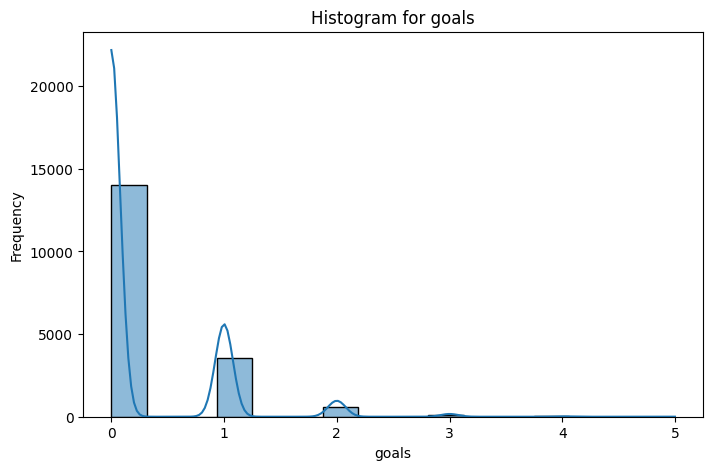

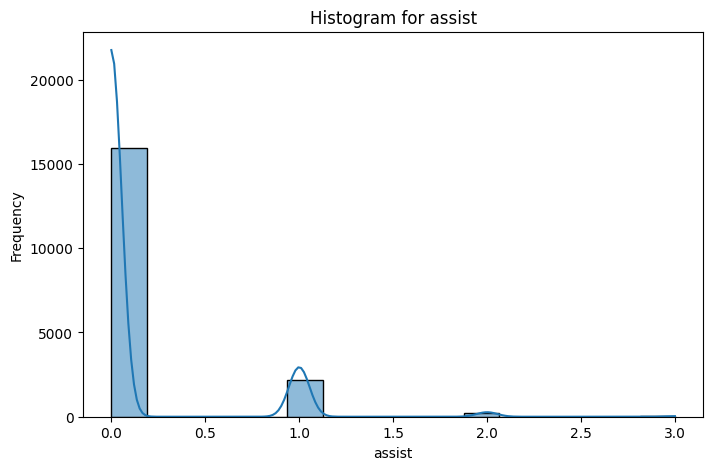

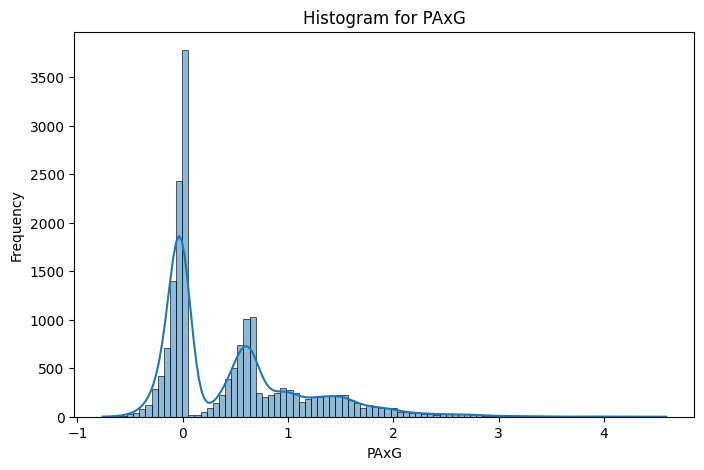

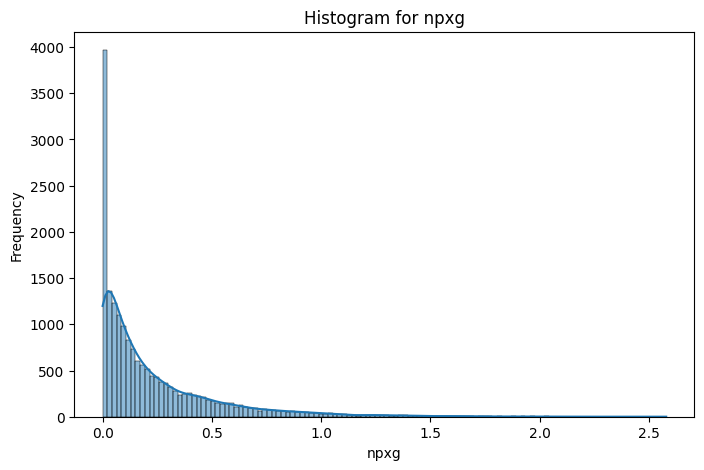

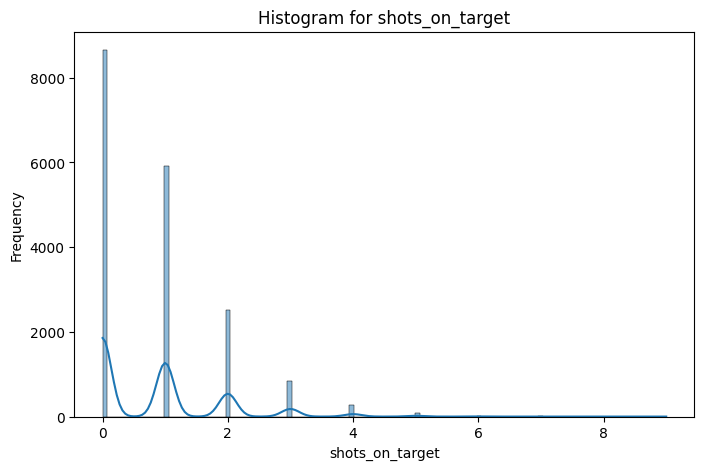

...

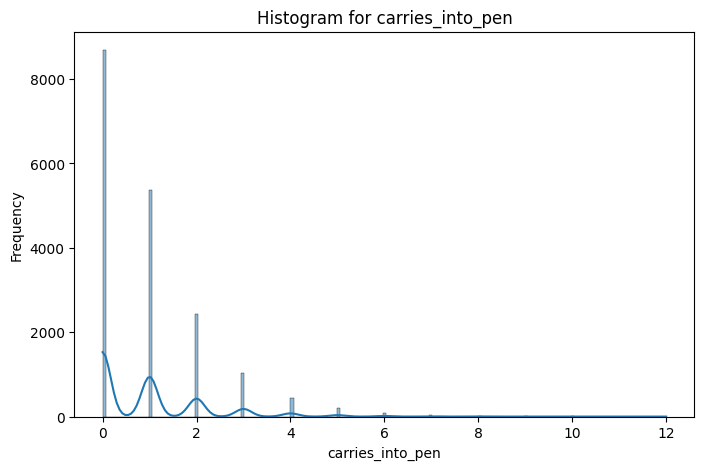

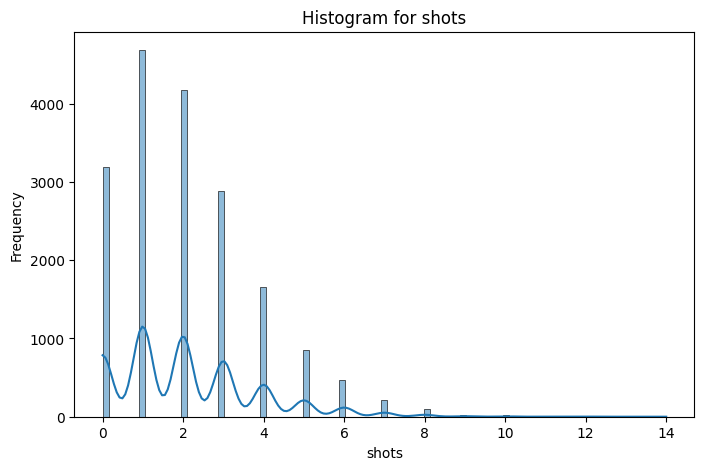

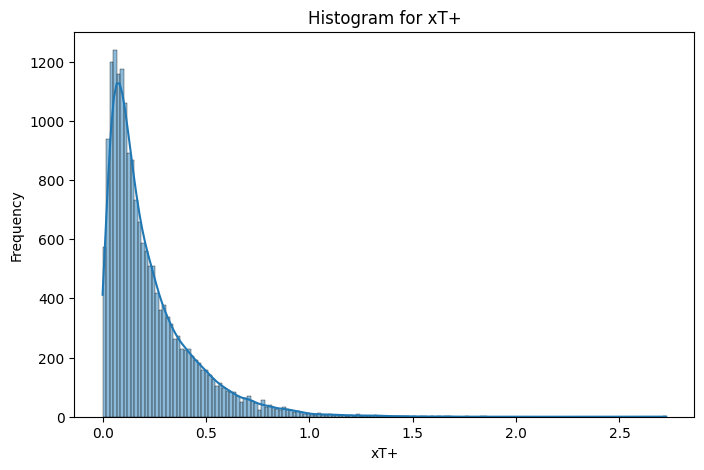

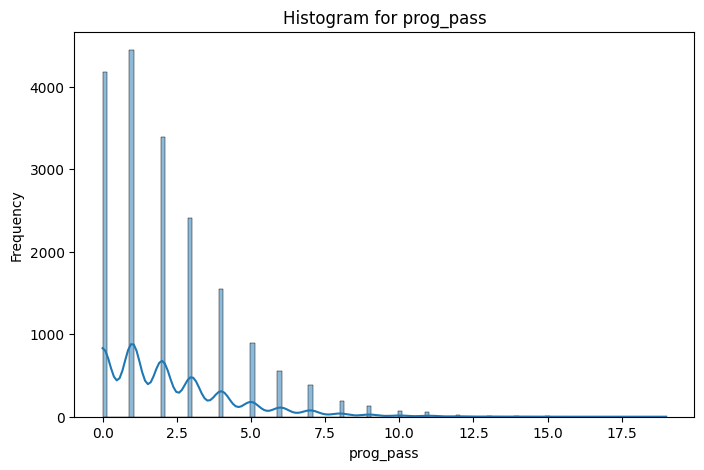

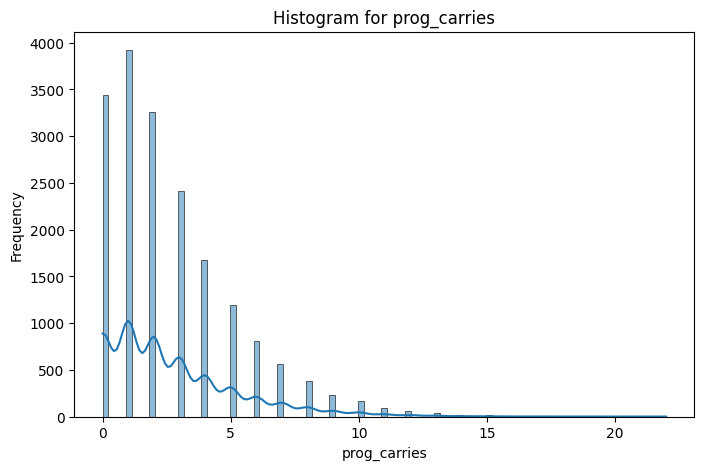

In [ ]:
for c in colum:
    plt.figure(figsize=(8, 5))  # Rozmiar wykresu
    sns.histplot(data_model_pos_group_rating[c], kde=True)  # Histogram z krzywą KDE
    plt.title(f'Histogram for {c}')  # Tytuł
    plt.xlabel(c)  # Etykieta osi X
    plt.ylabel('Frequency')  # Etykieta osi Y
    plt.show()  # Wyświetlenie wykresu

<Axes: xlabel='paxg_q', ylabel='Count'>

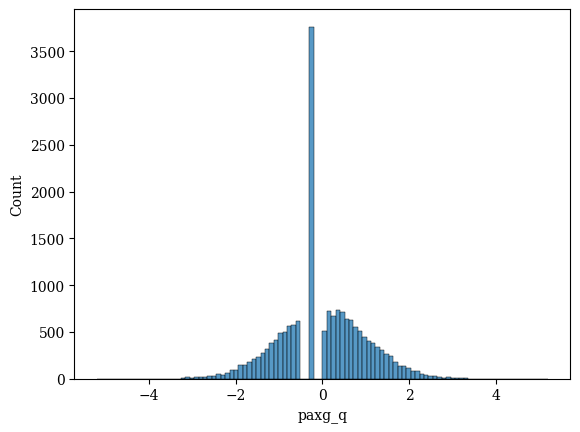

In [3826]:
rating = data_model_pos_group_rating.copy()
rating[['paxg_q']] = qt.fit_transform(data_model_pos_group_rating[['PAxG']])
sns.histplot(rating['paxg_q'])

In [3903]:
rating[['prog_carries_q']] = qt.fit_transform(data_model_pos_group_rating[['prog_carries']])

In [3841]:
rating['xga_l'] = np.log1p(data_model_pos_group_rating['xGA'] + 0.01)

<Axes: xlabel='prog_carries_q', ylabel='Count'>

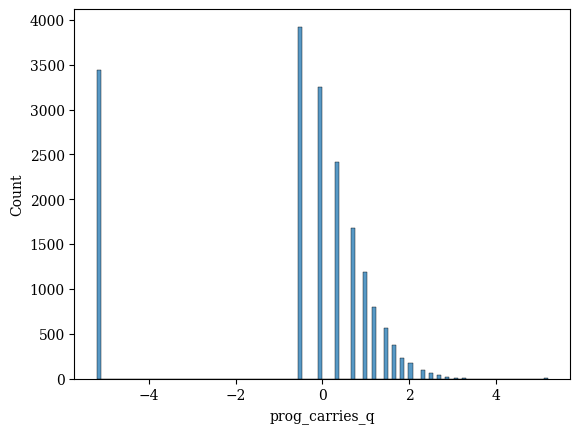

In [3904]:
sns.histplot(rating['prog_carries_q'])

In [ ]:
data_model_pos_group_rating[]

,player,team,match_id,position,goals,assist,PAxG,npxg,shots_on_target,xGA,fwp+,carries_into_pen,shots,xT+,prog_pass,prog_carries,PCA_score,player_rating
39,Aaron Hunt,Hamburger SV,3890286,Center Attacking Midfield,0.0,0.0,0.000000,0.000000,0.0,0.066286,88.0250,0.0,0.0,0.047,0.0,1.0,0.099658,2.888880
40,Aaron Hunt,Hamburger SV,3890297,Center Attacking Midfield,0.0,0.0,0.593420,0.107094,1.0,0.160857,216.8250,2.0,2.0,0.083,2.0,3.0,0.668609,3.773186
41,Aaron Hunt,Hamburger SV,3890304,Center Attacking Midfield,0.0,0.0,0.000000,0.000000,0.0,0.000000,166.6000,0.0,0.0,0.125,3.0,4.0,-0.041936,2.668804
42,Aaron Hunt,Hamburger SV,3890317,Left Wing,0.0,0.0,1.037152,0.080544,2.0,0.047306,327.6000,2.0,3.0,0.330,4.0,3.0,0.166063,2.992091
43,Aaron Hunt,Hamburger SV,3890324,Center Attacking Midfield,0.0,0.0,0.654407,0.040370,1.0,0.070087,189.4375,0.0,1.0,0.214,4.0,3.0,0.339573,3.261774
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
60611,Łukasz Gikiewicz,Chennaiyin,3813311,Left Center Forward,1.0,0.0,1.450748,0.137949,1.0,0.000000,160.3000,0.0,2.0,0.047,3.0,1.0,NaN,NaN
60612,Łukasz Gikiewicz,Chennaiyin,3817852,Right Center Forward,0.0,0.0,-0.160108,0.200181,0.0,0.000000,79.8875,0.0,1.0,0.030,1.0,1.0,NaN,NaN
60613,Łukasz Gikiewicz,Chennaiyin,3817858,Center Forward,0.0,0.0,0.000000,0.000000,0.0,0.000000,148.3125,1.0,0.0,0.038,1.0,1.0,NaN,NaN
60614,Łukasz Gikiewicz,Chennaiyin,3817868,Right Center Forward,0.0,0.0,-0.373380,0.742562,0.0,0.097712,96.4250,0.0,3.0,0.069,0.0,2.0,NaN,NaN


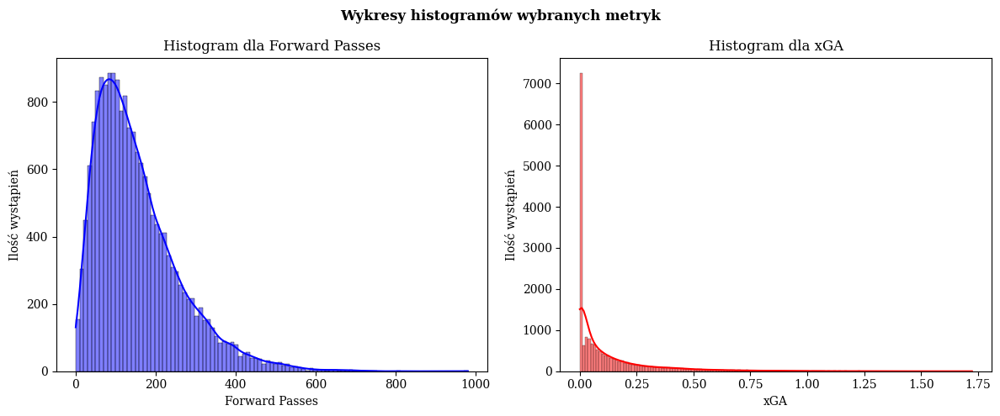

In [4549]:
fig, axes = plt.subplots(1, 2, figsize=(12, 5))  # Tworzymy 2 wykresy obok siebie

# Pierwszy histogram
sns.histplot(data_model_pos_group_rating['fwp+'], kde=True, color='blue', ax=axes[0])
axes[0].set_title('Histogram dla Forward Passes')
axes[0].set_xlabel('Forward Passes')
axes[0].set_ylabel('Ilość wystąpień')

# Drugi histogram
sns.histplot(data_model_pos_group_rating['xGA'], kde=True, color='red', ax=axes[1])
axes[1].set_title('Histogram dla xGA')
axes[1].set_xlabel('xGA')
axes[1].set_ylabel('Ilość wystąpień')
plt.suptitle("Wykresy histogramów wybranych metryk", weight="bold")
plt.tight_layout()  # Dopasowanie układu
plt.show()

In [3836]:
rating['prog_pass_l'] = np.log1p(rating['prog_pass'] + 0.01)

In [3837]:
rating['prog_carries_l'] = np.log1p(rating['prog_carries'] + 0.01)

In [3838]:
rating[['xT+_q']] = qt.fit_transform(rating[['xT+']])

In [3839]:
rating[['fwp+_q']] = qt.fit_transform(rating[['fwp+']])

In [3835]:
rating['shots_s'] = scaler.fit_transform(rating[['shots']])

In [3840]:
rating['prog_carries_s'] = scaler.fit_transform(rating[['prog_carries']])

In [3834]:
rating['prog_pass_s'] = scaler.fit_transform(rating[['prog_pass']])

In [3833]:
rating['carries_into_pen_l'] = np.log1p(rating['carries_into_pen'] + 0.01)

In [3831]:
rating['npxg_s'] = scaler.fit_transform(rating[['npxg']])

<Axes: xlabel='npxg_s', ylabel='Count'>

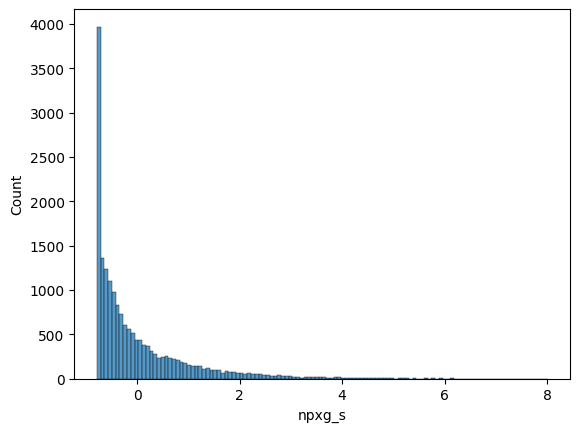

In [ ]:
sns.histplot(rating['npxg_s'])

In [ ]:
rating['goals_l'] = np.log1p(rating['goals'] + 0.01)

In [ ]:
rating['assist_l'] = np.log1p(rating['assist'] + 0.01)

In [3842]:
rating['shots_on_target_l'] = np.log1p(rating['shots_on_target'] + 0.01)

In [3843]:
rating['rating_all'] = rating['xT+_q'] + rating['fwp+_q'] + rating['paxg_q'] + rating['prog_carries_s'] + rating['prog_pass_s'] + rating['shots_s'] + rating['xga_l'] + rating['carries_into_pen_l'] + rating['npxg_s'] + rating['goals_l'] + rating['assist_l'] + rating['shots_on_target_l']

KeyError: 'goals_l'

Przede mną rozdzielenie na pozycje wag oraz przeskalowanie od 0 do 10 i dodanie wag

In [ ]:
# rating['rating_weights'] = 0.33*rating['paxg_q'] + 0.13*rating['npxg_s'] + 0.1*rating['shots_on_target_l'] + 0.09*rating['xga_l'] + 0.09 * rating['fwp+_q'] + 0.05*rating['carries_into_pen_l'] + 0.06*rating['shots_s'] + 0.06*rating['xT+_q'] + 0.05*rating['prog_pass_l'] + 0.05*rating['prog_carries_l'] + 0.4*rating['goals_l'] + 0.35*rating['assist_l']

In [3827]:
rating['paxg_c'] = rating['paxg_q'] - rating['paxg_q'].median()

In [3816]:
rating['paxg_2'] = scaler.fit_transform(rating[['PAxG']])

<Axes: xlabel='paxg_c', ylabel='Count'>

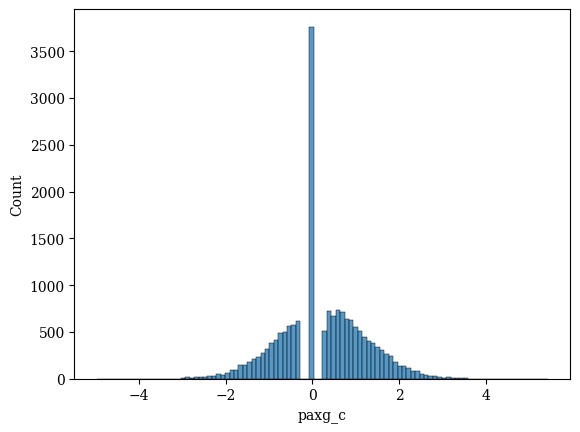

In [3828]:
sns.histplot(rating['paxg_c'])

In [3844]:
rating['rating_weights'] = 0.28*rating['paxg_c'] + 0.18*rating['npxg_s'] + 0.1*rating['shots_on_target_l'] + 0.08*rating['xga_l'] + 0.07 * rating['fwp+_q'] + 0.05*rating['carries_into_pen_l'] + 0.07*rating['shots_s'] + 0.07*rating['xT+_q'] + 0.05*rating['prog_pass_l'] + 0.05*rating['prog_carries_l']

<Axes: xlabel='rating_weights', ylabel='Count'>

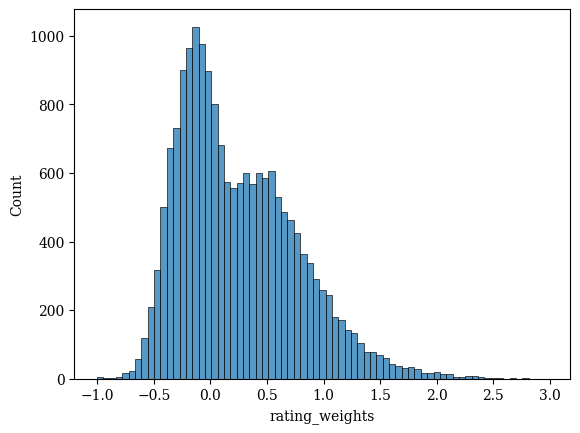

In [3845]:
sns.histplot(rating['rating_weights'])

In [3846]:
rating['rating_weights'].describe()

count    18298.000000
mean         0.248391
std          0.525202
min         -1.003546
25%         -0.158710
50%          0.142249
75%          0.584989
max          2.983340
Name: rating_weights, dtype: float64

Przeskalujmy do od 4 do 10 (flash)

<Axes: xlabel='score_scaled', ylabel='Count'>

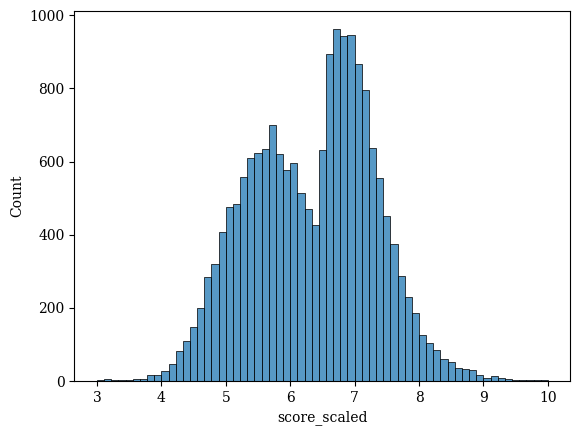

In [3849]:
min_val = rating['rating_weights'].min()
max_val = rating['rating_weights'].max()
median_val = rating['rating_weights'].median()

def scale_score(x):
    if x <= median_val:
        # Skala dla wartości poniżej mediany (3 do 6.5)
        return 3 + 3.5 * (x - min_val) / (median_val - min_val)
    else:
        # Skala dla wartości powyżej mediany (6.5 do 10)
        return 6.5 + 3.5 * (x - median_val) / (max_val - median_val)

# Zastosowanie funkcji
rating['score_scaled'] = rating['rating_weights'].apply(scale_score)

sns.histplot(rating['score_scaled'])


In [3850]:
rating.sort_values(by='score_scaled')

,player,team,match_id,position,goals,assist,PAxG,npxg,shots_on_target,xGA,...,shots_s,prog_pass_l,prog_carries_l,xT+_q,fwp+_q,prog_carries_s,xga_l,shots_on_target_l,rating_weights,score_scaled
40794,Miguel Ángel Guerrero Martín,Leganés,303532,Left Center Forward,0.0,0.0,-0.309490,0.443835,0.0,0.000000,...,-0.055555,0.009950,0.009950,-5.199338,-3.023311,-1.050095,0.009950,0.009950,-1.003546,3.000000
59417,Youssef En-Nesyri,Morocco,3869552,Center Forward,0.0,0.0,0.000000,0.000000,0.0,0.000000,...,-1.206805,0.009950,0.009950,-5.199338,-5.199338,-1.050095,0.009950,0.009950,-0.949815,3.164128
55541,Timothy Weah,United States,3939981,Right Wing,0.0,0.0,0.000000,0.000000,0.0,0.000000,...,-1.206805,0.009950,0.009950,-5.199338,-5.199338,-1.050095,0.009950,0.009950,-0.949815,3.164128
1961,Aleksandar Mitrović,Newcastle United,3754205,Center Forward,0.0,0.0,0.000000,0.000000,0.0,0.000000,...,-1.206805,0.009950,0.009950,-5.199338,-5.199338,-1.050095,0.009950,0.009950,-0.949815,3.164128
33934,Leonardo Pavoletti,Genoa,3879634,Center Forward,0.0,0.0,0.000000,0.000000,0.0,0.000000,...,-1.206805,0.009950,0.009950,-5.199338,-5.199338,-1.050095,0.009950,0.009950,-0.949815,3.164128
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
35707,Luis Alberto Suárez Díaz,Barcelona,266310,Center Forward,4.0,3.0,2.438836,2.565317,4.0,1.025087,...,3.398194,1.388791,0.698135,1.057485,-0.411534,-0.657983,0.710539,1.611436,2.771261,9.738736
34343,Lionel Andrés Messi Cuccittini,Barcelona,70220,Right Center Forward,3.0,2.0,2.317346,2.061817,6.0,0.662910,...,3.398194,2.198335,1.611436,1.773922,1.979727,0.518351,0.514565,1.947338,2.776492,9.745180
60221,Édson Arantes do Nascimento,Brazil,3888704,Left Center Forward,3.0,0.0,2.124132,2.129290,4.0,0.583300,...,5.700694,1.611436,1.793425,1.518869,1.184907,0.910462,0.465807,1.611436,2.820751,9.799703
34375,Lionel Andrés Messi Cuccittini,Barcelona,70298,Center Forward,3.0,0.0,2.673856,2.068894,7.0,0.208086,...,3.973819,1.611436,1.793425,2.511865,1.099987,0.910462,0.197281,2.080691,2.879924,9.872600


In [3572]:
rating[rating['match_id'] == 3930161].sort_values(by='score_scaled').iloc[:,10:]

,fwp+,carries_into_pen,shots,xT+,prog_pass,prog_carries,paxg_q,xga_l,prog_pass_l,prog_carries_l,...,prog_carries_s,prog_pass_s,carries_into_pen_l,npxg_s,goals_l,assist_l,shots_on_target_l,rating_all,rating_weights,score_scaled
25253,13.8250,0.0,2.0,0.043,0.0,0.0,-0.748453,0.009950,0.009950,0.009950,...,-1.050095,-1.009880,0.009950,-0.651704,0.009950,0.009950,0.009950,-6.850537,-0.592273,5.441182
54608,65.5375,0.0,0.0,0.037,1.0,0.0,-0.229064,0.009950,0.698135,0.009950,...,-1.050095,-0.547309,0.009950,-0.781752,0.009950,0.009950,0.009950,-5.950352,-0.361190,5.920849
5599,67.2000,0.0,0.0,0.045,1.0,1.0,-0.229064,0.024631,0.698135,0.698135,...,-0.657983,-0.547309,0.009950,-0.781752,0.009950,0.009950,0.009950,-5.350586,-0.312849,6.021192
16984,50.3125,1.0,3.0,0.413,3.0,2.0,-1.039301,0.165827,1.388791,1.101940,...,-0.265872,0.377833,0.698135,-0.518032,0.009950,0.009950,0.009950,-0.149139,-0.237690,6.177203
34795,69.6500,1.0,3.0,0.534,1.0,4.0,-2.241344,0.288524,0.698135,1.611436,...,0.518351,-0.547309,0.698135,0.485576,0.009950,0.698135,0.009950,1.026460,-0.208108,6.238607
20409,28.3500,0.0,3.0,0.144,1.0,0.0,0.251954,0.219737,0.698135,0.009950,...,-1.050095,-0.547309,0.009950,-0.180046,0.009950,0.009950,0.698135,-1.834534,0.066545,6.808714
42491,102.0250,0.0,1.0,0.022,0.0,1.0,1.387411,0.009950,0.009950,0.698135,...,-0.657983,-1.009880,0.009950,-0.487722,0.698135,0.009950,0.698135,-2.004707,0.614092,7.408517


Teraz dzielimy na 2 modele oceny, dla napastników i pomocników

In [ ]:
data_model_pos_group_rating_strikers = data_model_pos_group_rating[data_model_pos_group_rating['position'].isin(strikers)]

In [ ]:
rating_strikers = data_model_pos_group_rating_strikers

C:\Users\macie\AppData\Local\Temp\ipykernel_30508\1332731084.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  rating_strikers[['paxg_q']] = qt.fit_transform(rating_strikers[['PAxG']]+0.01)


<Axes: xlabel='paxg_q', ylabel='Count'>

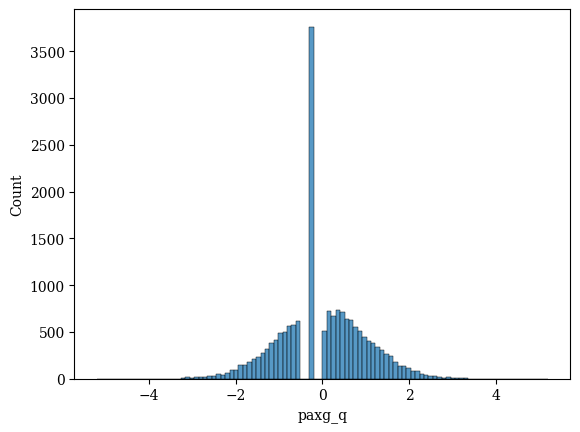

In [3286]:
rating_strikers[['paxg_q']] = qt.fit_transform(rating_strikers[['PAxG']]+0.01)
sns.histplot(rating['paxg_q'])

C:\Users\macie\AppData\Local\Temp\ipykernel_30508\1644132269.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  rating_strikers['xga_l'] = np.log1p(rating_strikers['xGA'] + 0.01)


<Axes: xlabel='xga_l', ylabel='Count'>

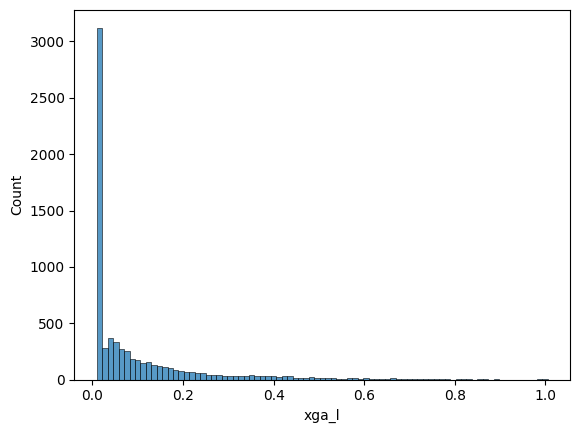

In [ ]:
rating_strikers['xga_l'] = np.log1p(rating_strikers['xGA'] + 0.01)
sns.histplot(rating_strikers['xga_l'])

In [ ]:
rating_strikers['prog_pass_l'] = np.log1p(rating_strikers['prog_pass'] + 0.01)

C:\Users\macie\AppData\Local\Temp\ipykernel_30508\91187140.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  rating_strikers['prog_pass_l'] = np.log1p(rating_strikers['prog_pass'] + 0.01)


In [ ]:
rating_strikers['prog_carries_l'] = np.log1p(rating_strikers['prog_carries'] + 0.01)

C:\Users\macie\AppData\Local\Temp\ipykernel_30508\293003434.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  rating_strikers['prog_carries_l'] = np.log1p(rating_strikers['prog_carries'] + 0.01)


In [ ]:
rating_strikers[['xT+_q']] = qt.fit_transform(rating_strikers[['xT+']])

C:\Users\macie\AppData\Local\Temp\ipykernel_30508\1939367333.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  rating_strikers[['xT+_q']] = qt.fit_transform(rating_strikers[['xT+']])


In [ ]:
rating_strikers[['fwp+_q']] = qt.fit_transform(rating_strikers[['fwp+']])

C:\Users\macie\AppData\Local\Temp\ipykernel_30508\956183001.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  rating_strikers[['fwp+_q']] = qt.fit_transform(rating_strikers[['fwp+']])


In [ ]:
rating_strikers['shots_s'] = scaler.fit_transform(rating_strikers[['shots']])

C:\Users\macie\AppData\Local\Temp\ipykernel_30508\488103950.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  rating_strikers['shots_s'] = scaler.fit_transform(rating_strikers[['shots']])


In [ ]:
rating_strikers['carries_into_pen_l'] = np.log1p(rating_strikers['carries_into_pen'] + 0.01)

C:\Users\macie\AppData\Local\Temp\ipykernel_30508\1900469380.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  rating_strikers['carries_into_pen_l'] = np.log1p(rating_strikers['carries_into_pen'] + 0.01)


In [ ]:
rating_strikers['npxg_s'] = scaler.fit_transform(rating_strikers[['npxg']])

C:\Users\macie\AppData\Local\Temp\ipykernel_30508\1574920237.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  rating_strikers['npxg_s'] = scaler.fit_transform(rating_strikers[['npxg']])


In [ ]:
rating_strikers['goals_l'] = np.log1p(rating_strikers['goals'] + 0.01)

C:\Users\macie\AppData\Local\Temp\ipykernel_30508\438233152.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  rating_strikers['goals_l'] = np.log1p(rating_strikers['goals'] + 0.01)


In [ ]:
rating_strikers['assist_l'] = np.log1p(rating_strikers['assist'] + 0.01)

C:\Users\macie\AppData\Local\Temp\ipykernel_30508\887815502.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  rating_strikers['assist_l'] = np.log1p(rating_strikers['assist'] + 0.01)


In [ ]:
rating_strikers['shots_on_target_l'] = np.log1p(rating_strikers['shots_on_target'] + 0.01)

C:\Users\macie\AppData\Local\Temp\ipykernel_30508\2549949182.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  rating_strikers['shots_on_target_l'] = np.log1p(rating_strikers['shots_on_target'] + 0.01)


In [3240]:
rating_strikers['prog_carries_s'] = scaler.fit_transform(rating_strikers[['prog_carries']])

C:\Users\macie\AppData\Local\Temp\ipykernel_30508\327499662.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  rating_strikers['prog_carries_s'] = scaler.fit_transform(rating_strikers[['prog_carries']])


In [ ]:
rating_strikers['prog_pass_s'] = scaler.fit_transform(rating_strikers[['prog_pass']])

C:\Users\macie\AppData\Local\Temp\ipykernel_30508\3124371284.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  rating_strikers['prog_pass_s'] = scaler.fit_transform(rating_strikers[['prog_pass']])


In [3243]:
rating_strikers['prog_pass_l'] = np.log1p(rating_strikers['prog_pass'] + 0.01)

C:\Users\macie\AppData\Local\Temp\ipykernel_30508\91187140.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  rating_strikers['prog_pass_l'] = np.log1p(rating_strikers['prog_pass'] + 0.01)


In [3237]:
rating_strikers['prog_carries_l'] = np.log1p(rating_strikers['prog_carries'] + 0.01)

C:\Users\macie\AppData\Local\Temp\ipykernel_30508\293003434.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  rating_strikers['prog_carries_l'] = np.log1p(rating_strikers['prog_carries'] + 0.01)


In [3249]:
rating_strikers['shots_l'] = np.log1p(rating_strikers['shots'] + 0.01)

C:\Users\macie\AppData\Local\Temp\ipykernel_30508\2178072192.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  rating_strikers['shots_l'] = np.log1p(rating_strikers['shots'] + 0.01)


In [3256]:
rating_strikers['npxg_l'] = np.log1p(rating_strikers['npxg'] + 0.01)

C:\Users\macie\AppData\Local\Temp\ipykernel_30508\1975366510.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  rating_strikers['npxg_l'] = np.log1p(rating_strikers['npxg'] + 0.01)


In [3288]:
rating_strikers['rating_all'] = rating_strikers['xT+_q'] + rating_strikers['fwp+_q'] + rating_strikers['paxg_q'] + rating_strikers['prog_carries_s'] + rating_strikers['prog_pass_s'] + rating_strikers['shots_s'] + rating_strikers['xga_l'] + rating_strikers['carries_into_pen_l'] + rating_strikers['npxg_s'] + rating_strikers['goals_l'] + rating_strikers['assist_l'] + rating_strikers['shots_on_target_l']

C:\Users\macie\AppData\Local\Temp\ipykernel_30508\1559426530.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  rating_strikers['rating_all'] = rating_strikers['xT+_q'] + rating_strikers['fwp+_q'] + rating_strikers['paxg_q'] + rating_strikers['prog_carries_s'] + rating_strikers['prog_pass_s'] + rating_strikers['shots_s'] + rating_strikers['xga_l'] + rating_strikers['carries_into_pen_l'] + rating_strikers['npxg_s'] + rating_strikers['goals_l'] + rating_strikers['assist_l'] + rating_strikers['shots_on_target_l']


<Axes: xlabel='rating_all', ylabel='Count'>

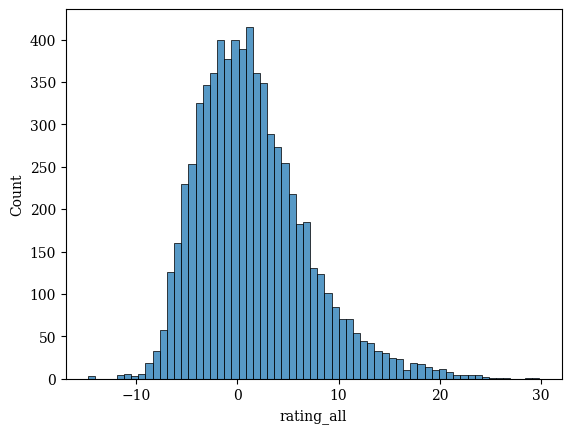

In [3289]:
sns.histplot(rating_strikers['rating_all'])

NAPASTNICY

<Axes: xlabel='npxg_l', ylabel='Count'>

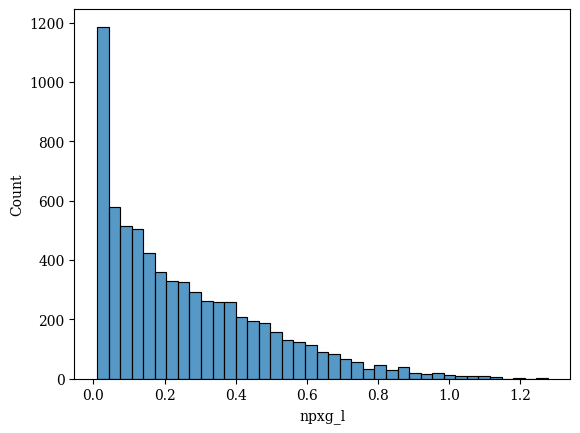

In [3257]:
sns.histplot(rating_strikers['npxg_l'])

<Axes: xlabel='npxg_s', ylabel='Count'>

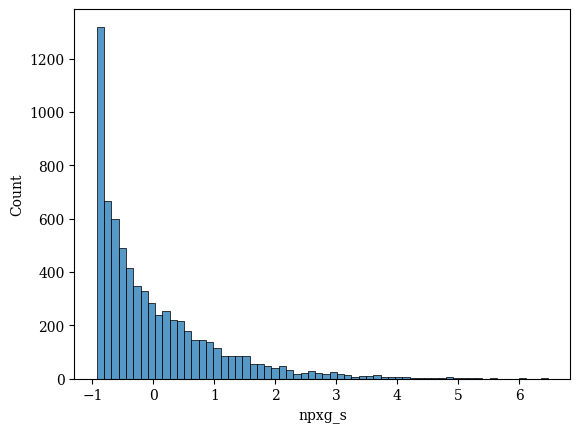

In [3861]:
sns.histplot(rating_strikers['npxg_s'])

In [3885]:
rating_strikers['rating_all_weights'] = 0.07*rating_strikers["xT+_q"] + 0.07*rating_strikers['fwp+_q'] + 0.28*rating_strikers['paxg_q'] + 0.05*rating_strikers['prog_carries_l'] + 0.05*rating_strikers['prog_pass_l'] + 0.07*rating_strikers['shots_s'] + 0.08*rating_strikers['xga_l'] + 0.05*rating_strikers['carries_into_pen_l'] + 0.18*rating_strikers['npxg_l']  + 0.1*rating_strikers['shots_on_target_l']

C:\Users\macie\AppData\Local\Temp\ipykernel_30508\2911284175.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  rating_strikers['rating_all_weights'] = 0.07*rating_strikers["xT+_q"] + 0.07*rating_strikers['fwp+_q'] + 0.28*rating_strikers['paxg_q'] + 0.05*rating_strikers['prog_carries_l'] + 0.05*rating_strikers['prog_pass_l'] + 0.07*rating_strikers['shots_s'] + 0.08*rating_strikers['xga_l'] + 0.05*rating_strikers['carries_into_pen_l'] + 0.18*rating_strikers['npxg_l']  + 0.1*rating_strikers['shots_on_target_l']


<Axes: xlabel='prog_carries_l', ylabel='Count'>

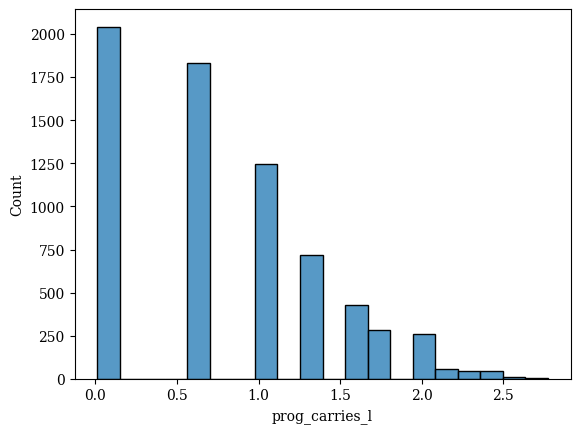

In [3894]:
sns.histplot(rating_strikers['prog_carries_l'])

<Axes: xlabel='rating_all_weights', ylabel='Count'>

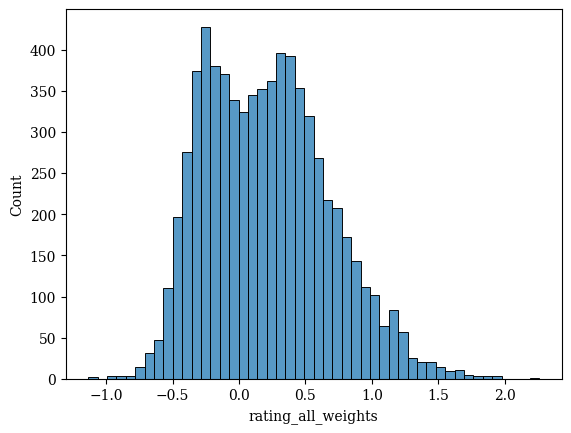

In [3878]:
sns.histplot(rating_strikers['rating_all_weights'])

In [3879]:
rating_strikers['rating_all_weights'].describe()

count    6975.000000
mean        0.211009
std         0.465953
min        -1.135086
25%        -0.168868
50%         0.186142
75%         0.516666
max         2.258882
Name: rating_all_weights, dtype: float64

C:\Users\macie\AppData\Local\Temp\ipykernel_30508\3637528593.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  rating_strikers['score_scaled'] = rating_strikers['rating_all_weights'].apply(scale_score)


<Axes: xlabel='score_scaled', ylabel='Count'>

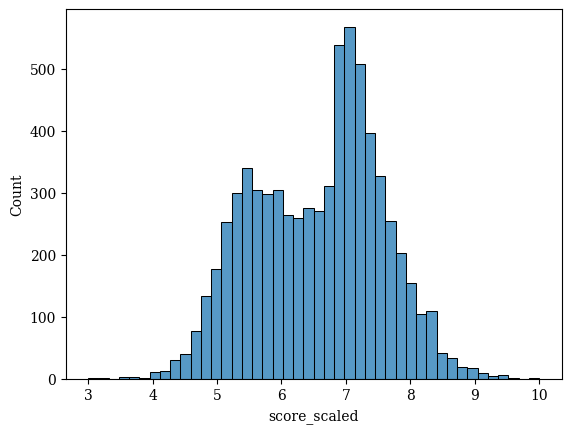

In [4275]:
min_val = rating_strikers['rating_all_weights'].min()
max_val = rating_strikers['rating_all_weights'].max()
median_val = rating_strikers['rating_all_weights'].mean()

def scale_score(x):
    if x <= median_val:
        # Skala dla wartości poniżej mediany (3 do 6.5)
        return 3 + 3.8 * (x - min_val) / (median_val - min_val)
    else:
        # Skala dla wartości powyżej mediany (6.5 do 10)
        return 6.8 + 3.2 * (x - median_val) / (max_val - median_val)

# Zastosowanie funkcji
rating_strikers['score_scaled'] = rating_strikers['rating_all_weights'].apply(scale_score)

sns.histplot(rating_strikers['score_scaled'])


<Axes: xlabel='score_scaled', ylabel='Count'>

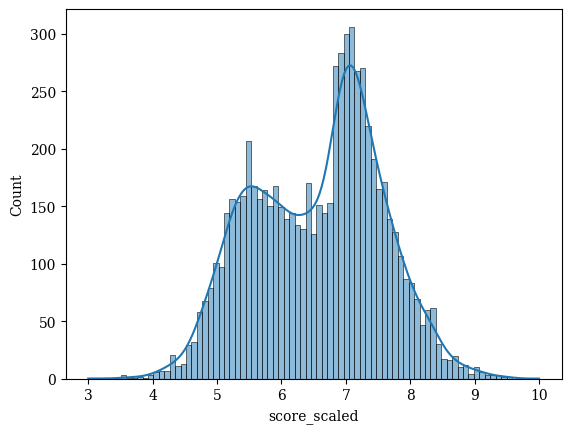

In [ ]:
count = np.sqrt(len(rating_strikers))



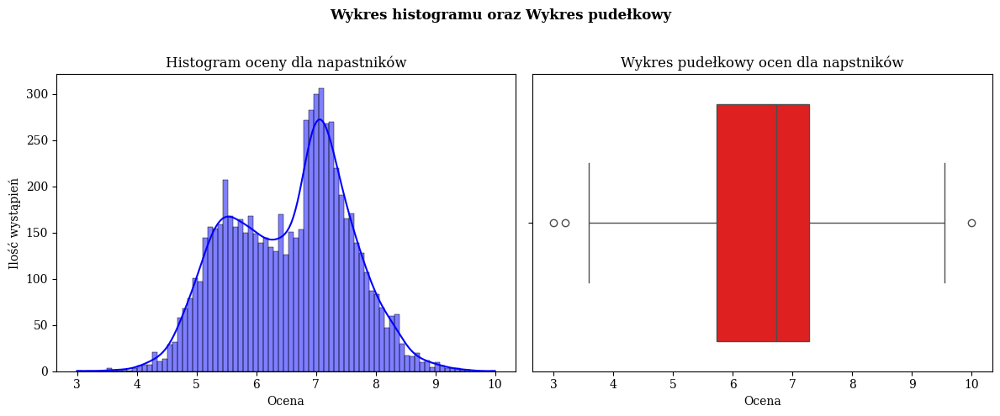

In [4563]:
fig, axes = plt.subplots(1, 2, figsize=(12, 5))  # Dwa wykresy obok siebie

# Histogram
sns.histplot(rating_strikers['score_scaled'], bins=83, kde=True, ax=axes[0], color='blue')
axes[0].set_title('Histogram oceny dla napastników')
axes[0].set_xlabel('Ocena')
axes[0].set_ylabel('Ilość wystąpień')

# Boxplot
sns.boxplot(x=rating_strikers['score_scaled'], ax=axes[1], color='red')
axes[1].set_title('Wykres pudełkowy ocen dla napstników')
axes[1].set_xlabel('Ocena')

plt.suptitle("Wykres histogramu oraz Wykres pudełkowy\n", weight="bold")
plt.tight_layout()  # Dopasowanie układu
plt.show()


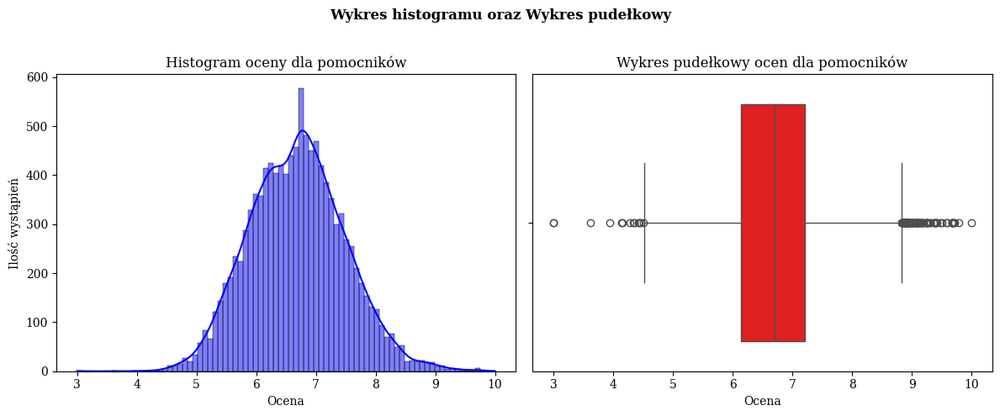

In [4565]:
fig, axes = plt.subplots(1, 2, figsize=(12, 5))  # Dwa wykresy obok siebie

# Histogram
sns.histplot(mid['score_scaled'], bins=83, kde=True, ax=axes[0], color='blue')
axes[0].set_title('Histogram oceny dla pomocników')
axes[0].set_xlabel('Ocena')
axes[0].set_ylabel('Ilość wystąpień')

# Boxplot
sns.boxplot(x=mid['score_scaled'], ax=axes[1], color='red')
axes[1].set_title('Wykres pudełkowy ocen dla pomocników')
axes[1].set_xlabel('Ocena')

plt.suptitle("Wykres histogramu oraz Wykres pudełkowy\n", weight="bold")
plt.tight_layout()  # Dopasowanie układu
plt.show()


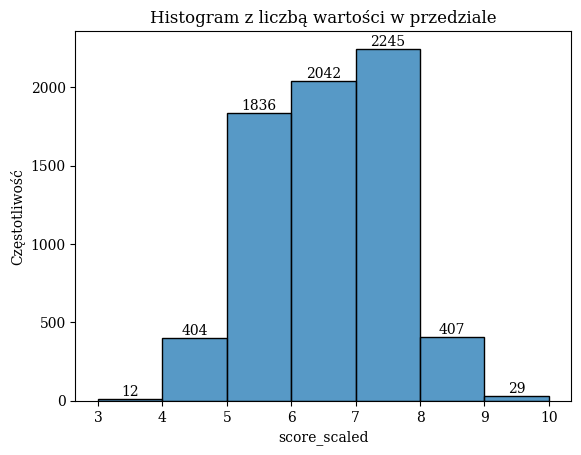

In [4288]:
ax = sns.histplot(rating_strikers['score_scaled'], bins=7)

# Dodanie liczby do każdego słupka histogramu
for patch in ax.patches:
    # Wysokość słupka
    height = patch.get_height()
    # Pozycja słupka na osi X
    x_position = patch.get_x() + patch.get_width() / 2
    # Dodanie liczby do słupka
    ax.text(x_position, height, f'{int(height)}', ha='center', va='bottom')

# Dodatkowe opcje wykresu
plt.title('Histogram z liczbą wartości w przedziale')
plt.xlabel('score_scaled')
plt.ylabel('Częstotliwość')

# Pokaż wykres
plt.show()

<Axes: ylabel='score_scaled'>

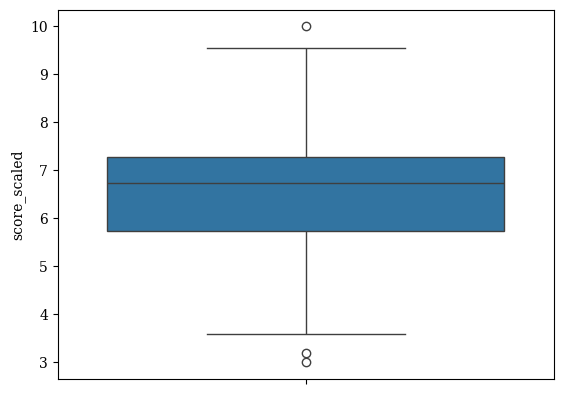

In [4281]:
sns.boxplot(rating_strikers['score_scaled'])

<Axes: ylabel='score_scaled'>

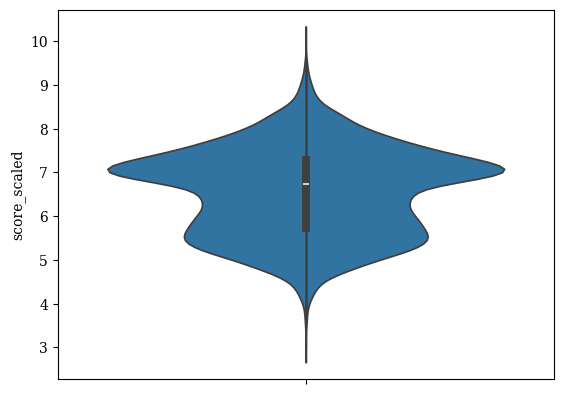

In [4282]:
sns.violinplot(rating_strikers['score_scaled'])

In [4283]:
rating_strikers['score_scaled'].describe()

count    6975.000000
mean        6.559505
std         0.999116
min         3.000000
25%         5.727615
50%         6.729801
75%         7.277619
max        10.000000
Name: score_scaled, dtype: float64

Pomocnicy to samo

In [ ]:
data_model_pos_group_rating_mid = data_model_pos_group_rating[data_model_pos_group_rating['position'].isin(pos_wings)]

In [ ]:
rating_mid = data_model_pos_group_rating_mid

In [3308]:
mid = rating[rating.columns[:-3]]

In [3309]:
mid = mid[mid['position'].isin(pos_wings)]

POMOCNICY

In [3310]:
mid['rating_all'] = mid['xT+_q'] + mid['fwp+_q'] + mid['paxg_q'] + mid['prog_carries_s'] + mid['prog_pass_s'] + mid['shots_s'] + mid['xga_l'] + mid['carries_into_pen_l'] + mid['npxg_s'] + mid['goals_l'] + mid['assist_l'] + mid['shots_on_target_l'] + mid['goals_l'] + mid['assist_l']

<Axes: xlabel='rating_all', ylabel='Count'>

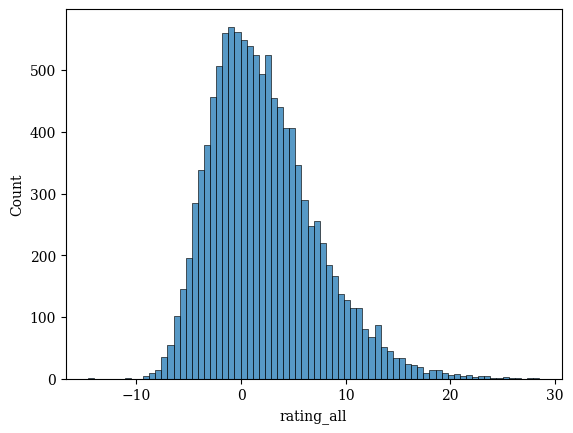

In [3311]:
sns.histplot(mid['rating_all'])

In [3881]:
mid['rating_all_weights'] = 0.11*mid['xT+_q'] + 0.13*mid['fwp+_q'] + 0.2*mid['paxg_q'] + 0.09*mid['prog_carries_l'] + 0.1*mid['prog_pass_l'] + 0.05*mid['shots_s'] + 0.12*mid['xga_l'] + 0.05*mid['carries_into_pen_l'] + 0.09*mid['npxg_s'] + 0.06*mid['shots_on_target_l']

<Axes: xlabel='rating_all_weights', ylabel='Count'>

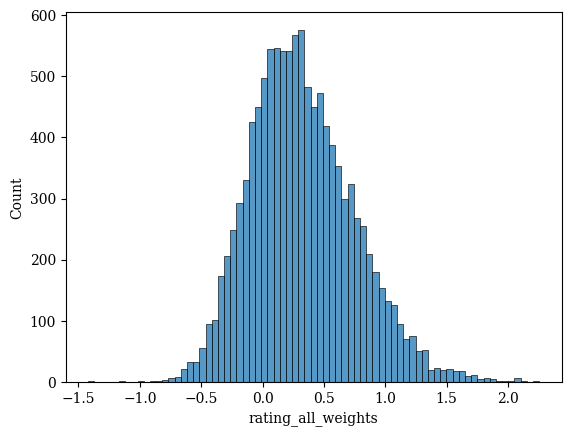

In [4284]:
sns.histplot(mid['rating_all_weights'])

<Axes: xlabel='score_scaled', ylabel='Count'>

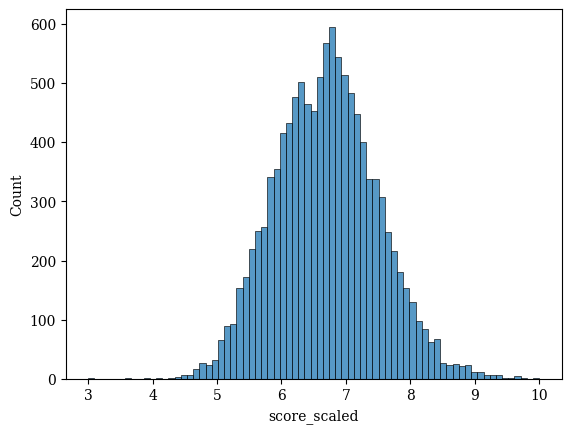

In [4286]:
min_val = mid['rating_all_weights'].min()
max_val = mid['rating_all_weights'].max()
median_val = mid['rating_all_weights'].median()

def scale_score(x):
    if x <= median_val:
        # Skala dla wartości poniżej mediany (3 do 6.5)
        return 3 + 3.7 * (x - min_val) / (median_val - min_val)
    else:
        # Skala dla wartości powyżej mediany (6.5 do 10)
        return 6.7 + 3.3 * (x - median_val) / (max_val - median_val)

# Zastosowanie funkcji
mid['score_scaled'] = mid['rating_all_weights'].apply(scale_score)

sns.histplot(mid['score_scaled'])


<Axes: xlabel='score_scaled', ylabel='Count'>

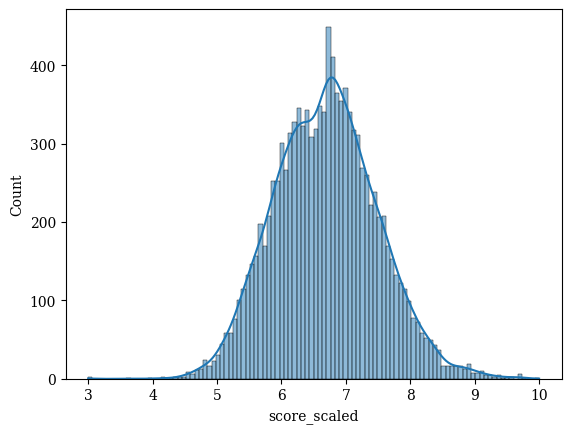

In [4292]:
sns.histplot(mid['score_scaled'], bins=106, kde=True)

<Axes: xlabel='score_scaled', ylabel='Count'>

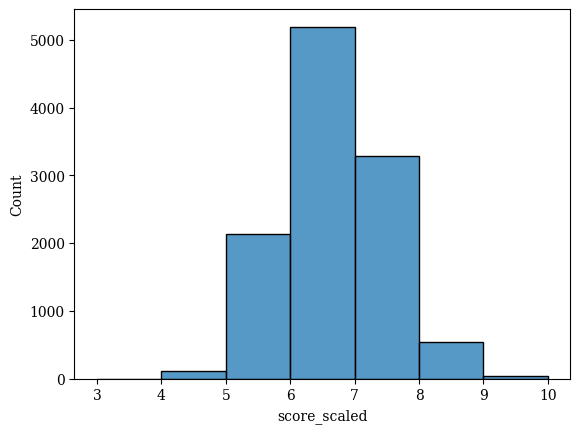

In [4293]:
sns.histplot(mid['score_scaled'], bins=7)

<Axes: ylabel='score_scaled'>

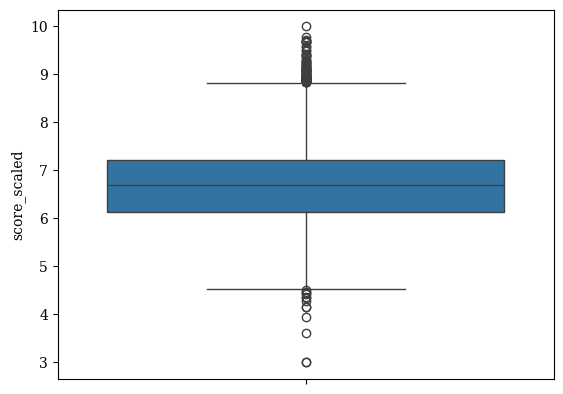

In [4294]:
sns.boxplot(mid['score_scaled'])

In [4299]:
mid['score_scaled'].describe()

count    11323.000000
mean         6.692491
std          0.796794
min          3.000000
25%          6.132649
50%          6.700000
75%          7.212413
max         10.000000
Name: score_scaled, dtype: float64

In [4296]:
from scipy.stats import shapiro

stat, p_value = shapiro(rating_strikers['score_scaled'])
print('Statystyka testu:', stat)
print('Wartość p:', p_value)

Statystyka testu: 0.985628068447113
Wartość p: 5.006480774933072e-26


In [4297]:
mm = mid.sort_values(by='score_scaled', ascending=False)

In [4298]:
from scipy.stats import shapiro

stat, p_value = shapiro(mm['score_scaled'])
print('Statystyka testu:', stat)
print('Wartość p:', p_value)

Statystyka testu: 0.9976705312728882
Wartość p: 3.213092769280279e-12


In [4290]:
np.sqrt(len(mid))

106.40958603434186

In [3890]:
mid['score_scaled'].isna().sum()

0

In [3886]:
result = pd.concat(
    [rating_strikers, 
     mid],
    ignore_index=True  # Resetuje indeks w nowym DataFrame
)

In [3887]:
result.sort_values(by='score_scaled').tail(40)

,player,team,match_id,position,goals,assist,PAxG,npxg,shots_on_target,xGA,...,assist_l,shots_on_target_l,prog_carries_s,prog_pass_s,rating_all,rating_all_weights,score_scaled,shots_l,npxg_l,scaled_rating
12942,Lionel Andrés Messi Cuccittini,Barcelona,16190,Right Wing,3.0,1.0,2.494421,0.723815,4.0,0.274864,...,0.698135,1.611436,1.694684,1.765545,22.049584,1.795150,9.187152,NaN,NaN,NaN
3908,Lionel Andrés Messi Cuccittini,Barcelona,69296,Center Forward,2.0,0.0,1.972329,1.677403,6.0,0.116794,...,0.009950,1.947338,3.502663,1.748535,24.046086,1.707508,9.192273,2.398804,0.988575,9.586504
13010,Lionel Andrés Messi Cuccittini,Barcelona,69189,Right Wing,2.0,1.0,1.635734,1.902707,4.0,0.579861,...,0.698135,1.611436,2.086796,0.377833,22.019677,1.802371,9.199992,NaN,NaN,NaN
16176,Ronaldo de Assis Moreira,Barcelona,69154,Left Wing,2.0,0.0,2.823224,0.528160,4.0,0.899337,...,0.009950,1.611436,1.694684,3.153258,20.365249,1.802502,9.200224,NaN,NaN,NaN
13024,Lionel Andrés Messi Cuccittini,Barcelona,69227,Right Wing,3.0,0.0,3.912395,0.469444,4.0,0.470168,...,0.009950,1.611436,2.478907,0.840404,19.902117,1.806740,9.207761,NaN,NaN,NaN
3854,Lionel Andrés Messi Cuccittini,Barcelona,9636,Right Center Forward,2.0,1.0,1.629425,2.030481,6.0,0.414066,...,0.698135,1.947338,3.013660,4.957003,28.969595,1.720533,9.211353,2.398804,1.112016,9.613367
3871,Lionel Andrés Messi Cuccittini,Barcelona,9811,Right Center Forward,2.0,1.0,2.769531,0.791670,5.0,0.235923,...,0.698135,1.793425,2.035654,4.315310,22.189720,1.728039,9.222349,2.080691,0.588714,9.628848
12939,Lionel Andrés Messi Cuccittini,Barcelona,16157,Right Wing,2.0,0.0,2.381226,0.470004,5.0,0.128054,...,0.009950,1.793425,2.478907,3.615829,21.811130,1.817645,9.227150,NaN,NaN,NaN
10223,Gareth Frank Bale,Real Madrid,3825700,Right Wing,4.0,1.0,2.889389,2.103805,5.0,0.438134,...,0.698135,1.793425,1.302573,-0.084738,22.460198,1.836930,9.261441,NaN,NaN,NaN
12946,Lionel Andrés Messi Cuccittini,Barcelona,16248,Right Wing,1.0,0.0,2.341503,0.573553,6.0,0.689196,...,0.009950,1.947338,3.655241,3.615829,22.730422,1.838712,9.264609,NaN,NaN,NaN


In [4302]:
rdf = result.copy()

In [4312]:
cols5 = list(rdf.columns[:16]) + ['score_scaled']

In [4314]:
rdf = rdf[cols5]

<Axes: xlabel='score_scaled', ylabel='Count'>

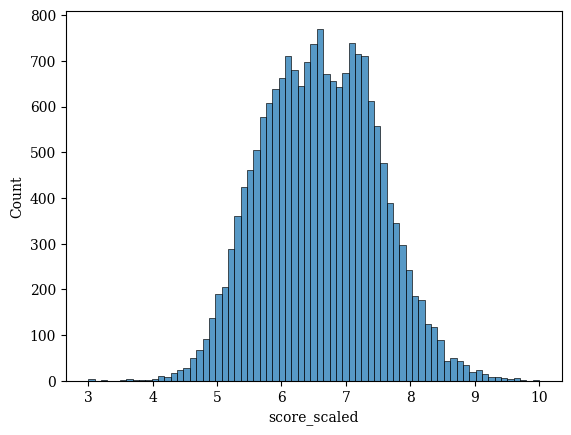

In [4315]:
sns.histplot(rdf['score_scaled'])

In [4340]:
percentile_99 = np.percentile(rdf['score_scaled'], 99)

In [4342]:
top_99_players = rdf[rdf['score_scaled'] >= percentile_99]

In [4347]:
top_99_players.groupby('player').agg(
    count=('player', 'size'),
    mean_score=('score_scaled', 'mean')
).sort_values(by='mean_score', ascending=False).reset_index()

,player,count,mean_score
0,Jesús Joaquín Fernández Sáez de la Torre,1,9.152820
1,Lionel Andrés Messi Cuccittini,110,9.074300
2,Sergio Leonel Agüero del Castillo,1,9.066157
3,Alexis Alejandro Sánchez Sánchez,1,9.058429
4,Zlatan Ibrahimović,6,9.054807
5,Christian Dannemann Eriksen,1,9.031754
6,Gareth Frank Bale,2,9.027448
7,Diego Armando Maradona,1,9.005243
8,Édson Arantes do Nascimento,3,8.984354
9,Philippe Coutinho Correia,1,8.972017


In [4339]:
rdf.sort_values(by='score_scaled').tail(50)

,player,team,match_id,position,goals,assist,PAxG,npxg,shots_on_target,xGA,fwp+,carries_into_pen,shots,xT+,prog_pass,prog_carries,score_scaled
3902,Lionel Andrés Messi Cuccittini,Barcelona,69276,Center Forward,3.0,0.0,2.696219,1.602841,5.0,0.344522,215.5125,1.0,7.0,0.771,4.0,4.0,9.120168
3947,Lionel Andrés Messi Cuccittini,Barcelona,70260,Center Forward,4.0,0.0,2.748071,1.264217,4.0,0.205841,417.8125,1.0,6.0,0.926,8.0,1.0,9.120209
3876,Lionel Andrés Messi Cuccittini,Barcelona,9912,Center Forward,3.0,0.0,1.833297,1.615336,5.0,0.287276,292.7750,4.0,9.0,0.990,7.0,8.0,9.132677
3944,Lionel Andrés Messi Cuccittini,Barcelona,70225,Center Forward,3.0,1.0,3.508863,0.702699,4.0,0.146314,347.4625,1.0,6.0,0.323,5.0,5.0,9.133953
13089,Lionel Andrés Messi Cuccittini,Barcelona,266299,Right Wing,2.0,2.0,2.766306,0.405862,3.0,1.122792,282.6250,4.0,6.0,1.346,5.0,8.0,9.135388
13093,Lionel Andrés Messi Cuccittini,Barcelona,266440,Right Wing,2.0,0.0,1.779559,0.781431,3.0,0.444635,467.2500,5.0,7.0,0.621,10.0,10.0,9.140288
13017,Lionel Andrés Messi Cuccittini,Barcelona,69218,Right Wing,2.0,0.0,2.943759,0.717117,5.0,0.000000,286.7375,4.0,9.0,0.637,3.0,12.0,9.143040
3082,Jesús Joaquín Fernández Sáez de la Torre,Genoa,3879804,Right Center Forward,3.0,0.0,4.162693,0.134340,3.0,0.302660,306.7750,1.0,5.0,0.716,3.0,6.0,9.152820
3712,Kylian Mbappé Lottin,Paris Saint-Germain,3802948,Center Forward,3.0,0.0,2.191303,2.037355,4.0,0.915056,205.1875,7.0,8.0,0.906,3.0,5.0,9.157411
3887,Lionel Andrés Messi Cuccittini,Barcelona,69224,Center Forward,3.0,0.0,3.606982,0.976020,6.0,0.080405,149.2750,3.0,8.0,0.333,0.0,9.0,9.172429


In [3340]:
result[result['player'] == "Cristiano Ronaldo dos Santos Aveiro"]

,player,team,match_id,position,goals,assist,PAxG,npxg,shots_on_target,xGA,...,goals_l,assist_l,shots_on_target_l,prog_carries_s,prog_pass_s,rating_all,rating_all_weights,score_scaled,shots_l,npxg_l
1301,Cristiano Ronaldo dos Santos Aveiro,Manchester United,3750201,Center Forward,0.0,0.0,0.559187,0.511446,2.0,0.000000,...,0.009950,0.00995,1.101940,2.524657,-0.818240,6.115848,0.408666,7.310674,1.947338,0.419661
1302,Cristiano Ronaldo dos Santos Aveiro,Portugal,7542,Left Center Forward,1.0,0.0,1.099545,0.466158,1.0,0.201040,...,0.698135,0.00995,0.698135,-0.409360,-0.176546,4.455505,0.537157,7.486741,1.947338,0.389443
1303,Cristiano Ronaldo dos Santos Aveiro,Portugal,7557,Left Center Forward,0.0,0.0,1.062471,0.163745,3.0,0.030043,...,0.009950,0.00995,1.388791,2.035654,-0.818240,6.922535,0.650840,7.642518,1.611436,0.160200
1304,Cristiano Ronaldo dos Santos Aveiro,Portugal,7576,Left Center Forward,3.0,0.0,2.943898,0.368856,3.0,0.023872,...,1.388791,0.00995,1.388791,1.057648,1.748535,10.760368,1.214973,8.415534,1.611436,0.321254
1305,Cristiano Ronaldo dos Santos Aveiro,Portugal,7579,Left Center Forward,0.0,0.0,0.577742,0.138970,1.0,0.067651,...,0.009950,0.00995,0.698135,2.524657,-0.818240,5.782258,0.404689,7.305225,1.947338,0.138866
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8821,Cristiano Ronaldo dos Santos Aveiro,Real Madrid,3825820,Left Wing,1.0,0.0,1.306949,0.914473,4.0,0.045475,...,0.698135,0.00995,1.611436,0.518351,-0.547309,10.190871,0.845743,7.709667,NaN,NaN
8822,Cristiano Ronaldo dos Santos Aveiro,Real Madrid,3825833,Left Wing,1.0,0.0,0.501368,1.340118,2.0,0.047846,...,0.698135,0.00995,1.101940,0.126239,-0.547309,10.135011,0.714440,7.473368,NaN,NaN
8823,Cristiano Ronaldo dos Santos Aveiro,Real Madrid,3825856,Left Wing,1.0,2.0,1.213312,1.268647,3.0,0.958950,...,0.698135,1.10194,1.388791,1.302573,-0.084738,16.440784,1.474907,8.841945,NaN,NaN
8824,Cristiano Ronaldo dos Santos Aveiro,Real Madrid,3825893,Left Wing,0.0,0.0,0.884765,0.225965,2.0,0.062544,...,0.009950,0.00995,1.101940,0.518351,-0.547309,3.940611,0.487022,7.064094,NaN,NaN


<Axes: xlabel='score_scaled', ylabel='Count'>

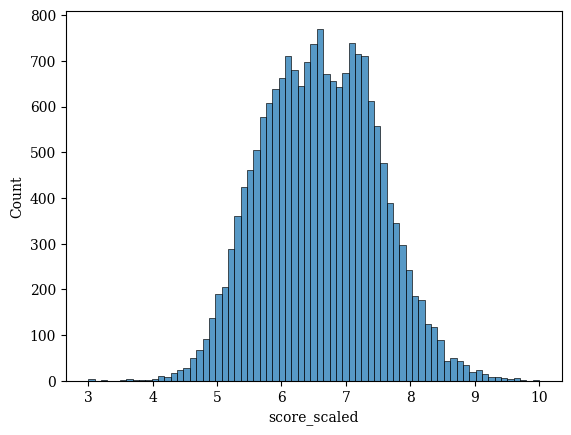

In [3898]:
sns.histplot(result['score_scaled'])

In [ ]:
euro24_match_list = list(sb.matches(competition_id=55, season_id=282)['match_id'])

In [3908]:
euro24_ratings = result[result['match_id'].isin(euro24_match_list)].sort_values(by=['match_id', 'team'])

In [ ]:
euro24_ratings[['match_id','player', 'team', 'position']].to_excel('ratings.xlsx')

In [ ]:
sofa_rating = pd.read_excel('ratings_my.xlsx')

In [ ]:
sofa = sofa_rating[['match_id', 'player', 'team', 'rating']].merge(result[['match_id', 'player', 'team', 'score_scaled']], on=['match_id', 'player', 'team']).sort_values(by='rating')

In [ ]:
df = sofa.sort_values(by='match_id')

In [ ]:
df["new_column"] = range(len(df))

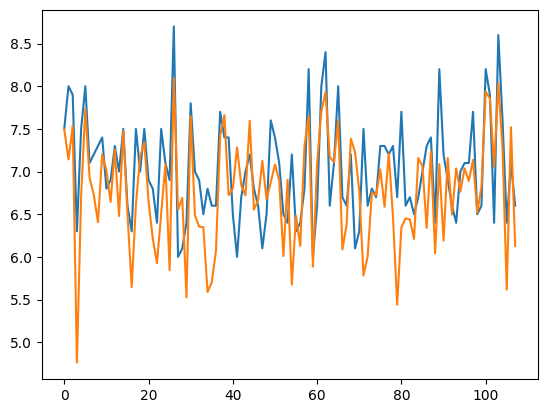

In [ ]:
plt.plot(df['new_column'], df['rating'])
plt.plot(df['new_column'], df['score_scaled'])

In [ ]:
df['score_scaled'].describe()

count    108.000000
mean       6.772082
std        0.637018
min        4.763224
25%        6.400096
50%        6.769972
75%        7.183137
max        8.094925
Name: score_scaled, dtype: float64

In [ ]:
df['rating'].describe()

count    108.000000
mean       7.025926
std        0.596151
min        6.000000
25%        6.600000
50%        7.000000
75%        7.400000
max        8.700000
Name: rating, dtype: float64

WSZYSCY ZAWODNICY

<Axes: xlabel='score_scaled', ylabel='Count'>

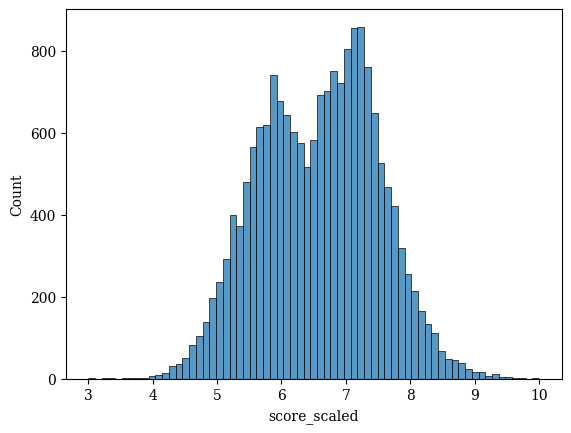

In [3342]:
sns.histplot(result['score_scaled'])

RADAR PLOT euro

In [3909]:
euro24_ratings_mean = euro24_ratings[['player', 'score_scaled']].groupby('player')['score_scaled'].mean().reset_index().sort_values(by='score_scaled')

In [3910]:
euro24_ratings_mean

,player,score_scaled
102,Ryan Christie,4.317700
19,Bruno Petković,4.620090
8,Antonín Barák,4.625176
78,Mateo Retegui,4.818169
57,José Luis Sanmartín Mato,4.920955
...,...,...
88,Pedro González López,7.292620
67,Kylian Mbappé Lottin,7.336870
61,Kai Havertz,7.420243
58,João Félix Sequeira,7.594039


In [3916]:
euro24_ratings.columns[4:-20]

Index(['goals', 'assist', 'PAxG', 'npxg', 'shots_on_target', 'xGA', 'fwp+',
       'carries_into_pen', 'shots', 'xT+', 'prog_pass', 'prog_carries'],
      dtype='object')

In [3917]:
euro24_players = euro24_ratings.groupby('player', as_index=False)[euro24_ratings.columns[4:-20]].mean()

In [ ]:
players_radar = ['Kevin De Bruyne', 'Kylian Mbappé Lottin', 'Lamine Yamal Nasraoui Ebana']

In [ ]:
radar_plot = euro24_players[euro24_players['player'].isin(players_radar)]

In [ ]:
params = list(radar_plot.columns[1:])

In [ ]:
radar_plot.reset_index(drop=True, inplace=True)

In [ ]:
ranges = []
a_values = []
b_values = []
c_values = []

for x in params:
    a = min(radar_plot[params][x])
    a = a - (a*.25)
    
    b = max(radar_plot[params][x])
    b = b + (b*.25)
    
    ranges.append((a,b))
    
for x in range(len(radar_plot['player'])):
    if radar_plot['player'][x] == 'Kevin De Bruyne':
        a_values = radar_plot.iloc[x].values.tolist()
    if radar_plot['player'][x] == 'Kylian Mbappé Lottin':
        b_values = radar_plot.iloc[x].values.tolist()
    if radar_plot['player'][x] == 'Lamine Yamal Nasraoui Ebana':
        c_values = radar_plot.iloc[x].values.tolist()
        
a_values = a_values[1:]
b_values = b_values[1:]
#c_values = c_values[1:]

values = [a_values,b_values]

In [ ]:
title = dict(
    title_name='Kevin De Bruyne',
    title_color = 'red',
    subtitle_name = 'Belgium',
    subtitle_color = 'red',
    title_name_2='Kylian Mbappé Lottin',
    title_color_2 = 'blue',
    subtitle_name_2 = 'France',
    subtitle_color_2 = 'blue',
    title_fontsize = 18,
    subtitle_fontsize=15
)
endnote = '@inz\nTop rated player in EURO 2024'

In [ ]:
from soccerplots.radar_chart import Radar

In [ ]:
plt.rcParams["font.family"] = "DejaVu Serif"  # Or any other available font

findfont: Font family 'Liberation Serif' not found.
findfont: Font family 'Liberation Serif' not found.
findfont: Font family 'Liberation Serif' not found.
findfont: Font family 'Liberation Serif' not found.
findfont: Font family 'Liberation Serif' not found.
findfont: Font family 'Liberation Serif' not found.
findfont: Font family 'Liberation Serif' not found.
findfont: Font family 'Liberation Serif' not found.
findfont: Font family 'Liberation Serif' not found.
findfont: Font family 'Liberation Serif' not found.
findfont: Font family 'Liberation Serif' not found.
findfont: Font family 'Liberation Serif' not found.
findfont: Font family 'Liberation Serif' not found.
findfont: Font family 'Liberation Serif' not found.
findfont: Font family 'Liberation Serif' not found.
findfont: Font family 'Liberation Serif' not found.
findfont: Font family 'Liberation Serif' not found.
findfont: Font family 'Liberation Serif' not found.
findfont: Font family 'Liberation Serif' not found.
findfont: Fo

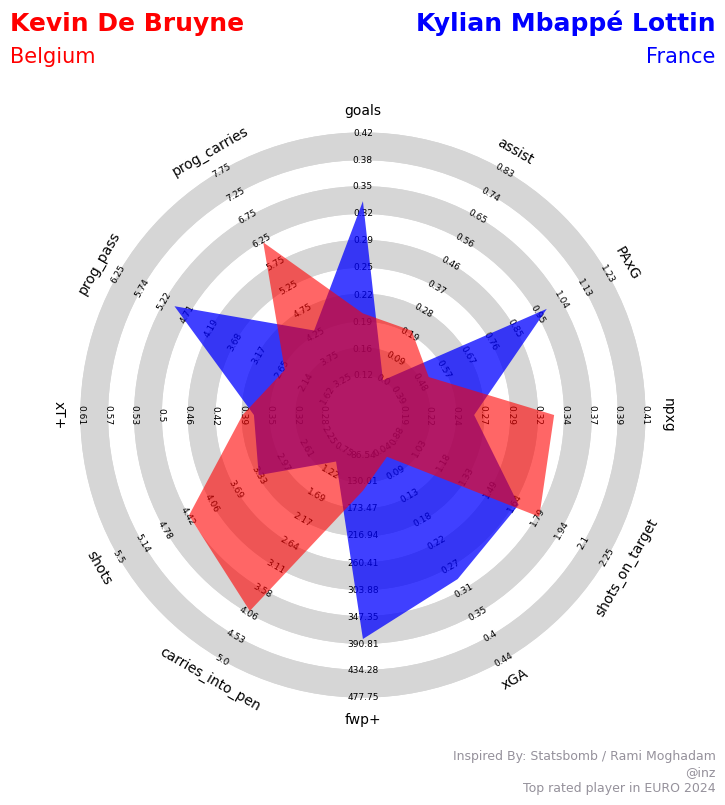

In [ ]:
radar = Radar()

fig,ax = radar.plot_radar(ranges=ranges,params=params,values=values,
                         radar_color=['blue', 'red'],
                         alphas=[.75,.6],title=title,endnote=endnote,
                         compare=True)

In [3918]:
euro24_players

,player,goals,assist,PAxG,npxg,shots_on_target,xGA,fwp+,carries_into_pen,shots,xT+,prog_pass,prog_carries
0,Adam Buksa,1.000000,0.00,1.484550,0.130895,1.000000,0.018692,5.862500,1.000000,2.000000,0.048000,0.000000,1.000000
1,Adrien Rabiot,0.000000,0.00,-0.154351,0.190728,0.000000,0.150546,252.962500,1.000000,1.000000,0.709000,4.000000,3.000000
2,Aleksandar Mitrović,0.000000,0.00,0.160500,0.384613,0.666667,0.000000,70.116667,0.000000,3.333333,0.030667,0.666667,0.333333
3,Andraž Šporar,0.000000,0.00,-0.045061,0.312316,0.250000,0.072244,51.975000,0.000000,2.000000,0.123750,0.750000,1.000000
4,Andreas Skov Olsen,0.000000,0.00,0.000000,0.000000,0.000000,0.000000,52.412500,1.000000,0.000000,0.104000,1.000000,3.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...
111,Yannick Ferreira Carrasco,0.000000,0.00,-0.208346,0.236658,0.000000,0.000000,45.325000,3.000000,2.000000,0.082000,0.000000,2.000000
112,Yunus Akgün,0.000000,0.00,0.000000,0.000000,0.000000,0.054802,72.625000,1.000000,0.000000,0.240000,1.000000,3.000000
113,Zuriko Davitashvili,0.000000,0.00,0.000000,0.000000,0.000000,0.000000,99.137500,1.000000,0.000000,0.085000,0.000000,4.000000
114,Álvaro Borja Morata Martín,0.166667,0.00,0.272552,0.245186,0.666667,0.057158,62.606250,0.166667,2.166667,0.096500,0.666667,1.000000


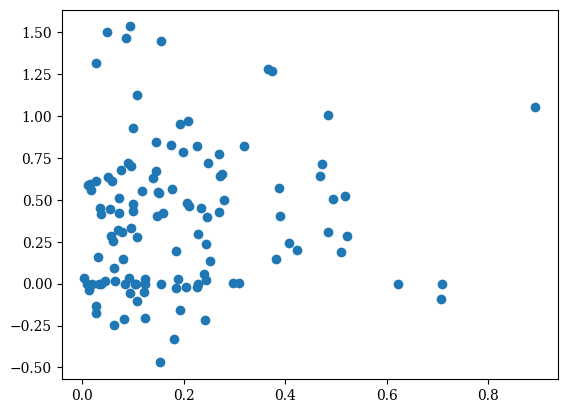

In [ ]:
plt.scatter(euro24_players['xT+'], euro24_players['PAxG'] + euro24_players['xGA']) 

In [3919]:
comparison = sofa.merge(euro24_ratings[euro24_ratings.columns[:-20]], on=['match_id', 'player', 'team'])

In [3920]:
comparison2 = comparison[['rating', 'goals', 'assist', 'PAxG', 'npxg', 'shots_on_target', 'xGA', 'fwp+', 'carries_into_pen', 'shots', 'xT+', 'prog_pass', 'prog_carries']]

In [3921]:
comparison2

,rating,goals,assist,PAxG,npxg,shots_on_target,xGA,fwp+,carries_into_pen,shots,xT+,prog_pass,prog_carries
0,6.0,0.0,0.0,0.685651,0.729104,2.0,0.099074,52.1500,1.0,3.0,0.333,1.0,0.0
1,6.0,0.0,0.0,0.445904,0.447490,1.0,0.000000,44.3625,1.0,1.0,0.050,0.0,1.0
2,6.0,0.0,0.0,-0.168976,0.204607,0.0,0.000000,96.6000,0.0,2.0,0.013,0.0,1.0
3,6.1,0.0,0.0,0.539577,0.899231,2.0,0.000000,95.2875,0.0,6.0,0.073,2.0,0.0
4,6.1,0.0,0.0,0.443971,0.668956,2.0,0.021682,126.0875,3.0,2.0,0.286,1.0,8.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
103,8.2,1.0,0.0,1.366132,0.179644,1.0,0.111768,130.7250,2.0,1.0,0.301,2.0,4.0
104,8.2,1.0,0.0,1.019923,0.484764,1.0,0.309637,216.2125,1.0,2.0,0.382,7.0,7.0
105,8.4,1.0,1.0,1.224802,0.300459,1.0,0.208240,76.3875,0.0,2.0,0.126,0.0,0.0
106,8.6,1.0,0.0,1.813385,0.455114,3.0,0.352865,283.2375,1.0,5.0,0.364,2.0,5.0


In [3922]:
X = comparison2.drop(columns='rating')
y = comparison2['rating']

In [3923]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)


In [3924]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, r2_score

In [3925]:
model = RandomForestRegressor(n_estimators=100, random_state=42)
model.fit(X_train, y_train)


RandomForestRegressor(random_state=42)

In [3926]:
y_pred = model.predict(X_test)
print("RMSE:", mean_squared_error(y_test, y_pred, squared=False))
print("R^2:", r2_score(y_test, y_pred))

RMSE: 0.5015181044497894
R^2: 0.2785166953120347


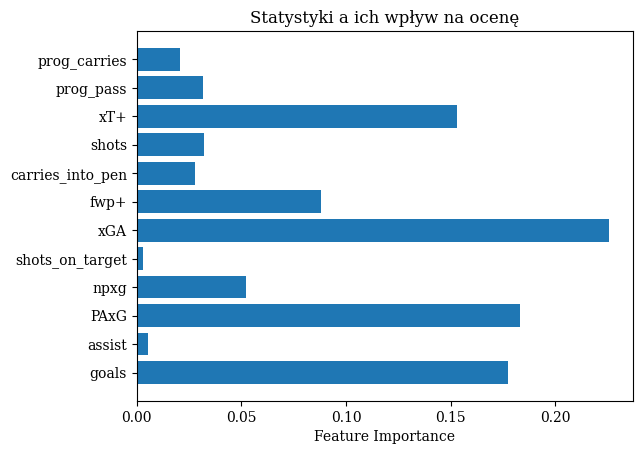

In [3927]:
# Ważność cech
import matplotlib.pyplot as plt
importance = model.feature_importances_

# Wizualizacja
features = X.columns
plt.barh(features, importance)
plt.xlabel('Feature Importance')
plt.title('Statystyki a ich wpływ na ocenę')
plt.show()


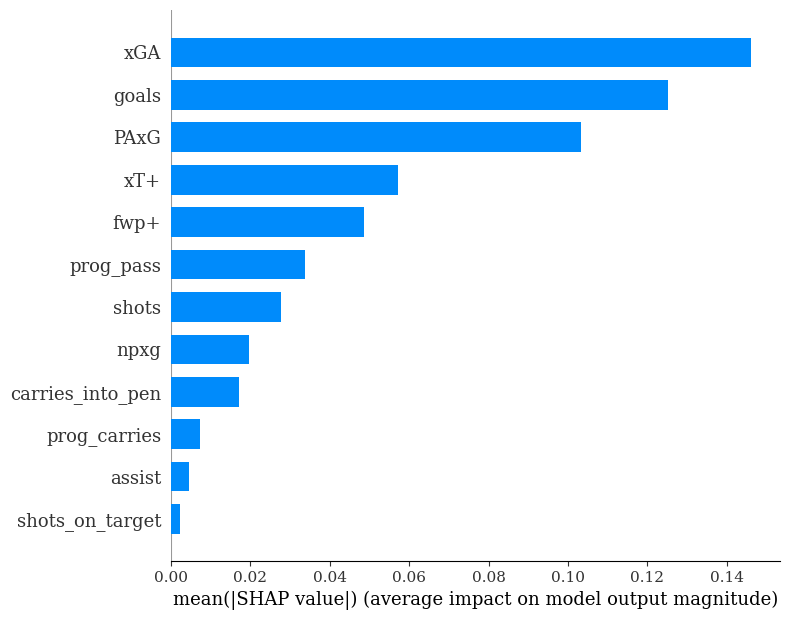

In [ ]:
import shap

# SHAP dla wyjaśnienia modelu
explainer = shap.TreeExplainer(model)
shap_values = explainer.shap_values(X_test)

# Wizualizacja
shap.summary_plot(shap_values, X_test, plot_type="bar")


PCA

In [3158]:
pca_model = data_model_pos_group_rating

In [ ]:
start_cols = pca_model.columns[4:]

In [ ]:
X = pca_model[start_cols]

In [ ]:
X_scaled = scaler.fit_transform(X)

In [ ]:
n_components = 3
pca = PCA(n_components=n_components)
pca_components = pca.fit_transform(X_scaled)

# Przekształcenie wyników PCA do DataFrame
pca_df = pd.DataFrame(
    pca_components, 
    columns=[f'PC{i+1}' for i in range(n_components)]
)

In [ ]:
# Wyznaczenie wag dla składowych (proporcjonalnych do wariancji wyjaśnionej)
weights = pca.explained_variance_ratio_

# Obliczenie łącznej oceny zawodnika na podstawie głównych składowych
pca_model['PCA_score'] = (pca_df * weights).sum(axis=1)


C:\Users\macie\AppData\Local\Temp\ipykernel_30508\1271566032.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  pca_model['PCA_score'] = (pca_df * weights).sum(axis=1)


In [ ]:
# Normalizacja wyniku PCA do przedziału [1, 10]
pca_model['player_rating'] = 1 + 9 * (pca_model['PCA_score'] - pca_model['PCA_score'].min()) / (pca_model['PCA_score'].max() - pca_model['PCA_score'].min())


C:\Users\macie\AppData\Local\Temp\ipykernel_30508\984243951.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  pca_model['player_rating'] = 1 + 9 * (pca_model['PCA_score'] - pca_model['PCA_score'].min()) / (pca_model['PCA_score'].max() - pca_model['PCA_score'].min())


In [3174]:
sofa_24 = pd.read_excel('ratingsv2.xlsx')

In [3179]:
sofa24 = sofa_24[sofa_24.columns[1:]]

In [4368]:
sofa24

,match_id,player,team,position,rating
0,3930158,Kai Havertz,Germany,Center Forward,8.0
1,3930158,Florian Wirtz,Germany,Left Wing,7.5
2,3930158,Jamal Musiala,Germany,Right Wing,7.9
3,3930158,İlkay Gündoğan,Germany,Center Attacking Midfield,7.5
4,3930158,Ryan Christie,Scotland,Center Forward,6.3
...,...,...,...,...,...
297,3943043,Phil Foden,England,Center Attacking Midfield,6.8
298,3943043,Álvaro Borja Morata Martín,Spain,Center Forward,6.3
299,3943043,Daniel Olmo Carvajal,Spain,Center Attacking Midfield,6.9
300,3943043,Lamine Yamal Nasraoui Ebana,Spain,Right Wing,7.5


In [4369]:
euro24_ratings.columns[:16]

Index(['player', 'team', 'match_id', 'position', 'goals', 'assist', 'PAxG',
       'npxg', 'shots_on_target', 'xGA', 'fwp+', 'carries_into_pen', 'shots',
       'xT+', 'prog_pass', 'prog_carries'],
      dtype='object')

In [4370]:
ratings_df = euro24_ratings[list(euro24_ratings.columns[:16]) + ['score_scaled']].merge(sofa24, on=['match_id', 'team', 'player', 'position'])

In [4371]:
ratings_df = ratings_df.sort_values(by='rating').iloc[1:]

In [4372]:
ratings_df.groupby('position').size()

position
Center Attacking Midfield    39
Center Forward               72
Left Attacking Midfield      14
Left Center Forward          17
Left Midfield                12
Left Wing                    53
Right Attacking Midfield     13
Right Center Forward         19
Right Midfield               13
Right Wing                   49
dtype: int64

In [4373]:
ratings_df['score_scaled'].describe()

count    301.000000
mean       6.337016
std        0.774252
min        3.966917
25%        5.803838
50%        6.333426
75%        6.889671
max        8.413637
Name: score_scaled, dtype: float64

In [4374]:
ratings_df['rating'].describe()

count    301.000000
mean       7.063455
std        0.564559
min        5.700000
25%        6.600000
50%        7.000000
75%        7.400000
max        9.200000
Name: rating, dtype: float64

In [4375]:
ratings_df['score_scaled'] = ratings_df['score_scaled'].round(1)
ratings_df

,player,team,match_id,position,goals,assist,PAxG,npxg,shots_on_target,xGA,fwp+,carries_into_pen,shots,xT+,prog_pass,prog_carries,score_scaled,rating
226,Georges Mikautadze,Georgia,3941018,Right Center Forward,0.0,0.0,0.000000,0.000000,0.0,0.000000,120.9250,1.0,0.0,0.077,2.0,3.0,6.3,5.7
36,Romelu Lukaku Menama,Belgium,3930164,Center Forward,0.0,0.0,0.685651,0.729104,2.0,0.099074,52.1500,1.0,3.0,0.333,1.0,0.0,7.4,6.0
24,Rasmus Winther Højlund,Denmark,3930162,Left Center Forward,0.0,0.0,0.445904,0.447490,1.0,0.000000,44.3625,1.0,1.0,0.050,0.0,1.0,6.5,6.0
61,Barnabás Varga,Hungary,3930168,Center Forward,0.0,0.0,-0.168976,0.204607,0.0,0.000000,96.6000,0.0,2.0,0.013,0.0,1.0,5.1,6.0
43,Christoph Baumgartner,Austria,3930165,Center Attacking Midfield,0.0,0.0,0.443971,0.668956,2.0,0.021682,126.0875,3.0,2.0,0.286,1.0,8.0,7.1,6.1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
104,Kevin De Bruyne,Belgium,3930175,Center Attacking Midfield,1.0,0.0,1.813385,0.455114,3.0,0.352865,283.2375,1.0,5.0,0.364,2.0,5.0,8.1,8.6
25,Christian Dannemann Eriksen,Denmark,3930162,Center Attacking Midfield,1.0,0.0,1.035420,0.470574,1.0,0.439981,262.1500,0.0,5.0,1.158,1.0,1.0,7.8,8.7
161,Cody Mathès Gakpo,Netherlands,3938637,Left Wing,1.0,0.0,1.787179,0.290271,2.0,0.188168,101.1500,3.0,5.0,0.519,2.0,6.0,7.7,8.8
230,Nicholas Williams Arthuer,Spain,3941018,Left Wing,1.0,1.0,1.542359,0.396384,2.0,0.416517,98.3500,3.0,5.0,0.605,3.0,5.0,7.8,8.9


In [4731]:
from scipy.stats import skew

In [4735]:
skew(sorted(ratings_df['rating']))

0.6743776886568986

In [4734]:
skew(ratings_df['score_scaled'])

-0.08835838725734065

In [4746]:
ratings_df[ratings_df['delta']<0]

,player,team,match_id,position,goals,assist,PAxG,npxg,shots_on_target,xGA,fwp+,carries_into_pen,shots,xT+,prog_pass,prog_carries,score_scaled,rating,delta
61,Barnabás Varga,Hungary,3930168,Center Forward,0.0,0.0,-0.168976,0.204607,0.0,0.000000,96.6000,0.0,2.0,0.013,0.0,1.0,5.1,6.0,-0.9
244,Jan Mlakar,Slovenia,3941020,Left Midfield,0.0,0.0,0.000000,0.000000,0.0,0.000000,141.4875,1.0,0.0,0.039,1.0,1.0,5.6,6.2,-0.6
245,Petar Stojanović,Slovenia,3941020,Right Midfield,0.0,0.0,0.000000,0.000000,0.0,0.030757,276.5000,2.0,0.0,0.087,1.0,1.0,6.1,6.2,-0.1
126,Nedim Bajrami,Albania,3930179,Left Wing,0.0,0.0,0.000000,0.000000,0.0,0.000000,89.1625,1.0,0.0,0.130,0.0,6.0,5.8,6.2,-0.4
198,Cristiano Ronaldo dos Santos Aveiro,Portugal,3938644,Center Forward,0.0,0.0,0.461982,0.271110,1.0,0.046080,10.8500,0.0,3.0,0.025,0.0,0.0,6.1,6.3,-0.2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
104,Kevin De Bruyne,Belgium,3930175,Center Attacking Midfield,1.0,0.0,1.813385,0.455114,3.0,0.352865,283.2375,1.0,5.0,0.364,2.0,5.0,8.1,8.6,-0.5
25,Christian Dannemann Eriksen,Denmark,3930162,Center Attacking Midfield,1.0,0.0,1.035420,0.470574,1.0,0.439981,262.1500,0.0,5.0,1.158,1.0,1.0,7.8,8.7,-0.9
161,Cody Mathès Gakpo,Netherlands,3938637,Left Wing,1.0,0.0,1.787179,0.290271,2.0,0.188168,101.1500,3.0,5.0,0.519,2.0,6.0,7.7,8.8,-1.1
230,Nicholas Williams Arthuer,Spain,3941018,Left Wing,1.0,1.0,1.542359,0.396384,2.0,0.416517,98.3500,3.0,5.0,0.605,3.0,5.0,7.8,8.9,-1.1


In [4739]:
sb.events(match_id=3938643)['team']

0       France
1       Poland
2       Poland
3       France
4       France
         ...  
3762    Poland
3763    Poland
3764    France
3765    France
3766    France
Name: team, Length: 3767, dtype: object

In [4405]:
ratings_df['delta'] = ratings_df['score_scaled'] - ratings_df['rating']


,player,team,match_id,position,goals,assist,PAxG,npxg,shots_on_target,xGA,fwp+,carries_into_pen,shots,xT+,prog_pass,prog_carries,score_scaled,rating,delta
36,Romelu Lukaku Menama,Belgium,3930164,Center Forward,0.0,0.0,0.685651,0.729104,2.0,0.099074,52.1500,1.0,3.0,0.333,1.0,0.0,7.4,6.0,1.4
215,Kai Havertz,Germany,3940983,Center Forward,1.0,0.0,1.002865,0.824679,4.0,0.000000,72.8000,2.0,4.0,0.281,1.0,5.0,7.8,6.4,1.4
69,Aleksandar Mitrović,Serbia,3930170,Center Forward,0.0,0.0,0.539577,0.899231,2.0,0.000000,95.2875,0.0,6.0,0.073,2.0,0.0,7.3,6.1,1.2
258,Kai Havertz,Germany,3942226,Center Forward,0.0,0.0,0.898311,0.353331,2.0,0.000000,108.6750,1.0,4.0,0.204,1.0,4.0,7.6,6.4,1.2
43,Christoph Baumgartner,Austria,3930165,Center Attacking Midfield,0.0,0.0,0.443971,0.668956,2.0,0.021682,126.0875,3.0,2.0,0.286,1.0,8.0,7.1,6.1,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
180,Artem Dovbyk,Ukraine,3938640,Center Forward,0.0,0.0,-0.270227,0.375410,0.0,0.133755,1.4875,1.0,2.0,0.123,0.0,0.0,4.6,6.8,-2.2
129,Daniel Olmo Carvajal,Spain,3930179,Center Attacking Midfield,0.0,1.0,-0.109537,0.181926,0.0,0.103582,167.3875,1.0,4.0,0.181,2.0,3.0,6.2,8.4,-2.2
235,Marcus Thuram,France,3941019,Center Forward,0.0,0.0,-0.373771,0.430990,0.0,0.000000,3.4125,0.0,4.0,0.007,0.0,0.0,4.0,6.6,-2.6
57,Bruno Petković,Croatia,3930167,Center Forward,0.0,0.0,-0.306087,0.354099,0.0,0.058311,30.1000,0.0,3.0,0.063,0.0,0.0,4.6,7.2,-2.6


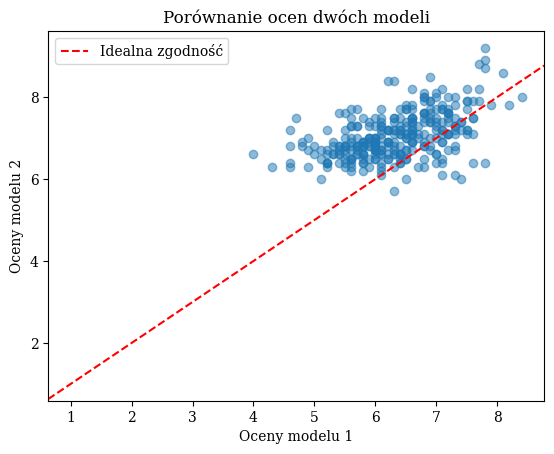

In [4408]:
plt.scatter(ratings_df['score_scaled'], ratings_df['rating'], alpha=0.5)
plt.xlabel("Oceny modelu 1")
plt.ylabel("Oceny modelu 2")
plt.title("Porównanie ocen dwóch modeli")
plt.axline((1,1), slope=1, color='red', linestyle='--', label="Idealna zgodność")
plt.legend()
plt.show()

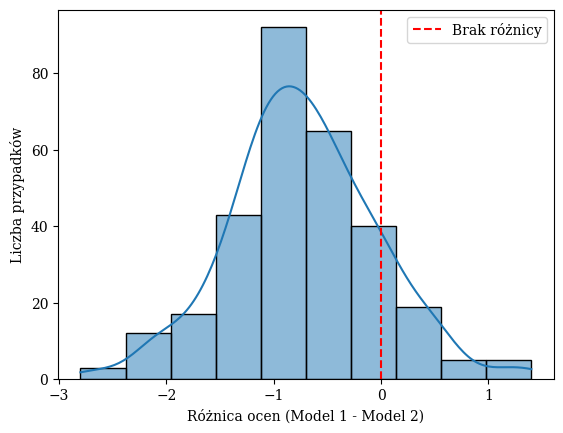

In [4409]:
diff = np.array(ratings_df['score_scaled']) - np.array(ratings_df['rating'])

sns.histplot(diff, bins=10, kde=True)
plt.axvline(0, color='red', linestyle='--', label="Brak różnicy")
plt.xlabel("Różnica ocen (Model 1 - Model 2)")
plt.ylabel("Liczba przypadków")
plt.legend()
plt.show()

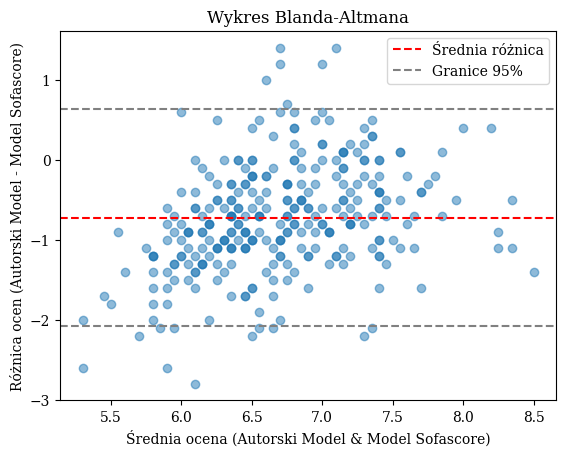

In [4689]:
import statsmodels.api as sm

mean_scores = (np.array(ratings_df['score_scaled']) + np.array(ratings_df['rating'])) / 2
diff_scores = np.array(ratings_df['score_scaled']) - np.array(ratings_df['rating'])

fig, ax = plt.subplots()
ax.scatter(mean_scores, diff_scores, alpha=0.5)
ax.axhline(np.mean(diff_scores), color='red', linestyle='--', label="Średnia różnica")
ax.axhline(np.mean(diff_scores) + 1.96*np.std(diff_scores), color='gray', linestyle='--', label="Granice 95%")
ax.axhline(np.mean(diff_scores) - 1.96*np.std(diff_scores), color='gray', linestyle='--')
ax.set_xlabel("Średnia ocena (Autorski Model & Model Sofascore)")
ax.set_ylabel("Różnica ocen (Autorski Model - Model Sofascore)")
ax.legend()
plt.title("Wykres Blanda-Altmana")
plt.show()

In [4413]:
mean_diff = np.mean(diff_scores)  # Średnia różnica ocen
std_diff = np.std(diff_scores, ddof=1)  # Odchylenie standardowe różnic

lower_limit = mean_diff - 1.96 * std_diff  # Dolna granica zgodności
upper_limit = mean_diff + 1.96 * std_diff  # Górna granica zgodności

In [4414]:
within_limits = np.sum((diff_scores >= lower_limit) & (diff_scores <= upper_limit))
percent_within_limits = (within_limits / len(diff_scores)) * 100

print(f"Procent różnic w granicach 95%: {percent_within_limits:.2f}%")

Procent różnic w granicach 95%: 94.35%


In [4419]:
xt_grid = pd.read_excel("C:/Python_projects/StatsBomb/JPN/xt_grid (1).xlsx", header=None)

In [4427]:
from matplotlib.colors import LogNorm

In [4457]:
xt_cols = [x for x in range(0,105,5)]
xt_ix = [x for x in range(64,-4,-4)]

In [4462]:
xt_grid.columns = xt_cols
xt_grid.index = xt_ix

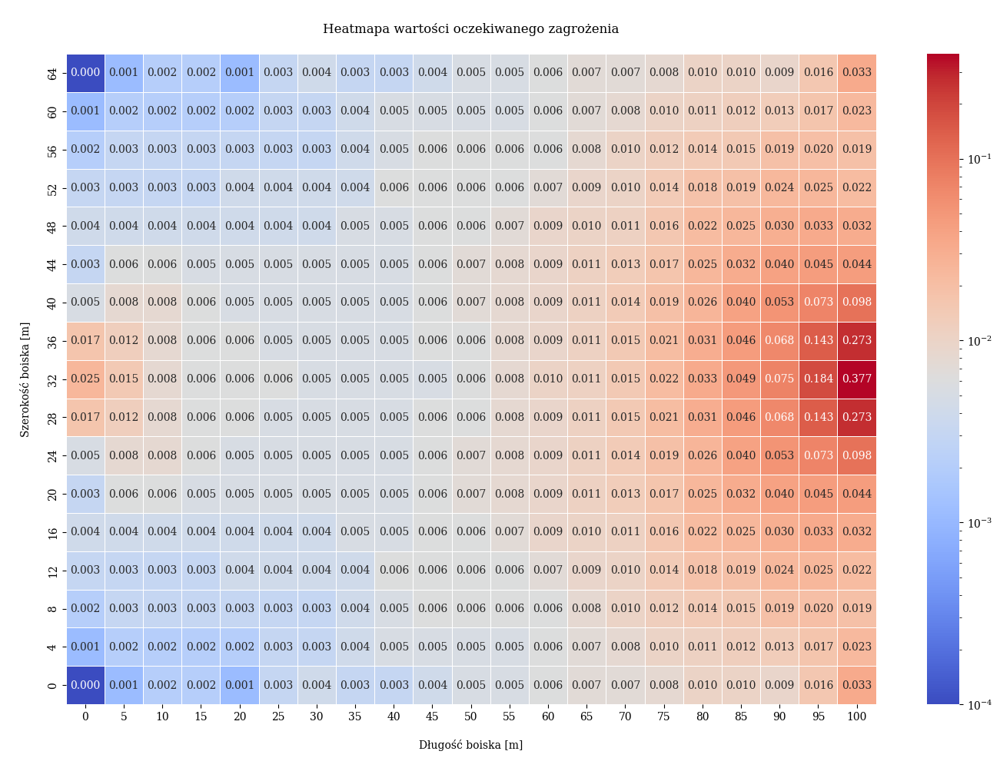

In [4472]:
plt.figure(figsize=(17, 11))
sns.heatmap(xt_grid+0.0001, cmap="coolwarm", norm=LogNorm(), annot=True, fmt=".3f", linewidths=0.5)

plt.title("\nHeatmapa wartości oczekiwanego zagrożenia\n")
plt.xlabel("\nDługość boiska [m]\n")
plt.ylabel("\nSzerokość boiska [m]\n")
plt.show()

<Axes: >

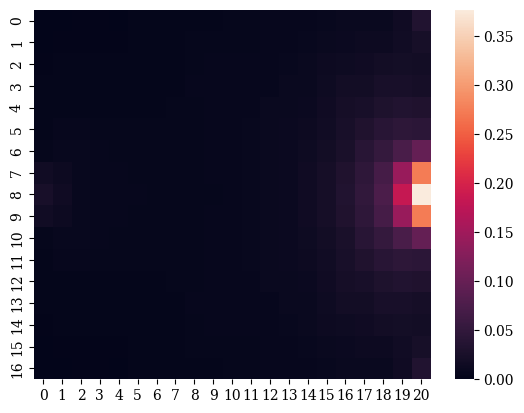

In [4421]:
sns.heatmap(xt_grid)

In [4406]:
ratings_df.sort_values(by='delta', ascending=False).tail(20)

,player,team,match_id,position,goals,assist,PAxG,npxg,shots_on_target,xGA,fwp+,carries_into_pen,shots,xT+,prog_pass,prog_carries,score_scaled,rating,delta
22,Lorenzo Pellegrini,Italy,3930161,Left Wing,0.0,1.0,-0.314158,0.371517,0.0,0.324456,69.6500,1.0,3.0,0.534,1.0,4.0,5.8,7.5,-1.7
76,Rasmus Winther Højlund,Denmark,3930171,Center Forward,0.0,0.0,0.000000,0.000000,0.0,0.066223,5.3375,0.0,0.0,0.011,0.0,0.0,4.9,6.7,-1.8
268,Ruben Vargas,Switzerland,3942227,Left Attacking Midfield,0.0,0.0,0.000000,0.000000,0.0,0.000000,39.6375,0.0,0.0,0.026,0.0,1.0,5.0,6.8,-1.8
28,Jan Mlakar,Slovenia,3930162,Left Midfield,0.0,0.0,0.000000,0.000000,0.0,0.000000,31.5000,0.0,0.0,0.010,0.0,0.0,4.6,6.4,-1.8
23,Jonas Older Wind,Denmark,3930162,Right Center Forward,0.0,1.0,-0.113272,0.130232,0.0,0.407290,54.0750,0.0,1.0,0.228,1.0,1.0,5.6,7.5,-1.9
30,Harry Kane,England,3930163,Center Forward,0.0,0.0,-0.139334,0.167335,0.0,0.000000,44.0125,0.0,1.0,0.009,0.0,1.0,4.8,6.8,-2.0
219,Harry Kane,England,3941017,Center Forward,0.0,0.0,-0.388200,0.443560,0.0,0.000000,75.3375,1.0,4.0,0.086,1.0,2.0,5.2,7.2,-2.0
4,Ryan Christie,Scotland,3930158,Center Forward,0.0,0.0,0.000000,0.000000,0.0,0.000000,0.0000,0.0,0.0,0.010,0.0,0.0,4.3,6.3,-2.0
273,Bernardo Mota Veiga de Carvalho e Silva,Portugal,3942349,Right Midfield,0.0,0.0,-0.045431,0.098666,0.0,0.000000,108.2375,0.0,2.0,0.094,1.0,2.0,5.7,7.7,-2.0
128,José Luis Sanmartín Mato,Spain,3930179,Center Forward,0.0,0.0,-0.134321,0.142728,0.0,0.000000,12.6000,1.0,3.0,0.026,0.0,0.0,4.9,7.0,-2.1


In [4407]:
ratings_df.sort_values(by='score_scaled')

,player,team,match_id,position,goals,assist,PAxG,npxg,shots_on_target,xGA,fwp+,carries_into_pen,shots,xT+,prog_pass,prog_carries,score_scaled,rating,delta
235,Marcus Thuram,France,3941019,Center Forward,0.0,0.0,-0.373771,0.430990,0.0,0.000000,3.4125,0.0,4.0,0.007,0.0,0.0,4.0,6.6,-2.6
4,Ryan Christie,Scotland,3930158,Center Forward,0.0,0.0,0.000000,0.000000,0.0,0.000000,0.0000,0.0,0.0,0.010,0.0,0.0,4.3,6.3,-2.0
180,Artem Dovbyk,Ukraine,3938640,Center Forward,0.0,0.0,-0.270227,0.375410,0.0,0.133755,1.4875,1.0,2.0,0.123,0.0,0.0,4.6,6.8,-2.2
57,Bruno Petković,Croatia,3930167,Center Forward,0.0,0.0,-0.306087,0.354099,0.0,0.058311,30.1000,0.0,3.0,0.063,0.0,0.0,4.6,7.2,-2.6
28,Jan Mlakar,Slovenia,3930162,Left Midfield,0.0,0.0,0.000000,0.000000,0.0,0.000000,31.5000,0.0,0.0,0.010,0.0,0.0,4.6,6.4,-1.8
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
247,Cody Mathès Gakpo,Netherlands,3941021,Left Wing,1.0,1.0,2.091973,0.268116,3.0,0.661215,73.5875,2.0,4.0,0.627,2.0,5.0,7.8,9.2,-1.4
187,Patrik Schick,Czech Republic,3938642,Center Forward,1.0,0.0,1.263780,1.193466,4.0,0.029279,77.0875,1.0,7.0,0.116,0.0,1.0,7.9,7.8,0.1
104,Kevin De Bruyne,Belgium,3930175,Center Attacking Midfield,1.0,0.0,1.813385,0.455114,3.0,0.352865,283.2375,1.0,5.0,0.364,2.0,5.0,8.1,8.6,-0.5
229,Lamine Yamal Nasraoui Ebana,Spain,3941018,Right Wing,0.0,1.0,0.556951,0.649846,2.0,0.541580,193.5500,5.0,7.0,1.118,2.0,11.0,8.2,7.8,0.4


In [4404]:
ratings_df[ratings_df['score_scaled'] == ratings_df['rating']]

,player,team,match_id,position,goals,assist,PAxG,npxg,shots_on_target,xGA,fwp+,carries_into_pen,shots,xT+,prog_pass,prog_carries,score_scaled,rating
29,Petar Stojanović,Slovenia,3930162,Right Midfield,0.0,0.0,0.000000,0.000000,0.0,0.000000,114.7125,1.0,0.0,0.334,1.0,2.0,6.1,6.1
252,Marko Arnautović,Austria,3941022,Center Forward,0.0,0.0,0.000000,0.328914,1.0,0.000000,64.3125,0.0,2.0,0.061,1.0,0.0,6.3,6.3
232,Romelu Lukaku Menama,Belgium,3941019,Right Center Forward,0.0,0.0,0.656482,0.038119,1.0,0.000000,41.3875,0.0,1.0,0.036,0.0,1.0,6.4,6.4
52,Rafael Alexandre Conceição Leão,Portugal,3930166,Left Center Forward,0.0,0.0,-0.008518,0.008592,0.0,0.054355,20.6500,6.0,1.0,0.369,1.0,9.0,6.4,6.4
233,Jeremy Doku,Belgium,3941019,Left Midfield,0.0,0.0,0.000000,0.000000,0.0,0.082714,170.9750,1.0,0.0,0.202,3.0,8.0,6.5,6.5
35,Dušan Vlahović,Serbia,3930163,Right Center Forward,0.0,0.0,0.650034,0.082381,1.0,0.000000,34.2125,1.0,2.0,0.031,0.0,0.0,6.5,6.5
169,Georgiy Sudakov,Ukraine,3938638,Center Attacking Midfield,0.0,0.0,-0.035260,0.106892,1.0,0.000000,224.9625,0.0,4.0,0.312,8.0,4.0,6.8,6.8
274,Bruno Miguel Borges Fernandes,Portugal,3942349,Center Attacking Midfield,0.0,0.0,0.512136,0.201408,1.0,0.100309,152.3375,0.0,3.0,0.299,3.0,3.0,6.8,6.8
283,Kylian Mbappé Lottin,France,3942752,Left Wing,0.0,1.0,0.553395,0.248285,1.0,0.271320,95.9875,3.0,4.0,0.469,1.0,5.0,7.0,7.0
26,Andraž Šporar,Slovenia,3930162,Right Center Forward,0.0,0.0,0.199183,0.651514,1.0,0.195730,34.4750,0.0,4.0,0.388,1.0,1.0,7.1,7.1


<Axes: xlabel='score_scaled', ylabel='Count'>

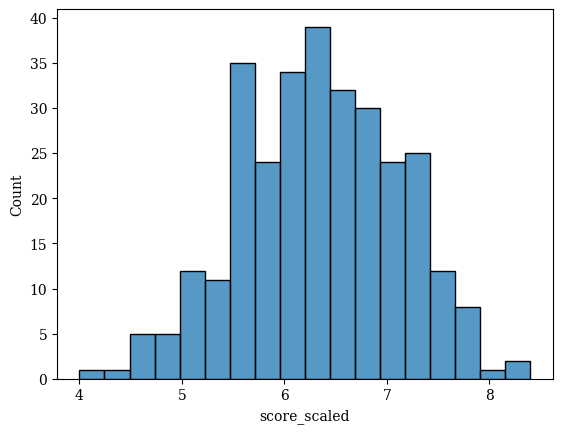

In [4690]:
sns.histplot(ratings_df['score_scaled'], bins=18)

<Axes: xlabel='rating', ylabel='Count'>

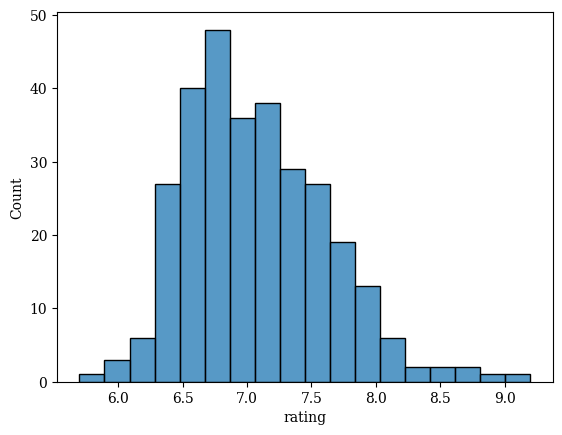

In [4691]:
sns.histplot(ratings_df['rating'], bins=18)

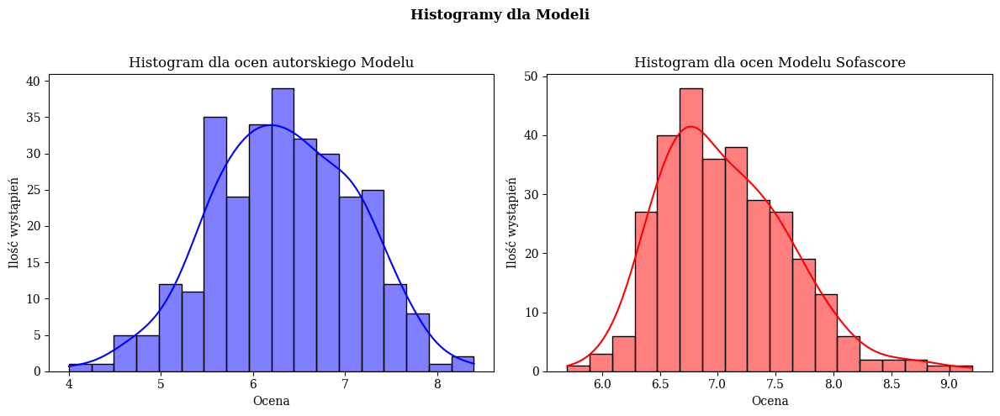

In [4693]:
import matplotlib.pyplot as plt
import seaborn as sns

fig, axes = plt.subplots(1, 2, figsize=(12, 5))  # Tworzymy 2 wykresy obok siebie

# Pierwszy histogram
sns.histplot(ratings_df['score_scaled'], bins=18, kde=True, color='blue', ax=axes[0])
axes[0].set_title('Histogram dla ocen autorskiego Modelu')
axes[0].set_xlabel('Ocena')
axes[0].set_ylabel('Ilość wystąpień')

# Drugi histogram
sns.histplot(ratings_df['rating'], bins=18, kde=True, color='red', ax=axes[1])
axes[1].set_title('Histogram dla ocen Modelu Sofascore')
axes[1].set_xlabel('Ocena')
axes[1].set_ylabel('Ilość wystąpień')

plt.suptitle("Histogramy dla Modeli\n", weight="bold")
plt.tight_layout()  # Dopasowanie układu
plt.show()


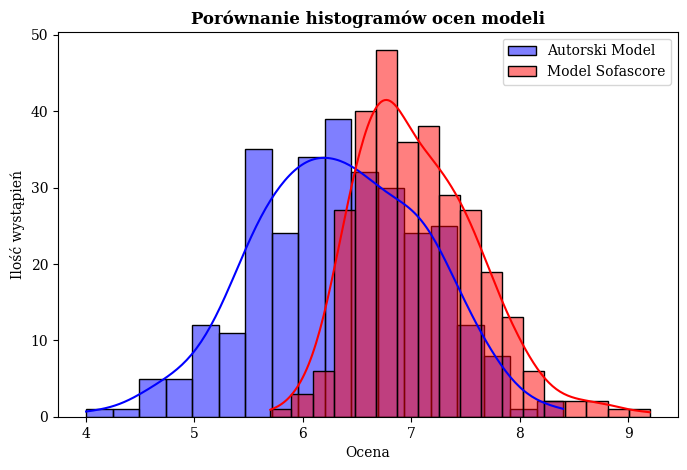

In [4694]:
plt.figure(figsize=(8, 5))  # Rozmiar wykresu

# Histogram dla obu modeli na jednym wykresie
sns.histplot(ratings_df['score_scaled'], bins=18, kde=True, color='blue', alpha=0.5, label='Autorski Model')
sns.histplot(ratings_df['rating'], bins=18, kde=True, color='red', alpha=0.5, label='Model Sofascore')

plt.title("Porównanie histogramów ocen modeli", weight="bold")
plt.xlabel("Ocena")
plt.ylabel("Ilość wystąpień")
plt.legend()  # Dodanie legendy
plt.show()

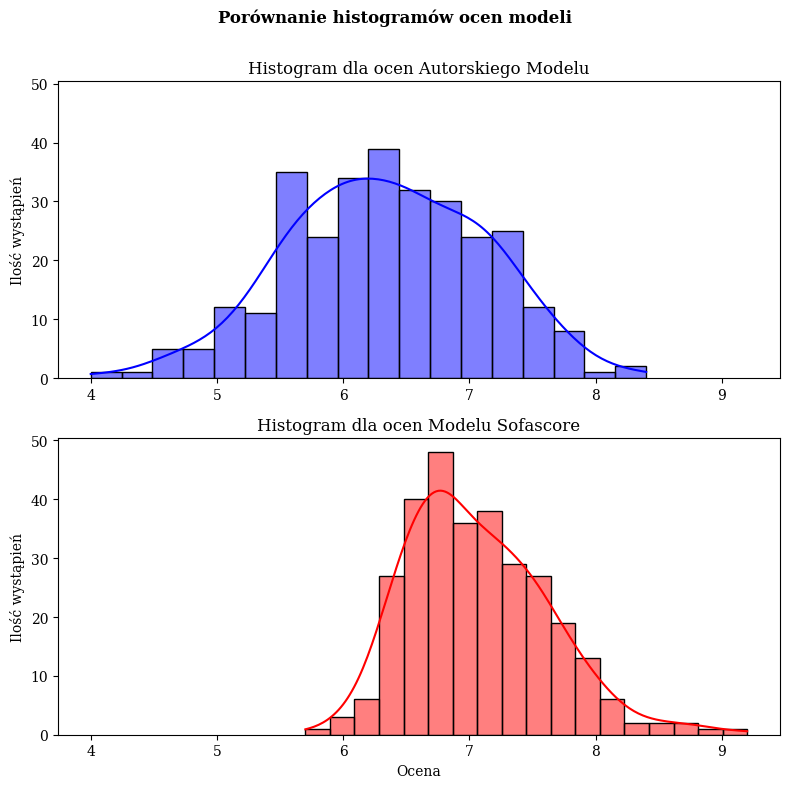

In [4697]:
fig, axes = plt.subplots(2, 1, figsize=(8, 8), sharex=True, sharey=True)  # Zachowujemy wspólną skalę

# Pierwszy histogram (Autorski Model)
sns.histplot(ratings_df['score_scaled'], bins=18, kde=True, color='blue', ax=axes[0])
axes[0].set_title('Histogram dla ocen Autorskiego Modelu')
axes[0].set_ylabel('Ilość wystąpień')
axes[0].tick_params(axis='x', labelbottom=True)  # Włączenie liczb na osi X

# Drugi histogram (Model Sofascore)
sns.histplot(ratings_df['rating'], bins=18, kde=True, color='red', ax=axes[1])
axes[1].set_title('Histogram dla ocen Modelu Sofascore')
axes[1].set_xlabel('Ocena')
axes[1].set_ylabel('Ilość wystąpień')

# Główna nazwa wykresu
plt.suptitle("Porównanie histogramów ocen modeli\n", weight="bold")

plt.tight_layout()  # Dopasowanie układu
plt.show()

In [3951]:
r = ratings_df.sort_index()

In [3954]:
r.index

Index([  0,   1,   2,   3,   4,   5,   6,   7,   8,   9,
       ...
       292, 293, 294, 295, 296, 297, 298, 299, 300, 301],
      dtype='int64', length=301)

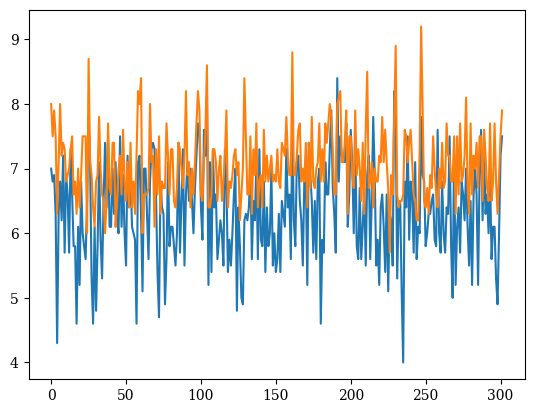

In [3956]:
plt.plot(r.index,r['score_scaled'])
plt.plot(r.index,r['rating'])

In [3957]:
ratings_df['delta'] = ratings_df['score_scaled'] - ratings_df['rating']
ratings_df.sort_values(by='delta', ascending=False)

,player,team,match_id,position,goals,assist,PAxG,npxg,shots_on_target,xGA,fwp+,carries_into_pen,shots,xT+,prog_pass,prog_carries,score_scaled,rating,delta
36,Romelu Lukaku Menama,Belgium,3930164,Center Forward,0.0,0.0,0.685651,0.729104,2.0,0.099074,52.1500,1.0,3.0,0.333,1.0,0.0,7.4,6.0,1.4
215,Kai Havertz,Germany,3940983,Center Forward,1.0,0.0,1.002865,0.824679,4.0,0.000000,72.8000,2.0,4.0,0.281,1.0,5.0,7.8,6.4,1.4
69,Aleksandar Mitrović,Serbia,3930170,Center Forward,0.0,0.0,0.539577,0.899231,2.0,0.000000,95.2875,0.0,6.0,0.073,2.0,0.0,7.3,6.1,1.2
258,Kai Havertz,Germany,3942226,Center Forward,0.0,0.0,0.898311,0.353331,2.0,0.000000,108.6750,1.0,4.0,0.204,1.0,4.0,7.6,6.4,1.2
43,Christoph Baumgartner,Austria,3930165,Center Attacking Midfield,0.0,0.0,0.443971,0.668956,2.0,0.021682,126.0875,3.0,2.0,0.286,1.0,8.0,7.1,6.1,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
180,Artem Dovbyk,Ukraine,3938640,Center Forward,0.0,0.0,-0.270227,0.375410,0.0,0.133755,1.4875,1.0,2.0,0.123,0.0,0.0,4.6,6.8,-2.2
129,Daniel Olmo Carvajal,Spain,3930179,Center Attacking Midfield,0.0,1.0,-0.109537,0.181926,0.0,0.103582,167.3875,1.0,4.0,0.181,2.0,3.0,6.2,8.4,-2.2
235,Marcus Thuram,France,3941019,Center Forward,0.0,0.0,-0.373771,0.430990,0.0,0.000000,3.4125,0.0,4.0,0.007,0.0,0.0,4.0,6.6,-2.6
57,Bruno Petković,Croatia,3930167,Center Forward,0.0,0.0,-0.306087,0.354099,0.0,0.058311,30.1000,0.0,3.0,0.063,0.0,0.0,4.6,7.2,-2.6


Marcus Thuram 3941019 4 vs  Georges Mikautadze 5.7	3941019
Kylian Mbappé Lottin 8.4	France	3938643 vs Cody Mathès Gakpo 9.2	3941021	 

Thuram vs Mikautadze

In [4652]:
ratings_df[(ratings_df['score_scaled'] == 7.8) | (ratings_df['rating']==7.8)]

,player,team,match_id,position,goals,assist,PAxG,npxg,shots_on_target,xGA,fwp+,carries_into_pen,shots,xT+,prog_pass,prog_carries,score_scaled,rating,delta
215,Kai Havertz,Germany,3940983,Center Forward,1.0,0.0,1.002865,0.824679,4.0,0.000000,72.8000,2.0,4.0,0.281,1.0,5.0,7.8,6.4,1.4
157,Barış Alper Yılmaz,Turkey,3930184,Right Wing,0.0,0.0,0.959314,0.152440,2.0,0.272293,95.0250,2.0,2.0,0.663,2.0,7.0,7.3,7.8,-0.5
221,Jude Bellingham,England,3941017,Center Attacking Midfield,1.0,0.0,-0.074709,0.184565,1.0,0.089026,203.2625,3.0,2.0,0.302,4.0,4.0,6.6,7.8,-1.2
174,Arda Güler,Turkey,3938639,Right Wing,1.0,0.0,0.000000,0.018738,1.0,0.440614,125.8250,2.0,1.0,0.514,2.0,1.0,6.5,7.8,-1.3
187,Patrik Schick,Czech Republic,3938642,Center Forward,1.0,0.0,1.263780,1.193466,4.0,0.029279,77.0875,1.0,7.0,0.116,0.0,1.0,7.9,7.8,0.1
229,Lamine Yamal Nasraoui Ebana,Spain,3941018,Right Wing,0.0,1.0,0.556951,0.649846,2.0,0.541580,193.5500,5.0,7.0,1.118,2.0,11.0,8.2,7.8,0.4
32,Jude Bellingham,England,3930163,Center Attacking Midfield,1.0,0.0,1.198515,0.289107,1.0,0.000000,250.8625,0.0,1.0,0.140,5.0,2.0,7.1,7.8,-0.7
25,Christian Dannemann Eriksen,Denmark,3930162,Center Attacking Midfield,1.0,0.0,1.035420,0.470574,1.0,0.439981,262.1500,0.0,5.0,1.158,1.0,1.0,7.8,8.7,-0.9
230,Nicholas Williams Arthuer,Spain,3941018,Left Wing,1.0,1.0,1.542359,0.396384,2.0,0.416517,98.3500,3.0,5.0,0.605,3.0,5.0,7.8,8.9,-1.1
247,Cody Mathès Gakpo,Netherlands,3941021,Left Wing,1.0,1.0,2.091973,0.268116,3.0,0.661215,73.5875,2.0,4.0,0.627,2.0,5.0,7.8,9.2,-1.4


In [4614]:
plot = res[(res['player'].isin(['Marcus Thuram', 'Georges Mikautadze'])) & (res['match_id'].isin([3941019, 3941018]))]


In [4615]:
plot

,player,Team,match_id,Position,Goals,Assist,PAxG,NPxG,Shots On Target,xGA,Forward Passes,Carries into Pen,Shots,xT,Progressive Passes,Progressive Carries
2326,Georges Mikautadze,Georgia,3941018,Right Center Forward,0.0,0.0,0.000000,0.00000,0.0,0.0,120.9250,1.0,0.0,0.077,2.0,3.0
4530,Marcus Thuram,France,3941019,Center Forward,0.0,0.0,-0.373771,0.43099,0.0,0.0,3.4125,0.0,4.0,0.007,0.0,0.0


In [4589]:
plot.columns =["player", "Team", "match_id", "Position", "Goals", "Assist" ,"PAxG", "NPxG", "Shots On Target", "xGA", "Forward Passes", "Carries into Pen", "Shots", "xT", "Progressive Passes", "Progressive Carries", "score_sclaed", "rating", "delta"]

In [4618]:
params = list(plot.columns[6:])

In [4619]:
params

['PAxG',
 'NPxG',
 'Shots On Target',
 'xGA',
 'Forward Passes',
 'Carries into Pen',
 'Shots',
 'xT',
 'Progressive Passes',
 'Progressive Carries']

In [4620]:
plot2 = res[(res['player'].isin(['Kylian Mbappé Lottin', 'Cody Mathès Gakpo'])) & (res['match_id'].isin([3938643, 3941021]))]

In [4621]:
plot3 = res[(res['player'].isin(['Lionel Andrés Messi Cuccittini', 'Zlatan Ibrahimović'])) & (res['match_id'].isin([267670, 3901183]))]

In [4654]:
plot4 = res[(res['player'].isin(['Cody Mathès Gakpo', 
'Arda Güler'])) & (res['match_id'].isin([3941021, 3938639]))]

In [4655]:
plot4.reset_index(drop=True, inplace=True)
plot4

,player,Team,match_id,Position,Goals,Assist,PAxG,NPxG,Shots On Target,xGA,Forward Passes,Carries into Pen,Shots,xT,Progressive Passes,Progressive Carries
0,Arda Güler,Turkey,3938639,Right Wing,1.0,0.0,0.000000,0.018738,1.0,0.440614,125.8250,2.0,1.0,0.514,2.0,1.0
1,Cody Mathès Gakpo,Netherlands,3941021,Left Wing,1.0,1.0,2.091973,0.268116,3.0,0.661215,73.5875,2.0,4.0,0.627,2.0,5.0


In [4622]:
plot.reset_index(drop=True, inplace=True)
plot

,player,Team,match_id,Position,Goals,Assist,PAxG,NPxG,Shots On Target,xGA,Forward Passes,Carries into Pen,Shots,xT,Progressive Passes,Progressive Carries
0,Georges Mikautadze,Georgia,3941018,Right Center Forward,0.0,0.0,0.000000,0.00000,0.0,0.0,120.9250,1.0,0.0,0.077,2.0,3.0
1,Marcus Thuram,France,3941019,Center Forward,0.0,0.0,-0.373771,0.43099,0.0,0.0,3.4125,0.0,4.0,0.007,0.0,0.0


In [4623]:
plot2.reset_index(drop=True, inplace=True)
plot2

,player,Team,match_id,Position,Goals,Assist,PAxG,NPxG,Shots On Target,xGA,Forward Passes,Carries into Pen,Shots,xT,Progressive Passes,Progressive Carries
0,Kylian Mbappé Lottin,France,3938643,Center Forward,1.0,0.0,1.457759,0.260262,5.0,0.000000,265.3875,6.0,5.0,0.627,4.0,7.0
1,Cody Mathès Gakpo,Netherlands,3941021,Left Wing,1.0,1.0,2.091973,0.268116,3.0,0.661215,73.5875,2.0,4.0,0.627,2.0,5.0


In [4624]:
plot3.reset_index(drop=True, inplace=True)
plot3

,player,Team,match_id,Position,Goals,Assist,PAxG,NPxG,Shots On Target,xGA,Forward Passes,Carries into Pen,Shots,xT,Progressive Passes,Progressive Carries
0,Zlatan Ibrahimović,Paris Saint-Germain,3901183,Center Forward,4.0,1.0,4.589730,0.736621,5.0,1.048807,67.2000,4.0,8.0,0.216,2.0,5.0
1,Lionel Andrés Messi Cuccittini,Barcelona,267670,Right Wing,2.0,1.0,2.720758,0.977309,5.0,1.348757,473.8125,1.0,12.0,1.058,11.0,8.0


In [4596]:
plot3 = plot3.iloc[:,:16]

In [4625]:
plot3

,player,Team,match_id,Position,Goals,Assist,PAxG,NPxG,Shots On Target,xGA,Forward Passes,Carries into Pen,Shots,xT,Progressive Passes,Progressive Carries
0,Zlatan Ibrahimović,Paris Saint-Germain,3901183,Center Forward,4.0,1.0,4.589730,0.736621,5.0,1.048807,67.2000,4.0,8.0,0.216,2.0,5.0
1,Lionel Andrés Messi Cuccittini,Barcelona,267670,Right Wing,2.0,1.0,2.720758,0.977309,5.0,1.348757,473.8125,1.0,12.0,1.058,11.0,8.0


In [4607]:
res = result.iloc[:,:16]

In [4609]:
res.columns =["player", "Team", "match_id", "Position", "Goals", "Assist" ,"PAxG", "NPxG", "Shots On Target", "xGA", "Forward Passes", "Carries into Pen", "Shots", "xT", "Progressive Passes", "Progressive Carries"]

In [4626]:
ranges = []
a_values = []
b_values = []
c_values = []

for x in params:
    a = min(res[params][x])
    a = a - (a*.01)
    
    b = max(res[params][x])
    b = b + (b*.01)
    
    ranges.append((a,b))
    
for x in range(len(plot['player'])):
    if plot['player'][x] == 'Marcus Thuram':
        a_values = plot.iloc[x].values.tolist()
    if plot['player'][x] == 'Georges Mikautadze':
        b_values = plot.iloc[x].values.tolist()
        
a_values = a_values[6:]
b_values = b_values[6:]
#c_values = c_values[1:]

values = [a_values,b_values]

In [4627]:
for x in range(len(plot2['player'])):
    if plot2['player'][x] == 'Kylian Mbappé Lottin':
        a_values = plot2.iloc[x].values.tolist()
    if plot2['player'][x] == 'Cody Mathès Gakpo':
        b_values = plot2.iloc[x].values.tolist()
        
a_values = a_values[6:]
b_values = b_values[6:]
#c_values = c_values[1:]

values = [a_values,b_values]

In [4628]:
plot2

,player,Team,match_id,Position,Goals,Assist,PAxG,NPxG,Shots On Target,xGA,Forward Passes,Carries into Pen,Shots,xT,Progressive Passes,Progressive Carries
0,Kylian Mbappé Lottin,France,3938643,Center Forward,1.0,0.0,1.457759,0.260262,5.0,0.000000,265.3875,6.0,5.0,0.627,4.0,7.0
1,Cody Mathès Gakpo,Netherlands,3941021,Left Wing,1.0,1.0,2.091973,0.268116,3.0,0.661215,73.5875,2.0,4.0,0.627,2.0,5.0


In [4613]:
plot3

,player,team,match_id,position,goals,assist,PAxG,npxg,shots_on_target,xGA,fwp+,carries_into_pen,shots,xT+,prog_pass,prog_carries
0,Zlatan Ibrahimović,Paris Saint-Germain,3901183,Center Forward,4.0,1.0,4.589730,0.736621,5.0,1.048807,67.2000,4.0,8.0,0.216,2.0,5.0
1,Lionel Andrés Messi Cuccittini,Barcelona,267670,Right Wing,2.0,1.0,2.720758,0.977309,5.0,1.348757,473.8125,1.0,12.0,1.058,11.0,8.0


In [4629]:
for x in range(len(plot3['player'])):
    if plot3['player'][x] == 'Lionel Andrés Messi Cuccittini':
        a_values = plot3.iloc[x].values.tolist()
    if plot3['player'][x] == 'Zlatan Ibrahimović':
        b_values = plot3.iloc[x].values.tolist()
        
a_values = a_values[6:]
b_values = b_values[6:]
#c_values = c_values[1:]

values = [a_values,b_values]

In [4662]:
for x in range(len(plot4['player'])):
    if plot4['player'][x] == 'Arda Güler':
        a_values = plot4.iloc[x].values.tolist()
    if plot4['player'][x] == 'Cody Mathès Gakpo':
        b_values = plot4.iloc[x].values.tolist()
        
a_values = a_values[6:]
b_values = b_values[6:]
#c_values = c_values[1:]

values = [a_values,b_values]

In [4630]:
title = dict(
    title_name='Marcus Thuram',
    title_color = 'blue',
    subtitle_name = 'France',
    subtitle_color = 'black',
    title_name_2='Georges Mikautadze',
    title_color_2 = 'red',
    subtitle_name_2 = 'Georgia',
    subtitle_color_2 = 'black',
    title_fontsize = 18,
    subtitle_fontsize=15
)

In [4631]:
title2 = dict(
    title_name='Kylian Mbappé Lottin',
    title_color = 'blue',
    subtitle_name = 'France',
    subtitle_color = 'black',
    title_name_2='Cody Mathès Gakpo',
    title_color_2 = 'orange',
    subtitle_name_2 = 'Netherlands',
    subtitle_color_2 = 'black',
    title_fontsize = 18,
    subtitle_fontsize=15
)

In [4635]:
title3 = dict(
    title_name='Lionel Messi',
    title_color = 'red',
    subtitle_name = 'FC Barcelona',
    subtitle_color = 'black',
    title_name_2='Zlatan Ibrahimović',
    title_color_2 = 'blue',
    subtitle_name_2 = 'Paris Saint-Germain',
    subtitle_color_2 = 'black',
    title_fontsize = 18,
    subtitle_fontsize=15,
)

In [4668]:
title4 = dict(
    title_name='Arda Güler',
    title_color = 'blue',
    subtitle_name = 'Turkey',
    subtitle_color = 'black',
    title_name_2='Cody Mathès Gakpo',
    title_color_2 = 'red',
    subtitle_name_2 = 'Netherlands',
    subtitle_color_2 = 'black',
    title_fontsize = 18,
    subtitle_fontsize=15
)

In [4641]:
endnote = None

In [4642]:
endnote = "Wykres radarowy przedstawiający 2 najlepiej\n ocenionych zawodników w zbiorze danych"

In [4661]:
values

[[12.0, 1.058, 11.0, 8.0],
 [2.091972780846911,
  0.26811597600000003,
  3.0,
  0.66121484,
  73.5875,
  2.0,
  4.0,
  0.627,
  2.0,
  5.0]]

findfont: Font family 'Liberation Serif' not found.
findfont: Font family 'Liberation Serif' not found.
findfont: Font family 'Liberation Serif' not found.
findfont: Font family 'Liberation Serif' not found.
findfont: Font family 'Liberation Serif' not found.
findfont: Font family 'Liberation Serif' not found.
findfont: Font family 'Liberation Serif' not found.
findfont: Font family 'Liberation Serif' not found.
findfont: Font family 'Liberation Serif' not found.
findfont: Font family 'Liberation Serif' not found.
findfont: Font family 'Liberation Serif' not found.
findfont: Font family 'Liberation Serif' not found.
findfont: Font family 'Liberation Serif' not found.
findfont: Font family 'Liberation Serif' not found.
findfont: Font family 'Liberation Serif' not found.
findfont: Font family 'Liberation Serif' not found.
findfont: Font family 'Liberation Serif' not found.
findfont: Font family 'Liberation Serif' not found.
findfont: Font family 'Liberation Serif' not found.
findfont: Fo

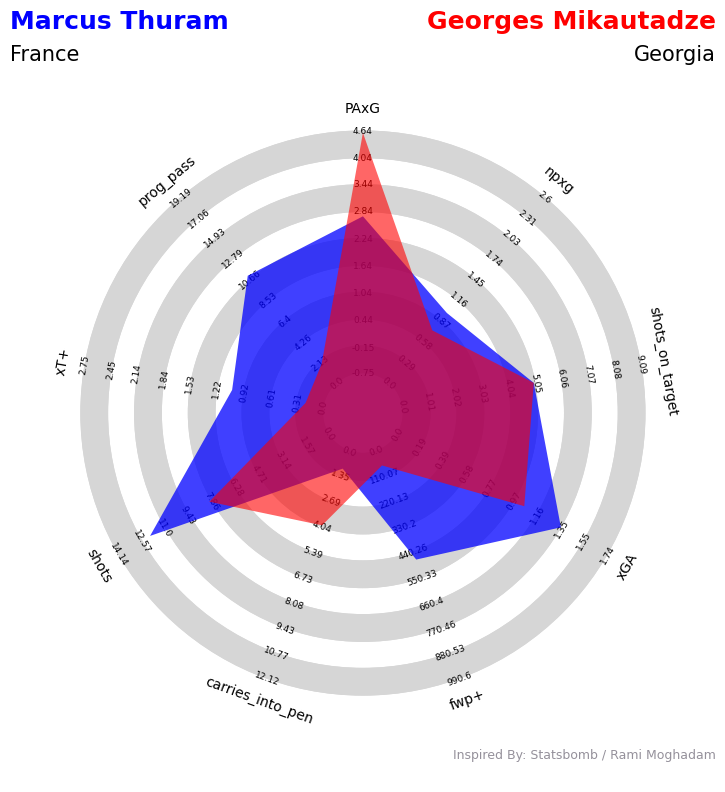

In [4571]:
radar = Radar()

fig,ax = radar.plot_radar(ranges=ranges,params=params,values=values,
                         radar_color=['blue', 'red'],
                         alphas=[.75,.6],title=title,
                         compare=True)

findfont: Font family 'Liberation Serif' not found.
findfont: Font family 'Liberation Serif' not found.
findfont: Font family 'Liberation Serif' not found.
findfont: Font family 'Liberation Serif' not found.
findfont: Font family 'Liberation Serif' not found.
findfont: Font family 'Liberation Serif' not found.
findfont: Font family 'Liberation Serif' not found.
findfont: Font family 'Liberation Serif' not found.
findfont: Font family 'Liberation Serif' not found.
findfont: Font family 'Liberation Serif' not found.
findfont: Font family 'Liberation Serif' not found.
findfont: Font family 'Liberation Serif' not found.
findfont: Font family 'Liberation Serif' not found.
findfont: Font family 'Liberation Serif' not found.
findfont: Font family 'Liberation Serif' not found.
findfont: Font family 'Liberation Serif' not found.
findfont: Font family 'Liberation Serif' not found.
findfont: Font family 'Liberation Serif' not found.
findfont: Font family 'Liberation Serif' not found.
findfont: Fo

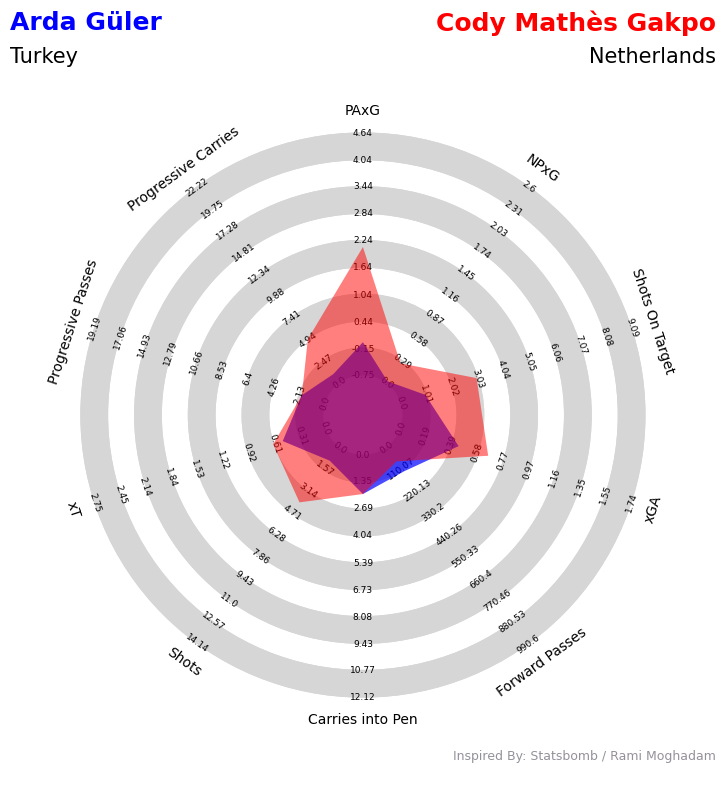

In [4669]:
radar = Radar()

fig,ax = radar.plot_radar(ranges=ranges,params=params,values=values,
                         radar_color=['blue', 'red'],
                         alphas=[.7, .5],title=title4,
                         compare=True)

In [4056]:
values

[[5.0, 0.627, 4.0], [4.0, 0.627, 2.0]]

findfont: Font family 'Liberation Serif' not found.
findfont: Font family 'Liberation Serif' not found.
findfont: Font family 'Liberation Serif' not found.
findfont: Font family 'Liberation Serif' not found.
findfont: Font family 'Liberation Serif' not found.
findfont: Font family 'Liberation Serif' not found.
findfont: Font family 'Liberation Serif' not found.
findfont: Font family 'Liberation Serif' not found.
findfont: Font family 'Liberation Serif' not found.
findfont: Font family 'Liberation Serif' not found.
findfont: Font family 'Liberation Serif' not found.
findfont: Font family 'Liberation Serif' not found.
findfont: Font family 'Liberation Serif' not found.
findfont: Font family 'Liberation Serif' not found.
findfont: Font family 'Liberation Serif' not found.
findfont: Font family 'Liberation Serif' not found.
findfont: Font family 'Liberation Serif' not found.
findfont: Font family 'Liberation Serif' not found.
findfont: Font family 'Liberation Serif' not found.
findfont: Fo

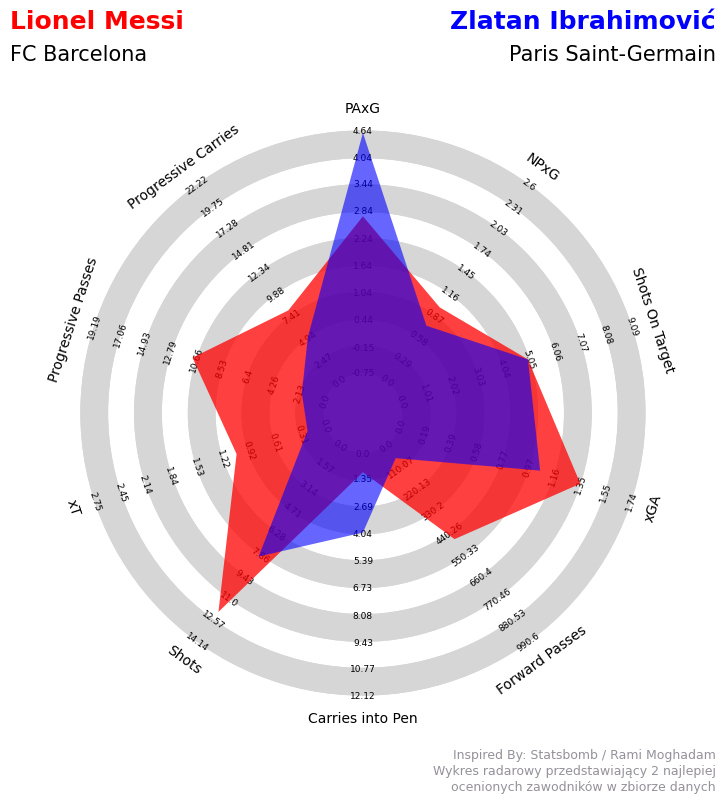

In [4643]:
fig,ax = radar.plot_radar(ranges=ranges,params=params,values=values,
                         radar_color=['red', 'blue'],
                         alphas=[.75,.6],title=title3,
                         compare=True, endnote=endnote)

sum up result

In [4324]:
ab = result.sort_values(by='score_scaled', ascending=False)[['player', 'team','score_scaled']].groupby('player').agg(
    count=('player', 'size'),
    mean_score=('score_scaled', 'mean')
).reset_index()

In [4337]:
ab[ab['count'] > 9].sort_values(by='mean_score', ascending=False).head(20).reset_index(drop=True)

,player,count,mean_score
0,Édson Arantes do Nascimento,10,8.085117
1,Lionel Andrés Messi Cuccittini,529,8.032264
2,Johan Cruyff,10,7.884630
3,Jorge Ortiz Mendoza,12,7.707088
4,Zlatan Ibrahimović,47,7.690959
5,Greg Stewart,20,7.591582
6,Ronaldo de Assis Moreira,55,7.582526
7,Diego Armando Maradona,11,7.535088
8,Kylian Mbappé Lottin,71,7.491332
9,Samuel Eto''o Fils,74,7.483796


<Axes: xlabel='mean_score', ylabel='Count'>

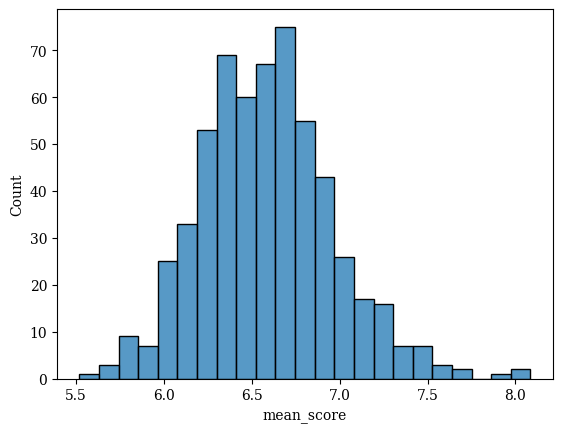

In [4338]:
sns.histplot((ab[ab['count'] > 9].sort_values(by='mean_score', ascending=False).reset_index(drop=True))['mean_score'])

In [4102]:
result.groupby('team').size().reset_index(name='val').sort_values(by='val')

,team,val
158,New York Red Bulls,2
83,FC Porto,2
156,Nashville SC,2
55,Cincinnati,2
169,Panathinaikos,3
...,...,...
18,Athletic Club,223
201,Sevilla,226
171,Paris Saint-Germain,276
15,Arsenal,292


In [4022]:
result[list(result.columns[:12]) + ['score_scaled']].sort_values(by='score_scaled', ascending=True)

,player,team,match_id,position,goals,assist,PAxG,npxg,shots_on_target,xGA,fwp+,carries_into_pen,score_scaled
17311,Timothy Weah,United States,3939981,Right Wing,0.0,0.0,0.000000,0.000000,0.0,0.000000,0.0000,0.0,3.000000
5180,Olivier Giroud,France,8655,Center Forward,0.0,0.0,-0.760670,0.914366,0.0,0.000000,53.3750,0.0,3.000000
12422,Justin Diehl,FC Köln,3895258,Left Midfield,0.0,0.0,0.000000,0.000000,0.0,0.000000,0.0000,0.0,3.000000
4867,Miguel Ángel Guerrero Martín,Leganés,303532,Left Center Forward,0.0,0.0,-0.309490,0.443835,0.0,0.000000,0.3500,0.0,3.206312
10953,Ismaïla Sarr,Senegal,3920412,Right Midfield,0.0,0.0,-0.098889,0.105218,0.0,0.000000,0.0000,0.0,3.581530
...,...,...,...,...,...,...,...,...,...,...,...,...,...
13152,Lionel Andrés Messi Cuccittini,Barcelona,303451,Right Wing,3.0,0.0,4.091360,0.379496,4.0,0.515615,466.3750,6.0,9.685249
13172,Lionel Andrés Messi Cuccittini,Barcelona,303731,Right Wing,4.0,0.0,3.224858,1.653811,4.0,0.000000,427.2625,5.0,9.696674
13186,Lionel Andrés Messi Cuccittini,Barcelona,3773660,Right Wing,1.0,0.0,1.926762,0.981736,6.0,0.107816,397.6000,5.0,9.768934
13149,Lionel Andrés Messi Cuccittini,Barcelona,267670,Right Wing,2.0,1.0,2.720758,0.977309,5.0,1.348757,473.8125,1.0,10.000000


Najgorszy zawodnik wg. naszego modelu:
Timothy Weah	United States	3939981 pomoc (w sofie również 3.0)

Olivier Giroud	France	8655 napad 4 strzały niecelne

In [4033]:
a = sb.events(match_id=8655)

In [4036]:
a[a['shot_outcome'] == "Goal"][['player']]

,player
3242,Samuel Yves Umtiti


In [4040]:
a = sb.events(match_id=3895258)
a[a["shot_outcome"] == "Goal"]

,50_50,bad_behaviour_card,ball_receipt_outcome,ball_recovery_recovery_failure,block_deflection,block_offensive,carry_end_location,clearance_aerial_won,clearance_body_part,clearance_head,...,substitution_outcome,substitution_outcome_id,substitution_replacement,substitution_replacement_id,tactics,team,team_id,timestamp,type,under_pressure
3758,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,Bayer Leverkusen,904,00:36:53.821,Shot,True
3768,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,Bayer Leverkusen,904,00:27:08.091,Shot,NaN


Najlepszy zawodnik:
Zlatan Ibrahimović	Paris Saint-Germain	3901183 napad 0 9 wygrali, na sofie również 10
Lionel Andrés Messi Cuccittini	Barcelona	267670 pomoc również 10

In [4007]:
result['xT+'].describe()

count    18298.000000
mean         0.222351
std          0.207883
min          0.000000
25%          0.077000
50%          0.154000
75%          0.302000
max          2.726000
Name: xT+, dtype: float64

In [3965]:
ratings_df.sort_values(by='rating')

,player,team,match_id,position,goals,assist,PAxG,npxg,shots_on_target,xGA,fwp+,carries_into_pen,shots,xT+,prog_pass,prog_carries,score_scaled,rating,delta
226,Georges Mikautadze,Georgia,3941018,Right Center Forward,0.0,0.0,0.000000,0.000000,0.0,0.000000,120.9250,1.0,0.0,0.077,2.0,3.0,6.3,5.7,0.6
36,Romelu Lukaku Menama,Belgium,3930164,Center Forward,0.0,0.0,0.685651,0.729104,2.0,0.099074,52.1500,1.0,3.0,0.333,1.0,0.0,7.4,6.0,1.4
24,Rasmus Winther Højlund,Denmark,3930162,Left Center Forward,0.0,0.0,0.445904,0.447490,1.0,0.000000,44.3625,1.0,1.0,0.050,0.0,1.0,6.5,6.0,0.5
61,Barnabás Varga,Hungary,3930168,Center Forward,0.0,0.0,-0.168976,0.204607,0.0,0.000000,96.6000,0.0,2.0,0.013,0.0,1.0,5.1,6.0,-0.9
43,Christoph Baumgartner,Austria,3930165,Center Attacking Midfield,0.0,0.0,0.443971,0.668956,2.0,0.021682,126.0875,3.0,2.0,0.286,1.0,8.0,7.1,6.1,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
104,Kevin De Bruyne,Belgium,3930175,Center Attacking Midfield,1.0,0.0,1.813385,0.455114,3.0,0.352865,283.2375,1.0,5.0,0.364,2.0,5.0,8.1,8.6,-0.5
25,Christian Dannemann Eriksen,Denmark,3930162,Center Attacking Midfield,1.0,0.0,1.035420,0.470574,1.0,0.439981,262.1500,0.0,5.0,1.158,1.0,1.0,7.8,8.7,-0.9
161,Cody Mathès Gakpo,Netherlands,3938637,Left Wing,1.0,0.0,1.787179,0.290271,2.0,0.188168,101.1500,3.0,5.0,0.519,2.0,6.0,7.7,8.8,-1.1
230,Nicholas Williams Arthuer,Spain,3941018,Left Wing,1.0,1.0,1.542359,0.396384,2.0,0.416517,98.3500,3.0,5.0,0.605,3.0,5.0,7.8,8.9,-1.1


In [3363]:
ratings_df_mean = ratings_df.groupby('player')[ratings_df.columns[4:-1]].mean().reset_index()

co bierze sofa

In [4128]:
colss = list(ratings_df.columns[6:16]) + ['rating']
r = ratings_df[colss]

In [4129]:
r.iloc[:,:-1] = scaler.fit_transform(r.iloc[:,:-1])

In [4130]:
X = r.drop(columns='rating')
y = r['rating']

In [4131]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [4132]:
import lightgbm as lgb

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000549 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 379
[LightGBM] [Info] Number of data points in the train set: 240, number of used features: 10
[LightGBM] [Info] Start training from score 7.061250
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, be

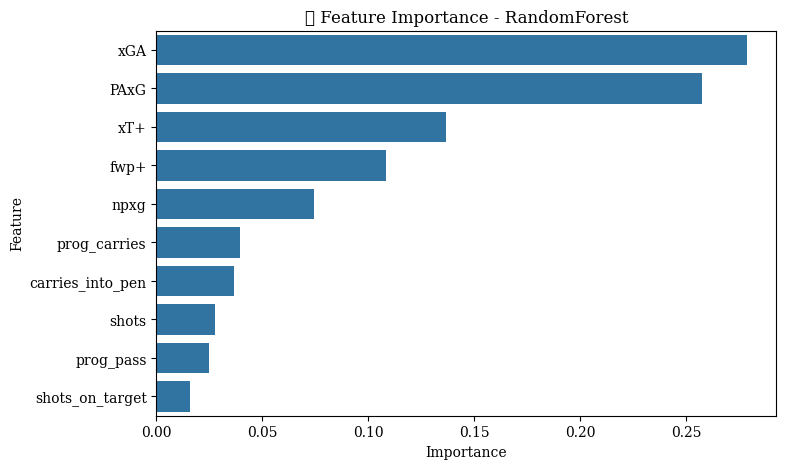

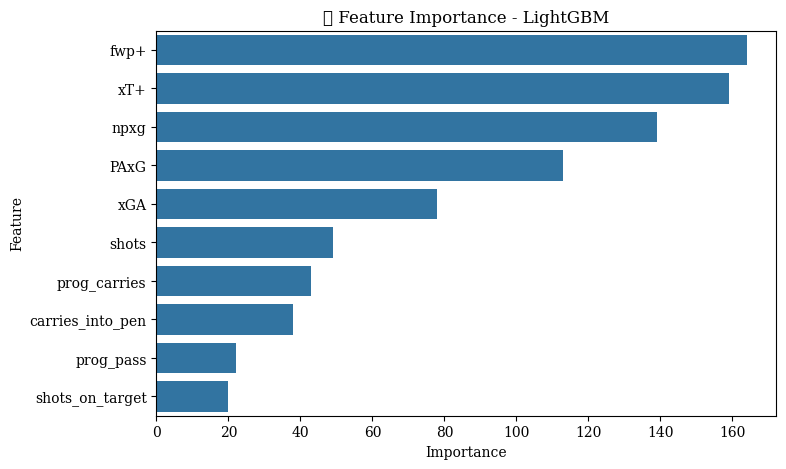

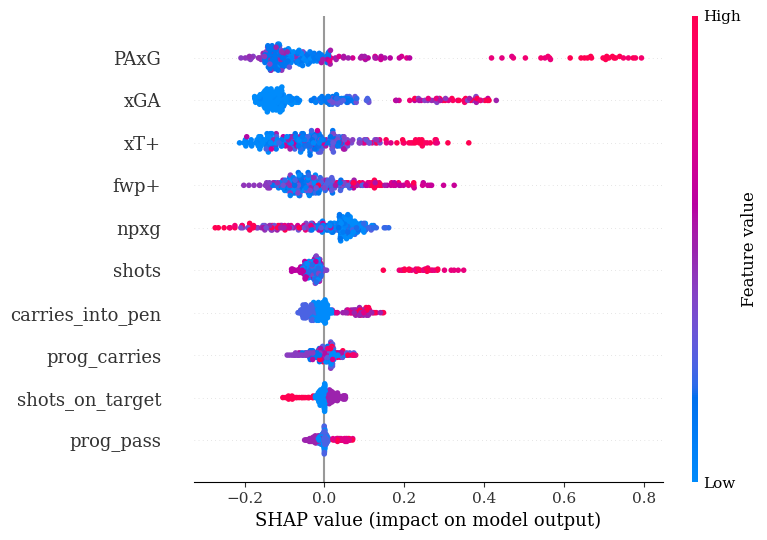

In [4133]:
# 🌳 RandomForestRegressor
rf = RandomForestRegressor(n_estimators=100, random_state=42)
rf.fit(X_train, y_train)

# 🌟 LightGBM Regressor
lgb_model = lgb.LGBMRegressor(n_estimators=100, random_state=42)
lgb_model.fit(X_train, y_train)

# 📊 Ocena modeli
y_pred_rf = rf.predict(X_test)
y_pred_lgb = lgb_model.predict(X_test)

print(f"🎯 R² RandomForest: {r2_score(y_test, y_pred_rf):.2f}")
print(f"🎯 R² LightGBM: {r2_score(y_test, y_pred_lgb):.2f}")

# 📈 Ważność cech dla RandomForest
rf_importance = pd.DataFrame({'Feature': X_train.columns, 'Importance': rf.feature_importances_})
rf_importance = rf_importance.sort_values(by="Importance", ascending=False)

plt.figure(figsize=(8, 5))
sns.barplot(x="Importance", y="Feature", data=rf_importance)
plt.title("🌳 Feature Importance - RandomForest")
plt.show()

# 📈 Ważność cech dla LightGBM
lgb_importance = pd.DataFrame({'Feature': X_train.columns, 'Importance': lgb_model.feature_importances_})
lgb_importance = lgb_importance.sort_values(by="Importance", ascending=False)

plt.figure(figsize=(8, 5))
sns.barplot(x="Importance", y="Feature", data=lgb_importance)
plt.title("⚡ Feature Importance - LightGBM")
plt.show()

# 🧐 SHAP dla LightGBM
explainer = shap.Explainer(lgb_model, X_train)
shap_values = explainer(X_train)

# 📊 SHAP Summary Plot
shap.summary_plot(shap_values, X_train)

In [4141]:
rf_importance['Importance'] = rf_importance['Importance'] / rf_importance['Importance'].sum()
rf_importance.columns=['Feature', 'Random Forest Importance']

In [4139]:
lgb_importance['Importance'] = lgb_importance['Importance'] / lgb_importance['Importance'].sum()
lgb_importance.columns=['Feature', 'LGB Importance']

In [4143]:
rr = rf_importance.merge(lgb_importance, on='Feature')

In [4147]:
rr['Weight'] =( rr['LGB Importance'] + rr['Random Forest Importance'] ) / 2
rr = rr.sort_values(by='Weight', ascending=False)

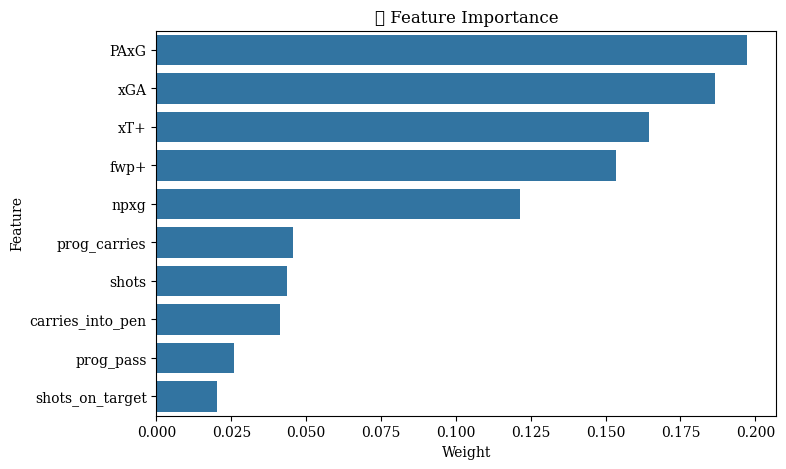

In [4148]:
plt.figure(figsize=(8, 5))
sns.barplot(x="Weight", y="Feature", data=rr)
plt.title("⚡ Feature Importance")
plt.show()

In [4153]:
r.corr()['rating']

PAxG                0.454777
npxg                0.124136
shots_on_target     0.316182
xGA                 0.477636
fwp+                0.299894
carries_into_pen    0.245796
shots               0.306384
xT+                 0.488546
prog_pass           0.288582
prog_carries        0.259276
rating              1.000000
Name: rating, dtype: float64

In [4149]:
from sklearn.linear_model import LinearRegression

RADAR PLOT 

Wizualizacje

xT i fwp

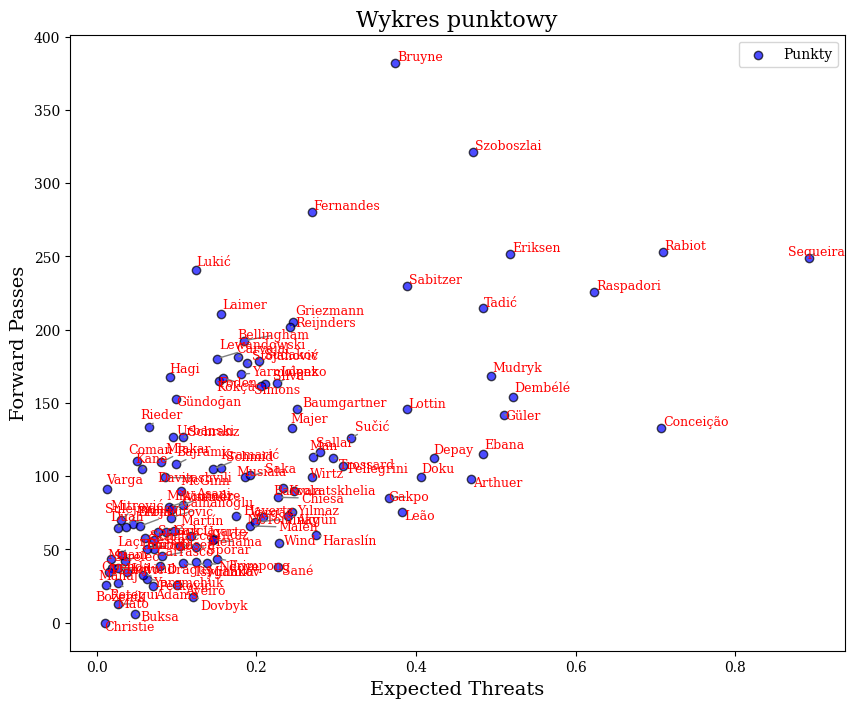

In [3366]:
to_plot = ratings_df_mean
plt.figure(figsize=(10,8))
plt.scatter(to_plot['xT+'], to_plot['fwp+'], color='blue', alpha=0.7, edgecolor='k', label='Punkty')
labels = to_plot['player']
from adjustText import adjust_text

texts = []
for i in range(len(to_plot)):
    texts.append(plt.text(
        to_plot['xT+'].iloc[i],
        to_plot['fwp+'].iloc[i],
        str(labels.iloc[i].split()[-1]),
        fontsize=9,
        color='red'
    ))

# Automatyczna optymalizacja
adjust_text(texts, arrowprops=dict(arrowstyle='->', color='gray'))
plt.title('Wykres punktowy', fontsize=16)
plt.xlabel('Expected Threats', fontsize=14)
plt.ylabel('Forward Passes', fontsize=14)
plt.legend()
plt.show()

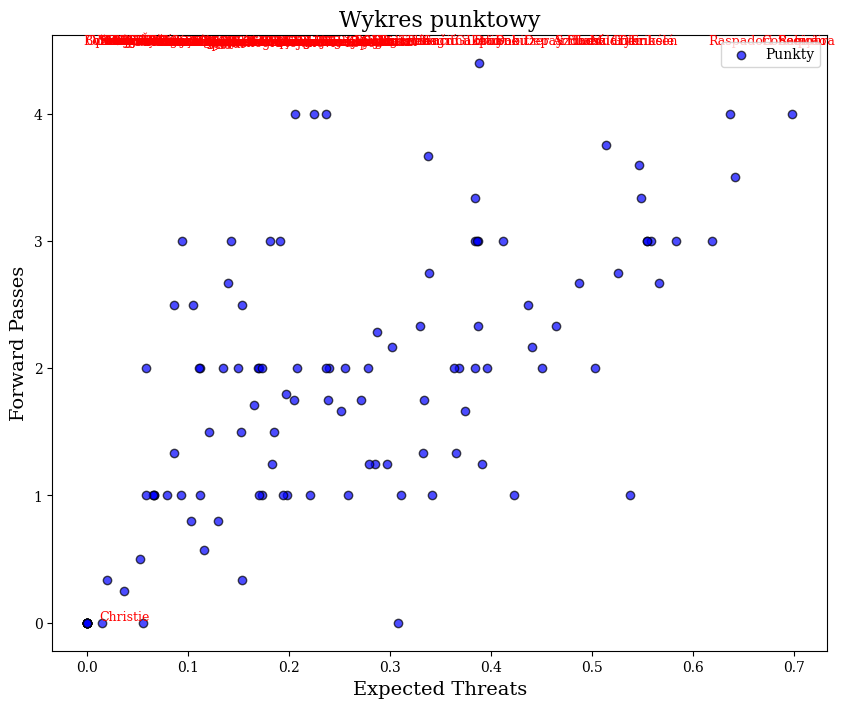

In [3367]:
to_plot = ratings_df_mean
    
plt.figure(figsize=(10,8))
plt.scatter(to_plot['npxg'] + to_plot['xGA'], to_plot['shots'], color='blue', alpha=0.7, edgecolor='k', label='Punkty')
labels = to_plot['player']
from adjustText import adjust_text

texts = []
for i in range(len(to_plot)):
    texts.append(plt.text(
        to_plot['xT+'].iloc[i],
        to_plot['fwp+'].iloc[i],
        str(labels.iloc[i].split()[-1]),
        fontsize=9,
        color='red'
    ))

# Automatyczna optymalizacja
adjust_text(texts, arrowprops=dict(arrowstyle='->', color='gray'))
plt.title('Wykres punktowy', fontsize=16)
plt.xlabel('Expected Threats', fontsize=14)
plt.ylabel('Forward Passes', fontsize=14)
plt.legend()
plt.show()

comps

In [3369]:
sb.matches(competition_id=43, season_id=269)

,match_id,match_date,kick_off,competition,season,home_team,away_team,home_score,away_score,match_status,...,last_updated_360,match_week,competition_stage,stadium,referee,home_managers,away_managers,data_version,shot_fidelity_version,xy_fidelity_version
0,3888705,1958-06-29,17:00:00.000,International - FIFA World Cup,1958,Brazil,Sweden,5,2,available,...,None,7,Final,Friends Arena,Maurice Guigue,Vicente Ítalo Feola,George Raynor,1.1.0,2,2
1,3888704,1958-06-24,21:00:00.000,International - FIFA World Cup,1958,Brazil,France,5,2,available,...,None,6,Semi-finals,Friends Arena,Mervyn Griffiths,Vicente Ítalo Feola,Albert Batteux,1.1.0,2,2


In [3379]:
i=0
for match in matches:
    i += len(match)
print(i/len(matches))

3544.9746922024624


In [4177]:
m1 = free_man_comps.groupby('competition_name').size().reset_index(name='number').sort_values(by='number', ascending=False).set_index('competition_name').reset_index()

In [4178]:
data = []

# Pętla do iteracji przez 'free_man_comps'
for i in range(len(free_man_comps)):
    a = free_man_comps.iloc[i, 0]  # competition_id
    b = free_man_comps.iloc[i, 1]  # season_id
    comp_name = free_man_comps.iloc[i]['competition_name']
    comp_season = free_man_comps.iloc[i]['season_name']
    
    # Liczba wystąpień
    match_count = len(sb.matches(season_id=b, competition_id=a))
    
    # Dodanie danych do listy
    data.append({
        'competition_name': comp_name,
        'match_count': match_count
    })

# Stworzenie ramki danych
result_df = pd.DataFrame(data)

In [4179]:
m = result_df.groupby('competition_name').sum().reset_index()

In [4180]:
m2 = m1.merge(m, on=['competition_name'])
m2.columns = ['Competition', 'Number of Season', 'Number of Matches']

In [4181]:
m2['Percent of Data'] = m2['Number of Matches'] / m2['Number of Matches'].sum()

In [4194]:
m3 = m2.sort_values(by="Percent of Data", ascending=False)

In [4195]:
m3['Percent of Data'] = m3['Percent of Data'].round(4)*100

In [4535]:
m3.to_excel("comps.xlsx")

In [3407]:
3544.9746922024624/100

35.44974692202462

In [3408]:
events_list = []
for match in matches:
    events = match.groupby(['player', 'team', 'match_id']).size().reset_index(name='Events')
    events_list.append(events)

events_df = pd.concat(events_list, ignore_index=True)

In [3412]:
events_df

,player,team,match_id,Events
0,Alexis Mac Allister,Argentina,3943077,196
1,Andrés Mateus Uribe Villa,Colombia,3943077,34
2,Camilo Andrés Vargas Gil,Colombia,3943077,108
3,Carlos Eccehomo Cuesta Figueroa,Colombia,3943077,182
4,Cristian Gabriel Romero,Argentina,3943077,118
...,...,...,...,...
82386,Raymond Kopaszewski Wlodarczyck,France,3888704,222
82387,Robert Jonquet,France,3888704,72
82388,Roger Piantoni,France,3888704,163
82389,Waldyr Pereira,Brazil,3888704,272


Badanie wpływu zmiennych na końcowy rezultat meczu

In [3417]:
data_model_corr

,player,team,match_id,position,Events,minute,goals,assist,PAxG,xGA,...,dribbles,basic_duels_won,basic_duels_lost,basic_duels,won_aerial_all,lost_aerial_all,aerial,duels,defensive_won,defensive_lost
0,Aaron Cresswell,West Ham United,3753973,Left Back,110,90.0,0.0,0.0,-0.088625,0.000000,...,1.0,0.0,0.0,0.0,2.0,1.0,3.0,3.0,8.0,2.0
1,Aaron Cresswell,West Ham United,3753984,Left Back,101,90.0,0.0,1.0,0.607445,0.219274,...,1.0,0.0,0.0,0.0,1.0,1.0,2.0,2.0,9.0,0.0
2,Aaron Cresswell,West Ham United,3753997,Left Back,267,90.0,0.0,0.0,-0.051703,0.108012,...,1.0,0.0,0.0,0.0,0.0,2.0,2.0,2.0,8.0,2.0
3,Aaron Cresswell,West Ham United,3754021,Left Back,126,90.0,0.0,0.0,0.000000,0.000000,...,3.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,5.0,0.0
4,Aaron Cresswell,West Ham United,3754067,Left Back,197,90.0,0.0,0.0,-0.051984,0.019499,...,1.0,1.0,0.0,1.0,1.0,0.0,1.0,2.0,10.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
60726,Žan Karničnik,Slovenia,3941020,Right Back,108,90.0,0.0,0.0,0.000000,0.000000,...,0.0,3.0,1.0,4.0,0.0,0.0,0.0,4.0,13.0,2.0
60727,Željko Brkić,Carpi,3878545,Goalkeeper,65,90.0,0.0,0.0,0.000000,0.000000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,9.0,0.0
60728,Željko Brkić,Carpi,3878552,Goalkeeper,49,90.0,0.0,0.0,0.000000,0.000000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,0.0
60729,Željko Brkić,Carpi,3879539,Goalkeeper,54,62.0,0.0,0.0,0.000000,0.000000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,0.0


In [3421]:
data_model_corr6_scaled

,result,PAxG_diff,xGA_diff,xT+_diff,shots_on_target_diff,prog_carries_diff,prog_pass_diff,carries_into_pen_diff,driblle_complete_diff,good_passes_diff,...,basic_duels_won_diff,basic_duels_lost_diff,basic_duels_diff,won_aerial_all_diff,lost_aerial_all_diff,aerial_diff,duels_diff,defensive_won_diff,defensive_lost_diff,prog_diff
0,1,2.033516,0.869404,0.528379,1.638607,0.079272,1.277354,1.534640,0.440510,-0.874735,...,-0.000000,-0.000000,-0.000000,1.812919,-1.899198,0.173109,0.102474,-0.211131,-0.246483,0.879745
1,-1,-2.033516,-0.869404,-0.528379,-1.638607,-0.079272,-1.277354,-1.534640,-0.440510,0.874735,...,0.000000,0.000000,0.000000,-1.812919,1.899198,-0.173109,-0.102474,0.211131,0.246483,-0.879745
2,1,-0.484094,0.028174,0.467224,-0.273101,0.237816,0.666445,-0.219234,-1.027857,0.157879,...,0.595412,0.233667,0.553493,0.388483,-0.438276,-0.000000,0.409895,-0.369479,-0.369724,0.549841
3,-1,0.484094,-0.028174,-0.467224,0.273101,-0.237816,-0.666445,0.219234,1.027857,-0.157879,...,-0.595412,-0.233667,-0.553493,-0.388483,0.438276,0.000000,-0.409895,0.369479,0.369724,-0.549841
4,0,-0.268122,-0.505868,-0.630304,-0.546202,-0.396360,-1.110742,-0.657703,-1.027857,-0.384030,...,1.587764,2.103000,2.352345,-0.129494,0.438276,0.346218,1.947002,1.214002,-0.123241,-0.916401
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5843,1,0.526376,1.694560,0.861878,0.546202,0.475632,0.999668,0.876937,-0.146837,0.908871,...,-0.793882,-1.402000,-1.383732,0.000000,-0.292184,-0.346218,-1.229685,-0.633392,0.862689,0.879745
5844,0,0.628665,1.149651,1.047789,0.546202,0.554904,0.388760,-0.219234,0.440510,0.157879,...,1.389294,0.701000,1.383732,0.517977,0.292184,1.038653,1.639580,1.372350,0.123241,0.513184
5845,0,-0.628665,-1.149651,-1.047789,-0.546202,-0.554904,-0.388760,0.219234,-0.440510,-0.157879,...,-1.389294,-0.701000,-1.383732,-0.517977,-0.292184,-1.038653,-1.639580,-1.372350,-0.123241,-0.513184
5846,0,-0.562056,0.001168,-0.544687,-0.546202,-0.000000,-0.721983,0.876937,0.146837,-0.247486,...,-0.595412,-0.467333,-0.691866,-0.258988,-0.584369,-1.038653,-1.127212,-1.002871,-0.123241,-0.476528


Korelacja

In [3422]:
correlations = data_model_corr6_scaled.corr()['result'].sort_values(ascending=False)
correlations

result                        1.000000
PAxG_diff                     0.738348
shots_on_target_diff          0.600909
npxg_diff                     0.556881
xGA_diff                      0.526532
carries_into_pen_diff         0.439317
shots_diff                    0.371920
prog_carries_diff             0.349605
xT+_diff                      0.345724
fwp+_diff                     0.335241
xT_diff                       0.318434
good_passes_diff              0.300246
passes_diff                   0.299974
dribbles_diff                 0.294432
driblle_complete_diff         0.287865
prog_diff                     0.287419
aerial_diff                   0.241628
defensive_won_diff            0.208090
prog_pass_diff                0.190535
driblle_failed_diff           0.182601
duels_diff                    0.163696
aerial_wons_count_diff        0.154260
recovery_diff                 0.153232
clearance_diff                0.142315
won_aerial_all_diff           0.140245
defensive_lost_diff      

In [ ]:
for column in data_model_corr6_scaled.drop(columns=['result']).columns:
    plt.figure(figsize=(6, 4))
    sns.scatterplot(x=data_model_corr6_scaled[column], y=data_model_corr6_scaled['result'])
    plt.title(f'Wykres rozrzutu: {column} vs result')
    plt.show()

In [4239]:
data_model_corr6

,result,PAxG_diff,xGA_diff,xT+_diff,shots_on_target_diff,prog_carries_diff,prog_pass_diff,carries_into_pen_diff,driblle_complete_diff,good_passes_diff,...,basic_duels_won_diff,basic_duels_lost_diff,basic_duels_diff,won_aerial_all_diff,lost_aerial_all_diff,aerial_diff,duels_diff,defensive_won_diff,defensive_lost_diff,prog_diff
0,1,4.973072,0.720601,0.648,6.0,1.0,23.0,7.0,3.0,-205.0,...,-0.0,-0.0,-0.0,14.0,-13.0,1.0,1.0,-4.0,-2.0,24.0
1,-1,-4.973072,-0.720601,-0.648,-6.0,-1.0,-23.0,-7.0,-3.0,205.0,...,0.0,0.0,0.0,-14.0,13.0,-1.0,-1.0,4.0,2.0,-24.0
2,1,-1.183878,0.023352,0.573,-1.0,3.0,12.0,-1.0,-7.0,37.0,...,3.0,1.0,4.0,3.0,-3.0,-0.0,4.0,-7.0,-3.0,15.0
3,-1,1.183878,-0.023352,-0.573,1.0,-3.0,-12.0,1.0,7.0,-37.0,...,-3.0,-1.0,-4.0,-3.0,3.0,0.0,-4.0,7.0,3.0,-15.0
4,0,-0.655705,-0.419286,-0.773,-2.0,-5.0,-20.0,-3.0,-7.0,-90.0,...,8.0,9.0,17.0,-1.0,3.0,2.0,19.0,23.0,-1.0,-25.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5843,1,1.287280,1.404527,1.057,2.0,6.0,18.0,4.0,-1.0,213.0,...,-4.0,-6.0,-10.0,0.0,-2.0,-2.0,-12.0,-12.0,7.0,24.0
5844,0,1.537433,0.952882,1.285,2.0,7.0,7.0,-1.0,3.0,37.0,...,7.0,3.0,10.0,4.0,2.0,6.0,16.0,26.0,1.0,14.0
5845,0,-1.537433,-0.952882,-1.285,-2.0,-7.0,-7.0,1.0,-3.0,-37.0,...,-7.0,-3.0,-10.0,-4.0,-2.0,-6.0,-16.0,-26.0,-1.0,-14.0
5846,0,-1.374538,0.000968,-0.668,-2.0,-0.0,-13.0,4.0,1.0,-58.0,...,-3.0,-2.0,-5.0,-2.0,-4.0,-6.0,-11.0,-19.0,-1.0,-13.0


In [3438]:
pearson_corr = data_model_corr6_scaled.corr(method='pearson')['result']
spearman_corr = data_model_corr6_scaled.corr(method='spearman')['result']

In [ ]:
correlation_comparison = pd.DataFrame({'Pearson': pearson_corr, 'Spearman': spearman_corr})

                             Pearson  Spearman
result                      1.000000  1.000000
PAxG_diff                   0.738348  0.769661
xGA_diff                    0.526532  0.535958
xT+_diff                    0.345724  0.350102
shots_on_target_diff        0.600909  0.616135
prog_carries_diff           0.349605  0.357488
prog_pass_diff              0.190535  0.189441
carries_into_pen_diff       0.439317  0.449040
driblle_complete_diff       0.287865  0.281759
good_passes_diff            0.300246  0.282987
driblle_failed_diff         0.182601  0.178141
bad_passes_diff             0.045859  0.047684
interception_diff          -0.017046 -0.021035
recovery_diff               0.153232  0.151778
clearance_diff              0.142315  0.125907
error_diff                 -0.110140 -0.111365
dispossessed_diff           0.115053  0.111968
miscontrol_diff             0.095639  0.088397
shots_diff                  0.371920  0.375347
npxg_diff                   0.556881  0.566939
tackle_diff  

In [4540]:
correlation_comparison.sort_values(by='Pearson', ascending=False).to_excel('corr.xlsx')

C:\Users\macie\AppData\Local\Temp\ipykernel_30508\3825807416.py:6: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = cm.get_cmap("coolwarm")


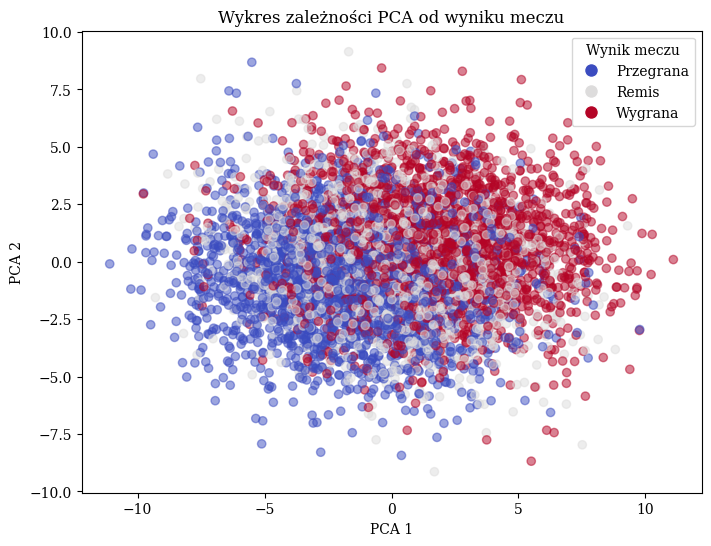

In [4484]:
import matplotlib.cm as cm
import matplotlib.colors as mcolors
pca = PCA(n_components=2)
X_pca = pca.fit_transform(X_scaled)

cmap = cm.get_cmap("coolwarm")
norm = mcolors.Normalize(vmin=-1, vmax=1)
colors = [cmap(norm(value)) for value in y]

# Tworzenie wykresu
plt.figure(figsize=(8, 6))
scatter = plt.scatter(X_pca[:, 0], X_pca[:, 1], c=colors, alpha=0.5)

# Tworzenie legendy
legend_labels = {-1: "Przegrana", 0: "Remis", 1: "Wygrana"}
legend_colors = [cmap(norm(value)) for value in legend_labels.keys()]
legend_patches = [plt.Line2D([0], [0], marker='o', color='w', markerfacecolor=legend_colors[i], markersize=10, label=label) 
                  for i, label in enumerate(legend_labels.values())]

plt.xlabel("PCA 1")
plt.ylabel("PCA 2")
plt.title("Wykres zależności PCA od wyniku meczu")
plt.legend(handles=legend_patches, title="Wynik meczu")
plt.show()

Logistic Regression Accuracy: 0.5700854700854701
Random Forest Accuracy: 0.49743589743589745

Classification Report - Logistic Regression:
              precision    recall  f1-score   support

          -1       0.55      0.77      0.64       432
           0       0.00      0.00      0.00       279
           1       0.59      0.73      0.65       459

    accuracy                           0.57      1170
   macro avg       0.38      0.50      0.43      1170
weighted avg       0.44      0.57      0.49      1170


Classification Report - Random Forest:
              precision    recall  f1-score   support

          -1       0.55      0.63      0.59       432
           0       0.23      0.19      0.21       279
           1       0.58      0.56      0.57       459

    accuracy                           0.50      1170
   macro avg       0.45      0.46      0.45      1170
weighted avg       0.48      0.50      0.49      1170



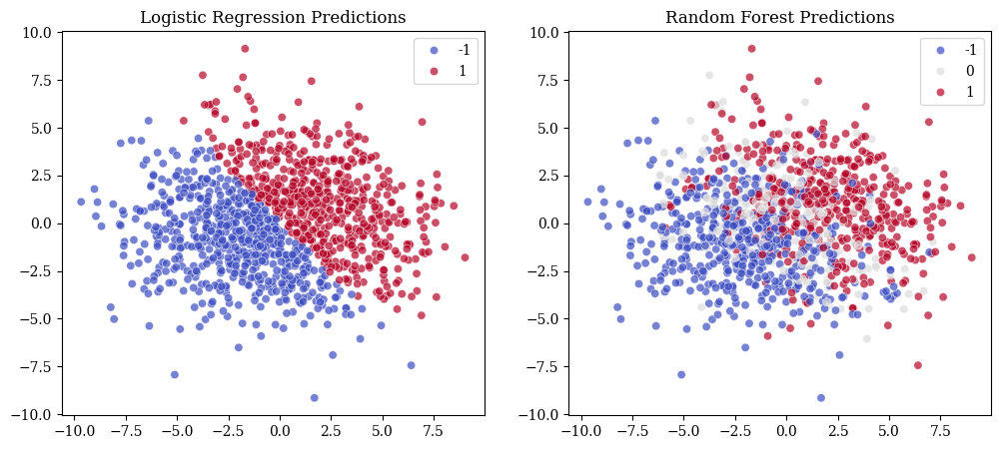

In [4474]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score, classification_report
df = data_model_corr6
# 1. Wczytanie danych (zakładam, że masz już DataFrame 'df')
X = df.drop(columns=["result"])  # Cechy
y = df["result"]  # Wynik meczu (-1, 0, 1)

# 2. Normalizacja danych
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# 3. Redukcja wymiarowości PCA
pca = PCA(n_components=2)
X_pca = pca.fit_transform(X_scaled)

# 4. Podział na zbiór treningowy i testowy
X_train, X_test, y_train, y_test = train_test_split(X_pca, y, test_size=0.2, random_state=42)

# 5. Trenowanie modeli
# - Regresja logistyczna
log_reg_poly = LogisticRegression(multi_class="multinomial", solver="newton-cg")
log_reg_poly.fit(X_train, y_train)
y_pred_logreg_poly = log_reg_poly.predict(X_test)
# - Random Forest
rf = RandomForestClassifier(n_estimators=100, random_state=42)
rf.fit(X_train, y_train)
y_pred_rf = rf.predict(X_test)

# 6. Ocena modeli
print("Logistic Regression Accuracy:", accuracy_score(y_test, y_pred_logreg_poly))
print("Random Forest Accuracy:", accuracy_score(y_test, y_pred_rf))

print("\nClassification Report - Logistic Regression:")
print(classification_report(y_test, y_pred_logreg_poly))

print("\nClassification Report - Random Forest:")
print(classification_report(y_test, y_pred_rf))

# 7. Wizualizacja decyzji modelu
plt.figure(figsize=(12, 5))

# Logistic Regression decision boundary
plt.subplot(1, 2, 1)
sns.scatterplot(x=X_test[:, 0], y=X_test[:, 1], hue=y_pred_logreg_poly, palette="coolwarm", alpha=0.7)
plt.title("Logistic Regression Predictions")

# Random Forest decision boundary
plt.subplot(1, 2, 2)
sns.scatterplot(x=X_test[:, 0], y=X_test[:, 1], hue=y_pred_rf, palette="coolwarm", alpha=0.7)
plt.title("Random Forest Predictions")

plt.show()


In [4263]:
data_model_corr6

,result,PAxG_diff,xGA_diff,xT+_diff,shots_on_target_diff,prog_carries_diff,prog_pass_diff,carries_into_pen_diff,driblle_complete_diff,good_passes_diff,...,basic_duels_won_diff,basic_duels_lost_diff,basic_duels_diff,won_aerial_all_diff,lost_aerial_all_diff,aerial_diff,duels_diff,defensive_won_diff,defensive_lost_diff,prog_diff
0,1,4.973072,0.720601,0.648,6.0,1.0,23.0,7.0,3.0,-205.0,...,-0.0,-0.0,-0.0,14.0,-13.0,1.0,1.0,-4.0,-2.0,24.0
1,-1,-4.973072,-0.720601,-0.648,-6.0,-1.0,-23.0,-7.0,-3.0,205.0,...,0.0,0.0,0.0,-14.0,13.0,-1.0,-1.0,4.0,2.0,-24.0
2,1,-1.183878,0.023352,0.573,-1.0,3.0,12.0,-1.0,-7.0,37.0,...,3.0,1.0,4.0,3.0,-3.0,-0.0,4.0,-7.0,-3.0,15.0
3,-1,1.183878,-0.023352,-0.573,1.0,-3.0,-12.0,1.0,7.0,-37.0,...,-3.0,-1.0,-4.0,-3.0,3.0,0.0,-4.0,7.0,3.0,-15.0
4,0,-0.655705,-0.419286,-0.773,-2.0,-5.0,-20.0,-3.0,-7.0,-90.0,...,8.0,9.0,17.0,-1.0,3.0,2.0,19.0,23.0,-1.0,-25.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5843,1,1.287280,1.404527,1.057,2.0,6.0,18.0,4.0,-1.0,213.0,...,-4.0,-6.0,-10.0,0.0,-2.0,-2.0,-12.0,-12.0,7.0,24.0
5844,0,1.537433,0.952882,1.285,2.0,7.0,7.0,-1.0,3.0,37.0,...,7.0,3.0,10.0,4.0,2.0,6.0,16.0,26.0,1.0,14.0
5845,0,-1.537433,-0.952882,-1.285,-2.0,-7.0,-7.0,1.0,-3.0,-37.0,...,-7.0,-3.0,-10.0,-4.0,-2.0,-6.0,-16.0,-26.0,-1.0,-14.0
5846,0,-1.374538,0.000968,-0.668,-2.0,-0.0,-13.0,4.0,1.0,-58.0,...,-3.0,-2.0,-5.0,-2.0,-4.0,-6.0,-11.0,-19.0,-1.0,-13.0


In [ ]:
# Lista wybranych cech do wizualizacji
df = data_model_corr6_scaled
features = ["npxg_diff", "xga_diff", "passes_accuracy_diff", "xT_diff", "prog_passes_diff"]

# Violin Plot
for feature in data_model_corr6_scaled.columns[1:]:
    plt.figure(figsize=(6, 4))
    sns.violinplot(x=df["result"], y=df[feature], palette="coolwarm")
    plt.xlabel("Wynik meczu (team_result_numeric)")
    plt.ylabel(feature)
    plt.title(f"Violin Plot dla {feature}")
    plt.show()

# Swarm Plot (rozrzut punktów wzdłuż osi)
for feature in data_model_corr6_scaled.columns[1:]:
    plt.figure(figsize=(6, 4))
    sns.swarmplot(x=df["result"], y=df[feature], palette="coolwarm", alpha=0.7)
    plt.xlabel("Wynik meczu (team_result_numeric)")
    plt.ylabel(feature)
    plt.title(f"Swarm Plot dla {feature}")
    plt.show()


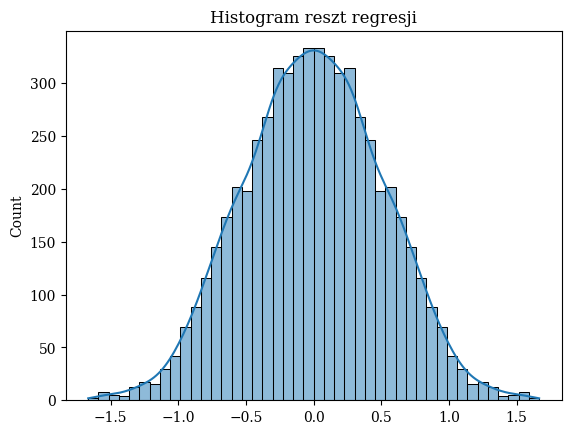

In [4240]:
X = data_model_corr6_scaled.drop(columns=['result'])
y = data_model_corr6_scaled['result']

X = sm.add_constant(X)  # Dodajemy stałą do modelu
model = sm.OLS(y, X).fit()
residuals = model.resid

sns.histplot(residuals, kde=True)
plt.title("Histogram reszt regresji")
plt.show()

In [4238]:
X

,PAxG,npxg,shots_on_target,xGA,fwp+,carries_into_pen,shots,xT+,prog_pass,prog_carries
226,-0.637517,-0.867447,-0.797186,-0.600716,0.125838,-0.060689,-1.242667,-0.675281,0.330249,0.152221
36,0.658789,2.468495,1.602344,0.030689,-0.748303,-0.060689,0.695378,0.634553,-0.341406,-1.032743
24,0.205520,1.180001,0.402579,-0.600716,-0.847284,-0.060689,-0.596652,-0.813428,-1.013060,-0.637755
61,-0.956986,0.068711,-0.797186,-0.600716,-0.183337,-0.763286,0.049363,-1.002740,-1.013060,-0.637755
43,0.201865,2.193296,1.602344,-0.462536,0.191454,1.344503,0.049363,0.394075,-0.341406,2.127161
...,...,...,...,...,...,...,...,...,...,...
104,2.790907,1.214880,2.802109,1.648110,2.188856,-0.060689,1.987408,0.793166,0.330249,0.942197
25,1.320071,1.285620,0.402579,2.203305,1.920830,-0.763286,1.987408,4.855698,-0.341406,-0.637755
161,2.741362,0.460659,1.602344,0.598492,-0.125505,1.344503,1.987408,1.586229,0.330249,1.337185
230,2.278501,0.946169,1.602344,2.053772,-0.161094,1.344503,1.987408,2.026251,1.001903,0.942197


Regresja logistyczna

In [4251]:
X = data_model_corr6_scaled.drop(columns='result')
y = data_model_corr6_scaled['result']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [4252]:
model_lr = LogisticRegression(multi_class='multinomial', solver='lbfgs', max_iter=1000)
model_lr.fit(X_train, y_train)

LogisticRegression(max_iter=1000, multi_class='multinomial')

In [4253]:
y_pred = model_lr.predict(X_test)
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

          -1       0.85      0.88      0.86       432
           0       0.58      0.59      0.58       279
           1       0.86      0.82      0.84       459

    accuracy                           0.79      1170
   macro avg       0.76      0.76      0.76      1170
weighted avg       0.79      0.79      0.79      1170



In [3428]:
coefficients = model_lr.coef_
feature_importance = pd.DataFrame(coefficients.T, index=X.columns, columns=['Lose (-1)', 'Draw (0)', 'Win (1)'])
feature_importance_sorted = feature_importance.sort_values(by='Win (1)', ascending=False)
print(feature_importance_sorted)

                            Lose (-1)  Draw (0)   Win (1)
PAxG_diff                   -3.472563 -0.037832  3.510395
npxg_diff                   -1.920915 -0.007859  1.928775
fwp+_diff                   -0.380402  0.004662  0.375741
carries_into_pen_diff       -0.303072  0.005771  0.297301
clearance_diff              -0.250690 -0.036798  0.287488
xT+_diff                    -0.326951  0.059774  0.267177
prog_carries_diff           -0.217651 -0.010463  0.228113
xT_diff                     -0.032397 -0.083155  0.115553
miscontrol_aerial_won_diff  -0.074021 -0.003716  0.077737
fwp_diff                    -0.070384  0.002170  0.068214
duels_won_diff              -0.050244 -0.011399  0.061643
basic_duels_won_diff        -0.047432 -0.011493  0.058925
defensive_won_diff          -0.039107 -0.008491  0.047598
dispossessed_diff           -0.049435  0.005154  0.044280
basic_duels_diff            -0.026380 -0.011068  0.037448
driblle_failed_diff         -0.033672  0.000391  0.033281
aerial_wons_co

In [3431]:
overall_importance = np.abs(model_lr.coef_).mean(axis=0)

# Tworzymy ramkę danych z nazwami cech
feature_importance_overall = pd.DataFrame(overall_importance, index=X.columns, columns=['Overall Importance'])

# Sortujemy od najważniejszych cech
feature_importance_sorted = feature_importance_overall.sort_values(by='Overall Importance', ascending=False)
feature_importance_sorted

,Overall Importance
PAxG_diff,2.340263
npxg_diff,1.285850
shots_on_target_diff,1.060918
shots_diff,0.336201
prog_pass_diff,0.265806
fwp+_diff,0.253602
xT+_diff,0.217968
carries_into_pen_diff,0.202048
clearance_diff,0.191659
prog_carries_diff,0.152076


Random Forest

In [4254]:
rf = RandomForestClassifier(n_estimators=100, random_state=42)
rf.fit(X_train, y_train)
y_pred_rf = rf.predict(X_test)

# Ważność cech
importances = pd.Series(rf.feature_importances_, index=X.columns)
importances.sort_values(ascending=False)

PAxG_diff                     0.213399
npxg_diff                     0.073560
shots_on_target_diff          0.061151
xGA_diff                      0.055294
clearance_diff                0.034796
fwp+_diff                     0.025392
shots_diff                    0.021985
carries_into_pen_diff         0.021000
fwp_diff                      0.020876
xT_diff                       0.020693
xT+_diff                      0.020218
defensive_won_diff            0.019808
prog_carries_diff             0.019758
passes_diff                   0.018446
prog_pass_diff                0.017683
good_passes_diff              0.017581
recovery_diff                 0.017412
driblle_complete_diff         0.017290
bad_passes_diff               0.016719
dribbles_diff                 0.016581
prog_diff                     0.016558
aerial_diff                   0.015616
interception_diff             0.014791
defensive_lost_diff           0.014427
duels_diff                    0.014266
won_aerial_all_diff      

In [4255]:
print(classification_report(y_test, y_pred_rf))

              precision    recall  f1-score   support

          -1       0.80      0.85      0.82       432
           0       0.50      0.47      0.48       279
           1       0.82      0.80      0.81       459

    accuracy                           0.74      1170
   macro avg       0.71      0.71      0.70      1170
weighted avg       0.74      0.74      0.74      1170



czemu taka przewaga

In [3464]:
data9

,player,team,match_id,position,Events,minute,goals,assist,PAxG,xGA,xT+,shots_on_target,prog_carries,prog_pass,carries_into_pen,driblle_complete,good_passes
0,Aaron Cresswell,West Ham United,3753973,Left Back,110,90.0,0.0,0.0,-0.088625,0.000000,0.066,0.0,0.0,6.0,0.0,0.0,22.0
1,Aaron Cresswell,West Ham United,3753984,Left Back,101,90.0,0.0,1.0,0.607445,0.219274,0.175,1.0,3.0,0.0,2.0,1.0,22.0
2,Aaron Cresswell,West Ham United,3753997,Left Back,267,90.0,0.0,0.0,-0.051703,0.108012,0.574,0.0,2.0,9.0,0.0,1.0,76.0
3,Aaron Cresswell,West Ham United,3754021,Left Back,126,90.0,0.0,0.0,0.000000,0.000000,0.123,0.0,0.0,5.0,0.0,1.0,31.0
4,Aaron Cresswell,West Ham United,3754067,Left Back,197,90.0,0.0,0.0,-0.051984,0.019499,0.187,0.0,4.0,5.0,0.0,1.0,57.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
60726,Žan Karničnik,Slovenia,3941020,Right Back,108,90.0,0.0,0.0,0.000000,0.000000,0.038,0.0,1.0,3.0,0.0,0.0,24.0
60727,Željko Brkić,Carpi,3878545,Goalkeeper,65,90.0,0.0,0.0,0.000000,0.000000,0.010,0.0,0.0,2.0,0.0,0.0,13.0
60728,Željko Brkić,Carpi,3878552,Goalkeeper,49,90.0,0.0,0.0,0.000000,0.000000,0.005,0.0,0.0,1.0,0.0,0.0,12.0
60729,Željko Brkić,Carpi,3879539,Goalkeeper,54,62.0,0.0,0.0,0.000000,0.000000,0.003,0.0,0.0,1.0,0.0,0.0,13.0


co ma wpływ

In [3470]:
stats = ['PAxG', 'npxg', 'xGA', 'xT+', 'shots_on_target', 'prog_carries',
         'prog_pass', 'carries_into_pen', 'fwp+', 'shots']

In [3546]:
pos_normal = data_model.groupby('position')[['PAxG', 'npxg', 'xGA', 'xT+', 'shots_on_target', 
                                         'prog_carries', 'prog_pass', 
                                         'carries_into_pen', 'fwp+', 'shots'
                                         ]].mean().reset_index()

In [3547]:
pos_normal[pos_normal['position'].isin(['Left Wing', 'Right Wing'])].iloc[:,:12]

,position,PAxG,npxg,xGA,xT+,shots_on_target,prog_carries,prog_pass,carries_into_pen,fwp+,shots
13,Left Wing,0.451960,0.196597,0.136735,0.275328,0.794655,3.709405,2.484438,1.219553,161.728742,2.067321
22,Right Wing,0.428944,0.198545,0.139026,0.275331,0.762847,3.380208,2.820833,1.055903,175.767326,1.962500


C:\Users\macie\AppData\Local\Temp\ipykernel_30508\2090895532.py:10: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=df, x='position', y='total_percentage', palette='viridis')


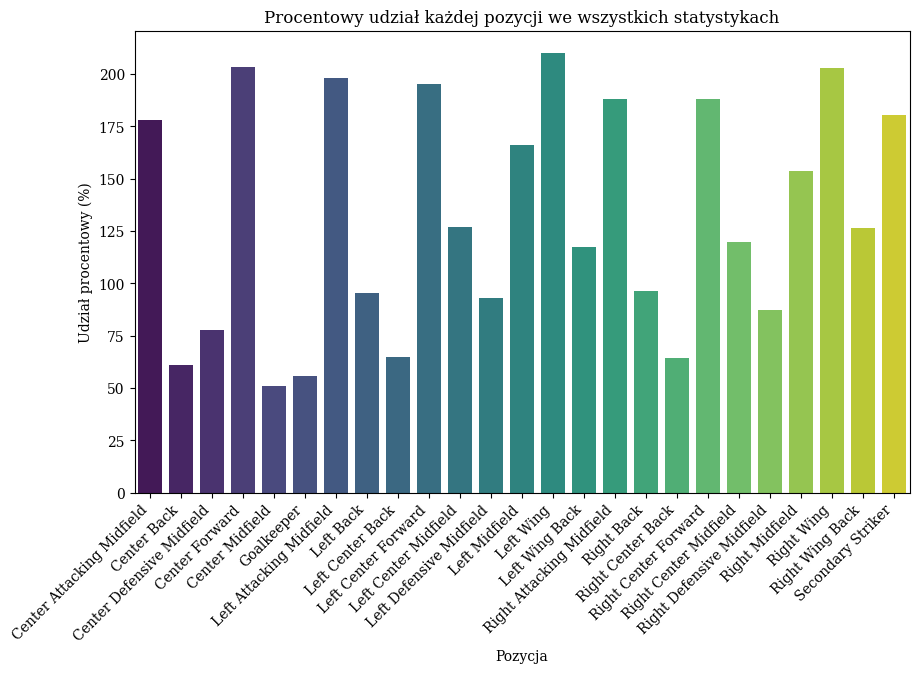

In [4485]:
df = pos_normal
for col in df.columns[1:]:  # Pomijamy kolumnę 'position'
    df[col + '_percentage'] = (df[col] / df[col].sum()) * 100

# Suma procentowych udziałów dla każdej pozycji
df['total_percentage'] = df.filter(like='_percentage').sum(axis=1)

# Wizualizacja
plt.figure(figsize=(10, 6))
sns.barplot(data=df, x='position', y='total_percentage', palette='viridis')
plt.xticks(rotation=45, ha='right')
plt.title('Procentowy udział każdej pozycji we wszystkich statystykach')
plt.xlabel('Pozycja')
plt.ylabel('Udział procentowy (%)')
plt.show()

In [4486]:
df['total_percentage%'] = (df['total_percentage'] / df['total_percentage'].sum()) * 100
df = df.sort_values(by='total_percentage%')

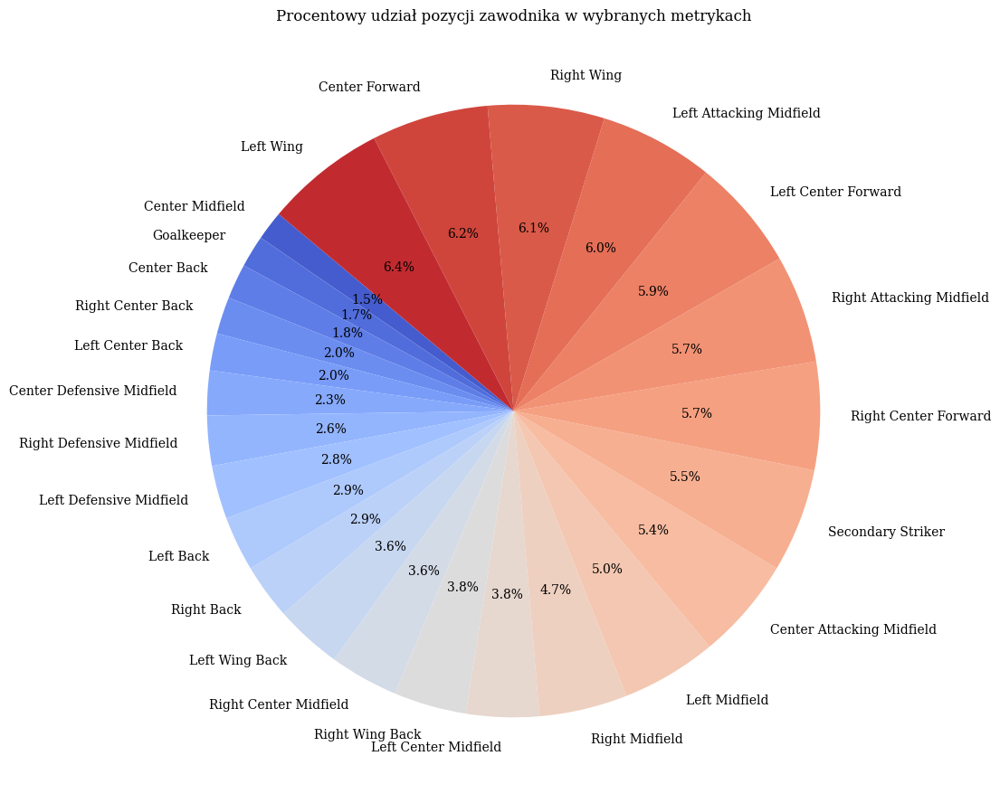

In [4488]:
# Wykres kołowy dla ostatniej kolumny 'total_percentage'
plt.figure(figsize=(11, 11))
plt.pie(df['total_percentage%'], 
        labels=df['position'], 
        autopct='%1.1f%%', 
        startangle=140, 
        colors=sns.color_palette('coolwarm', len(df)))
plt.title('Procentowy udział pozycji zawodnika w wybranych metrykach')
plt.show()


In [3487]:
df['position'].unique()

array(['Center Back', 'Center Midfield', 'Right Center Back',
       'Left Center Back', 'Center Defensive Midfield', 'Goalkeeper',
       'Right Back', 'Right Defensive Midfield', 'Left Back',
       'Left Defensive Midfield', 'Right Center Midfield',
       'Left Center Midfield', 'Right Wing Back', 'Left Wing Back',
       'Right Midfield', 'Left Midfield', 'Center Attacking Midfield',
       'Right Attacking Midfield', 'Left Attacking Midfield',
       'Right Wing', 'Left Wing', 'Right Center Forward',
       'Secondary Striker', 'Left Center Forward', 'Center Forward'],
      dtype=object)

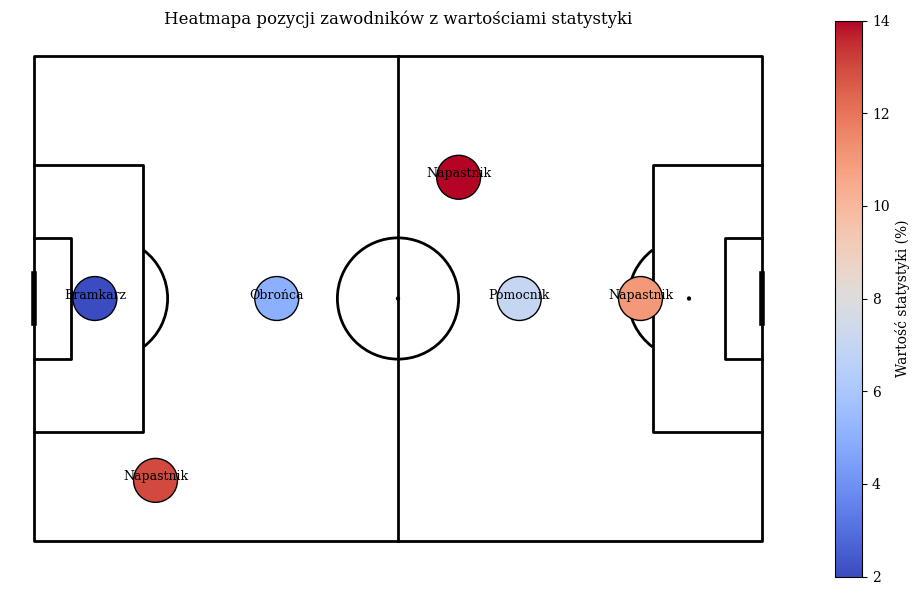

In [3512]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from mplsoccer import Pitch

# Przykładowe dane z pozycjami i procentową statystyką (tutaj wartości losowe)
data = pd.DataFrame({
    'x': [10, 40, 80, 100, 20, 70],  # Pozycje x (boisko 105m)
    'y': [40, 40, 40, 40, 70, 20],   # Pozycje y (boisko 68m)
    'role': ['Bramkarz', 'Obrońca', 'Pomocnik', 'Napastnik', 'Napastnik', 'Napastnik'],
    'value': [2, 5, 7, 11, 13, 14]  # Procentowe wartości statystyki
})

# Tworzenie boiska
pitch = Pitch(pitch_type='statsbomb', pitch_color='white', line_color='black')
fig, ax = pitch.draw(figsize=(10, 6))

# Rysowanie heatmapy z wartościami statystyki przy użyciu KDE


# Dodanie punktów z kolorami
scatter = ax.scatter(data['x'], data['y'], c=data['value'], cmap='coolwarm', edgecolors='black', s=1000, label=data['role'])

# Dodanie paska kolorów
cbar = plt.colorbar(scatter, ax=ax)
cbar.set_label('Wartość statystyki (%)')

# Opcjonalnie: Możesz dodać etykiety pozycji na boisku (np. nazwiska)
for i, row in data.iterrows():
    ax.text(row['x'], row['y'], row['role'], fontsize=9, ha='center', color='black')

plt.title('Heatmapa pozycji zawodników z wartościami statystyki')
plt.show()


pca

In [3515]:
pos_normal_scaled = pos_normal.copy()
pos_normal_scaled.iloc[:, 1:] = scaler.fit_transform(pos_normal.iloc[:,1:])
pos_normal_scaled

,position,PAxG,npxg,xGA,xT+,shots_on_target,prog_carries,prog_pass,carries_into_pen,fwp+,...,xGA_percentage,xT+_percentage,shots_on_target_percentage,prog_carries_percentage,prog_pass_percentage,carries_into_pen_percentage,fwp+_percentage,shots_percentage,total_percentage,total_percentage%
0,Center Attacking Midfield,-0.432931,0.486755,1.850452,0.909778,-0.5,0.656488,0.561951,-0.623610,-0.392335,...,1.850452,0.909778,-0.5,0.656488,0.561951,-0.623610,-0.392335,1.032730,0.139838,0.139838
1,Center Back,-0.432931,-0.851810,-1.027443,-1.377374,-0.5,-1.395037,-0.608781,-0.623610,0.611946,...,-1.027443,-1.377374,-0.5,-1.395037,-0.608781,-0.623610,0.611946,-1.212336,-1.028573,-1.028573
2,Center Defensive Midfield,-0.432931,-0.851810,-1.027443,-0.742054,-0.5,-1.395037,1.732684,-0.623610,0.556505,...,-1.027443,-0.742054,-0.5,-1.395037,1.732684,-0.623610,0.556505,-1.212336,-0.887894,-0.887894
3,Center Forward,2.381242,2.869667,-0.105522,-0.850966,2.0,-0.369274,-1.779513,1.603567,-1.173267,...,-0.105522,-0.850966,2.0,-0.369274,-1.779513,1.603567,-1.173267,1.032730,1.991576,1.991576
4,Center Midfield,-0.432931,-0.851810,-1.027443,-0.987106,-0.5,-0.369274,-0.608781,-0.623610,-0.177434,...,-1.027443,-0.987106,-0.5,-0.369274,-0.608781,-0.623610,-0.177434,-1.212336,-0.971740,-0.971740
5,Goalkeeper,-0.432931,-0.851810,-1.027443,-2.157910,-0.5,-1.395037,-0.608781,-0.623610,3.850781,...,-1.027443,-2.157910,-0.5,-1.395037,-0.608781,-0.623610,3.850781,-1.212336,-0.796075,-0.796075
6,Left Attacking Midfield,-0.432931,0.702283,0.821612,1.254666,-0.5,1.682250,0.561951,1.603567,-0.512722,...,0.821612,1.254666,-0.5,1.682250,0.561951,1.603567,-0.512722,1.032730,0.644881,0.644881
7,Left Back,-0.432931,-0.851810,-1.027443,0.347066,-0.5,-0.369274,1.732684,-0.623610,0.668972,...,-1.027443,0.347066,-0.5,-0.369274,1.732684,-0.623610,0.668972,-1.212336,-0.716337,-0.716337
8,Left Center Back,-0.432931,-0.851810,-1.027443,-1.141398,-0.5,-1.395037,0.561951,-0.623610,0.899186,...,-1.027443,-1.141398,-0.5,-1.395037,0.561951,-0.623610,0.899186,-1.212336,-0.935940,-0.935940
9,Left Center Forward,2.159169,1.932655,0.424081,-0.524230,2.0,-0.369274,-1.779513,1.603567,-1.108585,...,0.424081,-0.524230,2.0,-0.369274,-1.779513,1.603567,-1.108585,1.032730,1.861774,1.861774


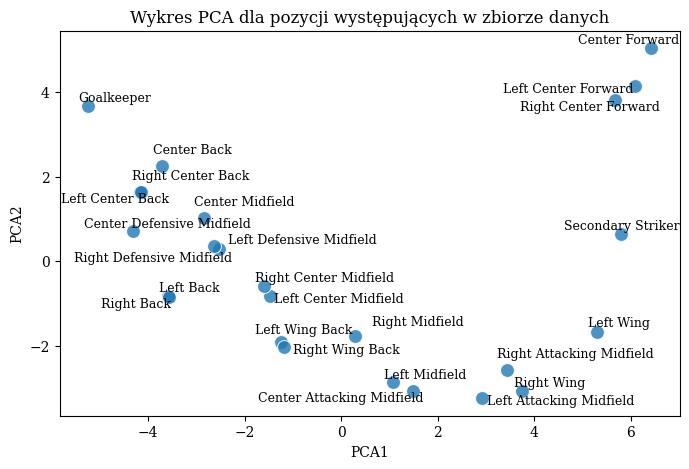

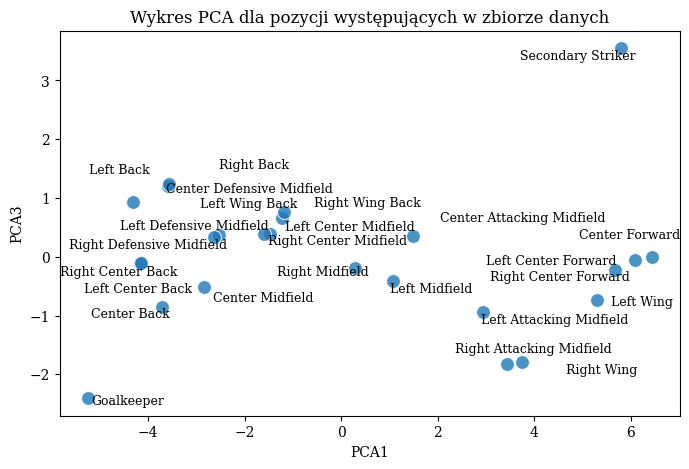

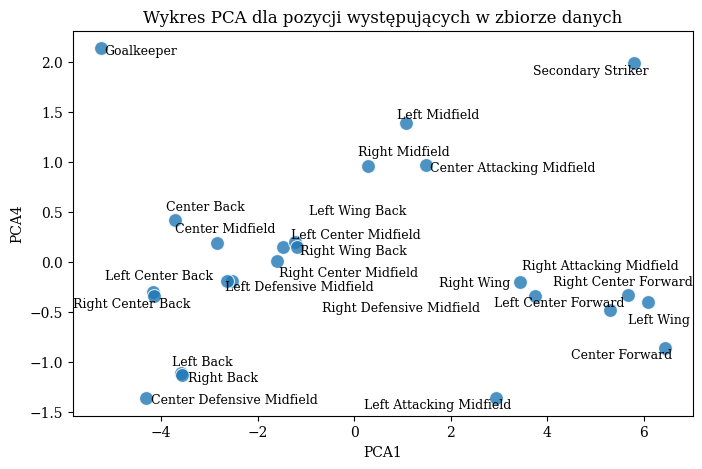

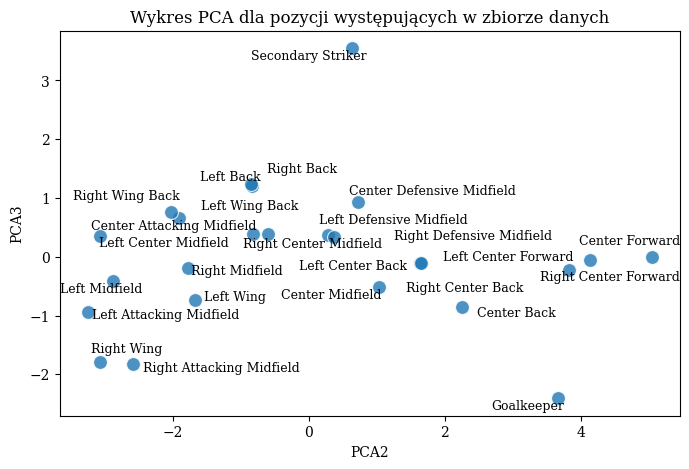

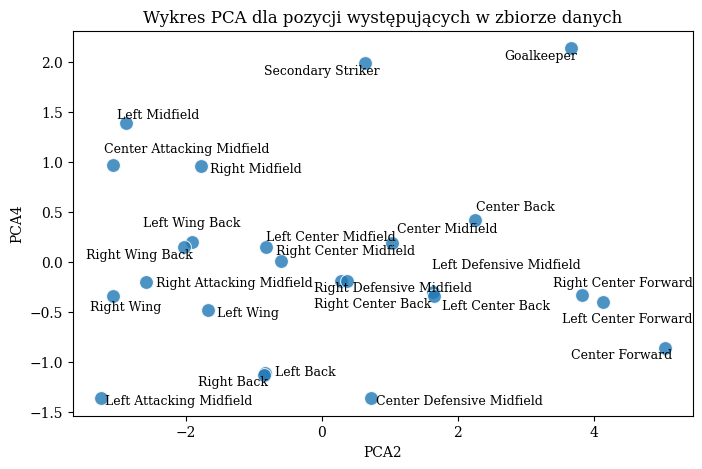

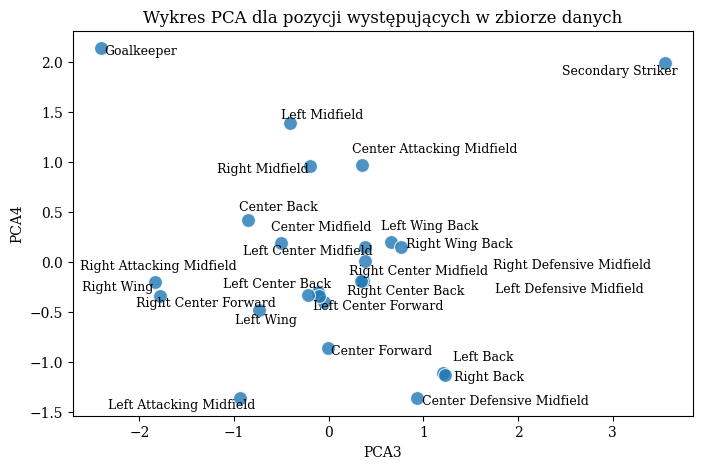

In [4527]:
import itertools
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
from adjustText import adjust_text  # Biblioteka do automatycznego przesuwania tekstu

# Standaryzacja danych
scaler = StandardScaler()
pos_scaled = scaler.fit_transform(pos_normal_scaled.iloc[:, 1:])  # Bez 'position'

# PCA na 4 komponenty
pca = PCA(n_components=4)
pca_result = pca.fit_transform(pos_scaled)

# Dodanie wyników PCA do DataFrame
pca_columns = [f'PCA{i+1}' for i in range(4)]
pos_pca_df = pd.DataFrame(pca_result, columns=pca_columns)
pos_pca_df['position'] = pos_normal_scaled['position'].values  # Przywrócenie pozycji

# Lista wszystkich par (PCA1, PCA2), (PCA1, PCA3), (PCA1, PCA4), (PCA2, PCA3), ...
pca_pairs = list(itertools.combinations(pca_columns, 2))

# Tworzenie osobnych wykresów dla każdej pary PCA
for pca_x, pca_y in pca_pairs:
    plt.figure(figsize=(8, 5))
    ax = sns.scatterplot(data=pos_pca_df, x=pca_x, y=pca_y, s=100, alpha=0.8)
    
    # Lista przechowująca obiekty tekstowe
    texts = []
    
    # Dodanie etykiet pozycji z przesunięciem
    for i in range(pos_pca_df.shape[0]):
        text = ax.text(pos_pca_df[pca_x].iloc[i], 
                       pos_pca_df[pca_y].iloc[i], 
                       pos_pca_df['position'].iloc[i], 
                       fontsize=9, ha='center', va='center')
        texts.append(text)
    
    # Automatyczna optymalizacja rozmieszczenia tekstów
    adjust_text(texts, only_move={'points': 'xy', 'texts': 'xy'}, force_points=0.3, force_text=0.3)

    plt.xlabel(pca_x)
    plt.ylabel(pca_y)
    plt.title("Wykres PCA dla pozycji występujących w zbiorze danych")
    
    plt.show()  # Pokazuje osobny wykres dla każdej pary


In [3525]:
data_model.groupby('position').size().reset_index(name='value').sort_values(by='value')

,position,value
24,Secondary Striker,7
4,Center Midfield,12
15,Right Attacking Midfield,159
6,Left Attacking Midfield,167
23,Right Wing Back,710
14,Left Wing Back,720
1,Center Back,753
12,Left Midfield,1475
21,Right Midfield,1489
18,Right Center Forward,1563


In [3531]:
data_model[data_model['position'] == "Left Wing"].groupby('player').size().reset_index(name='value').sort_values(by='value', ascending=False).head(20)

,player,value
535,Neymar da Silva Santos Junior,125
558,Pedro Eliezer Rodríguez Ledesma,52
604,Ronaldo de Assis Moreira,50
119,Cristiano Ronaldo dos Santos Aveiro,40
676,Thierry Henry,37
431,Lorenzo Insigne,36
51,Andrés Iniesta Luján,35
569,Philippe Coutinho Correia,33
454,Manuel Agudo Durán,30
25,Alejandro Darío Gómez,29


In [3532]:
data_model[data_model['position'] == "Right Wing"].groupby('player').size().reset_index(name='value').sort_values(by='value', ascending=False).head(20)

,player,value
398,Lionel Andrés Messi Cuccittini,248
529,Pedro Eliezer Rodríguez Ledesma,70
35,Alexis Alejandro Sánchez Sánchez,47
689,Ángel Fabián Di María Hernández,36
338,José María Callejón Bueno,34
518,Ousmane Dembélé,30
676,Xherdan Shaqiri,27
673,Willian Borges da Silva,26
149,Domenico Berardi,25
178,Fabián Ariel Orellana Valenzuela,23


In [3540]:
data_model[data_model['position'] == "Left Wing"].groupby('player').agg(
    count=('player','size'),
    paxg=('goals','sum'),
    shots=('shots', 'sum'),
    xGA=('xGA', 'sum'),
    xT=('xT+', 'sum')
).reset_index().sort_values(by='count').tail(10)

,player,count,paxg,shots,xGA,xT
25,Alejandro Darío Gómez,29,7.0,77.0,4.717312,11.950
454,Manuel Agudo Durán,30,10.0,81.0,7.350022,13.486
569,Philippe Coutinho Correia,33,8.0,106.0,4.930307,10.942
51,Andrés Iniesta Luján,35,7.0,71.0,7.157594,14.611
431,Lorenzo Insigne,36,12.0,128.0,8.351912,13.593
676,Thierry Henry,37,23.0,111.0,5.480620,8.607
119,Cristiano Ronaldo dos Santos Aveiro,40,34.0,229.0,5.512702,8.446
604,Ronaldo de Assis Moreira,50,31.0,175.0,13.776169,21.346
558,Pedro Eliezer Rodríguez Ledesma,52,18.0,105.0,9.678522,14.703
535,Neymar da Silva Santos Junior,125,71.0,384.0,41.784705,71.736


In [3541]:
data_model[data_model['position'] == "Right Wing"].groupby('player').agg(
    count=('player','size'),
    paxg=('goals','sum'),
    shots=('shots', 'sum'),
    xGA=('xGA', 'sum'),
    xT=('xT+', 'sum')
).reset_index().sort_values(by='count').tail(10)

,player,count,paxg,shots,xGA,xT
178,Fabián Ariel Orellana Valenzuela,23,4.0,46.0,5.112136,7.893
149,Domenico Berardi,25,4.0,79.0,3.451525,8.172
673,Willian Borges da Silva,26,2.0,45.0,5.560601,13.169
676,Xherdan Shaqiri,27,5.0,50.0,4.363948,9.099
518,Ousmane Dembélé,30,6.0,53.0,4.888761,11.674
338,José María Callejón Bueno,34,7.0,59.0,3.675240,4.794
689,Ángel Fabián Di María Hernández,36,12.0,90.0,13.199900,22.138
35,Alexis Alejandro Sánchez Sánchez,47,24.0,103.0,10.702654,13.650
529,Pedro Eliezer Rodríguez Ledesma,70,28.0,134.0,6.733769,14.978
398,Lionel Andrés Messi Cuccittini,248,211.0,1090.0,69.736237,132.950


Wpływ wybranych zmiennych na wynik meczu

In [3645]:
cor_df = data_model_corr3[['result', 'PAxG_diff', 'npxg_diff', 'shots_on_target_diff', 'xGA_diff', 'fwp+_diff', 'xT+_diff', 'carries_into_pen_diff', 'shots_diff', 'prog_carries_diff', 'prog_pass_diff']]

In [3646]:
cor_df_scaled = cor_df.copy()
cor_df_scaled.iloc[:, 1:] = scaler.fit_transform(cor_df.iloc[:, 1:])
cor_df_scaled

,result,PAxG_diff,npxg_diff,shots_on_target_diff,xGA_diff,fwp+_diff,xT+_diff,carries_into_pen_diff,shots_diff,prog_carries_diff,prog_pass_diff
0,1,2.033516,0.615588,1.638607,0.869404,-0.922968,0.528379,1.534640,0.752528,0.079272,1.277354
1,-1,-2.033516,-0.615588,-1.638607,-0.869404,0.922968,-0.528379,-1.534640,-0.752528,-0.079272,-1.277354
2,1,-0.484094,-0.072119,-0.273101,0.028174,0.109942,0.467224,-0.219234,-0.627106,0.237816,0.666445
3,-1,0.484094,0.072119,0.273101,-0.028174,-0.109942,-0.467224,0.219234,0.627106,-0.237816,-0.666445
4,0,-0.268122,-0.528963,-0.546202,-0.505868,-0.389547,-0.630304,-0.657703,-0.752528,-0.396360,-1.110742
...,...,...,...,...,...,...,...,...,...,...,...
5843,1,0.526376,0.792208,0.546202,1.694560,0.576176,0.861878,0.876937,0.877949,0.475632,0.999668
5844,0,0.628665,1.447139,0.546202,1.149651,0.090804,1.047789,-0.219234,0.627106,0.554904,0.388760
5845,0,-0.628665,-1.447139,-0.546202,-1.149651,-0.090804,-1.047789,0.219234,-0.627106,-0.554904,-0.388760
5846,0,-0.562056,-0.305065,-0.546202,0.001168,-0.723580,-0.544687,0.876937,-1.003370,-0.000000,-0.721983


korelacja

In [3647]:
cor_df_scaled.corr()['result'].sort_values(ascending=False)

result                   1.000000
PAxG_diff                0.738348
shots_on_target_diff     0.600909
npxg_diff                0.556881
xGA_diff                 0.526532
carries_into_pen_diff    0.439317
shots_diff               0.371920
prog_carries_diff        0.349605
xT+_diff                 0.345724
fwp+_diff                0.335241
prog_pass_diff           0.190535
Name: result, dtype: float64

podział danych

In [3650]:
X = cor_df_scaled.drop(columns='result')
y = cor_df['result']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42, stratify=y)

regresja logistyczna

In [3651]:
lr_model = LogisticRegression(multi_class='multinomial', solver='lbfgs', max_iter=1000)
lr_model.fit(X_train, y_train)
y_pred = lr_model.predict(X_test)

In [3652]:
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

          -1       0.82      0.86      0.84       431
           0       0.61      0.56      0.59       308
           1       0.83      0.84      0.84       431

    accuracy                           0.78      1170
   macro avg       0.76      0.76      0.76      1170
weighted avg       0.77      0.78      0.77      1170



In [3618]:

feature_importance = pd.DataFrame({
    'Feature': X.columns,
    'Weight': np.mean(np.abs(lr_model.coef_), axis=0)  # Średnia wartość wag dla każdej cechy
}).sort_values(by='Weight', ascending=False)

print(feature_importance)

                 Feature    Weight
0              PAxG_diff  2.366968
1              npxg_diff  1.341294
2   shots_on_target_diff  1.095512
7             shots_diff  0.535939
6  carries_into_pen_diff  0.274370
5               xT+_diff  0.218669
8      prog_carries_diff  0.104132
4              fwp+_diff  0.084450
3               xGA_diff  0.013313


random forest

In [3653]:
rf_model = RandomForestClassifier(n_estimators=100, random_state=42)
rf_model.fit(X_train, y_train)

importances = pd.DataFrame({
    'Feature': X.columns,
    'Importance': rf_model.feature_importances_
}).sort_values(by='Importance', ascending=False)

print(importances)

                 Feature  Importance
0              PAxG_diff    0.334262
1              npxg_diff    0.127347
2   shots_on_target_diff    0.095404
3               xGA_diff    0.090416
4              fwp+_diff    0.072387
5               xT+_diff    0.063847
9         prog_pass_diff    0.060570
7             shots_diff    0.054431
8      prog_carries_diff    0.051705
6  carries_into_pen_diff    0.049629


LDA

In [3621]:
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis

lda_model = LinearDiscriminantAnalysis()
lda_model.fit(X_train, y_train)
y_pred = lda_model.predict(X_test)
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

          -1       0.81      0.83      0.82       431
           0       0.57      0.56      0.56       308
           1       0.83      0.82      0.82       431

    accuracy                           0.75      1170
   macro avg       0.74      0.74      0.74      1170
weighted avg       0.75      0.75      0.75      1170



In [3623]:
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report, accuracy_score, f1_score
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from xgboost import XGBClassifier
from lightgbm import LGBMClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.neural_network import MLPClassifier

In [3624]:
def train_and_evaluate(model, model_name):
    print(f"\n🔹 Model: {model_name}")
    
    # Trening modelu
    model.fit(X_train, y_train)
    
    # Predykcja na zbiorze testowym
    y_pred = model.predict(X_test)
    
    # 📌 Wyświetlenie wyników
    print(classification_report(y_test, y_pred))
    
    # 📌 Accuracy & F1-score
    acc = accuracy_score(y_test, y_pred)
    f1 = f1_score(y_test, y_pred, average='weighted')
    print(f"🎯 Accuracy: {acc:.4f}, F1-score: {f1:.4f}")

    # 📌 Ważność cech (jeśli model ją obsługuje)
    if hasattr(model, "coef_"):  # Dla regresji logistycznej
        feature_importance = np.mean(np.abs(model.coef_), axis=0)
        plot_feature_importance(feature_importance, model_name)
    
    if hasattr(model, "feature_importances_"):  # Dla Random Forest, XGBoost, LightGBM
        plot_feature_importance(model.feature_importances_, model_name)


In [3625]:
def plot_feature_importance(importances, model_name):
    feature_importance_df = pd.DataFrame({
        'Feature': X.columns,
        'Importance': importances
    }).sort_values(by='Importance', ascending=False)

    plt.figure(figsize=(10, 5))
    sns.barplot(x='Importance', y='Feature', data=feature_importance_df, palette='viridis')
    plt.title(f'📊 Feature Importance - {model_name}')
    plt.show()



🔹 Model: Random Forest
              precision    recall  f1-score   support

          -1       0.81      0.84      0.82       431
           0       0.62      0.58      0.60       308
           1       0.83      0.84      0.84       431

    accuracy                           0.77      1170
   macro avg       0.75      0.75      0.75      1170
weighted avg       0.77      0.77      0.77      1170

🎯 Accuracy: 0.7709, F1-score: 0.7692


C:\Users\macie\AppData\Local\Temp\ipykernel_30508\2602104112.py:8: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Importance', y='Feature', data=feature_importance_df, palette='viridis')


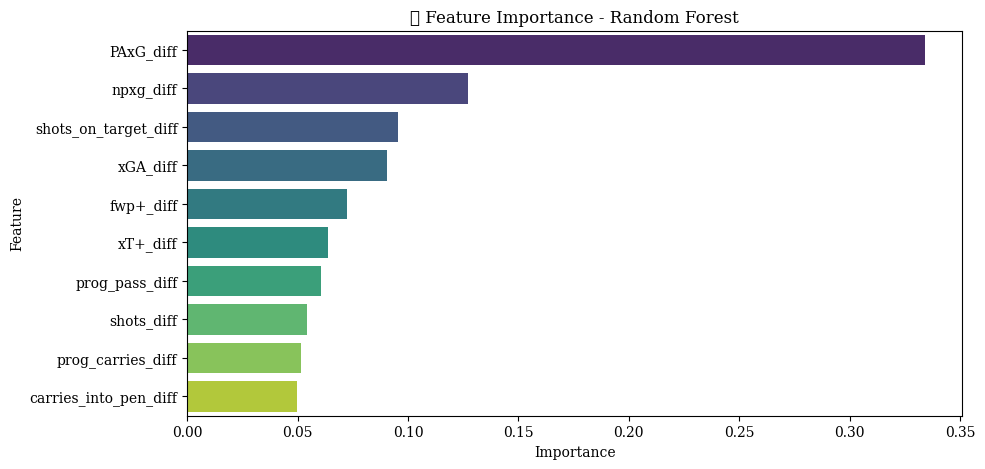


🔹 Model: LightGBM
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000373 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1576
[LightGBM] [Info] Number of data points in the train set: 4678, number of used features: 10
[LightGBM] [Info] Start training from score -0.998804
[LightGBM] [Info] Start training from score -1.334232
[LightGBM] [Info] Start training from score -0.998804
              precision    recall  f1-score   support

          -1       0.82      0.84      0.83       431
           0       0.59      0.58      0.58       308
           1       0.82      0.81      0.82       431

    accuracy                           0.76      1170
   macro avg       0.74      0.74      0.74      1170
weighted avg       0.76      0.76      0.76      1170

🎯 Accuracy: 0.7615, F1-score: 0.7609


C:\Users\macie\AppData\Local\Temp\ipykernel_30508\2602104112.py:8: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Importance', y='Feature', data=feature_importance_df, palette='viridis')


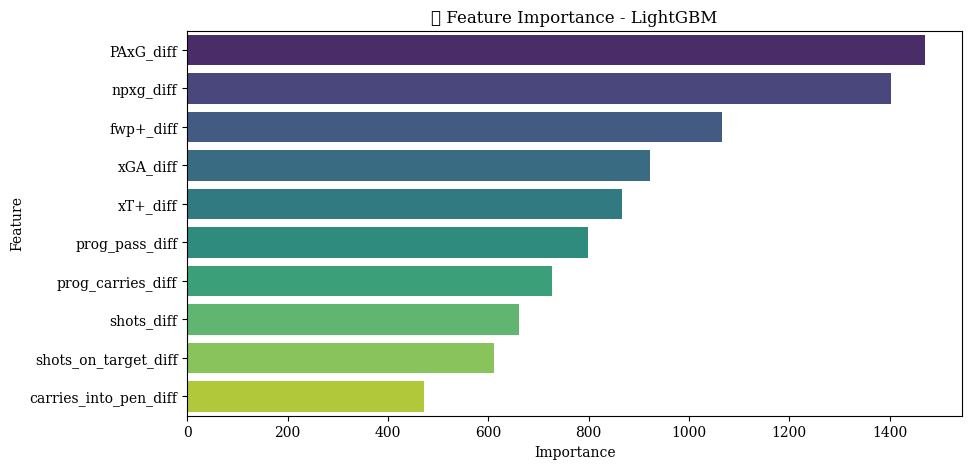

In [3701]:


# 🔹 Random Forest
rf = RandomForestClassifier(n_estimators=100, random_state=42)
train_and_evaluate(rf, "Random Forest")


# 🔹 LightGBM
lgbm = LGBMClassifier(objective='multiclass', num_class=3)
train_and_evaluate(lgbm, "LightGBM")




In [4489]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from lightgbm import LGBMClassifier
from sklearn.metrics import accuracy_score, f1_score

# Wczytanie danych (przyjmuję, że masz już znormalizowane statystyki i wynik meczu w df)
X = cor_df_scaled.drop(columns='result')
y = cor_df['result']

# Podział na zbiór treningowy i testowy
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Tworzenie modeli
rf = RandomForestClassifier(n_estimators=100, random_state=42)
lgbm = LGBMClassifier(objective='multiclass', num_class=3, random_state=42)

# Trenowanie modeli
rf.fit(X_train, y_train)
lgbm.fit(X_train, y_train)

# Predykcja
y_pred_rf = rf.predict(X_test)
y_pred_lgbm = lgbm.predict(X_test)

# Obliczanie metryk
acc_rf = accuracy_score(y_test, y_pred_rf)
f1_rf = f1_score(y_test, y_pred_rf, average='weighted')
acc_lgbm = accuracy_score(y_test, y_pred_lgbm)
f1_lgbm = f1_score(y_test, y_pred_lgbm, average='weighted')

## Ważności cech
feature_importances_rf = rf.feature_importances_ / rf.feature_importances_.sum()
feature_importances_lgbm = lgbm.feature_importances_ / lgbm.feature_importances_.sum()

# Średnia ważności cech
feature_importance_avg = (feature_importances_rf + feature_importances_lgbm) / 2

# Sortowanie cech
sorted_idx_rf = np.argsort(feature_importances_rf)[::-1]
sorted_idx_lgbm = np.argsort(feature_importances_lgbm)[::-1]
sorted_idx_avg = np.argsort(feature_importance_avg)[::-1]




[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000773 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1575
[LightGBM] [Info] Number of data points in the train set: 4678, number of used features: 10
[LightGBM] [Info] Start training from score -0.999384
[LightGBM] [Info] Start training from score -1.310966
[LightGBM] [Info] Start training from score -1.015188


In [4506]:
X.columns = ["PAxG", "NPxG", "Shot Of Target", "xGA", "Forward Passes", "xT", "Carries IPA", "Shots", "Prog Carries", "Prog Pass"]

C:\Users\macie\AppData\Local\Temp\ipykernel_30508\1131714561.py:12: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=feature_importances_rf[sorted_idx_rf], y=X.columns[sorted_idx_rf], ax=axes[0], palette="coolwarm_r")
C:\Users\macie\AppData\Local\Temp\ipykernel_30508\1131714561.py:20: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=feature_importances_lgbm[sorted_idx_lgbm], y=X.columns[sorted_idx_lgbm], ax=axes[1], palette="coolwarm_r")
C:\Users\macie\AppData\Local\Temp\ipykernel_30508\1131714561.py:28: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.b

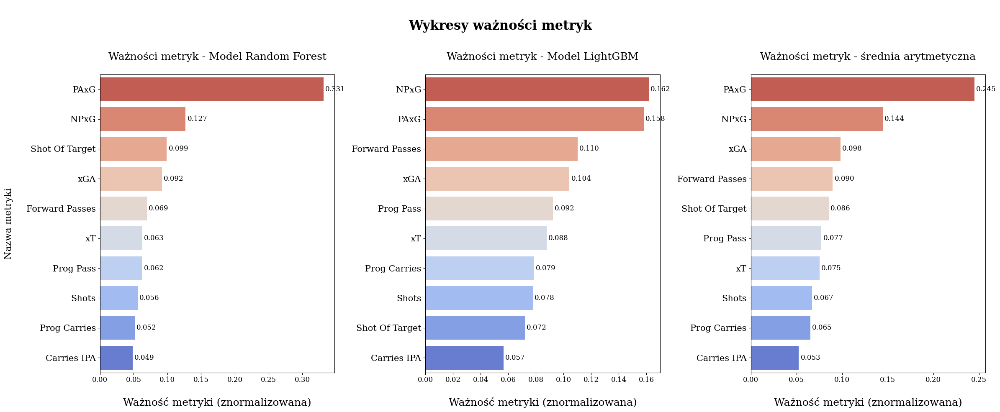

In [4555]:
import matplotlib.pyplot as plt
import seaborn as sns

# Tworzenie wykresu
fig, axes = plt.subplots(1, 3, figsize=(24, 10))

# Funkcja do dodania wartości nad słupkami
def add_value_labels(ax):
    for container in ax.containers:
        ax.bar_label(container, fmt="%.3f", fontsize=12, padding=3)

sns.barplot(x=feature_importances_rf[sorted_idx_rf], y=X.columns[sorted_idx_rf], ax=axes[0], palette="coolwarm_r")
axes[0].set_title("Ważności metryk - Model Random Forest\n", fontsize=18)
axes[0].set_xlabel("\nWażność metryki (znormalizowana)", fontsize=18)
axes[0].set_ylabel("Nazwa metryki\n", fontsize=16)
axes[0].tick_params(axis='y', labelsize=15)
axes[0].tick_params(axis='x', labelsize=12)
add_value_labels(axes[0])  # Dodanie wartości nad słupkami

sns.barplot(x=feature_importances_lgbm[sorted_idx_lgbm], y=X.columns[sorted_idx_lgbm], ax=axes[1], palette="coolwarm_r")
axes[1].set_title("Ważności metryk - Model LightGBM\n", fontsize=18)
axes[1].set_xlabel("\nWażność metryki (znormalizowana)", fontsize=18)
axes[1].set_ylabel("")
axes[1].tick_params(axis='y', labelsize=15)
axes[1].tick_params(axis='x', labelsize=12)
add_value_labels(axes[1])  # Dodanie wartości

sns.barplot(x=feature_importance_avg[sorted_idx_avg], y=X.columns[sorted_idx_avg], ax=axes[2], palette="coolwarm_r")
axes[2].set_title("Ważności metryk - średnia arytmetyczna\n", fontsize=18)
axes[2].set_xlabel("\nWażność metryki (znormalizowana)", fontsize=18)
axes[2].set_ylabel("")
axes[2].tick_params(axis='y', labelsize=15)
axes[2].tick_params(axis='x', labelsize=12)
add_value_labels(axes[2])  # Dodanie wartości

plt.suptitle("\nWykresy ważności metryk\n", fontsize=22, weight='bold')
plt.tight_layout()
plt.show()


In [3714]:
# Tworzenie DataFrame z wagami cech dla RF, LGBM i średnią
feature_weights = pd.DataFrame({
    'Feature': X.columns,
    'RandomForest Weight': feature_importances_rf,
    'LightGBM Weight': feature_importances_lgbm,
    'Average Weight': feature_importance_avg
})

# Posortowanie wg średniej wagi
feature_weights_sorted = feature_weights.sort_values(by='Average Weight', ascending=False).reset_index(drop=True)

# Wyświetlenie wyników
feature_weights_sorted

,Feature,RandomForest Weight,LightGBM Weight,Average Weight
0,PAxG_diff,0.331444,0.158222,0.244833
1,npxg_diff,0.126964,0.161889,0.144426
2,xGA_diff,0.091929,0.104333,0.098131
3,fwp+_diff,0.069422,0.110222,0.089822
4,shots_on_target_diff,0.098964,0.072111,0.085537
5,prog_pass_diff,0.062352,0.092333,0.077343
6,xT+_diff,0.062634,0.087778,0.075206
7,shots_diff,0.055989,0.077889,0.066939
8,prog_carries_diff,0.051666,0.078556,0.065111
9,carries_into_pen_diff,0.048638,0.056667,0.052652


procentowy udział w metryce

In [3628]:
y_train_xgb = y_train.map({-1: 0, 0: 1, 1: 2})
y_test_xgb = y_test.map({-1: 0, 0: 1, 1: 2})
xgb = XGBClassifier(objective='multi:softmax', num_class=3, eval_metric='mlogloss', random_state=42)
xgb.fit(X_train, y_train_xgb)

# Predykcja
y_pred_xgb = xgb.predict(X_test)

# Odwrócenie mapowania na oryginalne wartości (-1, 0, 1)
y_pred_xgb = pd.Series(y_pred_xgb).map({0: -1, 1: 0, 2: 1})
# 📌 Dokładność i F1-score
acc = accuracy_score(y_test, y_pred_xgb)
f1 = f1_score(y_test, y_pred_xgb, average='weighted')

print("🎯 Accuracy:", round(acc, 4))
print("🎯 F1-score:", round(f1, 4))
print("\n🔍 Classification Report:\n", classification_report(y_test, y_pred_xgb))


🎯 Accuracy: 0.7641
🎯 F1-score: 0.7643

🔍 Classification Report:
               precision    recall  f1-score   support

          -1       0.82      0.83      0.82       431
           0       0.60      0.60      0.60       308
           1       0.83      0.81      0.82       431

    accuracy                           0.76      1170
   macro avg       0.75      0.75      0.75      1170
weighted avg       0.76      0.76      0.76      1170



C:\Users\macie\AppData\Local\Temp\ipykernel_30508\1260568393.py:11: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Importance (%)', y='Feature', data=feature_importance_df, palette='viridis')


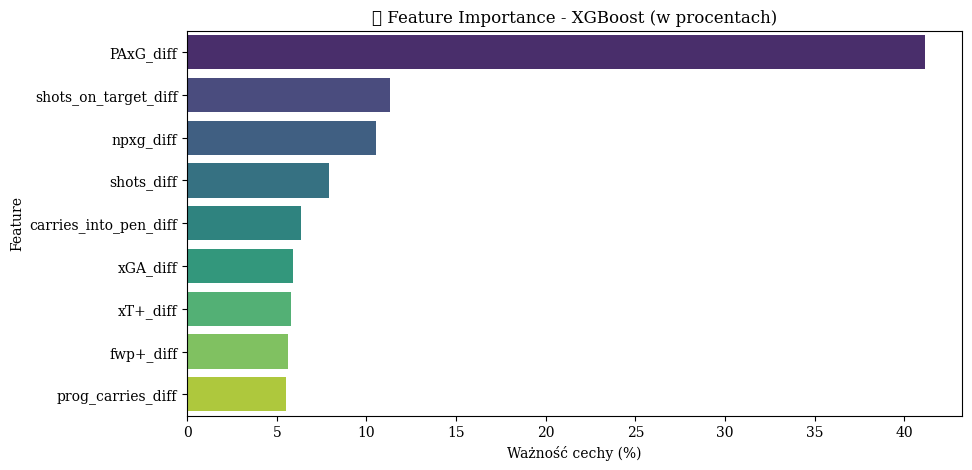

In [3629]:
def plot_feature_importance_xgb(model, feature_names):
    importances = model.feature_importances_
    importances_pct = (importances / np.sum(importances)) * 100  # Konwersja na procenty

    feature_importance_df = pd.DataFrame({
        'Feature': feature_names,
        'Importance (%)': importances_pct
    }).sort_values(by='Importance (%)', ascending=False)

    plt.figure(figsize=(10, 5))
    sns.barplot(x='Importance (%)', y='Feature', data=feature_importance_df, palette='viridis')
    plt.title('📊 Feature Importance - XGBoost (w procentach)')
    plt.xlabel("Ważność cechy (%)")
    plt.show()

# 📌 Rysowanie wykresu
plot_feature_importance_xgb(xgb, X.columns)


light_gbm

In [3699]:
y_train_lgbm = y_train.map({-1: 0, 0: 1, 1: 2})
y_test_lgbm = y_test.map({-1: 0, 0: 1, 1: 2})
lgbm = LGBMClassifier(objective='multiclass', num_class=3, random_state=42)
lgbm.fit(X_train, y_train_lgbm)

# Predykcja
y_pred_lgbm = lgbm.predict(X_test)

# Odwrócenie mapowania na oryginalne wartości (-1, 0, 1)
y_pred_lgbm = pd.Series(y_pred_lgbm).map({0: -1, 1: 0, 2: 1})
# 📌 Dokładność i F1-score
acc = accuracy_score(y_test, y_pred_lgbm)
f1 = f1_score(y_test, y_pred_lgbm, average='weighted')

print("🎯 Accuracy:", round(acc, 4))
print("🎯 F1-score:", round(f1, 4))
print("\n🔍 Classification Report:\n", classification_report(y_test, y_pred_lgbm))


[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000620 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1576
[LightGBM] [Info] Number of data points in the train set: 4678, number of used features: 10
[LightGBM] [Info] Start training from score -0.998804
[LightGBM] [Info] Start training from score -1.334232
[LightGBM] [Info] Start training from score -0.998804
🎯 Accuracy: 0.7615
🎯 F1-score: 0.7609

🔍 Classification Report:
               precision    recall  f1-score   support

          -1       0.82      0.84      0.83       431
           0       0.59      0.58      0.58       308
           1       0.82      0.81      0.82       431

    accuracy                           0.76      1170
   macro avg       0.74      0.74      0.74      1170
weighted avg       0.76      0.76      0.76      1170



C:\Users\macie\AppData\Local\Temp\ipykernel_30508\3475586929.py:11: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Importance (%)', y='Feature', data=feature_importance_df, palette='magma')


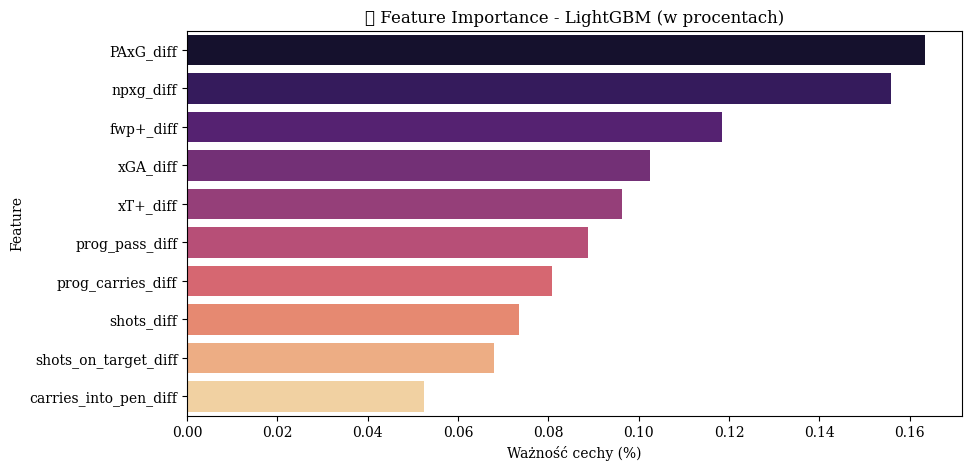

In [3700]:
def plot_feature_importance_lgbm(model, feature_names):
    importances = model.feature_importances_
    importances_pct = (importances / np.sum(importances))  # Konwersja na procenty

    feature_importance_df = pd.DataFrame({
        'Feature': feature_names,
        'Importance (%)': importances_pct
    }).sort_values(by='Importance (%)', ascending=False)

    plt.figure(figsize=(10, 5))
    sns.barplot(x='Importance (%)', y='Feature', data=feature_importance_df, palette='magma')
    plt.title('📊 Feature Importance - LightGBM (w procentach)')
    plt.xlabel("Ważność cechy (%)")
    plt.show()

# 📌 Rysowanie wykresu
plot_feature_importance_lgbm(lgbm, X.columns)


In [3654]:
cor_df_scaled

,result,PAxG_diff,npxg_diff,shots_on_target_diff,xGA_diff,fwp+_diff,xT+_diff,carries_into_pen_diff,shots_diff,prog_carries_diff,prog_pass_diff
0,1,2.033516,0.615588,1.638607,0.869404,-0.922968,0.528379,1.534640,0.752528,0.079272,1.277354
1,-1,-2.033516,-0.615588,-1.638607,-0.869404,0.922968,-0.528379,-1.534640,-0.752528,-0.079272,-1.277354
2,1,-0.484094,-0.072119,-0.273101,0.028174,0.109942,0.467224,-0.219234,-0.627106,0.237816,0.666445
3,-1,0.484094,0.072119,0.273101,-0.028174,-0.109942,-0.467224,0.219234,0.627106,-0.237816,-0.666445
4,0,-0.268122,-0.528963,-0.546202,-0.505868,-0.389547,-0.630304,-0.657703,-0.752528,-0.396360,-1.110742
...,...,...,...,...,...,...,...,...,...,...,...
5843,1,0.526376,0.792208,0.546202,1.694560,0.576176,0.861878,0.876937,0.877949,0.475632,0.999668
5844,0,0.628665,1.447139,0.546202,1.149651,0.090804,1.047789,-0.219234,0.627106,0.554904,0.388760
5845,0,-0.628665,-1.447139,-0.546202,-1.149651,-0.090804,-1.047789,0.219234,-0.627106,-0.554904,-0.388760
5846,0,-0.562056,-0.305065,-0.546202,0.001168,-0.723580,-0.544687,0.876937,-1.003370,-0.000000,-0.721983



🔹 Trenuję model: LightGBM
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001828 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1576
[LightGBM] [Info] Number of data points in the train set: 4678, number of used features: 10
[LightGBM] [Info] Start training from score -0.998804
[LightGBM] [Info] Start training from score -1.334232
[LightGBM] [Info] Start training from score -0.998804
🎯 Accuracy: 0.7615 | 🎯 F1-score: 0.7609
              precision    recall  f1-score   support

          -1       0.82      0.84      0.83       431
           0       0.59      0.58      0.58       308
           1       0.82      0.81      0.82       431

    accuracy                           0.76      1170
   macro avg       0.74      0.74      0.74      1170
weighted avg       0.76      0.76      0.76      1170


🔹 Trenuję model: CatBoost
🎯 Accuracy: 0.7615 | 🎯 F1-score: 0.7591
              precision    recall  

C:\Users\macie\AppData\Local\Temp\ipykernel_30508\1625754197.py:58: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x="Accuracy", y="Model", data=results_df, palette="viridis")


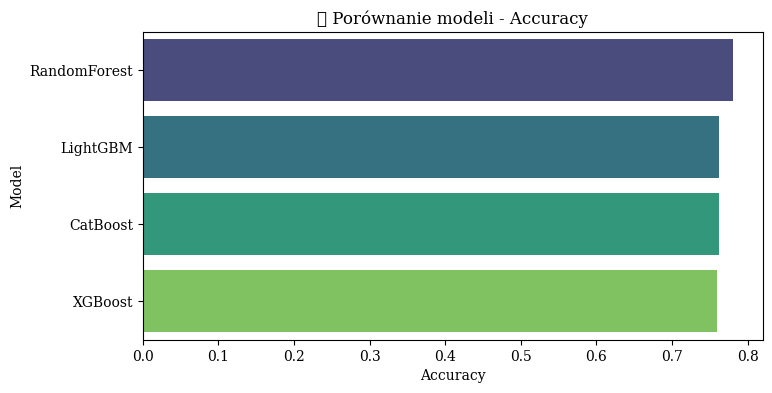

In [3655]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, f1_score, classification_report
from lightgbm import LGBMClassifier
from catboost import CatBoostClassifier
from sklearn.ensemble import RandomForestClassifier
from xgboost import XGBClassifier  # Zmiana z HistGradientBoosting na XGBClassifier

# 📌 Podział na X (cechy) i y (wynik meczu)
X = cor_df_scaled.drop(columns=['result'])
y = cor_df_scaled['result']

# 📌 Stratified Split (zachowanie proporcji klas)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42, stratify=y)

# 📌 Mapowanie klas: (-1 → 0, 0 → 1, 1 → 2) dla modeli, które tego wymagają
y_train_map = y_train.map({-1: 0, 0: 1, 1: 2})
y_test_map = y_test.map({-1: 0, 0: 1, 1: 2})

# 📌 Lista modeli do testów
models = {
    "LightGBM": LGBMClassifier(objective='multiclass', num_class=3, random_state=42),
    "CatBoost": CatBoostClassifier(loss_function='MultiClass', verbose=0, random_state=42),
    "RandomForest": RandomForestClassifier(n_estimators=200, random_state=42),
    "XGBoost": XGBClassifier(objective='multi:softmax', num_class=3, eval_metric='mlogloss', random_state=42)  # Dodanie XGBoost
}

# 📌 Testowanie modeli
results = []
for name, model in models.items():
    print(f"\n🔹 Trenuję model: {name}")
    
    if name in ["LightGBM", "CatBoost", "XGBoost"]:  # Modele obsługujące multiclass natywnie
        model.fit(X_train, y_train_map)
        y_pred = model.predict(X_test)
    else:  # Inne modele działają bez mapowania klas
        model.fit(X_train, y_train)
        y_pred = model.predict(X_test)
    
    # Odwrócenie mapowania
    if name in ["LightGBM", "CatBoost", "XGBoost"]:
        y_pred = pd.Series(y_pred.ravel()).map({0: -1, 1: 0, 2: 1})

    acc = accuracy_score(y_test, y_pred)
    f1 = f1_score(y_test, y_pred, average='weighted')

    results.append((name, acc, f1))
    print(f"🎯 Accuracy: {round(acc, 4)} | 🎯 F1-score: {round(f1, 4)}")
    print(classification_report(y_test, y_pred))

# 📌 Wizualizacja wyników
results_df = pd.DataFrame(results, columns=["Model", "Accuracy", "F1-score"]).sort_values(by="Accuracy", ascending=False)
plt.figure(figsize=(8, 4))
sns.barplot(x="Accuracy", y="Model", data=results_df, palette="viridis")
plt.title("📊 Porównanie modeli - Accuracy")
plt.show()


In [3684]:
result

{'importances_mean': array([-6.75213675e-02, -2.93162393e-02, -1.83760684e-02,  1.02564103e-03,
        -2.05128205e-03,  5.29914530e-03, -4.52991453e-03,  3.41880342e-04,
         8.54700855e-05,  1.53846154e-03]),
 'importances_std': array([0.00592154, 0.00830468, 0.00514598, 0.00351987, 0.00320256,
        0.00393162, 0.00270415, 0.00283987, 0.00210922, 0.00548342]),
 'importances': array([[-0.06923077, -0.06495726, -0.07179487, -0.07264957, -0.06581197,
         -0.07350427, -0.05726496, -0.06495726, -0.07606838, -0.05897436],
        [-0.03247863, -0.02905983, -0.02649573, -0.02820513, -0.01111111,
         -0.03076923, -0.02307692, -0.02905983, -0.04017094, -0.04273504],
        [-0.01282051, -0.00940171, -0.02820513, -0.01367521, -0.02222222,
         -0.01794872, -0.01880342, -0.02222222, -0.01794872, -0.02051282],
        [ 0.00512821,  0.0034188 ,  0.00512821,  0.00512821,  0.        ,
         -0.0008547 ,  0.0025641 , -0.0034188 , -0.0025641 , -0.0042735 ],
        [-0.0076

C:\Users\macie\AppData\Local\Temp\ipykernel_30508\3577464943.py:27: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=importances, y=features, ax=ax, palette="viridis")
C:\Users\macie\AppData\Local\Temp\ipykernel_30508\3577464943.py:27: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=importances, y=features, ax=ax, palette="viridis")
C:\Users\macie\AppData\Local\Temp\ipykernel_30508\3577464943.py:27: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=importances, y=features, ax=ax, palette="viridis")
C:\Users\macie\AppData\Local\Temp\ipykernel_30

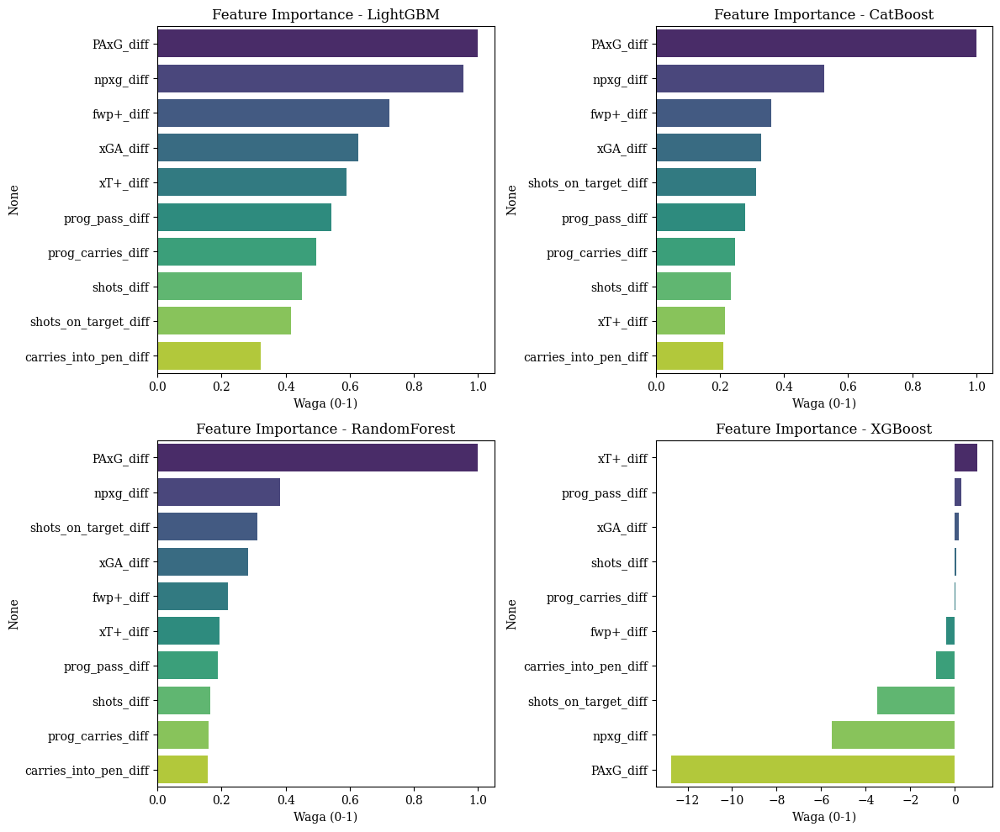

In [3683]:
from sklearn.inspection import permutation_importance
from xgboost import XGBClassifier

# 📌 Tworzymy wykres feature importances dla każdego modelu
fig, axes = plt.subplots(2, 2, figsize=(12, 10))
axes = axes.ravel()

for i, (name, model) in enumerate(models.items()):
    if name in ["LightGBM", "RandomForest", "XGBoost"]:  # Dodajemy XGBoost do tej grupy
        importances = model.feature_importances_
    elif name == "CatBoost":
        importances = model.get_feature_importance()
    else:  # Inne modele (np. HistGradientBoosting)
        result = permutation_importance(model, X_test, y_test, n_repeats=10, random_state=42)
        importances = result.importances_mean

    # Normalizacja do zakresu 0-1
    importances = importances / importances.max()

    # Sortowanie cech według ich wpływu
    sorted_idx = np.argsort(importances)[::-1]
    features = X.columns[sorted_idx]
    importances = importances[sorted_idx]

    # 📊 Rysowanie wykresu
    ax = axes[i]
    sns.barplot(x=importances, y=features, ax=ax, palette="viridis")
    ax.set_title(f"Feature Importance - {name}")
    ax.set_xlabel("Waga (0-1)")

plt.tight_layout()
plt.show()


za pomocą k-means podział na 2 grupy jeszcze
zrobić tabelkę z wartościami wspołczynników, wziąć średnią i mamy 1 część wag
następnie podzielmy na pozycje i zobaczmy jakie % jakie pozycje i mamy 2 część

In [3657]:
# 📌 Tworzymy słownik do przechowywania ważności cech dla każdego modelu
feature_importance_dict = {}

for name, model in models.items():
    if name in ["LightGBM", "RandomForest", "XGBoost"]:  # Modele obsługujące feature_importance_
        importances = model.feature_importances_
    elif name == "CatBoost":
        importances = model.get_feature_importance()
    else:  # Inne modele (np. HistGradientBoosting, jeśli byś chciał go z powrotem)
        result = permutation_importance(model, X_test, y_test, n_repeats=10, random_state=42)
        importances = result.importances_mean

    # Przechowywanie ważności cech w słowniku
    feature_importance_dict[name] = importances

# 📌 Konwersja słownika na DataFrame
feature_importance_df = pd.DataFrame(feature_importance_dict, index=X.columns)

# 📌 Sortowanie według średniej ważności (bez normalizacji)
feature_importance_df["Mean_Importance"] = feature_importance_df.mean(axis=1)
feature_importance_df = feature_importance_df.sort_values(by="Mean_Importance", ascending=False)
feature_importance_df.drop(columns=["Mean_Importance"], inplace=True)

# 📊 Wyświetlenie wyników
feature_importance_df['LightGBM'] = feature_importance_df['LightGBM'] / feature_importance_df['LightGBM'].sum()
feature_importance_df['CatBoost'] = feature_importance_df['CatBoost'] / feature_importance_df['CatBoost'].sum()
feature_importance_df


,LightGBM,CatBoost,RandomForest,XGBoost
PAxG_diff,0.163444,0.269403,0.326771,0.391360
npxg_diff,0.155778,0.141752,0.125318,0.102220
fwp+_diff,0.118333,0.096757,0.071803,0.054633
xGA_diff,0.102556,0.088238,0.092044,0.051910
xT+_diff,0.096333,0.058069,0.063154,0.049526
prog_pass_diff,0.088667,0.075213,0.061524,0.059836
prog_carries_diff,0.080778,0.066331,0.052367,0.052883
shots_diff,0.073556,0.063338,0.053972,0.072674
shots_on_target_diff,0.068000,0.084277,0.101727,0.107365
carries_into_pen_diff,0.052556,0.056623,0.051319,0.057593


In [3775]:
feature_importance_df['Weight1'] = (feature_importance_df['LightGBM'] + feature_importance_df['RandomForest']) / 2
feature_importance_df = feature_importance_df.sort_values(by='weight1', ascending=False)[['RandomForest', 'LightGBM', 'Weight1']].reset_index()

podział pozycji

In [3776]:
feature_importance_df

,index,RandomForest,LightGBM,Weight1
0,PAxG_diff,0.326771,0.163444,0.245108
1,npxg_diff,0.125318,0.155778,0.140548
2,xGA_diff,0.092044,0.102556,0.097300
3,fwp+_diff,0.071803,0.118333,0.095068
4,shots_on_target_diff,0.101727,0.068000,0.084864
5,xT+_diff,0.063154,0.096333,0.079744
6,prog_pass_diff,0.061524,0.088667,0.075095
7,prog_carries_diff,0.052367,0.080778,0.066573
8,shots_diff,0.053972,0.073556,0.063764
9,carries_into_pen_diff,0.051319,0.052556,0.051937


In [3667]:
km = pos_normal_scaled[pos_normal_scaled['position'].isin(pos)]

In [3671]:
km

,position,PAxG,npxg,xGA,xT+,shots_on_target,prog_carries,prog_pass,carries_into_pen,fwp+,...,prog_carries_percentage,prog_pass_percentage,carries_into_pen_percentage,fwp+_percentage,shots_percentage,total_percentage,total_percentage%,PCA1,PCA2,cluster
0,Center Attacking Midfield,-0.432931,0.486755,1.850452,0.909778,-0.5,0.656488,0.561951,-0.623610,-0.392335,...,0.656488,0.561951,-0.623610,-0.392335,1.032730,0.139838,0.139838,1.431431,-2.785404,0
3,Center Forward,2.381242,2.869667,-0.105522,-0.850966,2.0,-0.369274,-1.779513,1.603567,-1.173267,...,-0.369274,-1.779513,1.603567,-1.173267,1.032730,1.991576,1.991576,6.205199,4.583545,1
6,Left Attacking Midfield,-0.432931,0.702283,0.821612,1.254666,-0.5,1.682250,0.561951,1.603567,-0.512722,...,1.682250,0.561951,1.603567,-0.512722,1.032730,0.644881,0.644881,2.827132,-2.947757,0
9,Left Center Forward,2.159169,1.932655,0.424081,-0.524230,2.0,-0.369274,-1.779513,1.603567,-1.108585,...,-0.369274,-1.779513,1.603567,-1.108585,1.032730,1.861774,1.861774,5.874660,3.761506,1
12,Left Midfield,-0.432931,0.091265,1.102369,0.837170,-0.5,1.682250,-0.608781,-0.623610,-0.577668,...,1.682250,-0.608781,-0.623610,-0.577668,-0.089803,-0.128183,-0.128183,1.042474,-2.607082,0
13,Left Wing,-0.432931,0.817606,1.383227,1.290970,2.0,1.682250,-0.608781,1.603567,-0.773561,...,1.682250,-0.608781,1.603567,-0.773561,1.032730,1.362075,1.362075,5.122030,-1.512428,0
15,Right Attacking Midfield,-0.432931,0.567655,1.871375,1.290970,-0.5,0.656488,-0.608781,1.603567,-0.558131,...,0.656488,-0.608781,1.603567,-0.558131,1.032730,0.605553,0.605553,3.313453,-2.343952,0
18,Right Center Forward,1.842399,1.550338,0.441195,-0.524230,2.0,-0.369274,-1.779513,1.603567,-1.063440,...,-0.369274,-1.779513,1.603567,-1.063440,1.032730,1.703231,1.703231,5.467014,3.475415,1
21,Right Midfield,-0.432931,-0.015740,0.591596,0.619346,-0.5,0.656488,-0.608781,-0.623610,-0.643142,...,0.656488,-0.608781,-0.623610,-0.643142,-0.089803,-0.335097,-0.335097,0.283345,-1.607777,0
22,Right Wing,-0.432931,0.700819,1.412698,1.254666,-0.5,1.682250,-0.608781,1.603567,-0.731584,...,1.682250,-0.608781,1.603567,-0.731584,1.032730,0.650953,0.650953,3.614549,-2.788311,0


C:\Users\macie\AppData\Local\Temp\ipykernel_30508\1837387268.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  km['PCA1'] = pca_result[:, 0]
C:\Users\macie\AppData\Local\Temp\ipykernel_30508\1837387268.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  km['PCA2'] = pca_result[:, 1]
c:\Users\macie\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitl

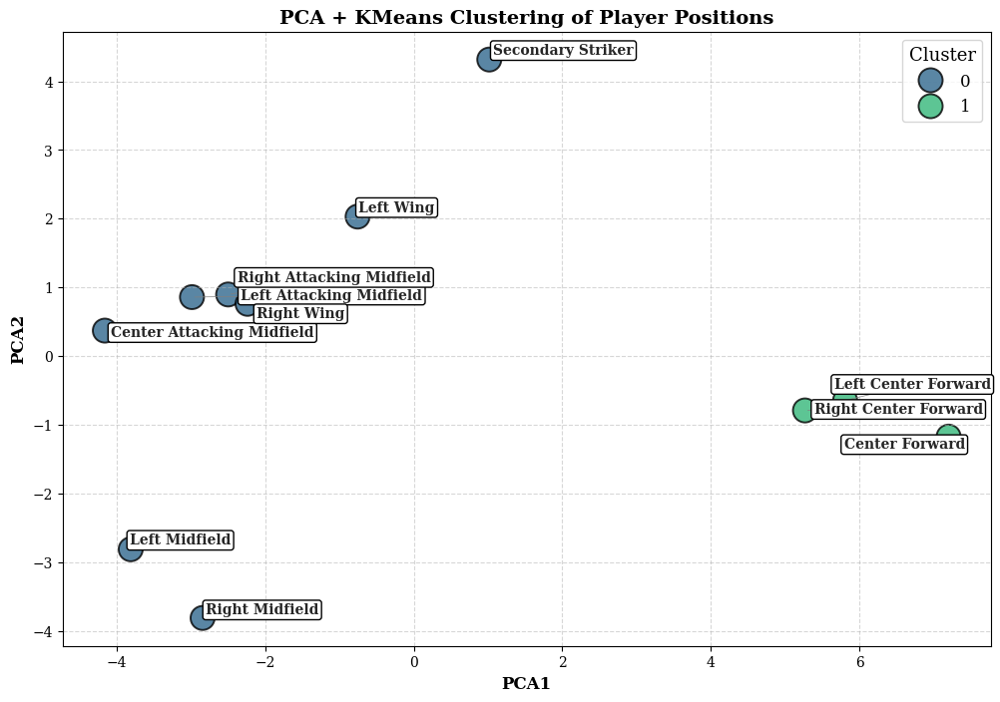

In [3682]:
numerical_cols = km.select_dtypes(include=['number']).columns
data = km[numerical_cols]

# Standaryzacja danych
scaler = StandardScaler()
data_scaled = scaler.fit_transform(data)

# PCA do redukcji wymiarów
pca = PCA(n_components=2)
pca_result = pca.fit_transform(data_scaled)
km['PCA1'] = pca_result[:, 0]
km['PCA2'] = pca_result[:, 1]

# Klasteryzacja KMeans
kmeans = KMeans(n_clusters=2, random_state=42)
km['cluster'] = kmeans.fit_predict(pca_result)

plt.figure(figsize=(12, 8), dpi=100)
ax = sns.scatterplot(x=km['PCA1'], y=km['PCA2'], hue=km['cluster'], palette='viridis', s=300, edgecolor='black', alpha=0.8)

# Lista obiektów tekstowych do automatycznego dopasowania
texts = []
for x, y, txt in zip(km['PCA1'], km['PCA2'], km['position']):
    texts.append(plt.annotate(txt, (x, y), fontsize=10, alpha=0.85, weight='bold', 
                              bbox=dict(facecolor='white', edgecolor='black', boxstyle='round,pad=0.2')))

# Automatyczna poprawa położenia etykiet
adjust_text(texts, arrowprops=dict(arrowstyle='-', color='gray', lw=0.5))

# Poprawienie stylu wykresu
plt.grid(True, linestyle='--', alpha=0.5)
plt.title("PCA + KMeans Clustering of Player Positions", fontsize=14, weight='bold')
plt.xlabel("PCA1", fontsize=12, weight='bold')
plt.ylabel("PCA2", fontsize=12, weight='bold')

# Dostosowanie legendy
plt.legend(title="Cluster", fontsize=12, title_fontsize=13)

plt.show()


modele

In [3702]:
accuracy = [0.7615, 0.7615, 0.7709, 0.7598]
f1score = [0.7609, 0.7591, 0.7692, 0.7598]
model_name = ['LightGBM', 'CatBoost', 'RandomForest', 'XGBoost']
pd.DataFrame({'Model':model_name, 'Accuracy':accuracy, 'F1-score':f1score}).sort_values(by='Accuracy', ascending=False).reset_index(drop=True)

,Model,Accuracy,F1-score
0,RandomForest,0.7709,0.7692
1,LightGBM,0.7615,0.7609
2,CatBoost,0.7615,0.7591
3,XGBoost,0.7598,0.7598


In [3740]:
cm = data_model_pos_group.groupby('grouped_positions')[stats].mean().reset_index()
cm

,grouped_positions,PAxG,npxg,xGA,xT+,shots_on_target,prog_carries,prog_pass,carries_into_pen,fwp+,shots
0,Midfield,0.391273,0.171565,0.132737,0.264699,0.690718,3.196061,2.742559,0.940210,186.274919,1.861168
1,Striker,0.562297,0.322686,0.103270,0.153606,1.043728,1.837133,1.275125,0.912832,102.725966,2.478566


In [3754]:
for col in cm.iloc[:,1:]:
    cm[col] = cm[col] / cm[col].sum()

striker_percent = cm.iloc[1,1:].reset_index(name='striker%')
midfield_percent = cm.iloc[0,1:].reset_index(name='midfield%')

In [3781]:
feature_importance_df['index'] = feature_importance_df['index'].str.replace('_diff', '')
feature_importance_df

,index,RandomForest,LightGBM,Weight1
0,PAxG,0.326771,0.163444,0.245108
1,npxg,0.125318,0.155778,0.140548
2,xGA,0.092044,0.102556,0.097300
3,fwp+,0.071803,0.118333,0.095068
4,shots_on_target,0.101727,0.068000,0.084864
5,xT+,0.063154,0.096333,0.079744
6,prog_pass,0.061524,0.088667,0.075095
7,prog_carries,0.052367,0.080778,0.066573
8,shots,0.053972,0.073556,0.063764
9,carries_into_pen,0.051319,0.052556,0.051937


In [3782]:
weights_final = feature_importance_df.merge(striker_percent.merge(midfield_percent, on=['index']), on=['index'])

In [3785]:
weights_final['Striker Weights'] = weights_final['Weight1'] * weights_final['striker%']
weights_final['Midfield Weights'] = weights_final['Weight1'] * weights_final['midfield%']
weights_final['Striker Weights'] = weights_final['Striker Weights'] / weights_final['Striker Weights'].sum()
weights_final['Midfield Weights'] = weights_final['Midfield Weights'] / weights_final['Midfield Weights'].sum()
weights_final

,index,RandomForest,LightGBM,Weight1,striker%,midfield%,Striker Weights,Midfield Weights
0,PAxG,0.326771,0.163444,0.245108,0.589676,0.410324,0.287259,0.202422
1,npxg,0.125318,0.155778,0.140548,0.652879,0.347121,0.182373,0.098193
2,xGA,0.092044,0.102556,0.097300,0.437573,0.562427,0.084618,0.110141
3,fwp+,0.071803,0.118333,0.095068,0.355452,0.644548,0.067161,0.123329
4,shots_on_target,0.101727,0.068000,0.084864,0.601764,0.398236,0.101497,0.06802
5,xT+,0.063154,0.096333,0.079744,0.36721,0.63279,0.058199,0.101562
6,prog_pass,0.061524,0.088667,0.075095,0.317378,0.682622,0.047369,0.103173
7,prog_carries,0.052367,0.080778,0.066573,0.365003,0.634997,0.048294,0.085083
8,shots,0.053972,0.073556,0.063764,0.571133,0.428867,0.072379,0.055039
9,carries_into_pen,0.051319,0.052556,0.051937,0.492613,0.507387,0.05085,0.053039


In [3795]:
w = weights_final.drop(columns="Weight1")
w.columns = ['Metric', 'RandomForest', 'LightGBM', 'Striker%', 'Midfield%', 'Striker Weight', 'Midfield Weight']
w.iloc[:,-2:] = w.iloc[:,-2:].round(2)

In [3803]:
w[['Striker Weight', 'Midfield Weight']] = w[['Striker Weight', 'Midfield Weight']].round(2)
w

,Metric,RandomForest,LightGBM,Striker%,Midfield%,Striker Weight,Midfield Weight
0,PAxG,0.326771,0.163444,0.589676,0.410324,0.287259,0.202422
1,npxg,0.125318,0.155778,0.652879,0.347121,0.182373,0.098193
2,xGA,0.092044,0.102556,0.437573,0.562427,0.084618,0.110141
3,fwp+,0.071803,0.118333,0.355452,0.644548,0.067161,0.123329
4,shots_on_target,0.101727,0.068000,0.601764,0.398236,0.101497,0.06802
5,xT+,0.063154,0.096333,0.36721,0.63279,0.058199,0.101562
6,prog_pass,0.061524,0.088667,0.317378,0.682622,0.047369,0.103173
7,prog_carries,0.052367,0.080778,0.365003,0.634997,0.048294,0.085083
8,shots,0.053972,0.073556,0.571133,0.428867,0.072379,0.055039
9,carries_into_pen,0.051319,0.052556,0.492613,0.507387,0.05085,0.053039


In [4706]:
w.to_excel('wagi.xlsx')

In [3900]:
print('a')

a


In [3901]:
print(scaler)

StandardScaler()


In [4672]:
colss = list(ratings_df.columns[6:16]) + ['score_scaled']
r2 = ratings_df[colss]

In [4673]:
r2.iloc[:,:-1] = scaler.fit_transform(r2.iloc[:,:-1])

In [4674]:
X = r2.drop(columns='score_scaled')
y = r2['score_scaled']

In [4126]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000252 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 379
[LightGBM] [Info] Number of data points in the train set: 240, number of used features: 10
[LightGBM] [Info] Start training from score 6.307500
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, be

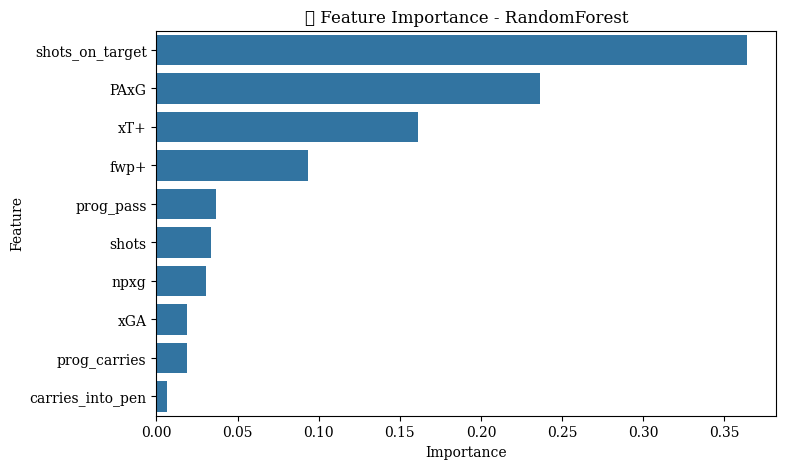

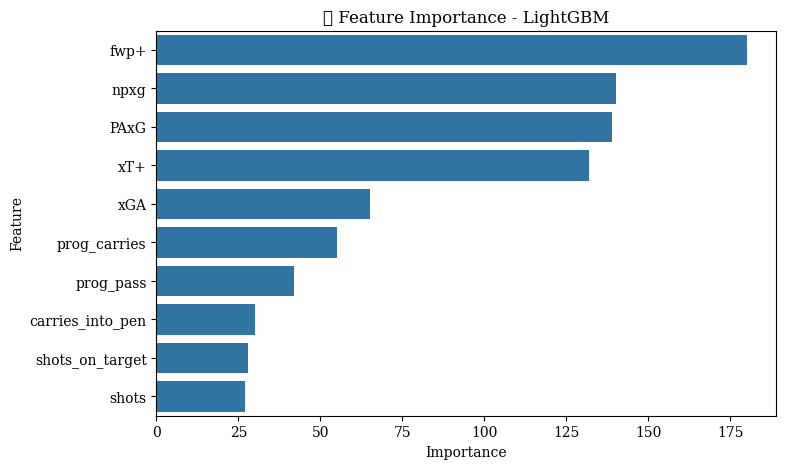

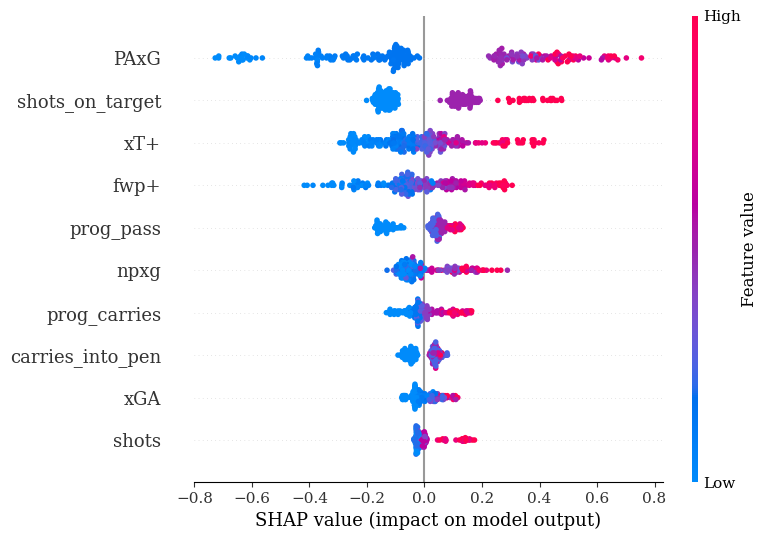

In [4127]:
# 🌳 RandomForestRegressor
rf = RandomForestRegressor(n_estimators=100, random_state=42)
rf.fit(X_train, y_train)

# 🌟 LightGBM Regressor
lgb_model = lgb.LGBMRegressor(n_estimators=100, random_state=42)
lgb_model.fit(X_train, y_train)

# 📊 Ocena modeli
y_pred_rf = rf.predict(X_test)
y_pred_lgb = lgb_model.predict(X_test)

print(f"🎯 R² RandomForest: {r2_score(y_test, y_pred_rf):.2f}")
print(f"🎯 R² LightGBM: {r2_score(y_test, y_pred_lgb):.2f}")

# 📈 Ważność cech dla RandomForest
rf_importance = pd.DataFrame({'Feature': X_train.columns, 'Importance': rf.feature_importances_})
rf_importance = rf_importance.sort_values(by="Importance", ascending=False)

plt.figure(figsize=(8, 5))
sns.barplot(x="Importance", y="Feature", data=rf_importance)
plt.title("🌳 Feature Importance - RandomForest")
plt.show()

# 📈 Ważność cech dla LightGBM
lgb_importance = pd.DataFrame({'Feature': X_train.columns, 'Importance': lgb_model.feature_importances_})
lgb_importance = lgb_importance.sort_values(by="Importance", ascending=False)

plt.figure(figsize=(8, 5))
sns.barplot(x="Importance", y="Feature", data=lgb_importance)
plt.title("⚡ Feature Importance - LightGBM")
plt.show()

# 🧐 SHAP dla LightGBM
explainer = shap.Explainer(lgb_model, X_train)
shap_values = explainer(X_train)

# 📊 SHAP Summary Plot
shap.summary_plot(shap_values, X_train)

In [4675]:
m1 = feature_importance_df[['index', 'Weight1']]
m2 = rr[['Feature', 'Weight']]

In [4676]:
m1.columns = ['Feature', 'Weight1']

In [4677]:
m3 = m1.merge(m2, on=['Feature'])

In [4678]:
m3.columns = ["Metryka", "Stworzony model", "Model Sofascore"]

In [4683]:
m3["Metryka"] = ["PAxG", "NPxG", "xGA", "Forward Passes", "Shots On Target", "xT", "Progressive Passes", "Progressive Carries", "Shots", "Carries Into Pen"]

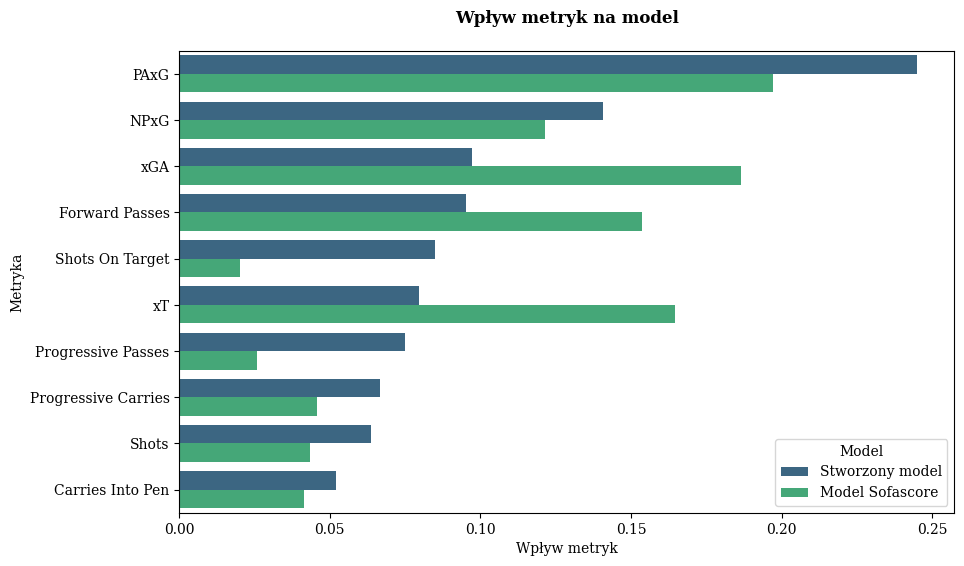

In [4687]:
m3_long = m3.melt(id_vars=["Metryka"], var_name="Model", value_name="Wpływ metryk")

# 🎨 Tworzenie wykresu
plt.figure(figsize=(10, 6))
sns.barplot(
    data=m3_long,
    x="Wpływ metryk",
    y="Metryka",
    hue="Model",
    palette="viridis"
)

# 🔧 Ustawienia wykresu
plt.xlabel("Wpływ metryk")
plt.ylabel("Metryka")
plt.title("Wpływ metryk na model\n", weight="bold")
plt.legend(title="Model")
plt.show()

Jutro

In [4200]:
ra = matches[0]

In [4537]:
abc = ra[(ra['minute'] > 12) & (ra['minute'] < 40) & (ra['type'] == "Shot")][['player', 'team', 'type', 'minute', 'second', 'x', 'y', 'shot_end_x', 'shot_end_y', 'shot_type','shot_outcome']]

In [4538]:
abc.to_excel("tab.xlsx")

In [4222]:
sc = sb.competitions()
ak = sc[sc['competition_gender'] == "female"]

In [4225]:
ak

,competition_id,season_id,country_name,competition_name,competition_gender,competition_youth,competition_international,season_name,match_updated,match_updated_360,match_available_360,match_available
25,37,90,England,FA Women's Super League,female,False,False,2020/2021,2023-02-25T14:52:09.326729,2021-06-13T16:17:31.694,None,2023-02-25T14:52:09.326729
26,37,42,England,FA Women's Super League,female,False,False,2019/2020,2024-02-12T15:05:34.211400,2021-06-13T16:17:31.694,None,2024-02-12T15:05:34.211400
27,37,4,England,FA Women's Super League,female,False,False,2018/2019,2024-06-12T07:41:45.347457,2021-06-13T16:17:31.694,None,2024-06-12T07:41:45.347457
63,49,3,United States of America,NWSL,female,False,False,2018,2023-07-24T13:01:22.094587,2021-06-13T16:17:31.694,None,2023-07-24T13:01:22.094587
71,53,106,Europe,UEFA Women's Euro,female,False,True,2022,2024-02-13T13:27:17.178263,2024-02-13T13:30:52.820588,2024-02-13T13:30:52.820588,2024-02-13T13:27:17.178263
72,72,107,International,Women's World Cup,female,False,True,2023,2024-07-14T16:59:48.469596,2024-07-14T17:01:38.887279,2024-07-14T17:01:38.887279,2024-07-14T16:59:48.469596
73,72,30,International,Women's World Cup,female,False,True,2019,2024-02-13T09:41:26.379767,2021-06-13T16:17:31.694,None,2024-02-13T09:41:26.379767


In [4534]:
sb.lineups(match_id=3895302)

{'Bayer Leverkusen':     player_id                     player_name    player_nickname  \
 0        3500                    Granit Xhaka               None   
 1        7044                   Patrik Schick               None   
 2        8221                    Jonathan Tah               None   
 3        8667                  Lukáš Hrádecký               None   
 4        8804                   Jonas Hofmann               None   
 5        9195                  Robert Andrich               None   
 6       10336       Alejandro Grimaldo García      Álex Grimaldo   
 7       27133                 Odilon Kossonou               None   
 8       28268     Exequiel Alejandro Palacios  Exequiel Palacios   
 9       30606           Edmond Fayçal Tapsoba               None   
 10      32289            Victor Okoh Boniface    Victor Boniface   
 11      32712                Jeremie Frimpong               None   
 12      33401                      Amine Adli               None   
 13      38004

In [4532]:
sb.events(match_id=3895302).columns

Index(['50_50', 'bad_behaviour_card', 'ball_receipt_outcome',
       'ball_recovery_recovery_failure', 'block_deflection',
       'block_save_block', 'carry_end_location', 'clearance_aerial_won',
       'clearance_body_part', 'clearance_head', 'clearance_left_foot',
       'clearance_right_foot', 'counterpress', 'dribble_nutmeg',
       'dribble_outcome', 'duel_outcome', 'duel_type', 'duration',
       'foul_committed_advantage', 'foul_committed_card',
       'foul_committed_penalty', 'foul_won_advantage', 'foul_won_defensive',
       'foul_won_penalty', 'goalkeeper_body_part', 'goalkeeper_end_location',
       'goalkeeper_outcome', 'goalkeeper_position', 'goalkeeper_technique',
       'goalkeeper_type', 'id', 'index', 'injury_stoppage_in_chain',
       'interception_outcome', 'location', 'match_id', 'minute', 'off_camera',
       'out', 'pass_aerial_won', 'pass_angle', 'pass_assisted_shot_id',
       'pass_body_part', 'pass_cross', 'pass_cut_back', 'pass_deflected',
       'pass_end_l

In [4529]:
sb.matches(competition_id=9, season_id=281)

,match_id,match_date,kick_off,competition,season,home_team,away_team,home_score,away_score,match_status,...,last_updated_360,match_week,competition_stage,stadium,referee,home_managers,away_managers,data_version,shot_fidelity_version,xy_fidelity_version
0,3895302,2024-04-14,17:30:00.000,Germany - 1. Bundesliga,2023/2024,Bayer Leverkusen,Werder Bremen,5,0,available,...,2024-05-10T17:03:59.613154,29,Regular Season,BayArena,Harm Osmers,Xabier Alonso Olano,Ole Werner,1.1.0,2,2
1,3895292,2024-04-06,15:30:00.000,Germany - 1. Bundesliga,2023/2024,Union Berlin,Bayer Leverkusen,0,1,available,...,2024-05-12T21:08:37.897296,28,Regular Season,Stadion An der Alten Försterei,Benjamin Brand,Nenad Bjelica,Xabier Alonso Olano,1.1.0,2,2
2,3895333,2024-05-05,18:30:00.000,Germany - 1. Bundesliga,2023/2024,Eintracht Frankfurt,Bayer Leverkusen,1,5,available,...,2024-05-14T16:32:13.483516,32,Regular Season,Deutsche Bank Park,Christian Dingert,Dino Toppmöller,Xabier Alonso Olano,1.1.0,2,2
3,3895340,2024-05-12,20:30:00.000,Germany - 1. Bundesliga,2023/2024,Bochum,Bayer Leverkusen,0,5,available,...,2024-05-14T16:46:08.459843,33,Regular Season,Vonovia Ruhrstadion,Benjamin Brand,Heiko Butscher,Xabier Alonso Olano,1.1.0,2,2
4,3895348,2024-05-18,16:30:00.000,Germany - 1. Bundesliga,2023/2024,Bayer Leverkusen,Augsburg,2,1,available,...,2024-05-20T10:33:09.140760,34,Regular Season,BayArena,Matthias Jöllenbeck,Xabier Alonso Olano,Jess Christian Thorup,1.1.0,2,2
5,3895286,2024-03-30,16:30:00.000,Germany - 1. Bundesliga,2023/2024,Bayer Leverkusen,Hoffenheim,2,1,available,...,2024-05-08T03:36:21.320065,27,Regular Season,BayArena,Deniz Aytekin,Xabier Alonso Olano,Pellegrino Matarazzo,1.1.0,2,2
6,3895220,2024-02-03,16:30:00.000,Germany - 1. Bundesliga,2023/2024,Darmstadt 98,Bayer Leverkusen,0,2,available,...,2024-05-08T01:01:15.978489,20,Regular Season,Merck-Stadion am Böllenfalltor,Tobias Reichel,Torsten Lieberknecht,Xabier Alonso Olano,1.1.0,2,2
7,3895250,2024-02-23,21:30:00.000,Germany - 1. Bundesliga,2023/2024,Bayer Leverkusen,FSV Mainz 05,2,1,available,...,2024-05-08T00:38:33.864825,23,Regular Season,BayArena,Timo Gerach,Xabier Alonso Olano,Bo Henriksen,1.1.0,2,2
8,3895266,2024-03-10,20:30:00.000,Germany - 1. Bundesliga,2023/2024,Bayer Leverkusen,Wolfsburg,2,0,available,...,2024-04-28T10:29:53.455142,25,Regular Season,BayArena,Daniel Siebert,Xabier Alonso Olano,Niko Kovač,1.1.0,2,2
9,3895275,2024-03-17,16:30:00.000,Germany - 1. Bundesliga,2023/2024,Freiburg,Bayer Leverkusen,2,3,available,...,2024-04-19T22:39:18.935666,26,Regular Season,Europa-Park Stadion,Harm Osmers,Christian Streich,Xabier Alonso Olano,1.1.0,2,2


In [4528]:
sb.competitions()

,competition_id,season_id,country_name,competition_name,competition_gender,competition_youth,competition_international,season_name,match_updated,match_updated_360,match_available_360,match_available
0,9,281,Germany,1. Bundesliga,male,False,False,2023/2024,2024-07-15T14:15:54.671676,2024-07-15T14:17:00.877356,2024-07-15T14:17:00.877356,2024-07-15T14:15:54.671676
1,9,27,Germany,1. Bundesliga,male,False,False,2015/2016,2024-05-19T11:11:14.192381,None,None,2024-05-19T11:11:14.192381
2,1267,107,Africa,African Cup of Nations,male,False,True,2023,2024-06-13T07:51:02.452825,None,None,2024-06-13T07:51:02.452825
3,16,4,Europe,Champions League,male,False,False,2018/2019,2024-06-12T07:44:38.559714,2021-06-13T16:17:31.694,None,2024-06-12T07:44:38.559714
4,16,1,Europe,Champions League,male,False,False,2017/2018,2024-02-13T02:35:28.134882,2021-06-13T16:17:31.694,None,2024-02-13T02:35:28.134882
...,...,...,...,...,...,...,...,...,...,...,...,...
69,55,43,Europe,UEFA Euro,male,False,True,2020,2024-04-16T12:44:40.558402,2024-04-16T12:47:18.505110,2024-04-16T12:47:18.505110,2024-04-16T12:44:40.558402
70,35,75,Europe,UEFA Europa League,male,False,False,1988/1989,2024-02-12T14:45:05.702250,2021-06-13T16:17:31.694,None,2024-02-12T14:45:05.702250
71,53,106,Europe,UEFA Women's Euro,female,False,True,2022,2024-02-13T13:27:17.178263,2024-02-13T13:30:52.820588,2024-02-13T13:30:52.820588,2024-02-13T13:27:17.178263
72,72,107,International,Women's World Cup,female,False,True,2023,2024-07-14T16:59:48.469596,2024-07-14T17:01:38.887279,2024-07-14T17:01:38.887279,2024-07-14T16:59:48.469596


In [4726]:
ask = result.groupby(['player', 'team']).agg(
    count = ('player', 'size'),
    mean_score = ('score_scaled', 'mean')
).reset_index().sort_values(by='count', ascending=False).head(15)

In [4727]:
ask

,player,team,count,mean_score
1790,Lionel Andrés Messi Cuccittini,Barcelona,455,8.085857
1846,Luis Alberto Suárez Díaz,Barcelona,166,7.366011
2340,Pedro Eliezer Rodríguez Ledesma,Barcelona,107,6.494003
2215,Neymar da Silva Santos Junior,Barcelona,103,7.436468
2605,Samuel Eto''o Fils,Barcelona,73,7.510972
2534,Ronaldo de Assis Moreira,Barcelona,55,7.582526
1792,Lionel Andrés Messi Cuccittini,Paris Saint-Germain,55,7.725350
229,Andrés Iniesta Luján,Barcelona,54,7.054025
529,Cristiano Ronaldo dos Santos Aveiro,Real Madrid,53,7.271922
261,Antoine Griezmann,Barcelona,51,6.449315


In [4728]:
ask.to_excel('ask2.xlsx')

In [ ]:
euro24_ratings

,player,team,match_id,position,goals,assist,PAxG,npxg,shots_on_target,xGA,...,assist_l,shots_on_target_l,prog_carries_s,prog_pass_s,rating_all,rating_all_weights,score_scaled,shots_l,npxg_l,scaled_rating
3478,Kai Havertz,Germany,3930158,Center Forward,1.0,1.0,1.087424,0.061891,2.0,0.093475,...,0.698135,1.101940,-0.898363,-0.818240,-0.917980,0.221687,7.015643,0.698135,0.069424,6.522024
9967,Florian Wirtz,Germany,3930158,Left Wing,1.0,0.0,1.447018,0.199686,1.0,0.000000,...,0.009950,0.698135,0.126239,-0.547309,3.742863,0.466246,6.824232,NaN,NaN,NaN
11174,Jamal Musiala,Germany,3930158,Right Wing,1.0,0.0,1.514934,0.093475,1.0,0.000000,...,0.009950,0.698135,1.694684,-0.547309,4.456817,0.483356,6.854655,NaN,NaN,NaN
18294,İlkay Gündoğan,Germany,3930158,Center Attacking Midfield,0.0,0.0,0.501987,0.215766,1.0,0.000000,...,0.009950,0.698135,-1.050095,-0.084738,-0.259434,0.200529,6.328766,NaN,NaN,NaN
5818,Ryan Christie,Scotland,3930158,Center Forward,0.0,0.0,0.000000,0.000000,0.0,0.000000,...,0.009950,0.009950,-0.898363,-0.818240,-11.368042,-0.691649,4.317700,0.009950,0.009950,4.638285
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15561,Phil Foden,England,3943043,Center Attacking Midfield,0.0,0.0,0.545743,0.179694,1.0,0.000000,...,0.009950,0.698135,-0.657983,-1.009880,-4.817355,-0.290349,5.320551,NaN,NaN,NaN
6870,Álvaro Borja Morata Martín,Spain,3943043,Center Forward,0.0,0.0,-0.280875,0.346755,0.0,0.000000,...,0.009950,0.009950,-0.409360,-0.818240,-4.016337,-0.502301,4.880359,1.388791,0.305096,5.028812
8945,Daniel Olmo Carvajal,Spain,3943043,Center Attacking Midfield,0.0,0.0,-0.211114,0.272128,0.0,0.358634,...,0.009950,0.009950,-0.265872,0.377833,0.231582,0.061950,6.044138,NaN,NaN,NaN
12801,Lamine Yamal Nasraoui Ebana,Spain,3943043,Right Wing,0.0,1.0,0.825710,0.326063,2.0,0.382136,...,0.698135,1.101940,0.126239,-0.084738,6.250041,0.701672,7.242842,NaN,NaN,NaN


In [ ]:
import statsbombpy as sb
competitions = sb.competitions()
